## Satellite Tracking
The recent privatization of space flight have led to the launch of thousands of artificial satellites. These satellites emit electromagnetic radiation across a wide variety of broad- and narrowband frequencies from both intentional and unintentional emissions ([Di Vruno et al. 2023](https://www.aanda.org/articles/aa/pdf/forth/aa46374-23.pdf)). These are begining to negatively impact all ground-based observing through tracks being left in optical images and false signals appearing in radio data.

In an attempt to keep track of satellite emissions, we are going to allocate 4 dishes at the Allen Telescope Array to collect emission data from the regions of the sky which are hte most affected. This will hopefully lead to an exhaustive list of frequencies and locations for all satellites in orbit.

The first step of this is to create a plot with the location of all active satellites in the sky above Hat Creek, the location of the Allen Telescope Array, throughout the course of one day. 

In [1407]:
#Import everything you need
import numpy as np
%matplotlib notebook 
import matplotlib.pyplot as plt
%matplotlib notebook 
from matplotlib.colors import LinearSegmentedColormap
from skyfield import almanac
from skyfield.api import load, wgs84
from skyfield.magnitudelib import planetary_magnitude
from skyfield.api import EarthSatellite
from astropy.coordinates import EarthLocation,SkyCoord
from astropy.time import Time
from astropy import units as u
from astropy.coordinates import AltAz
import matplotlib
#Makes plots interactive
%autosave 30 
#Makes it to where it autosaves every minute instead of every 2 minutes, just for peace of mind

Autosaving every 30 seconds


In [2]:
#Use skyfield to import the TLE (two-line element) file [gives you all the information on a satellite's location at 
#the epoch, which can be used to find its location at any time] for all active satellites on Norad
active_url = 'https://celestrak.org/norad/elements/active.txt'
active = load.tle_file(active_url, reload = True)
print('Loaded', len(active), 'satellites')

[#################################] 100% active.txt


Loaded 8364 satellites


In [3]:
ts = load.timescale()
t = []
for i in range(24):
    for j in range(0, 60, 10):
            t.append(ts.utc(ts.now().utc[0], ts.now().utc[1], ts.now().utc[2], i, j, 0))

In [4]:
observing_location= EarthLocation.of_site('ATA')#A different way to set our location
observing_time = []
for i in range(len(t)):
    observing_time.append(Time(t[i].utc_datetime()))
aa = AltAz(location=observing_location, obstime=observing_time)

In [5]:
ata = wgs84.latlon(+observing_location.lat.value, observing_location.lon.value)

In [6]:
names = []
for i in range(len(active)):
    names.append(active[i].name)

In [7]:
difference = []
for i in range(len(active)):
    difference.append(active[i] - ata)

In [8]:
topocentric = []
for i in range(len(difference)):
    for j in range(len(t)):
        topocentric.append(difference[i].at(t[j]))

In [9]:
%%time
#takes about 1 minute to run
alt = []
az = []
distance = []
for i in range(len(topocentric)):
    if np.isnan(topocentric[(i)].altaz()[0].degrees) == True:
        alt.append(0)
        az.append(0)
        distance.append(0)
    elif np.isnan(topocentric[(i)].altaz()[0].degrees) == False:
        alt.append(topocentric[i].altaz()[0].degrees)
        az.append(topocentric[i].altaz()[1].degrees)
        distance.append(topocentric[i].altaz()[2].au)

CPU times: user 1min 7s, sys: 548 ms, total: 1min 7s
Wall time: 1min 8s


In [10]:
alt = np.reshape(alt, (len(active), len(t)))
az = np.reshape(az, (len(active), len(t)))
distance = np.reshape(distance, (len(active), len(t)))

In [12]:
def heatmap(data, row_labels, col_labels, ax=None,
            cbar_kw=None, cbarlabel="", **kwargs):
    """
    Create a heatmap from a numpy array and two lists of labels.

    Parameters
    ----------
    data
        A 2D numpy array of shape (M, N).
    row_labels
        A list or array of length M with the labels for the rows.
    col_labels
        A list or array of length N with the labels for the columns.
    ax
        A `matplotlib.axes.Axes` instance to which the heatmap is plotted.  If
        not provided, use current axes or create a new one.  Optional.
    cbar_kw
        A dictionary with arguments to `matplotlib.Figure.colorbar`.  Optional.
    cbarlabel
        The label for the colorbar.  Optional.
    **kwargs
        All other arguments are forwarded to `imshow`.
    """

    if ax is None:
        ax = plt.gca()

    if cbar_kw is None:
        cbar_kw = {}

    # Plot the heatmap
    im = ax.imshow(data, **kwargs)

    # Create colorbar
    cbar = ax.figure.colorbar(im, ax=ax, **cbar_kw, shrink = 0.5)
    cbar.ax.set_ylabel(cbarlabel, rotation=-90, va="bottom")
    

    # Show all ticks and label them with the respective list entries.
    ax.set_xticks(np.arange(data.shape[1]), labels=col_labels, fontsize = 9)
    ax.set_yticks(np.arange(data.shape[0]), labels=row_labels, fontsize = 9)

    # Let the horizontal axes labeling appear on top.
    ax.tick_params(top=False, bottom=True,
                   labeltop=False, labelbottom=True)

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=80, ha="right",
             rotation_mode="anchor")

    # Turn spines off and create white grid.
    ax.spines[:].set_visible(False)

    ax.set_xticks(np.arange(data.shape[1]+1)-.5, minor=True)
    ax.set_yticks(np.arange(data.shape[0]+1)-.5, minor=True)
    #ax.grid(which="minor", color="w", linestyle='-', linewidth=3)
    ax.tick_params(which="minor", bottom=False, left=False)
    plt.gca().invert_yaxis()

    return im, cbar


def annotate_heatmap(im, data=None, valfmt="{x:.2f}",
                     textcolors=("black", "white"),
                     threshold=None, **textkw):
    """
    A function to annotate a heatmap.

    Parameters
    ----------
    im
        The AxesImage to be labeled.
    data
        Data used to annotate.  If None, the image's data is used.  Optional.
    valfmt
        The format of the annotations inside the heatmap.  This should either
        use the string format method, e.g. "$ {x:.2f}", or be a
        `matplotlib.ticker.Formatter`.  Optional.
    textcolors
        A pair of colors.  The first is used for values below a threshold,
        the second for those above.  Optional.
    threshold
        Value in data units according to which the colors from textcolors are
        applied.  If None (the default) uses the middle of the colormap as
        separation.  Optional.
    **kwargs
        All other arguments are forwarded to each call to `text` used to create
        the text labels.
    """

    if not isinstance(data, (list, np.ndarray)):
        data = im.get_array()

    # Normalize the threshold to the images color range.
    if threshold is not None:
        threshold = im.norm(threshold)
    else:
        threshold = im.norm(data.max())/2.

    # Set default alignment to center, but allow it to be
    # overwritten by textkw.
    kw = dict(horizontalalignment="center",
              verticalalignment="center")
    kw.update(textkw)

    # Get the formatter in case a string is supplied
    if isinstance(valfmt, str):
        valfmt = matplotlib.ticker.StrMethodFormatter(valfmt)

    # Loop over the data and create a `Text` for each "pixel".
    # Change the text's color depending on the data.
    texts = []
    for i in range(data.shape[0]):
        for j in range(data.shape[1]):
            kw.update(color=textcolors[int(im.norm(data[i, j]) > threshold)], fontsize = 9)
            text = im.axes.text(j, i, valfmt(data[i, j], None), **kw)
            texts.append(text)

    return texts

Trying to separate out the satellite types

**Satellite categories**
- **HEO**: Less than 0.9 revolutions/day
    - Generally space-based missions/observatories (such as Cluster II, TESS, Chandra, INTEGRAL, etc)
    - [Cluster II](https://www.esa.int/Enabling_Support/Operations/Cluster_II_operations): 4 satellites flying in a tetrahedral shape; studying Earth's magnetosphere
    - Transiting Exoplanet Survey Satellite ([TESS](https://www.nasa.gov/content/about-tess)): Looking at the entire sky to find exoplanets
    - [Chandra](https://chandra.harvard.edu/about/): X-ray telescope looking at hot regions of space (galaxy clutser, black holes, exploded stars) 
    - INTErnational Gamma-Ray Astrophysics Laboratory ([INTEGRAL](https://www.esa.int/Science_Exploration/Space_Science/Integral_overview)): γ-ray observatory studying 'violent' events such as black holes, gamma ray bursts, etc
    - Time History of Events and Macroscale Interactions during Substorms ([THEMIS](https://www.nasa.gov/mission_pages/themis/mission/index.html)): studies how the aurorae are formed; started with 5 satellites, 3 are still THEMIS and the other 2 are ARTEMIS (study/orbit the moon now)
    - Magnetospheric Multiscale Mission ([MMS](https://mms.gsfc.nasa.gov/about_mms.html)): studies how the magnetic fields of the Earth and the Sun disconnect and reconnect [and electron diffusion region]
    - [Chang'e 5](https://nssdc.gsfc.nasa.gov/nmc/spacecraft/display.action?id=2020-087A): Chinese lunar return mission 
- **GEO**: 0.9 to 1.2 revolutions/day
    - Used for communication between the Earth and other satellites, satellite tv, weather tracking, and more ([NASA](https://solarsystem.nasa.gov/basics/chapter5-1))
    - Two main orbits:
        - Geosynchronous: $\sim$1 revolutions/day, but can have any eccentricity or inclination; stays at one longitude, but may move North or south
        - Geostationary: 'parked' on sky; 0 eccentricity and located directly above the equator; helpful for satellite tv because then the dishes don't have to move
- **MEO**: 1.2 to 12 revolutions/day
- **LEO**: more than 12 revolutions/day

In [13]:
import urllib

In [165]:
data = urllib.request.urlopen('https://celestrak.org/norad/elements/active.txt').read()

In [15]:
%%time
#About 3 minutes to run
namess = []
for i in range(int(len(data.splitlines())/3)):
    #print(i) #Uncomment this out if you want to see how much it's run
    n = []
    for j in range(len(data.splitlines()[i*3])):
        n.append(data.splitlines()[i*3].decode()[-(j+1)])
    for j in range(len(n)):
        if n[j] != ' ':
            namess.append(data.splitlines()[i*3].decode()[:(len(n) - j)])
            break

CPU times: user 3min 27s, sys: 919 ms, total: 3min 28s
Wall time: 3min 29s


In [16]:
%%time
from skyfield.api import EarthSatellite

ts = load.timescale()
satellites = []
line1 = []
line2 = []
for i in range(len(namess)):
    named = namess[i]
    line1.append(data.splitlines()[(i*3)+1].decode())
    line2.append(data.splitlines()[(i*3)+2].decode())
    satellites.append(EarthSatellite(line1[i], line2[i], named, ts))
#print(satellite

CPU times: user 16.5 s, sys: 1.39 s, total: 17.9 s
Wall time: 18 s


In [17]:
%%time
alt = np.reshape(alt, (len(active) * len(t)))
az = np.reshape(az, (len(active) * len(t)))
distance = np.reshape(distance, (len(active) * len(t)))


CPU times: user 12 µs, sys: 15 µs, total: 27 µs
Wall time: 27.9 µs


In [18]:
altaz = []
for i in range(len(alt)):
    altaz.append([alt[i], az[i]])

In [19]:
a = []
for i in range(len(line2)):
    a.append(float(line2[i][52:63]))

In [20]:
MEO = []
LEO = []
GEO = []
HEO = []
for i in range(len(line2)):
    if 0.9 <= float(line2[i][52:63]) <= 1.2:
        GEO.append(i)
    if float(line2[i][52:63]) < 0.9:
        HEO.append(i)
    if 1.2 < float(line2[i][52:63]) < 12:
        MEO.append(i)
    if 12 <= float(line2[i][52:63]):
        LEO.append(i)

<IPython.core.display.Javascript object>


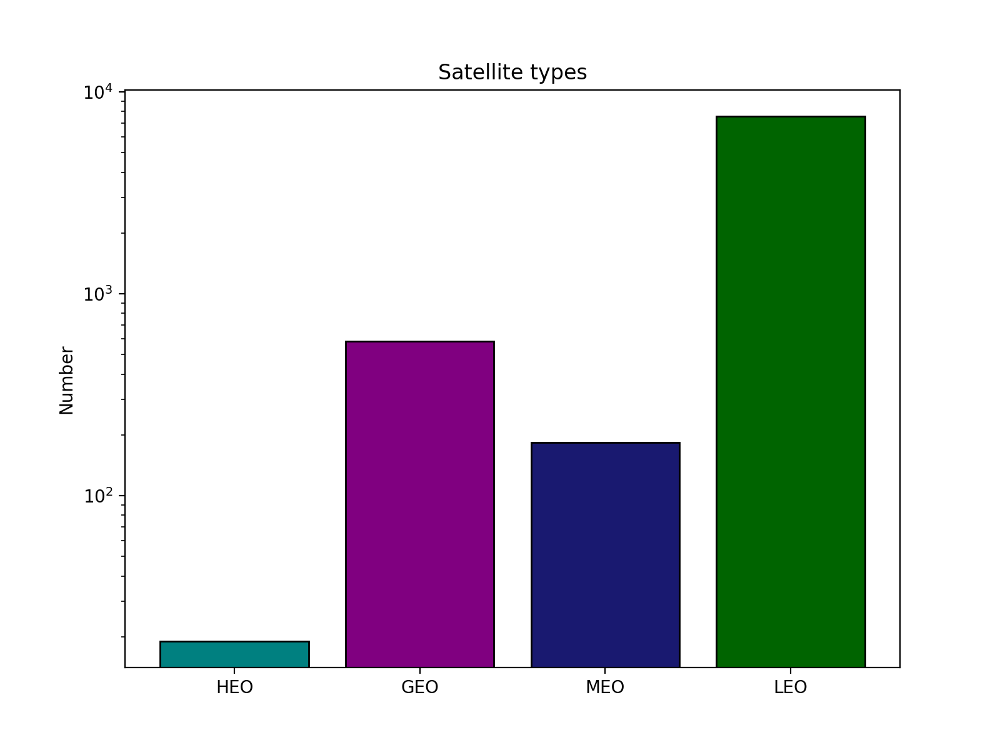

In [1135]:
sy = [len(HEO), len(GEO), len(MEO), len(LEO)]
sx = ['HEO', 'GEO', 'MEO', 'LEO']
plt.figure(figsize = (8, 6))
plt.title('Satellite types')
plt.ylabel('Number')
plt.autumn()
plt.bar(sx[0], sy[0], color = 'teal', edgecolor = 'k')
plt.bar(sx[1], sy[1], color = 'purple', edgecolor = 'k')
plt.bar(sx[2], sy[2], color = 'midnightblue', edgecolor = 'k')
plt.bar(sx[3], sy[3], color = 'darkgreen', edgecolor = 'k')
plt.semilogy()
plt.show()

In [22]:
sx = []
sy = []
for i in range(17):
    a = 0
    for j in range(len(line2)):
        if (i) < float(line2[j][52:63]) < ((i + 1)):
            a += 1
    sy.append(i)
    sx.append(a)

In [24]:
sx101 = []
sy101 = []
for i in range(len(line2)):
    if 1.00275 < float(line2[j][52:63]) <= 2:
        a += 1
sx101.append(a)

In [25]:
xheo = []
yheo = []
for i in range(9):
    a = 0
    xheo.append((i*0.1))
    for j in range(len(HEO)):
        if (i*0.1) <= float(line2[HEO[j]][52:63]) < ((i+1)*0.1):
            a += 1
    yheo.append(a)    

In [26]:
xmeo = []
ymeo = []
for i in range(24):
    a = 0
    xmeo.append(i*0.5)
    for j in range(len(MEO)):
        if (i*0.5) <= float(line2[MEO[j]][52:63]) < ((i+1)*0.5):
            a += 1
    ymeo.append(a)

<IPython.core.display.Javascript object>


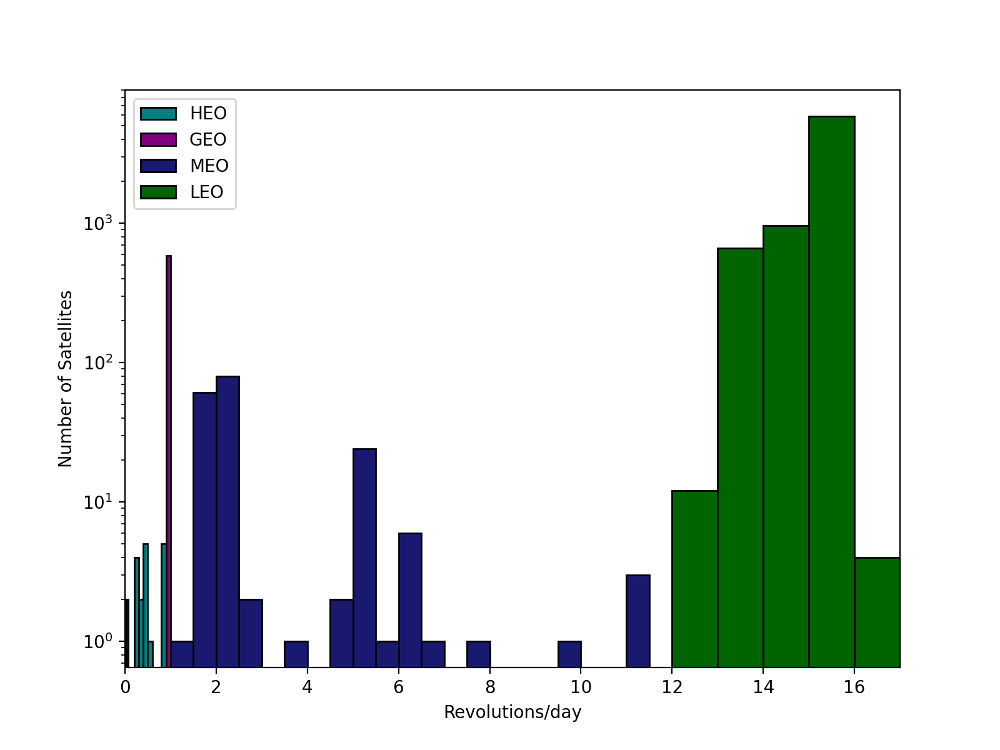

In [27]:
plt.figure(figsize = (8, 6))
plt.bar(((0.1*0)+0.05), yheo[0], width = 0.05, label = 'HEO', color = 'teal', edgecolor = 'k')
for i in range(1, len(yheo)):
    plt.bar(((0.1*i)+0.05), yheo[i], width = 0.1, color = 'teal', edgecolor = 'k')
plt.bar(0.95, len(GEO), width = 0.1, label = 'GEO', color = 'purple', edgecolor = 'k')
plt.bar((xmeo[0]+0.25), ymeo[0], width = 0.504, color = 'midnightblue', label = 'MEO', edgecolor = 'k')
for i in range(1, len(xmeo)):
    plt.bar((xmeo[i]+0.25), ymeo[i], width = 0.5, color = 'midnightblue', edgecolor = 'k')
plt.bar(12.5, sy[12], width = 1, label = 'LEO', color = 'darkgreen', edgecolor = 'k')
for i in range(13, 17):
    plt.bar((i+0.5), sx[i], width = 1, color = 'darkgreen', edgecolor = 'k')
plt.xlim(0, 17)
plt.legend()
plt.semilogy()
plt.xlabel('Revolutions/day')
plt.ylabel('Number of Satellites')
plt.show()

In [28]:
alt = np.reshape(alt, (len(active), len(t)))
az = np.reshape(az, (len(active), len(t)))
distance = np.reshape(distance, (len(active), len(t)))

In [29]:
%%time
alt_GEO = []
az_GEO = []
distance_GEO = []
alt_MEO = []
az_MEO = []
distance_MEO = []
alt_HEO = []
az_HEO = []
distance_HEO = []
alt_LEO = []
az_LEO = []
distance_LEO = []
for i in range(len(alt)):
    #print(i)
    for j in range(len(GEO)):
        if i == GEO[j]:
            for k in range(len(t)):
                alt_GEO.append(alt[i][k])
                az_GEO.append(az[i][k])
                distance_GEO.append(distance[i][k])
    for j in range(len(MEO)):
        if i == MEO[j]:
            for k in range(len(t)):
                alt_MEO.append(alt[i][k])
                az_MEO.append(az[i][k])
                distance_MEO.append(distance[i][k])
    for j in range(len(HEO)):
        if i == HEO[j]:
            for k in range(len(t)):
                alt_HEO.append(alt[i][k])
                az_HEO.append(az[i][k])
                distance_HEO.append(distance[i][k])
    for j in range(len(LEO)):
        if i == LEO[j]:
            for k in range(len(t)):
                alt_LEO.append(alt[i][k])
                az_LEO.append(az[i][k])
                distance_LEO.append(distance[i][k])


CPU times: user 3.85 s, sys: 69 ms, total: 3.92 s
Wall time: 3.97 s


In [30]:
ag = np.reshape(alt_GEO, (len(GEO), len(t)))
ah = np.reshape(alt_HEO, (len(HEO), len(t)))
am = np.reshape(alt_MEO, (len(MEO), len(t)))
al = np.reshape(alt_LEO, (len(LEO), len(t)))

In [808]:
ngeo_up = []
nheo_up = []
nleo_up = []
nmeo_up = []
line2_up = []
for i in range(len(ag)):
    for j in range(len(t)):
        if ag[i][j] > 0:
            ngeo_up.append(GEO[i])
            line2_up.append(line2[ngeo_up[-1]])
            break
            
for i in range(len(ah)):
    for j in range(len(t)):
        if ah[i][j] > 0:
            nheo_up.append(HEO[i])
            line2_up.append(line2[nheo_up[-1]])
            break
            
for i in range(len(al)):
    for j in range(len(t)):
        if al[i][j] > 0:
            nleo_up.append(LEO[i])
            line2_up.append(line2[nleo_up[-1]])
            break
            
for i in range(len(am)):
    for j in range(len(t)):
        if am[i][j] > 0:
            nmeo_up.append(MEO[i])
            line2_up.append(line2[nmeo_up[-1]])
            break

In [809]:
sxu = []
syu = []
for i in range(17):
    a = 0
    for j in range(len(line2_up)):
        if (i) < float(line2_up[j][52:63]) < ((i + 1)):
            a += 1
    syu.append(i)
    sxu.append(a)

In [810]:
sx101up = []
sy101up = []
for i in range(len(nmeo_up)):
    if 1.00275 < float(line2[nmeo_up[i]][52:63]) <= 2:
        a += 1
sx101up.append(a)

In [811]:
xheou = []
yheou = []
for i in range(9):
    a = 0
    xheou.append((i*0.1))
    for j in range(len(nheo_up)):
        #print(i*0.1)
        if (i*0.1) <= float(line2[nheo_up[j]][52:63]) < ((i+1)*0.1):
            a += 1
    yheou.append(a)    

In [812]:
xmeou = []
ymeou = []
for i in range(2, 24):
    a = 0
    xmeou.append(i*0.5)
    for j in range(len(nmeo_up)):
        if (i*0.5) <= float(line2[nmeo_up[j]][52:63]) < ((i+1)*0.5):
            a += 1
    ymeou.append(a)

In [817]:
sx

[36, 628, 82, 1, 2, 25, 7, 1, 0, 1, 0, 3, 94, 660, 962, 5858, 4]

In [816]:
sxu

[32, 268, 82, 1, 2, 25, 7, 1, 0, 1, 0, 3, 94, 660, 951, 5581, 2]

<IPython.core.display.Javascript object>


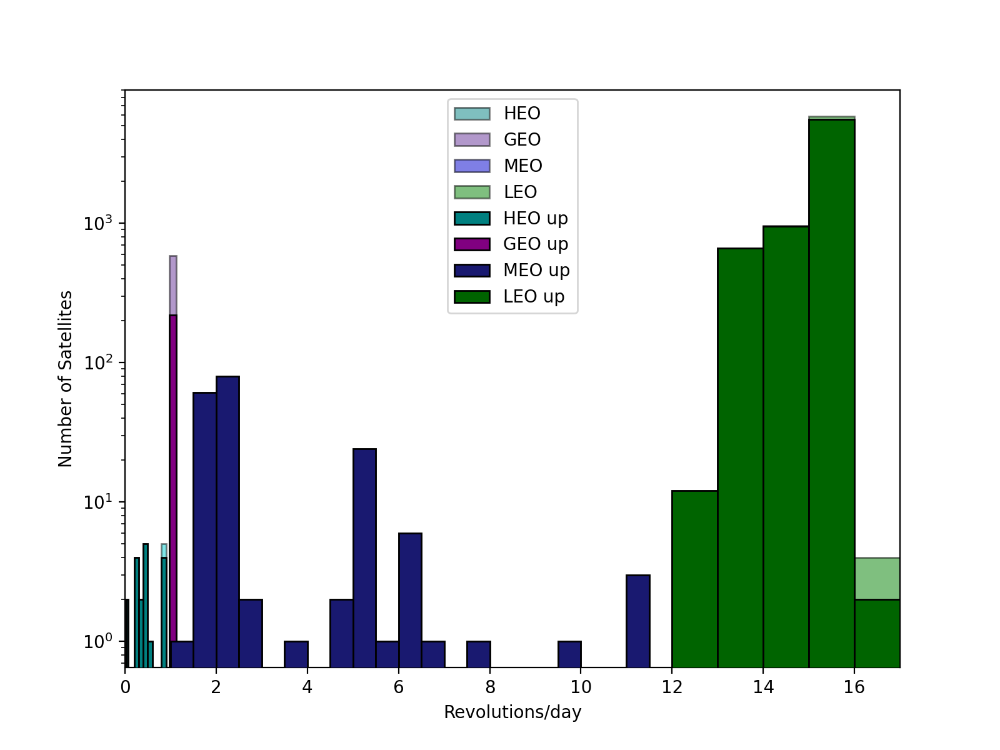

In [820]:
plt.figure(figsize = (8, 6))
plt.bar(((0.1*0)+0.05), yheo[0], width = 0.05, label = 'HEO', color = 'teal', edgecolor = 'k', alpha = 0.5)
for i in range(1, len(yheo)):
    plt.bar(((0.1*i)+0.05), yheo[i], width = 0.1, color = 'darkturquoise', edgecolor = 'k', alpha = 0.5)
plt.bar(1.05, len(GEO), width = 0.15, label = 'GEO', color = 'rebeccapurple', edgecolor = 'k', alpha = 0.5)
plt.bar((xmeo[0]+0.25), ymeo[0], width = 0.504, color = 'mediumblue', label = 'MEO', edgecolor = 'k', alpha = 0.5)
for i in range(1, len(xmeo)):
    plt.bar((xmeo[i]+0.25), ymeo[i], width = 0.5, color = 'mediumblue', edgecolor = 'k', alpha = 0.5)
plt.bar(12.5, sy[12], width = 1, label = 'LEO', color = 'green', edgecolor = 'k', alpha = 0.5)
for i in range(13, 17):
    plt.bar((i+0.5), sx[i], width = 1, color = 'green', edgecolor = 'k', alpha = 0.5)
plt.xlim(0, 17)

plt.bar(((0.1*0)+0.05), yheou[0], width = 0.05, label = 'HEO up', color = 'teal', edgecolor = 'k', zorder = 20)
for i in range(1, len(yheo)):
    plt.bar(((0.1*i)+0.05), yheou[i], width = 0.1, color = 'teal', edgecolor = 'k', zorder = 20)
plt.bar(1.05, len(ngeo_up), width = 0.15, label = 'GEO up', color = 'purple', edgecolor = 'k', zorder = 20)
plt.bar((xmeou[0]+0.25), ymeou[0], width = 0.504, color = 'midnightblue', label = 'MEO up', edgecolor = 'k', zorder = 20)
for i in range(1, len(xmeou)):
    plt.bar((xmeou[i]+0.25), ymeou[i], width = 0.5, color = 'midnightblue', edgecolor = 'k', zorder = 20)
plt.bar(12.5, syu[12], width = 1, label = 'LEO up', color = 'darkgreen', edgecolor = 'k', zorder = 20)
for i in range(13, 17):
    plt.bar((i+0.5), sxu[i], width = 1, color = 'darkgreen', edgecolor = 'k', zorder = 20)
plt.xlim(0, 17)
plt.legend()
plt.semilogy()
plt.xlabel('Revolutions/day')
plt.ylabel('Number of Satellites')
plt.title()
plt.show()

<IPython.core.display.Javascript object>


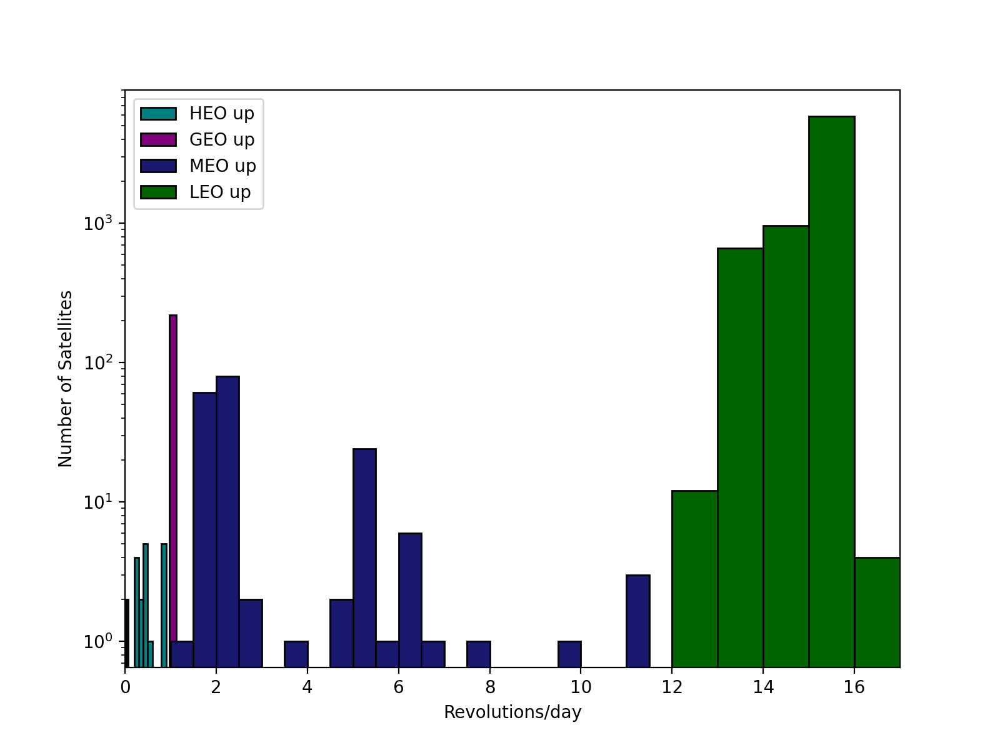

In [821]:
plt.figure(figsize = (8, 6))
plt.bar(((0.1*0)+0.05), yheo[0], width = 0.05, label = 'HEO up', color = 'teal', edgecolor = 'k')
for i in range(1, len(yheo)):
    plt.bar(((0.1*i)+0.05), yheo[i], width = 0.1, color = 'teal', edgecolor = 'k')
plt.bar(1.05, len(ngeo_up), width = 0.15, label = 'GEO up', color = 'purple', edgecolor = 'k')
plt.bar((xmeo[0]+0.25), ymeo[0], width = 0.504, color = 'midnightblue', label = 'MEO up', edgecolor = 'k')
for i in range(1, len(xmeo)):
    plt.bar((xmeo[i]+0.25), ymeo[i], width = 0.5, color = 'midnightblue', edgecolor = 'k')
plt.bar(12.5, sy[12], width = 1, label = 'LEO up', color = 'darkgreen', edgecolor = 'k')
for i in range(13, 17):
    plt.bar((i+0.5), sx[i], width = 1, color = 'darkgreen', edgecolor = 'k')
plt.xlim(0, 17)
plt.legend()
plt.semilogy()
plt.xlabel('Revolutions/day')
plt.ylabel('Number of Satellites')
plt.show()

<IPython.core.display.Javascript object>


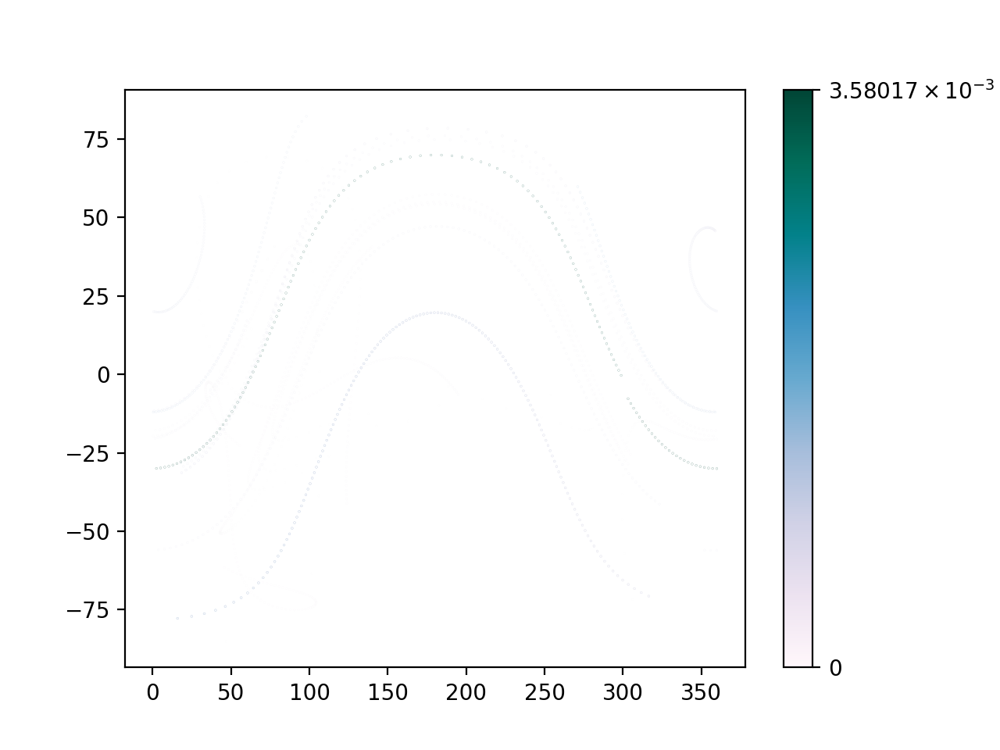

/var/folders/6f/jpw5cz9n6wj2vpht4vrvg0j00000gn/T/ipykernel_17348/4073633625.py:5: UserWarning: All values for SymLogScale are below linthresh, making it effectively linear. You likely should lower the value of linthresh. 
  fig.colorbar(pcm, ax=ax)


In [38]:
fig, ax = plt.subplots(1, 1)
pcm =  ax.scatter(az_HEO, alt_HEO, distance_HEO, c = distance_HEO, norm = 'symlog',
               #norm=colors.LodNorm(vmin=1, vmax=Z.max()),
             cmap='PuBuGn', vmin = 0, vmax = np.max(distance_HEO))
fig.colorbar(pcm, ax=ax)
plt.show()

In [39]:
gsa = []
for i in range(len(distance_HEO)):
    if (distance_HEO[i] * u.AU).to(u.km)/u.km > 63889:
        gsa.append((distance_HEO[i] * u.AU).to(u.km)/u.km)

<IPython.core.display.Javascript object>


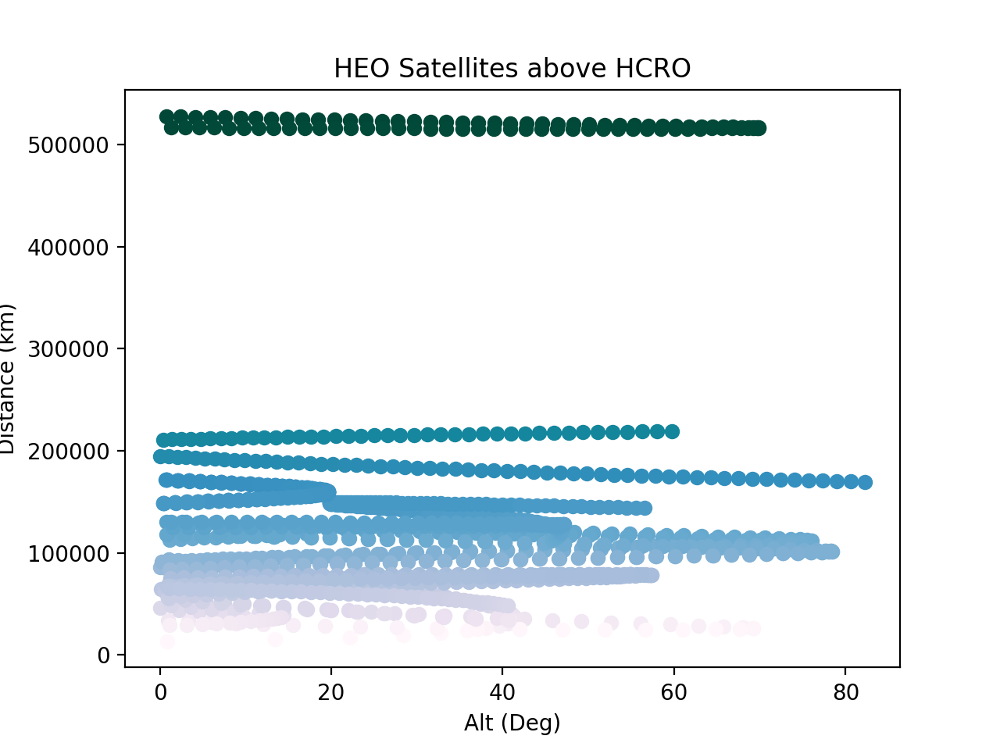

In [41]:
fig, ax = plt.subplots(1, 1)
for i in range(len(az_HEO)):
    if alt_HEO[i] > 0:
        ax.scatter(alt_HEO[i], (distance_HEO[i] * u.AU).to(u.km)/u.km, c = (distance_HEO[i] * u.AU).to(u.km)/u.km, 
                   cmap = 'PuBuGn', 
                    norm = 'symlog', vmin = 25000, vmax = np.max((distance_HEO * u.AU).to(u.km) /u.km))
#plt.legend(fontsize = 7, ncols = 3)
    #fig.colorbar(ax.scatter(az_HEO[i], np.abs(alt_HEO[i]-90), c = distance_HEO[i], cmap = 'PuBuGn', 
     #           norm = 'symlog', vmin = 0, vmax = np.max(distance_HEO),
      #          label = str(distance_HEO[i]) + ' AU'))
plt.title('HEO Satellites above HCRO')
plt.ylabel("Distance (km)")
plt.xlabel("Alt (Deg)")
plt.show()

<IPython.core.display.Javascript object>


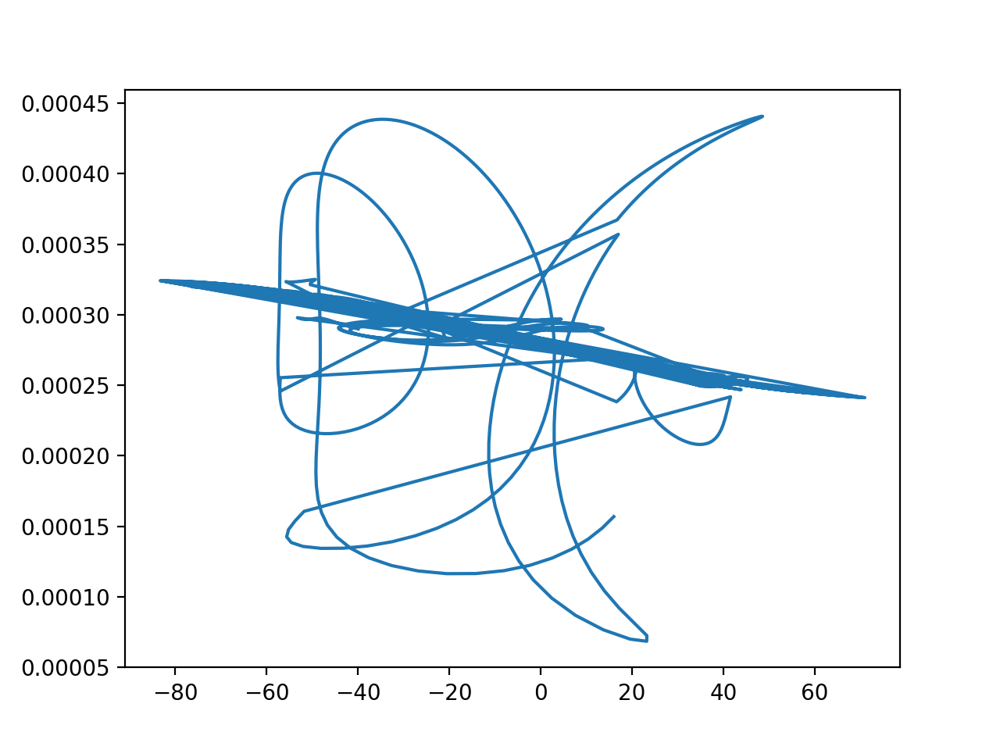

In [45]:
plt.figure()
plt.plot(alt_GEO, distance_GEO)
plt.show()

<IPython.core.display.Javascript object>


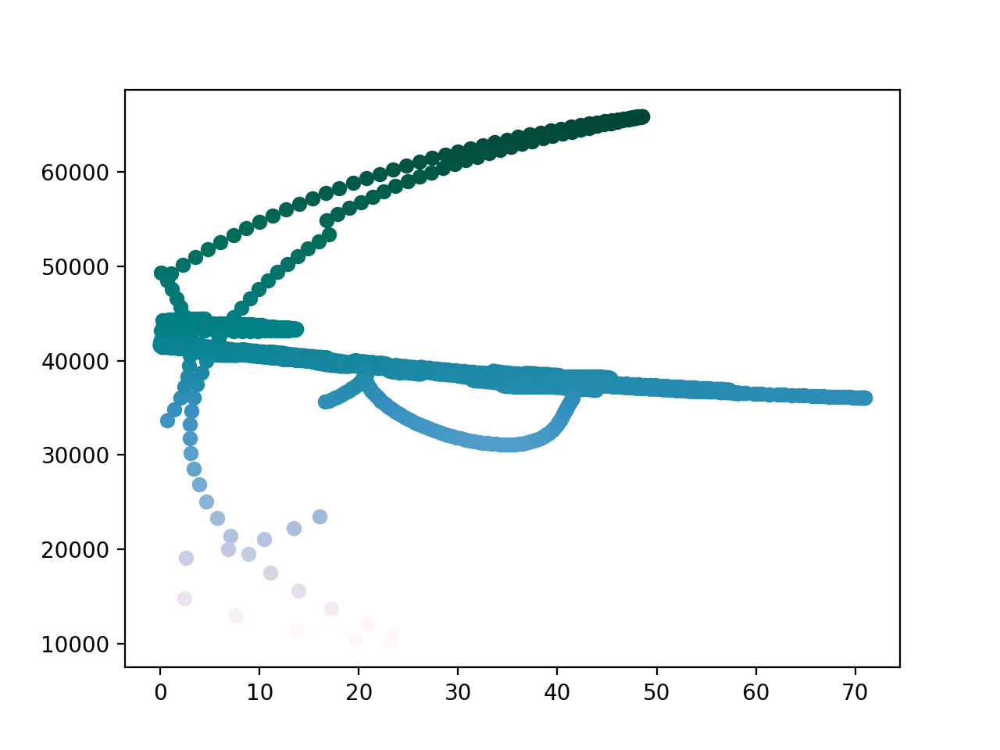

In [47]:
fig, ax = plt.subplots(1, 1)
for i in range(len(az_GEO)):
    if alt_GEO[i]> 0:
        ax.scatter(alt_GEO[i], (distance_GEO[i] * u.AU).to(u.km)/u.km, c = (distance_GEO[i] * u.AU).to(u.km)/u.km,
                   cmap = 'PuBuGn', 
                    norm = 'symlog', vmin = 12000, vmax = np.max((distance_GEO * u.AU).to(u.km)/u.km),
                    label = str(distance_GEO[i]) + ' AU')
#plt.legend(fontsize = 7, ncols = 3)
    #fig.colorbar(ax.scatter(az_GEO[i], np.abs(alt_GEO[i]-90), c = distance_GEO[i], cmap = 'PuBuGn', 
     #           norm = 'symlog', vmin = 0, vmax = np.max(distance_GEO),
      #          label = str(distance_GEO[i]) + ' AU'))
plt.xlabel('Altitude (deg)')
plt.ylabel('Distance (km)')
plt.show()

<IPython.core.display.Javascript object>


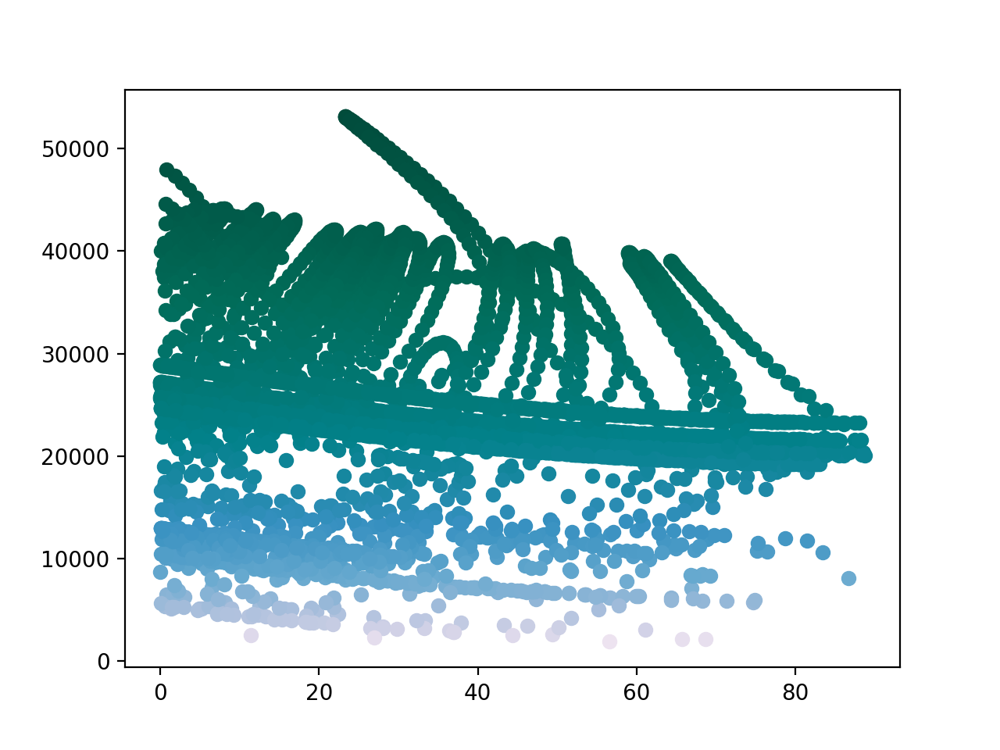

In [49]:
fig, ax = plt.subplots(1, 1)
for i in range(len(az_MEO)):
    if alt_MEO[i] > 0:
        ax.scatter(alt_MEO[i], (distance_MEO[i] * u.AU).to(u.km)/u.km, c = (distance_MEO[i] * u.AU).to(u.km)/u.km, 
                   cmap = 'PuBuGn', 
                    norm = 'symlog', vmin = 1200, vmax = np.max((distance_MEO * u.AU).to(u.km)/u.km))
#plt.legend(fontsize = 7, ncols = 3)
    #fig.colorbar(ax.scatter(az_MEO[i], np.abs(alt_MEO[i]-90), c = distance_MEO[i], cmap = 'PuBuGn', 
     #           norm = 'symlog', vmin = 0, vmax = np.max(distance_MEO),
      #          label = str(distance_MEO[i]) + ' AU'))
plt.xlabel('Altitude (deg)')
plt.ylabel('Distance (km)')
plt.show()

In [52]:
%%time
ags = []
for i in range(len(distance_LEO)):
    #print(i)
    if distance_LEO[i] != np.max(distance_LEO):
        ags.append((distance_LEO[i] * u.AU).to(u.km)/u.km)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061


3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699
3700
3701
3702
3703
3704
3705
3706
3707
3708


5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338
5339
5340
5341
5342
5343
5344
5345
5346
5347
5348
5349


6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986
6987
6988
6989
6990
6991
6992
6993
6994
6995
6996
6997


8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616
8617
8618
8619
8620
8621
8622
8623
8624
8625
8626
8627
8628
8629
8630
8631
8632
8633
8634
8635
8636
8637


10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
10213
10214
10215
10216
10217
10218
10219
10220
10221
10222
10223
10224
10225
10226
10227
10228
10229
10230
10231
10232
10233
10234
10235
1023

11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
11579
11580
11581
11582
11583
11584
11585
11586
11587
11588
11589
11590
11591
11592
11593
11594
11595
11596
11597
11598
11599
11600
11601
11602
11603
11604
11605
11606
11607
11608
11609
1161

12810
12811
12812
12813
12814
12815
12816
12817
12818
12819
12820
12821
12822
12823
12824
12825
12826
12827
12828
12829
12830
12831
12832
12833
12834
12835
12836
12837
12838
12839
12840
12841
12842
12843
12844
12845
12846
12847
12848
12849
12850
12851
12852
12853
12854
12855
12856
12857
12858
12859
12860
12861
12862
12863
12864
12865
12866
12867
12868
12869
12870
12871
12872
12873
12874
12875
12876
12877
12878
12879
12880
12881
12882
12883
12884
12885
12886
12887
12888
12889
12890
12891
12892
12893
12894
12895
12896
12897
12898
12899
12900
12901
12902
12903
12904
12905
12906
12907
12908
12909
12910
12911
12912
12913
12914
12915
12916
12917
12918
12919
12920
12921
12922
12923
12924
12925
12926
12927
12928
12929
12930
12931
12932
12933
12934
12935
12936
12937
12938
12939
12940
12941
12942
12943
12944
12945
12946
12947
12948
12949
12950
12951
12952
12953
12954
12955
12956
12957
12958
12959
12960
12961
12962
12963
12964
12965
12966
12967
12968
12969
12970
12971
12972
12973
12974
12975
1297

14176
14177
14178
14179
14180
14181
14182
14183
14184
14185
14186
14187
14188
14189
14190
14191
14192
14193
14194
14195
14196
14197
14198
14199
14200
14201
14202
14203
14204
14205
14206
14207
14208
14209
14210
14211
14212
14213
14214
14215
14216
14217
14218
14219
14220
14221
14222
14223
14224
14225
14226
14227
14228
14229
14230
14231
14232
14233
14234
14235
14236
14237
14238
14239
14240
14241
14242
14243
14244
14245
14246
14247
14248
14249
14250
14251
14252
14253
14254
14255
14256
14257
14258
14259
14260
14261
14262
14263
14264
14265
14266
14267
14268
14269
14270
14271
14272
14273
14274
14275
14276
14277
14278
14279
14280
14281
14282
14283
14284
14285
14286
14287
14288
14289
14290
14291
14292
14293
14294
14295
14296
14297
14298
14299
14300
14301
14302
14303
14304
14305
14306
14307
14308
14309
14310
14311
14312
14313
14314
14315
14316
14317
14318
14319
14320
14321
14322
14323
14324
14325
14326
14327
14328
14329
14330
14331
14332
14333
14334
14335
14336
14337
14338
14339
14340
14341
1434

15542
15543
15544
15545
15546
15547
15548
15549
15550
15551
15552
15553
15554
15555
15556
15557
15558
15559
15560
15561
15562
15563
15564
15565
15566
15567
15568
15569
15570
15571
15572
15573
15574
15575
15576
15577
15578
15579
15580
15581
15582
15583
15584
15585
15586
15587
15588
15589
15590
15591
15592
15593
15594
15595
15596
15597
15598
15599
15600
15601
15602
15603
15604
15605
15606
15607
15608
15609
15610
15611
15612
15613
15614
15615
15616
15617
15618
15619
15620
15621
15622
15623
15624
15625
15626
15627
15628
15629
15630
15631
15632
15633
15634
15635
15636
15637
15638
15639
15640
15641
15642
15643
15644
15645
15646
15647
15648
15649
15650
15651
15652
15653
15654
15655
15656
15657
15658
15659
15660
15661
15662
15663
15664
15665
15666
15667
15668
15669
15670
15671
15672
15673
15674
15675
15676
15677
15678
15679
15680
15681
15682
15683
15684
15685
15686
15687
15688
15689
15690
15691
15692
15693
15694
15695
15696
15697
15698
15699
15700
15701
15702
15703
15704
15705
15706
15707
1570

16917
16918
16919
16920
16921
16922
16923
16924
16925
16926
16927
16928
16929
16930
16931
16932
16933
16934
16935
16936
16937
16938
16939
16940
16941
16942
16943
16944
16945
16946
16947
16948
16949
16950
16951
16952
16953
16954
16955
16956
16957
16958
16959
16960
16961
16962
16963
16964
16965
16966
16967
16968
16969
16970
16971
16972
16973
16974
16975
16976
16977
16978
16979
16980
16981
16982
16983
16984
16985
16986
16987
16988
16989
16990
16991
16992
16993
16994
16995
16996
16997
16998
16999
17000
17001
17002
17003
17004
17005
17006
17007
17008
17009
17010
17011
17012
17013
17014
17015
17016
17017
17018
17019
17020
17021
17022
17023
17024
17025
17026
17027
17028
17029
17030
17031
17032
17033
17034
17035
17036
17037
17038
17039
17040
17041
17042
17043
17044
17045
17046
17047
17048
17049
17050
17051
17052
17053
17054
17055
17056
17057
17058
17059
17060
17061
17062
17063
17064
17065
17066
17067
17068
17069
17070
17071
17072
17073
17074
17075
17076
17077
17078
17079
17080
17081
17082
1708

18285
18286
18287
18288
18289
18290
18291
18292
18293
18294
18295
18296
18297
18298
18299
18300
18301
18302
18303
18304
18305
18306
18307
18308
18309
18310
18311
18312
18313
18314
18315
18316
18317
18318
18319
18320
18321
18322
18323
18324
18325
18326
18327
18328
18329
18330
18331
18332
18333
18334
18335
18336
18337
18338
18339
18340
18341
18342
18343
18344
18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18413
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18435
18436
18437
18438
18439
18440
18441
18442
18443
18444
18445
18446
18447
18448
18449
18450
1845

19655
19656
19657
19658
19659
19660
19661
19662
19663
19664
19665
19666
19667
19668
19669
19670
19671
19672
19673
19674
19675
19676
19677
19678
19679
19680
19681
19682
19683
19684
19685
19686
19687
19688
19689
19690
19691
19692
19693
19694
19695
19696
19697
19698
19699
19700
19701
19702
19703
19704
19705
19706
19707
19708
19709
19710
19711
19712
19713
19714
19715
19716
19717
19718
19719
19720
19721
19722
19723
19724
19725
19726
19727
19728
19729
19730
19731
19732
19733
19734
19735
19736
19737
19738
19739
19740
19741
19742
19743
19744
19745
19746
19747
19748
19749
19750
19751
19752
19753
19754
19755
19756
19757
19758
19759
19760
19761
19762
19763
19764
19765
19766
19767
19768
19769
19770
19771
19772
19773
19774
19775
19776
19777
19778
19779
19780
19781
19782
19783
19784
19785
19786
19787
19788
19789
19790
19791
19792
19793
19794
19795
19796
19797
19798
19799
19800
19801
19802
19803
19804
19805
19806
19807
19808
19809
19810
19811
19812
19813
19814
19815
19816
19817
19818
19819
19820
1982

21024
21025
21026
21027
21028
21029
21030
21031
21032
21033
21034
21035
21036
21037
21038
21039
21040
21041
21042
21043
21044
21045
21046
21047
21048
21049
21050
21051
21052
21053
21054
21055
21056
21057
21058
21059
21060
21061
21062
21063
21064
21065
21066
21067
21068
21069
21070
21071
21072
21073
21074
21075
21076
21077
21078
21079
21080
21081
21082
21083
21084
21085
21086
21087
21088
21089
21090
21091
21092
21093
21094
21095
21096
21097
21098
21099
21100
21101
21102
21103
21104
21105
21106
21107
21108
21109
21110
21111
21112
21113
21114
21115
21116
21117
21118
21119
21120
21121
21122
21123
21124
21125
21126
21127
21128
21129
21130
21131
21132
21133
21134
21135
21136
21137
21138
21139
21140
21141
21142
21143
21144
21145
21146
21147
21148
21149
21150
21151
21152
21153
21154
21155
21156
21157
21158
21159
21160
21161
21162
21163
21164
21165
21166
21167
21168
21169
21170
21171
21172
21173
21174
21175
21176
21177
21178
21179
21180
21181
21182
21183
21184
21185
21186
21187
21188
21189
2119

22392
22393
22394
22395
22396
22397
22398
22399
22400
22401
22402
22403
22404
22405
22406
22407
22408
22409
22410
22411
22412
22413
22414
22415
22416
22417
22418
22419
22420
22421
22422
22423
22424
22425
22426
22427
22428
22429
22430
22431
22432
22433
22434
22435
22436
22437
22438
22439
22440
22441
22442
22443
22444
22445
22446
22447
22448
22449
22450
22451
22452
22453
22454
22455
22456
22457
22458
22459
22460
22461
22462
22463
22464
22465
22466
22467
22468
22469
22470
22471
22472
22473
22474
22475
22476
22477
22478
22479
22480
22481
22482
22483
22484
22485
22486
22487
22488
22489
22490
22491
22492
22493
22494
22495
22496
22497
22498
22499
22500
22501
22502
22503
22504
22505
22506
22507
22508
22509
22510
22511
22512
22513
22514
22515
22516
22517
22518
22519
22520
22521
22522
22523
22524
22525
22526
22527
22528
22529
22530
22531
22532
22533
22534
22535
22536
22537
22538
22539
22540
22541
22542
22543
22544
22545
22546
22547
22548
22549
22550
22551
22552
22553
22554
22555
22556
22557
2255

23762
23763
23764
23765
23766
23767
23768
23769
23770
23771
23772
23773
23774
23775
23776
23777
23778
23779
23780
23781
23782
23783
23784
23785
23786
23787
23788
23789
23790
23791
23792
23793
23794
23795
23796
23797
23798
23799
23800
23801
23802
23803
23804
23805
23806
23807
23808
23809
23810
23811
23812
23813
23814
23815
23816
23817
23818
23819
23820
23821
23822
23823
23824
23825
23826
23827
23828
23829
23830
23831
23832
23833
23834
23835
23836
23837
23838
23839
23840
23841
23842
23843
23844
23845
23846
23847
23848
23849
23850
23851
23852
23853
23854
23855
23856
23857
23858
23859
23860
23861
23862
23863
23864
23865
23866
23867
23868
23869
23870
23871
23872
23873
23874
23875
23876
23877
23878
23879
23880
23881
23882
23883
23884
23885
23886
23887
23888
23889
23890
23891
23892
23893
23894
23895
23896
23897
23898
23899
23900
23901
23902
23903
23904
23905
23906
23907
23908
23909
23910
23911
23912
23913
23914
23915
23916
23917
23918
23919
23920
23921
23922
23923
23924
23925
23926
23927
2392

25128
25129
25130
25131
25132
25133
25134
25135
25136
25137
25138
25139
25140
25141
25142
25143
25144
25145
25146
25147
25148
25149
25150
25151
25152
25153
25154
25155
25156
25157
25158
25159
25160
25161
25162
25163
25164
25165
25166
25167
25168
25169
25170
25171
25172
25173
25174
25175
25176
25177
25178
25179
25180
25181
25182
25183
25184
25185
25186
25187
25188
25189
25190
25191
25192
25193
25194
25195
25196
25197
25198
25199
25200
25201
25202
25203
25204
25205
25206
25207
25208
25209
25210
25211
25212
25213
25214
25215
25216
25217
25218
25219
25220
25221
25222
25223
25224
25225
25226
25227
25228
25229
25230
25231
25232
25233
25234
25235
25236
25237
25238
25239
25240
25241
25242
25243
25244
25245
25246
25247
25248
25249
25250
25251
25252
25253
25254
25255
25256
25257
25258
25259
25260
25261
25262
25263
25264
25265
25266
25267
25268
25269
25270
25271
25272
25273
25274
25275
25276
25277
25278
25279
25280
25281
25282
25283
25284
25285
25286
25287
25288
25289
25290
25291
25292
25293
2529

26494
26495
26496
26497
26498
26499
26500
26501
26502
26503
26504
26505
26506
26507
26508
26509
26510
26511
26512
26513
26514
26515
26516
26517
26518
26519
26520
26521
26522
26523
26524
26525
26526
26527
26528
26529
26530
26531
26532
26533
26534
26535
26536
26537
26538
26539
26540
26541
26542
26543
26544
26545
26546
26547
26548
26549
26550
26551
26552
26553
26554
26555
26556
26557
26558
26559
26560
26561
26562
26563
26564
26565
26566
26567
26568
26569
26570
26571
26572
26573
26574
26575
26576
26577
26578
26579
26580
26581
26582
26583
26584
26585
26586
26587
26588
26589
26590
26591
26592
26593
26594
26595
26596
26597
26598
26599
26600
26601
26602
26603
26604
26605
26606
26607
26608
26609
26610
26611
26612
26613
26614
26615
26616
26617
26618
26619
26620
26621
26622
26623
26624
26625
26626
26627
26628
26629
26630
26631
26632
26633
26634
26635
26636
26637
26638
26639
26640
26641
26642
26643
26644
26645
26646
26647
26648
26649
26650
26651
26652
26653
26654
26655
26656
26657
26658
26659
2666

27866
27867
27868
27869
27870
27871
27872
27873
27874
27875
27876
27877
27878
27879
27880
27881
27882
27883
27884
27885
27886
27887
27888
27889
27890
27891
27892
27893
27894
27895
27896
27897
27898
27899
27900
27901
27902
27903
27904
27905
27906
27907
27908
27909
27910
27911
27912
27913
27914
27915
27916
27917
27918
27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
27964
27965
27966
27967
27968
27969
27970
27971
27972
27973
27974
27975
27976
27977
27978
27979
27980
27981
27982
27983
27984
27985
27986
27987
27988
27989
27990
27991
27992
27993
27994
27995
27996
27997
27998
27999
28000
28001
28002
28003
28004
28005
28006
28007
28008
28009
28010
28011
28012
28013
28014
28015
28016
28017
28018
28019
28020
28021
28022
28023
28024
28025
28026
28027
28028
28029
28030
28031
2803

29239
29240
29241
29242
29243
29244
29245
29246
29247
29248
29249
29250
29251
29252
29253
29254
29255
29256
29257
29258
29259
29260
29261
29262
29263
29264
29265
29266
29267
29268
29269
29270
29271
29272
29273
29274
29275
29276
29277
29278
29279
29280
29281
29282
29283
29284
29285
29286
29287
29288
29289
29290
29291
29292
29293
29294
29295
29296
29297
29298
29299
29300
29301
29302
29303
29304
29305
29306
29307
29308
29309
29310
29311
29312
29313
29314
29315
29316
29317
29318
29319
29320
29321
29322
29323
29324
29325
29326
29327
29328
29329
29330
29331
29332
29333
29334
29335
29336
29337
29338
29339
29340
29341
29342
29343
29344
29345
29346
29347
29348
29349
29350
29351
29352
29353
29354
29355
29356
29357
29358
29359
29360
29361
29362
29363
29364
29365
29366
29367
29368
29369
29370
29371
29372
29373
29374
29375
29376
29377
29378
29379
29380
29381
29382
29383
29384
29385
29386
29387
29388
29389
29390
29391
29392
29393
29394
29395
29396
29397
29398
29399
29400
29401
29402
29403
29404
2940

30607
30608
30609
30610
30611
30612
30613
30614
30615
30616
30617
30618
30619
30620
30621
30622
30623
30624
30625
30626
30627
30628
30629
30630
30631
30632
30633
30634
30635
30636
30637
30638
30639
30640
30641
30642
30643
30644
30645
30646
30647
30648
30649
30650
30651
30652
30653
30654
30655
30656
30657
30658
30659
30660
30661
30662
30663
30664
30665
30666
30667
30668
30669
30670
30671
30672
30673
30674
30675
30676
30677
30678
30679
30680
30681
30682
30683
30684
30685
30686
30687
30688
30689
30690
30691
30692
30693
30694
30695
30696
30697
30698
30699
30700
30701
30702
30703
30704
30705
30706
30707
30708
30709
30710
30711
30712
30713
30714
30715
30716
30717
30718
30719
30720
30721
30722
30723
30724
30725
30726
30727
30728
30729
30730
30731
30732
30733
30734
30735
30736
30737
30738
30739
30740
30741
30742
30743
30744
30745
30746
30747
30748
30749
30750
30751
30752
30753
30754
30755
30756
30757
30758
30759
30760
30761
30762
30763
30764
30765
30766
30767
30768
30769
30770
30771
30772
3077

31978
31979
31980
31981
31982
31983
31984
31985
31986
31987
31988
31989
31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
32011
32012
32013
32014
32015
32016
32017
32018
32019
32020
32021
32022
32023
32024
32025
32026
32027
32028
32029
32030
32031
32032
32033
32034
32035
32036
32037
32038
32039
32040
32041
32042
32043
32044
32045
32046
32047
32048
32049
32050
32051
32052
32053
32054
32055
32056
32057
32058
32059
32060
32061
32062
32063
32064
32065
32066
32067
32068
32069
32070
32071
32072
32073
32074
32075
32076
32077
32078
32079
32080
32081
32082
32083
32084
32085
32086
32087
32088
32089
32090
32091
32092
32093
32094
32095
32096
32097
32098
32099
32100
32101
32102
32103
32104
32105
32106
32107
32108
32109
32110
32111
32112
32113
32114
32115
32116
32117
32118
32119
32120
32121
32122
32123
32124
32125
32126
32127
32128
32129
32130
32131
32132
32133
32134
32135
32136
32137
32138
32139
32140
32141
32142
32143
3214

33345
33346
33347
33348
33349
33350
33351
33352
33353
33354
33355
33356
33357
33358
33359
33360
33361
33362
33363
33364
33365
33366
33367
33368
33369
33370
33371
33372
33373
33374
33375
33376
33377
33378
33379
33380
33381
33382
33383
33384
33385
33386
33387
33388
33389
33390
33391
33392
33393
33394
33395
33396
33397
33398
33399
33400
33401
33402
33403
33404
33405
33406
33407
33408
33409
33410
33411
33412
33413
33414
33415
33416
33417
33418
33419
33420
33421
33422
33423
33424
33425
33426
33427
33428
33429
33430
33431
33432
33433
33434
33435
33436
33437
33438
33439
33440
33441
33442
33443
33444
33445
33446
33447
33448
33449
33450
33451
33452
33453
33454
33455
33456
33457
33458
33459
33460
33461
33462
33463
33464
33465
33466
33467
33468
33469
33470
33471
33472
33473
33474
33475
33476
33477
33478
33479
33480
33481
33482
33483
33484
33485
33486
33487
33488
33489
33490
33491
33492
33493
33494
33495
33496
33497
33498
33499
33500
33501
33502
33503
33504
33505
33506
33507
33508
33509
33510
3351

34716
34717
34718
34719
34720
34721
34722
34723
34724
34725
34726
34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
34776
34777
34778
34779
34780
34781
34782
34783
34784
34785
34786
34787
34788
34789
34790
34791
34792
34793
34794
34795
34796
34797
34798
34799
34800
34801
34802
34803
34804
34805
34806
34807
34808
34809
34810
34811
34812
34813
34814
34815
34816
34817
34818
34819
34820
34821
34822
34823
34824
34825
34826
34827
34828
34829
34830
34831
34832
34833
34834
34835
34836
34837
34838
34839
34840
34841
34842
34843
34844
34845
34846
34847
34848
34849
34850
34851
34852
34853
34854
34855
34856
34857
34858
34859
34860
34861
34862
34863
34864
34865
34866
34867
34868
34869
34870
34871
34872
34873
34874
34875
34876
34877
34878
34879
34880
34881
3488

36083
36084
36085
36086
36087
36088
36089
36090
36091
36092
36093
36094
36095
36096
36097
36098
36099
36100
36101
36102
36103
36104
36105
36106
36107
36108
36109
36110
36111
36112
36113
36114
36115
36116
36117
36118
36119
36120
36121
36122
36123
36124
36125
36126
36127
36128
36129
36130
36131
36132
36133
36134
36135
36136
36137
36138
36139
36140
36141
36142
36143
36144
36145
36146
36147
36148
36149
36150
36151
36152
36153
36154
36155
36156
36157
36158
36159
36160
36161
36162
36163
36164
36165
36166
36167
36168
36169
36170
36171
36172
36173
36174
36175
36176
36177
36178
36179
36180
36181
36182
36183
36184
36185
36186
36187
36188
36189
36190
36191
36192
36193
36194
36195
36196
36197
36198
36199
36200
36201
36202
36203
36204
36205
36206
36207
36208
36209
36210
36211
36212
36213
36214
36215
36216
36217
36218
36219
36220
36221
36222
36223
36224
36225
36226
36227
36228
36229
36230
36231
36232
36233
36234
36235
36236
36237
36238
36239
36240
36241
36242
36243
36244
36245
36246
36247
36248
3624

37455
37456
37457
37458
37459
37460
37461
37462
37463
37464
37465
37466
37467
37468
37469
37470
37471
37472
37473
37474
37475
37476
37477
37478
37479
37480
37481
37482
37483
37484
37485
37486
37487
37488
37489
37490
37491
37492
37493
37494
37495
37496
37497
37498
37499
37500
37501
37502
37503
37504
37505
37506
37507
37508
37509
37510
37511
37512
37513
37514
37515
37516
37517
37518
37519
37520
37521
37522
37523
37524
37525
37526
37527
37528
37529
37530
37531
37532
37533
37534
37535
37536
37537
37538
37539
37540
37541
37542
37543
37544
37545
37546
37547
37548
37549
37550
37551
37552
37553
37554
37555
37556
37557
37558
37559
37560
37561
37562
37563
37564
37565
37566
37567
37568
37569
37570
37571
37572
37573
37574
37575
37576
37577
37578
37579
37580
37581
37582
37583
37584
37585
37586
37587
37588
37589
37590
37591
37592
37593
37594
37595
37596
37597
37598
37599
37600
37601
37602
37603
37604
37605
37606
37607
37608
37609
37610
37611
37612
37613
37614
37615
37616
37617
37618
37619
37620
3762

38828
38829
38830
38831
38832
38833
38834
38835
38836
38837
38838
38839
38840
38841
38842
38843
38844
38845
38846
38847
38848
38849
38850
38851
38852
38853
38854
38855
38856
38857
38858
38859
38860
38861
38862
38863
38864
38865
38866
38867
38868
38869
38870
38871
38872
38873
38874
38875
38876
38877
38878
38879
38880
38881
38882
38883
38884
38885
38886
38887
38888
38889
38890
38891
38892
38893
38894
38895
38896
38897
38898
38899
38900
38901
38902
38903
38904
38905
38906
38907
38908
38909
38910
38911
38912
38913
38914
38915
38916
38917
38918
38919
38920
38921
38922
38923
38924
38925
38926
38927
38928
38929
38930
38931
38932
38933
38934
38935
38936
38937
38938
38939
38940
38941
38942
38943
38944
38945
38946
38947
38948
38949
38950
38951
38952
38953
38954
38955
38956
38957
38958
38959
38960
38961
38962
38963
38964
38965
38966
38967
38968
38969
38970
38971
38972
38973
38974
38975
38976
38977
38978
38979
38980
38981
38982
38983
38984
38985
38986
38987
38988
38989
38990
38991
38992
38993
3899

40201
40202
40203
40204
40205
40206
40207
40208
40209
40210
40211
40212
40213
40214
40215
40216
40217
40218
40219
40220
40221
40222
40223
40224
40225
40226
40227
40228
40229
40230
40231
40232
40233
40234
40235
40236
40237
40238
40239
40240
40241
40242
40243
40244
40245
40246
40247
40248
40249
40250
40251
40252
40253
40254
40255
40256
40257
40258
40259
40260
40261
40262
40263
40264
40265
40266
40267
40268
40269
40270
40271
40272
40273
40274
40275
40276
40277
40278
40279
40280
40281
40282
40283
40284
40285
40286
40287
40288
40289
40290
40291
40292
40293
40294
40295
40296
40297
40298
40299
40300
40301
40302
40303
40304
40305
40306
40307
40308
40309
40310
40311
40312
40313
40314
40315
40316
40317
40318
40319
40320
40321
40322
40323
40324
40325
40326
40327
40328
40329
40330
40331
40332
40333
40334
40335
40336
40337
40338
40339
40340
40341
40342
40343
40344
40345
40346
40347
40348
40349
40350
40351
40352
40353
40354
40355
40356
40357
40358
40359
40360
40361
40362
40363
40364
40365
40366
4036

41568
41569
41570
41571
41572
41573
41574
41575
41576
41577
41578
41579
41580
41581
41582
41583
41584
41585
41586
41587
41588
41589
41590
41591
41592
41593
41594
41595
41596
41597
41598
41599
41600
41601
41602
41603
41604
41605
41606
41607
41608
41609
41610
41611
41612
41613
41614
41615
41616
41617
41618
41619
41620
41621
41622
41623
41624
41625
41626
41627
41628
41629
41630
41631
41632
41633
41634
41635
41636
41637
41638
41639
41640
41641
41642
41643
41644
41645
41646
41647
41648
41649
41650
41651
41652
41653
41654
41655
41656
41657
41658
41659
41660
41661
41662
41663
41664
41665
41666
41667
41668
41669
41670
41671
41672
41673
41674
41675
41676
41677
41678
41679
41680
41681
41682
41683
41684
41685
41686
41687
41688
41689
41690
41691
41692
41693
41694
41695
41696
41697
41698
41699
41700
41701
41702
41703
41704
41705
41706
41707
41708
41709
41710
41711
41712
41713
41714
41715
41716
41717
41718
41719
41720
41721
41722
41723
41724
41725
41726
41727
41728
41729
41730
41731
41732
41733
4173

42940
42941
42942
42943
42944
42945
42946
42947
42948
42949
42950
42951
42952
42953
42954
42955
42956
42957
42958
42959
42960
42961
42962
42963
42964
42965
42966
42967
42968
42969
42970
42971
42972
42973
42974
42975
42976
42977
42978
42979
42980
42981
42982
42983
42984
42985
42986
42987
42988
42989
42990
42991
42992
42993
42994
42995
42996
42997
42998
42999
43000
43001
43002
43003
43004
43005
43006
43007
43008
43009
43010
43011
43012
43013
43014
43015
43016
43017
43018
43019
43020
43021
43022
43023
43024
43025
43026
43027
43028
43029
43030
43031
43032
43033
43034
43035
43036
43037
43038
43039
43040
43041
43042
43043
43044
43045
43046
43047
43048
43049
43050
43051
43052
43053
43054
43055
43056
43057
43058
43059
43060
43061
43062
43063
43064
43065
43066
43067
43068
43069
43070
43071
43072
43073
43074
43075
43076
43077
43078
43079
43080
43081
43082
43083
43084
43085
43086
43087
43088
43089
43090
43091
43092
43093
43094
43095
43096
43097
43098
43099
43100
43101
43102
43103
43104
43105
4310

44309
44310
44311
44312
44313
44314
44315
44316
44317
44318
44319
44320
44321
44322
44323
44324
44325
44326
44327
44328
44329
44330
44331
44332
44333
44334
44335
44336
44337
44338
44339
44340
44341
44342
44343
44344
44345
44346
44347
44348
44349
44350
44351
44352
44353
44354
44355
44356
44357
44358
44359
44360
44361
44362
44363
44364
44365
44366
44367
44368
44369
44370
44371
44372
44373
44374
44375
44376
44377
44378
44379
44380
44381
44382
44383
44384
44385
44386
44387
44388
44389
44390
44391
44392
44393
44394
44395
44396
44397
44398
44399
44400
44401
44402
44403
44404
44405
44406
44407
44408
44409
44410
44411
44412
44413
44414
44415
44416
44417
44418
44419
44420
44421
44422
44423
44424
44425
44426
44427
44428
44429
44430
44431
44432
44433
44434
44435
44436
44437
44438
44439
44440
44441
44442
44443
44444
44445
44446
44447
44448
44449
44450
44451
44452
44453
44454
44455
44456
44457
44458
44459
44460
44461
44462
44463
44464
44465
44466
44467
44468
44469
44470
44471
44472
44473
44474
4447

45678
45679
45680
45681
45682
45683
45684
45685
45686
45687
45688
45689
45690
45691
45692
45693
45694
45695
45696
45697
45698
45699
45700
45701
45702
45703
45704
45705
45706
45707
45708
45709
45710
45711
45712
45713
45714
45715
45716
45717
45718
45719
45720
45721
45722
45723
45724
45725
45726
45727
45728
45729
45730
45731
45732
45733
45734
45735
45736
45737
45738
45739
45740
45741
45742
45743
45744
45745
45746
45747
45748
45749
45750
45751
45752
45753
45754
45755
45756
45757
45758
45759
45760
45761
45762
45763
45764
45765
45766
45767
45768
45769
45770
45771
45772
45773
45774
45775
45776
45777
45778
45779
45780
45781
45782
45783
45784
45785
45786
45787
45788
45789
45790
45791
45792
45793
45794
45795
45796
45797
45798
45799
45800
45801
45802
45803
45804
45805
45806
45807
45808
45809
45810
45811
45812
45813
45814
45815
45816
45817
45818
45819
45820
45821
45822
45823
45824
45825
45826
45827
45828
45829
45830
45831
45832
45833
45834
45835
45836
45837
45838
45839
45840
45841
45842
45843
4584

47046
47047
47048
47049
47050
47051
47052
47053
47054
47055
47056
47057
47058
47059
47060
47061
47062
47063
47064
47065
47066
47067
47068
47069
47070
47071
47072
47073
47074
47075
47076
47077
47078
47079
47080
47081
47082
47083
47084
47085
47086
47087
47088
47089
47090
47091
47092
47093
47094
47095
47096
47097
47098
47099
47100
47101
47102
47103
47104
47105
47106
47107
47108
47109
47110
47111
47112
47113
47114
47115
47116
47117
47118
47119
47120
47121
47122
47123
47124
47125
47126
47127
47128
47129
47130
47131
47132
47133
47134
47135
47136
47137
47138
47139
47140
47141
47142
47143
47144
47145
47146
47147
47148
47149
47150
47151
47152
47153
47154
47155
47156
47157
47158
47159
47160
47161
47162
47163
47164
47165
47166
47167
47168
47169
47170
47171
47172
47173
47174
47175
47176
47177
47178
47179
47180
47181
47182
47183
47184
47185
47186
47187
47188
47189
47190
47191
47192
47193
47194
47195
47196
47197
47198
47199
47200
47201
47202
47203
47204
47205
47206
47207
47208
47209
47210
47211
4721

48419
48420
48421
48422
48423
48424
48425
48426
48427
48428
48429
48430
48431
48432
48433
48434
48435
48436
48437
48438
48439
48440
48441
48442
48443
48444
48445
48446
48447
48448
48449
48450
48451
48452
48453
48454
48455
48456
48457
48458
48459
48460
48461
48462
48463
48464
48465
48466
48467
48468
48469
48470
48471
48472
48473
48474
48475
48476
48477
48478
48479
48480
48481
48482
48483
48484
48485
48486
48487
48488
48489
48490
48491
48492
48493
48494
48495
48496
48497
48498
48499
48500
48501
48502
48503
48504
48505
48506
48507
48508
48509
48510
48511
48512
48513
48514
48515
48516
48517
48518
48519
48520
48521
48522
48523
48524
48525
48526
48527
48528
48529
48530
48531
48532
48533
48534
48535
48536
48537
48538
48539
48540
48541
48542
48543
48544
48545
48546
48547
48548
48549
48550
48551
48552
48553
48554
48555
48556
48557
48558
48559
48560
48561
48562
48563
48564
48565
48566
48567
48568
48569
48570
48571
48572
48573
48574
48575
48576
48577
48578
48579
48580
48581
48582
48583
48584
4858

49793
49794
49795
49796
49797
49798
49799
49800
49801
49802
49803
49804
49805
49806
49807
49808
49809
49810
49811
49812
49813
49814
49815
49816
49817
49818
49819
49820
49821
49822
49823
49824
49825
49826
49827
49828
49829
49830
49831
49832
49833
49834
49835
49836
49837
49838
49839
49840
49841
49842
49843
49844
49845
49846
49847
49848
49849
49850
49851
49852
49853
49854
49855
49856
49857
49858
49859
49860
49861
49862
49863
49864
49865
49866
49867
49868
49869
49870
49871
49872
49873
49874
49875
49876
49877
49878
49879
49880
49881
49882
49883
49884
49885
49886
49887
49888
49889
49890
49891
49892
49893
49894
49895
49896
49897
49898
49899
49900
49901
49902
49903
49904
49905
49906
49907
49908
49909
49910
49911
49912
49913
49914
49915
49916
49917
49918
49919
49920
49921
49922
49923
49924
49925
49926
49927
49928
49929
49930
49931
49932
49933
49934
49935
49936
49937
49938
49939
49940
49941
49942
49943
49944
49945
49946
49947
49948
49949
49950
49951
49952
49953
49954
49955
49956
49957
49958
4995

51164
51165
51166
51167
51168
51169
51170
51171
51172
51173
51174
51175
51176
51177
51178
51179
51180
51181
51182
51183
51184
51185
51186
51187
51188
51189
51190
51191
51192
51193
51194
51195
51196
51197
51198
51199
51200
51201
51202
51203
51204
51205
51206
51207
51208
51209
51210
51211
51212
51213
51214
51215
51216
51217
51218
51219
51220
51221
51222
51223
51224
51225
51226
51227
51228
51229
51230
51231
51232
51233
51234
51235
51236
51237
51238
51239
51240
51241
51242
51243
51244
51245
51246
51247
51248
51249
51250
51251
51252
51253
51254
51255
51256
51257
51258
51259
51260
51261
51262
51263
51264
51265
51266
51267
51268
51269
51270
51271
51272
51273
51274
51275
51276
51277
51278
51279
51280
51281
51282
51283
51284
51285
51286
51287
51288
51289
51290
51291
51292
51293
51294
51295
51296
51297
51298
51299
51300
51301
51302
51303
51304
51305
51306
51307
51308
51309
51310
51311
51312
51313
51314
51315
51316
51317
51318
51319
51320
51321
51322
51323
51324
51325
51326
51327
51328
51329
5133

52533
52534
52535
52536
52537
52538
52539
52540
52541
52542
52543
52544
52545
52546
52547
52548
52549
52550
52551
52552
52553
52554
52555
52556
52557
52558
52559
52560
52561
52562
52563
52564
52565
52566
52567
52568
52569
52570
52571
52572
52573
52574
52575
52576
52577
52578
52579
52580
52581
52582
52583
52584
52585
52586
52587
52588
52589
52590
52591
52592
52593
52594
52595
52596
52597
52598
52599
52600
52601
52602
52603
52604
52605
52606
52607
52608
52609
52610
52611
52612
52613
52614
52615
52616
52617
52618
52619
52620
52621
52622
52623
52624
52625
52626
52627
52628
52629
52630
52631
52632
52633
52634
52635
52636
52637
52638
52639
52640
52641
52642
52643
52644
52645
52646
52647
52648
52649
52650
52651
52652
52653
52654
52655
52656
52657
52658
52659
52660
52661
52662
52663
52664
52665
52666
52667
52668
52669
52670
52671
52672
52673
52674
52675
52676
52677
52678
52679
52680
52681
52682
52683
52684
52685
52686
52687
52688
52689
52690
52691
52692
52693
52694
52695
52696
52697
52698
5269

53899
53900
53901
53902
53903
53904
53905
53906
53907
53908
53909
53910
53911
53912
53913
53914
53915
53916
53917
53918
53919
53920
53921
53922
53923
53924
53925
53926
53927
53928
53929
53930
53931
53932
53933
53934
53935
53936
53937
53938
53939
53940
53941
53942
53943
53944
53945
53946
53947
53948
53949
53950
53951
53952
53953
53954
53955
53956
53957
53958
53959
53960
53961
53962
53963
53964
53965
53966
53967
53968
53969
53970
53971
53972
53973
53974
53975
53976
53977
53978
53979
53980
53981
53982
53983
53984
53985
53986
53987
53988
53989
53990
53991
53992
53993
53994
53995
53996
53997
53998
53999
54000
54001
54002
54003
54004
54005
54006
54007
54008
54009
54010
54011
54012
54013
54014
54015
54016
54017
54018
54019
54020
54021
54022
54023
54024
54025
54026
54027
54028
54029
54030
54031
54032
54033
54034
54035
54036
54037
54038
54039
54040
54041
54042
54043
54044
54045
54046
54047
54048
54049
54050
54051
54052
54053
54054
54055
54056
54057
54058
54059
54060
54061
54062
54063
54064
5406

55274
55275
55276
55277
55278
55279
55280
55281
55282
55283
55284
55285
55286
55287
55288
55289
55290
55291
55292
55293
55294
55295
55296
55297
55298
55299
55300
55301
55302
55303
55304
55305
55306
55307
55308
55309
55310
55311
55312
55313
55314
55315
55316
55317
55318
55319
55320
55321
55322
55323
55324
55325
55326
55327
55328
55329
55330
55331
55332
55333
55334
55335
55336
55337
55338
55339
55340
55341
55342
55343
55344
55345
55346
55347
55348
55349
55350
55351
55352
55353
55354
55355
55356
55357
55358
55359
55360
55361
55362
55363
55364
55365
55366
55367
55368
55369
55370
55371
55372
55373
55374
55375
55376
55377
55378
55379
55380
55381
55382
55383
55384
55385
55386
55387
55388
55389
55390
55391
55392
55393
55394
55395
55396
55397
55398
55399
55400
55401
55402
55403
55404
55405
55406
55407
55408
55409
55410
55411
55412
55413
55414
55415
55416
55417
55418
55419
55420
55421
55422
55423
55424
55425
55426
55427
55428
55429
55430
55431
55432
55433
55434
55435
55436
55437
55438
55439
5544

56642
56643
56644
56645
56646
56647
56648
56649
56650
56651
56652
56653
56654
56655
56656
56657
56658
56659
56660
56661
56662
56663
56664
56665
56666
56667
56668
56669
56670
56671
56672
56673
56674
56675
56676
56677
56678
56679
56680
56681
56682
56683
56684
56685
56686
56687
56688
56689
56690
56691
56692
56693
56694
56695
56696
56697
56698
56699
56700
56701
56702
56703
56704
56705
56706
56707
56708
56709
56710
56711
56712
56713
56714
56715
56716
56717
56718
56719
56720
56721
56722
56723
56724
56725
56726
56727
56728
56729
56730
56731
56732
56733
56734
56735
56736
56737
56738
56739
56740
56741
56742
56743
56744
56745
56746
56747
56748
56749
56750
56751
56752
56753
56754
56755
56756
56757
56758
56759
56760
56761
56762
56763
56764
56765
56766
56767
56768
56769
56770
56771
56772
56773
56774
56775
56776
56777
56778
56779
56780
56781
56782
56783
56784
56785
56786
56787
56788
56789
56790
56791
56792
56793
56794
56795
56796
56797
56798
56799
56800
56801
56802
56803
56804
56805
56806
56807
5680

58014
58015
58016
58017
58018
58019
58020
58021
58022
58023
58024
58025
58026
58027
58028
58029
58030
58031
58032
58033
58034
58035
58036
58037
58038
58039
58040
58041
58042
58043
58044
58045
58046
58047
58048
58049
58050
58051
58052
58053
58054
58055
58056
58057
58058
58059
58060
58061
58062
58063
58064
58065
58066
58067
58068
58069
58070
58071
58072
58073
58074
58075
58076
58077
58078
58079
58080
58081
58082
58083
58084
58085
58086
58087
58088
58089
58090
58091
58092
58093
58094
58095
58096
58097
58098
58099
58100
58101
58102
58103
58104
58105
58106
58107
58108
58109
58110
58111
58112
58113
58114
58115
58116
58117
58118
58119
58120
58121
58122
58123
58124
58125
58126
58127
58128
58129
58130
58131
58132
58133
58134
58135
58136
58137
58138
58139
58140
58141
58142
58143
58144
58145
58146
58147
58148
58149
58150
58151
58152
58153
58154
58155
58156
58157
58158
58159
58160
58161
58162
58163
58164
58165
58166
58167
58168
58169
58170
58171
58172
58173
58174
58175
58176
58177
58178
58179
5818

59386
59387
59388
59389
59390
59391
59392
59393
59394
59395
59396
59397
59398
59399
59400
59401
59402
59403
59404
59405
59406
59407
59408
59409
59410
59411
59412
59413
59414
59415
59416
59417
59418
59419
59420
59421
59422
59423
59424
59425
59426
59427
59428
59429
59430
59431
59432
59433
59434
59435
59436
59437
59438
59439
59440
59441
59442
59443
59444
59445
59446
59447
59448
59449
59450
59451
59452
59453
59454
59455
59456
59457
59458
59459
59460
59461
59462
59463
59464
59465
59466
59467
59468
59469
59470
59471
59472
59473
59474
59475
59476
59477
59478
59479
59480
59481
59482
59483
59484
59485
59486
59487
59488
59489
59490
59491
59492
59493
59494
59495
59496
59497
59498
59499
59500
59501
59502
59503
59504
59505
59506
59507
59508
59509
59510
59511
59512
59513
59514
59515
59516
59517
59518
59519
59520
59521
59522
59523
59524
59525
59526
59527
59528
59529
59530
59531
59532
59533
59534
59535
59536
59537
59538
59539
59540
59541
59542
59543
59544
59545
59546
59547
59548
59549
59550
59551
5955

60754
60755
60756
60757
60758
60759
60760
60761
60762
60763
60764
60765
60766
60767
60768
60769
60770
60771
60772
60773
60774
60775
60776
60777
60778
60779
60780
60781
60782
60783
60784
60785
60786
60787
60788
60789
60790
60791
60792
60793
60794
60795
60796
60797
60798
60799
60800
60801
60802
60803
60804
60805
60806
60807
60808
60809
60810
60811
60812
60813
60814
60815
60816
60817
60818
60819
60820
60821
60822
60823
60824
60825
60826
60827
60828
60829
60830
60831
60832
60833
60834
60835
60836
60837
60838
60839
60840
60841
60842
60843
60844
60845
60846
60847
60848
60849
60850
60851
60852
60853
60854
60855
60856
60857
60858
60859
60860
60861
60862
60863
60864
60865
60866
60867
60868
60869
60870
60871
60872
60873
60874
60875
60876
60877
60878
60879
60880
60881
60882
60883
60884
60885
60886
60887
60888
60889
60890
60891
60892
60893
60894
60895
60896
60897
60898
60899
60900
60901
60902
60903
60904
60905
60906
60907
60908
60909
60910
60911
60912
60913
60914
60915
60916
60917
60918
60919
6092

62126
62127
62128
62129
62130
62131
62132
62133
62134
62135
62136
62137
62138
62139
62140
62141
62142
62143
62144
62145
62146
62147
62148
62149
62150
62151
62152
62153
62154
62155
62156
62157
62158
62159
62160
62161
62162
62163
62164
62165
62166
62167
62168
62169
62170
62171
62172
62173
62174
62175
62176
62177
62178
62179
62180
62181
62182
62183
62184
62185
62186
62187
62188
62189
62190
62191
62192
62193
62194
62195
62196
62197
62198
62199
62200
62201
62202
62203
62204
62205
62206
62207
62208
62209
62210
62211
62212
62213
62214
62215
62216
62217
62218
62219
62220
62221
62222
62223
62224
62225
62226
62227
62228
62229
62230
62231
62232
62233
62234
62235
62236
62237
62238
62239
62240
62241
62242
62243
62244
62245
62246
62247
62248
62249
62250
62251
62252
62253
62254
62255
62256
62257
62258
62259
62260
62261
62262
62263
62264
62265
62266
62267
62268
62269
62270
62271
62272
62273
62274
62275
62276
62277
62278
62279
62280
62281
62282
62283
62284
62285
62286
62287
62288
62289
62290
62291
6229

63497
63498
63499
63500
63501
63502
63503
63504
63505
63506
63507
63508
63509
63510
63511
63512
63513
63514
63515
63516
63517
63518
63519
63520
63521
63522
63523
63524
63525
63526
63527
63528
63529
63530
63531
63532
63533
63534
63535
63536
63537
63538
63539
63540
63541
63542
63543
63544
63545
63546
63547
63548
63549
63550
63551
63552
63553
63554
63555
63556
63557
63558
63559
63560
63561
63562
63563
63564
63565
63566
63567
63568
63569
63570
63571
63572
63573
63574
63575
63576
63577
63578
63579
63580
63581
63582
63583
63584
63585
63586
63587
63588
63589
63590
63591
63592
63593
63594
63595
63596
63597
63598
63599
63600
63601
63602
63603
63604
63605
63606
63607
63608
63609
63610
63611
63612
63613
63614
63615
63616
63617
63618
63619
63620
63621
63622
63623
63624
63625
63626
63627
63628
63629
63630
63631
63632
63633
63634
63635
63636
63637
63638
63639
63640
63641
63642
63643
63644
63645
63646
63647
63648
63649
63650
63651
63652
63653
63654
63655
63656
63657
63658
63659
63660
63661
63662
6366

64867
64868
64869
64870
64871
64872
64873
64874
64875
64876
64877
64878
64879
64880
64881
64882
64883
64884
64885
64886
64887
64888
64889
64890
64891
64892
64893
64894
64895
64896
64897
64898
64899
64900
64901
64902
64903
64904
64905
64906
64907
64908
64909
64910
64911
64912
64913
64914
64915
64916
64917
64918
64919
64920
64921
64922
64923
64924
64925
64926
64927
64928
64929
64930
64931
64932
64933
64934
64935
64936
64937
64938
64939
64940
64941
64942
64943
64944
64945
64946
64947
64948
64949
64950
64951
64952
64953
64954
64955
64956
64957
64958
64959
64960
64961
64962
64963
64964
64965
64966
64967
64968
64969
64970
64971
64972
64973
64974
64975
64976
64977
64978
64979
64980
64981
64982
64983
64984
64985
64986
64987
64988
64989
64990
64991
64992
64993
64994
64995
64996
64997
64998
64999
65000
65001
65002
65003
65004
65005
65006
65007
65008
65009
65010
65011
65012
65013
65014
65015
65016
65017
65018
65019
65020
65021
65022
65023
65024
65025
65026
65027
65028
65029
65030
65031
65032
6503

66240
66241
66242
66243
66244
66245
66246
66247
66248
66249
66250
66251
66252
66253
66254
66255
66256
66257
66258
66259
66260
66261
66262
66263
66264
66265
66266
66267
66268
66269
66270
66271
66272
66273
66274
66275
66276
66277
66278
66279
66280
66281
66282
66283
66284
66285
66286
66287
66288
66289
66290
66291
66292
66293
66294
66295
66296
66297
66298
66299
66300
66301
66302
66303
66304
66305
66306
66307
66308
66309
66310
66311
66312
66313
66314
66315
66316
66317
66318
66319
66320
66321
66322
66323
66324
66325
66326
66327
66328
66329
66330
66331
66332
66333
66334
66335
66336
66337
66338
66339
66340
66341
66342
66343
66344
66345
66346
66347
66348
66349
66350
66351
66352
66353
66354
66355
66356
66357
66358
66359
66360
66361
66362
66363
66364
66365
66366
66367
66368
66369
66370
66371
66372
66373
66374
66375
66376
66377
66378
66379
66380
66381
66382
66383
66384
66385
66386
66387
66388
66389
66390
66391
66392
66393
66394
66395
66396
66397
66398
66399
66400
66401
66402
66403
66404
66405
6640

67615
67616
67617
67618
67619
67620
67621
67622
67623
67624
67625
67626
67627
67628
67629
67630
67631
67632
67633
67634
67635
67636
67637
67638
67639
67640
67641
67642
67643
67644
67645
67646
67647
67648
67649
67650
67651
67652
67653
67654
67655
67656
67657
67658
67659
67660
67661
67662
67663
67664
67665
67666
67667
67668
67669
67670
67671
67672
67673
67674
67675
67676
67677
67678
67679
67680
67681
67682
67683
67684
67685
67686
67687
67688
67689
67690
67691
67692
67693
67694
67695
67696
67697
67698
67699
67700
67701
67702
67703
67704
67705
67706
67707
67708
67709
67710
67711
67712
67713
67714
67715
67716
67717
67718
67719
67720
67721
67722
67723
67724
67725
67726
67727
67728
67729
67730
67731
67732
67733
67734
67735
67736
67737
67738
67739
67740
67741
67742
67743
67744
67745
67746
67747
67748
67749
67750
67751
67752
67753
67754
67755
67756
67757
67758
67759
67760
67761
67762
67763
67764
67765
67766
67767
67768
67769
67770
67771
67772
67773
67774
67775
67776
67777
67778
67779
67780
6778

68989
68990
68991
68992
68993
68994
68995
68996
68997
68998
68999
69000
69001
69002
69003
69004
69005
69006
69007
69008
69009
69010
69011
69012
69013
69014
69015
69016
69017
69018
69019
69020
69021
69022
69023
69024
69025
69026
69027
69028
69029
69030
69031
69032
69033
69034
69035
69036
69037
69038
69039
69040
69041
69042
69043
69044
69045
69046
69047
69048
69049
69050
69051
69052
69053
69054
69055
69056
69057
69058
69059
69060
69061
69062
69063
69064
69065
69066
69067
69068
69069
69070
69071
69072
69073
69074
69075
69076
69077
69078
69079
69080
69081
69082
69083
69084
69085
69086
69087
69088
69089
69090
69091
69092
69093
69094
69095
69096
69097
69098
69099
69100
69101
69102
69103
69104
69105
69106
69107
69108
69109
69110
69111
69112
69113
69114
69115
69116
69117
69118
69119
69120
69121
69122
69123
69124
69125
69126
69127
69128
69129
69130
69131
69132
69133
69134
69135
69136
69137
69138
69139
69140
69141
69142
69143
69144
69145
69146
69147
69148
69149
69150
69151
69152
69153
69154
6915

70361
70362
70363
70364
70365
70366
70367
70368
70369
70370
70371
70372
70373
70374
70375
70376
70377
70378
70379
70380
70381
70382
70383
70384
70385
70386
70387
70388
70389
70390
70391
70392
70393
70394
70395
70396
70397
70398
70399
70400
70401
70402
70403
70404
70405
70406
70407
70408
70409
70410
70411
70412
70413
70414
70415
70416
70417
70418
70419
70420
70421
70422
70423
70424
70425
70426
70427
70428
70429
70430
70431
70432
70433
70434
70435
70436
70437
70438
70439
70440
70441
70442
70443
70444
70445
70446
70447
70448
70449
70450
70451
70452
70453
70454
70455
70456
70457
70458
70459
70460
70461
70462
70463
70464
70465
70466
70467
70468
70469
70470
70471
70472
70473
70474
70475
70476
70477
70478
70479
70480
70481
70482
70483
70484
70485
70486
70487
70488
70489
70490
70491
70492
70493
70494
70495
70496
70497
70498
70499
70500
70501
70502
70503
70504
70505
70506
70507
70508
70509
70510
70511
70512
70513
70514
70515
70516
70517
70518
70519
70520
70521
70522
70523
70524
70525
70526
7052

71730
71731
71732
71733
71734
71735
71736
71737
71738
71739
71740
71741
71742
71743
71744
71745
71746
71747
71748
71749
71750
71751
71752
71753
71754
71755
71756
71757
71758
71759
71760
71761
71762
71763
71764
71765
71766
71767
71768
71769
71770
71771
71772
71773
71774
71775
71776
71777
71778
71779
71780
71781
71782
71783
71784
71785
71786
71787
71788
71789
71790
71791
71792
71793
71794
71795
71796
71797
71798
71799
71800
71801
71802
71803
71804
71805
71806
71807
71808
71809
71810
71811
71812
71813
71814
71815
71816
71817
71818
71819
71820
71821
71822
71823
71824
71825
71826
71827
71828
71829
71830
71831
71832
71833
71834
71835
71836
71837
71838
71839
71840
71841
71842
71843
71844
71845
71846
71847
71848
71849
71850
71851
71852
71853
71854
71855
71856
71857
71858
71859
71860
71861
71862
71863
71864
71865
71866
71867
71868
71869
71870
71871
71872
71873
71874
71875
71876
71877
71878
71879
71880
71881
71882
71883
71884
71885
71886
71887
71888
71889
71890
71891
71892
71893
71894
71895
7189

73098
73099
73100
73101
73102
73103
73104
73105
73106
73107
73108
73109
73110
73111
73112
73113
73114
73115
73116
73117
73118
73119
73120
73121
73122
73123
73124
73125
73126
73127
73128
73129
73130
73131
73132
73133
73134
73135
73136
73137
73138
73139
73140
73141
73142
73143
73144
73145
73146
73147
73148
73149
73150
73151
73152
73153
73154
73155
73156
73157
73158
73159
73160
73161
73162
73163
73164
73165
73166
73167
73168
73169
73170
73171
73172
73173
73174
73175
73176
73177
73178
73179
73180
73181
73182
73183
73184
73185
73186
73187
73188
73189
73190
73191
73192
73193
73194
73195
73196
73197
73198
73199
73200
73201
73202
73203
73204
73205
73206
73207
73208
73209
73210
73211
73212
73213
73214
73215
73216
73217
73218
73219
73220
73221
73222
73223
73224
73225
73226
73227
73228
73229
73230
73231
73232
73233
73234
73235
73236
73237
73238
73239
73240
73241
73242
73243
73244
73245
73246
73247
73248
73249
73250
73251
73252
73253
73254
73255
73256
73257
73258
73259
73260
73261
73262
73263
7326

74464
74465
74466
74467
74468
74469
74470
74471
74472
74473
74474
74475
74476
74477
74478
74479
74480
74481
74482
74483
74484
74485
74486
74487
74488
74489
74490
74491
74492
74493
74494
74495
74496
74497
74498
74499
74500
74501
74502
74503
74504
74505
74506
74507
74508
74509
74510
74511
74512
74513
74514
74515
74516
74517
74518
74519
74520
74521
74522
74523
74524
74525
74526
74527
74528
74529
74530
74531
74532
74533
74534
74535
74536
74537
74538
74539
74540
74541
74542
74543
74544
74545
74546
74547
74548
74549
74550
74551
74552
74553
74554
74555
74556
74557
74558
74559
74560
74561
74562
74563
74564
74565
74566
74567
74568
74569
74570
74571
74572
74573
74574
74575
74576
74577
74578
74579
74580
74581
74582
74583
74584
74585
74586
74587
74588
74589
74590
74591
74592
74593
74594
74595
74596
74597
74598
74599
74600
74601
74602
74603
74604
74605
74606
74607
74608
74609
74610
74611
74612
74613
74614
74615
74616
74617
74618
74619
74620
74621
74622
74623
74624
74625
74626
74627
74628
74629
7463

75830
75831
75832
75833
75834
75835
75836
75837
75838
75839
75840
75841
75842
75843
75844
75845
75846
75847
75848
75849
75850
75851
75852
75853
75854
75855
75856
75857
75858
75859
75860
75861
75862
75863
75864
75865
75866
75867
75868
75869
75870
75871
75872
75873
75874
75875
75876
75877
75878
75879
75880
75881
75882
75883
75884
75885
75886
75887
75888
75889
75890
75891
75892
75893
75894
75895
75896
75897
75898
75899
75900
75901
75902
75903
75904
75905
75906
75907
75908
75909
75910
75911
75912
75913
75914
75915
75916
75917
75918
75919
75920
75921
75922
75923
75924
75925
75926
75927
75928
75929
75930
75931
75932
75933
75934
75935
75936
75937
75938
75939
75940
75941
75942
75943
75944
75945
75946
75947
75948
75949
75950
75951
75952
75953
75954
75955
75956
75957
75958
75959
75960
75961
75962
75963
75964
75965
75966
75967
75968
75969
75970
75971
75972
75973
75974
75975
75976
75977
75978
75979
75980
75981
75982
75983
75984
75985
75986
75987
75988
75989
75990
75991
75992
75993
75994
75995
7599

77200
77201
77202
77203
77204
77205
77206
77207
77208
77209
77210
77211
77212
77213
77214
77215
77216
77217
77218
77219
77220
77221
77222
77223
77224
77225
77226
77227
77228
77229
77230
77231
77232
77233
77234
77235
77236
77237
77238
77239
77240
77241
77242
77243
77244
77245
77246
77247
77248
77249
77250
77251
77252
77253
77254
77255
77256
77257
77258
77259
77260
77261
77262
77263
77264
77265
77266
77267
77268
77269
77270
77271
77272
77273
77274
77275
77276
77277
77278
77279
77280
77281
77282
77283
77284
77285
77286
77287
77288
77289
77290
77291
77292
77293
77294
77295
77296
77297
77298
77299
77300
77301
77302
77303
77304
77305
77306
77307
77308
77309
77310
77311
77312
77313
77314
77315
77316
77317
77318
77319
77320
77321
77322
77323
77324
77325
77326
77327
77328
77329
77330
77331
77332
77333
77334
77335
77336
77337
77338
77339
77340
77341
77342
77343
77344
77345
77346
77347
77348
77349
77350
77351
77352
77353
77354
77355
77356
77357
77358
77359
77360
77361
77362
77363
77364
77365
7736

78572
78573
78574
78575
78576
78577
78578
78579
78580
78581
78582
78583
78584
78585
78586
78587
78588
78589
78590
78591
78592
78593
78594
78595
78596
78597
78598
78599
78600
78601
78602
78603
78604
78605
78606
78607
78608
78609
78610
78611
78612
78613
78614
78615
78616
78617
78618
78619
78620
78621
78622
78623
78624
78625
78626
78627
78628
78629
78630
78631
78632
78633
78634
78635
78636
78637
78638
78639
78640
78641
78642
78643
78644
78645
78646
78647
78648
78649
78650
78651
78652
78653
78654
78655
78656
78657
78658
78659
78660
78661
78662
78663
78664
78665
78666
78667
78668
78669
78670
78671
78672
78673
78674
78675
78676
78677
78678
78679
78680
78681
78682
78683
78684
78685
78686
78687
78688
78689
78690
78691
78692
78693
78694
78695
78696
78697
78698
78699
78700
78701
78702
78703
78704
78705
78706
78707
78708
78709
78710
78711
78712
78713
78714
78715
78716
78717
78718
78719
78720
78721
78722
78723
78724
78725
78726
78727
78728
78729
78730
78731
78732
78733
78734
78735
78736
78737
7873

79940
79941
79942
79943
79944
79945
79946
79947
79948
79949
79950
79951
79952
79953
79954
79955
79956
79957
79958
79959
79960
79961
79962
79963
79964
79965
79966
79967
79968
79969
79970
79971
79972
79973
79974
79975
79976
79977
79978
79979
79980
79981
79982
79983
79984
79985
79986
79987
79988
79989
79990
79991
79992
79993
79994
79995
79996
79997
79998
79999
80000
80001
80002
80003
80004
80005
80006
80007
80008
80009
80010
80011
80012
80013
80014
80015
80016
80017
80018
80019
80020
80021
80022
80023
80024
80025
80026
80027
80028
80029
80030
80031
80032
80033
80034
80035
80036
80037
80038
80039
80040
80041
80042
80043
80044
80045
80046
80047
80048
80049
80050
80051
80052
80053
80054
80055
80056
80057
80058
80059
80060
80061
80062
80063
80064
80065
80066
80067
80068
80069
80070
80071
80072
80073
80074
80075
80076
80077
80078
80079
80080
80081
80082
80083
80084
80085
80086
80087
80088
80089
80090
80091
80092
80093
80094
80095
80096
80097
80098
80099
80100
80101
80102
80103
80104
80105
8010

81315
81316
81317
81318
81319
81320
81321
81322
81323
81324
81325
81326
81327
81328
81329
81330
81331
81332
81333
81334
81335
81336
81337
81338
81339
81340
81341
81342
81343
81344
81345
81346
81347
81348
81349
81350
81351
81352
81353
81354
81355
81356
81357
81358
81359
81360
81361
81362
81363
81364
81365
81366
81367
81368
81369
81370
81371
81372
81373
81374
81375
81376
81377
81378
81379
81380
81381
81382
81383
81384
81385
81386
81387
81388
81389
81390
81391
81392
81393
81394
81395
81396
81397
81398
81399
81400
81401
81402
81403
81404
81405
81406
81407
81408
81409
81410
81411
81412
81413
81414
81415
81416
81417
81418
81419
81420
81421
81422
81423
81424
81425
81426
81427
81428
81429
81430
81431
81432
81433
81434
81435
81436
81437
81438
81439
81440
81441
81442
81443
81444
81445
81446
81447
81448
81449
81450
81451
81452
81453
81454
81455
81456
81457
81458
81459
81460
81461
81462
81463
81464
81465
81466
81467
81468
81469
81470
81471
81472
81473
81474
81475
81476
81477
81478
81479
81480
8148

82687
82688
82689
82690
82691
82692
82693
82694
82695
82696
82697
82698
82699
82700
82701
82702
82703
82704
82705
82706
82707
82708
82709
82710
82711
82712
82713
82714
82715
82716
82717
82718
82719
82720
82721
82722
82723
82724
82725
82726
82727
82728
82729
82730
82731
82732
82733
82734
82735
82736
82737
82738
82739
82740
82741
82742
82743
82744
82745
82746
82747
82748
82749
82750
82751
82752
82753
82754
82755
82756
82757
82758
82759
82760
82761
82762
82763
82764
82765
82766
82767
82768
82769
82770
82771
82772
82773
82774
82775
82776
82777
82778
82779
82780
82781
82782
82783
82784
82785
82786
82787
82788
82789
82790
82791
82792
82793
82794
82795
82796
82797
82798
82799
82800
82801
82802
82803
82804
82805
82806
82807
82808
82809
82810
82811
82812
82813
82814
82815
82816
82817
82818
82819
82820
82821
82822
82823
82824
82825
82826
82827
82828
82829
82830
82831
82832
82833
82834
82835
82836
82837
82838
82839
82840
82841
82842
82843
82844
82845
82846
82847
82848
82849
82850
82851
82852
8285

84057
84058
84059
84060
84061
84062
84063
84064
84065
84066
84067
84068
84069
84070
84071
84072
84073
84074
84075
84076
84077
84078
84079
84080
84081
84082
84083
84084
84085
84086
84087
84088
84089
84090
84091
84092
84093
84094
84095
84096
84097
84098
84099
84100
84101
84102
84103
84104
84105
84106
84107
84108
84109
84110
84111
84112
84113
84114
84115
84116
84117
84118
84119
84120
84121
84122
84123
84124
84125
84126
84127
84128
84129
84130
84131
84132
84133
84134
84135
84136
84137
84138
84139
84140
84141
84142
84143
84144
84145
84146
84147
84148
84149
84150
84151
84152
84153
84154
84155
84156
84157
84158
84159
84160
84161
84162
84163
84164
84165
84166
84167
84168
84169
84170
84171
84172
84173
84174
84175
84176
84177
84178
84179
84180
84181
84182
84183
84184
84185
84186
84187
84188
84189
84190
84191
84192
84193
84194
84195
84196
84197
84198
84199
84200
84201
84202
84203
84204
84205
84206
84207
84208
84209
84210
84211
84212
84213
84214
84215
84216
84217
84218
84219
84220
84221
84222
8422

85425
85426
85427
85428
85429
85430
85431
85432
85433
85434
85435
85436
85437
85438
85439
85440
85441
85442
85443
85444
85445
85446
85447
85448
85449
85450
85451
85452
85453
85454
85455
85456
85457
85458
85459
85460
85461
85462
85463
85464
85465
85466
85467
85468
85469
85470
85471
85472
85473
85474
85475
85476
85477
85478
85479
85480
85481
85482
85483
85484
85485
85486
85487
85488
85489
85490
85491
85492
85493
85494
85495
85496
85497
85498
85499
85500
85501
85502
85503
85504
85505
85506
85507
85508
85509
85510
85511
85512
85513
85514
85515
85516
85517
85518
85519
85520
85521
85522
85523
85524
85525
85526
85527
85528
85529
85530
85531
85532
85533
85534
85535
85536
85537
85538
85539
85540
85541
85542
85543
85544
85545
85546
85547
85548
85549
85550
85551
85552
85553
85554
85555
85556
85557
85558
85559
85560
85561
85562
85563
85564
85565
85566
85567
85568
85569
85570
85571
85572
85573
85574
85575
85576
85577
85578
85579
85580
85581
85582
85583
85584
85585
85586
85587
85588
85589
85590
8559

86793
86794
86795
86796
86797
86798
86799
86800
86801
86802
86803
86804
86805
86806
86807
86808
86809
86810
86811
86812
86813
86814
86815
86816
86817
86818
86819
86820
86821
86822
86823
86824
86825
86826
86827
86828
86829
86830
86831
86832
86833
86834
86835
86836
86837
86838
86839
86840
86841
86842
86843
86844
86845
86846
86847
86848
86849
86850
86851
86852
86853
86854
86855
86856
86857
86858
86859
86860
86861
86862
86863
86864
86865
86866
86867
86868
86869
86870
86871
86872
86873
86874
86875
86876
86877
86878
86879
86880
86881
86882
86883
86884
86885
86886
86887
86888
86889
86890
86891
86892
86893
86894
86895
86896
86897
86898
86899
86900
86901
86902
86903
86904
86905
86906
86907
86908
86909
86910
86911
86912
86913
86914
86915
86916
86917
86918
86919
86920
86921
86922
86923
86924
86925
86926
86927
86928
86929
86930
86931
86932
86933
86934
86935
86936
86937
86938
86939
86940
86941
86942
86943
86944
86945
86946
86947
86948
86949
86950
86951
86952
86953
86954
86955
86956
86957
86958
8695

88161
88162
88163
88164
88165
88166
88167
88168
88169
88170
88171
88172
88173
88174
88175
88176
88177
88178
88179
88180
88181
88182
88183
88184
88185
88186
88187
88188
88189
88190
88191
88192
88193
88194
88195
88196
88197
88198
88199
88200
88201
88202
88203
88204
88205
88206
88207
88208
88209
88210
88211
88212
88213
88214
88215
88216
88217
88218
88219
88220
88221
88222
88223
88224
88225
88226
88227
88228
88229
88230
88231
88232
88233
88234
88235
88236
88237
88238
88239
88240
88241
88242
88243
88244
88245
88246
88247
88248
88249
88250
88251
88252
88253
88254
88255
88256
88257
88258
88259
88260
88261
88262
88263
88264
88265
88266
88267
88268
88269
88270
88271
88272
88273
88274
88275
88276
88277
88278
88279
88280
88281
88282
88283
88284
88285
88286
88287
88288
88289
88290
88291
88292
88293
88294
88295
88296
88297
88298
88299
88300
88301
88302
88303
88304
88305
88306
88307
88308
88309
88310
88311
88312
88313
88314
88315
88316
88317
88318
88319
88320
88321
88322
88323
88324
88325
88326
8832

89533
89534
89535
89536
89537
89538
89539
89540
89541
89542
89543
89544
89545
89546
89547
89548
89549
89550
89551
89552
89553
89554
89555
89556
89557
89558
89559
89560
89561
89562
89563
89564
89565
89566
89567
89568
89569
89570
89571
89572
89573
89574
89575
89576
89577
89578
89579
89580
89581
89582
89583
89584
89585
89586
89587
89588
89589
89590
89591
89592
89593
89594
89595
89596
89597
89598
89599
89600
89601
89602
89603
89604
89605
89606
89607
89608
89609
89610
89611
89612
89613
89614
89615
89616
89617
89618
89619
89620
89621
89622
89623
89624
89625
89626
89627
89628
89629
89630
89631
89632
89633
89634
89635
89636
89637
89638
89639
89640
89641
89642
89643
89644
89645
89646
89647
89648
89649
89650
89651
89652
89653
89654
89655
89656
89657
89658
89659
89660
89661
89662
89663
89664
89665
89666
89667
89668
89669
89670
89671
89672
89673
89674
89675
89676
89677
89678
89679
89680
89681
89682
89683
89684
89685
89686
89687
89688
89689
89690
89691
89692
89693
89694
89695
89696
89697
89698
8969

90905
90906
90907
90908
90909
90910
90911
90912
90913
90914
90915
90916
90917
90918
90919
90920
90921
90922
90923
90924
90925
90926
90927
90928
90929
90930
90931
90932
90933
90934
90935
90936
90937
90938
90939
90940
90941
90942
90943
90944
90945
90946
90947
90948
90949
90950
90951
90952
90953
90954
90955
90956
90957
90958
90959
90960
90961
90962
90963
90964
90965
90966
90967
90968
90969
90970
90971
90972
90973
90974
90975
90976
90977
90978
90979
90980
90981
90982
90983
90984
90985
90986
90987
90988
90989
90990
90991
90992
90993
90994
90995
90996
90997
90998
90999
91000
91001
91002
91003
91004
91005
91006
91007
91008
91009
91010
91011
91012
91013
91014
91015
91016
91017
91018
91019
91020
91021
91022
91023
91024
91025
91026
91027
91028
91029
91030
91031
91032
91033
91034
91035
91036
91037
91038
91039
91040
91041
91042
91043
91044
91045
91046
91047
91048
91049
91050
91051
91052
91053
91054
91055
91056
91057
91058
91059
91060
91061
91062
91063
91064
91065
91066
91067
91068
91069
91070
9107

92271
92272
92273
92274
92275
92276
92277
92278
92279
92280
92281
92282
92283
92284
92285
92286
92287
92288
92289
92290
92291
92292
92293
92294
92295
92296
92297
92298
92299
92300
92301
92302
92303
92304
92305
92306
92307
92308
92309
92310
92311
92312
92313
92314
92315
92316
92317
92318
92319
92320
92321
92322
92323
92324
92325
92326
92327
92328
92329
92330
92331
92332
92333
92334
92335
92336
92337
92338
92339
92340
92341
92342
92343
92344
92345
92346
92347
92348
92349
92350
92351
92352
92353
92354
92355
92356
92357
92358
92359
92360
92361
92362
92363
92364
92365
92366
92367
92368
92369
92370
92371
92372
92373
92374
92375
92376
92377
92378
92379
92380
92381
92382
92383
92384
92385
92386
92387
92388
92389
92390
92391
92392
92393
92394
92395
92396
92397
92398
92399
92400
92401
92402
92403
92404
92405
92406
92407
92408
92409
92410
92411
92412
92413
92414
92415
92416
92417
92418
92419
92420
92421
92422
92423
92424
92425
92426
92427
92428
92429
92430
92431
92432
92433
92434
92435
92436
9243

93641
93642
93643
93644
93645
93646
93647
93648
93649
93650
93651
93652
93653
93654
93655
93656
93657
93658
93659
93660
93661
93662
93663
93664
93665
93666
93667
93668
93669
93670
93671
93672
93673
93674
93675
93676
93677
93678
93679
93680
93681
93682
93683
93684
93685
93686
93687
93688
93689
93690
93691
93692
93693
93694
93695
93696
93697
93698
93699
93700
93701
93702
93703
93704
93705
93706
93707
93708
93709
93710
93711
93712
93713
93714
93715
93716
93717
93718
93719
93720
93721
93722
93723
93724
93725
93726
93727
93728
93729
93730
93731
93732
93733
93734
93735
93736
93737
93738
93739
93740
93741
93742
93743
93744
93745
93746
93747
93748
93749
93750
93751
93752
93753
93754
93755
93756
93757
93758
93759
93760
93761
93762
93763
93764
93765
93766
93767
93768
93769
93770
93771
93772
93773
93774
93775
93776
93777
93778
93779
93780
93781
93782
93783
93784
93785
93786
93787
93788
93789
93790
93791
93792
93793
93794
93795
93796
93797
93798
93799
93800
93801
93802
93803
93804
93805
93806
9380

95014
95015
95016
95017
95018
95019
95020
95021
95022
95023
95024
95025
95026
95027
95028
95029
95030
95031
95032
95033
95034
95035
95036
95037
95038
95039
95040
95041
95042
95043
95044
95045
95046
95047
95048
95049
95050
95051
95052
95053
95054
95055
95056
95057
95058
95059
95060
95061
95062
95063
95064
95065
95066
95067
95068
95069
95070
95071
95072
95073
95074
95075
95076
95077
95078
95079
95080
95081
95082
95083
95084
95085
95086
95087
95088
95089
95090
95091
95092
95093
95094
95095
95096
95097
95098
95099
95100
95101
95102
95103
95104
95105
95106
95107
95108
95109
95110
95111
95112
95113
95114
95115
95116
95117
95118
95119
95120
95121
95122
95123
95124
95125
95126
95127
95128
95129
95130
95131
95132
95133
95134
95135
95136
95137
95138
95139
95140
95141
95142
95143
95144
95145
95146
95147
95148
95149
95150
95151
95152
95153
95154
95155
95156
95157
95158
95159
95160
95161
95162
95163
95164
95165
95166
95167
95168
95169
95170
95171
95172
95173
95174
95175
95176
95177
95178
95179
9518

96382
96383
96384
96385
96386
96387
96388
96389
96390
96391
96392
96393
96394
96395
96396
96397
96398
96399
96400
96401
96402
96403
96404
96405
96406
96407
96408
96409
96410
96411
96412
96413
96414
96415
96416
96417
96418
96419
96420
96421
96422
96423
96424
96425
96426
96427
96428
96429
96430
96431
96432
96433
96434
96435
96436
96437
96438
96439
96440
96441
96442
96443
96444
96445
96446
96447
96448
96449
96450
96451
96452
96453
96454
96455
96456
96457
96458
96459
96460
96461
96462
96463
96464
96465
96466
96467
96468
96469
96470
96471
96472
96473
96474
96475
96476
96477
96478
96479
96480
96481
96482
96483
96484
96485
96486
96487
96488
96489
96490
96491
96492
96493
96494
96495
96496
96497
96498
96499
96500
96501
96502
96503
96504
96505
96506
96507
96508
96509
96510
96511
96512
96513
96514
96515
96516
96517
96518
96519
96520
96521
96522
96523
96524
96525
96526
96527
96528
96529
96530
96531
96532
96533
96534
96535
96536
96537
96538
96539
96540
96541
96542
96543
96544
96545
96546
96547
9654

97750
97751
97752
97753
97754
97755
97756
97757
97758
97759
97760
97761
97762
97763
97764
97765
97766
97767
97768
97769
97770
97771
97772
97773
97774
97775
97776
97777
97778
97779
97780
97781
97782
97783
97784
97785
97786
97787
97788
97789
97790
97791
97792
97793
97794
97795
97796
97797
97798
97799
97800
97801
97802
97803
97804
97805
97806
97807
97808
97809
97810
97811
97812
97813
97814
97815
97816
97817
97818
97819
97820
97821
97822
97823
97824
97825
97826
97827
97828
97829
97830
97831
97832
97833
97834
97835
97836
97837
97838
97839
97840
97841
97842
97843
97844
97845
97846
97847
97848
97849
97850
97851
97852
97853
97854
97855
97856
97857
97858
97859
97860
97861
97862
97863
97864
97865
97866
97867
97868
97869
97870
97871
97872
97873
97874
97875
97876
97877
97878
97879
97880
97881
97882
97883
97884
97885
97886
97887
97888
97889
97890
97891
97892
97893
97894
97895
97896
97897
97898
97899
97900
97901
97902
97903
97904
97905
97906
97907
97908
97909
97910
97911
97912
97913
97914
97915
9791

99120
99121
99122
99123
99124
99125
99126
99127
99128
99129
99130
99131
99132
99133
99134
99135
99136
99137
99138
99139
99140
99141
99142
99143
99144
99145
99146
99147
99148
99149
99150
99151
99152
99153
99154
99155
99156
99157
99158
99159
99160
99161
99162
99163
99164
99165
99166
99167
99168
99169
99170
99171
99172
99173
99174
99175
99176
99177
99178
99179
99180
99181
99182
99183
99184
99185
99186
99187
99188
99189
99190
99191
99192
99193
99194
99195
99196
99197
99198
99199
99200
99201
99202
99203
99204
99205
99206
99207
99208
99209
99210
99211
99212
99213
99214
99215
99216
99217
99218
99219
99220
99221
99222
99223
99224
99225
99226
99227
99228
99229
99230
99231
99232
99233
99234
99235
99236
99237
99238
99239
99240
99241
99242
99243
99244
99245
99246
99247
99248
99249
99250
99251
99252
99253
99254
99255
99256
99257
99258
99259
99260
99261
99262
99263
99264
99265
99266
99267
99268
99269
99270
99271
99272
99273
99274
99275
99276
99277
99278
99279
99280
99281
99282
99283
99284
99285
9928

100424
100425
100426
100427
100428
100429
100430
100431
100432
100433
100434
100435
100436
100437
100438
100439
100440
100441
100442
100443
100444
100445
100446
100447
100448
100449
100450
100451
100452
100453
100454
100455
100456
100457
100458
100459
100460
100461
100462
100463
100464
100465
100466
100467
100468
100469
100470
100471
100472
100473
100474
100475
100476
100477
100478
100479
100480
100481
100482
100483
100484
100485
100486
100487
100488
100489
100490
100491
100492
100493
100494
100495
100496
100497
100498
100499
100500
100501
100502
100503
100504
100505
100506
100507
100508
100509
100510
100511
100512
100513
100514
100515
100516
100517
100518
100519
100520
100521
100522
100523
100524
100525
100526
100527
100528
100529
100530
100531
100532
100533
100534
100535
100536
100537
100538
100539
100540
100541
100542
100543
100544
100545
100546
100547
100548
100549
100550
100551
100552
100553
100554
100555
100556
100557
100558
100559
100560
100561
100562
100563
100564
100565
100566

101596
101597
101598
101599
101600
101601
101602
101603
101604
101605
101606
101607
101608
101609
101610
101611
101612
101613
101614
101615
101616
101617
101618
101619
101620
101621
101622
101623
101624
101625
101626
101627
101628
101629
101630
101631
101632
101633
101634
101635
101636
101637
101638
101639
101640
101641
101642
101643
101644
101645
101646
101647
101648
101649
101650
101651
101652
101653
101654
101655
101656
101657
101658
101659
101660
101661
101662
101663
101664
101665
101666
101667
101668
101669
101670
101671
101672
101673
101674
101675
101676
101677
101678
101679
101680
101681
101682
101683
101684
101685
101686
101687
101688
101689
101690
101691
101692
101693
101694
101695
101696
101697
101698
101699
101700
101701
101702
101703
101704
101705
101706
101707
101708
101709
101710
101711
101712
101713
101714
101715
101716
101717
101718
101719
101720
101721
101722
101723
101724
101725
101726
101727
101728
101729
101730
101731
101732
101733
101734
101735
101736
101737
101738

102772
102773
102774
102775
102776
102777
102778
102779
102780
102781
102782
102783
102784
102785
102786
102787
102788
102789
102790
102791
102792
102793
102794
102795
102796
102797
102798
102799
102800
102801
102802
102803
102804
102805
102806
102807
102808
102809
102810
102811
102812
102813
102814
102815
102816
102817
102818
102819
102820
102821
102822
102823
102824
102825
102826
102827
102828
102829
102830
102831
102832
102833
102834
102835
102836
102837
102838
102839
102840
102841
102842
102843
102844
102845
102846
102847
102848
102849
102850
102851
102852
102853
102854
102855
102856
102857
102858
102859
102860
102861
102862
102863
102864
102865
102866
102867
102868
102869
102870
102871
102872
102873
102874
102875
102876
102877
102878
102879
102880
102881
102882
102883
102884
102885
102886
102887
102888
102889
102890
102891
102892
102893
102894
102895
102896
102897
102898
102899
102900
102901
102902
102903
102904
102905
102906
102907
102908
102909
102910
102911
102912
102913
102914

103944
103945
103946
103947
103948
103949
103950
103951
103952
103953
103954
103955
103956
103957
103958
103959
103960
103961
103962
103963
103964
103965
103966
103967
103968
103969
103970
103971
103972
103973
103974
103975
103976
103977
103978
103979
103980
103981
103982
103983
103984
103985
103986
103987
103988
103989
103990
103991
103992
103993
103994
103995
103996
103997
103998
103999
104000
104001
104002
104003
104004
104005
104006
104007
104008
104009
104010
104011
104012
104013
104014
104015
104016
104017
104018
104019
104020
104021
104022
104023
104024
104025
104026
104027
104028
104029
104030
104031
104032
104033
104034
104035
104036
104037
104038
104039
104040
104041
104042
104043
104044
104045
104046
104047
104048
104049
104050
104051
104052
104053
104054
104055
104056
104057
104058
104059
104060
104061
104062
104063
104064
104065
104066
104067
104068
104069
104070
104071
104072
104073
104074
104075
104076
104077
104078
104079
104080
104081
104082
104083
104084
104085
104086

105121
105122
105123
105124
105125
105126
105127
105128
105129
105130
105131
105132
105133
105134
105135
105136
105137
105138
105139
105140
105141
105142
105143
105144
105145
105146
105147
105148
105149
105150
105151
105152
105153
105154
105155
105156
105157
105158
105159
105160
105161
105162
105163
105164
105165
105166
105167
105168
105169
105170
105171
105172
105173
105174
105175
105176
105177
105178
105179
105180
105181
105182
105183
105184
105185
105186
105187
105188
105189
105190
105191
105192
105193
105194
105195
105196
105197
105198
105199
105200
105201
105202
105203
105204
105205
105206
105207
105208
105209
105210
105211
105212
105213
105214
105215
105216
105217
105218
105219
105220
105221
105222
105223
105224
105225
105226
105227
105228
105229
105230
105231
105232
105233
105234
105235
105236
105237
105238
105239
105240
105241
105242
105243
105244
105245
105246
105247
105248
105249
105250
105251
105252
105253
105254
105255
105256
105257
105258
105259
105260
105261
105262
105263

106298
106299
106300
106301
106302
106303
106304
106305
106306
106307
106308
106309
106310
106311
106312
106313
106314
106315
106316
106317
106318
106319
106320
106321
106322
106323
106324
106325
106326
106327
106328
106329
106330
106331
106332
106333
106334
106335
106336
106337
106338
106339
106340
106341
106342
106343
106344
106345
106346
106347
106348
106349
106350
106351
106352
106353
106354
106355
106356
106357
106358
106359
106360
106361
106362
106363
106364
106365
106366
106367
106368
106369
106370
106371
106372
106373
106374
106375
106376
106377
106378
106379
106380
106381
106382
106383
106384
106385
106386
106387
106388
106389
106390
106391
106392
106393
106394
106395
106396
106397
106398
106399
106400
106401
106402
106403
106404
106405
106406
106407
106408
106409
106410
106411
106412
106413
106414
106415
106416
106417
106418
106419
106420
106421
106422
106423
106424
106425
106426
106427
106428
106429
106430
106431
106432
106433
106434
106435
106436
106437
106438
106439
106440

107473
107474
107475
107476
107477
107478
107479
107480
107481
107482
107483
107484
107485
107486
107487
107488
107489
107490
107491
107492
107493
107494
107495
107496
107497
107498
107499
107500
107501
107502
107503
107504
107505
107506
107507
107508
107509
107510
107511
107512
107513
107514
107515
107516
107517
107518
107519
107520
107521
107522
107523
107524
107525
107526
107527
107528
107529
107530
107531
107532
107533
107534
107535
107536
107537
107538
107539
107540
107541
107542
107543
107544
107545
107546
107547
107548
107549
107550
107551
107552
107553
107554
107555
107556
107557
107558
107559
107560
107561
107562
107563
107564
107565
107566
107567
107568
107569
107570
107571
107572
107573
107574
107575
107576
107577
107578
107579
107580
107581
107582
107583
107584
107585
107586
107587
107588
107589
107590
107591
107592
107593
107594
107595
107596
107597
107598
107599
107600
107601
107602
107603
107604
107605
107606
107607
107608
107609
107610
107611
107612
107613
107614
107615

108652
108653
108654
108655
108656
108657
108658
108659
108660
108661
108662
108663
108664
108665
108666
108667
108668
108669
108670
108671
108672
108673
108674
108675
108676
108677
108678
108679
108680
108681
108682
108683
108684
108685
108686
108687
108688
108689
108690
108691
108692
108693
108694
108695
108696
108697
108698
108699
108700
108701
108702
108703
108704
108705
108706
108707
108708
108709
108710
108711
108712
108713
108714
108715
108716
108717
108718
108719
108720
108721
108722
108723
108724
108725
108726
108727
108728
108729
108730
108731
108732
108733
108734
108735
108736
108737
108738
108739
108740
108741
108742
108743
108744
108745
108746
108747
108748
108749
108750
108751
108752
108753
108754
108755
108756
108757
108758
108759
108760
108761
108762
108763
108764
108765
108766
108767
108768
108769
108770
108771
108772
108773
108774
108775
108776
108777
108778
108779
108780
108781
108782
108783
108784
108785
108786
108787
108788
108789
108790
108791
108792
108793
108794

109825
109826
109827
109828
109829
109830
109831
109832
109833
109834
109835
109836
109837
109838
109839
109840
109841
109842
109843
109844
109845
109846
109847
109848
109849
109850
109851
109852
109853
109854
109855
109856
109857
109858
109859
109860
109861
109862
109863
109864
109865
109866
109867
109868
109869
109870
109871
109872
109873
109874
109875
109876
109877
109878
109879
109880
109881
109882
109883
109884
109885
109886
109887
109888
109889
109890
109891
109892
109893
109894
109895
109896
109897
109898
109899
109900
109901
109902
109903
109904
109905
109906
109907
109908
109909
109910
109911
109912
109913
109914
109915
109916
109917
109918
109919
109920
109921
109922
109923
109924
109925
109926
109927
109928
109929
109930
109931
109932
109933
109934
109935
109936
109937
109938
109939
109940
109941
109942
109943
109944
109945
109946
109947
109948
109949
109950
109951
109952
109953
109954
109955
109956
109957
109958
109959
109960
109961
109962
109963
109964
109965
109966
109967

111005
111006
111007
111008
111009
111010
111011
111012
111013
111014
111015
111016
111017
111018
111019
111020
111021
111022
111023
111024
111025
111026
111027
111028
111029
111030
111031
111032
111033
111034
111035
111036
111037
111038
111039
111040
111041
111042
111043
111044
111045
111046
111047
111048
111049
111050
111051
111052
111053
111054
111055
111056
111057
111058
111059
111060
111061
111062
111063
111064
111065
111066
111067
111068
111069
111070
111071
111072
111073
111074
111075
111076
111077
111078
111079
111080
111081
111082
111083
111084
111085
111086
111087
111088
111089
111090
111091
111092
111093
111094
111095
111096
111097
111098
111099
111100
111101
111102
111103
111104
111105
111106
111107
111108
111109
111110
111111
111112
111113
111114
111115
111116
111117
111118
111119
111120
111121
111122
111123
111124
111125
111126
111127
111128
111129
111130
111131
111132
111133
111134
111135
111136
111137
111138
111139
111140
111141
111142
111143
111144
111145
111146
111147

112180
112181
112182
112183
112184
112185
112186
112187
112188
112189
112190
112191
112192
112193
112194
112195
112196
112197
112198
112199
112200
112201
112202
112203
112204
112205
112206
112207
112208
112209
112210
112211
112212
112213
112214
112215
112216
112217
112218
112219
112220
112221
112222
112223
112224
112225
112226
112227
112228
112229
112230
112231
112232
112233
112234
112235
112236
112237
112238
112239
112240
112241
112242
112243
112244
112245
112246
112247
112248
112249
112250
112251
112252
112253
112254
112255
112256
112257
112258
112259
112260
112261
112262
112263
112264
112265
112266
112267
112268
112269
112270
112271
112272
112273
112274
112275
112276
112277
112278
112279
112280
112281
112282
112283
112284
112285
112286
112287
112288
112289
112290
112291
112292
112293
112294
112295
112296
112297
112298
112299
112300
112301
112302
112303
112304
112305
112306
112307
112308
112309
112310
112311
112312
112313
112314
112315
112316
112317
112318
112319
112320
112321
112322

113354
113355
113356
113357
113358
113359
113360
113361
113362
113363
113364
113365
113366
113367
113368
113369
113370
113371
113372
113373
113374
113375
113376
113377
113378
113379
113380
113381
113382
113383
113384
113385
113386
113387
113388
113389
113390
113391
113392
113393
113394
113395
113396
113397
113398
113399
113400
113401
113402
113403
113404
113405
113406
113407
113408
113409
113410
113411
113412
113413
113414
113415
113416
113417
113418
113419
113420
113421
113422
113423
113424
113425
113426
113427
113428
113429
113430
113431
113432
113433
113434
113435
113436
113437
113438
113439
113440
113441
113442
113443
113444
113445
113446
113447
113448
113449
113450
113451
113452
113453
113454
113455
113456
113457
113458
113459
113460
113461
113462
113463
113464
113465
113466
113467
113468
113469
113470
113471
113472
113473
113474
113475
113476
113477
113478
113479
113480
113481
113482
113483
113484
113485
113486
113487
113488
113489
113490
113491
113492
113493
113494
113495
113496

114527
114528
114529
114530
114531
114532
114533
114534
114535
114536
114537
114538
114539
114540
114541
114542
114543
114544
114545
114546
114547
114548
114549
114550
114551
114552
114553
114554
114555
114556
114557
114558
114559
114560
114561
114562
114563
114564
114565
114566
114567
114568
114569
114570
114571
114572
114573
114574
114575
114576
114577
114578
114579
114580
114581
114582
114583
114584
114585
114586
114587
114588
114589
114590
114591
114592
114593
114594
114595
114596
114597
114598
114599
114600
114601
114602
114603
114604
114605
114606
114607
114608
114609
114610
114611
114612
114613
114614
114615
114616
114617
114618
114619
114620
114621
114622
114623
114624
114625
114626
114627
114628
114629
114630
114631
114632
114633
114634
114635
114636
114637
114638
114639
114640
114641
114642
114643
114644
114645
114646
114647
114648
114649
114650
114651
114652
114653
114654
114655
114656
114657
114658
114659
114660
114661
114662
114663
114664
114665
114666
114667
114668
114669

115706
115707
115708
115709
115710
115711
115712
115713
115714
115715
115716
115717
115718
115719
115720
115721
115722
115723
115724
115725
115726
115727
115728
115729
115730
115731
115732
115733
115734
115735
115736
115737
115738
115739
115740
115741
115742
115743
115744
115745
115746
115747
115748
115749
115750
115751
115752
115753
115754
115755
115756
115757
115758
115759
115760
115761
115762
115763
115764
115765
115766
115767
115768
115769
115770
115771
115772
115773
115774
115775
115776
115777
115778
115779
115780
115781
115782
115783
115784
115785
115786
115787
115788
115789
115790
115791
115792
115793
115794
115795
115796
115797
115798
115799
115800
115801
115802
115803
115804
115805
115806
115807
115808
115809
115810
115811
115812
115813
115814
115815
115816
115817
115818
115819
115820
115821
115822
115823
115824
115825
115826
115827
115828
115829
115830
115831
115832
115833
115834
115835
115836
115837
115838
115839
115840
115841
115842
115843
115844
115845
115846
115847
115848

116883
116884
116885
116886
116887
116888
116889
116890
116891
116892
116893
116894
116895
116896
116897
116898
116899
116900
116901
116902
116903
116904
116905
116906
116907
116908
116909
116910
116911
116912
116913
116914
116915
116916
116917
116918
116919
116920
116921
116922
116923
116924
116925
116926
116927
116928
116929
116930
116931
116932
116933
116934
116935
116936
116937
116938
116939
116940
116941
116942
116943
116944
116945
116946
116947
116948
116949
116950
116951
116952
116953
116954
116955
116956
116957
116958
116959
116960
116961
116962
116963
116964
116965
116966
116967
116968
116969
116970
116971
116972
116973
116974
116975
116976
116977
116978
116979
116980
116981
116982
116983
116984
116985
116986
116987
116988
116989
116990
116991
116992
116993
116994
116995
116996
116997
116998
116999
117000
117001
117002
117003
117004
117005
117006
117007
117008
117009
117010
117011
117012
117013
117014
117015
117016
117017
117018
117019
117020
117021
117022
117023
117024
117025

118062
118063
118064
118065
118066
118067
118068
118069
118070
118071
118072
118073
118074
118075
118076
118077
118078
118079
118080
118081
118082
118083
118084
118085
118086
118087
118088
118089
118090
118091
118092
118093
118094
118095
118096
118097
118098
118099
118100
118101
118102
118103
118104
118105
118106
118107
118108
118109
118110
118111
118112
118113
118114
118115
118116
118117
118118
118119
118120
118121
118122
118123
118124
118125
118126
118127
118128
118129
118130
118131
118132
118133
118134
118135
118136
118137
118138
118139
118140
118141
118142
118143
118144
118145
118146
118147
118148
118149
118150
118151
118152
118153
118154
118155
118156
118157
118158
118159
118160
118161
118162
118163
118164
118165
118166
118167
118168
118169
118170
118171
118172
118173
118174
118175
118176
118177
118178
118179
118180
118181
118182
118183
118184
118185
118186
118187
118188
118189
118190
118191
118192
118193
118194
118195
118196
118197
118198
118199
118200
118201
118202
118203
118204

119239
119240
119241
119242
119243
119244
119245
119246
119247
119248
119249
119250
119251
119252
119253
119254
119255
119256
119257
119258
119259
119260
119261
119262
119263
119264
119265
119266
119267
119268
119269
119270
119271
119272
119273
119274
119275
119276
119277
119278
119279
119280
119281
119282
119283
119284
119285
119286
119287
119288
119289
119290
119291
119292
119293
119294
119295
119296
119297
119298
119299
119300
119301
119302
119303
119304
119305
119306
119307
119308
119309
119310
119311
119312
119313
119314
119315
119316
119317
119318
119319
119320
119321
119322
119323
119324
119325
119326
119327
119328
119329
119330
119331
119332
119333
119334
119335
119336
119337
119338
119339
119340
119341
119342
119343
119344
119345
119346
119347
119348
119349
119350
119351
119352
119353
119354
119355
119356
119357
119358
119359
119360
119361
119362
119363
119364
119365
119366
119367
119368
119369
119370
119371
119372
119373
119374
119375
119376
119377
119378
119379
119380
119381

120412
120413
120414
120415
120416
120417
120418
120419
120420
120421
120422
120423
120424
120425
120426
120427
120428
120429
120430
120431
120432
120433
120434
120435
120436
120437
120438
120439
120440
120441
120442
120443
120444
120445
120446
120447
120448
120449
120450
120451
120452
120453
120454
120455
120456
120457
120458
120459
120460
120461
120462
120463
120464
120465
120466
120467
120468
120469
120470
120471
120472
120473
120474
120475
120476
120477
120478
120479
120480
120481
120482
120483
120484
120485
120486
120487
120488
120489
120490
120491
120492
120493
120494
120495
120496
120497
120498
120499
120500
120501
120502
120503
120504
120505
120506
120507
120508
120509
120510
120511
120512
120513
120514
120515
120516
120517
120518
120519
120520
120521
120522
120523
120524
120525
120526
120527
120528
120529
120530
120531
120532
120533
120534
120535
120536
120537
120538
120539
120540
120541
120542
120543
120544
120545
120546
120547
120548
120549
120550
120551
120552
120553
120554

121585
121586
121587
121588
121589
121590
121591
121592
121593
121594
121595
121596
121597
121598
121599
121600
121601
121602
121603
121604
121605
121606
121607
121608
121609
121610
121611
121612
121613
121614
121615
121616
121617
121618
121619
121620
121621
121622
121623
121624
121625
121626
121627
121628
121629
121630
121631
121632
121633
121634
121635
121636
121637
121638
121639
121640
121641
121642
121643
121644
121645
121646
121647
121648
121649
121650
121651
121652
121653
121654
121655
121656
121657
121658
121659
121660
121661
121662
121663
121664
121665
121666
121667
121668
121669
121670
121671
121672
121673
121674
121675
121676
121677
121678
121679
121680
121681
121682
121683
121684
121685
121686
121687
121688
121689
121690
121691
121692
121693
121694
121695
121696
121697
121698
121699
121700
121701
121702
121703
121704
121705
121706
121707
121708
121709
121710
121711
121712
121713
121714
121715
121716
121717
121718
121719
121720
121721
121722
121723
121724
121725
121726
121727

122765
122766
122767
122768
122769
122770
122771
122772
122773
122774
122775
122776
122777
122778
122779
122780
122781
122782
122783
122784
122785
122786
122787
122788
122789
122790
122791
122792
122793
122794
122795
122796
122797
122798
122799
122800
122801
122802
122803
122804
122805
122806
122807
122808
122809
122810
122811
122812
122813
122814
122815
122816
122817
122818
122819
122820
122821
122822
122823
122824
122825
122826
122827
122828
122829
122830
122831
122832
122833
122834
122835
122836
122837
122838
122839
122840
122841
122842
122843
122844
122845
122846
122847
122848
122849
122850
122851
122852
122853
122854
122855
122856
122857
122858
122859
122860
122861
122862
122863
122864
122865
122866
122867
122868
122869
122870
122871
122872
122873
122874
122875
122876
122877
122878
122879
122880
122881
122882
122883
122884
122885
122886
122887
122888
122889
122890
122891
122892
122893
122894
122895
122896
122897
122898
122899
122900
122901
122902
122903
122904
122905
122906
122907

123937
123938
123939
123940
123941
123942
123943
123944
123945
123946
123947
123948
123949
123950
123951
123952
123953
123954
123955
123956
123957
123958
123959
123960
123961
123962
123963
123964
123965
123966
123967
123968
123969
123970
123971
123972
123973
123974
123975
123976
123977
123978
123979
123980
123981
123982
123983
123984
123985
123986
123987
123988
123989
123990
123991
123992
123993
123994
123995
123996
123997
123998
123999
124000
124001
124002
124003
124004
124005
124006
124007
124008
124009
124010
124011
124012
124013
124014
124015
124016
124017
124018
124019
124020
124021
124022
124023
124024
124025
124026
124027
124028
124029
124030
124031
124032
124033
124034
124035
124036
124037
124038
124039
124040
124041
124042
124043
124044
124045
124046
124047
124048
124049
124050
124051
124052
124053
124054
124055
124056
124057
124058
124059
124060
124061
124062
124063
124064
124065
124066
124067
124068
124069
124070
124071
124072
124073
124074
124075
124076
124077
124078
124079

125112
125113
125114
125115
125116
125117
125118
125119
125120
125121
125122
125123
125124
125125
125126
125127
125128
125129
125130
125131
125132
125133
125134
125135
125136
125137
125138
125139
125140
125141
125142
125143
125144
125145
125146
125147
125148
125149
125150
125151
125152
125153
125154
125155
125156
125157
125158
125159
125160
125161
125162
125163
125164
125165
125166
125167
125168
125169
125170
125171
125172
125173
125174
125175
125176
125177
125178
125179
125180
125181
125182
125183
125184
125185
125186
125187
125188
125189
125190
125191
125192
125193
125194
125195
125196
125197
125198
125199
125200
125201
125202
125203
125204
125205
125206
125207
125208
125209
125210
125211
125212
125213
125214
125215
125216
125217
125218
125219
125220
125221
125222
125223
125224
125225
125226
125227
125228
125229
125230
125231
125232
125233
125234
125235
125236
125237
125238
125239
125240
125241
125242
125243
125244
125245
125246
125247
125248
125249
125250
125251
125252
125253
125254

126283
126284
126285
126286
126287
126288
126289
126290
126291
126292
126293
126294
126295
126296
126297
126298
126299
126300
126301
126302
126303
126304
126305
126306
126307
126308
126309
126310
126311
126312
126313
126314
126315
126316
126317
126318
126319
126320
126321
126322
126323
126324
126325
126326
126327
126328
126329
126330
126331
126332
126333
126334
126335
126336
126337
126338
126339
126340
126341
126342
126343
126344
126345
126346
126347
126348
126349
126350
126351
126352
126353
126354
126355
126356
126357
126358
126359
126360
126361
126362
126363
126364
126365
126366
126367
126368
126369
126370
126371
126372
126373
126374
126375
126376
126377
126378
126379
126380
126381
126382
126383
126384
126385
126386
126387
126388
126389
126390
126391
126392
126393
126394
126395
126396
126397
126398
126399
126400
126401
126402
126403
126404
126405
126406
126407
126408
126409
126410
126411
126412
126413
126414
126415
126416
126417
126418
126419
126420
126421
126422
126423
126424
126425

127458
127459
127460
127461
127462
127463
127464
127465
127466
127467
127468
127469
127470
127471
127472
127473
127474
127475
127476
127477
127478
127479
127480
127481
127482
127483
127484
127485
127486
127487
127488
127489
127490
127491
127492
127493
127494
127495
127496
127497
127498
127499
127500
127501
127502
127503
127504
127505
127506
127507
127508
127509
127510
127511
127512
127513
127514
127515
127516
127517
127518
127519
127520
127521
127522
127523
127524
127525
127526
127527
127528
127529
127530
127531
127532
127533
127534
127535
127536
127537
127538
127539
127540
127541
127542
127543
127544
127545
127546
127547
127548
127549
127550
127551
127552
127553
127554
127555
127556
127557
127558
127559
127560
127561
127562
127563
127564
127565
127566
127567
127568
127569
127570
127571
127572
127573
127574
127575
127576
127577
127578
127579
127580
127581
127582
127583
127584
127585
127586
127587
127588
127589
127590
127591
127592
127593
127594
127595
127596
127597
127598
127599
127600

128633
128634
128635
128636
128637
128638
128639
128640
128641
128642
128643
128644
128645
128646
128647
128648
128649
128650
128651
128652
128653
128654
128655
128656
128657
128658
128659
128660
128661
128662
128663
128664
128665
128666
128667
128668
128669
128670
128671
128672
128673
128674
128675
128676
128677
128678
128679
128680
128681
128682
128683
128684
128685
128686
128687
128688
128689
128690
128691
128692
128693
128694
128695
128696
128697
128698
128699
128700
128701
128702
128703
128704
128705
128706
128707
128708
128709
128710
128711
128712
128713
128714
128715
128716
128717
128718
128719
128720
128721
128722
128723
128724
128725
128726
128727
128728
128729
128730
128731
128732
128733
128734
128735
128736
128737
128738
128739
128740
128741
128742
128743
128744
128745
128746
128747
128748
128749
128750
128751
128752
128753
128754
128755
128756
128757
128758
128759
128760
128761
128762
128763
128764
128765
128766
128767
128768
128769
128770
128771
128772
128773
128774
128775

129812
129813
129814
129815
129816
129817
129818
129819
129820
129821
129822
129823
129824
129825
129826
129827
129828
129829
129830
129831
129832
129833
129834
129835
129836
129837
129838
129839
129840
129841
129842
129843
129844
129845
129846
129847
129848
129849
129850
129851
129852
129853
129854
129855
129856
129857
129858
129859
129860
129861
129862
129863
129864
129865
129866
129867
129868
129869
129870
129871
129872
129873
129874
129875
129876
129877
129878
129879
129880
129881
129882
129883
129884
129885
129886
129887
129888
129889
129890
129891
129892
129893
129894
129895
129896
129897
129898
129899
129900
129901
129902
129903
129904
129905
129906
129907
129908
129909
129910
129911
129912
129913
129914
129915
129916
129917
129918
129919
129920
129921
129922
129923
129924
129925
129926
129927
129928
129929
129930
129931
129932
129933
129934
129935
129936
129937
129938
129939
129940
129941
129942
129943
129944
129945
129946
129947
129948
129949
129950
129951
129952
129953
129954

130983
130984
130985
130986
130987
130988
130989
130990
130991
130992
130993
130994
130995
130996
130997
130998
130999
131000
131001
131002
131003
131004
131005
131006
131007
131008
131009
131010
131011
131012
131013
131014
131015
131016
131017
131018
131019
131020
131021
131022
131023
131024
131025
131026
131027
131028
131029
131030
131031
131032
131033
131034
131035
131036
131037
131038
131039
131040
131041
131042
131043
131044
131045
131046
131047
131048
131049
131050
131051
131052
131053
131054
131055
131056
131057
131058
131059
131060
131061
131062
131063
131064
131065
131066
131067
131068
131069
131070
131071
131072
131073
131074
131075
131076
131077
131078
131079
131080
131081
131082
131083
131084
131085
131086
131087
131088
131089
131090
131091
131092
131093
131094
131095
131096
131097
131098
131099
131100
131101
131102
131103
131104
131105
131106
131107
131108
131109
131110
131111
131112
131113
131114
131115
131116
131117
131118
131119
131120
131121
131122
131123
131124
131125

132163
132164
132165
132166
132167
132168
132169
132170
132171
132172
132173
132174
132175
132176
132177
132178
132179
132180
132181
132182
132183
132184
132185
132186
132187
132188
132189
132190
132191
132192
132193
132194
132195
132196
132197
132198
132199
132200
132201
132202
132203
132204
132205
132206
132207
132208
132209
132210
132211
132212
132213
132214
132215
132216
132217
132218
132219
132220
132221
132222
132223
132224
132225
132226
132227
132228
132229
132230
132231
132232
132233
132234
132235
132236
132237
132238
132239
132240
132241
132242
132243
132244
132245
132246
132247
132248
132249
132250
132251
132252
132253
132254
132255
132256
132257
132258
132259
132260
132261
132262
132263
132264
132265
132266
132267
132268
132269
132270
132271
132272
132273
132274
132275
132276
132277
132278
132279
132280
132281
132282
132283
132284
132285
132286
132287
132288
132289
132290
132291
132292
132293
132294
132295
132296
132297
132298
132299
132300
132301
132302
132303
132304
132305

133335
133336
133337
133338
133339
133340
133341
133342
133343
133344
133345
133346
133347
133348
133349
133350
133351
133352
133353
133354
133355
133356
133357
133358
133359
133360
133361
133362
133363
133364
133365
133366
133367
133368
133369
133370
133371
133372
133373
133374
133375
133376
133377
133378
133379
133380
133381
133382
133383
133384
133385
133386
133387
133388
133389
133390
133391
133392
133393
133394
133395
133396
133397
133398
133399
133400
133401
133402
133403
133404
133405
133406
133407
133408
133409
133410
133411
133412
133413
133414
133415
133416
133417
133418
133419
133420
133421
133422
133423
133424
133425
133426
133427
133428
133429
133430
133431
133432
133433
133434
133435
133436
133437
133438
133439
133440
133441
133442
133443
133444
133445
133446
133447
133448
133449
133450
133451
133452
133453
133454
133455
133456
133457
133458
133459
133460
133461
133462
133463
133464
133465
133466
133467
133468
133469
133470
133471
133472
133473
133474
133475
133476
133477

134507
134508
134509
134510
134511
134512
134513
134514
134515
134516
134517
134518
134519
134520
134521
134522
134523
134524
134525
134526
134527
134528
134529
134530
134531
134532
134533
134534
134535
134536
134537
134538
134539
134540
134541
134542
134543
134544
134545
134546
134547
134548
134549
134550
134551
134552
134553
134554
134555
134556
134557
134558
134559
134560
134561
134562
134563
134564
134565
134566
134567
134568
134569
134570
134571
134572
134573
134574
134575
134576
134577
134578
134579
134580
134581
134582
134583
134584
134585
134586
134587
134588
134589
134590
134591
134592
134593
134594
134595
134596
134597
134598
134599
134600
134601
134602
134603
134604
134605
134606
134607
134608
134609
134610
134611
134612
134613
134614
134615
134616
134617
134618
134619
134620
134621
134622
134623
134624
134625
134626
134627
134628
134629
134630
134631
134632
134633
134634
134635
134636
134637
134638
134639
134640
134641
134642
134643
134644
134645
134646
134647
134648
134649

135678
135679
135680
135681
135682
135683
135684
135685
135686
135687
135688
135689
135690
135691
135692
135693
135694
135695
135696
135697
135698
135699
135700
135701
135702
135703
135704
135705
135706
135707
135708
135709
135710
135711
135712
135713
135714
135715
135716
135717
135718
135719
135720
135721
135722
135723
135724
135725
135726
135727
135728
135729
135730
135731
135732
135733
135734
135735
135736
135737
135738
135739
135740
135741
135742
135743
135744
135745
135746
135747
135748
135749
135750
135751
135752
135753
135754
135755
135756
135757
135758
135759
135760
135761
135762
135763
135764
135765
135766
135767
135768
135769
135770
135771
135772
135773
135774
135775
135776
135777
135778
135779
135780
135781
135782
135783
135784
135785
135786
135787
135788
135789
135790
135791
135792
135793
135794
135795
135796
135797
135798
135799
135800
135801
135802
135803
135804
135805
135806
135807
135808
135809
135810
135811
135812
135813
135814
135815
135816
135817
135818
135819
135820

136858
136859
136860
136861
136862
136863
136864
136865
136866
136867
136868
136869
136870
136871
136872
136873
136874
136875
136876
136877
136878
136879
136880
136881
136882
136883
136884
136885
136886
136887
136888
136889
136890
136891
136892
136893
136894
136895
136896
136897
136898
136899
136900
136901
136902
136903
136904
136905
136906
136907
136908
136909
136910
136911
136912
136913
136914
136915
136916
136917
136918
136919
136920
136921
136922
136923
136924
136925
136926
136927
136928
136929
136930
136931
136932
136933
136934
136935
136936
136937
136938
136939
136940
136941
136942
136943
136944
136945
136946
136947
136948
136949
136950
136951
136952
136953
136954
136955
136956
136957
136958
136959
136960
136961
136962
136963
136964
136965
136966
136967
136968
136969
136970
136971
136972
136973
136974
136975
136976
136977
136978
136979
136980
136981
136982
136983
136984
136985
136986
136987
136988
136989
136990
136991
136992
136993
136994
136995
136996
136997
136998
136999
137000

138030
138031
138032
138033
138034
138035
138036
138037
138038
138039
138040
138041
138042
138043
138044
138045
138046
138047
138048
138049
138050
138051
138052
138053
138054
138055
138056
138057
138058
138059
138060
138061
138062
138063
138064
138065
138066
138067
138068
138069
138070
138071
138072
138073
138074
138075
138076
138077
138078
138079
138080
138081
138082
138083
138084
138085
138086
138087
138088
138089
138090
138091
138092
138093
138094
138095
138096
138097
138098
138099
138100
138101
138102
138103
138104
138105
138106
138107
138108
138109
138110
138111
138112
138113
138114
138115
138116
138117
138118
138119
138120
138121
138122
138123
138124
138125
138126
138127
138128
138129
138130
138131
138132
138133
138134
138135
138136
138137
138138
138139
138140
138141
138142
138143
138144
138145
138146
138147
138148
138149
138150
138151
138152
138153
138154
138155
138156
138157
138158
138159
138160
138161
138162
138163
138164
138165
138166
138167
138168
138169
138170
138171
138172

139209
139210
139211
139212
139213
139214
139215
139216
139217
139218
139219
139220
139221
139222
139223
139224
139225
139226
139227
139228
139229
139230
139231
139232
139233
139234
139235
139236
139237
139238
139239
139240
139241
139242
139243
139244
139245
139246
139247
139248
139249
139250
139251
139252
139253
139254
139255
139256
139257
139258
139259
139260
139261
139262
139263
139264
139265
139266
139267
139268
139269
139270
139271
139272
139273
139274
139275
139276
139277
139278
139279
139280
139281
139282
139283
139284
139285
139286
139287
139288
139289
139290
139291
139292
139293
139294
139295
139296
139297
139298
139299
139300
139301
139302
139303
139304
139305
139306
139307
139308
139309
139310
139311
139312
139313
139314
139315
139316
139317
139318
139319
139320
139321
139322
139323
139324
139325
139326
139327
139328
139329
139330
139331
139332
139333
139334
139335
139336
139337
139338
139339
139340
139341
139342
139343
139344
139345
139346
139347
139348
139349
139350
139351

140382
140383
140384
140385
140386
140387
140388
140389
140390
140391
140392
140393
140394
140395
140396
140397
140398
140399
140400
140401
140402
140403
140404
140405
140406
140407
140408
140409
140410
140411
140412
140413
140414
140415
140416
140417
140418
140419
140420
140421
140422
140423
140424
140425
140426
140427
140428
140429
140430
140431
140432
140433
140434
140435
140436
140437
140438
140439
140440
140441
140442
140443
140444
140445
140446
140447
140448
140449
140450
140451
140452
140453
140454
140455
140456
140457
140458
140459
140460
140461
140462
140463
140464
140465
140466
140467
140468
140469
140470
140471
140472
140473
140474
140475
140476
140477
140478
140479
140480
140481
140482
140483
140484
140485
140486
140487
140488
140489
140490
140491
140492
140493
140494
140495
140496
140497
140498
140499
140500
140501
140502
140503
140504
140505
140506
140507
140508
140509
140510
140511
140512
140513
140514
140515
140516
140517
140518
140519
140520
140521
140522
140523
140524

141556
141557
141558
141559
141560
141561
141562
141563
141564
141565
141566
141567
141568
141569
141570
141571
141572
141573
141574
141575
141576
141577
141578
141579
141580
141581
141582
141583
141584
141585
141586
141587
141588
141589
141590
141591
141592
141593
141594
141595
141596
141597
141598
141599
141600
141601
141602
141603
141604
141605
141606
141607
141608
141609
141610
141611
141612
141613
141614
141615
141616
141617
141618
141619
141620
141621
141622
141623
141624
141625
141626
141627
141628
141629
141630
141631
141632
141633
141634
141635
141636
141637
141638
141639
141640
141641
141642
141643
141644
141645
141646
141647
141648
141649
141650
141651
141652
141653
141654
141655
141656
141657
141658
141659
141660
141661
141662
141663
141664
141665
141666
141667
141668
141669
141670
141671
141672
141673
141674
141675
141676
141677
141678
141679
141680
141681
141682
141683
141684
141685
141686
141687
141688
141689
141690
141691
141692
141693
141694
141695
141696
141697
141698

142734
142735
142736
142737
142738
142739
142740
142741
142742
142743
142744
142745
142746
142747
142748
142749
142750
142751
142752
142753
142754
142755
142756
142757
142758
142759
142760
142761
142762
142763
142764
142765
142766
142767
142768
142769
142770
142771
142772
142773
142774
142775
142776
142777
142778
142779
142780
142781
142782
142783
142784
142785
142786
142787
142788
142789
142790
142791
142792
142793
142794
142795
142796
142797
142798
142799
142800
142801
142802
142803
142804
142805
142806
142807
142808
142809
142810
142811
142812
142813
142814
142815
142816
142817
142818
142819
142820
142821
142822
142823
142824
142825
142826
142827
142828
142829
142830
142831
142832
142833
142834
142835
142836
142837
142838
142839
142840
142841
142842
142843
142844
142845
142846
142847
142848
142849
142850
142851
142852
142853
142854
142855
142856
142857
142858
142859
142860
142861
142862
142863
142864
142865
142866
142867
142868
142869
142870
142871
142872
142873
142874
142875
142876

143913
143914
143915
143916
143917
143918
143919
143920
143921
143922
143923
143924
143925
143926
143927
143928
143929
143930
143931
143932
143933
143934
143935
143936
143937
143938
143939
143940
143941
143942
143943
143944
143945
143946
143947
143948
143949
143950
143951
143952
143953
143954
143955
143956
143957
143958
143959
143960
143961
143962
143963
143964
143965
143966
143967
143968
143969
143970
143971
143972
143973
143974
143975
143976
143977
143978
143979
143980
143981
143982
143983
143984
143985
143986
143987
143988
143989
143990
143991
143992
143993
143994
143995
143996
143997
143998
143999
144000
144001
144002
144003
144004
144005
144006
144007
144008
144009
144010
144011
144012
144013
144014
144015
144016
144017
144018
144019
144020
144021
144022
144023
144024
144025
144026
144027
144028
144029
144030
144031
144032
144033
144034
144035
144036
144037
144038
144039
144040
144041
144042
144043
144044
144045
144046
144047
144048
144049
144050
144051
144052
144053
144054
144055

145093
145094
145095
145096
145097
145098
145099
145100
145101
145102
145103
145104
145105
145106
145107
145108
145109
145110
145111
145112
145113
145114
145115
145116
145117
145118
145119
145120
145121
145122
145123
145124
145125
145126
145127
145128
145129
145130
145131
145132
145133
145134
145135
145136
145137
145138
145139
145140
145141
145142
145143
145144
145145
145146
145147
145148
145149
145150
145151
145152
145153
145154
145155
145156
145157
145158
145159
145160
145161
145162
145163
145164
145165
145166
145167
145168
145169
145170
145171
145172
145173
145174
145175
145176
145177
145178
145179
145180
145181
145182
145183
145184
145185
145186
145187
145188
145189
145190
145191
145192
145193
145194
145195
145196
145197
145198
145199
145200
145201
145202
145203
145204
145205
145206
145207
145208
145209
145210
145211
145212
145213
145214
145215
145216
145217
145218
145219
145220
145221
145222
145223
145224
145225
145226
145227
145228
145229
145230
145231
145232
145233
145234
145235

146269
146270
146271
146272
146273
146274
146275
146276
146277
146278
146279
146280
146281
146282
146283
146284
146285
146286
146287
146288
146289
146290
146291
146292
146293
146294
146295
146296
146297
146298
146299
146300
146301
146302
146303
146304
146305
146306
146307
146308
146309
146310
146311
146312
146313
146314
146315
146316
146317
146318
146319
146320
146321
146322
146323
146324
146325
146326
146327
146328
146329
146330
146331
146332
146333
146334
146335
146336
146337
146338
146339
146340
146341
146342
146343
146344
146345
146346
146347
146348
146349
146350
146351
146352
146353
146354
146355
146356
146357
146358
146359
146360
146361
146362
146363
146364
146365
146366
146367
146368
146369
146370
146371
146372
146373
146374
146375
146376
146377
146378
146379
146380
146381
146382
146383
146384
146385
146386
146387
146388
146389
146390
146391
146392
146393
146394
146395
146396
146397
146398
146399
146400
146401
146402
146403
146404
146405
146406
146407
146408
146409
146410
146411

147447
147448
147449
147450
147451
147452
147453
147454
147455
147456
147457
147458
147459
147460
147461
147462
147463
147464
147465
147466
147467
147468
147469
147470
147471
147472
147473
147474
147475
147476
147477
147478
147479
147480
147481
147482
147483
147484
147485
147486
147487
147488
147489
147490
147491
147492
147493
147494
147495
147496
147497
147498
147499
147500
147501
147502
147503
147504
147505
147506
147507
147508
147509
147510
147511
147512
147513
147514
147515
147516
147517
147518
147519
147520
147521
147522
147523
147524
147525
147526
147527
147528
147529
147530
147531
147532
147533
147534
147535
147536
147537
147538
147539
147540
147541
147542
147543
147544
147545
147546
147547
147548
147549
147550
147551
147552
147553
147554
147555
147556
147557
147558
147559
147560
147561
147562
147563
147564
147565
147566
147567
147568
147569
147570
147571
147572
147573
147574
147575
147576
147577
147578
147579
147580
147581
147582
147583
147584
147585
147586
147587
147588
147589

148622
148623
148624
148625
148626
148627
148628
148629
148630
148631
148632
148633
148634
148635
148636
148637
148638
148639
148640
148641
148642
148643
148644
148645
148646
148647
148648
148649
148650
148651
148652
148653
148654
148655
148656
148657
148658
148659
148660
148661
148662
148663
148664
148665
148666
148667
148668
148669
148670
148671
148672
148673
148674
148675
148676
148677
148678
148679
148680
148681
148682
148683
148684
148685
148686
148687
148688
148689
148690
148691
148692
148693
148694
148695
148696
148697
148698
148699
148700
148701
148702
148703
148704
148705
148706
148707
148708
148709
148710
148711
148712
148713
148714
148715
148716
148717
148718
148719
148720
148721
148722
148723
148724
148725
148726
148727
148728
148729
148730
148731
148732
148733
148734
148735
148736
148737
148738
148739
148740
148741
148742
148743
148744
148745
148746
148747
148748
148749
148750
148751
148752
148753
148754
148755
148756
148757
148758
148759
148760
148761
148762
148763
148764

149795
149796
149797
149798
149799
149800
149801
149802
149803
149804
149805
149806
149807
149808
149809
149810
149811
149812
149813
149814
149815
149816
149817
149818
149819
149820
149821
149822
149823
149824
149825
149826
149827
149828
149829
149830
149831
149832
149833
149834
149835
149836
149837
149838
149839
149840
149841
149842
149843
149844
149845
149846
149847
149848
149849
149850
149851
149852
149853
149854
149855
149856
149857
149858
149859
149860
149861
149862
149863
149864
149865
149866
149867
149868
149869
149870
149871
149872
149873
149874
149875
149876
149877
149878
149879
149880
149881
149882
149883
149884
149885
149886
149887
149888
149889
149890
149891
149892
149893
149894
149895
149896
149897
149898
149899
149900
149901
149902
149903
149904
149905
149906
149907
149908
149909
149910
149911
149912
149913
149914
149915
149916
149917
149918
149919
149920
149921
149922
149923
149924
149925
149926
149927
149928
149929
149930
149931
149932
149933
149934
149935
149936
149937

150973
150974
150975
150976
150977
150978
150979
150980
150981
150982
150983
150984
150985
150986
150987
150988
150989
150990
150991
150992
150993
150994
150995
150996
150997
150998
150999
151000
151001
151002
151003
151004
151005
151006
151007
151008
151009
151010
151011
151012
151013
151014
151015
151016
151017
151018
151019
151020
151021
151022
151023
151024
151025
151026
151027
151028
151029
151030
151031
151032
151033
151034
151035
151036
151037
151038
151039
151040
151041
151042
151043
151044
151045
151046
151047
151048
151049
151050
151051
151052
151053
151054
151055
151056
151057
151058
151059
151060
151061
151062
151063
151064
151065
151066
151067
151068
151069
151070
151071
151072
151073
151074
151075
151076
151077
151078
151079
151080
151081
151082
151083
151084
151085
151086
151087
151088
151089
151090
151091
151092
151093
151094
151095
151096
151097
151098
151099
151100
151101
151102
151103
151104
151105
151106
151107
151108
151109
151110
151111
151112
151113
151114
151115

152148
152149
152150
152151
152152
152153
152154
152155
152156
152157
152158
152159
152160
152161
152162
152163
152164
152165
152166
152167
152168
152169
152170
152171
152172
152173
152174
152175
152176
152177
152178
152179
152180
152181
152182
152183
152184
152185
152186
152187
152188
152189
152190
152191
152192
152193
152194
152195
152196
152197
152198
152199
152200
152201
152202
152203
152204
152205
152206
152207
152208
152209
152210
152211
152212
152213
152214
152215
152216
152217
152218
152219
152220
152221
152222
152223
152224
152225
152226
152227
152228
152229
152230
152231
152232
152233
152234
152235
152236
152237
152238
152239
152240
152241
152242
152243
152244
152245
152246
152247
152248
152249
152250
152251
152252
152253
152254
152255
152256
152257
152258
152259
152260
152261
152262
152263
152264
152265
152266
152267
152268
152269
152270
152271
152272
152273
152274
152275
152276
152277
152278
152279
152280
152281
152282
152283
152284
152285
152286
152287
152288
152289
152290

153320
153321
153322
153323
153324
153325
153326
153327
153328
153329
153330
153331
153332
153333
153334
153335
153336
153337
153338
153339
153340
153341
153342
153343
153344
153345
153346
153347
153348
153349
153350
153351
153352
153353
153354
153355
153356
153357
153358
153359
153360
153361
153362
153363
153364
153365
153366
153367
153368
153369
153370
153371
153372
153373
153374
153375
153376
153377
153378
153379
153380
153381
153382
153383
153384
153385
153386
153387
153388
153389
153390
153391
153392
153393
153394
153395
153396
153397
153398
153399
153400
153401
153402
153403
153404
153405
153406
153407
153408
153409
153410
153411
153412
153413
153414
153415
153416
153417
153418
153419
153420
153421
153422
153423
153424
153425
153426
153427
153428
153429
153430
153431
153432
153433
153434
153435
153436
153437
153438
153439
153440
153441
153442
153443
153444
153445
153446
153447
153448
153449
153450
153451
153452
153453
153454
153455
153456
153457
153458
153459
153460
153461
153462

154494
154495
154496
154497
154498
154499
154500
154501
154502
154503
154504
154505
154506
154507
154508
154509
154510
154511
154512
154513
154514
154515
154516
154517
154518
154519
154520
154521
154522
154523
154524
154525
154526
154527
154528
154529
154530
154531
154532
154533
154534
154535
154536
154537
154538
154539
154540
154541
154542
154543
154544
154545
154546
154547
154548
154549
154550
154551
154552
154553
154554
154555
154556
154557
154558
154559
154560
154561
154562
154563
154564
154565
154566
154567
154568
154569
154570
154571
154572
154573
154574
154575
154576
154577
154578
154579
154580
154581
154582
154583
154584
154585
154586
154587
154588
154589
154590
154591
154592
154593
154594
154595
154596
154597
154598
154599
154600
154601
154602
154603
154604
154605
154606
154607
154608
154609
154610
154611
154612
154613
154614
154615
154616
154617
154618
154619
154620
154621
154622
154623
154624
154625
154626
154627
154628
154629
154630
154631
154632
154633
154634
154635
154636

155671
155672
155673
155674
155675
155676
155677
155678
155679
155680
155681
155682
155683
155684
155685
155686
155687
155688
155689
155690
155691
155692
155693
155694
155695
155696
155697
155698
155699
155700
155701
155702
155703
155704
155705
155706
155707
155708
155709
155710
155711
155712
155713
155714
155715
155716
155717
155718
155719
155720
155721
155722
155723
155724
155725
155726
155727
155728
155729
155730
155731
155732
155733
155734
155735
155736
155737
155738
155739
155740
155741
155742
155743
155744
155745
155746
155747
155748
155749
155750
155751
155752
155753
155754
155755
155756
155757
155758
155759
155760
155761
155762
155763
155764
155765
155766
155767
155768
155769
155770
155771
155772
155773
155774
155775
155776
155777
155778
155779
155780
155781
155782
155783
155784
155785
155786
155787
155788
155789
155790
155791
155792
155793
155794
155795
155796
155797
155798
155799
155800
155801
155802
155803
155804
155805
155806
155807
155808
155809
155810
155811
155812
155813

156847
156848
156849
156850
156851
156852
156853
156854
156855
156856
156857
156858
156859
156860
156861
156862
156863
156864
156865
156866
156867
156868
156869
156870
156871
156872
156873
156874
156875
156876
156877
156878
156879
156880
156881
156882
156883
156884
156885
156886
156887
156888
156889
156890
156891
156892
156893
156894
156895
156896
156897
156898
156899
156900
156901
156902
156903
156904
156905
156906
156907
156908
156909
156910
156911
156912
156913
156914
156915
156916
156917
156918
156919
156920
156921
156922
156923
156924
156925
156926
156927
156928
156929
156930
156931
156932
156933
156934
156935
156936
156937
156938
156939
156940
156941
156942
156943
156944
156945
156946
156947
156948
156949
156950
156951
156952
156953
156954
156955
156956
156957
156958
156959
156960
156961
156962
156963
156964
156965
156966
156967
156968
156969
156970
156971
156972
156973
156974
156975
156976
156977
156978
156979
156980
156981
156982
156983
156984
156985
156986
156987
156988
156989

158023
158024
158025
158026
158027
158028
158029
158030
158031
158032
158033
158034
158035
158036
158037
158038
158039
158040
158041
158042
158043
158044
158045
158046
158047
158048
158049
158050
158051
158052
158053
158054
158055
158056
158057
158058
158059
158060
158061
158062
158063
158064
158065
158066
158067
158068
158069
158070
158071
158072
158073
158074
158075
158076
158077
158078
158079
158080
158081
158082
158083
158084
158085
158086
158087
158088
158089
158090
158091
158092
158093
158094
158095
158096
158097
158098
158099
158100
158101
158102
158103
158104
158105
158106
158107
158108
158109
158110
158111
158112
158113
158114
158115
158116
158117
158118
158119
158120
158121
158122
158123
158124
158125
158126
158127
158128
158129
158130
158131
158132
158133
158134
158135
158136
158137
158138
158139
158140
158141
158142
158143
158144
158145
158146
158147
158148
158149
158150
158151
158152
158153
158154
158155
158156
158157
158158
158159
158160
158161
158162
158163
158164
158165

159203
159204
159205
159206
159207
159208
159209
159210
159211
159212
159213
159214
159215
159216
159217
159218
159219
159220
159221
159222
159223
159224
159225
159226
159227
159228
159229
159230
159231
159232
159233
159234
159235
159236
159237
159238
159239
159240
159241
159242
159243
159244
159245
159246
159247
159248
159249
159250
159251
159252
159253
159254
159255
159256
159257
159258
159259
159260
159261
159262
159263
159264
159265
159266
159267
159268
159269
159270
159271
159272
159273
159274
159275
159276
159277
159278
159279
159280
159281
159282
159283
159284
159285
159286
159287
159288
159289
159290
159291
159292
159293
159294
159295
159296
159297
159298
159299
159300
159301
159302
159303
159304
159305
159306
159307
159308
159309
159310
159311
159312
159313
159314
159315
159316
159317
159318
159319
159320
159321
159322
159323
159324
159325
159326
159327
159328
159329
159330
159331
159332
159333
159334
159335
159336
159337
159338
159339
159340
159341
159342
159343
159344
159345

160376
160377
160378
160379
160380
160381
160382
160383
160384
160385
160386
160387
160388
160389
160390
160391
160392
160393
160394
160395
160396
160397
160398
160399
160400
160401
160402
160403
160404
160405
160406
160407
160408
160409
160410
160411
160412
160413
160414
160415
160416
160417
160418
160419
160420
160421
160422
160423
160424
160425
160426
160427
160428
160429
160430
160431
160432
160433
160434
160435
160436
160437
160438
160439
160440
160441
160442
160443
160444
160445
160446
160447
160448
160449
160450
160451
160452
160453
160454
160455
160456
160457
160458
160459
160460
160461
160462
160463
160464
160465
160466
160467
160468
160469
160470
160471
160472
160473
160474
160475
160476
160477
160478
160479
160480
160481
160482
160483
160484
160485
160486
160487
160488
160489
160490
160491
160492
160493
160494
160495
160496
160497
160498
160499
160500
160501
160502
160503
160504
160505
160506
160507
160508
160509
160510
160511
160512
160513
160514
160515
160516
160517
160518

161555
161556
161557
161558
161559
161560
161561
161562
161563
161564
161565
161566
161567
161568
161569
161570
161571
161572
161573
161574
161575
161576
161577
161578
161579
161580
161581
161582
161583
161584
161585
161586
161587
161588
161589
161590
161591
161592
161593
161594
161595
161596
161597
161598
161599
161600
161601
161602
161603
161604
161605
161606
161607
161608
161609
161610
161611
161612
161613
161614
161615
161616
161617
161618
161619
161620
161621
161622
161623
161624
161625
161626
161627
161628
161629
161630
161631
161632
161633
161634
161635
161636
161637
161638
161639
161640
161641
161642
161643
161644
161645
161646
161647
161648
161649
161650
161651
161652
161653
161654
161655
161656
161657
161658
161659
161660
161661
161662
161663
161664
161665
161666
161667
161668
161669
161670
161671
161672
161673
161674
161675
161676
161677
161678
161679
161680
161681
161682
161683
161684
161685
161686
161687
161688
161689
161690
161691
161692
161693
161694
161695
161696
161697

162733
162734
162735
162736
162737
162738
162739
162740
162741
162742
162743
162744
162745
162746
162747
162748
162749
162750
162751
162752
162753
162754
162755
162756
162757
162758
162759
162760
162761
162762
162763
162764
162765
162766
162767
162768
162769
162770
162771
162772
162773
162774
162775
162776
162777
162778
162779
162780
162781
162782
162783
162784
162785
162786
162787
162788
162789
162790
162791
162792
162793
162794
162795
162796
162797
162798
162799
162800
162801
162802
162803
162804
162805
162806
162807
162808
162809
162810
162811
162812
162813
162814
162815
162816
162817
162818
162819
162820
162821
162822
162823
162824
162825
162826
162827
162828
162829
162830
162831
162832
162833
162834
162835
162836
162837
162838
162839
162840
162841
162842
162843
162844
162845
162846
162847
162848
162849
162850
162851
162852
162853
162854
162855
162856
162857
162858
162859
162860
162861
162862
162863
162864
162865
162866
162867
162868
162869
162870
162871
162872
162873
162874
162875

163912
163913
163914
163915
163916
163917
163918
163919
163920
163921
163922
163923
163924
163925
163926
163927
163928
163929
163930
163931
163932
163933
163934
163935
163936
163937
163938
163939
163940
163941
163942
163943
163944
163945
163946
163947
163948
163949
163950
163951
163952
163953
163954
163955
163956
163957
163958
163959
163960
163961
163962
163963
163964
163965
163966
163967
163968
163969
163970
163971
163972
163973
163974
163975
163976
163977
163978
163979
163980
163981
163982
163983
163984
163985
163986
163987
163988
163989
163990
163991
163992
163993
163994
163995
163996
163997
163998
163999
164000
164001
164002
164003
164004
164005
164006
164007
164008
164009
164010
164011
164012
164013
164014
164015
164016
164017
164018
164019
164020
164021
164022
164023
164024
164025
164026
164027
164028
164029
164030
164031
164032
164033
164034
164035
164036
164037
164038
164039
164040
164041
164042
164043
164044
164045
164046
164047
164048
164049
164050
164051
164052
164053
164054

165090
165091
165092
165093
165094
165095
165096
165097
165098
165099
165100
165101
165102
165103
165104
165105
165106
165107
165108
165109
165110
165111
165112
165113
165114
165115
165116
165117
165118
165119
165120
165121
165122
165123
165124
165125
165126
165127
165128
165129
165130
165131
165132
165133
165134
165135
165136
165137
165138
165139
165140
165141
165142
165143
165144
165145
165146
165147
165148
165149
165150
165151
165152
165153
165154
165155
165156
165157
165158
165159
165160
165161
165162
165163
165164
165165
165166
165167
165168
165169
165170
165171
165172
165173
165174
165175
165176
165177
165178
165179
165180
165181
165182
165183
165184
165185
165186
165187
165188
165189
165190
165191
165192
165193
165194
165195
165196
165197
165198
165199
165200
165201
165202
165203
165204
165205
165206
165207
165208
165209
165210
165211
165212
165213
165214
165215
165216
165217
165218
165219
165220
165221
165222
165223
165224
165225
165226
165227
165228
165229
165230
165231
165232

166264
166265
166266
166267
166268
166269
166270
166271
166272
166273
166274
166275
166276
166277
166278
166279
166280
166281
166282
166283
166284
166285
166286
166287
166288
166289
166290
166291
166292
166293
166294
166295
166296
166297
166298
166299
166300
166301
166302
166303
166304
166305
166306
166307
166308
166309
166310
166311
166312
166313
166314
166315
166316
166317
166318
166319
166320
166321
166322
166323
166324
166325
166326
166327
166328
166329
166330
166331
166332
166333
166334
166335
166336
166337
166338
166339
166340
166341
166342
166343
166344
166345
166346
166347
166348
166349
166350
166351
166352
166353
166354
166355
166356
166357
166358
166359
166360
166361
166362
166363
166364
166365
166366
166367
166368
166369
166370
166371
166372
166373
166374
166375
166376
166377
166378
166379
166380
166381
166382
166383
166384
166385
166386
166387
166388
166389
166390
166391
166392
166393
166394
166395
166396
166397
166398
166399
166400
166401
166402
166403
166404
166405
166406

167437
167438
167439
167440
167441
167442
167443
167444
167445
167446
167447
167448
167449
167450
167451
167452
167453
167454
167455
167456
167457
167458
167459
167460
167461
167462
167463
167464
167465
167466
167467
167468
167469
167470
167471
167472
167473
167474
167475
167476
167477
167478
167479
167480
167481
167482
167483
167484
167485
167486
167487
167488
167489
167490
167491
167492
167493
167494
167495
167496
167497
167498
167499
167500
167501
167502
167503
167504
167505
167506
167507
167508
167509
167510
167511
167512
167513
167514
167515
167516
167517
167518
167519
167520
167521
167522
167523
167524
167525
167526
167527
167528
167529
167530
167531
167532
167533
167534
167535
167536
167537
167538
167539
167540
167541
167542
167543
167544
167545
167546
167547
167548
167549
167550
167551
167552
167553
167554
167555
167556
167557
167558
167559
167560
167561
167562
167563
167564
167565
167566
167567
167568
167569
167570
167571
167572
167573
167574
167575
167576
167577
167578
167579

168613
168614
168615
168616
168617
168618
168619
168620
168621
168622
168623
168624
168625
168626
168627
168628
168629
168630
168631
168632
168633
168634
168635
168636
168637
168638
168639
168640
168641
168642
168643
168644
168645
168646
168647
168648
168649
168650
168651
168652
168653
168654
168655
168656
168657
168658
168659
168660
168661
168662
168663
168664
168665
168666
168667
168668
168669
168670
168671
168672
168673
168674
168675
168676
168677
168678
168679
168680
168681
168682
168683
168684
168685
168686
168687
168688
168689
168690
168691
168692
168693
168694
168695
168696
168697
168698
168699
168700
168701
168702
168703
168704
168705
168706
168707
168708
168709
168710
168711
168712
168713
168714
168715
168716
168717
168718
168719
168720
168721
168722
168723
168724
168725
168726
168727
168728
168729
168730
168731
168732
168733
168734
168735
168736
168737
168738
168739
168740
168741
168742
168743
168744
168745
168746
168747
168748
168749
168750
168751
168752
168753
168754
168755

169790
169791
169792
169793
169794
169795
169796
169797
169798
169799
169800
169801
169802
169803
169804
169805
169806
169807
169808
169809
169810
169811
169812
169813
169814
169815
169816
169817
169818
169819
169820
169821
169822
169823
169824
169825
169826
169827
169828
169829
169830
169831
169832
169833
169834
169835
169836
169837
169838
169839
169840
169841
169842
169843
169844
169845
169846
169847
169848
169849
169850
169851
169852
169853
169854
169855
169856
169857
169858
169859
169860
169861
169862
169863
169864
169865
169866
169867
169868
169869
169870
169871
169872
169873
169874
169875
169876
169877
169878
169879
169880
169881
169882
169883
169884
169885
169886
169887
169888
169889
169890
169891
169892
169893
169894
169895
169896
169897
169898
169899
169900
169901
169902
169903
169904
169905
169906
169907
169908
169909
169910
169911
169912
169913
169914
169915
169916
169917
169918
169919
169920
169921
169922
169923
169924
169925
169926
169927
169928
169929
169930
169931
169932

170964
170965
170966
170967
170968
170969
170970
170971
170972
170973
170974
170975
170976
170977
170978
170979
170980
170981
170982
170983
170984
170985
170986
170987
170988
170989
170990
170991
170992
170993
170994
170995
170996
170997
170998
170999
171000
171001
171002
171003
171004
171005
171006
171007
171008
171009
171010
171011
171012
171013
171014
171015
171016
171017
171018
171019
171020
171021
171022
171023
171024
171025
171026
171027
171028
171029
171030
171031
171032
171033
171034
171035
171036
171037
171038
171039
171040
171041
171042
171043
171044
171045
171046
171047
171048
171049
171050
171051
171052
171053
171054
171055
171056
171057
171058
171059
171060
171061
171062
171063
171064
171065
171066
171067
171068
171069
171070
171071
171072
171073
171074
171075
171076
171077
171078
171079
171080
171081
171082
171083
171084
171085
171086
171087
171088
171089
171090
171091
171092
171093
171094
171095
171096
171097
171098
171099
171100
171101
171102
171103
171104
171105
171106

172138
172139
172140
172141
172142
172143
172144
172145
172146
172147
172148
172149
172150
172151
172152
172153
172154
172155
172156
172157
172158
172159
172160
172161
172162
172163
172164
172165
172166
172167
172168
172169
172170
172171
172172
172173
172174
172175
172176
172177
172178
172179
172180
172181
172182
172183
172184
172185
172186
172187
172188
172189
172190
172191
172192
172193
172194
172195
172196
172197
172198
172199
172200
172201
172202
172203
172204
172205
172206
172207
172208
172209
172210
172211
172212
172213
172214
172215
172216
172217
172218
172219
172220
172221
172222
172223
172224
172225
172226
172227
172228
172229
172230
172231
172232
172233
172234
172235
172236
172237
172238
172239
172240
172241
172242
172243
172244
172245
172246
172247
172248
172249
172250
172251
172252
172253
172254
172255
172256
172257
172258
172259
172260
172261
172262
172263
172264
172265
172266
172267
172268
172269
172270
172271
172272
172273
172274
172275
172276
172277
172278
172279
172280

173316
173317
173318
173319
173320
173321
173322
173323
173324
173325
173326
173327
173328
173329
173330
173331
173332
173333
173334
173335
173336
173337
173338
173339
173340
173341
173342
173343
173344
173345
173346
173347
173348
173349
173350
173351
173352
173353
173354
173355
173356
173357
173358
173359
173360
173361
173362
173363
173364
173365
173366
173367
173368
173369
173370
173371
173372
173373
173374
173375
173376
173377
173378
173379
173380
173381
173382
173383
173384
173385
173386
173387
173388
173389
173390
173391
173392
173393
173394
173395
173396
173397
173398
173399
173400
173401
173402
173403
173404
173405
173406
173407
173408
173409
173410
173411
173412
173413
173414
173415
173416
173417
173418
173419
173420
173421
173422
173423
173424
173425
173426
173427
173428
173429
173430
173431
173432
173433
173434
173435
173436
173437
173438
173439
173440
173441
173442
173443
173444
173445
173446
173447
173448
173449
173450
173451
173452
173453
173454
173455
173456
173457
173458

174487
174488
174489
174490
174491
174492
174493
174494
174495
174496
174497
174498
174499
174500
174501
174502
174503
174504
174505
174506
174507
174508
174509
174510
174511
174512
174513
174514
174515
174516
174517
174518
174519
174520
174521
174522
174523
174524
174525
174526
174527
174528
174529
174530
174531
174532
174533
174534
174535
174536
174537
174538
174539
174540
174541
174542
174543
174544
174545
174546
174547
174548
174549
174550
174551
174552
174553
174554
174555
174556
174557
174558
174559
174560
174561
174562
174563
174564
174565
174566
174567
174568
174569
174570
174571
174572
174573
174574
174575
174576
174577
174578
174579
174580
174581
174582
174583
174584
174585
174586
174587
174588
174589
174590
174591
174592
174593
174594
174595
174596
174597
174598
174599
174600
174601
174602
174603
174604
174605
174606
174607
174608
174609
174610
174611
174612
174613
174614
174615
174616
174617
174618
174619
174620
174621
174622
174623
174624
174625
174626
174627
174628
174629

175663
175664
175665
175666
175667
175668
175669
175670
175671
175672
175673
175674
175675
175676
175677
175678
175679
175680
175681
175682
175683
175684
175685
175686
175687
175688
175689
175690
175691
175692
175693
175694
175695
175696
175697
175698
175699
175700
175701
175702
175703
175704
175705
175706
175707
175708
175709
175710
175711
175712
175713
175714
175715
175716
175717
175718
175719
175720
175721
175722
175723
175724
175725
175726
175727
175728
175729
175730
175731
175732
175733
175734
175735
175736
175737
175738
175739
175740
175741
175742
175743
175744
175745
175746
175747
175748
175749
175750
175751
175752
175753
175754
175755
175756
175757
175758
175759
175760
175761
175762
175763
175764
175765
175766
175767
175768
175769
175770
175771
175772
175773
175774
175775
175776
175777
175778
175779
175780
175781
175782
175783
175784
175785
175786
175787
175788
175789
175790
175791
175792
175793
175794
175795
175796
175797
175798
175799
175800
175801
175802
175803
175804
175805

176840
176841
176842
176843
176844
176845
176846
176847
176848
176849
176850
176851
176852
176853
176854
176855
176856
176857
176858
176859
176860
176861
176862
176863
176864
176865
176866
176867
176868
176869
176870
176871
176872
176873
176874
176875
176876
176877
176878
176879
176880
176881
176882
176883
176884
176885
176886
176887
176888
176889
176890
176891
176892
176893
176894
176895
176896
176897
176898
176899
176900
176901
176902
176903
176904
176905
176906
176907
176908
176909
176910
176911
176912
176913
176914
176915
176916
176917
176918
176919
176920
176921
176922
176923
176924
176925
176926
176927
176928
176929
176930
176931
176932
176933
176934
176935
176936
176937
176938
176939
176940
176941
176942
176943
176944
176945
176946
176947
176948
176949
176950
176951
176952
176953
176954
176955
176956
176957
176958
176959
176960
176961
176962
176963
176964
176965
176966
176967
176968
176969
176970
176971
176972
176973
176974
176975
176976
176977
176978
176979
176980
176981
176982

178013
178014
178015
178016
178017
178018
178019
178020
178021
178022
178023
178024
178025
178026
178027
178028
178029
178030
178031
178032
178033
178034
178035
178036
178037
178038
178039
178040
178041
178042
178043
178044
178045
178046
178047
178048
178049
178050
178051
178052
178053
178054
178055
178056
178057
178058
178059
178060
178061
178062
178063
178064
178065
178066
178067
178068
178069
178070
178071
178072
178073
178074
178075
178076
178077
178078
178079
178080
178081
178082
178083
178084
178085
178086
178087
178088
178089
178090
178091
178092
178093
178094
178095
178096
178097
178098
178099
178100
178101
178102
178103
178104
178105
178106
178107
178108
178109
178110
178111
178112
178113
178114
178115
178116
178117
178118
178119
178120
178121
178122
178123
178124
178125
178126
178127
178128
178129
178130
178131
178132
178133
178134
178135
178136
178137
178138
178139
178140
178141
178142
178143
178144
178145
178146
178147
178148
178149
178150
178151
178152
178153
178154
178155

179190
179191
179192
179193
179194
179195
179196
179197
179198
179199
179200
179201
179202
179203
179204
179205
179206
179207
179208
179209
179210
179211
179212
179213
179214
179215
179216
179217
179218
179219
179220
179221
179222
179223
179224
179225
179226
179227
179228
179229
179230
179231
179232
179233
179234
179235
179236
179237
179238
179239
179240
179241
179242
179243
179244
179245
179246
179247
179248
179249
179250
179251
179252
179253
179254
179255
179256
179257
179258
179259
179260
179261
179262
179263
179264
179265
179266
179267
179268
179269
179270
179271
179272
179273
179274
179275
179276
179277
179278
179279
179280
179281
179282
179283
179284
179285
179286
179287
179288
179289
179290
179291
179292
179293
179294
179295
179296
179297
179298
179299
179300
179301
179302
179303
179304
179305
179306
179307
179308
179309
179310
179311
179312
179313
179314
179315
179316
179317
179318
179319
179320
179321
179322
179323
179324
179325
179326
179327
179328
179329
179330
179331
179332

180365
180366
180367
180368
180369
180370
180371
180372
180373
180374
180375
180376
180377
180378
180379
180380
180381
180382
180383
180384
180385
180386
180387
180388
180389
180390
180391
180392
180393
180394
180395
180396
180397
180398
180399
180400
180401
180402
180403
180404
180405
180406
180407
180408
180409
180410
180411
180412
180413
180414
180415
180416
180417
180418
180419
180420
180421
180422
180423
180424
180425
180426
180427
180428
180429
180430
180431
180432
180433
180434
180435
180436
180437
180438
180439
180440
180441
180442
180443
180444
180445
180446
180447
180448
180449
180450
180451
180452
180453
180454
180455
180456
180457
180458
180459
180460
180461
180462
180463
180464
180465
180466
180467
180468
180469
180470
180471
180472
180473
180474
180475
180476
180477
180478
180479
180480
180481
180482
180483
180484
180485
180486
180487
180488
180489
180490
180491
180492
180493
180494
180495
180496
180497
180498
180499
180500
180501
180502
180503
180504
180505
180506
180507

181545
181546
181547
181548
181549
181550
181551
181552
181553
181554
181555
181556
181557
181558
181559
181560
181561
181562
181563
181564
181565
181566
181567
181568
181569
181570
181571
181572
181573
181574
181575
181576
181577
181578
181579
181580
181581
181582
181583
181584
181585
181586
181587
181588
181589
181590
181591
181592
181593
181594
181595
181596
181597
181598
181599
181600
181601
181602
181603
181604
181605
181606
181607
181608
181609
181610
181611
181612
181613
181614
181615
181616
181617
181618
181619
181620
181621
181622
181623
181624
181625
181626
181627
181628
181629
181630
181631
181632
181633
181634
181635
181636
181637
181638
181639
181640
181641
181642
181643
181644
181645
181646
181647
181648
181649
181650
181651
181652
181653
181654
181655
181656
181657
181658
181659
181660
181661
181662
181663
181664
181665
181666
181667
181668
181669
181670
181671
181672
181673
181674
181675
181676
181677
181678
181679
181680
181681
181682
181683
181684
181685
181686
181687

182723
182724
182725
182726
182727
182728
182729
182730
182731
182732
182733
182734
182735
182736
182737
182738
182739
182740
182741
182742
182743
182744
182745
182746
182747
182748
182749
182750
182751
182752
182753
182754
182755
182756
182757
182758
182759
182760
182761
182762
182763
182764
182765
182766
182767
182768
182769
182770
182771
182772
182773
182774
182775
182776
182777
182778
182779
182780
182781
182782
182783
182784
182785
182786
182787
182788
182789
182790
182791
182792
182793
182794
182795
182796
182797
182798
182799
182800
182801
182802
182803
182804
182805
182806
182807
182808
182809
182810
182811
182812
182813
182814
182815
182816
182817
182818
182819
182820
182821
182822
182823
182824
182825
182826
182827
182828
182829
182830
182831
182832
182833
182834
182835
182836
182837
182838
182839
182840
182841
182842
182843
182844
182845
182846
182847
182848
182849
182850
182851
182852
182853
182854
182855
182856
182857
182858
182859
182860
182861
182862
182863
182864
182865

183895
183896
183897
183898
183899
183900
183901
183902
183903
183904
183905
183906
183907
183908
183909
183910
183911
183912
183913
183914
183915
183916
183917
183918
183919
183920
183921
183922
183923
183924
183925
183926
183927
183928
183929
183930
183931
183932
183933
183934
183935
183936
183937
183938
183939
183940
183941
183942
183943
183944
183945
183946
183947
183948
183949
183950
183951
183952
183953
183954
183955
183956
183957
183958
183959
183960
183961
183962
183963
183964
183965
183966
183967
183968
183969
183970
183971
183972
183973
183974
183975
183976
183977
183978
183979
183980
183981
183982
183983
183984
183985
183986
183987
183988
183989
183990
183991
183992
183993
183994
183995
183996
183997
183998
183999
184000
184001
184002
184003
184004
184005
184006
184007
184008
184009
184010
184011
184012
184013
184014
184015
184016
184017
184018
184019
184020
184021
184022
184023
184024
184025
184026
184027
184028
184029
184030
184031
184032
184033
184034
184035
184036
184037

185069
185070
185071
185072
185073
185074
185075
185076
185077
185078
185079
185080
185081
185082
185083
185084
185085
185086
185087
185088
185089
185090
185091
185092
185093
185094
185095
185096
185097
185098
185099
185100
185101
185102
185103
185104
185105
185106
185107
185108
185109
185110
185111
185112
185113
185114
185115
185116
185117
185118
185119
185120
185121
185122
185123
185124
185125
185126
185127
185128
185129
185130
185131
185132
185133
185134
185135
185136
185137
185138
185139
185140
185141
185142
185143
185144
185145
185146
185147
185148
185149
185150
185151
185152
185153
185154
185155
185156
185157
185158
185159
185160
185161
185162
185163
185164
185165
185166
185167
185168
185169
185170
185171
185172
185173
185174
185175
185176
185177
185178
185179
185180
185181
185182
185183
185184
185185
185186
185187
185188
185189
185190
185191
185192
185193
185194
185195
185196
185197
185198
185199
185200
185201
185202
185203
185204
185205
185206
185207
185208
185209
185210
185211

186242
186243
186244
186245
186246
186247
186248
186249
186250
186251
186252
186253
186254
186255
186256
186257
186258
186259
186260
186261
186262
186263
186264
186265
186266
186267
186268
186269
186270
186271
186272
186273
186274
186275
186276
186277
186278
186279
186280
186281
186282
186283
186284
186285
186286
186287
186288
186289
186290
186291
186292
186293
186294
186295
186296
186297
186298
186299
186300
186301
186302
186303
186304
186305
186306
186307
186308
186309
186310
186311
186312
186313
186314
186315
186316
186317
186318
186319
186320
186321
186322
186323
186324
186325
186326
186327
186328
186329
186330
186331
186332
186333
186334
186335
186336
186337
186338
186339
186340
186341
186342
186343
186344
186345
186346
186347
186348
186349
186350
186351
186352
186353
186354
186355
186356
186357
186358
186359
186360
186361
186362
186363
186364
186365
186366
186367
186368
186369
186370
186371
186372
186373
186374
186375
186376
186377
186378
186379
186380
186381
186382
186383
186384

187417
187418
187419
187420
187421
187422
187423
187424
187425
187426
187427
187428
187429
187430
187431
187432
187433
187434
187435
187436
187437
187438
187439
187440
187441
187442
187443
187444
187445
187446
187447
187448
187449
187450
187451
187452
187453
187454
187455
187456
187457
187458
187459
187460
187461
187462
187463
187464
187465
187466
187467
187468
187469
187470
187471
187472
187473
187474
187475
187476
187477
187478
187479
187480
187481
187482
187483
187484
187485
187486
187487
187488
187489
187490
187491
187492
187493
187494
187495
187496
187497
187498
187499
187500
187501
187502
187503
187504
187505
187506
187507
187508
187509
187510
187511
187512
187513
187514
187515
187516
187517
187518
187519
187520
187521
187522
187523
187524
187525
187526
187527
187528
187529
187530
187531
187532
187533
187534
187535
187536
187537
187538
187539
187540
187541
187542
187543
187544
187545
187546
187547
187548
187549
187550
187551
187552
187553
187554
187555
187556
187557
187558
187559

188595
188596
188597
188598
188599
188600
188601
188602
188603
188604
188605
188606
188607
188608
188609
188610
188611
188612
188613
188614
188615
188616
188617
188618
188619
188620
188621
188622
188623
188624
188625
188626
188627
188628
188629
188630
188631
188632
188633
188634
188635
188636
188637
188638
188639
188640
188641
188642
188643
188644
188645
188646
188647
188648
188649
188650
188651
188652
188653
188654
188655
188656
188657
188658
188659
188660
188661
188662
188663
188664
188665
188666
188667
188668
188669
188670
188671
188672
188673
188674
188675
188676
188677
188678
188679
188680
188681
188682
188683
188684
188685
188686
188687
188688
188689
188690
188691
188692
188693
188694
188695
188696
188697
188698
188699
188700
188701
188702
188703
188704
188705
188706
188707
188708
188709
188710
188711
188712
188713
188714
188715
188716
188717
188718
188719
188720
188721
188722
188723
188724
188725
188726
188727
188728
188729
188730
188731
188732
188733
188734
188735
188736
188737

189768
189769
189770
189771
189772
189773
189774
189775
189776
189777
189778
189779
189780
189781
189782
189783
189784
189785
189786
189787
189788
189789
189790
189791
189792
189793
189794
189795
189796
189797
189798
189799
189800
189801
189802
189803
189804
189805
189806
189807
189808
189809
189810
189811
189812
189813
189814
189815
189816
189817
189818
189819
189820
189821
189822
189823
189824
189825
189826
189827
189828
189829
189830
189831
189832
189833
189834
189835
189836
189837
189838
189839
189840
189841
189842
189843
189844
189845
189846
189847
189848
189849
189850
189851
189852
189853
189854
189855
189856
189857
189858
189859
189860
189861
189862
189863
189864
189865
189866
189867
189868
189869
189870
189871
189872
189873
189874
189875
189876
189877
189878
189879
189880
189881
189882
189883
189884
189885
189886
189887
189888
189889
189890
189891
189892
189893
189894
189895
189896
189897
189898
189899
189900
189901
189902
189903
189904
189905
189906
189907
189908
189909
189910

190941
190942
190943
190944
190945
190946
190947
190948
190949
190950
190951
190952
190953
190954
190955
190956
190957
190958
190959
190960
190961
190962
190963
190964
190965
190966
190967
190968
190969
190970
190971
190972
190973
190974
190975
190976
190977
190978
190979
190980
190981
190982
190983
190984
190985
190986
190987
190988
190989
190990
190991
190992
190993
190994
190995
190996
190997
190998
190999
191000
191001
191002
191003
191004
191005
191006
191007
191008
191009
191010
191011
191012
191013
191014
191015
191016
191017
191018
191019
191020
191021
191022
191023
191024
191025
191026
191027
191028
191029
191030
191031
191032
191033
191034
191035
191036
191037
191038
191039
191040
191041
191042
191043
191044
191045
191046
191047
191048
191049
191050
191051
191052
191053
191054
191055
191056
191057
191058
191059
191060
191061
191062
191063
191064
191065
191066
191067
191068
191069
191070
191071
191072
191073
191074
191075
191076
191077
191078
191079
191080
191081
191082
191083

192120
192121
192122
192123
192124
192125
192126
192127
192128
192129
192130
192131
192132
192133
192134
192135
192136
192137
192138
192139
192140
192141
192142
192143
192144
192145
192146
192147
192148
192149
192150
192151
192152
192153
192154
192155
192156
192157
192158
192159
192160
192161
192162
192163
192164
192165
192166
192167
192168
192169
192170
192171
192172
192173
192174
192175
192176
192177
192178
192179
192180
192181
192182
192183
192184
192185
192186
192187
192188
192189
192190
192191
192192
192193
192194
192195
192196
192197
192198
192199
192200
192201
192202
192203
192204
192205
192206
192207
192208
192209
192210
192211
192212
192213
192214
192215
192216
192217
192218
192219
192220
192221
192222
192223
192224
192225
192226
192227
192228
192229
192230
192231
192232
192233
192234
192235
192236
192237
192238
192239
192240
192241
192242
192243
192244
192245
192246
192247
192248
192249
192250
192251
192252
192253
192254
192255
192256
192257
192258
192259
192260
192261
192262

193294
193295
193296
193297
193298
193299
193300
193301
193302
193303
193304
193305
193306
193307
193308
193309
193310
193311
193312
193313
193314
193315
193316
193317
193318
193319
193320
193321
193322
193323
193324
193325
193326
193327
193328
193329
193330
193331
193332
193333
193334
193335
193336
193337
193338
193339
193340
193341
193342
193343
193344
193345
193346
193347
193348
193349
193350
193351
193352
193353
193354
193355
193356
193357
193358
193359
193360
193361
193362
193363
193364
193365
193366
193367
193368
193369
193370
193371
193372
193373
193374
193375
193376
193377
193378
193379
193380
193381
193382
193383
193384
193385
193386
193387
193388
193389
193390
193391
193392
193393
193394
193395
193396
193397
193398
193399
193400
193401
193402
193403
193404
193405
193406
193407
193408
193409
193410
193411
193412
193413
193414
193415
193416
193417
193418
193419
193420
193421
193422
193423
193424
193425
193426
193427
193428
193429
193430
193431
193432
193433
193434
193435
193436

194465
194466
194467
194468
194469
194470
194471
194472
194473
194474
194475
194476
194477
194478
194479
194480
194481
194482
194483
194484
194485
194486
194487
194488
194489
194490
194491
194492
194493
194494
194495
194496
194497
194498
194499
194500
194501
194502
194503
194504
194505
194506
194507
194508
194509
194510
194511
194512
194513
194514
194515
194516
194517
194518
194519
194520
194521
194522
194523
194524
194525
194526
194527
194528
194529
194530
194531
194532
194533
194534
194535
194536
194537
194538
194539
194540
194541
194542
194543
194544
194545
194546
194547
194548
194549
194550
194551
194552
194553
194554
194555
194556
194557
194558
194559
194560
194561
194562
194563
194564
194565
194566
194567
194568
194569
194570
194571
194572
194573
194574
194575
194576
194577
194578
194579
194580
194581
194582
194583
194584
194585
194586
194587
194588
194589
194590
194591
194592
194593
194594
194595
194596
194597
194598
194599
194600
194601
194602
194603
194604
194605
194606
194607

195639
195640
195641
195642
195643
195644
195645
195646
195647
195648
195649
195650
195651
195652
195653
195654
195655
195656
195657
195658
195659
195660
195661
195662
195663
195664
195665
195666
195667
195668
195669
195670
195671
195672
195673
195674
195675
195676
195677
195678
195679
195680
195681
195682
195683
195684
195685
195686
195687
195688
195689
195690
195691
195692
195693
195694
195695
195696
195697
195698
195699
195700
195701
195702
195703
195704
195705
195706
195707
195708
195709
195710
195711
195712
195713
195714
195715
195716
195717
195718
195719
195720
195721
195722
195723
195724
195725
195726
195727
195728
195729
195730
195731
195732
195733
195734
195735
195736
195737
195738
195739
195740
195741
195742
195743
195744
195745
195746
195747
195748
195749
195750
195751
195752
195753
195754
195755
195756
195757
195758
195759
195760
195761
195762
195763
195764
195765
195766
195767
195768
195769
195770
195771
195772
195773
195774
195775
195776
195777
195778
195779
195780
195781

196814
196815
196816
196817
196818
196819
196820
196821
196822
196823
196824
196825
196826
196827
196828
196829
196830
196831
196832
196833
196834
196835
196836
196837
196838
196839
196840
196841
196842
196843
196844
196845
196846
196847
196848
196849
196850
196851
196852
196853
196854
196855
196856
196857
196858
196859
196860
196861
196862
196863
196864
196865
196866
196867
196868
196869
196870
196871
196872
196873
196874
196875
196876
196877
196878
196879
196880
196881
196882
196883
196884
196885
196886
196887
196888
196889
196890
196891
196892
196893
196894
196895
196896
196897
196898
196899
196900
196901
196902
196903
196904
196905
196906
196907
196908
196909
196910
196911
196912
196913
196914
196915
196916
196917
196918
196919
196920
196921
196922
196923
196924
196925
196926
196927
196928
196929
196930
196931
196932
196933
196934
196935
196936
196937
196938
196939
196940
196941
196942
196943
196944
196945
196946
196947
196948
196949
196950
196951
196952
196953
196954
196955
196956

197987
197988
197989
197990
197991
197992
197993
197994
197995
197996
197997
197998
197999
198000
198001
198002
198003
198004
198005
198006
198007
198008
198009
198010
198011
198012
198013
198014
198015
198016
198017
198018
198019
198020
198021
198022
198023
198024
198025
198026
198027
198028
198029
198030
198031
198032
198033
198034
198035
198036
198037
198038
198039
198040
198041
198042
198043
198044
198045
198046
198047
198048
198049
198050
198051
198052
198053
198054
198055
198056
198057
198058
198059
198060
198061
198062
198063
198064
198065
198066
198067
198068
198069
198070
198071
198072
198073
198074
198075
198076
198077
198078
198079
198080
198081
198082
198083
198084
198085
198086
198087
198088
198089
198090
198091
198092
198093
198094
198095
198096
198097
198098
198099
198100
198101
198102
198103
198104
198105
198106
198107
198108
198109
198110
198111
198112
198113
198114
198115
198116
198117
198118
198119
198120
198121
198122
198123
198124
198125
198126
198127
198128
198129

199159
199160
199161
199162
199163
199164
199165
199166
199167
199168
199169
199170
199171
199172
199173
199174
199175
199176
199177
199178
199179
199180
199181
199182
199183
199184
199185
199186
199187
199188
199189
199190
199191
199192
199193
199194
199195
199196
199197
199198
199199
199200
199201
199202
199203
199204
199205
199206
199207
199208
199209
199210
199211
199212
199213
199214
199215
199216
199217
199218
199219
199220
199221
199222
199223
199224
199225
199226
199227
199228
199229
199230
199231
199232
199233
199234
199235
199236
199237
199238
199239
199240
199241
199242
199243
199244
199245
199246
199247
199248
199249
199250
199251
199252
199253
199254
199255
199256
199257
199258
199259
199260
199261
199262
199263
199264
199265
199266
199267
199268
199269
199270
199271
199272
199273
199274
199275
199276
199277
199278
199279
199280
199281
199282
199283
199284
199285
199286
199287
199288
199289
199290
199291
199292
199293
199294
199295
199296
199297
199298
199299
199300
199301

200335
200336
200337
200338
200339
200340
200341
200342
200343
200344
200345
200346
200347
200348
200349
200350
200351
200352
200353
200354
200355
200356
200357
200358
200359
200360
200361
200362
200363
200364
200365
200366
200367
200368
200369
200370
200371
200372
200373
200374
200375
200376
200377
200378
200379
200380
200381
200382
200383
200384
200385
200386
200387
200388
200389
200390
200391
200392
200393
200394
200395
200396
200397
200398
200399
200400
200401
200402
200403
200404
200405
200406
200407
200408
200409
200410
200411
200412
200413
200414
200415
200416
200417
200418
200419
200420
200421
200422
200423
200424
200425
200426
200427
200428
200429
200430
200431
200432
200433
200434
200435
200436
200437
200438
200439
200440
200441
200442
200443
200444
200445
200446
200447
200448
200449
200450
200451
200452
200453
200454
200455
200456
200457
200458
200459
200460
200461
200462
200463
200464
200465
200466
200467
200468
200469
200470
200471
200472
200473
200474
200475
200476
200477

201506
201507
201508
201509
201510
201511
201512
201513
201514
201515
201516
201517
201518
201519
201520
201521
201522
201523
201524
201525
201526
201527
201528
201529
201530
201531
201532
201533
201534
201535
201536
201537
201538
201539
201540
201541
201542
201543
201544
201545
201546
201547
201548
201549
201550
201551
201552
201553
201554
201555
201556
201557
201558
201559
201560
201561
201562
201563
201564
201565
201566
201567
201568
201569
201570
201571
201572
201573
201574
201575
201576
201577
201578
201579
201580
201581
201582
201583
201584
201585
201586
201587
201588
201589
201590
201591
201592
201593
201594
201595
201596
201597
201598
201599
201600
201601
201602
201603
201604
201605
201606
201607
201608
201609
201610
201611
201612
201613
201614
201615
201616
201617
201618
201619
201620
201621
201622
201623
201624
201625
201626
201627
201628
201629
201630
201631
201632
201633
201634
201635
201636
201637
201638
201639
201640
201641
201642
201643
201644
201645
201646
201647
201648

202686
202687
202688
202689
202690
202691
202692
202693
202694
202695
202696
202697
202698
202699
202700
202701
202702
202703
202704
202705
202706
202707
202708
202709
202710
202711
202712
202713
202714
202715
202716
202717
202718
202719
202720
202721
202722
202723
202724
202725
202726
202727
202728
202729
202730
202731
202732
202733
202734
202735
202736
202737
202738
202739
202740
202741
202742
202743
202744
202745
202746
202747
202748
202749
202750
202751
202752
202753
202754
202755
202756
202757
202758
202759
202760
202761
202762
202763
202764
202765
202766
202767
202768
202769
202770
202771
202772
202773
202774
202775
202776
202777
202778
202779
202780
202781
202782
202783
202784
202785
202786
202787
202788
202789
202790
202791
202792
202793
202794
202795
202796
202797
202798
202799
202800
202801
202802
202803
202804
202805
202806
202807
202808
202809
202810
202811
202812
202813
202814
202815
202816
202817
202818
202819
202820
202821
202822
202823
202824
202825
202826
202827
202828

203862
203863
203864
203865
203866
203867
203868
203869
203870
203871
203872
203873
203874
203875
203876
203877
203878
203879
203880
203881
203882
203883
203884
203885
203886
203887
203888
203889
203890
203891
203892
203893
203894
203895
203896
203897
203898
203899
203900
203901
203902
203903
203904
203905
203906
203907
203908
203909
203910
203911
203912
203913
203914
203915
203916
203917
203918
203919
203920
203921
203922
203923
203924
203925
203926
203927
203928
203929
203930
203931
203932
203933
203934
203935
203936
203937
203938
203939
203940
203941
203942
203943
203944
203945
203946
203947
203948
203949
203950
203951
203952
203953
203954
203955
203956
203957
203958
203959
203960
203961
203962
203963
203964
203965
203966
203967
203968
203969
203970
203971
203972
203973
203974
203975
203976
203977
203978
203979
203980
203981
203982
203983
203984
203985
203986
203987
203988
203989
203990
203991
203992
203993
203994
203995
203996
203997
203998
203999
204000
204001
204002
204003
204004

205037
205038
205039
205040
205041
205042
205043
205044
205045
205046
205047
205048
205049
205050
205051
205052
205053
205054
205055
205056
205057
205058
205059
205060
205061
205062
205063
205064
205065
205066
205067
205068
205069
205070
205071
205072
205073
205074
205075
205076
205077
205078
205079
205080
205081
205082
205083
205084
205085
205086
205087
205088
205089
205090
205091
205092
205093
205094
205095
205096
205097
205098
205099
205100
205101
205102
205103
205104
205105
205106
205107
205108
205109
205110
205111
205112
205113
205114
205115
205116
205117
205118
205119
205120
205121
205122
205123
205124
205125
205126
205127
205128
205129
205130
205131
205132
205133
205134
205135
205136
205137
205138
205139
205140
205141
205142
205143
205144
205145
205146
205147
205148
205149
205150
205151
205152
205153
205154
205155
205156
205157
205158
205159
205160
205161
205162
205163
205164
205165
205166
205167
205168
205169
205170
205171
205172
205173
205174
205175
205176
205177
205178
205179

206217
206218
206219
206220
206221
206222
206223
206224
206225
206226
206227
206228
206229
206230
206231
206232
206233
206234
206235
206236
206237
206238
206239
206240
206241
206242
206243
206244
206245
206246
206247
206248
206249
206250
206251
206252
206253
206254
206255
206256
206257
206258
206259
206260
206261
206262
206263
206264
206265
206266
206267
206268
206269
206270
206271
206272
206273
206274
206275
206276
206277
206278
206279
206280
206281
206282
206283
206284
206285
206286
206287
206288
206289
206290
206291
206292
206293
206294
206295
206296
206297
206298
206299
206300
206301
206302
206303
206304
206305
206306
206307
206308
206309
206310
206311
206312
206313
206314
206315
206316
206317
206318
206319
206320
206321
206322
206323
206324
206325
206326
206327
206328
206329
206330
206331
206332
206333
206334
206335
206336
206337
206338
206339
206340
206341
206342
206343
206344
206345
206346
206347
206348
206349
206350
206351
206352
206353
206354
206355
206356
206357
206358
206359

207390
207391
207392
207393
207394
207395
207396
207397
207398
207399
207400
207401
207402
207403
207404
207405
207406
207407
207408
207409
207410
207411
207412
207413
207414
207415
207416
207417
207418
207419
207420
207421
207422
207423
207424
207425
207426
207427
207428
207429
207430
207431
207432
207433
207434
207435
207436
207437
207438
207439
207440
207441
207442
207443
207444
207445
207446
207447
207448
207449
207450
207451
207452
207453
207454
207455
207456
207457
207458
207459
207460
207461
207462
207463
207464
207465
207466
207467
207468
207469
207470
207471
207472
207473
207474
207475
207476
207477
207478
207479
207480
207481
207482
207483
207484
207485
207486
207487
207488
207489
207490
207491
207492
207493
207494
207495
207496
207497
207498
207499
207500
207501
207502
207503
207504
207505
207506
207507
207508
207509
207510
207511
207512
207513
207514
207515
207516
207517
207518
207519
207520
207521
207522
207523
207524
207525
207526
207527
207528
207529
207530
207531
207532

208563
208564
208565
208566
208567
208568
208569
208570
208571
208572
208573
208574
208575
208576
208577
208578
208579
208580
208581
208582
208583
208584
208585
208586
208587
208588
208589
208590
208591
208592
208593
208594
208595
208596
208597
208598
208599
208600
208601
208602
208603
208604
208605
208606
208607
208608
208609
208610
208611
208612
208613
208614
208615
208616
208617
208618
208619
208620
208621
208622
208623
208624
208625
208626
208627
208628
208629
208630
208631
208632
208633
208634
208635
208636
208637
208638
208639
208640
208641
208642
208643
208644
208645
208646
208647
208648
208649
208650
208651
208652
208653
208654
208655
208656
208657
208658
208659
208660
208661
208662
208663
208664
208665
208666
208667
208668
208669
208670
208671
208672
208673
208674
208675
208676
208677
208678
208679
208680
208681
208682
208683
208684
208685
208686
208687
208688
208689
208690
208691
208692
208693
208694
208695
208696
208697
208698
208699
208700
208701
208702
208703
208704
208705

209741
209742
209743
209744
209745
209746
209747
209748
209749
209750
209751
209752
209753
209754
209755
209756
209757
209758
209759
209760
209761
209762
209763
209764
209765
209766
209767
209768
209769
209770
209771
209772
209773
209774
209775
209776
209777
209778
209779
209780
209781
209782
209783
209784
209785
209786
209787
209788
209789
209790
209791
209792
209793
209794
209795
209796
209797
209798
209799
209800
209801
209802
209803
209804
209805
209806
209807
209808
209809
209810
209811
209812
209813
209814
209815
209816
209817
209818
209819
209820
209821
209822
209823
209824
209825
209826
209827
209828
209829
209830
209831
209832
209833
209834
209835
209836
209837
209838
209839
209840
209841
209842
209843
209844
209845
209846
209847
209848
209849
209850
209851
209852
209853
209854
209855
209856
209857
209858
209859
209860
209861
209862
209863
209864
209865
209866
209867
209868
209869
209870
209871
209872
209873
209874
209875
209876
209877
209878
209879
209880
209881
209882
209883

210920
210921
210922
210923
210924
210925
210926
210927
210928
210929
210930
210931
210932
210933
210934
210935
210936
210937
210938
210939
210940
210941
210942
210943
210944
210945
210946
210947
210948
210949
210950
210951
210952
210953
210954
210955
210956
210957
210958
210959
210960
210961
210962
210963
210964
210965
210966
210967
210968
210969
210970
210971
210972
210973
210974
210975
210976
210977
210978
210979
210980
210981
210982
210983
210984
210985
210986
210987
210988
210989
210990
210991
210992
210993
210994
210995
210996
210997
210998
210999
211000
211001
211002
211003
211004
211005
211006
211007
211008
211009
211010
211011
211012
211013
211014
211015
211016
211017
211018
211019
211020
211021
211022
211023
211024
211025
211026
211027
211028
211029
211030
211031
211032
211033
211034
211035
211036
211037
211038
211039
211040
211041
211042
211043
211044
211045
211046
211047
211048
211049
211050
211051
211052
211053
211054
211055
211056
211057
211058
211059
211060
211061
211062

212096
212097
212098
212099
212100
212101
212102
212103
212104
212105
212106
212107
212108
212109
212110
212111
212112
212113
212114
212115
212116
212117
212118
212119
212120
212121
212122
212123
212124
212125
212126
212127
212128
212129
212130
212131
212132
212133
212134
212135
212136
212137
212138
212139
212140
212141
212142
212143
212144
212145
212146
212147
212148
212149
212150
212151
212152
212153
212154
212155
212156
212157
212158
212159
212160
212161
212162
212163
212164
212165
212166
212167
212168
212169
212170
212171
212172
212173
212174
212175
212176
212177
212178
212179
212180
212181
212182
212183
212184
212185
212186
212187
212188
212189
212190
212191
212192
212193
212194
212195
212196
212197
212198
212199
212200
212201
212202
212203
212204
212205
212206
212207
212208
212209
212210
212211
212212
212213
212214
212215
212216
212217
212218
212219
212220
212221
212222
212223
212224
212225
212226
212227
212228
212229
212230
212231
212232
212233
212234
212235
212236
212237
212238

213274
213275
213276
213277
213278
213279
213280
213281
213282
213283
213284
213285
213286
213287
213288
213289
213290
213291
213292
213293
213294
213295
213296
213297
213298
213299
213300
213301
213302
213303
213304
213305
213306
213307
213308
213309
213310
213311
213312
213313
213314
213315
213316
213317
213318
213319
213320
213321
213322
213323
213324
213325
213326
213327
213328
213329
213330
213331
213332
213333
213334
213335
213336
213337
213338
213339
213340
213341
213342
213343
213344
213345
213346
213347
213348
213349
213350
213351
213352
213353
213354
213355
213356
213357
213358
213359
213360
213361
213362
213363
213364
213365
213366
213367
213368
213369
213370
213371
213372
213373
213374
213375
213376
213377
213378
213379
213380
213381
213382
213383
213384
213385
213386
213387
213388
213389
213390
213391
213392
213393
213394
213395
213396
213397
213398
213399
213400
213401
213402
213403
213404
213405
213406
213407
213408
213409
213410
213411
213412
213413
213414
213415
213416

214450
214451
214452
214453
214454
214455
214456
214457
214458
214459
214460
214461
214462
214463
214464
214465
214466
214467
214468
214469
214470
214471
214472
214473
214474
214475
214476
214477
214478
214479
214480
214481
214482
214483
214484
214485
214486
214487
214488
214489
214490
214491
214492
214493
214494
214495
214496
214497
214498
214499
214500
214501
214502
214503
214504
214505
214506
214507
214508
214509
214510
214511
214512
214513
214514
214515
214516
214517
214518
214519
214520
214521
214522
214523
214524
214525
214526
214527
214528
214529
214530
214531
214532
214533
214534
214535
214536
214537
214538
214539
214540
214541
214542
214543
214544
214545
214546
214547
214548
214549
214550
214551
214552
214553
214554
214555
214556
214557
214558
214559
214560
214561
214562
214563
214564
214565
214566
214567
214568
214569
214570
214571
214572
214573
214574
214575
214576
214577
214578
214579
214580
214581
214582
214583
214584
214585
214586
214587
214588
214589
214590
214591
214592

215626
215627
215628
215629
215630
215631
215632
215633
215634
215635
215636
215637
215638
215639
215640
215641
215642
215643
215644
215645
215646
215647
215648
215649
215650
215651
215652
215653
215654
215655
215656
215657
215658
215659
215660
215661
215662
215663
215664
215665
215666
215667
215668
215669
215670
215671
215672
215673
215674
215675
215676
215677
215678
215679
215680
215681
215682
215683
215684
215685
215686
215687
215688
215689
215690
215691
215692
215693
215694
215695
215696
215697
215698
215699
215700
215701
215702
215703
215704
215705
215706
215707
215708
215709
215710
215711
215712
215713
215714
215715
215716
215717
215718
215719
215720
215721
215722
215723
215724
215725
215726
215727
215728
215729
215730
215731
215732
215733
215734
215735
215736
215737
215738
215739
215740
215741
215742
215743
215744
215745
215746
215747
215748
215749
215750
215751
215752
215753
215754
215755
215756
215757
215758
215759
215760
215761
215762
215763
215764
215765
215766
215767
215768

216800
216801
216802
216803
216804
216805
216806
216807
216808
216809
216810
216811
216812
216813
216814
216815
216816
216817
216818
216819
216820
216821
216822
216823
216824
216825
216826
216827
216828
216829
216830
216831
216832
216833
216834
216835
216836
216837
216838
216839
216840
216841
216842
216843
216844
216845
216846
216847
216848
216849
216850
216851
216852
216853
216854
216855
216856
216857
216858
216859
216860
216861
216862
216863
216864
216865
216866
216867
216868
216869
216870
216871
216872
216873
216874
216875
216876
216877
216878
216879
216880
216881
216882
216883
216884
216885
216886
216887
216888
216889
216890
216891
216892
216893
216894
216895
216896
216897
216898
216899
216900
216901
216902
216903
216904
216905
216906
216907
216908
216909
216910
216911
216912
216913
216914
216915
216916
216917
216918
216919
216920
216921
216922
216923
216924
216925
216926
216927
216928
216929
216930
216931
216932
216933
216934
216935
216936
216937
216938
216939
216940
216941
216942

217979
217980
217981
217982
217983
217984
217985
217986
217987
217988
217989
217990
217991
217992
217993
217994
217995
217996
217997
217998
217999
218000
218001
218002
218003
218004
218005
218006
218007
218008
218009
218010
218011
218012
218013
218014
218015
218016
218017
218018
218019
218020
218021
218022
218023
218024
218025
218026
218027
218028
218029
218030
218031
218032
218033
218034
218035
218036
218037
218038
218039
218040
218041
218042
218043
218044
218045
218046
218047
218048
218049
218050
218051
218052
218053
218054
218055
218056
218057
218058
218059
218060
218061
218062
218063
218064
218065
218066
218067
218068
218069
218070
218071
218072
218073
218074
218075
218076
218077
218078
218079
218080
218081
218082
218083
218084
218085
218086
218087
218088
218089
218090
218091
218092
218093
218094
218095
218096
218097
218098
218099
218100
218101
218102
218103
218104
218105
218106
218107
218108
218109
218110
218111
218112
218113
218114
218115
218116
218117
218118
218119
218120
218121

219154
219155
219156
219157
219158
219159
219160
219161
219162
219163
219164
219165
219166
219167
219168
219169
219170
219171
219172
219173
219174
219175
219176
219177
219178
219179
219180
219181
219182
219183
219184
219185
219186
219187
219188
219189
219190
219191
219192
219193
219194
219195
219196
219197
219198
219199
219200
219201
219202
219203
219204
219205
219206
219207
219208
219209
219210
219211
219212
219213
219214
219215
219216
219217
219218
219219
219220
219221
219222
219223
219224
219225
219226
219227
219228
219229
219230
219231
219232
219233
219234
219235
219236
219237
219238
219239
219240
219241
219242
219243
219244
219245
219246
219247
219248
219249
219250
219251
219252
219253
219254
219255
219256
219257
219258
219259
219260
219261
219262
219263
219264
219265
219266
219267
219268
219269
219270
219271
219272
219273
219274
219275
219276
219277
219278
219279
219280
219281
219282
219283
219284
219285
219286
219287
219288
219289
219290
219291
219292
219293
219294
219295
219296

220333
220334
220335
220336
220337
220338
220339
220340
220341
220342
220343
220344
220345
220346
220347
220348
220349
220350
220351
220352
220353
220354
220355
220356
220357
220358
220359
220360
220361
220362
220363
220364
220365
220366
220367
220368
220369
220370
220371
220372
220373
220374
220375
220376
220377
220378
220379
220380
220381
220382
220383
220384
220385
220386
220387
220388
220389
220390
220391
220392
220393
220394
220395
220396
220397
220398
220399
220400
220401
220402
220403
220404
220405
220406
220407
220408
220409
220410
220411
220412
220413
220414
220415
220416
220417
220418
220419
220420
220421
220422
220423
220424
220425
220426
220427
220428
220429
220430
220431
220432
220433
220434
220435
220436
220437
220438
220439
220440
220441
220442
220443
220444
220445
220446
220447
220448
220449
220450
220451
220452
220453
220454
220455
220456
220457
220458
220459
220460
220461
220462
220463
220464
220465
220466
220467
220468
220469
220470
220471
220472
220473
220474
220475

221509
221510
221511
221512
221513
221514
221515
221516
221517
221518
221519
221520
221521
221522
221523
221524
221525
221526
221527
221528
221529
221530
221531
221532
221533
221534
221535
221536
221537
221538
221539
221540
221541
221542
221543
221544
221545
221546
221547
221548
221549
221550
221551
221552
221553
221554
221555
221556
221557
221558
221559
221560
221561
221562
221563
221564
221565
221566
221567
221568
221569
221570
221571
221572
221573
221574
221575
221576
221577
221578
221579
221580
221581
221582
221583
221584
221585
221586
221587
221588
221589
221590
221591
221592
221593
221594
221595
221596
221597
221598
221599
221600
221601
221602
221603
221604
221605
221606
221607
221608
221609
221610
221611
221612
221613
221614
221615
221616
221617
221618
221619
221620
221621
221622
221623
221624
221625
221626
221627
221628
221629
221630
221631
221632
221633
221634
221635
221636
221637
221638
221639
221640
221641
221642
221643
221644
221645
221646
221647
221648
221649
221650
221651

222685
222686
222687
222688
222689
222690
222691
222692
222693
222694
222695
222696
222697
222698
222699
222700
222701
222702
222703
222704
222705
222706
222707
222708
222709
222710
222711
222712
222713
222714
222715
222716
222717
222718
222719
222720
222721
222722
222723
222724
222725
222726
222727
222728
222729
222730
222731
222732
222733
222734
222735
222736
222737
222738
222739
222740
222741
222742
222743
222744
222745
222746
222747
222748
222749
222750
222751
222752
222753
222754
222755
222756
222757
222758
222759
222760
222761
222762
222763
222764
222765
222766
222767
222768
222769
222770
222771
222772
222773
222774
222775
222776
222777
222778
222779
222780
222781
222782
222783
222784
222785
222786
222787
222788
222789
222790
222791
222792
222793
222794
222795
222796
222797
222798
222799
222800
222801
222802
222803
222804
222805
222806
222807
222808
222809
222810
222811
222812
222813
222814
222815
222816
222817
222818
222819
222820
222821
222822
222823
222824
222825
222826
222827

223864
223865
223866
223867
223868
223869
223870
223871
223872
223873
223874
223875
223876
223877
223878
223879
223880
223881
223882
223883
223884
223885
223886
223887
223888
223889
223890
223891
223892
223893
223894
223895
223896
223897
223898
223899
223900
223901
223902
223903
223904
223905
223906
223907
223908
223909
223910
223911
223912
223913
223914
223915
223916
223917
223918
223919
223920
223921
223922
223923
223924
223925
223926
223927
223928
223929
223930
223931
223932
223933
223934
223935
223936
223937
223938
223939
223940
223941
223942
223943
223944
223945
223946
223947
223948
223949
223950
223951
223952
223953
223954
223955
223956
223957
223958
223959
223960
223961
223962
223963
223964
223965
223966
223967
223968
223969
223970
223971
223972
223973
223974
223975
223976
223977
223978
223979
223980
223981
223982
223983
223984
223985
223986
223987
223988
223989
223990
223991
223992
223993
223994
223995
223996
223997
223998
223999
224000
224001
224002
224003
224004
224005
224006

225037
225038
225039
225040
225041
225042
225043
225044
225045
225046
225047
225048
225049
225050
225051
225052
225053
225054
225055
225056
225057
225058
225059
225060
225061
225062
225063
225064
225065
225066
225067
225068
225069
225070
225071
225072
225073
225074
225075
225076
225077
225078
225079
225080
225081
225082
225083
225084
225085
225086
225087
225088
225089
225090
225091
225092
225093
225094
225095
225096
225097
225098
225099
225100
225101
225102
225103
225104
225105
225106
225107
225108
225109
225110
225111
225112
225113
225114
225115
225116
225117
225118
225119
225120
225121
225122
225123
225124
225125
225126
225127
225128
225129
225130
225131
225132
225133
225134
225135
225136
225137
225138
225139
225140
225141
225142
225143
225144
225145
225146
225147
225148
225149
225150
225151
225152
225153
225154
225155
225156
225157
225158
225159
225160
225161
225162
225163
225164
225165
225166
225167
225168
225169
225170
225171
225172
225173
225174
225175
225176
225177
225178
225179

226213
226214
226215
226216
226217
226218
226219
226220
226221
226222
226223
226224
226225
226226
226227
226228
226229
226230
226231
226232
226233
226234
226235
226236
226237
226238
226239
226240
226241
226242
226243
226244
226245
226246
226247
226248
226249
226250
226251
226252
226253
226254
226255
226256
226257
226258
226259
226260
226261
226262
226263
226264
226265
226266
226267
226268
226269
226270
226271
226272
226273
226274
226275
226276
226277
226278
226279
226280
226281
226282
226283
226284
226285
226286
226287
226288
226289
226290
226291
226292
226293
226294
226295
226296
226297
226298
226299
226300
226301
226302
226303
226304
226305
226306
226307
226308
226309
226310
226311
226312
226313
226314
226315
226316
226317
226318
226319
226320
226321
226322
226323
226324
226325
226326
226327
226328
226329
226330
226331
226332
226333
226334
226335
226336
226337
226338
226339
226340
226341
226342
226343
226344
226345
226346
226347
226348
226349
226350
226351
226352
226353
226354
226355

227388
227389
227390
227391
227392
227393
227394
227395
227396
227397
227398
227399
227400
227401
227402
227403
227404
227405
227406
227407
227408
227409
227410
227411
227412
227413
227414
227415
227416
227417
227418
227419
227420
227421
227422
227423
227424
227425
227426
227427
227428
227429
227430
227431
227432
227433
227434
227435
227436
227437
227438
227439
227440
227441
227442
227443
227444
227445
227446
227447
227448
227449
227450
227451
227452
227453
227454
227455
227456
227457
227458
227459
227460
227461
227462
227463
227464
227465
227466
227467
227468
227469
227470
227471
227472
227473
227474
227475
227476
227477
227478
227479
227480
227481
227482
227483
227484
227485
227486
227487
227488
227489
227490
227491
227492
227493
227494
227495
227496
227497
227498
227499
227500
227501
227502
227503
227504
227505
227506
227507
227508
227509
227510
227511
227512
227513
227514
227515
227516
227517
227518
227519
227520
227521
227522
227523
227524
227525
227526
227527
227528
227529
227530

228562
228563
228564
228565
228566
228567
228568
228569
228570
228571
228572
228573
228574
228575
228576
228577
228578
228579
228580
228581
228582
228583
228584
228585
228586
228587
228588
228589
228590
228591
228592
228593
228594
228595
228596
228597
228598
228599
228600
228601
228602
228603
228604
228605
228606
228607
228608
228609
228610
228611
228612
228613
228614
228615
228616
228617
228618
228619
228620
228621
228622
228623
228624
228625
228626
228627
228628
228629
228630
228631
228632
228633
228634
228635
228636
228637
228638
228639
228640
228641
228642
228643
228644
228645
228646
228647
228648
228649
228650
228651
228652
228653
228654
228655
228656
228657
228658
228659
228660
228661
228662
228663
228664
228665
228666
228667
228668
228669
228670
228671
228672
228673
228674
228675
228676
228677
228678
228679
228680
228681
228682
228683
228684
228685
228686
228687
228688
228689
228690
228691
228692
228693
228694
228695
228696
228697
228698
228699
228700
228701
228702
228703
228704

229733
229734
229735
229736
229737
229738
229739
229740
229741
229742
229743
229744
229745
229746
229747
229748
229749
229750
229751
229752
229753
229754
229755
229756
229757
229758
229759
229760
229761
229762
229763
229764
229765
229766
229767
229768
229769
229770
229771
229772
229773
229774
229775
229776
229777
229778
229779
229780
229781
229782
229783
229784
229785
229786
229787
229788
229789
229790
229791
229792
229793
229794
229795
229796
229797
229798
229799
229800
229801
229802
229803
229804
229805
229806
229807
229808
229809
229810
229811
229812
229813
229814
229815
229816
229817
229818
229819
229820
229821
229822
229823
229824
229825
229826
229827
229828
229829
229830
229831
229832
229833
229834
229835
229836
229837
229838
229839
229840
229841
229842
229843
229844
229845
229846
229847
229848
229849
229850
229851
229852
229853
229854
229855
229856
229857
229858
229859
229860
229861
229862
229863
229864
229865
229866
229867
229868
229869
229870
229871
229872
229873
229874
229875

230904
230905
230906
230907
230908
230909
230910
230911
230912
230913
230914
230915
230916
230917
230918
230919
230920
230921
230922
230923
230924
230925
230926
230927
230928
230929
230930
230931
230932
230933
230934
230935
230936
230937
230938
230939
230940
230941
230942
230943
230944
230945
230946
230947
230948
230949
230950
230951
230952
230953
230954
230955
230956
230957
230958
230959
230960
230961
230962
230963
230964
230965
230966
230967
230968
230969
230970
230971
230972
230973
230974
230975
230976
230977
230978
230979
230980
230981
230982
230983
230984
230985
230986
230987
230988
230989
230990
230991
230992
230993
230994
230995
230996
230997
230998
230999
231000
231001
231002
231003
231004
231005
231006
231007
231008
231009
231010
231011
231012
231013
231014
231015
231016
231017
231018
231019
231020
231021
231022
231023
231024
231025
231026
231027
231028
231029
231030
231031
231032
231033
231034
231035
231036
231037
231038
231039
231040
231041
231042
231043
231044
231045
231046

232083
232084
232085
232086
232087
232088
232089
232090
232091
232092
232093
232094
232095
232096
232097
232098
232099
232100
232101
232102
232103
232104
232105
232106
232107
232108
232109
232110
232111
232112
232113
232114
232115
232116
232117
232118
232119
232120
232121
232122
232123
232124
232125
232126
232127
232128
232129
232130
232131
232132
232133
232134
232135
232136
232137
232138
232139
232140
232141
232142
232143
232144
232145
232146
232147
232148
232149
232150
232151
232152
232153
232154
232155
232156
232157
232158
232159
232160
232161
232162
232163
232164
232165
232166
232167
232168
232169
232170
232171
232172
232173
232174
232175
232176
232177
232178
232179
232180
232181
232182
232183
232184
232185
232186
232187
232188
232189
232190
232191
232192
232193
232194
232195
232196
232197
232198
232199
232200
232201
232202
232203
232204
232205
232206
232207
232208
232209
232210
232211
232212
232213
232214
232215
232216
232217
232218
232219
232220
232221
232222
232223
232224
232225

233262
233263
233264
233265
233266
233267
233268
233269
233270
233271
233272
233273
233274
233275
233276
233277
233278
233279
233280
233281
233282
233283
233284
233285
233286
233287
233288
233289
233290
233291
233292
233293
233294
233295
233296
233297
233298
233299
233300
233301
233302
233303
233304
233305
233306
233307
233308
233309
233310
233311
233312
233313
233314
233315
233316
233317
233318
233319
233320
233321
233322
233323
233324
233325
233326
233327
233328
233329
233330
233331
233332
233333
233334
233335
233336
233337
233338
233339
233340
233341
233342
233343
233344
233345
233346
233347
233348
233349
233350
233351
233352
233353
233354
233355
233356
233357
233358
233359
233360
233361
233362
233363
233364
233365
233366
233367
233368
233369
233370
233371
233372
233373
233374
233375
233376
233377
233378
233379
233380
233381
233382
233383
233384
233385
233386
233387
233388
233389
233390
233391
233392
233393
233394
233395
233396
233397
233398
233399
233400
233401
233402
233403
233404

234433
234434
234435
234436
234437
234438
234439
234440
234441
234442
234443
234444
234445
234446
234447
234448
234449
234450
234451
234452
234453
234454
234455
234456
234457
234458
234459
234460
234461
234462
234463
234464
234465
234466
234467
234468
234469
234470
234471
234472
234473
234474
234475
234476
234477
234478
234479
234480
234481
234482
234483
234484
234485
234486
234487
234488
234489
234490
234491
234492
234493
234494
234495
234496
234497
234498
234499
234500
234501
234502
234503
234504
234505
234506
234507
234508
234509
234510
234511
234512
234513
234514
234515
234516
234517
234518
234519
234520
234521
234522
234523
234524
234525
234526
234527
234528
234529
234530
234531
234532
234533
234534
234535
234536
234537
234538
234539
234540
234541
234542
234543
234544
234545
234546
234547
234548
234549
234550
234551
234552
234553
234554
234555
234556
234557
234558
234559
234560
234561
234562
234563
234564
234565
234566
234567
234568
234569
234570
234571
234572
234573
234574
234575

235607
235608
235609
235610
235611
235612
235613
235614
235615
235616
235617
235618
235619
235620
235621
235622
235623
235624
235625
235626
235627
235628
235629
235630
235631
235632
235633
235634
235635
235636
235637
235638
235639
235640
235641
235642
235643
235644
235645
235646
235647
235648
235649
235650
235651
235652
235653
235654
235655
235656
235657
235658
235659
235660
235661
235662
235663
235664
235665
235666
235667
235668
235669
235670
235671
235672
235673
235674
235675
235676
235677
235678
235679
235680
235681
235682
235683
235684
235685
235686
235687
235688
235689
235690
235691
235692
235693
235694
235695
235696
235697
235698
235699
235700
235701
235702
235703
235704
235705
235706
235707
235708
235709
235710
235711
235712
235713
235714
235715
235716
235717
235718
235719
235720
235721
235722
235723
235724
235725
235726
235727
235728
235729
235730
235731
235732
235733
235734
235735
235736
235737
235738
235739
235740
235741
235742
235743
235744
235745
235746
235747
235748
235749

236783
236784
236785
236786
236787
236788
236789
236790
236791
236792
236793
236794
236795
236796
236797
236798
236799
236800
236801
236802
236803
236804
236805
236806
236807
236808
236809
236810
236811
236812
236813
236814
236815
236816
236817
236818
236819
236820
236821
236822
236823
236824
236825
236826
236827
236828
236829
236830
236831
236832
236833
236834
236835
236836
236837
236838
236839
236840
236841
236842
236843
236844
236845
236846
236847
236848
236849
236850
236851
236852
236853
236854
236855
236856
236857
236858
236859
236860
236861
236862
236863
236864
236865
236866
236867
236868
236869
236870
236871
236872
236873
236874
236875
236876
236877
236878
236879
236880
236881
236882
236883
236884
236885
236886
236887
236888
236889
236890
236891
236892
236893
236894
236895
236896
236897
236898
236899
236900
236901
236902
236903
236904
236905
236906
236907
236908
236909
236910
236911
236912
236913
236914
236915
236916
236917
236918
236919
236920
236921
236922
236923
236924
236925

237961
237962
237963
237964
237965
237966
237967
237968
237969
237970
237971
237972
237973
237974
237975
237976
237977
237978
237979
237980
237981
237982
237983
237984
237985
237986
237987
237988
237989
237990
237991
237992
237993
237994
237995
237996
237997
237998
237999
238000
238001
238002
238003
238004
238005
238006
238007
238008
238009
238010
238011
238012
238013
238014
238015
238016
238017
238018
238019
238020
238021
238022
238023
238024
238025
238026
238027
238028
238029
238030
238031
238032
238033
238034
238035
238036
238037
238038
238039
238040
238041
238042
238043
238044
238045
238046
238047
238048
238049
238050
238051
238052
238053
238054
238055
238056
238057
238058
238059
238060
238061
238062
238063
238064
238065
238066
238067
238068
238069
238070
238071
238072
238073
238074
238075
238076
238077
238078
238079
238080
238081
238082
238083
238084
238085
238086
238087
238088
238089
238090
238091
238092
238093
238094
238095
238096
238097
238098
238099
238100
238101
238102
238103

239141
239142
239143
239144
239145
239146
239147
239148
239149
239150
239151
239152
239153
239154
239155
239156
239157
239158
239159
239160
239161
239162
239163
239164
239165
239166
239167
239168
239169
239170
239171
239172
239173
239174
239175
239176
239177
239178
239179
239180
239181
239182
239183
239184
239185
239186
239187
239188
239189
239190
239191
239192
239193
239194
239195
239196
239197
239198
239199
239200
239201
239202
239203
239204
239205
239206
239207
239208
239209
239210
239211
239212
239213
239214
239215
239216
239217
239218
239219
239220
239221
239222
239223
239224
239225
239226
239227
239228
239229
239230
239231
239232
239233
239234
239235
239236
239237
239238
239239
239240
239241
239242
239243
239244
239245
239246
239247
239248
239249
239250
239251
239252
239253
239254
239255
239256
239257
239258
239259
239260
239261
239262
239263
239264
239265
239266
239267
239268
239269
239270
239271
239272
239273
239274
239275
239276
239277
239278
239279
239280
239281
239282
239283

240320
240321
240322
240323
240324
240325
240326
240327
240328
240329
240330
240331
240332
240333
240334
240335
240336
240337
240338
240339
240340
240341
240342
240343
240344
240345
240346
240347
240348
240349
240350
240351
240352
240353
240354
240355
240356
240357
240358
240359
240360
240361
240362
240363
240364
240365
240366
240367
240368
240369
240370
240371
240372
240373
240374
240375
240376
240377
240378
240379
240380
240381
240382
240383
240384
240385
240386
240387
240388
240389
240390
240391
240392
240393
240394
240395
240396
240397
240398
240399
240400
240401
240402
240403
240404
240405
240406
240407
240408
240409
240410
240411
240412
240413
240414
240415
240416
240417
240418
240419
240420
240421
240422
240423
240424
240425
240426
240427
240428
240429
240430
240431
240432
240433
240434
240435
240436
240437
240438
240439
240440
240441
240442
240443
240444
240445
240446
240447
240448
240449
240450
240451
240452
240453
240454
240455
240456
240457
240458
240459
240460
240461
240462

241497
241498
241499
241500
241501
241502
241503
241504
241505
241506
241507
241508
241509
241510
241511
241512
241513
241514
241515
241516
241517
241518
241519
241520
241521
241522
241523
241524
241525
241526
241527
241528
241529
241530
241531
241532
241533
241534
241535
241536
241537
241538
241539
241540
241541
241542
241543
241544
241545
241546
241547
241548
241549
241550
241551
241552
241553
241554
241555
241556
241557
241558
241559
241560
241561
241562
241563
241564
241565
241566
241567
241568
241569
241570
241571
241572
241573
241574
241575
241576
241577
241578
241579
241580
241581
241582
241583
241584
241585
241586
241587
241588
241589
241590
241591
241592
241593
241594
241595
241596
241597
241598
241599
241600
241601
241602
241603
241604
241605
241606
241607
241608
241609
241610
241611
241612
241613
241614
241615
241616
241617
241618
241619
241620
241621
241622
241623
241624
241625
241626
241627
241628
241629
241630
241631
241632
241633
241634
241635
241636
241637
241638
241639

242677
242678
242679
242680
242681
242682
242683
242684
242685
242686
242687
242688
242689
242690
242691
242692
242693
242694
242695
242696
242697
242698
242699
242700
242701
242702
242703
242704
242705
242706
242707
242708
242709
242710
242711
242712
242713
242714
242715
242716
242717
242718
242719
242720
242721
242722
242723
242724
242725
242726
242727
242728
242729
242730
242731
242732
242733
242734
242735
242736
242737
242738
242739
242740
242741
242742
242743
242744
242745
242746
242747
242748
242749
242750
242751
242752
242753
242754
242755
242756
242757
242758
242759
242760
242761
242762
242763
242764
242765
242766
242767
242768
242769
242770
242771
242772
242773
242774
242775
242776
242777
242778
242779
242780
242781
242782
242783
242784
242785
242786
242787
242788
242789
242790
242791
242792
242793
242794
242795
242796
242797
242798
242799
242800
242801
242802
242803
242804
242805
242806
242807
242808
242809
242810
242811
242812
242813
242814
242815
242816
242817
242818
242819

243850
243851
243852
243853
243854
243855
243856
243857
243858
243859
243860
243861
243862
243863
243864
243865
243866
243867
243868
243869
243870
243871
243872
243873
243874
243875
243876
243877
243878
243879
243880
243881
243882
243883
243884
243885
243886
243887
243888
243889
243890
243891
243892
243893
243894
243895
243896
243897
243898
243899
243900
243901
243902
243903
243904
243905
243906
243907
243908
243909
243910
243911
243912
243913
243914
243915
243916
243917
243918
243919
243920
243921
243922
243923
243924
243925
243926
243927
243928
243929
243930
243931
243932
243933
243934
243935
243936
243937
243938
243939
243940
243941
243942
243943
243944
243945
243946
243947
243948
243949
243950
243951
243952
243953
243954
243955
243956
243957
243958
243959
243960
243961
243962
243963
243964
243965
243966
243967
243968
243969
243970
243971
243972
243973
243974
243975
243976
243977
243978
243979
243980
243981
243982
243983
243984
243985
243986
243987
243988
243989
243990
243991
243992

245023
245024
245025
245026
245027
245028
245029
245030
245031
245032
245033
245034
245035
245036
245037
245038
245039
245040
245041
245042
245043
245044
245045
245046
245047
245048
245049
245050
245051
245052
245053
245054
245055
245056
245057
245058
245059
245060
245061
245062
245063
245064
245065
245066
245067
245068
245069
245070
245071
245072
245073
245074
245075
245076
245077
245078
245079
245080
245081
245082
245083
245084
245085
245086
245087
245088
245089
245090
245091
245092
245093
245094
245095
245096
245097
245098
245099
245100
245101
245102
245103
245104
245105
245106
245107
245108
245109
245110
245111
245112
245113
245114
245115
245116
245117
245118
245119
245120
245121
245122
245123
245124
245125
245126
245127
245128
245129
245130
245131
245132
245133
245134
245135
245136
245137
245138
245139
245140
245141
245142
245143
245144
245145
245146
245147
245148
245149
245150
245151
245152
245153
245154
245155
245156
245157
245158
245159
245160
245161
245162
245163
245164
245165

246196
246197
246198
246199
246200
246201
246202
246203
246204
246205
246206
246207
246208
246209
246210
246211
246212
246213
246214
246215
246216
246217
246218
246219
246220
246221
246222
246223
246224
246225
246226
246227
246228
246229
246230
246231
246232
246233
246234
246235
246236
246237
246238
246239
246240
246241
246242
246243
246244
246245
246246
246247
246248
246249
246250
246251
246252
246253
246254
246255
246256
246257
246258
246259
246260
246261
246262
246263
246264
246265
246266
246267
246268
246269
246270
246271
246272
246273
246274
246275
246276
246277
246278
246279
246280
246281
246282
246283
246284
246285
246286
246287
246288
246289
246290
246291
246292
246293
246294
246295
246296
246297
246298
246299
246300
246301
246302
246303
246304
246305
246306
246307
246308
246309
246310
246311
246312
246313
246314
246315
246316
246317
246318
246319
246320
246321
246322
246323
246324
246325
246326
246327
246328
246329
246330
246331
246332
246333
246334
246335
246336
246337
246338

247375
247376
247377
247378
247379
247380
247381
247382
247383
247384
247385
247386
247387
247388
247389
247390
247391
247392
247393
247394
247395
247396
247397
247398
247399
247400
247401
247402
247403
247404
247405
247406
247407
247408
247409
247410
247411
247412
247413
247414
247415
247416
247417
247418
247419
247420
247421
247422
247423
247424
247425
247426
247427
247428
247429
247430
247431
247432
247433
247434
247435
247436
247437
247438
247439
247440
247441
247442
247443
247444
247445
247446
247447
247448
247449
247450
247451
247452
247453
247454
247455
247456
247457
247458
247459
247460
247461
247462
247463
247464
247465
247466
247467
247468
247469
247470
247471
247472
247473
247474
247475
247476
247477
247478
247479
247480
247481
247482
247483
247484
247485
247486
247487
247488
247489
247490
247491
247492
247493
247494
247495
247496
247497
247498
247499
247500
247501
247502
247503
247504
247505
247506
247507
247508
247509
247510
247511
247512
247513
247514
247515
247516
247517

248554
248555
248556
248557
248558
248559
248560
248561
248562
248563
248564
248565
248566
248567
248568
248569
248570
248571
248572
248573
248574
248575
248576
248577
248578
248579
248580
248581
248582
248583
248584
248585
248586
248587
248588
248589
248590
248591
248592
248593
248594
248595
248596
248597
248598
248599
248600
248601
248602
248603
248604
248605
248606
248607
248608
248609
248610
248611
248612
248613
248614
248615
248616
248617
248618
248619
248620
248621
248622
248623
248624
248625
248626
248627
248628
248629
248630
248631
248632
248633
248634
248635
248636
248637
248638
248639
248640
248641
248642
248643
248644
248645
248646
248647
248648
248649
248650
248651
248652
248653
248654
248655
248656
248657
248658
248659
248660
248661
248662
248663
248664
248665
248666
248667
248668
248669
248670
248671
248672
248673
248674
248675
248676
248677
248678
248679
248680
248681
248682
248683
248684
248685
248686
248687
248688
248689
248690
248691
248692
248693
248694
248695
248696

249732
249733
249734
249735
249736
249737
249738
249739
249740
249741
249742
249743
249744
249745
249746
249747
249748
249749
249750
249751
249752
249753
249754
249755
249756
249757
249758
249759
249760
249761
249762
249763
249764
249765
249766
249767
249768
249769
249770
249771
249772
249773
249774
249775
249776
249777
249778
249779
249780
249781
249782
249783
249784
249785
249786
249787
249788
249789
249790
249791
249792
249793
249794
249795
249796
249797
249798
249799
249800
249801
249802
249803
249804
249805
249806
249807
249808
249809
249810
249811
249812
249813
249814
249815
249816
249817
249818
249819
249820
249821
249822
249823
249824
249825
249826
249827
249828
249829
249830
249831
249832
249833
249834
249835
249836
249837
249838
249839
249840
249841
249842
249843
249844
249845
249846
249847
249848
249849
249850
249851
249852
249853
249854
249855
249856
249857
249858
249859
249860
249861
249862
249863
249864
249865
249866
249867
249868
249869
249870
249871
249872
249873
249874

250908
250909
250910
250911
250912
250913
250914
250915
250916
250917
250918
250919
250920
250921
250922
250923
250924
250925
250926
250927
250928
250929
250930
250931
250932
250933
250934
250935
250936
250937
250938
250939
250940
250941
250942
250943
250944
250945
250946
250947
250948
250949
250950
250951
250952
250953
250954
250955
250956
250957
250958
250959
250960
250961
250962
250963
250964
250965
250966
250967
250968
250969
250970
250971
250972
250973
250974
250975
250976
250977
250978
250979
250980
250981
250982
250983
250984
250985
250986
250987
250988
250989
250990
250991
250992
250993
250994
250995
250996
250997
250998
250999
251000
251001
251002
251003
251004
251005
251006
251007
251008
251009
251010
251011
251012
251013
251014
251015
251016
251017
251018
251019
251020
251021
251022
251023
251024
251025
251026
251027
251028
251029
251030
251031
251032
251033
251034
251035
251036
251037
251038
251039
251040
251041
251042
251043
251044
251045
251046
251047
251048
251049
251050

252083
252084
252085
252086
252087
252088
252089
252090
252091
252092
252093
252094
252095
252096
252097
252098
252099
252100
252101
252102
252103
252104
252105
252106
252107
252108
252109
252110
252111
252112
252113
252114
252115
252116
252117
252118
252119
252120
252121
252122
252123
252124
252125
252126
252127
252128
252129
252130
252131
252132
252133
252134
252135
252136
252137
252138
252139
252140
252141
252142
252143
252144
252145
252146
252147
252148
252149
252150
252151
252152
252153
252154
252155
252156
252157
252158
252159
252160
252161
252162
252163
252164
252165
252166
252167
252168
252169
252170
252171
252172
252173
252174
252175
252176
252177
252178
252179
252180
252181
252182
252183
252184
252185
252186
252187
252188
252189
252190
252191
252192
252193
252194
252195
252196
252197
252198
252199
252200
252201
252202
252203
252204
252205
252206
252207
252208
252209
252210
252211
252212
252213
252214
252215
252216
252217
252218
252219
252220
252221
252222
252223
252224
252225

253262
253263
253264
253265
253266
253267
253268
253269
253270
253271
253272
253273
253274
253275
253276
253277
253278
253279
253280
253281
253282
253283
253284
253285
253286
253287
253288
253289
253290
253291
253292
253293
253294
253295
253296
253297
253298
253299
253300
253301
253302
253303
253304
253305
253306
253307
253308
253309
253310
253311
253312
253313
253314
253315
253316
253317
253318
253319
253320
253321
253322
253323
253324
253325
253326
253327
253328
253329
253330
253331
253332
253333
253334
253335
253336
253337
253338
253339
253340
253341
253342
253343
253344
253345
253346
253347
253348
253349
253350
253351
253352
253353
253354
253355
253356
253357
253358
253359
253360
253361
253362
253363
253364
253365
253366
253367
253368
253369
253370
253371
253372
253373
253374
253375
253376
253377
253378
253379
253380
253381
253382
253383
253384
253385
253386
253387
253388
253389
253390
253391
253392
253393
253394
253395
253396
253397
253398
253399
253400
253401
253402
253403
253404

254436
254437
254438
254439
254440
254441
254442
254443
254444
254445
254446
254447
254448
254449
254450
254451
254452
254453
254454
254455
254456
254457
254458
254459
254460
254461
254462
254463
254464
254465
254466
254467
254468
254469
254470
254471
254472
254473
254474
254475
254476
254477
254478
254479
254480
254481
254482
254483
254484
254485
254486
254487
254488
254489
254490
254491
254492
254493
254494
254495
254496
254497
254498
254499
254500
254501
254502
254503
254504
254505
254506
254507
254508
254509
254510
254511
254512
254513
254514
254515
254516
254517
254518
254519
254520
254521
254522
254523
254524
254525
254526
254527
254528
254529
254530
254531
254532
254533
254534
254535
254536
254537
254538
254539
254540
254541
254542
254543
254544
254545
254546
254547
254548
254549
254550
254551
254552
254553
254554
254555
254556
254557
254558
254559
254560
254561
254562
254563
254564
254565
254566
254567
254568
254569
254570
254571
254572
254573
254574
254575
254576
254577
254578

255614
255615
255616
255617
255618
255619
255620
255621
255622
255623
255624
255625
255626
255627
255628
255629
255630
255631
255632
255633
255634
255635
255636
255637
255638
255639
255640
255641
255642
255643
255644
255645
255646
255647
255648
255649
255650
255651
255652
255653
255654
255655
255656
255657
255658
255659
255660
255661
255662
255663
255664
255665
255666
255667
255668
255669
255670
255671
255672
255673
255674
255675
255676
255677
255678
255679
255680
255681
255682
255683
255684
255685
255686
255687
255688
255689
255690
255691
255692
255693
255694
255695
255696
255697
255698
255699
255700
255701
255702
255703
255704
255705
255706
255707
255708
255709
255710
255711
255712
255713
255714
255715
255716
255717
255718
255719
255720
255721
255722
255723
255724
255725
255726
255727
255728
255729
255730
255731
255732
255733
255734
255735
255736
255737
255738
255739
255740
255741
255742
255743
255744
255745
255746
255747
255748
255749
255750
255751
255752
255753
255754
255755
255756

256792
256793
256794
256795
256796
256797
256798
256799
256800
256801
256802
256803
256804
256805
256806
256807
256808
256809
256810
256811
256812
256813
256814
256815
256816
256817
256818
256819
256820
256821
256822
256823
256824
256825
256826
256827
256828
256829
256830
256831
256832
256833
256834
256835
256836
256837
256838
256839
256840
256841
256842
256843
256844
256845
256846
256847
256848
256849
256850
256851
256852
256853
256854
256855
256856
256857
256858
256859
256860
256861
256862
256863
256864
256865
256866
256867
256868
256869
256870
256871
256872
256873
256874
256875
256876
256877
256878
256879
256880
256881
256882
256883
256884
256885
256886
256887
256888
256889
256890
256891
256892
256893
256894
256895
256896
256897
256898
256899
256900
256901
256902
256903
256904
256905
256906
256907
256908
256909
256910
256911
256912
256913
256914
256915
256916
256917
256918
256919
256920
256921
256922
256923
256924
256925
256926
256927
256928
256929
256930
256931
256932
256933
256934

257963
257964
257965
257966
257967
257968
257969
257970
257971
257972
257973
257974
257975
257976
257977
257978
257979
257980
257981
257982
257983
257984
257985
257986
257987
257988
257989
257990
257991
257992
257993
257994
257995
257996
257997
257998
257999
258000
258001
258002
258003
258004
258005
258006
258007
258008
258009
258010
258011
258012
258013
258014
258015
258016
258017
258018
258019
258020
258021
258022
258023
258024
258025
258026
258027
258028
258029
258030
258031
258032
258033
258034
258035
258036
258037
258038
258039
258040
258041
258042
258043
258044
258045
258046
258047
258048
258049
258050
258051
258052
258053
258054
258055
258056
258057
258058
258059
258060
258061
258062
258063
258064
258065
258066
258067
258068
258069
258070
258071
258072
258073
258074
258075
258076
258077
258078
258079
258080
258081
258082
258083
258084
258085
258086
258087
258088
258089
258090
258091
258092
258093
258094
258095
258096
258097
258098
258099
258100
258101
258102
258103
258104
258105

259138
259139
259140
259141
259142
259143
259144
259145
259146
259147
259148
259149
259150
259151
259152
259153
259154
259155
259156
259157
259158
259159
259160
259161
259162
259163
259164
259165
259166
259167
259168
259169
259170
259171
259172
259173
259174
259175
259176
259177
259178
259179
259180
259181
259182
259183
259184
259185
259186
259187
259188
259189
259190
259191
259192
259193
259194
259195
259196
259197
259198
259199
259200
259201
259202
259203
259204
259205
259206
259207
259208
259209
259210
259211
259212
259213
259214
259215
259216
259217
259218
259219
259220
259221
259222
259223
259224
259225
259226
259227
259228
259229
259230
259231
259232
259233
259234
259235
259236
259237
259238
259239
259240
259241
259242
259243
259244
259245
259246
259247
259248
259249
259250
259251
259252
259253
259254
259255
259256
259257
259258
259259
259260
259261
259262
259263
259264
259265
259266
259267
259268
259269
259270
259271
259272
259273
259274
259275
259276
259277
259278
259279
259280

260312
260313
260314
260315
260316
260317
260318
260319
260320
260321
260322
260323
260324
260325
260326
260327
260328
260329
260330
260331
260332
260333
260334
260335
260336
260337
260338
260339
260340
260341
260342
260343
260344
260345
260346
260347
260348
260349
260350
260351
260352
260353
260354
260355
260356
260357
260358
260359
260360
260361
260362
260363
260364
260365
260366
260367
260368
260369
260370
260371
260372
260373
260374
260375
260376
260377
260378
260379
260380
260381
260382
260383
260384
260385
260386
260387
260388
260389
260390
260391
260392
260393
260394
260395
260396
260397
260398
260399
260400
260401
260402
260403
260404
260405
260406
260407
260408
260409
260410
260411
260412
260413
260414
260415
260416
260417
260418
260419
260420
260421
260422
260423
260424
260425
260426
260427
260428
260429
260430
260431
260432
260433
260434
260435
260436
260437
260438
260439
260440
260441
260442
260443
260444
260445
260446
260447
260448
260449
260450
260451
260452
260453
260454

261492
261493
261494
261495
261496
261497
261498
261499
261500
261501
261502
261503
261504
261505
261506
261507
261508
261509
261510
261511
261512
261513
261514
261515
261516
261517
261518
261519
261520
261521
261522
261523
261524
261525
261526
261527
261528
261529
261530
261531
261532
261533
261534
261535
261536
261537
261538
261539
261540
261541
261542
261543
261544
261545
261546
261547
261548
261549
261550
261551
261552
261553
261554
261555
261556
261557
261558
261559
261560
261561
261562
261563
261564
261565
261566
261567
261568
261569
261570
261571
261572
261573
261574
261575
261576
261577
261578
261579
261580
261581
261582
261583
261584
261585
261586
261587
261588
261589
261590
261591
261592
261593
261594
261595
261596
261597
261598
261599
261600
261601
261602
261603
261604
261605
261606
261607
261608
261609
261610
261611
261612
261613
261614
261615
261616
261617
261618
261619
261620
261621
261622
261623
261624
261625
261626
261627
261628
261629
261630
261631
261632
261633
261634

262664
262665
262666
262667
262668
262669
262670
262671
262672
262673
262674
262675
262676
262677
262678
262679
262680
262681
262682
262683
262684
262685
262686
262687
262688
262689
262690
262691
262692
262693
262694
262695
262696
262697
262698
262699
262700
262701
262702
262703
262704
262705
262706
262707
262708
262709
262710
262711
262712
262713
262714
262715
262716
262717
262718
262719
262720
262721
262722
262723
262724
262725
262726
262727
262728
262729
262730
262731
262732
262733
262734
262735
262736
262737
262738
262739
262740
262741
262742
262743
262744
262745
262746
262747
262748
262749
262750
262751
262752
262753
262754
262755
262756
262757
262758
262759
262760
262761
262762
262763
262764
262765
262766
262767
262768
262769
262770
262771
262772
262773
262774
262775
262776
262777
262778
262779
262780
262781
262782
262783
262784
262785
262786
262787
262788
262789
262790
262791
262792
262793
262794
262795
262796
262797
262798
262799
262800
262801
262802
262803
262804
262805
262806

263843
263844
263845
263846
263847
263848
263849
263850
263851
263852
263853
263854
263855
263856
263857
263858
263859
263860
263861
263862
263863
263864
263865
263866
263867
263868
263869
263870
263871
263872
263873
263874
263875
263876
263877
263878
263879
263880
263881
263882
263883
263884
263885
263886
263887
263888
263889
263890
263891
263892
263893
263894
263895
263896
263897
263898
263899
263900
263901
263902
263903
263904
263905
263906
263907
263908
263909
263910
263911
263912
263913
263914
263915
263916
263917
263918
263919
263920
263921
263922
263923
263924
263925
263926
263927
263928
263929
263930
263931
263932
263933
263934
263935
263936
263937
263938
263939
263940
263941
263942
263943
263944
263945
263946
263947
263948
263949
263950
263951
263952
263953
263954
263955
263956
263957
263958
263959
263960
263961
263962
263963
263964
263965
263966
263967
263968
263969
263970
263971
263972
263973
263974
263975
263976
263977
263978
263979
263980
263981
263982
263983
263984
263985

265018
265019
265020
265021
265022
265023
265024
265025
265026
265027
265028
265029
265030
265031
265032
265033
265034
265035
265036
265037
265038
265039
265040
265041
265042
265043
265044
265045
265046
265047
265048
265049
265050
265051
265052
265053
265054
265055
265056
265057
265058
265059
265060
265061
265062
265063
265064
265065
265066
265067
265068
265069
265070
265071
265072
265073
265074
265075
265076
265077
265078
265079
265080
265081
265082
265083
265084
265085
265086
265087
265088
265089
265090
265091
265092
265093
265094
265095
265096
265097
265098
265099
265100
265101
265102
265103
265104
265105
265106
265107
265108
265109
265110
265111
265112
265113
265114
265115
265116
265117
265118
265119
265120
265121
265122
265123
265124
265125
265126
265127
265128
265129
265130
265131
265132
265133
265134
265135
265136
265137
265138
265139
265140
265141
265142
265143
265144
265145
265146
265147
265148
265149
265150
265151
265152
265153
265154
265155
265156
265157
265158
265159
265160

266193
266194
266195
266196
266197
266198
266199
266200
266201
266202
266203
266204
266205
266206
266207
266208
266209
266210
266211
266212
266213
266214
266215
266216
266217
266218
266219
266220
266221
266222
266223
266224
266225
266226
266227
266228
266229
266230
266231
266232
266233
266234
266235
266236
266237
266238
266239
266240
266241
266242
266243
266244
266245
266246
266247
266248
266249
266250
266251
266252
266253
266254
266255
266256
266257
266258
266259
266260
266261
266262
266263
266264
266265
266266
266267
266268
266269
266270
266271
266272
266273
266274
266275
266276
266277
266278
266279
266280
266281
266282
266283
266284
266285
266286
266287
266288
266289
266290
266291
266292
266293
266294
266295
266296
266297
266298
266299
266300
266301
266302
266303
266304
266305
266306
266307
266308
266309
266310
266311
266312
266313
266314
266315
266316
266317
266318
266319
266320
266321
266322
266323
266324
266325
266326
266327
266328
266329
266330
266331
266332
266333
266334
266335

267364
267365
267366
267367
267368
267369
267370
267371
267372
267373
267374
267375
267376
267377
267378
267379
267380
267381
267382
267383
267384
267385
267386
267387
267388
267389
267390
267391
267392
267393
267394
267395
267396
267397
267398
267399
267400
267401
267402
267403
267404
267405
267406
267407
267408
267409
267410
267411
267412
267413
267414
267415
267416
267417
267418
267419
267420
267421
267422
267423
267424
267425
267426
267427
267428
267429
267430
267431
267432
267433
267434
267435
267436
267437
267438
267439
267440
267441
267442
267443
267444
267445
267446
267447
267448
267449
267450
267451
267452
267453
267454
267455
267456
267457
267458
267459
267460
267461
267462
267463
267464
267465
267466
267467
267468
267469
267470
267471
267472
267473
267474
267475
267476
267477
267478
267479
267480
267481
267482
267483
267484
267485
267486
267487
267488
267489
267490
267491
267492
267493
267494
267495
267496
267497
267498
267499
267500
267501
267502
267503
267504
267505
267506

268536
268537
268538
268539
268540
268541
268542
268543
268544
268545
268546
268547
268548
268549
268550
268551
268552
268553
268554
268555
268556
268557
268558
268559
268560
268561
268562
268563
268564
268565
268566
268567
268568
268569
268570
268571
268572
268573
268574
268575
268576
268577
268578
268579
268580
268581
268582
268583
268584
268585
268586
268587
268588
268589
268590
268591
268592
268593
268594
268595
268596
268597
268598
268599
268600
268601
268602
268603
268604
268605
268606
268607
268608
268609
268610
268611
268612
268613
268614
268615
268616
268617
268618
268619
268620
268621
268622
268623
268624
268625
268626
268627
268628
268629
268630
268631
268632
268633
268634
268635
268636
268637
268638
268639
268640
268641
268642
268643
268644
268645
268646
268647
268648
268649
268650
268651
268652
268653
268654
268655
268656
268657
268658
268659
268660
268661
268662
268663
268664
268665
268666
268667
268668
268669
268670
268671
268672
268673
268674
268675
268676
268677
268678

269708
269709
269710
269711
269712
269713
269714
269715
269716
269717
269718
269719
269720
269721
269722
269723
269724
269725
269726
269727
269728
269729
269730
269731
269732
269733
269734
269735
269736
269737
269738
269739
269740
269741
269742
269743
269744
269745
269746
269747
269748
269749
269750
269751
269752
269753
269754
269755
269756
269757
269758
269759
269760
269761
269762
269763
269764
269765
269766
269767
269768
269769
269770
269771
269772
269773
269774
269775
269776
269777
269778
269779
269780
269781
269782
269783
269784
269785
269786
269787
269788
269789
269790
269791
269792
269793
269794
269795
269796
269797
269798
269799
269800
269801
269802
269803
269804
269805
269806
269807
269808
269809
269810
269811
269812
269813
269814
269815
269816
269817
269818
269819
269820
269821
269822
269823
269824
269825
269826
269827
269828
269829
269830
269831
269832
269833
269834
269835
269836
269837
269838
269839
269840
269841
269842
269843
269844
269845
269846
269847
269848
269849
269850

270881
270882
270883
270884
270885
270886
270887
270888
270889
270890
270891
270892
270893
270894
270895
270896
270897
270898
270899
270900
270901
270902
270903
270904
270905
270906
270907
270908
270909
270910
270911
270912
270913
270914
270915
270916
270917
270918
270919
270920
270921
270922
270923
270924
270925
270926
270927
270928
270929
270930
270931
270932
270933
270934
270935
270936
270937
270938
270939
270940
270941
270942
270943
270944
270945
270946
270947
270948
270949
270950
270951
270952
270953
270954
270955
270956
270957
270958
270959
270960
270961
270962
270963
270964
270965
270966
270967
270968
270969
270970
270971
270972
270973
270974
270975
270976
270977
270978
270979
270980
270981
270982
270983
270984
270985
270986
270987
270988
270989
270990
270991
270992
270993
270994
270995
270996
270997
270998
270999
271000
271001
271002
271003
271004
271005
271006
271007
271008
271009
271010
271011
271012
271013
271014
271015
271016
271017
271018
271019
271020
271021
271022
271023

272056
272057
272058
272059
272060
272061
272062
272063
272064
272065
272066
272067
272068
272069
272070
272071
272072
272073
272074
272075
272076
272077
272078
272079
272080
272081
272082
272083
272084
272085
272086
272087
272088
272089
272090
272091
272092
272093
272094
272095
272096
272097
272098
272099
272100
272101
272102
272103
272104
272105
272106
272107
272108
272109
272110
272111
272112
272113
272114
272115
272116
272117
272118
272119
272120
272121
272122
272123
272124
272125
272126
272127
272128
272129
272130
272131
272132
272133
272134
272135
272136
272137
272138
272139
272140
272141
272142
272143
272144
272145
272146
272147
272148
272149
272150
272151
272152
272153
272154
272155
272156
272157
272158
272159
272160
272161
272162
272163
272164
272165
272166
272167
272168
272169
272170
272171
272172
272173
272174
272175
272176
272177
272178
272179
272180
272181
272182
272183
272184
272185
272186
272187
272188
272189
272190
272191
272192
272193
272194
272195
272196
272197
272198

273231
273232
273233
273234
273235
273236
273237
273238
273239
273240
273241
273242
273243
273244
273245
273246
273247
273248
273249
273250
273251
273252
273253
273254
273255
273256
273257
273258
273259
273260
273261
273262
273263
273264
273265
273266
273267
273268
273269
273270
273271
273272
273273
273274
273275
273276
273277
273278
273279
273280
273281
273282
273283
273284
273285
273286
273287
273288
273289
273290
273291
273292
273293
273294
273295
273296
273297
273298
273299
273300
273301
273302
273303
273304
273305
273306
273307
273308
273309
273310
273311
273312
273313
273314
273315
273316
273317
273318
273319
273320
273321
273322
273323
273324
273325
273326
273327
273328
273329
273330
273331
273332
273333
273334
273335
273336
273337
273338
273339
273340
273341
273342
273343
273344
273345
273346
273347
273348
273349
273350
273351
273352
273353
273354
273355
273356
273357
273358
273359
273360
273361
273362
273363
273364
273365
273366
273367
273368
273369
273370
273371
273372
273373

274402
274403
274404
274405
274406
274407
274408
274409
274410
274411
274412
274413
274414
274415
274416
274417
274418
274419
274420
274421
274422
274423
274424
274425
274426
274427
274428
274429
274430
274431
274432
274433
274434
274435
274436
274437
274438
274439
274440
274441
274442
274443
274444
274445
274446
274447
274448
274449
274450
274451
274452
274453
274454
274455
274456
274457
274458
274459
274460
274461
274462
274463
274464
274465
274466
274467
274468
274469
274470
274471
274472
274473
274474
274475
274476
274477
274478
274479
274480
274481
274482
274483
274484
274485
274486
274487
274488
274489
274490
274491
274492
274493
274494
274495
274496
274497
274498
274499
274500
274501
274502
274503
274504
274505
274506
274507
274508
274509
274510
274511
274512
274513
274514
274515
274516
274517
274518
274519
274520
274521
274522
274523
274524
274525
274526
274527
274528
274529
274530
274531
274532
274533
274534
274535
274536
274537
274538
274539
274540
274541
274542
274543
274544

275576
275577
275578
275579
275580
275581
275582
275583
275584
275585
275586
275587
275588
275589
275590
275591
275592
275593
275594
275595
275596
275597
275598
275599
275600
275601
275602
275603
275604
275605
275606
275607
275608
275609
275610
275611
275612
275613
275614
275615
275616
275617
275618
275619
275620
275621
275622
275623
275624
275625
275626
275627
275628
275629
275630
275631
275632
275633
275634
275635
275636
275637
275638
275639
275640
275641
275642
275643
275644
275645
275646
275647
275648
275649
275650
275651
275652
275653
275654
275655
275656
275657
275658
275659
275660
275661
275662
275663
275664
275665
275666
275667
275668
275669
275670
275671
275672
275673
275674
275675
275676
275677
275678
275679
275680
275681
275682
275683
275684
275685
275686
275687
275688
275689
275690
275691
275692
275693
275694
275695
275696
275697
275698
275699
275700
275701
275702
275703
275704
275705
275706
275707
275708
275709
275710
275711
275712
275713
275714
275715
275716
275717
275718

276751
276752
276753
276754
276755
276756
276757
276758
276759
276760
276761
276762
276763
276764
276765
276766
276767
276768
276769
276770
276771
276772
276773
276774
276775
276776
276777
276778
276779
276780
276781
276782
276783
276784
276785
276786
276787
276788
276789
276790
276791
276792
276793
276794
276795
276796
276797
276798
276799
276800
276801
276802
276803
276804
276805
276806
276807
276808
276809
276810
276811
276812
276813
276814
276815
276816
276817
276818
276819
276820
276821
276822
276823
276824
276825
276826
276827
276828
276829
276830
276831
276832
276833
276834
276835
276836
276837
276838
276839
276840
276841
276842
276843
276844
276845
276846
276847
276848
276849
276850
276851
276852
276853
276854
276855
276856
276857
276858
276859
276860
276861
276862
276863
276864
276865
276866
276867
276868
276869
276870
276871
276872
276873
276874
276875
276876
276877
276878
276879
276880
276881
276882
276883
276884
276885
276886
276887
276888
276889
276890
276891
276892
276893

277929
277930
277931
277932
277933
277934
277935
277936
277937
277938
277939
277940
277941
277942
277943
277944
277945
277946
277947
277948
277949
277950
277951
277952
277953
277954
277955
277956
277957
277958
277959
277960
277961
277962
277963
277964
277965
277966
277967
277968
277969
277970
277971
277972
277973
277974
277975
277976
277977
277978
277979
277980
277981
277982
277983
277984
277985
277986
277987
277988
277989
277990
277991
277992
277993
277994
277995
277996
277997
277998
277999
278000
278001
278002
278003
278004
278005
278006
278007
278008
278009
278010
278011
278012
278013
278014
278015
278016
278017
278018
278019
278020
278021
278022
278023
278024
278025
278026
278027
278028
278029
278030
278031
278032
278033
278034
278035
278036
278037
278038
278039
278040
278041
278042
278043
278044
278045
278046
278047
278048
278049
278050
278051
278052
278053
278054
278055
278056
278057
278058
278059
278060
278061
278062
278063
278064
278065
278066
278067
278068
278069
278070
278071

279102
279103
279104
279105
279106
279107
279108
279109
279110
279111
279112
279113
279114
279115
279116
279117
279118
279119
279120
279121
279122
279123
279124
279125
279126
279127
279128
279129
279130
279131
279132
279133
279134
279135
279136
279137
279138
279139
279140
279141
279142
279143
279144
279145
279146
279147
279148
279149
279150
279151
279152
279153
279154
279155
279156
279157
279158
279159
279160
279161
279162
279163
279164
279165
279166
279167
279168
279169
279170
279171
279172
279173
279174
279175
279176
279177
279178
279179
279180
279181
279182
279183
279184
279185
279186
279187
279188
279189
279190
279191
279192
279193
279194
279195
279196
279197
279198
279199
279200
279201
279202
279203
279204
279205
279206
279207
279208
279209
279210
279211
279212
279213
279214
279215
279216
279217
279218
279219
279220
279221
279222
279223
279224
279225
279226
279227
279228
279229
279230
279231
279232
279233
279234
279235
279236
279237
279238
279239
279240
279241
279242
279243
279244

280278
280279
280280
280281
280282
280283
280284
280285
280286
280287
280288
280289
280290
280291
280292
280293
280294
280295
280296
280297
280298
280299
280300
280301
280302
280303
280304
280305
280306
280307
280308
280309
280310
280311
280312
280313
280314
280315
280316
280317
280318
280319
280320
280321
280322
280323
280324
280325
280326
280327
280328
280329
280330
280331
280332
280333
280334
280335
280336
280337
280338
280339
280340
280341
280342
280343
280344
280345
280346
280347
280348
280349
280350
280351
280352
280353
280354
280355
280356
280357
280358
280359
280360
280361
280362
280363
280364
280365
280366
280367
280368
280369
280370
280371
280372
280373
280374
280375
280376
280377
280378
280379
280380
280381
280382
280383
280384
280385
280386
280387
280388
280389
280390
280391
280392
280393
280394
280395
280396
280397
280398
280399
280400
280401
280402
280403
280404
280405
280406
280407
280408
280409
280410
280411
280412
280413
280414
280415
280416
280417
280418
280419
280420

281456
281457
281458
281459
281460
281461
281462
281463
281464
281465
281466
281467
281468
281469
281470
281471
281472
281473
281474
281475
281476
281477
281478
281479
281480
281481
281482
281483
281484
281485
281486
281487
281488
281489
281490
281491
281492
281493
281494
281495
281496
281497
281498
281499
281500
281501
281502
281503
281504
281505
281506
281507
281508
281509
281510
281511
281512
281513
281514
281515
281516
281517
281518
281519
281520
281521
281522
281523
281524
281525
281526
281527
281528
281529
281530
281531
281532
281533
281534
281535
281536
281537
281538
281539
281540
281541
281542
281543
281544
281545
281546
281547
281548
281549
281550
281551
281552
281553
281554
281555
281556
281557
281558
281559
281560
281561
281562
281563
281564
281565
281566
281567
281568
281569
281570
281571
281572
281573
281574
281575
281576
281577
281578
281579
281580
281581
281582
281583
281584
281585
281586
281587
281588
281589
281590
281591
281592
281593
281594
281595
281596
281597
281598

282636
282637
282638
282639
282640
282641
282642
282643
282644
282645
282646
282647
282648
282649
282650
282651
282652
282653
282654
282655
282656
282657
282658
282659
282660
282661
282662
282663
282664
282665
282666
282667
282668
282669
282670
282671
282672
282673
282674
282675
282676
282677
282678
282679
282680
282681
282682
282683
282684
282685
282686
282687
282688
282689
282690
282691
282692
282693
282694
282695
282696
282697
282698
282699
282700
282701
282702
282703
282704
282705
282706
282707
282708
282709
282710
282711
282712
282713
282714
282715
282716
282717
282718
282719
282720
282721
282722
282723
282724
282725
282726
282727
282728
282729
282730
282731
282732
282733
282734
282735
282736
282737
282738
282739
282740
282741
282742
282743
282744
282745
282746
282747
282748
282749
282750
282751
282752
282753
282754
282755
282756
282757
282758
282759
282760
282761
282762
282763
282764
282765
282766
282767
282768
282769
282770
282771
282772
282773
282774
282775
282776
282777
282778

283815
283816
283817
283818
283819
283820
283821
283822
283823
283824
283825
283826
283827
283828
283829
283830
283831
283832
283833
283834
283835
283836
283837
283838
283839
283840
283841
283842
283843
283844
283845
283846
283847
283848
283849
283850
283851
283852
283853
283854
283855
283856
283857
283858
283859
283860
283861
283862
283863
283864
283865
283866
283867
283868
283869
283870
283871
283872
283873
283874
283875
283876
283877
283878
283879
283880
283881
283882
283883
283884
283885
283886
283887
283888
283889
283890
283891
283892
283893
283894
283895
283896
283897
283898
283899
283900
283901
283902
283903
283904
283905
283906
283907
283908
283909
283910
283911
283912
283913
283914
283915
283916
283917
283918
283919
283920
283921
283922
283923
283924
283925
283926
283927
283928
283929
283930
283931
283932
283933
283934
283935
283936
283937
283938
283939
283940
283941
283942
283943
283944
283945
283946
283947
283948
283949
283950
283951
283952
283953
283954
283955
283956
283957

284989
284990
284991
284992
284993
284994
284995
284996
284997
284998
284999
285000
285001
285002
285003
285004
285005
285006
285007
285008
285009
285010
285011
285012
285013
285014
285015
285016
285017
285018
285019
285020
285021
285022
285023
285024
285025
285026
285027
285028
285029
285030
285031
285032
285033
285034
285035
285036
285037
285038
285039
285040
285041
285042
285043
285044
285045
285046
285047
285048
285049
285050
285051
285052
285053
285054
285055
285056
285057
285058
285059
285060
285061
285062
285063
285064
285065
285066
285067
285068
285069
285070
285071
285072
285073
285074
285075
285076
285077
285078
285079
285080
285081
285082
285083
285084
285085
285086
285087
285088
285089
285090
285091
285092
285093
285094
285095
285096
285097
285098
285099
285100
285101
285102
285103
285104
285105
285106
285107
285108
285109
285110
285111
285112
285113
285114
285115
285116
285117
285118
285119
285120
285121
285122
285123
285124
285125
285126
285127
285128
285129
285130
285131

286163
286164
286165
286166
286167
286168
286169
286170
286171
286172
286173
286174
286175
286176
286177
286178
286179
286180
286181
286182
286183
286184
286185
286186
286187
286188
286189
286190
286191
286192
286193
286194
286195
286196
286197
286198
286199
286200
286201
286202
286203
286204
286205
286206
286207
286208
286209
286210
286211
286212
286213
286214
286215
286216
286217
286218
286219
286220
286221
286222
286223
286224
286225
286226
286227
286228
286229
286230
286231
286232
286233
286234
286235
286236
286237
286238
286239
286240
286241
286242
286243
286244
286245
286246
286247
286248
286249
286250
286251
286252
286253
286254
286255
286256
286257
286258
286259
286260
286261
286262
286263
286264
286265
286266
286267
286268
286269
286270
286271
286272
286273
286274
286275
286276
286277
286278
286279
286280
286281
286282
286283
286284
286285
286286
286287
286288
286289
286290
286291
286292
286293
286294
286295
286296
286297
286298
286299
286300
286301
286302
286303
286304
286305

287342
287343
287344
287345
287346
287347
287348
287349
287350
287351
287352
287353
287354
287355
287356
287357
287358
287359
287360
287361
287362
287363
287364
287365
287366
287367
287368
287369
287370
287371
287372
287373
287374
287375
287376
287377
287378
287379
287380
287381
287382
287383
287384
287385
287386
287387
287388
287389
287390
287391
287392
287393
287394
287395
287396
287397
287398
287399
287400
287401
287402
287403
287404
287405
287406
287407
287408
287409
287410
287411
287412
287413
287414
287415
287416
287417
287418
287419
287420
287421
287422
287423
287424
287425
287426
287427
287428
287429
287430
287431
287432
287433
287434
287435
287436
287437
287438
287439
287440
287441
287442
287443
287444
287445
287446
287447
287448
287449
287450
287451
287452
287453
287454
287455
287456
287457
287458
287459
287460
287461
287462
287463
287464
287465
287466
287467
287468
287469
287470
287471
287472
287473
287474
287475
287476
287477
287478
287479
287480
287481
287482
287483
287484

288521
288522
288523
288524
288525
288526
288527
288528
288529
288530
288531
288532
288533
288534
288535
288536
288537
288538
288539
288540
288541
288542
288543
288544
288545
288546
288547
288548
288549
288550
288551
288552
288553
288554
288555
288556
288557
288558
288559
288560
288561
288562
288563
288564
288565
288566
288567
288568
288569
288570
288571
288572
288573
288574
288575
288576
288577
288578
288579
288580
288581
288582
288583
288584
288585
288586
288587
288588
288589
288590
288591
288592
288593
288594
288595
288596
288597
288598
288599
288600
288601
288602
288603
288604
288605
288606
288607
288608
288609
288610
288611
288612
288613
288614
288615
288616
288617
288618
288619
288620
288621
288622
288623
288624
288625
288626
288627
288628
288629
288630
288631
288632
288633
288634
288635
288636
288637
288638
288639
288640
288641
288642
288643
288644
288645
288646
288647
288648
288649
288650
288651
288652
288653
288654
288655
288656
288657
288658
288659
288660
288661
288662
288663

289700
289701
289702
289703
289704
289705
289706
289707
289708
289709
289710
289711
289712
289713
289714
289715
289716
289717
289718
289719
289720
289721
289722
289723
289724
289725
289726
289727
289728
289729
289730
289731
289732
289733
289734
289735
289736
289737
289738
289739
289740
289741
289742
289743
289744
289745
289746
289747
289748
289749
289750
289751
289752
289753
289754
289755
289756
289757
289758
289759
289760
289761
289762
289763
289764
289765
289766
289767
289768
289769
289770
289771
289772
289773
289774
289775
289776
289777
289778
289779
289780
289781
289782
289783
289784
289785
289786
289787
289788
289789
289790
289791
289792
289793
289794
289795
289796
289797
289798
289799
289800
289801
289802
289803
289804
289805
289806
289807
289808
289809
289810
289811
289812
289813
289814
289815
289816
289817
289818
289819
289820
289821
289822
289823
289824
289825
289826
289827
289828
289829
289830
289831
289832
289833
289834
289835
289836
289837
289838
289839
289840
289841
289842

290872
290873
290874
290875
290876
290877
290878
290879
290880
290881
290882
290883
290884
290885
290886
290887
290888
290889
290890
290891
290892
290893
290894
290895
290896
290897
290898
290899
290900
290901
290902
290903
290904
290905
290906
290907
290908
290909
290910
290911
290912
290913
290914
290915
290916
290917
290918
290919
290920
290921
290922
290923
290924
290925
290926
290927
290928
290929
290930
290931
290932
290933
290934
290935
290936
290937
290938
290939
290940
290941
290942
290943
290944
290945
290946
290947
290948
290949
290950
290951
290952
290953
290954
290955
290956
290957
290958
290959
290960
290961
290962
290963
290964
290965
290966
290967
290968
290969
290970
290971
290972
290973
290974
290975
290976
290977
290978
290979
290980
290981
290982
290983
290984
290985
290986
290987
290988
290989
290990
290991
290992
290993
290994
290995
290996
290997
290998
290999
291000
291001
291002
291003
291004
291005
291006
291007
291008
291009
291010
291011
291012
291013
291014

292051
292052
292053
292054
292055
292056
292057
292058
292059
292060
292061
292062
292063
292064
292065
292066
292067
292068
292069
292070
292071
292072
292073
292074
292075
292076
292077
292078
292079
292080
292081
292082
292083
292084
292085
292086
292087
292088
292089
292090
292091
292092
292093
292094
292095
292096
292097
292098
292099
292100
292101
292102
292103
292104
292105
292106
292107
292108
292109
292110
292111
292112
292113
292114
292115
292116
292117
292118
292119
292120
292121
292122
292123
292124
292125
292126
292127
292128
292129
292130
292131
292132
292133
292134
292135
292136
292137
292138
292139
292140
292141
292142
292143
292144
292145
292146
292147
292148
292149
292150
292151
292152
292153
292154
292155
292156
292157
292158
292159
292160
292161
292162
292163
292164
292165
292166
292167
292168
292169
292170
292171
292172
292173
292174
292175
292176
292177
292178
292179
292180
292181
292182
292183
292184
292185
292186
292187
292188
292189
292190
292191
292192
292193

293222
293223
293224
293225
293226
293227
293228
293229
293230
293231
293232
293233
293234
293235
293236
293237
293238
293239
293240
293241
293242
293243
293244
293245
293246
293247
293248
293249
293250
293251
293252
293253
293254
293255
293256
293257
293258
293259
293260
293261
293262
293263
293264
293265
293266
293267
293268
293269
293270
293271
293272
293273
293274
293275
293276
293277
293278
293279
293280
293281
293282
293283
293284
293285
293286
293287
293288
293289
293290
293291
293292
293293
293294
293295
293296
293297
293298
293299
293300
293301
293302
293303
293304
293305
293306
293307
293308
293309
293310
293311
293312
293313
293314
293315
293316
293317
293318
293319
293320
293321
293322
293323
293324
293325
293326
293327
293328
293329
293330
293331
293332
293333
293334
293335
293336
293337
293338
293339
293340
293341
293342
293343
293344
293345
293346
293347
293348
293349
293350
293351
293352
293353
293354
293355
293356
293357
293358
293359
293360
293361
293362
293363
293364

294397
294398
294399
294400
294401
294402
294403
294404
294405
294406
294407
294408
294409
294410
294411
294412
294413
294414
294415
294416
294417
294418
294419
294420
294421
294422
294423
294424
294425
294426
294427
294428
294429
294430
294431
294432
294433
294434
294435
294436
294437
294438
294439
294440
294441
294442
294443
294444
294445
294446
294447
294448
294449
294450
294451
294452
294453
294454
294455
294456
294457
294458
294459
294460
294461
294462
294463
294464
294465
294466
294467
294468
294469
294470
294471
294472
294473
294474
294475
294476
294477
294478
294479
294480
294481
294482
294483
294484
294485
294486
294487
294488
294489
294490
294491
294492
294493
294494
294495
294496
294497
294498
294499
294500
294501
294502
294503
294504
294505
294506
294507
294508
294509
294510
294511
294512
294513
294514
294515
294516
294517
294518
294519
294520
294521
294522
294523
294524
294525
294526
294527
294528
294529
294530
294531
294532
294533
294534
294535
294536
294537
294538
294539

295569
295570
295571
295572
295573
295574
295575
295576
295577
295578
295579
295580
295581
295582
295583
295584
295585
295586
295587
295588
295589
295590
295591
295592
295593
295594
295595
295596
295597
295598
295599
295600
295601
295602
295603
295604
295605
295606
295607
295608
295609
295610
295611
295612
295613
295614
295615
295616
295617
295618
295619
295620
295621
295622
295623
295624
295625
295626
295627
295628
295629
295630
295631
295632
295633
295634
295635
295636
295637
295638
295639
295640
295641
295642
295643
295644
295645
295646
295647
295648
295649
295650
295651
295652
295653
295654
295655
295656
295657
295658
295659
295660
295661
295662
295663
295664
295665
295666
295667
295668
295669
295670
295671
295672
295673
295674
295675
295676
295677
295678
295679
295680
295681
295682
295683
295684
295685
295686
295687
295688
295689
295690
295691
295692
295693
295694
295695
295696
295697
295698
295699
295700
295701
295702
295703
295704
295705
295706
295707
295708
295709
295710
295711

296746
296747
296748
296749
296750
296751
296752
296753
296754
296755
296756
296757
296758
296759
296760
296761
296762
296763
296764
296765
296766
296767
296768
296769
296770
296771
296772
296773
296774
296775
296776
296777
296778
296779
296780
296781
296782
296783
296784
296785
296786
296787
296788
296789
296790
296791
296792
296793
296794
296795
296796
296797
296798
296799
296800
296801
296802
296803
296804
296805
296806
296807
296808
296809
296810
296811
296812
296813
296814
296815
296816
296817
296818
296819
296820
296821
296822
296823
296824
296825
296826
296827
296828
296829
296830
296831
296832
296833
296834
296835
296836
296837
296838
296839
296840
296841
296842
296843
296844
296845
296846
296847
296848
296849
296850
296851
296852
296853
296854
296855
296856
296857
296858
296859
296860
296861
296862
296863
296864
296865
296866
296867
296868
296869
296870
296871
296872
296873
296874
296875
296876
296877
296878
296879
296880
296881
296882
296883
296884
296885
296886
296887
296888

297926
297927
297928
297929
297930
297931
297932
297933
297934
297935
297936
297937
297938
297939
297940
297941
297942
297943
297944
297945
297946
297947
297948
297949
297950
297951
297952
297953
297954
297955
297956
297957
297958
297959
297960
297961
297962
297963
297964
297965
297966
297967
297968
297969
297970
297971
297972
297973
297974
297975
297976
297977
297978
297979
297980
297981
297982
297983
297984
297985
297986
297987
297988
297989
297990
297991
297992
297993
297994
297995
297996
297997
297998
297999
298000
298001
298002
298003
298004
298005
298006
298007
298008
298009
298010
298011
298012
298013
298014
298015
298016
298017
298018
298019
298020
298021
298022
298023
298024
298025
298026
298027
298028
298029
298030
298031
298032
298033
298034
298035
298036
298037
298038
298039
298040
298041
298042
298043
298044
298045
298046
298047
298048
298049
298050
298051
298052
298053
298054
298055
298056
298057
298058
298059
298060
298061
298062
298063
298064
298065
298066
298067
298068

299100
299101
299102
299103
299104
299105
299106
299107
299108
299109
299110
299111
299112
299113
299114
299115
299116
299117
299118
299119
299120
299121
299122
299123
299124
299125
299126
299127
299128
299129
299130
299131
299132
299133
299134
299135
299136
299137
299138
299139
299140
299141
299142
299143
299144
299145
299146
299147
299148
299149
299150
299151
299152
299153
299154
299155
299156
299157
299158
299159
299160
299161
299162
299163
299164
299165
299166
299167
299168
299169
299170
299171
299172
299173
299174
299175
299176
299177
299178
299179
299180
299181
299182
299183
299184
299185
299186
299187
299188
299189
299190
299191
299192
299193
299194
299195
299196
299197
299198
299199
299200
299201
299202
299203
299204
299205
299206
299207
299208
299209
299210
299211
299212
299213
299214
299215
299216
299217
299218
299219
299220
299221
299222
299223
299224
299225
299226
299227
299228
299229
299230
299231
299232
299233
299234
299235
299236
299237
299238
299239
299240
299241
299242

300278
300279
300280
300281
300282
300283
300284
300285
300286
300287
300288
300289
300290
300291
300292
300293
300294
300295
300296
300297
300298
300299
300300
300301
300302
300303
300304
300305
300306
300307
300308
300309
300310
300311
300312
300313
300314
300315
300316
300317
300318
300319
300320
300321
300322
300323
300324
300325
300326
300327
300328
300329
300330
300331
300332
300333
300334
300335
300336
300337
300338
300339
300340
300341
300342
300343
300344
300345
300346
300347
300348
300349
300350
300351
300352
300353
300354
300355
300356
300357
300358
300359
300360
300361
300362
300363
300364
300365
300366
300367
300368
300369
300370
300371
300372
300373
300374
300375
300376
300377
300378
300379
300380
300381
300382
300383
300384
300385
300386
300387
300388
300389
300390
300391
300392
300393
300394
300395
300396
300397
300398
300399
300400
300401
300402
300403
300404
300405
300406
300407
300408
300409
300410
300411
300412
300413
300414
300415
300416
300417
300418
300419
300420

301453
301454
301455
301456
301457
301458
301459
301460
301461
301462
301463
301464
301465
301466
301467
301468
301469
301470
301471
301472
301473
301474
301475
301476
301477
301478
301479
301480
301481
301482
301483
301484
301485
301486
301487
301488
301489
301490
301491
301492
301493
301494
301495
301496
301497
301498
301499
301500
301501
301502
301503
301504
301505
301506
301507
301508
301509
301510
301511
301512
301513
301514
301515
301516
301517
301518
301519
301520
301521
301522
301523
301524
301525
301526
301527
301528
301529
301530
301531
301532
301533
301534
301535
301536
301537
301538
301539
301540
301541
301542
301543
301544
301545
301546
301547
301548
301549
301550
301551
301552
301553
301554
301555
301556
301557
301558
301559
301560
301561
301562
301563
301564
301565
301566
301567
301568
301569
301570
301571
301572
301573
301574
301575
301576
301577
301578
301579
301580
301581
301582
301583
301584
301585
301586
301587
301588
301589
301590
301591
301592
301593
301594
301595

302625
302626
302627
302628
302629
302630
302631
302632
302633
302634
302635
302636
302637
302638
302639
302640
302641
302642
302643
302644
302645
302646
302647
302648
302649
302650
302651
302652
302653
302654
302655
302656
302657
302658
302659
302660
302661
302662
302663
302664
302665
302666
302667
302668
302669
302670
302671
302672
302673
302674
302675
302676
302677
302678
302679
302680
302681
302682
302683
302684
302685
302686
302687
302688
302689
302690
302691
302692
302693
302694
302695
302696
302697
302698
302699
302700
302701
302702
302703
302704
302705
302706
302707
302708
302709
302710
302711
302712
302713
302714
302715
302716
302717
302718
302719
302720
302721
302722
302723
302724
302725
302726
302727
302728
302729
302730
302731
302732
302733
302734
302735
302736
302737
302738
302739
302740
302741
302742
302743
302744
302745
302746
302747
302748
302749
302750
302751
302752
302753
302754
302755
302756
302757
302758
302759
302760
302761
302762
302763
302764
302765
302766
302767

303799
303800
303801
303802
303803
303804
303805
303806
303807
303808
303809
303810
303811
303812
303813
303814
303815
303816
303817
303818
303819
303820
303821
303822
303823
303824
303825
303826
303827
303828
303829
303830
303831
303832
303833
303834
303835
303836
303837
303838
303839
303840
303841
303842
303843
303844
303845
303846
303847
303848
303849
303850
303851
303852
303853
303854
303855
303856
303857
303858
303859
303860
303861
303862
303863
303864
303865
303866
303867
303868
303869
303870
303871
303872
303873
303874
303875
303876
303877
303878
303879
303880
303881
303882
303883
303884
303885
303886
303887
303888
303889
303890
303891
303892
303893
303894
303895
303896
303897
303898
303899
303900
303901
303902
303903
303904
303905
303906
303907
303908
303909
303910
303911
303912
303913
303914
303915
303916
303917
303918
303919
303920
303921
303922
303923
303924
303925
303926
303927
303928
303929
303930
303931
303932
303933
303934
303935
303936
303937
303938
303939
303940
303941

304975
304976
304977
304978
304979
304980
304981
304982
304983
304984
304985
304986
304987
304988
304989
304990
304991
304992
304993
304994
304995
304996
304997
304998
304999
305000
305001
305002
305003
305004
305005
305006
305007
305008
305009
305010
305011
305012
305013
305014
305015
305016
305017
305018
305019
305020
305021
305022
305023
305024
305025
305026
305027
305028
305029
305030
305031
305032
305033
305034
305035
305036
305037
305038
305039
305040
305041
305042
305043
305044
305045
305046
305047
305048
305049
305050
305051
305052
305053
305054
305055
305056
305057
305058
305059
305060
305061
305062
305063
305064
305065
305066
305067
305068
305069
305070
305071
305072
305073
305074
305075
305076
305077
305078
305079
305080
305081
305082
305083
305084
305085
305086
305087
305088
305089
305090
305091
305092
305093
305094
305095
305096
305097
305098
305099
305100
305101
305102
305103
305104
305105
305106
305107
305108
305109
305110
305111
305112
305113
305114
305115
305116
305117

306148
306149
306150
306151
306152
306153
306154
306155
306156
306157
306158
306159
306160
306161
306162
306163
306164
306165
306166
306167
306168
306169
306170
306171
306172
306173
306174
306175
306176
306177
306178
306179
306180
306181
306182
306183
306184
306185
306186
306187
306188
306189
306190
306191
306192
306193
306194
306195
306196
306197
306198
306199
306200
306201
306202
306203
306204
306205
306206
306207
306208
306209
306210
306211
306212
306213
306214
306215
306216
306217
306218
306219
306220
306221
306222
306223
306224
306225
306226
306227
306228
306229
306230
306231
306232
306233
306234
306235
306236
306237
306238
306239
306240
306241
306242
306243
306244
306245
306246
306247
306248
306249
306250
306251
306252
306253
306254
306255
306256
306257
306258
306259
306260
306261
306262
306263
306264
306265
306266
306267
306268
306269
306270
306271
306272
306273
306274
306275
306276
306277
306278
306279
306280
306281
306282
306283
306284
306285
306286
306287
306288
306289
306290

307322
307323
307324
307325
307326
307327
307328
307329
307330
307331
307332
307333
307334
307335
307336
307337
307338
307339
307340
307341
307342
307343
307344
307345
307346
307347
307348
307349
307350
307351
307352
307353
307354
307355
307356
307357
307358
307359
307360
307361
307362
307363
307364
307365
307366
307367
307368
307369
307370
307371
307372
307373
307374
307375
307376
307377
307378
307379
307380
307381
307382
307383
307384
307385
307386
307387
307388
307389
307390
307391
307392
307393
307394
307395
307396
307397
307398
307399
307400
307401
307402
307403
307404
307405
307406
307407
307408
307409
307410
307411
307412
307413
307414
307415
307416
307417
307418
307419
307420
307421
307422
307423
307424
307425
307426
307427
307428
307429
307430
307431
307432
307433
307434
307435
307436
307437
307438
307439
307440
307441
307442
307443
307444
307445
307446
307447
307448
307449
307450
307451
307452
307453
307454
307455
307456
307457
307458
307459
307460
307461
307462
307463
307464

308498
308499
308500
308501
308502
308503
308504
308505
308506
308507
308508
308509
308510
308511
308512
308513
308514
308515
308516
308517
308518
308519
308520
308521
308522
308523
308524
308525
308526
308527
308528
308529
308530
308531
308532
308533
308534
308535
308536
308537
308538
308539
308540
308541
308542
308543
308544
308545
308546
308547
308548
308549
308550
308551
308552
308553
308554
308555
308556
308557
308558
308559
308560
308561
308562
308563
308564
308565
308566
308567
308568
308569
308570
308571
308572
308573
308574
308575
308576
308577
308578
308579
308580
308581
308582
308583
308584
308585
308586
308587
308588
308589
308590
308591
308592
308593
308594
308595
308596
308597
308598
308599
308600
308601
308602
308603
308604
308605
308606
308607
308608
308609
308610
308611
308612
308613
308614
308615
308616
308617
308618
308619
308620
308621
308622
308623
308624
308625
308626
308627
308628
308629
308630
308631
308632
308633
308634
308635
308636
308637
308638
308639
308640

309676
309677
309678
309679
309680
309681
309682
309683
309684
309685
309686
309687
309688
309689
309690
309691
309692
309693
309694
309695
309696
309697
309698
309699
309700
309701
309702
309703
309704
309705
309706
309707
309708
309709
309710
309711
309712
309713
309714
309715
309716
309717
309718
309719
309720
309721
309722
309723
309724
309725
309726
309727
309728
309729
309730
309731
309732
309733
309734
309735
309736
309737
309738
309739
309740
309741
309742
309743
309744
309745
309746
309747
309748
309749
309750
309751
309752
309753
309754
309755
309756
309757
309758
309759
309760
309761
309762
309763
309764
309765
309766
309767
309768
309769
309770
309771
309772
309773
309774
309775
309776
309777
309778
309779
309780
309781
309782
309783
309784
309785
309786
309787
309788
309789
309790
309791
309792
309793
309794
309795
309796
309797
309798
309799
309800
309801
309802
309803
309804
309805
309806
309807
309808
309809
309810
309811
309812
309813
309814
309815
309816
309817
309818

310847
310848
310849
310850
310851
310852
310853
310854
310855
310856
310857
310858
310859
310860
310861
310862
310863
310864
310865
310866
310867
310868
310869
310870
310871
310872
310873
310874
310875
310876
310877
310878
310879
310880
310881
310882
310883
310884
310885
310886
310887
310888
310889
310890
310891
310892
310893
310894
310895
310896
310897
310898
310899
310900
310901
310902
310903
310904
310905
310906
310907
310908
310909
310910
310911
310912
310913
310914
310915
310916
310917
310918
310919
310920
310921
310922
310923
310924
310925
310926
310927
310928
310929
310930
310931
310932
310933
310934
310935
310936
310937
310938
310939
310940
310941
310942
310943
310944
310945
310946
310947
310948
310949
310950
310951
310952
310953
310954
310955
310956
310957
310958
310959
310960
310961
310962
310963
310964
310965
310966
310967
310968
310969
310970
310971
310972
310973
310974
310975
310976
310977
310978
310979
310980
310981
310982
310983
310984
310985
310986
310987
310988
310989

312026
312027
312028
312029
312030
312031
312032
312033
312034
312035
312036
312037
312038
312039
312040
312041
312042
312043
312044
312045
312046
312047
312048
312049
312050
312051
312052
312053
312054
312055
312056
312057
312058
312059
312060
312061
312062
312063
312064
312065
312066
312067
312068
312069
312070
312071
312072
312073
312074
312075
312076
312077
312078
312079
312080
312081
312082
312083
312084
312085
312086
312087
312088
312089
312090
312091
312092
312093
312094
312095
312096
312097
312098
312099
312100
312101
312102
312103
312104
312105
312106
312107
312108
312109
312110
312111
312112
312113
312114
312115
312116
312117
312118
312119
312120
312121
312122
312123
312124
312125
312126
312127
312128
312129
312130
312131
312132
312133
312134
312135
312136
312137
312138
312139
312140
312141
312142
312143
312144
312145
312146
312147
312148
312149
312150
312151
312152
312153
312154
312155
312156
312157
312158
312159
312160
312161
312162
312163
312164
312165
312166
312167
312168

313198
313199
313200
313201
313202
313203
313204
313205
313206
313207
313208
313209
313210
313211
313212
313213
313214
313215
313216
313217
313218
313219
313220
313221
313222
313223
313224
313225
313226
313227
313228
313229
313230
313231
313232
313233
313234
313235
313236
313237
313238
313239
313240
313241
313242
313243
313244
313245
313246
313247
313248
313249
313250
313251
313252
313253
313254
313255
313256
313257
313258
313259
313260
313261
313262
313263
313264
313265
313266
313267
313268
313269
313270
313271
313272
313273
313274
313275
313276
313277
313278
313279
313280
313281
313282
313283
313284
313285
313286
313287
313288
313289
313290
313291
313292
313293
313294
313295
313296
313297
313298
313299
313300
313301
313302
313303
313304
313305
313306
313307
313308
313309
313310
313311
313312
313313
313314
313315
313316
313317
313318
313319
313320
313321
313322
313323
313324
313325
313326
313327
313328
313329
313330
313331
313332
313333
313334
313335
313336
313337
313338
313339
313340

314371
314372
314373
314374
314375
314376
314377
314378
314379
314380
314381
314382
314383
314384
314385
314386
314387
314388
314389
314390
314391
314392
314393
314394
314395
314396
314397
314398
314399
314400
314401
314402
314403
314404
314405
314406
314407
314408
314409
314410
314411
314412
314413
314414
314415
314416
314417
314418
314419
314420
314421
314422
314423
314424
314425
314426
314427
314428
314429
314430
314431
314432
314433
314434
314435
314436
314437
314438
314439
314440
314441
314442
314443
314444
314445
314446
314447
314448
314449
314450
314451
314452
314453
314454
314455
314456
314457
314458
314459
314460
314461
314462
314463
314464
314465
314466
314467
314468
314469
314470
314471
314472
314473
314474
314475
314476
314477
314478
314479
314480
314481
314482
314483
314484
314485
314486
314487
314488
314489
314490
314491
314492
314493
314494
314495
314496
314497
314498
314499
314500
314501
314502
314503
314504
314505
314506
314507
314508
314509
314510
314511
314512
314513

315547
315548
315549
315550
315551
315552
315553
315554
315555
315556
315557
315558
315559
315560
315561
315562
315563
315564
315565
315566
315567
315568
315569
315570
315571
315572
315573
315574
315575
315576
315577
315578
315579
315580
315581
315582
315583
315584
315585
315586
315587
315588
315589
315590
315591
315592
315593
315594
315595
315596
315597
315598
315599
315600
315601
315602
315603
315604
315605
315606
315607
315608
315609
315610
315611
315612
315613
315614
315615
315616
315617
315618
315619
315620
315621
315622
315623
315624
315625
315626
315627
315628
315629
315630
315631
315632
315633
315634
315635
315636
315637
315638
315639
315640
315641
315642
315643
315644
315645
315646
315647
315648
315649
315650
315651
315652
315653
315654
315655
315656
315657
315658
315659
315660
315661
315662
315663
315664
315665
315666
315667
315668
315669
315670
315671
315672
315673
315674
315675
315676
315677
315678
315679
315680
315681
315682
315683
315684
315685
315686
315687
315688
315689

316724
316725
316726
316727
316728
316729
316730
316731
316732
316733
316734
316735
316736
316737
316738
316739
316740
316741
316742
316743
316744
316745
316746
316747
316748
316749
316750
316751
316752
316753
316754
316755
316756
316757
316758
316759
316760
316761
316762
316763
316764
316765
316766
316767
316768
316769
316770
316771
316772
316773
316774
316775
316776
316777
316778
316779
316780
316781
316782
316783
316784
316785
316786
316787
316788
316789
316790
316791
316792
316793
316794
316795
316796
316797
316798
316799
316800
316801
316802
316803
316804
316805
316806
316807
316808
316809
316810
316811
316812
316813
316814
316815
316816
316817
316818
316819
316820
316821
316822
316823
316824
316825
316826
316827
316828
316829
316830
316831
316832
316833
316834
316835
316836
316837
316838
316839
316840
316841
316842
316843
316844
316845
316846
316847
316848
316849
316850
316851
316852
316853
316854
316855
316856
316857
316858
316859
316860
316861
316862
316863
316864
316865
316866

317899
317900
317901
317902
317903
317904
317905
317906
317907
317908
317909
317910
317911
317912
317913
317914
317915
317916
317917
317918
317919
317920
317921
317922
317923
317924
317925
317926
317927
317928
317929
317930
317931
317932
317933
317934
317935
317936
317937
317938
317939
317940
317941
317942
317943
317944
317945
317946
317947
317948
317949
317950
317951
317952
317953
317954
317955
317956
317957
317958
317959
317960
317961
317962
317963
317964
317965
317966
317967
317968
317969
317970
317971
317972
317973
317974
317975
317976
317977
317978
317979
317980
317981
317982
317983
317984
317985
317986
317987
317988
317989
317990
317991
317992
317993
317994
317995
317996
317997
317998
317999
318000
318001
318002
318003
318004
318005
318006
318007
318008
318009
318010
318011
318012
318013
318014
318015
318016
318017
318018
318019
318020
318021
318022
318023
318024
318025
318026
318027
318028
318029
318030
318031
318032
318033
318034
318035
318036
318037
318038
318039
318040
318041

319070
319071
319072
319073
319074
319075
319076
319077
319078
319079
319080
319081
319082
319083
319084
319085
319086
319087
319088
319089
319090
319091
319092
319093
319094
319095
319096
319097
319098
319099
319100
319101
319102
319103
319104
319105
319106
319107
319108
319109
319110
319111
319112
319113
319114
319115
319116
319117
319118
319119
319120
319121
319122
319123
319124
319125
319126
319127
319128
319129
319130
319131
319132
319133
319134
319135
319136
319137
319138
319139
319140
319141
319142
319143
319144
319145
319146
319147
319148
319149
319150
319151
319152
319153
319154
319155
319156
319157
319158
319159
319160
319161
319162
319163
319164
319165
319166
319167
319168
319169
319170
319171
319172
319173
319174
319175
319176
319177
319178
319179
319180
319181
319182
319183
319184
319185
319186
319187
319188
319189
319190
319191
319192
319193
319194
319195
319196
319197
319198
319199
319200
319201
319202
319203
319204
319205
319206
319207
319208
319209
319210
319211
319212

320242
320243
320244
320245
320246
320247
320248
320249
320250
320251
320252
320253
320254
320255
320256
320257
320258
320259
320260
320261
320262
320263
320264
320265
320266
320267
320268
320269
320270
320271
320272
320273
320274
320275
320276
320277
320278
320279
320280
320281
320282
320283
320284
320285
320286
320287
320288
320289
320290
320291
320292
320293
320294
320295
320296
320297
320298
320299
320300
320301
320302
320303
320304
320305
320306
320307
320308
320309
320310
320311
320312
320313
320314
320315
320316
320317
320318
320319
320320
320321
320322
320323
320324
320325
320326
320327
320328
320329
320330
320331
320332
320333
320334
320335
320336
320337
320338
320339
320340
320341
320342
320343
320344
320345
320346
320347
320348
320349
320350
320351
320352
320353
320354
320355
320356
320357
320358
320359
320360
320361
320362
320363
320364
320365
320366
320367
320368
320369
320370
320371
320372
320373
320374
320375
320376
320377
320378
320379
320380
320381
320382
320383
320384

321421
321422
321423
321424
321425
321426
321427
321428
321429
321430
321431
321432
321433
321434
321435
321436
321437
321438
321439
321440
321441
321442
321443
321444
321445
321446
321447
321448
321449
321450
321451
321452
321453
321454
321455
321456
321457
321458
321459
321460
321461
321462
321463
321464
321465
321466
321467
321468
321469
321470
321471
321472
321473
321474
321475
321476
321477
321478
321479
321480
321481
321482
321483
321484
321485
321486
321487
321488
321489
321490
321491
321492
321493
321494
321495
321496
321497
321498
321499
321500
321501
321502
321503
321504
321505
321506
321507
321508
321509
321510
321511
321512
321513
321514
321515
321516
321517
321518
321519
321520
321521
321522
321523
321524
321525
321526
321527
321528
321529
321530
321531
321532
321533
321534
321535
321536
321537
321538
321539
321540
321541
321542
321543
321544
321545
321546
321547
321548
321549
321550
321551
321552
321553
321554
321555
321556
321557
321558
321559
321560
321561
321562
321563

322594
322595
322596
322597
322598
322599
322600
322601
322602
322603
322604
322605
322606
322607
322608
322609
322610
322611
322612
322613
322614
322615
322616
322617
322618
322619
322620
322621
322622
322623
322624
322625
322626
322627
322628
322629
322630
322631
322632
322633
322634
322635
322636
322637
322638
322639
322640
322641
322642
322643
322644
322645
322646
322647
322648
322649
322650
322651
322652
322653
322654
322655
322656
322657
322658
322659
322660
322661
322662
322663
322664
322665
322666
322667
322668
322669
322670
322671
322672
322673
322674
322675
322676
322677
322678
322679
322680
322681
322682
322683
322684
322685
322686
322687
322688
322689
322690
322691
322692
322693
322694
322695
322696
322697
322698
322699
322700
322701
322702
322703
322704
322705
322706
322707
322708
322709
322710
322711
322712
322713
322714
322715
322716
322717
322718
322719
322720
322721
322722
322723
322724
322725
322726
322727
322728
322729
322730
322731
322732
322733
322734
322735
322736

323766
323767
323768
323769
323770
323771
323772
323773
323774
323775
323776
323777
323778
323779
323780
323781
323782
323783
323784
323785
323786
323787
323788
323789
323790
323791
323792
323793
323794
323795
323796
323797
323798
323799
323800
323801
323802
323803
323804
323805
323806
323807
323808
323809
323810
323811
323812
323813
323814
323815
323816
323817
323818
323819
323820
323821
323822
323823
323824
323825
323826
323827
323828
323829
323830
323831
323832
323833
323834
323835
323836
323837
323838
323839
323840
323841
323842
323843
323844
323845
323846
323847
323848
323849
323850
323851
323852
323853
323854
323855
323856
323857
323858
323859
323860
323861
323862
323863
323864
323865
323866
323867
323868
323869
323870
323871
323872
323873
323874
323875
323876
323877
323878
323879
323880
323881
323882
323883
323884
323885
323886
323887
323888
323889
323890
323891
323892
323893
323894
323895
323896
323897
323898
323899
323900
323901
323902
323903
323904
323905
323906
323907
323908

324944
324945
324946
324947
324948
324949
324950
324951
324952
324953
324954
324955
324956
324957
324958
324959
324960
324961
324962
324963
324964
324965
324966
324967
324968
324969
324970
324971
324972
324973
324974
324975
324976
324977
324978
324979
324980
324981
324982
324983
324984
324985
324986
324987
324988
324989
324990
324991
324992
324993
324994
324995
324996
324997
324998
324999
325000
325001
325002
325003
325004
325005
325006
325007
325008
325009
325010
325011
325012
325013
325014
325015
325016
325017
325018
325019
325020
325021
325022
325023
325024
325025
325026
325027
325028
325029
325030
325031
325032
325033
325034
325035
325036
325037
325038
325039
325040
325041
325042
325043
325044
325045
325046
325047
325048
325049
325050
325051
325052
325053
325054
325055
325056
325057
325058
325059
325060
325061
325062
325063
325064
325065
325066
325067
325068
325069
325070
325071
325072
325073
325074
325075
325076
325077
325078
325079
325080
325081
325082
325083
325084
325085
325086

326120
326121
326122
326123
326124
326125
326126
326127
326128
326129
326130
326131
326132
326133
326134
326135
326136
326137
326138
326139
326140
326141
326142
326143
326144
326145
326146
326147
326148
326149
326150
326151
326152
326153
326154
326155
326156
326157
326158
326159
326160
326161
326162
326163
326164
326165
326166
326167
326168
326169
326170
326171
326172
326173
326174
326175
326176
326177
326178
326179
326180
326181
326182
326183
326184
326185
326186
326187
326188
326189
326190
326191
326192
326193
326194
326195
326196
326197
326198
326199
326200
326201
326202
326203
326204
326205
326206
326207
326208
326209
326210
326211
326212
326213
326214
326215
326216
326217
326218
326219
326220
326221
326222
326223
326224
326225
326226
326227
326228
326229
326230
326231
326232
326233
326234
326235
326236
326237
326238
326239
326240
326241
326242
326243
326244
326245
326246
326247
326248
326249
326250
326251
326252
326253
326254
326255
326256
326257
326258
326259
326260
326261
326262

327297
327298
327299
327300
327301
327302
327303
327304
327305
327306
327307
327308
327309
327310
327311
327312
327313
327314
327315
327316
327317
327318
327319
327320
327321
327322
327323
327324
327325
327326
327327
327328
327329
327330
327331
327332
327333
327334
327335
327336
327337
327338
327339
327340
327341
327342
327343
327344
327345
327346
327347
327348
327349
327350
327351
327352
327353
327354
327355
327356
327357
327358
327359
327360
327361
327362
327363
327364
327365
327366
327367
327368
327369
327370
327371
327372
327373
327374
327375
327376
327377
327378
327379
327380
327381
327382
327383
327384
327385
327386
327387
327388
327389
327390
327391
327392
327393
327394
327395
327396
327397
327398
327399
327400
327401
327402
327403
327404
327405
327406
327407
327408
327409
327410
327411
327412
327413
327414
327415
327416
327417
327418
327419
327420
327421
327422
327423
327424
327425
327426
327427
327428
327429
327430
327431
327432
327433
327434
327435
327436
327437
327438
327439

328471
328472
328473
328474
328475
328476
328477
328478
328479
328480
328481
328482
328483
328484
328485
328486
328487
328488
328489
328490
328491
328492
328493
328494
328495
328496
328497
328498
328499
328500
328501
328502
328503
328504
328505
328506
328507
328508
328509
328510
328511
328512
328513
328514
328515
328516
328517
328518
328519
328520
328521
328522
328523
328524
328525
328526
328527
328528
328529
328530
328531
328532
328533
328534
328535
328536
328537
328538
328539
328540
328541
328542
328543
328544
328545
328546
328547
328548
328549
328550
328551
328552
328553
328554
328555
328556
328557
328558
328559
328560
328561
328562
328563
328564
328565
328566
328567
328568
328569
328570
328571
328572
328573
328574
328575
328576
328577
328578
328579
328580
328581
328582
328583
328584
328585
328586
328587
328588
328589
328590
328591
328592
328593
328594
328595
328596
328597
328598
328599
328600
328601
328602
328603
328604
328605
328606
328607
328608
328609
328610
328611
328612
328613

329647
329648
329649
329650
329651
329652
329653
329654
329655
329656
329657
329658
329659
329660
329661
329662
329663
329664
329665
329666
329667
329668
329669
329670
329671
329672
329673
329674
329675
329676
329677
329678
329679
329680
329681
329682
329683
329684
329685
329686
329687
329688
329689
329690
329691
329692
329693
329694
329695
329696
329697
329698
329699
329700
329701
329702
329703
329704
329705
329706
329707
329708
329709
329710
329711
329712
329713
329714
329715
329716
329717
329718
329719
329720
329721
329722
329723
329724
329725
329726
329727
329728
329729
329730
329731
329732
329733
329734
329735
329736
329737
329738
329739
329740
329741
329742
329743
329744
329745
329746
329747
329748
329749
329750
329751
329752
329753
329754
329755
329756
329757
329758
329759
329760
329761
329762
329763
329764
329765
329766
329767
329768
329769
329770
329771
329772
329773
329774
329775
329776
329777
329778
329779
329780
329781
329782
329783
329784
329785
329786
329787
329788
329789

330818
330819
330820
330821
330822
330823
330824
330825
330826
330827
330828
330829
330830
330831
330832
330833
330834
330835
330836
330837
330838
330839
330840
330841
330842
330843
330844
330845
330846
330847
330848
330849
330850
330851
330852
330853
330854
330855
330856
330857
330858
330859
330860
330861
330862
330863
330864
330865
330866
330867
330868
330869
330870
330871
330872
330873
330874
330875
330876
330877
330878
330879
330880
330881
330882
330883
330884
330885
330886
330887
330888
330889
330890
330891
330892
330893
330894
330895
330896
330897
330898
330899
330900
330901
330902
330903
330904
330905
330906
330907
330908
330909
330910
330911
330912
330913
330914
330915
330916
330917
330918
330919
330920
330921
330922
330923
330924
330925
330926
330927
330928
330929
330930
330931
330932
330933
330934
330935
330936
330937
330938
330939
330940
330941
330942
330943
330944
330945
330946
330947
330948
330949
330950
330951
330952
330953
330954
330955
330956
330957
330958
330959
330960

331989
331990
331991
331992
331993
331994
331995
331996
331997
331998
331999
332000
332001
332002
332003
332004
332005
332006
332007
332008
332009
332010
332011
332012
332013
332014
332015
332016
332017
332018
332019
332020
332021
332022
332023
332024
332025
332026
332027
332028
332029
332030
332031
332032
332033
332034
332035
332036
332037
332038
332039
332040
332041
332042
332043
332044
332045
332046
332047
332048
332049
332050
332051
332052
332053
332054
332055
332056
332057
332058
332059
332060
332061
332062
332063
332064
332065
332066
332067
332068
332069
332070
332071
332072
332073
332074
332075
332076
332077
332078
332079
332080
332081
332082
332083
332084
332085
332086
332087
332088
332089
332090
332091
332092
332093
332094
332095
332096
332097
332098
332099
332100
332101
332102
332103
332104
332105
332106
332107
332108
332109
332110
332111
332112
332113
332114
332115
332116
332117
332118
332119
332120
332121
332122
332123
332124
332125
332126
332127
332128
332129
332130
332131

333160
333161
333162
333163
333164
333165
333166
333167
333168
333169
333170
333171
333172
333173
333174
333175
333176
333177
333178
333179
333180
333181
333182
333183
333184
333185
333186
333187
333188
333189
333190
333191
333192
333193
333194
333195
333196
333197
333198
333199
333200
333201
333202
333203
333204
333205
333206
333207
333208
333209
333210
333211
333212
333213
333214
333215
333216
333217
333218
333219
333220
333221
333222
333223
333224
333225
333226
333227
333228
333229
333230
333231
333232
333233
333234
333235
333236
333237
333238
333239
333240
333241
333242
333243
333244
333245
333246
333247
333248
333249
333250
333251
333252
333253
333254
333255
333256
333257
333258
333259
333260
333261
333262
333263
333264
333265
333266
333267
333268
333269
333270
333271
333272
333273
333274
333275
333276
333277
333278
333279
333280
333281
333282
333283
333284
333285
333286
333287
333288
333289
333290
333291
333292
333293
333294
333295
333296
333297
333298
333299
333300
333301
333302

334339
334340
334341
334342
334343
334344
334345
334346
334347
334348
334349
334350
334351
334352
334353
334354
334355
334356
334357
334358
334359
334360
334361
334362
334363
334364
334365
334366
334367
334368
334369
334370
334371
334372
334373
334374
334375
334376
334377
334378
334379
334380
334381
334382
334383
334384
334385
334386
334387
334388
334389
334390
334391
334392
334393
334394
334395
334396
334397
334398
334399
334400
334401
334402
334403
334404
334405
334406
334407
334408
334409
334410
334411
334412
334413
334414
334415
334416
334417
334418
334419
334420
334421
334422
334423
334424
334425
334426
334427
334428
334429
334430
334431
334432
334433
334434
334435
334436
334437
334438
334439
334440
334441
334442
334443
334444
334445
334446
334447
334448
334449
334450
334451
334452
334453
334454
334455
334456
334457
334458
334459
334460
334461
334462
334463
334464
334465
334466
334467
334468
334469
334470
334471
334472
334473
334474
334475
334476
334477
334478
334479
334480
334481

335518
335519
335520
335521
335522
335523
335524
335525
335526
335527
335528
335529
335530
335531
335532
335533
335534
335535
335536
335537
335538
335539
335540
335541
335542
335543
335544
335545
335546
335547
335548
335549
335550
335551
335552
335553
335554
335555
335556
335557
335558
335559
335560
335561
335562
335563
335564
335565
335566
335567
335568
335569
335570
335571
335572
335573
335574
335575
335576
335577
335578
335579
335580
335581
335582
335583
335584
335585
335586
335587
335588
335589
335590
335591
335592
335593
335594
335595
335596
335597
335598
335599
335600
335601
335602
335603
335604
335605
335606
335607
335608
335609
335610
335611
335612
335613
335614
335615
335616
335617
335618
335619
335620
335621
335622
335623
335624
335625
335626
335627
335628
335629
335630
335631
335632
335633
335634
335635
335636
335637
335638
335639
335640
335641
335642
335643
335644
335645
335646
335647
335648
335649
335650
335651
335652
335653
335654
335655
335656
335657
335658
335659
335660

336691
336692
336693
336694
336695
336696
336697
336698
336699
336700
336701
336702
336703
336704
336705
336706
336707
336708
336709
336710
336711
336712
336713
336714
336715
336716
336717
336718
336719
336720
336721
336722
336723
336724
336725
336726
336727
336728
336729
336730
336731
336732
336733
336734
336735
336736
336737
336738
336739
336740
336741
336742
336743
336744
336745
336746
336747
336748
336749
336750
336751
336752
336753
336754
336755
336756
336757
336758
336759
336760
336761
336762
336763
336764
336765
336766
336767
336768
336769
336770
336771
336772
336773
336774
336775
336776
336777
336778
336779
336780
336781
336782
336783
336784
336785
336786
336787
336788
336789
336790
336791
336792
336793
336794
336795
336796
336797
336798
336799
336800
336801
336802
336803
336804
336805
336806
336807
336808
336809
336810
336811
336812
336813
336814
336815
336816
336817
336818
336819
336820
336821
336822
336823
336824
336825
336826
336827
336828
336829
336830
336831
336832
336833

337863
337864
337865
337866
337867
337868
337869
337870
337871
337872
337873
337874
337875
337876
337877
337878
337879
337880
337881
337882
337883
337884
337885
337886
337887
337888
337889
337890
337891
337892
337893
337894
337895
337896
337897
337898
337899
337900
337901
337902
337903
337904
337905
337906
337907
337908
337909
337910
337911
337912
337913
337914
337915
337916
337917
337918
337919
337920
337921
337922
337923
337924
337925
337926
337927
337928
337929
337930
337931
337932
337933
337934
337935
337936
337937
337938
337939
337940
337941
337942
337943
337944
337945
337946
337947
337948
337949
337950
337951
337952
337953
337954
337955
337956
337957
337958
337959
337960
337961
337962
337963
337964
337965
337966
337967
337968
337969
337970
337971
337972
337973
337974
337975
337976
337977
337978
337979
337980
337981
337982
337983
337984
337985
337986
337987
337988
337989
337990
337991
337992
337993
337994
337995
337996
337997
337998
337999
338000
338001
338002
338003
338004
338005

339037
339038
339039
339040
339041
339042
339043
339044
339045
339046
339047
339048
339049
339050
339051
339052
339053
339054
339055
339056
339057
339058
339059
339060
339061
339062
339063
339064
339065
339066
339067
339068
339069
339070
339071
339072
339073
339074
339075
339076
339077
339078
339079
339080
339081
339082
339083
339084
339085
339086
339087
339088
339089
339090
339091
339092
339093
339094
339095
339096
339097
339098
339099
339100
339101
339102
339103
339104
339105
339106
339107
339108
339109
339110
339111
339112
339113
339114
339115
339116
339117
339118
339119
339120
339121
339122
339123
339124
339125
339126
339127
339128
339129
339130
339131
339132
339133
339134
339135
339136
339137
339138
339139
339140
339141
339142
339143
339144
339145
339146
339147
339148
339149
339150
339151
339152
339153
339154
339155
339156
339157
339158
339159
339160
339161
339162
339163
339164
339165
339166
339167
339168
339169
339170
339171
339172
339173
339174
339175
339176
339177
339178
339179

340209
340210
340211
340212
340213
340214
340215
340216
340217
340218
340219
340220
340221
340222
340223
340224
340225
340226
340227
340228
340229
340230
340231
340232
340233
340234
340235
340236
340237
340238
340239
340240
340241
340242
340243
340244
340245
340246
340247
340248
340249
340250
340251
340252
340253
340254
340255
340256
340257
340258
340259
340260
340261
340262
340263
340264
340265
340266
340267
340268
340269
340270
340271
340272
340273
340274
340275
340276
340277
340278
340279
340280
340281
340282
340283
340284
340285
340286
340287
340288
340289
340290
340291
340292
340293
340294
340295
340296
340297
340298
340299
340300
340301
340302
340303
340304
340305
340306
340307
340308
340309
340310
340311
340312
340313
340314
340315
340316
340317
340318
340319
340320
340321
340322
340323
340324
340325
340326
340327
340328
340329
340330
340331
340332
340333
340334
340335
340336
340337
340338
340339
340340
340341
340342
340343
340344
340345
340346
340347
340348
340349
340350
340351

341382
341383
341384
341385
341386
341387
341388
341389
341390
341391
341392
341393
341394
341395
341396
341397
341398
341399
341400
341401
341402
341403
341404
341405
341406
341407
341408
341409
341410
341411
341412
341413
341414
341415
341416
341417
341418
341419
341420
341421
341422
341423
341424
341425
341426
341427
341428
341429
341430
341431
341432
341433
341434
341435
341436
341437
341438
341439
341440
341441
341442
341443
341444
341445
341446
341447
341448
341449
341450
341451
341452
341453
341454
341455
341456
341457
341458
341459
341460
341461
341462
341463
341464
341465
341466
341467
341468
341469
341470
341471
341472
341473
341474
341475
341476
341477
341478
341479
341480
341481
341482
341483
341484
341485
341486
341487
341488
341489
341490
341491
341492
341493
341494
341495
341496
341497
341498
341499
341500
341501
341502
341503
341504
341505
341506
341507
341508
341509
341510
341511
341512
341513
341514
341515
341516
341517
341518
341519
341520
341521
341522
341523
341524

342554
342555
342556
342557
342558
342559
342560
342561
342562
342563
342564
342565
342566
342567
342568
342569
342570
342571
342572
342573
342574
342575
342576
342577
342578
342579
342580
342581
342582
342583
342584
342585
342586
342587
342588
342589
342590
342591
342592
342593
342594
342595
342596
342597
342598
342599
342600
342601
342602
342603
342604
342605
342606
342607
342608
342609
342610
342611
342612
342613
342614
342615
342616
342617
342618
342619
342620
342621
342622
342623
342624
342625
342626
342627
342628
342629
342630
342631
342632
342633
342634
342635
342636
342637
342638
342639
342640
342641
342642
342643
342644
342645
342646
342647
342648
342649
342650
342651
342652
342653
342654
342655
342656
342657
342658
342659
342660
342661
342662
342663
342664
342665
342666
342667
342668
342669
342670
342671
342672
342673
342674
342675
342676
342677
342678
342679
342680
342681
342682
342683
342684
342685
342686
342687
342688
342689
342690
342691
342692
342693
342694
342695
342696

343729
343730
343731
343732
343733
343734
343735
343736
343737
343738
343739
343740
343741
343742
343743
343744
343745
343746
343747
343748
343749
343750
343751
343752
343753
343754
343755
343756
343757
343758
343759
343760
343761
343762
343763
343764
343765
343766
343767
343768
343769
343770
343771
343772
343773
343774
343775
343776
343777
343778
343779
343780
343781
343782
343783
343784
343785
343786
343787
343788
343789
343790
343791
343792
343793
343794
343795
343796
343797
343798
343799
343800
343801
343802
343803
343804
343805
343806
343807
343808
343809
343810
343811
343812
343813
343814
343815
343816
343817
343818
343819
343820
343821
343822
343823
343824
343825
343826
343827
343828
343829
343830
343831
343832
343833
343834
343835
343836
343837
343838
343839
343840
343841
343842
343843
343844
343845
343846
343847
343848
343849
343850
343851
343852
343853
343854
343855
343856
343857
343858
343859
343860
343861
343862
343863
343864
343865
343866
343867
343868
343869
343870
343871

344901
344902
344903
344904
344905
344906
344907
344908
344909
344910
344911
344912
344913
344914
344915
344916
344917
344918
344919
344920
344921
344922
344923
344924
344925
344926
344927
344928
344929
344930
344931
344932
344933
344934
344935
344936
344937
344938
344939
344940
344941
344942
344943
344944
344945
344946
344947
344948
344949
344950
344951
344952
344953
344954
344955
344956
344957
344958
344959
344960
344961
344962
344963
344964
344965
344966
344967
344968
344969
344970
344971
344972
344973
344974
344975
344976
344977
344978
344979
344980
344981
344982
344983
344984
344985
344986
344987
344988
344989
344990
344991
344992
344993
344994
344995
344996
344997
344998
344999
345000
345001
345002
345003
345004
345005
345006
345007
345008
345009
345010
345011
345012
345013
345014
345015
345016
345017
345018
345019
345020
345021
345022
345023
345024
345025
345026
345027
345028
345029
345030
345031
345032
345033
345034
345035
345036
345037
345038
345039
345040
345041
345042
345043

346081
346082
346083
346084
346085
346086
346087
346088
346089
346090
346091
346092
346093
346094
346095
346096
346097
346098
346099
346100
346101
346102
346103
346104
346105
346106
346107
346108
346109
346110
346111
346112
346113
346114
346115
346116
346117
346118
346119
346120
346121
346122
346123
346124
346125
346126
346127
346128
346129
346130
346131
346132
346133
346134
346135
346136
346137
346138
346139
346140
346141
346142
346143
346144
346145
346146
346147
346148
346149
346150
346151
346152
346153
346154
346155
346156
346157
346158
346159
346160
346161
346162
346163
346164
346165
346166
346167
346168
346169
346170
346171
346172
346173
346174
346175
346176
346177
346178
346179
346180
346181
346182
346183
346184
346185
346186
346187
346188
346189
346190
346191
346192
346193
346194
346195
346196
346197
346198
346199
346200
346201
346202
346203
346204
346205
346206
346207
346208
346209
346210
346211
346212
346213
346214
346215
346216
346217
346218
346219
346220
346221
346222
346223

347259
347260
347261
347262
347263
347264
347265
347266
347267
347268
347269
347270
347271
347272
347273
347274
347275
347276
347277
347278
347279
347280
347281
347282
347283
347284
347285
347286
347287
347288
347289
347290
347291
347292
347293
347294
347295
347296
347297
347298
347299
347300
347301
347302
347303
347304
347305
347306
347307
347308
347309
347310
347311
347312
347313
347314
347315
347316
347317
347318
347319
347320
347321
347322
347323
347324
347325
347326
347327
347328
347329
347330
347331
347332
347333
347334
347335
347336
347337
347338
347339
347340
347341
347342
347343
347344
347345
347346
347347
347348
347349
347350
347351
347352
347353
347354
347355
347356
347357
347358
347359
347360
347361
347362
347363
347364
347365
347366
347367
347368
347369
347370
347371
347372
347373
347374
347375
347376
347377
347378
347379
347380
347381
347382
347383
347384
347385
347386
347387
347388
347389
347390
347391
347392
347393
347394
347395
347396
347397
347398
347399
347400
347401

348432
348433
348434
348435
348436
348437
348438
348439
348440
348441
348442
348443
348444
348445
348446
348447
348448
348449
348450
348451
348452
348453
348454
348455
348456
348457
348458
348459
348460
348461
348462
348463
348464
348465
348466
348467
348468
348469
348470
348471
348472
348473
348474
348475
348476
348477
348478
348479
348480
348481
348482
348483
348484
348485
348486
348487
348488
348489
348490
348491
348492
348493
348494
348495
348496
348497
348498
348499
348500
348501
348502
348503
348504
348505
348506
348507
348508
348509
348510
348511
348512
348513
348514
348515
348516
348517
348518
348519
348520
348521
348522
348523
348524
348525
348526
348527
348528
348529
348530
348531
348532
348533
348534
348535
348536
348537
348538
348539
348540
348541
348542
348543
348544
348545
348546
348547
348548
348549
348550
348551
348552
348553
348554
348555
348556
348557
348558
348559
348560
348561
348562
348563
348564
348565
348566
348567
348568
348569
348570
348571
348572
348573
348574

349608
349609
349610
349611
349612
349613
349614
349615
349616
349617
349618
349619
349620
349621
349622
349623
349624
349625
349626
349627
349628
349629
349630
349631
349632
349633
349634
349635
349636
349637
349638
349639
349640
349641
349642
349643
349644
349645
349646
349647
349648
349649
349650
349651
349652
349653
349654
349655
349656
349657
349658
349659
349660
349661
349662
349663
349664
349665
349666
349667
349668
349669
349670
349671
349672
349673
349674
349675
349676
349677
349678
349679
349680
349681
349682
349683
349684
349685
349686
349687
349688
349689
349690
349691
349692
349693
349694
349695
349696
349697
349698
349699
349700
349701
349702
349703
349704
349705
349706
349707
349708
349709
349710
349711
349712
349713
349714
349715
349716
349717
349718
349719
349720
349721
349722
349723
349724
349725
349726
349727
349728
349729
349730
349731
349732
349733
349734
349735
349736
349737
349738
349739
349740
349741
349742
349743
349744
349745
349746
349747
349748
349749
349750

350782
350783
350784
350785
350786
350787
350788
350789
350790
350791
350792
350793
350794
350795
350796
350797
350798
350799
350800
350801
350802
350803
350804
350805
350806
350807
350808
350809
350810
350811
350812
350813
350814
350815
350816
350817
350818
350819
350820
350821
350822
350823
350824
350825
350826
350827
350828
350829
350830
350831
350832
350833
350834
350835
350836
350837
350838
350839
350840
350841
350842
350843
350844
350845
350846
350847
350848
350849
350850
350851
350852
350853
350854
350855
350856
350857
350858
350859
350860
350861
350862
350863
350864
350865
350866
350867
350868
350869
350870
350871
350872
350873
350874
350875
350876
350877
350878
350879
350880
350881
350882
350883
350884
350885
350886
350887
350888
350889
350890
350891
350892
350893
350894
350895
350896
350897
350898
350899
350900
350901
350902
350903
350904
350905
350906
350907
350908
350909
350910
350911
350912
350913
350914
350915
350916
350917
350918
350919
350920
350921
350922
350923
350924

351962
351963
351964
351965
351966
351967
351968
351969
351970
351971
351972
351973
351974
351975
351976
351977
351978
351979
351980
351981
351982
351983
351984
351985
351986
351987
351988
351989
351990
351991
351992
351993
351994
351995
351996
351997
351998
351999
352000
352001
352002
352003
352004
352005
352006
352007
352008
352009
352010
352011
352012
352013
352014
352015
352016
352017
352018
352019
352020
352021
352022
352023
352024
352025
352026
352027
352028
352029
352030
352031
352032
352033
352034
352035
352036
352037
352038
352039
352040
352041
352042
352043
352044
352045
352046
352047
352048
352049
352050
352051
352052
352053
352054
352055
352056
352057
352058
352059
352060
352061
352062
352063
352064
352065
352066
352067
352068
352069
352070
352071
352072
352073
352074
352075
352076
352077
352078
352079
352080
352081
352082
352083
352084
352085
352086
352087
352088
352089
352090
352091
352092
352093
352094
352095
352096
352097
352098
352099
352100
352101
352102
352103
352104

353140
353141
353142
353143
353144
353145
353146
353147
353148
353149
353150
353151
353152
353153
353154
353155
353156
353157
353158
353159
353160
353161
353162
353163
353164
353165
353166
353167
353168
353169
353170
353171
353172
353173
353174
353175
353176
353177
353178
353179
353180
353181
353182
353183
353184
353185
353186
353187
353188
353189
353190
353191
353192
353193
353194
353195
353196
353197
353198
353199
353200
353201
353202
353203
353204
353205
353206
353207
353208
353209
353210
353211
353212
353213
353214
353215
353216
353217
353218
353219
353220
353221
353222
353223
353224
353225
353226
353227
353228
353229
353230
353231
353232
353233
353234
353235
353236
353237
353238
353239
353240
353241
353242
353243
353244
353245
353246
353247
353248
353249
353250
353251
353252
353253
353254
353255
353256
353257
353258
353259
353260
353261
353262
353263
353264
353265
353266
353267
353268
353269
353270
353271
353272
353273
353274
353275
353276
353277
353278
353279
353280
353281
353282

354313
354314
354315
354316
354317
354318
354319
354320
354321
354322
354323
354324
354325
354326
354327
354328
354329
354330
354331
354332
354333
354334
354335
354336
354337
354338
354339
354340
354341
354342
354343
354344
354345
354346
354347
354348
354349
354350
354351
354352
354353
354354
354355
354356
354357
354358
354359
354360
354361
354362
354363
354364
354365
354366
354367
354368
354369
354370
354371
354372
354373
354374
354375
354376
354377
354378
354379
354380
354381
354382
354383
354384
354385
354386
354387
354388
354389
354390
354391
354392
354393
354394
354395
354396
354397
354398
354399
354400
354401
354402
354403
354404
354405
354406
354407
354408
354409
354410
354411
354412
354413
354414
354415
354416
354417
354418
354419
354420
354421
354422
354423
354424
354425
354426
354427
354428
354429
354430
354431
354432
354433
354434
354435
354436
354437
354438
354439
354440
354441
354442
354443
354444
354445
354446
354447
354448
354449
354450
354451
354452
354453
354454
354455

355493
355494
355495
355496
355497
355498
355499
355500
355501
355502
355503
355504
355505
355506
355507
355508
355509
355510
355511
355512
355513
355514
355515
355516
355517
355518
355519
355520
355521
355522
355523
355524
355525
355526
355527
355528
355529
355530
355531
355532
355533
355534
355535
355536
355537
355538
355539
355540
355541
355542
355543
355544
355545
355546
355547
355548
355549
355550
355551
355552
355553
355554
355555
355556
355557
355558
355559
355560
355561
355562
355563
355564
355565
355566
355567
355568
355569
355570
355571
355572
355573
355574
355575
355576
355577
355578
355579
355580
355581
355582
355583
355584
355585
355586
355587
355588
355589
355590
355591
355592
355593
355594
355595
355596
355597
355598
355599
355600
355601
355602
355603
355604
355605
355606
355607
355608
355609
355610
355611
355612
355613
355614
355615
355616
355617
355618
355619
355620
355621
355622
355623
355624
355625
355626
355627
355628
355629
355630
355631
355632
355633
355634
355635

356665
356666
356667
356668
356669
356670
356671
356672
356673
356674
356675
356676
356677
356678
356679
356680
356681
356682
356683
356684
356685
356686
356687
356688
356689
356690
356691
356692
356693
356694
356695
356696
356697
356698
356699
356700
356701
356702
356703
356704
356705
356706
356707
356708
356709
356710
356711
356712
356713
356714
356715
356716
356717
356718
356719
356720
356721
356722
356723
356724
356725
356726
356727
356728
356729
356730
356731
356732
356733
356734
356735
356736
356737
356738
356739
356740
356741
356742
356743
356744
356745
356746
356747
356748
356749
356750
356751
356752
356753
356754
356755
356756
356757
356758
356759
356760
356761
356762
356763
356764
356765
356766
356767
356768
356769
356770
356771
356772
356773
356774
356775
356776
356777
356778
356779
356780
356781
356782
356783
356784
356785
356786
356787
356788
356789
356790
356791
356792
356793
356794
356795
356796
356797
356798
356799
356800
356801
356802
356803
356804
356805
356806
356807

357840
357841
357842
357843
357844
357845
357846
357847
357848
357849
357850
357851
357852
357853
357854
357855
357856
357857
357858
357859
357860
357861
357862
357863
357864
357865
357866
357867
357868
357869
357870
357871
357872
357873
357874
357875
357876
357877
357878
357879
357880
357881
357882
357883
357884
357885
357886
357887
357888
357889
357890
357891
357892
357893
357894
357895
357896
357897
357898
357899
357900
357901
357902
357903
357904
357905
357906
357907
357908
357909
357910
357911
357912
357913
357914
357915
357916
357917
357918
357919
357920
357921
357922
357923
357924
357925
357926
357927
357928
357929
357930
357931
357932
357933
357934
357935
357936
357937
357938
357939
357940
357941
357942
357943
357944
357945
357946
357947
357948
357949
357950
357951
357952
357953
357954
357955
357956
357957
357958
357959
357960
357961
357962
357963
357964
357965
357966
357967
357968
357969
357970
357971
357972
357973
357974
357975
357976
357977
357978
357979
357980
357981
357982

359017
359018
359019
359020
359021
359022
359023
359024
359025
359026
359027
359028
359029
359030
359031
359032
359033
359034
359035
359036
359037
359038
359039
359040
359041
359042
359043
359044
359045
359046
359047
359048
359049
359050
359051
359052
359053
359054
359055
359056
359057
359058
359059
359060
359061
359062
359063
359064
359065
359066
359067
359068
359069
359070
359071
359072
359073
359074
359075
359076
359077
359078
359079
359080
359081
359082
359083
359084
359085
359086
359087
359088
359089
359090
359091
359092
359093
359094
359095
359096
359097
359098
359099
359100
359101
359102
359103
359104
359105
359106
359107
359108
359109
359110
359111
359112
359113
359114
359115
359116
359117
359118
359119
359120
359121
359122
359123
359124
359125
359126
359127
359128
359129
359130
359131
359132
359133
359134
359135
359136
359137
359138
359139
359140
359141
359142
359143
359144
359145
359146
359147
359148
359149
359150
359151
359152
359153
359154
359155
359156
359157
359158
359159

360188
360189
360190
360191
360192
360193
360194
360195
360196
360197
360198
360199
360200
360201
360202
360203
360204
360205
360206
360207
360208
360209
360210
360211
360212
360213
360214
360215
360216
360217
360218
360219
360220
360221
360222
360223
360224
360225
360226
360227
360228
360229
360230
360231
360232
360233
360234
360235
360236
360237
360238
360239
360240
360241
360242
360243
360244
360245
360246
360247
360248
360249
360250
360251
360252
360253
360254
360255
360256
360257
360258
360259
360260
360261
360262
360263
360264
360265
360266
360267
360268
360269
360270
360271
360272
360273
360274
360275
360276
360277
360278
360279
360280
360281
360282
360283
360284
360285
360286
360287
360288
360289
360290
360291
360292
360293
360294
360295
360296
360297
360298
360299
360300
360301
360302
360303
360304
360305
360306
360307
360308
360309
360310
360311
360312
360313
360314
360315
360316
360317
360318
360319
360320
360321
360322
360323
360324
360325
360326
360327
360328
360329
360330

361367
361368
361369
361370
361371
361372
361373
361374
361375
361376
361377
361378
361379
361380
361381
361382
361383
361384
361385
361386
361387
361388
361389
361390
361391
361392
361393
361394
361395
361396
361397
361398
361399
361400
361401
361402
361403
361404
361405
361406
361407
361408
361409
361410
361411
361412
361413
361414
361415
361416
361417
361418
361419
361420
361421
361422
361423
361424
361425
361426
361427
361428
361429
361430
361431
361432
361433
361434
361435
361436
361437
361438
361439
361440
361441
361442
361443
361444
361445
361446
361447
361448
361449
361450
361451
361452
361453
361454
361455
361456
361457
361458
361459
361460
361461
361462
361463
361464
361465
361466
361467
361468
361469
361470
361471
361472
361473
361474
361475
361476
361477
361478
361479
361480
361481
361482
361483
361484
361485
361486
361487
361488
361489
361490
361491
361492
361493
361494
361495
361496
361497
361498
361499
361500
361501
361502
361503
361504
361505
361506
361507
361508
361509

362540
362541
362542
362543
362544
362545
362546
362547
362548
362549
362550
362551
362552
362553
362554
362555
362556
362557
362558
362559
362560
362561
362562
362563
362564
362565
362566
362567
362568
362569
362570
362571
362572
362573
362574
362575
362576
362577
362578
362579
362580
362581
362582
362583
362584
362585
362586
362587
362588
362589
362590
362591
362592
362593
362594
362595
362596
362597
362598
362599
362600
362601
362602
362603
362604
362605
362606
362607
362608
362609
362610
362611
362612
362613
362614
362615
362616
362617
362618
362619
362620
362621
362622
362623
362624
362625
362626
362627
362628
362629
362630
362631
362632
362633
362634
362635
362636
362637
362638
362639
362640
362641
362642
362643
362644
362645
362646
362647
362648
362649
362650
362651
362652
362653
362654
362655
362656
362657
362658
362659
362660
362661
362662
362663
362664
362665
362666
362667
362668
362669
362670
362671
362672
362673
362674
362675
362676
362677
362678
362679
362680
362681
362682

363712
363713
363714
363715
363716
363717
363718
363719
363720
363721
363722
363723
363724
363725
363726
363727
363728
363729
363730
363731
363732
363733
363734
363735
363736
363737
363738
363739
363740
363741
363742
363743
363744
363745
363746
363747
363748
363749
363750
363751
363752
363753
363754
363755
363756
363757
363758
363759
363760
363761
363762
363763
363764
363765
363766
363767
363768
363769
363770
363771
363772
363773
363774
363775
363776
363777
363778
363779
363780
363781
363782
363783
363784
363785
363786
363787
363788
363789
363790
363791
363792
363793
363794
363795
363796
363797
363798
363799
363800
363801
363802
363803
363804
363805
363806
363807
363808
363809
363810
363811
363812
363813
363814
363815
363816
363817
363818
363819
363820
363821
363822
363823
363824
363825
363826
363827
363828
363829
363830
363831
363832
363833
363834
363835
363836
363837
363838
363839
363840
363841
363842
363843
363844
363845
363846
363847
363848
363849
363850
363851
363852
363853
363854

364890
364891
364892
364893
364894
364895
364896
364897
364898
364899
364900
364901
364902
364903
364904
364905
364906
364907
364908
364909
364910
364911
364912
364913
364914
364915
364916
364917
364918
364919
364920
364921
364922
364923
364924
364925
364926
364927
364928
364929
364930
364931
364932
364933
364934
364935
364936
364937
364938
364939
364940
364941
364942
364943
364944
364945
364946
364947
364948
364949
364950
364951
364952
364953
364954
364955
364956
364957
364958
364959
364960
364961
364962
364963
364964
364965
364966
364967
364968
364969
364970
364971
364972
364973
364974
364975
364976
364977
364978
364979
364980
364981
364982
364983
364984
364985
364986
364987
364988
364989
364990
364991
364992
364993
364994
364995
364996
364997
364998
364999
365000
365001
365002
365003
365004
365005
365006
365007
365008
365009
365010
365011
365012
365013
365014
365015
365016
365017
365018
365019
365020
365021
365022
365023
365024
365025
365026
365027
365028
365029
365030
365031
365032

366065
366066
366067
366068
366069
366070
366071
366072
366073
366074
366075
366076
366077
366078
366079
366080
366081
366082
366083
366084
366085
366086
366087
366088
366089
366090
366091
366092
366093
366094
366095
366096
366097
366098
366099
366100
366101
366102
366103
366104
366105
366106
366107
366108
366109
366110
366111
366112
366113
366114
366115
366116
366117
366118
366119
366120
366121
366122
366123
366124
366125
366126
366127
366128
366129
366130
366131
366132
366133
366134
366135
366136
366137
366138
366139
366140
366141
366142
366143
366144
366145
366146
366147
366148
366149
366150
366151
366152
366153
366154
366155
366156
366157
366158
366159
366160
366161
366162
366163
366164
366165
366166
366167
366168
366169
366170
366171
366172
366173
366174
366175
366176
366177
366178
366179
366180
366181
366182
366183
366184
366185
366186
366187
366188
366189
366190
366191
366192
366193
366194
366195
366196
366197
366198
366199
366200
366201
366202
366203
366204
366205
366206
366207

367236
367237
367238
367239
367240
367241
367242
367243
367244
367245
367246
367247
367248
367249
367250
367251
367252
367253
367254
367255
367256
367257
367258
367259
367260
367261
367262
367263
367264
367265
367266
367267
367268
367269
367270
367271
367272
367273
367274
367275
367276
367277
367278
367279
367280
367281
367282
367283
367284
367285
367286
367287
367288
367289
367290
367291
367292
367293
367294
367295
367296
367297
367298
367299
367300
367301
367302
367303
367304
367305
367306
367307
367308
367309
367310
367311
367312
367313
367314
367315
367316
367317
367318
367319
367320
367321
367322
367323
367324
367325
367326
367327
367328
367329
367330
367331
367332
367333
367334
367335
367336
367337
367338
367339
367340
367341
367342
367343
367344
367345
367346
367347
367348
367349
367350
367351
367352
367353
367354
367355
367356
367357
367358
367359
367360
367361
367362
367363
367364
367365
367366
367367
367368
367369
367370
367371
367372
367373
367374
367375
367376
367377
367378

368410
368411
368412
368413
368414
368415
368416
368417
368418
368419
368420
368421
368422
368423
368424
368425
368426
368427
368428
368429
368430
368431
368432
368433
368434
368435
368436
368437
368438
368439
368440
368441
368442
368443
368444
368445
368446
368447
368448
368449
368450
368451
368452
368453
368454
368455
368456
368457
368458
368459
368460
368461
368462
368463
368464
368465
368466
368467
368468
368469
368470
368471
368472
368473
368474
368475
368476
368477
368478
368479
368480
368481
368482
368483
368484
368485
368486
368487
368488
368489
368490
368491
368492
368493
368494
368495
368496
368497
368498
368499
368500
368501
368502
368503
368504
368505
368506
368507
368508
368509
368510
368511
368512
368513
368514
368515
368516
368517
368518
368519
368520
368521
368522
368523
368524
368525
368526
368527
368528
368529
368530
368531
368532
368533
368534
368535
368536
368537
368538
368539
368540
368541
368542
368543
368544
368545
368546
368547
368548
368549
368550
368551
368552

369586
369587
369588
369589
369590
369591
369592
369593
369594
369595
369596
369597
369598
369599
369600
369601
369602
369603
369604
369605
369606
369607
369608
369609
369610
369611
369612
369613
369614
369615
369616
369617
369618
369619
369620
369621
369622
369623
369624
369625
369626
369627
369628
369629
369630
369631
369632
369633
369634
369635
369636
369637
369638
369639
369640
369641
369642
369643
369644
369645
369646
369647
369648
369649
369650
369651
369652
369653
369654
369655
369656
369657
369658
369659
369660
369661
369662
369663
369664
369665
369666
369667
369668
369669
369670
369671
369672
369673
369674
369675
369676
369677
369678
369679
369680
369681
369682
369683
369684
369685
369686
369687
369688
369689
369690
369691
369692
369693
369694
369695
369696
369697
369698
369699
369700
369701
369702
369703
369704
369705
369706
369707
369708
369709
369710
369711
369712
369713
369714
369715
369716
369717
369718
369719
369720
369721
369722
369723
369724
369725
369726
369727
369728

370764
370765
370766
370767
370768
370769
370770
370771
370772
370773
370774
370775
370776
370777
370778
370779
370780
370781
370782
370783
370784
370785
370786
370787
370788
370789
370790
370791
370792
370793
370794
370795
370796
370797
370798
370799
370800
370801
370802
370803
370804
370805
370806
370807
370808
370809
370810
370811
370812
370813
370814
370815
370816
370817
370818
370819
370820
370821
370822
370823
370824
370825
370826
370827
370828
370829
370830
370831
370832
370833
370834
370835
370836
370837
370838
370839
370840
370841
370842
370843
370844
370845
370846
370847
370848
370849
370850
370851
370852
370853
370854
370855
370856
370857
370858
370859
370860
370861
370862
370863
370864
370865
370866
370867
370868
370869
370870
370871
370872
370873
370874
370875
370876
370877
370878
370879
370880
370881
370882
370883
370884
370885
370886
370887
370888
370889
370890
370891
370892
370893
370894
370895
370896
370897
370898
370899
370900
370901
370902
370903
370904
370905
370906

371937
371938
371939
371940
371941
371942
371943
371944
371945
371946
371947
371948
371949
371950
371951
371952
371953
371954
371955
371956
371957
371958
371959
371960
371961
371962
371963
371964
371965
371966
371967
371968
371969
371970
371971
371972
371973
371974
371975
371976
371977
371978
371979
371980
371981
371982
371983
371984
371985
371986
371987
371988
371989
371990
371991
371992
371993
371994
371995
371996
371997
371998
371999
372000
372001
372002
372003
372004
372005
372006
372007
372008
372009
372010
372011
372012
372013
372014
372015
372016
372017
372018
372019
372020
372021
372022
372023
372024
372025
372026
372027
372028
372029
372030
372031
372032
372033
372034
372035
372036
372037
372038
372039
372040
372041
372042
372043
372044
372045
372046
372047
372048
372049
372050
372051
372052
372053
372054
372055
372056
372057
372058
372059
372060
372061
372062
372063
372064
372065
372066
372067
372068
372069
372070
372071
372072
372073
372074
372075
372076
372077
372078
372079

373110
373111
373112
373113
373114
373115
373116
373117
373118
373119
373120
373121
373122
373123
373124
373125
373126
373127
373128
373129
373130
373131
373132
373133
373134
373135
373136
373137
373138
373139
373140
373141
373142
373143
373144
373145
373146
373147
373148
373149
373150
373151
373152
373153
373154
373155
373156
373157
373158
373159
373160
373161
373162
373163
373164
373165
373166
373167
373168
373169
373170
373171
373172
373173
373174
373175
373176
373177
373178
373179
373180
373181
373182
373183
373184
373185
373186
373187
373188
373189
373190
373191
373192
373193
373194
373195
373196
373197
373198
373199
373200
373201
373202
373203
373204
373205
373206
373207
373208
373209
373210
373211
373212
373213
373214
373215
373216
373217
373218
373219
373220
373221
373222
373223
373224
373225
373226
373227
373228
373229
373230
373231
373232
373233
373234
373235
373236
373237
373238
373239
373240
373241
373242
373243
373244
373245
373246
373247
373248
373249
373250
373251
373252

374290
374291
374292
374293
374294
374295
374296
374297
374298
374299
374300
374301
374302
374303
374304
374305
374306
374307
374308
374309
374310
374311
374312
374313
374314
374315
374316
374317
374318
374319
374320
374321
374322
374323
374324
374325
374326
374327
374328
374329
374330
374331
374332
374333
374334
374335
374336
374337
374338
374339
374340
374341
374342
374343
374344
374345
374346
374347
374348
374349
374350
374351
374352
374353
374354
374355
374356
374357
374358
374359
374360
374361
374362
374363
374364
374365
374366
374367
374368
374369
374370
374371
374372
374373
374374
374375
374376
374377
374378
374379
374380
374381
374382
374383
374384
374385
374386
374387
374388
374389
374390
374391
374392
374393
374394
374395
374396
374397
374398
374399
374400
374401
374402
374403
374404
374405
374406
374407
374408
374409
374410
374411
374412
374413
374414
374415
374416
374417
374418
374419
374420
374421
374422
374423
374424
374425
374426
374427
374428
374429
374430
374431
374432

375469
375470
375471
375472
375473
375474
375475
375476
375477
375478
375479
375480
375481
375482
375483
375484
375485
375486
375487
375488
375489
375490
375491
375492
375493
375494
375495
375496
375497
375498
375499
375500
375501
375502
375503
375504
375505
375506
375507
375508
375509
375510
375511
375512
375513
375514
375515
375516
375517
375518
375519
375520
375521
375522
375523
375524
375525
375526
375527
375528
375529
375530
375531
375532
375533
375534
375535
375536
375537
375538
375539
375540
375541
375542
375543
375544
375545
375546
375547
375548
375549
375550
375551
375552
375553
375554
375555
375556
375557
375558
375559
375560
375561
375562
375563
375564
375565
375566
375567
375568
375569
375570
375571
375572
375573
375574
375575
375576
375577
375578
375579
375580
375581
375582
375583
375584
375585
375586
375587
375588
375589
375590
375591
375592
375593
375594
375595
375596
375597
375598
375599
375600
375601
375602
375603
375604
375605
375606
375607
375608
375609
375610
375611

376648
376649
376650
376651
376652
376653
376654
376655
376656
376657
376658
376659
376660
376661
376662
376663
376664
376665
376666
376667
376668
376669
376670
376671
376672
376673
376674
376675
376676
376677
376678
376679
376680
376681
376682
376683
376684
376685
376686
376687
376688
376689
376690
376691
376692
376693
376694
376695
376696
376697
376698
376699
376700
376701
376702
376703
376704
376705
376706
376707
376708
376709
376710
376711
376712
376713
376714
376715
376716
376717
376718
376719
376720
376721
376722
376723
376724
376725
376726
376727
376728
376729
376730
376731
376732
376733
376734
376735
376736
376737
376738
376739
376740
376741
376742
376743
376744
376745
376746
376747
376748
376749
376750
376751
376752
376753
376754
376755
376756
376757
376758
376759
376760
376761
376762
376763
376764
376765
376766
376767
376768
376769
376770
376771
376772
376773
376774
376775
376776
376777
376778
376779
376780
376781
376782
376783
376784
376785
376786
376787
376788
376789
376790

377826
377827
377828
377829
377830
377831
377832
377833
377834
377835
377836
377837
377838
377839
377840
377841
377842
377843
377844
377845
377846
377847
377848
377849
377850
377851
377852
377853
377854
377855
377856
377857
377858
377859
377860
377861
377862
377863
377864
377865
377866
377867
377868
377869
377870
377871
377872
377873
377874
377875
377876
377877
377878
377879
377880
377881
377882
377883
377884
377885
377886
377887
377888
377889
377890
377891
377892
377893
377894
377895
377896
377897
377898
377899
377900
377901
377902
377903
377904
377905
377906
377907
377908
377909
377910
377911
377912
377913
377914
377915
377916
377917
377918
377919
377920
377921
377922
377923
377924
377925
377926
377927
377928
377929
377930
377931
377932
377933
377934
377935
377936
377937
377938
377939
377940
377941
377942
377943
377944
377945
377946
377947
377948
377949
377950
377951
377952
377953
377954
377955
377956
377957
377958
377959
377960
377961
377962
377963
377964
377965
377966
377967
377968

379002
379003
379004
379005
379006
379007
379008
379009
379010
379011
379012
379013
379014
379015
379016
379017
379018
379019
379020
379021
379022
379023
379024
379025
379026
379027
379028
379029
379030
379031
379032
379033
379034
379035
379036
379037
379038
379039
379040
379041
379042
379043
379044
379045
379046
379047
379048
379049
379050
379051
379052
379053
379054
379055
379056
379057
379058
379059
379060
379061
379062
379063
379064
379065
379066
379067
379068
379069
379070
379071
379072
379073
379074
379075
379076
379077
379078
379079
379080
379081
379082
379083
379084
379085
379086
379087
379088
379089
379090
379091
379092
379093
379094
379095
379096
379097
379098
379099
379100
379101
379102
379103
379104
379105
379106
379107
379108
379109
379110
379111
379112
379113
379114
379115
379116
379117
379118
379119
379120
379121
379122
379123
379124
379125
379126
379127
379128
379129
379130
379131
379132
379133
379134
379135
379136
379137
379138
379139
379140
379141
379142
379143
379144

380177
380178
380179
380180
380181
380182
380183
380184
380185
380186
380187
380188
380189
380190
380191
380192
380193
380194
380195
380196
380197
380198
380199
380200
380201
380202
380203
380204
380205
380206
380207
380208
380209
380210
380211
380212
380213
380214
380215
380216
380217
380218
380219
380220
380221
380222
380223
380224
380225
380226
380227
380228
380229
380230
380231
380232
380233
380234
380235
380236
380237
380238
380239
380240
380241
380242
380243
380244
380245
380246
380247
380248
380249
380250
380251
380252
380253
380254
380255
380256
380257
380258
380259
380260
380261
380262
380263
380264
380265
380266
380267
380268
380269
380270
380271
380272
380273
380274
380275
380276
380277
380278
380279
380280
380281
380282
380283
380284
380285
380286
380287
380288
380289
380290
380291
380292
380293
380294
380295
380296
380297
380298
380299
380300
380301
380302
380303
380304
380305
380306
380307
380308
380309
380310
380311
380312
380313
380314
380315
380316
380317
380318
380319

381352
381353
381354
381355
381356
381357
381358
381359
381360
381361
381362
381363
381364
381365
381366
381367
381368
381369
381370
381371
381372
381373
381374
381375
381376
381377
381378
381379
381380
381381
381382
381383
381384
381385
381386
381387
381388
381389
381390
381391
381392
381393
381394
381395
381396
381397
381398
381399
381400
381401
381402
381403
381404
381405
381406
381407
381408
381409
381410
381411
381412
381413
381414
381415
381416
381417
381418
381419
381420
381421
381422
381423
381424
381425
381426
381427
381428
381429
381430
381431
381432
381433
381434
381435
381436
381437
381438
381439
381440
381441
381442
381443
381444
381445
381446
381447
381448
381449
381450
381451
381452
381453
381454
381455
381456
381457
381458
381459
381460
381461
381462
381463
381464
381465
381466
381467
381468
381469
381470
381471
381472
381473
381474
381475
381476
381477
381478
381479
381480
381481
381482
381483
381484
381485
381486
381487
381488
381489
381490
381491
381492
381493
381494

382523
382524
382525
382526
382527
382528
382529
382530
382531
382532
382533
382534
382535
382536
382537
382538
382539
382540
382541
382542
382543
382544
382545
382546
382547
382548
382549
382550
382551
382552
382553
382554
382555
382556
382557
382558
382559
382560
382561
382562
382563
382564
382565
382566
382567
382568
382569
382570
382571
382572
382573
382574
382575
382576
382577
382578
382579
382580
382581
382582
382583
382584
382585
382586
382587
382588
382589
382590
382591
382592
382593
382594
382595
382596
382597
382598
382599
382600
382601
382602
382603
382604
382605
382606
382607
382608
382609
382610
382611
382612
382613
382614
382615
382616
382617
382618
382619
382620
382621
382622
382623
382624
382625
382626
382627
382628
382629
382630
382631
382632
382633
382634
382635
382636
382637
382638
382639
382640
382641
382642
382643
382644
382645
382646
382647
382648
382649
382650
382651
382652
382653
382654
382655
382656
382657
382658
382659
382660
382661
382662
382663
382664
382665

383697
383698
383699
383700
383701
383702
383703
383704
383705
383706
383707
383708
383709
383710
383711
383712
383713
383714
383715
383716
383717
383718
383719
383720
383721
383722
383723
383724
383725
383726
383727
383728
383729
383730
383731
383732
383733
383734
383735
383736
383737
383738
383739
383740
383741
383742
383743
383744
383745
383746
383747
383748
383749
383750
383751
383752
383753
383754
383755
383756
383757
383758
383759
383760
383761
383762
383763
383764
383765
383766
383767
383768
383769
383770
383771
383772
383773
383774
383775
383776
383777
383778
383779
383780
383781
383782
383783
383784
383785
383786
383787
383788
383789
383790
383791
383792
383793
383794
383795
383796
383797
383798
383799
383800
383801
383802
383803
383804
383805
383806
383807
383808
383809
383810
383811
383812
383813
383814
383815
383816
383817
383818
383819
383820
383821
383822
383823
383824
383825
383826
383827
383828
383829
383830
383831
383832
383833
383834
383835
383836
383837
383838
383839

384873
384874
384875
384876
384877
384878
384879
384880
384881
384882
384883
384884
384885
384886
384887
384888
384889
384890
384891
384892
384893
384894
384895
384896
384897
384898
384899
384900
384901
384902
384903
384904
384905
384906
384907
384908
384909
384910
384911
384912
384913
384914
384915
384916
384917
384918
384919
384920
384921
384922
384923
384924
384925
384926
384927
384928
384929
384930
384931
384932
384933
384934
384935
384936
384937
384938
384939
384940
384941
384942
384943
384944
384945
384946
384947
384948
384949
384950
384951
384952
384953
384954
384955
384956
384957
384958
384959
384960
384961
384962
384963
384964
384965
384966
384967
384968
384969
384970
384971
384972
384973
384974
384975
384976
384977
384978
384979
384980
384981
384982
384983
384984
384985
384986
384987
384988
384989
384990
384991
384992
384993
384994
384995
384996
384997
384998
384999
385000
385001
385002
385003
385004
385005
385006
385007
385008
385009
385010
385011
385012
385013
385014
385015

386050
386051
386052
386053
386054
386055
386056
386057
386058
386059
386060
386061
386062
386063
386064
386065
386066
386067
386068
386069
386070
386071
386072
386073
386074
386075
386076
386077
386078
386079
386080
386081
386082
386083
386084
386085
386086
386087
386088
386089
386090
386091
386092
386093
386094
386095
386096
386097
386098
386099
386100
386101
386102
386103
386104
386105
386106
386107
386108
386109
386110
386111
386112
386113
386114
386115
386116
386117
386118
386119
386120
386121
386122
386123
386124
386125
386126
386127
386128
386129
386130
386131
386132
386133
386134
386135
386136
386137
386138
386139
386140
386141
386142
386143
386144
386145
386146
386147
386148
386149
386150
386151
386152
386153
386154
386155
386156
386157
386158
386159
386160
386161
386162
386163
386164
386165
386166
386167
386168
386169
386170
386171
386172
386173
386174
386175
386176
386177
386178
386179
386180
386181
386182
386183
386184
386185
386186
386187
386188
386189
386190
386191
386192

387226
387227
387228
387229
387230
387231
387232
387233
387234
387235
387236
387237
387238
387239
387240
387241
387242
387243
387244
387245
387246
387247
387248
387249
387250
387251
387252
387253
387254
387255
387256
387257
387258
387259
387260
387261
387262
387263
387264
387265
387266
387267
387268
387269
387270
387271
387272
387273
387274
387275
387276
387277
387278
387279
387280
387281
387282
387283
387284
387285
387286
387287
387288
387289
387290
387291
387292
387293
387294
387295
387296
387297
387298
387299
387300
387301
387302
387303
387304
387305
387306
387307
387308
387309
387310
387311
387312
387313
387314
387315
387316
387317
387318
387319
387320
387321
387322
387323
387324
387325
387326
387327
387328
387329
387330
387331
387332
387333
387334
387335
387336
387337
387338
387339
387340
387341
387342
387343
387344
387345
387346
387347
387348
387349
387350
387351
387352
387353
387354
387355
387356
387357
387358
387359
387360
387361
387362
387363
387364
387365
387366
387367
387368

388406
388407
388408
388409
388410
388411
388412
388413
388414
388415
388416
388417
388418
388419
388420
388421
388422
388423
388424
388425
388426
388427
388428
388429
388430
388431
388432
388433
388434
388435
388436
388437
388438
388439
388440
388441
388442
388443
388444
388445
388446
388447
388448
388449
388450
388451
388452
388453
388454
388455
388456
388457
388458
388459
388460
388461
388462
388463
388464
388465
388466
388467
388468
388469
388470
388471
388472
388473
388474
388475
388476
388477
388478
388479
388480
388481
388482
388483
388484
388485
388486
388487
388488
388489
388490
388491
388492
388493
388494
388495
388496
388497
388498
388499
388500
388501
388502
388503
388504
388505
388506
388507
388508
388509
388510
388511
388512
388513
388514
388515
388516
388517
388518
388519
388520
388521
388522
388523
388524
388525
388526
388527
388528
388529
388530
388531
388532
388533
388534
388535
388536
388537
388538
388539
388540
388541
388542
388543
388544
388545
388546
388547
388548

389585
389586
389587
389588
389589
389590
389591
389592
389593
389594
389595
389596
389597
389598
389599
389600
389601
389602
389603
389604
389605
389606
389607
389608
389609
389610
389611
389612
389613
389614
389615
389616
389617
389618
389619
389620
389621
389622
389623
389624
389625
389626
389627
389628
389629
389630
389631
389632
389633
389634
389635
389636
389637
389638
389639
389640
389641
389642
389643
389644
389645
389646
389647
389648
389649
389650
389651
389652
389653
389654
389655
389656
389657
389658
389659
389660
389661
389662
389663
389664
389665
389666
389667
389668
389669
389670
389671
389672
389673
389674
389675
389676
389677
389678
389679
389680
389681
389682
389683
389684
389685
389686
389687
389688
389689
389690
389691
389692
389693
389694
389695
389696
389697
389698
389699
389700
389701
389702
389703
389704
389705
389706
389707
389708
389709
389710
389711
389712
389713
389714
389715
389716
389717
389718
389719
389720
389721
389722
389723
389724
389725
389726
389727

390763
390764
390765
390766
390767
390768
390769
390770
390771
390772
390773
390774
390775
390776
390777
390778
390779
390780
390781
390782
390783
390784
390785
390786
390787
390788
390789
390790
390791
390792
390793
390794
390795
390796
390797
390798
390799
390800
390801
390802
390803
390804
390805
390806
390807
390808
390809
390810
390811
390812
390813
390814
390815
390816
390817
390818
390819
390820
390821
390822
390823
390824
390825
390826
390827
390828
390829
390830
390831
390832
390833
390834
390835
390836
390837
390838
390839
390840
390841
390842
390843
390844
390845
390846
390847
390848
390849
390850
390851
390852
390853
390854
390855
390856
390857
390858
390859
390860
390861
390862
390863
390864
390865
390866
390867
390868
390869
390870
390871
390872
390873
390874
390875
390876
390877
390878
390879
390880
390881
390882
390883
390884
390885
390886
390887
390888
390889
390890
390891
390892
390893
390894
390895
390896
390897
390898
390899
390900
390901
390902
390903
390904
390905

391939
391940
391941
391942
391943
391944
391945
391946
391947
391948
391949
391950
391951
391952
391953
391954
391955
391956
391957
391958
391959
391960
391961
391962
391963
391964
391965
391966
391967
391968
391969
391970
391971
391972
391973
391974
391975
391976
391977
391978
391979
391980
391981
391982
391983
391984
391985
391986
391987
391988
391989
391990
391991
391992
391993
391994
391995
391996
391997
391998
391999
392000
392001
392002
392003
392004
392005
392006
392007
392008
392009
392010
392011
392012
392013
392014
392015
392016
392017
392018
392019
392020
392021
392022
392023
392024
392025
392026
392027
392028
392029
392030
392031
392032
392033
392034
392035
392036
392037
392038
392039
392040
392041
392042
392043
392044
392045
392046
392047
392048
392049
392050
392051
392052
392053
392054
392055
392056
392057
392058
392059
392060
392061
392062
392063
392064
392065
392066
392067
392068
392069
392070
392071
392072
392073
392074
392075
392076
392077
392078
392079
392080
392081

393116
393117
393118
393119
393120
393121
393122
393123
393124
393125
393126
393127
393128
393129
393130
393131
393132
393133
393134
393135
393136
393137
393138
393139
393140
393141
393142
393143
393144
393145
393146
393147
393148
393149
393150
393151
393152
393153
393154
393155
393156
393157
393158
393159
393160
393161
393162
393163
393164
393165
393166
393167
393168
393169
393170
393171
393172
393173
393174
393175
393176
393177
393178
393179
393180
393181
393182
393183
393184
393185
393186
393187
393188
393189
393190
393191
393192
393193
393194
393195
393196
393197
393198
393199
393200
393201
393202
393203
393204
393205
393206
393207
393208
393209
393210
393211
393212
393213
393214
393215
393216
393217
393218
393219
393220
393221
393222
393223
393224
393225
393226
393227
393228
393229
393230
393231
393232
393233
393234
393235
393236
393237
393238
393239
393240
393241
393242
393243
393244
393245
393246
393247
393248
393249
393250
393251
393252
393253
393254
393255
393256
393257
393258

394289
394290
394291
394292
394293
394294
394295
394296
394297
394298
394299
394300
394301
394302
394303
394304
394305
394306
394307
394308
394309
394310
394311
394312
394313
394314
394315
394316
394317
394318
394319
394320
394321
394322
394323
394324
394325
394326
394327
394328
394329
394330
394331
394332
394333
394334
394335
394336
394337
394338
394339
394340
394341
394342
394343
394344
394345
394346
394347
394348
394349
394350
394351
394352
394353
394354
394355
394356
394357
394358
394359
394360
394361
394362
394363
394364
394365
394366
394367
394368
394369
394370
394371
394372
394373
394374
394375
394376
394377
394378
394379
394380
394381
394382
394383
394384
394385
394386
394387
394388
394389
394390
394391
394392
394393
394394
394395
394396
394397
394398
394399
394400
394401
394402
394403
394404
394405
394406
394407
394408
394409
394410
394411
394412
394413
394414
394415
394416
394417
394418
394419
394420
394421
394422
394423
394424
394425
394426
394427
394428
394429
394430
394431

395462
395463
395464
395465
395466
395467
395468
395469
395470
395471
395472
395473
395474
395475
395476
395477
395478
395479
395480
395481
395482
395483
395484
395485
395486
395487
395488
395489
395490
395491
395492
395493
395494
395495
395496
395497
395498
395499
395500
395501
395502
395503
395504
395505
395506
395507
395508
395509
395510
395511
395512
395513
395514
395515
395516
395517
395518
395519
395520
395521
395522
395523
395524
395525
395526
395527
395528
395529
395530
395531
395532
395533
395534
395535
395536
395537
395538
395539
395540
395541
395542
395543
395544
395545
395546
395547
395548
395549
395550
395551
395552
395553
395554
395555
395556
395557
395558
395559
395560
395561
395562
395563
395564
395565
395566
395567
395568
395569
395570
395571
395572
395573
395574
395575
395576
395577
395578
395579
395580
395581
395582
395583
395584
395585
395586
395587
395588
395589
395590
395591
395592
395593
395594
395595
395596
395597
395598
395599
395600
395601
395602
395603
395604

396634
396635
396636
396637
396638
396639
396640
396641
396642
396643
396644
396645
396646
396647
396648
396649
396650
396651
396652
396653
396654
396655
396656
396657
396658
396659
396660
396661
396662
396663
396664
396665
396666
396667
396668
396669
396670
396671
396672
396673
396674
396675
396676
396677
396678
396679
396680
396681
396682
396683
396684
396685
396686
396687
396688
396689
396690
396691
396692
396693
396694
396695
396696
396697
396698
396699
396700
396701
396702
396703
396704
396705
396706
396707
396708
396709
396710
396711
396712
396713
396714
396715
396716
396717
396718
396719
396720
396721
396722
396723
396724
396725
396726
396727
396728
396729
396730
396731
396732
396733
396734
396735
396736
396737
396738
396739
396740
396741
396742
396743
396744
396745
396746
396747
396748
396749
396750
396751
396752
396753
396754
396755
396756
396757
396758
396759
396760
396761
396762
396763
396764
396765
396766
396767
396768
396769
396770
396771
396772
396773
396774
396775
396776

397808
397809
397810
397811
397812
397813
397814
397815
397816
397817
397818
397819
397820
397821
397822
397823
397824
397825
397826
397827
397828
397829
397830
397831
397832
397833
397834
397835
397836
397837
397838
397839
397840
397841
397842
397843
397844
397845
397846
397847
397848
397849
397850
397851
397852
397853
397854
397855
397856
397857
397858
397859
397860
397861
397862
397863
397864
397865
397866
397867
397868
397869
397870
397871
397872
397873
397874
397875
397876
397877
397878
397879
397880
397881
397882
397883
397884
397885
397886
397887
397888
397889
397890
397891
397892
397893
397894
397895
397896
397897
397898
397899
397900
397901
397902
397903
397904
397905
397906
397907
397908
397909
397910
397911
397912
397913
397914
397915
397916
397917
397918
397919
397920
397921
397922
397923
397924
397925
397926
397927
397928
397929
397930
397931
397932
397933
397934
397935
397936
397937
397938
397939
397940
397941
397942
397943
397944
397945
397946
397947
397948
397949
397950

398983
398984
398985
398986
398987
398988
398989
398990
398991
398992
398993
398994
398995
398996
398997
398998
398999
399000
399001
399002
399003
399004
399005
399006
399007
399008
399009
399010
399011
399012
399013
399014
399015
399016
399017
399018
399019
399020
399021
399022
399023
399024
399025
399026
399027
399028
399029
399030
399031
399032
399033
399034
399035
399036
399037
399038
399039
399040
399041
399042
399043
399044
399045
399046
399047
399048
399049
399050
399051
399052
399053
399054
399055
399056
399057
399058
399059
399060
399061
399062
399063
399064
399065
399066
399067
399068
399069
399070
399071
399072
399073
399074
399075
399076
399077
399078
399079
399080
399081
399082
399083
399084
399085
399086
399087
399088
399089
399090
399091
399092
399093
399094
399095
399096
399097
399098
399099
399100
399101
399102
399103
399104
399105
399106
399107
399108
399109
399110
399111
399112
399113
399114
399115
399116
399117
399118
399119
399120
399121
399122
399123
399124
399125

400162
400163
400164
400165
400166
400167
400168
400169
400170
400171
400172
400173
400174
400175
400176
400177
400178
400179
400180
400181
400182
400183
400184
400185
400186
400187
400188
400189
400190
400191
400192
400193
400194
400195
400196
400197
400198
400199
400200
400201
400202
400203
400204
400205
400206
400207
400208
400209
400210
400211
400212
400213
400214
400215
400216
400217
400218
400219
400220
400221
400222
400223
400224
400225
400226
400227
400228
400229
400230
400231
400232
400233
400234
400235
400236
400237
400238
400239
400240
400241
400242
400243
400244
400245
400246
400247
400248
400249
400250
400251
400252
400253
400254
400255
400256
400257
400258
400259
400260
400261
400262
400263
400264
400265
400266
400267
400268
400269
400270
400271
400272
400273
400274
400275
400276
400277
400278
400279
400280
400281
400282
400283
400284
400285
400286
400287
400288
400289
400290
400291
400292
400293
400294
400295
400296
400297
400298
400299
400300
400301
400302
400303
400304

401340
401341
401342
401343
401344
401345
401346
401347
401348
401349
401350
401351
401352
401353
401354
401355
401356
401357
401358
401359
401360
401361
401362
401363
401364
401365
401366
401367
401368
401369
401370
401371
401372
401373
401374
401375
401376
401377
401378
401379
401380
401381
401382
401383
401384
401385
401386
401387
401388
401389
401390
401391
401392
401393
401394
401395
401396
401397
401398
401399
401400
401401
401402
401403
401404
401405
401406
401407
401408
401409
401410
401411
401412
401413
401414
401415
401416
401417
401418
401419
401420
401421
401422
401423
401424
401425
401426
401427
401428
401429
401430
401431
401432
401433
401434
401435
401436
401437
401438
401439
401440
401441
401442
401443
401444
401445
401446
401447
401448
401449
401450
401451
401452
401453
401454
401455
401456
401457
401458
401459
401460
401461
401462
401463
401464
401465
401466
401467
401468
401469
401470
401471
401472
401473
401474
401475
401476
401477
401478
401479
401480
401481
401482

402516
402517
402518
402519
402520
402521
402522
402523
402524
402525
402526
402527
402528
402529
402530
402531
402532
402533
402534
402535
402536
402537
402538
402539
402540
402541
402542
402543
402544
402545
402546
402547
402548
402549
402550
402551
402552
402553
402554
402555
402556
402557
402558
402559
402560
402561
402562
402563
402564
402565
402566
402567
402568
402569
402570
402571
402572
402573
402574
402575
402576
402577
402578
402579
402580
402581
402582
402583
402584
402585
402586
402587
402588
402589
402590
402591
402592
402593
402594
402595
402596
402597
402598
402599
402600
402601
402602
402603
402604
402605
402606
402607
402608
402609
402610
402611
402612
402613
402614
402615
402616
402617
402618
402619
402620
402621
402622
402623
402624
402625
402626
402627
402628
402629
402630
402631
402632
402633
402634
402635
402636
402637
402638
402639
402640
402641
402642
402643
402644
402645
402646
402647
402648
402649
402650
402651
402652
402653
402654
402655
402656
402657
402658

403695
403696
403697
403698
403699
403700
403701
403702
403703
403704
403705
403706
403707
403708
403709
403710
403711
403712
403713
403714
403715
403716
403717
403718
403719
403720
403721
403722
403723
403724
403725
403726
403727
403728
403729
403730
403731
403732
403733
403734
403735
403736
403737
403738
403739
403740
403741
403742
403743
403744
403745
403746
403747
403748
403749
403750
403751
403752
403753
403754
403755
403756
403757
403758
403759
403760
403761
403762
403763
403764
403765
403766
403767
403768
403769
403770
403771
403772
403773
403774
403775
403776
403777
403778
403779
403780
403781
403782
403783
403784
403785
403786
403787
403788
403789
403790
403791
403792
403793
403794
403795
403796
403797
403798
403799
403800
403801
403802
403803
403804
403805
403806
403807
403808
403809
403810
403811
403812
403813
403814
403815
403816
403817
403818
403819
403820
403821
403822
403823
403824
403825
403826
403827
403828
403829
403830
403831
403832
403833
403834
403835
403836
403837

404873
404874
404875
404876
404877
404878
404879
404880
404881
404882
404883
404884
404885
404886
404887
404888
404889
404890
404891
404892
404893
404894
404895
404896
404897
404898
404899
404900
404901
404902
404903
404904
404905
404906
404907
404908
404909
404910
404911
404912
404913
404914
404915
404916
404917
404918
404919
404920
404921
404922
404923
404924
404925
404926
404927
404928
404929
404930
404931
404932
404933
404934
404935
404936
404937
404938
404939
404940
404941
404942
404943
404944
404945
404946
404947
404948
404949
404950
404951
404952
404953
404954
404955
404956
404957
404958
404959
404960
404961
404962
404963
404964
404965
404966
404967
404968
404969
404970
404971
404972
404973
404974
404975
404976
404977
404978
404979
404980
404981
404982
404983
404984
404985
404986
404987
404988
404989
404990
404991
404992
404993
404994
404995
404996
404997
404998
404999
405000
405001
405002
405003
405004
405005
405006
405007
405008
405009
405010
405011
405012
405013
405014
405015

406050
406051
406052
406053
406054
406055
406056
406057
406058
406059
406060
406061
406062
406063
406064
406065
406066
406067
406068
406069
406070
406071
406072
406073
406074
406075
406076
406077
406078
406079
406080
406081
406082
406083
406084
406085
406086
406087
406088
406089
406090
406091
406092
406093
406094
406095
406096
406097
406098
406099
406100
406101
406102
406103
406104
406105
406106
406107
406108
406109
406110
406111
406112
406113
406114
406115
406116
406117
406118
406119
406120
406121
406122
406123
406124
406125
406126
406127
406128
406129
406130
406131
406132
406133
406134
406135
406136
406137
406138
406139
406140
406141
406142
406143
406144
406145
406146
406147
406148
406149
406150
406151
406152
406153
406154
406155
406156
406157
406158
406159
406160
406161
406162
406163
406164
406165
406166
406167
406168
406169
406170
406171
406172
406173
406174
406175
406176
406177
406178
406179
406180
406181
406182
406183
406184
406185
406186
406187
406188
406189
406190
406191
406192

407227
407228
407229
407230
407231
407232
407233
407234
407235
407236
407237
407238
407239
407240
407241
407242
407243
407244
407245
407246
407247
407248
407249
407250
407251
407252
407253
407254
407255
407256
407257
407258
407259
407260
407261
407262
407263
407264
407265
407266
407267
407268
407269
407270
407271
407272
407273
407274
407275
407276
407277
407278
407279
407280
407281
407282
407283
407284
407285
407286
407287
407288
407289
407290
407291
407292
407293
407294
407295
407296
407297
407298
407299
407300
407301
407302
407303
407304
407305
407306
407307
407308
407309
407310
407311
407312
407313
407314
407315
407316
407317
407318
407319
407320
407321
407322
407323
407324
407325
407326
407327
407328
407329
407330
407331
407332
407333
407334
407335
407336
407337
407338
407339
407340
407341
407342
407343
407344
407345
407346
407347
407348
407349
407350
407351
407352
407353
407354
407355
407356
407357
407358
407359
407360
407361
407362
407363
407364
407365
407366
407367
407368
407369

408404
408405
408406
408407
408408
408409
408410
408411
408412
408413
408414
408415
408416
408417
408418
408419
408420
408421
408422
408423
408424
408425
408426
408427
408428
408429
408430
408431
408432
408433
408434
408435
408436
408437
408438
408439
408440
408441
408442
408443
408444
408445
408446
408447
408448
408449
408450
408451
408452
408453
408454
408455
408456
408457
408458
408459
408460
408461
408462
408463
408464
408465
408466
408467
408468
408469
408470
408471
408472
408473
408474
408475
408476
408477
408478
408479
408480
408481
408482
408483
408484
408485
408486
408487
408488
408489
408490
408491
408492
408493
408494
408495
408496
408497
408498
408499
408500
408501
408502
408503
408504
408505
408506
408507
408508
408509
408510
408511
408512
408513
408514
408515
408516
408517
408518
408519
408520
408521
408522
408523
408524
408525
408526
408527
408528
408529
408530
408531
408532
408533
408534
408535
408536
408537
408538
408539
408540
408541
408542
408543
408544
408545
408546

409580
409581
409582
409583
409584
409585
409586
409587
409588
409589
409590
409591
409592
409593
409594
409595
409596
409597
409598
409599
409600
409601
409602
409603
409604
409605
409606
409607
409608
409609
409610
409611
409612
409613
409614
409615
409616
409617
409618
409619
409620
409621
409622
409623
409624
409625
409626
409627
409628
409629
409630
409631
409632
409633
409634
409635
409636
409637
409638
409639
409640
409641
409642
409643
409644
409645
409646
409647
409648
409649
409650
409651
409652
409653
409654
409655
409656
409657
409658
409659
409660
409661
409662
409663
409664
409665
409666
409667
409668
409669
409670
409671
409672
409673
409674
409675
409676
409677
409678
409679
409680
409681
409682
409683
409684
409685
409686
409687
409688
409689
409690
409691
409692
409693
409694
409695
409696
409697
409698
409699
409700
409701
409702
409703
409704
409705
409706
409707
409708
409709
409710
409711
409712
409713
409714
409715
409716
409717
409718
409719
409720
409721
409722

410753
410754
410755
410756
410757
410758
410759
410760
410761
410762
410763
410764
410765
410766
410767
410768
410769
410770
410771
410772
410773
410774
410775
410776
410777
410778
410779
410780
410781
410782
410783
410784
410785
410786
410787
410788
410789
410790
410791
410792
410793
410794
410795
410796
410797
410798
410799
410800
410801
410802
410803
410804
410805
410806
410807
410808
410809
410810
410811
410812
410813
410814
410815
410816
410817
410818
410819
410820
410821
410822
410823
410824
410825
410826
410827
410828
410829
410830
410831
410832
410833
410834
410835
410836
410837
410838
410839
410840
410841
410842
410843
410844
410845
410846
410847
410848
410849
410850
410851
410852
410853
410854
410855
410856
410857
410858
410859
410860
410861
410862
410863
410864
410865
410866
410867
410868
410869
410870
410871
410872
410873
410874
410875
410876
410877
410878
410879
410880
410881
410882
410883
410884
410885
410886
410887
410888
410889
410890
410891
410892
410893
410894
410895

411926
411927
411928
411929
411930
411931
411932
411933
411934
411935
411936
411937
411938
411939
411940
411941
411942
411943
411944
411945
411946
411947
411948
411949
411950
411951
411952
411953
411954
411955
411956
411957
411958
411959
411960
411961
411962
411963
411964
411965
411966
411967
411968
411969
411970
411971
411972
411973
411974
411975
411976
411977
411978
411979
411980
411981
411982
411983
411984
411985
411986
411987
411988
411989
411990
411991
411992
411993
411994
411995
411996
411997
411998
411999
412000
412001
412002
412003
412004
412005
412006
412007
412008
412009
412010
412011
412012
412013
412014
412015
412016
412017
412018
412019
412020
412021
412022
412023
412024
412025
412026
412027
412028
412029
412030
412031
412032
412033
412034
412035
412036
412037
412038
412039
412040
412041
412042
412043
412044
412045
412046
412047
412048
412049
412050
412051
412052
412053
412054
412055
412056
412057
412058
412059
412060
412061
412062
412063
412064
412065
412066
412067
412068

413106
413107
413108
413109
413110
413111
413112
413113
413114
413115
413116
413117
413118
413119
413120
413121
413122
413123
413124
413125
413126
413127
413128
413129
413130
413131
413132
413133
413134
413135
413136
413137
413138
413139
413140
413141
413142
413143
413144
413145
413146
413147
413148
413149
413150
413151
413152
413153
413154
413155
413156
413157
413158
413159
413160
413161
413162
413163
413164
413165
413166
413167
413168
413169
413170
413171
413172
413173
413174
413175
413176
413177
413178
413179
413180
413181
413182
413183
413184
413185
413186
413187
413188
413189
413190
413191
413192
413193
413194
413195
413196
413197
413198
413199
413200
413201
413202
413203
413204
413205
413206
413207
413208
413209
413210
413211
413212
413213
413214
413215
413216
413217
413218
413219
413220
413221
413222
413223
413224
413225
413226
413227
413228
413229
413230
413231
413232
413233
413234
413235
413236
413237
413238
413239
413240
413241
413242
413243
413244
413245
413246
413247
413248

414278
414279
414280
414281
414282
414283
414284
414285
414286
414287
414288
414289
414290
414291
414292
414293
414294
414295
414296
414297
414298
414299
414300
414301
414302
414303
414304
414305
414306
414307
414308
414309
414310
414311
414312
414313
414314
414315
414316
414317
414318
414319
414320
414321
414322
414323
414324
414325
414326
414327
414328
414329
414330
414331
414332
414333
414334
414335
414336
414337
414338
414339
414340
414341
414342
414343
414344
414345
414346
414347
414348
414349
414350
414351
414352
414353
414354
414355
414356
414357
414358
414359
414360
414361
414362
414363
414364
414365
414366
414367
414368
414369
414370
414371
414372
414373
414374
414375
414376
414377
414378
414379
414380
414381
414382
414383
414384
414385
414386
414387
414388
414389
414390
414391
414392
414393
414394
414395
414396
414397
414398
414399
414400
414401
414402
414403
414404
414405
414406
414407
414408
414409
414410
414411
414412
414413
414414
414415
414416
414417
414418
414419
414420

415451
415452
415453
415454
415455
415456
415457
415458
415459
415460
415461
415462
415463
415464
415465
415466
415467
415468
415469
415470
415471
415472
415473
415474
415475
415476
415477
415478
415479
415480
415481
415482
415483
415484
415485
415486
415487
415488
415489
415490
415491
415492
415493
415494
415495
415496
415497
415498
415499
415500
415501
415502
415503
415504
415505
415506
415507
415508
415509
415510
415511
415512
415513
415514
415515
415516
415517
415518
415519
415520
415521
415522
415523
415524
415525
415526
415527
415528
415529
415530
415531
415532
415533
415534
415535
415536
415537
415538
415539
415540
415541
415542
415543
415544
415545
415546
415547
415548
415549
415550
415551
415552
415553
415554
415555
415556
415557
415558
415559
415560
415561
415562
415563
415564
415565
415566
415567
415568
415569
415570
415571
415572
415573
415574
415575
415576
415577
415578
415579
415580
415581
415582
415583
415584
415585
415586
415587
415588
415589
415590
415591
415592
415593

416628
416629
416630
416631
416632
416633
416634
416635
416636
416637
416638
416639
416640
416641
416642
416643
416644
416645
416646
416647
416648
416649
416650
416651
416652
416653
416654
416655
416656
416657
416658
416659
416660
416661
416662
416663
416664
416665
416666
416667
416668
416669
416670
416671
416672
416673
416674
416675
416676
416677
416678
416679
416680
416681
416682
416683
416684
416685
416686
416687
416688
416689
416690
416691
416692
416693
416694
416695
416696
416697
416698
416699
416700
416701
416702
416703
416704
416705
416706
416707
416708
416709
416710
416711
416712
416713
416714
416715
416716
416717
416718
416719
416720
416721
416722
416723
416724
416725
416726
416727
416728
416729
416730
416731
416732
416733
416734
416735
416736
416737
416738
416739
416740
416741
416742
416743
416744
416745
416746
416747
416748
416749
416750
416751
416752
416753
416754
416755
416756
416757
416758
416759
416760
416761
416762
416763
416764
416765
416766
416767
416768
416769
416770

417805
417806
417807
417808
417809
417810
417811
417812
417813
417814
417815
417816
417817
417818
417819
417820
417821
417822
417823
417824
417825
417826
417827
417828
417829
417830
417831
417832
417833
417834
417835
417836
417837
417838
417839
417840
417841
417842
417843
417844
417845
417846
417847
417848
417849
417850
417851
417852
417853
417854
417855
417856
417857
417858
417859
417860
417861
417862
417863
417864
417865
417866
417867
417868
417869
417870
417871
417872
417873
417874
417875
417876
417877
417878
417879
417880
417881
417882
417883
417884
417885
417886
417887
417888
417889
417890
417891
417892
417893
417894
417895
417896
417897
417898
417899
417900
417901
417902
417903
417904
417905
417906
417907
417908
417909
417910
417911
417912
417913
417914
417915
417916
417917
417918
417919
417920
417921
417922
417923
417924
417925
417926
417927
417928
417929
417930
417931
417932
417933
417934
417935
417936
417937
417938
417939
417940
417941
417942
417943
417944
417945
417946
417947

418983
418984
418985
418986
418987
418988
418989
418990
418991
418992
418993
418994
418995
418996
418997
418998
418999
419000
419001
419002
419003
419004
419005
419006
419007
419008
419009
419010
419011
419012
419013
419014
419015
419016
419017
419018
419019
419020
419021
419022
419023
419024
419025
419026
419027
419028
419029
419030
419031
419032
419033
419034
419035
419036
419037
419038
419039
419040
419041
419042
419043
419044
419045
419046
419047
419048
419049
419050
419051
419052
419053
419054
419055
419056
419057
419058
419059
419060
419061
419062
419063
419064
419065
419066
419067
419068
419069
419070
419071
419072
419073
419074
419075
419076
419077
419078
419079
419080
419081
419082
419083
419084
419085
419086
419087
419088
419089
419090
419091
419092
419093
419094
419095
419096
419097
419098
419099
419100
419101
419102
419103
419104
419105
419106
419107
419108
419109
419110
419111
419112
419113
419114
419115
419116
419117
419118
419119
419120
419121
419122
419123
419124
419125

420161
420162
420163
420164
420165
420166
420167
420168
420169
420170
420171
420172
420173
420174
420175
420176
420177
420178
420179
420180
420181
420182
420183
420184
420185
420186
420187
420188
420189
420190
420191
420192
420193
420194
420195
420196
420197
420198
420199
420200
420201
420202
420203
420204
420205
420206
420207
420208
420209
420210
420211
420212
420213
420214
420215
420216
420217
420218
420219
420220
420221
420222
420223
420224
420225
420226
420227
420228
420229
420230
420231
420232
420233
420234
420235
420236
420237
420238
420239
420240
420241
420242
420243
420244
420245
420246
420247
420248
420249
420250
420251
420252
420253
420254
420255
420256
420257
420258
420259
420260
420261
420262
420263
420264
420265
420266
420267
420268
420269
420270
420271
420272
420273
420274
420275
420276
420277
420278
420279
420280
420281
420282
420283
420284
420285
420286
420287
420288
420289
420290
420291
420292
420293
420294
420295
420296
420297
420298
420299
420300
420301
420302
420303

421340
421341
421342
421343
421344
421345
421346
421347
421348
421349
421350
421351
421352
421353
421354
421355
421356
421357
421358
421359
421360
421361
421362
421363
421364
421365
421366
421367
421368
421369
421370
421371
421372
421373
421374
421375
421376
421377
421378
421379
421380
421381
421382
421383
421384
421385
421386
421387
421388
421389
421390
421391
421392
421393
421394
421395
421396
421397
421398
421399
421400
421401
421402
421403
421404
421405
421406
421407
421408
421409
421410
421411
421412
421413
421414
421415
421416
421417
421418
421419
421420
421421
421422
421423
421424
421425
421426
421427
421428
421429
421430
421431
421432
421433
421434
421435
421436
421437
421438
421439
421440
421441
421442
421443
421444
421445
421446
421447
421448
421449
421450
421451
421452
421453
421454
421455
421456
421457
421458
421459
421460
421461
421462
421463
421464
421465
421466
421467
421468
421469
421470
421471
421472
421473
421474
421475
421476
421477
421478
421479
421480
421481
421482

422520
422521
422522
422523
422524
422525
422526
422527
422528
422529
422530
422531
422532
422533
422534
422535
422536
422537
422538
422539
422540
422541
422542
422543
422544
422545
422546
422547
422548
422549
422550
422551
422552
422553
422554
422555
422556
422557
422558
422559
422560
422561
422562
422563
422564
422565
422566
422567
422568
422569
422570
422571
422572
422573
422574
422575
422576
422577
422578
422579
422580
422581
422582
422583
422584
422585
422586
422587
422588
422589
422590
422591
422592
422593
422594
422595
422596
422597
422598
422599
422600
422601
422602
422603
422604
422605
422606
422607
422608
422609
422610
422611
422612
422613
422614
422615
422616
422617
422618
422619
422620
422621
422622
422623
422624
422625
422626
422627
422628
422629
422630
422631
422632
422633
422634
422635
422636
422637
422638
422639
422640
422641
422642
422643
422644
422645
422646
422647
422648
422649
422650
422651
422652
422653
422654
422655
422656
422657
422658
422659
422660
422661
422662

423693
423694
423695
423696
423697
423698
423699
423700
423701
423702
423703
423704
423705
423706
423707
423708
423709
423710
423711
423712
423713
423714
423715
423716
423717
423718
423719
423720
423721
423722
423723
423724
423725
423726
423727
423728
423729
423730
423731
423732
423733
423734
423735
423736
423737
423738
423739
423740
423741
423742
423743
423744
423745
423746
423747
423748
423749
423750
423751
423752
423753
423754
423755
423756
423757
423758
423759
423760
423761
423762
423763
423764
423765
423766
423767
423768
423769
423770
423771
423772
423773
423774
423775
423776
423777
423778
423779
423780
423781
423782
423783
423784
423785
423786
423787
423788
423789
423790
423791
423792
423793
423794
423795
423796
423797
423798
423799
423800
423801
423802
423803
423804
423805
423806
423807
423808
423809
423810
423811
423812
423813
423814
423815
423816
423817
423818
423819
423820
423821
423822
423823
423824
423825
423826
423827
423828
423829
423830
423831
423832
423833
423834
423835

424869
424870
424871
424872
424873
424874
424875
424876
424877
424878
424879
424880
424881
424882
424883
424884
424885
424886
424887
424888
424889
424890
424891
424892
424893
424894
424895
424896
424897
424898
424899
424900
424901
424902
424903
424904
424905
424906
424907
424908
424909
424910
424911
424912
424913
424914
424915
424916
424917
424918
424919
424920
424921
424922
424923
424924
424925
424926
424927
424928
424929
424930
424931
424932
424933
424934
424935
424936
424937
424938
424939
424940
424941
424942
424943
424944
424945
424946
424947
424948
424949
424950
424951
424952
424953
424954
424955
424956
424957
424958
424959
424960
424961
424962
424963
424964
424965
424966
424967
424968
424969
424970
424971
424972
424973
424974
424975
424976
424977
424978
424979
424980
424981
424982
424983
424984
424985
424986
424987
424988
424989
424990
424991
424992
424993
424994
424995
424996
424997
424998
424999
425000
425001
425002
425003
425004
425005
425006
425007
425008
425009
425010
425011

426045
426046
426047
426048
426049
426050
426051
426052
426053
426054
426055
426056
426057
426058
426059
426060
426061
426062
426063
426064
426065
426066
426067
426068
426069
426070
426071
426072
426073
426074
426075
426076
426077
426078
426079
426080
426081
426082
426083
426084
426085
426086
426087
426088
426089
426090
426091
426092
426093
426094
426095
426096
426097
426098
426099
426100
426101
426102
426103
426104
426105
426106
426107
426108
426109
426110
426111
426112
426113
426114
426115
426116
426117
426118
426119
426120
426121
426122
426123
426124
426125
426126
426127
426128
426129
426130
426131
426132
426133
426134
426135
426136
426137
426138
426139
426140
426141
426142
426143
426144
426145
426146
426147
426148
426149
426150
426151
426152
426153
426154
426155
426156
426157
426158
426159
426160
426161
426162
426163
426164
426165
426166
426167
426168
426169
426170
426171
426172
426173
426174
426175
426176
426177
426178
426179
426180
426181
426182
426183
426184
426185
426186
426187

427225
427226
427227
427228
427229
427230
427231
427232
427233
427234
427235
427236
427237
427238
427239
427240
427241
427242
427243
427244
427245
427246
427247
427248
427249
427250
427251
427252
427253
427254
427255
427256
427257
427258
427259
427260
427261
427262
427263
427264
427265
427266
427267
427268
427269
427270
427271
427272
427273
427274
427275
427276
427277
427278
427279
427280
427281
427282
427283
427284
427285
427286
427287
427288
427289
427290
427291
427292
427293
427294
427295
427296
427297
427298
427299
427300
427301
427302
427303
427304
427305
427306
427307
427308
427309
427310
427311
427312
427313
427314
427315
427316
427317
427318
427319
427320
427321
427322
427323
427324
427325
427326
427327
427328
427329
427330
427331
427332
427333
427334
427335
427336
427337
427338
427339
427340
427341
427342
427343
427344
427345
427346
427347
427348
427349
427350
427351
427352
427353
427354
427355
427356
427357
427358
427359
427360
427361
427362
427363
427364
427365
427366
427367

428396
428397
428398
428399
428400
428401
428402
428403
428404
428405
428406
428407
428408
428409
428410
428411
428412
428413
428414
428415
428416
428417
428418
428419
428420
428421
428422
428423
428424
428425
428426
428427
428428
428429
428430
428431
428432
428433
428434
428435
428436
428437
428438
428439
428440
428441
428442
428443
428444
428445
428446
428447
428448
428449
428450
428451
428452
428453
428454
428455
428456
428457
428458
428459
428460
428461
428462
428463
428464
428465
428466
428467
428468
428469
428470
428471
428472
428473
428474
428475
428476
428477
428478
428479
428480
428481
428482
428483
428484
428485
428486
428487
428488
428489
428490
428491
428492
428493
428494
428495
428496
428497
428498
428499
428500
428501
428502
428503
428504
428505
428506
428507
428508
428509
428510
428511
428512
428513
428514
428515
428516
428517
428518
428519
428520
428521
428522
428523
428524
428525
428526
428527
428528
428529
428530
428531
428532
428533
428534
428535
428536
428537
428538

429573
429574
429575
429576
429577
429578
429579
429580
429581
429582
429583
429584
429585
429586
429587
429588
429589
429590
429591
429592
429593
429594
429595
429596
429597
429598
429599
429600
429601
429602
429603
429604
429605
429606
429607
429608
429609
429610
429611
429612
429613
429614
429615
429616
429617
429618
429619
429620
429621
429622
429623
429624
429625
429626
429627
429628
429629
429630
429631
429632
429633
429634
429635
429636
429637
429638
429639
429640
429641
429642
429643
429644
429645
429646
429647
429648
429649
429650
429651
429652
429653
429654
429655
429656
429657
429658
429659
429660
429661
429662
429663
429664
429665
429666
429667
429668
429669
429670
429671
429672
429673
429674
429675
429676
429677
429678
429679
429680
429681
429682
429683
429684
429685
429686
429687
429688
429689
429690
429691
429692
429693
429694
429695
429696
429697
429698
429699
429700
429701
429702
429703
429704
429705
429706
429707
429708
429709
429710
429711
429712
429713
429714
429715

430749
430750
430751
430752
430753
430754
430755
430756
430757
430758
430759
430760
430761
430762
430763
430764
430765
430766
430767
430768
430769
430770
430771
430772
430773
430774
430775
430776
430777
430778
430779
430780
430781
430782
430783
430784
430785
430786
430787
430788
430789
430790
430791
430792
430793
430794
430795
430796
430797
430798
430799
430800
430801
430802
430803
430804
430805
430806
430807
430808
430809
430810
430811
430812
430813
430814
430815
430816
430817
430818
430819
430820
430821
430822
430823
430824
430825
430826
430827
430828
430829
430830
430831
430832
430833
430834
430835
430836
430837
430838
430839
430840
430841
430842
430843
430844
430845
430846
430847
430848
430849
430850
430851
430852
430853
430854
430855
430856
430857
430858
430859
430860
430861
430862
430863
430864
430865
430866
430867
430868
430869
430870
430871
430872
430873
430874
430875
430876
430877
430878
430879
430880
430881
430882
430883
430884
430885
430886
430887
430888
430889
430890
430891

431927
431928
431929
431930
431931
431932
431933
431934
431935
431936
431937
431938
431939
431940
431941
431942
431943
431944
431945
431946
431947
431948
431949
431950
431951
431952
431953
431954
431955
431956
431957
431958
431959
431960
431961
431962
431963
431964
431965
431966
431967
431968
431969
431970
431971
431972
431973
431974
431975
431976
431977
431978
431979
431980
431981
431982
431983
431984
431985
431986
431987
431988
431989
431990
431991
431992
431993
431994
431995
431996
431997
431998
431999
432000
432001
432002
432003
432004
432005
432006
432007
432008
432009
432010
432011
432012
432013
432014
432015
432016
432017
432018
432019
432020
432021
432022
432023
432024
432025
432026
432027
432028
432029
432030
432031
432032
432033
432034
432035
432036
432037
432038
432039
432040
432041
432042
432043
432044
432045
432046
432047
432048
432049
432050
432051
432052
432053
432054
432055
432056
432057
432058
432059
432060
432061
432062
432063
432064
432065
432066
432067
432068
432069

433101
433102
433103
433104
433105
433106
433107
433108
433109
433110
433111
433112
433113
433114
433115
433116
433117
433118
433119
433120
433121
433122
433123
433124
433125
433126
433127
433128
433129
433130
433131
433132
433133
433134
433135
433136
433137
433138
433139
433140
433141
433142
433143
433144
433145
433146
433147
433148
433149
433150
433151
433152
433153
433154
433155
433156
433157
433158
433159
433160
433161
433162
433163
433164
433165
433166
433167
433168
433169
433170
433171
433172
433173
433174
433175
433176
433177
433178
433179
433180
433181
433182
433183
433184
433185
433186
433187
433188
433189
433190
433191
433192
433193
433194
433195
433196
433197
433198
433199
433200
433201
433202
433203
433204
433205
433206
433207
433208
433209
433210
433211
433212
433213
433214
433215
433216
433217
433218
433219
433220
433221
433222
433223
433224
433225
433226
433227
433228
433229
433230
433231
433232
433233
433234
433235
433236
433237
433238
433239
433240
433241
433242
433243

434272
434273
434274
434275
434276
434277
434278
434279
434280
434281
434282
434283
434284
434285
434286
434287
434288
434289
434290
434291
434292
434293
434294
434295
434296
434297
434298
434299
434300
434301
434302
434303
434304
434305
434306
434307
434308
434309
434310
434311
434312
434313
434314
434315
434316
434317
434318
434319
434320
434321
434322
434323
434324
434325
434326
434327
434328
434329
434330
434331
434332
434333
434334
434335
434336
434337
434338
434339
434340
434341
434342
434343
434344
434345
434346
434347
434348
434349
434350
434351
434352
434353
434354
434355
434356
434357
434358
434359
434360
434361
434362
434363
434364
434365
434366
434367
434368
434369
434370
434371
434372
434373
434374
434375
434376
434377
434378
434379
434380
434381
434382
434383
434384
434385
434386
434387
434388
434389
434390
434391
434392
434393
434394
434395
434396
434397
434398
434399
434400
434401
434402
434403
434404
434405
434406
434407
434408
434409
434410
434411
434412
434413
434414

435450
435451
435452
435453
435454
435455
435456
435457
435458
435459
435460
435461
435462
435463
435464
435465
435466
435467
435468
435469
435470
435471
435472
435473
435474
435475
435476
435477
435478
435479
435480
435481
435482
435483
435484
435485
435486
435487
435488
435489
435490
435491
435492
435493
435494
435495
435496
435497
435498
435499
435500
435501
435502
435503
435504
435505
435506
435507
435508
435509
435510
435511
435512
435513
435514
435515
435516
435517
435518
435519
435520
435521
435522
435523
435524
435525
435526
435527
435528
435529
435530
435531
435532
435533
435534
435535
435536
435537
435538
435539
435540
435541
435542
435543
435544
435545
435546
435547
435548
435549
435550
435551
435552
435553
435554
435555
435556
435557
435558
435559
435560
435561
435562
435563
435564
435565
435566
435567
435568
435569
435570
435571
435572
435573
435574
435575
435576
435577
435578
435579
435580
435581
435582
435583
435584
435585
435586
435587
435588
435589
435590
435591
435592

436629
436630
436631
436632
436633
436634
436635
436636
436637
436638
436639
436640
436641
436642
436643
436644
436645
436646
436647
436648
436649
436650
436651
436652
436653
436654
436655
436656
436657
436658
436659
436660
436661
436662
436663
436664
436665
436666
436667
436668
436669
436670
436671
436672
436673
436674
436675
436676
436677
436678
436679
436680
436681
436682
436683
436684
436685
436686
436687
436688
436689
436690
436691
436692
436693
436694
436695
436696
436697
436698
436699
436700
436701
436702
436703
436704
436705
436706
436707
436708
436709
436710
436711
436712
436713
436714
436715
436716
436717
436718
436719
436720
436721
436722
436723
436724
436725
436726
436727
436728
436729
436730
436731
436732
436733
436734
436735
436736
436737
436738
436739
436740
436741
436742
436743
436744
436745
436746
436747
436748
436749
436750
436751
436752
436753
436754
436755
436756
436757
436758
436759
436760
436761
436762
436763
436764
436765
436766
436767
436768
436769
436770
436771

437809
437810
437811
437812
437813
437814
437815
437816
437817
437818
437819
437820
437821
437822
437823
437824
437825
437826
437827
437828
437829
437830
437831
437832
437833
437834
437835
437836
437837
437838
437839
437840
437841
437842
437843
437844
437845
437846
437847
437848
437849
437850
437851
437852
437853
437854
437855
437856
437857
437858
437859
437860
437861
437862
437863
437864
437865
437866
437867
437868
437869
437870
437871
437872
437873
437874
437875
437876
437877
437878
437879
437880
437881
437882
437883
437884
437885
437886
437887
437888
437889
437890
437891
437892
437893
437894
437895
437896
437897
437898
437899
437900
437901
437902
437903
437904
437905
437906
437907
437908
437909
437910
437911
437912
437913
437914
437915
437916
437917
437918
437919
437920
437921
437922
437923
437924
437925
437926
437927
437928
437929
437930
437931
437932
437933
437934
437935
437936
437937
437938
437939
437940
437941
437942
437943
437944
437945
437946
437947
437948
437949
437950
437951

438980
438981
438982
438983
438984
438985
438986
438987
438988
438989
438990
438991
438992
438993
438994
438995
438996
438997
438998
438999
439000
439001
439002
439003
439004
439005
439006
439007
439008
439009
439010
439011
439012
439013
439014
439015
439016
439017
439018
439019
439020
439021
439022
439023
439024
439025
439026
439027
439028
439029
439030
439031
439032
439033
439034
439035
439036
439037
439038
439039
439040
439041
439042
439043
439044
439045
439046
439047
439048
439049
439050
439051
439052
439053
439054
439055
439056
439057
439058
439059
439060
439061
439062
439063
439064
439065
439066
439067
439068
439069
439070
439071
439072
439073
439074
439075
439076
439077
439078
439079
439080
439081
439082
439083
439084
439085
439086
439087
439088
439089
439090
439091
439092
439093
439094
439095
439096
439097
439098
439099
439100
439101
439102
439103
439104
439105
439106
439107
439108
439109
439110
439111
439112
439113
439114
439115
439116
439117
439118
439119
439120
439121
439122

440159
440160
440161
440162
440163
440164
440165
440166
440167
440168
440169
440170
440171
440172
440173
440174
440175
440176
440177
440178
440179
440180
440181
440182
440183
440184
440185
440186
440187
440188
440189
440190
440191
440192
440193
440194
440195
440196
440197
440198
440199
440200
440201
440202
440203
440204
440205
440206
440207
440208
440209
440210
440211
440212
440213
440214
440215
440216
440217
440218
440219
440220
440221
440222
440223
440224
440225
440226
440227
440228
440229
440230
440231
440232
440233
440234
440235
440236
440237
440238
440239
440240
440241
440242
440243
440244
440245
440246
440247
440248
440249
440250
440251
440252
440253
440254
440255
440256
440257
440258
440259
440260
440261
440262
440263
440264
440265
440266
440267
440268
440269
440270
440271
440272
440273
440274
440275
440276
440277
440278
440279
440280
440281
440282
440283
440284
440285
440286
440287
440288
440289
440290
440291
440292
440293
440294
440295
440296
440297
440298
440299
440300
440301

441333
441334
441335
441336
441337
441338
441339
441340
441341
441342
441343
441344
441345
441346
441347
441348
441349
441350
441351
441352
441353
441354
441355
441356
441357
441358
441359
441360
441361
441362
441363
441364
441365
441366
441367
441368
441369
441370
441371
441372
441373
441374
441375
441376
441377
441378
441379
441380
441381
441382
441383
441384
441385
441386
441387
441388
441389
441390
441391
441392
441393
441394
441395
441396
441397
441398
441399
441400
441401
441402
441403
441404
441405
441406
441407
441408
441409
441410
441411
441412
441413
441414
441415
441416
441417
441418
441419
441420
441421
441422
441423
441424
441425
441426
441427
441428
441429
441430
441431
441432
441433
441434
441435
441436
441437
441438
441439
441440
441441
441442
441443
441444
441445
441446
441447
441448
441449
441450
441451
441452
441453
441454
441455
441456
441457
441458
441459
441460
441461
441462
441463
441464
441465
441466
441467
441468
441469
441470
441471
441472
441473
441474
441475

442512
442513
442514
442515
442516
442517
442518
442519
442520
442521
442522
442523
442524
442525
442526
442527
442528
442529
442530
442531
442532
442533
442534
442535
442536
442537
442538
442539
442540
442541
442542
442543
442544
442545
442546
442547
442548
442549
442550
442551
442552
442553
442554
442555
442556
442557
442558
442559
442560
442561
442562
442563
442564
442565
442566
442567
442568
442569
442570
442571
442572
442573
442574
442575
442576
442577
442578
442579
442580
442581
442582
442583
442584
442585
442586
442587
442588
442589
442590
442591
442592
442593
442594
442595
442596
442597
442598
442599
442600
442601
442602
442603
442604
442605
442606
442607
442608
442609
442610
442611
442612
442613
442614
442615
442616
442617
442618
442619
442620
442621
442622
442623
442624
442625
442626
442627
442628
442629
442630
442631
442632
442633
442634
442635
442636
442637
442638
442639
442640
442641
442642
442643
442644
442645
442646
442647
442648
442649
442650
442651
442652
442653
442654

443686
443687
443688
443689
443690
443691
443692
443693
443694
443695
443696
443697
443698
443699
443700
443701
443702
443703
443704
443705
443706
443707
443708
443709
443710
443711
443712
443713
443714
443715
443716
443717
443718
443719
443720
443721
443722
443723
443724
443725
443726
443727
443728
443729
443730
443731
443732
443733
443734
443735
443736
443737
443738
443739
443740
443741
443742
443743
443744
443745
443746
443747
443748
443749
443750
443751
443752
443753
443754
443755
443756
443757
443758
443759
443760
443761
443762
443763
443764
443765
443766
443767
443768
443769
443770
443771
443772
443773
443774
443775
443776
443777
443778
443779
443780
443781
443782
443783
443784
443785
443786
443787
443788
443789
443790
443791
443792
443793
443794
443795
443796
443797
443798
443799
443800
443801
443802
443803
443804
443805
443806
443807
443808
443809
443810
443811
443812
443813
443814
443815
443816
443817
443818
443819
443820
443821
443822
443823
443824
443825
443826
443827
443828

444866
444867
444868
444869
444870
444871
444872
444873
444874
444875
444876
444877
444878
444879
444880
444881
444882
444883
444884
444885
444886
444887
444888
444889
444890
444891
444892
444893
444894
444895
444896
444897
444898
444899
444900
444901
444902
444903
444904
444905
444906
444907
444908
444909
444910
444911
444912
444913
444914
444915
444916
444917
444918
444919
444920
444921
444922
444923
444924
444925
444926
444927
444928
444929
444930
444931
444932
444933
444934
444935
444936
444937
444938
444939
444940
444941
444942
444943
444944
444945
444946
444947
444948
444949
444950
444951
444952
444953
444954
444955
444956
444957
444958
444959
444960
444961
444962
444963
444964
444965
444966
444967
444968
444969
444970
444971
444972
444973
444974
444975
444976
444977
444978
444979
444980
444981
444982
444983
444984
444985
444986
444987
444988
444989
444990
444991
444992
444993
444994
444995
444996
444997
444998
444999
445000
445001
445002
445003
445004
445005
445006
445007
445008

446037
446038
446039
446040
446041
446042
446043
446044
446045
446046
446047
446048
446049
446050
446051
446052
446053
446054
446055
446056
446057
446058
446059
446060
446061
446062
446063
446064
446065
446066
446067
446068
446069
446070
446071
446072
446073
446074
446075
446076
446077
446078
446079
446080
446081
446082
446083
446084
446085
446086
446087
446088
446089
446090
446091
446092
446093
446094
446095
446096
446097
446098
446099
446100
446101
446102
446103
446104
446105
446106
446107
446108
446109
446110
446111
446112
446113
446114
446115
446116
446117
446118
446119
446120
446121
446122
446123
446124
446125
446126
446127
446128
446129
446130
446131
446132
446133
446134
446135
446136
446137
446138
446139
446140
446141
446142
446143
446144
446145
446146
446147
446148
446149
446150
446151
446152
446153
446154
446155
446156
446157
446158
446159
446160
446161
446162
446163
446164
446165
446166
446167
446168
446169
446170
446171
446172
446173
446174
446175
446176
446177
446178
446179

447216
447217
447218
447219
447220
447221
447222
447223
447224
447225
447226
447227
447228
447229
447230
447231
447232
447233
447234
447235
447236
447237
447238
447239
447240
447241
447242
447243
447244
447245
447246
447247
447248
447249
447250
447251
447252
447253
447254
447255
447256
447257
447258
447259
447260
447261
447262
447263
447264
447265
447266
447267
447268
447269
447270
447271
447272
447273
447274
447275
447276
447277
447278
447279
447280
447281
447282
447283
447284
447285
447286
447287
447288
447289
447290
447291
447292
447293
447294
447295
447296
447297
447298
447299
447300
447301
447302
447303
447304
447305
447306
447307
447308
447309
447310
447311
447312
447313
447314
447315
447316
447317
447318
447319
447320
447321
447322
447323
447324
447325
447326
447327
447328
447329
447330
447331
447332
447333
447334
447335
447336
447337
447338
447339
447340
447341
447342
447343
447344
447345
447346
447347
447348
447349
447350
447351
447352
447353
447354
447355
447356
447357
447358

448387
448388
448389
448390
448391
448392
448393
448394
448395
448396
448397
448398
448399
448400
448401
448402
448403
448404
448405
448406
448407
448408
448409
448410
448411
448412
448413
448414
448415
448416
448417
448418
448419
448420
448421
448422
448423
448424
448425
448426
448427
448428
448429
448430
448431
448432
448433
448434
448435
448436
448437
448438
448439
448440
448441
448442
448443
448444
448445
448446
448447
448448
448449
448450
448451
448452
448453
448454
448455
448456
448457
448458
448459
448460
448461
448462
448463
448464
448465
448466
448467
448468
448469
448470
448471
448472
448473
448474
448475
448476
448477
448478
448479
448480
448481
448482
448483
448484
448485
448486
448487
448488
448489
448490
448491
448492
448493
448494
448495
448496
448497
448498
448499
448500
448501
448502
448503
448504
448505
448506
448507
448508
448509
448510
448511
448512
448513
448514
448515
448516
448517
448518
448519
448520
448521
448522
448523
448524
448525
448526
448527
448528
448529

449560
449561
449562
449563
449564
449565
449566
449567
449568
449569
449570
449571
449572
449573
449574
449575
449576
449577
449578
449579
449580
449581
449582
449583
449584
449585
449586
449587
449588
449589
449590
449591
449592
449593
449594
449595
449596
449597
449598
449599
449600
449601
449602
449603
449604
449605
449606
449607
449608
449609
449610
449611
449612
449613
449614
449615
449616
449617
449618
449619
449620
449621
449622
449623
449624
449625
449626
449627
449628
449629
449630
449631
449632
449633
449634
449635
449636
449637
449638
449639
449640
449641
449642
449643
449644
449645
449646
449647
449648
449649
449650
449651
449652
449653
449654
449655
449656
449657
449658
449659
449660
449661
449662
449663
449664
449665
449666
449667
449668
449669
449670
449671
449672
449673
449674
449675
449676
449677
449678
449679
449680
449681
449682
449683
449684
449685
449686
449687
449688
449689
449690
449691
449692
449693
449694
449695
449696
449697
449698
449699
449700
449701
449702

450732
450733
450734
450735
450736
450737
450738
450739
450740
450741
450742
450743
450744
450745
450746
450747
450748
450749
450750
450751
450752
450753
450754
450755
450756
450757
450758
450759
450760
450761
450762
450763
450764
450765
450766
450767
450768
450769
450770
450771
450772
450773
450774
450775
450776
450777
450778
450779
450780
450781
450782
450783
450784
450785
450786
450787
450788
450789
450790
450791
450792
450793
450794
450795
450796
450797
450798
450799
450800
450801
450802
450803
450804
450805
450806
450807
450808
450809
450810
450811
450812
450813
450814
450815
450816
450817
450818
450819
450820
450821
450822
450823
450824
450825
450826
450827
450828
450829
450830
450831
450832
450833
450834
450835
450836
450837
450838
450839
450840
450841
450842
450843
450844
450845
450846
450847
450848
450849
450850
450851
450852
450853
450854
450855
450856
450857
450858
450859
450860
450861
450862
450863
450864
450865
450866
450867
450868
450869
450870
450871
450872
450873
450874

451907
451908
451909
451910
451911
451912
451913
451914
451915
451916
451917
451918
451919
451920
451921
451922
451923
451924
451925
451926
451927
451928
451929
451930
451931
451932
451933
451934
451935
451936
451937
451938
451939
451940
451941
451942
451943
451944
451945
451946
451947
451948
451949
451950
451951
451952
451953
451954
451955
451956
451957
451958
451959
451960
451961
451962
451963
451964
451965
451966
451967
451968
451969
451970
451971
451972
451973
451974
451975
451976
451977
451978
451979
451980
451981
451982
451983
451984
451985
451986
451987
451988
451989
451990
451991
451992
451993
451994
451995
451996
451997
451998
451999
452000
452001
452002
452003
452004
452005
452006
452007
452008
452009
452010
452011
452012
452013
452014
452015
452016
452017
452018
452019
452020
452021
452022
452023
452024
452025
452026
452027
452028
452029
452030
452031
452032
452033
452034
452035
452036
452037
452038
452039
452040
452041
452042
452043
452044
452045
452046
452047
452048
452049

453078
453079
453080
453081
453082
453083
453084
453085
453086
453087
453088
453089
453090
453091
453092
453093
453094
453095
453096
453097
453098
453099
453100
453101
453102
453103
453104
453105
453106
453107
453108
453109
453110
453111
453112
453113
453114
453115
453116
453117
453118
453119
453120
453121
453122
453123
453124
453125
453126
453127
453128
453129
453130
453131
453132
453133
453134
453135
453136
453137
453138
453139
453140
453141
453142
453143
453144
453145
453146
453147
453148
453149
453150
453151
453152
453153
453154
453155
453156
453157
453158
453159
453160
453161
453162
453163
453164
453165
453166
453167
453168
453169
453170
453171
453172
453173
453174
453175
453176
453177
453178
453179
453180
453181
453182
453183
453184
453185
453186
453187
453188
453189
453190
453191
453192
453193
453194
453195
453196
453197
453198
453199
453200
453201
453202
453203
453204
453205
453206
453207
453208
453209
453210
453211
453212
453213
453214
453215
453216
453217
453218
453219
453220

454254
454255
454256
454257
454258
454259
454260
454261
454262
454263
454264
454265
454266
454267
454268
454269
454270
454271
454272
454273
454274
454275
454276
454277
454278
454279
454280
454281
454282
454283
454284
454285
454286
454287
454288
454289
454290
454291
454292
454293
454294
454295
454296
454297
454298
454299
454300
454301
454302
454303
454304
454305
454306
454307
454308
454309
454310
454311
454312
454313
454314
454315
454316
454317
454318
454319
454320
454321
454322
454323
454324
454325
454326
454327
454328
454329
454330
454331
454332
454333
454334
454335
454336
454337
454338
454339
454340
454341
454342
454343
454344
454345
454346
454347
454348
454349
454350
454351
454352
454353
454354
454355
454356
454357
454358
454359
454360
454361
454362
454363
454364
454365
454366
454367
454368
454369
454370
454371
454372
454373
454374
454375
454376
454377
454378
454379
454380
454381
454382
454383
454384
454385
454386
454387
454388
454389
454390
454391
454392
454393
454394
454395
454396

455428
455429
455430
455431
455432
455433
455434
455435
455436
455437
455438
455439
455440
455441
455442
455443
455444
455445
455446
455447
455448
455449
455450
455451
455452
455453
455454
455455
455456
455457
455458
455459
455460
455461
455462
455463
455464
455465
455466
455467
455468
455469
455470
455471
455472
455473
455474
455475
455476
455477
455478
455479
455480
455481
455482
455483
455484
455485
455486
455487
455488
455489
455490
455491
455492
455493
455494
455495
455496
455497
455498
455499
455500
455501
455502
455503
455504
455505
455506
455507
455508
455509
455510
455511
455512
455513
455514
455515
455516
455517
455518
455519
455520
455521
455522
455523
455524
455525
455526
455527
455528
455529
455530
455531
455532
455533
455534
455535
455536
455537
455538
455539
455540
455541
455542
455543
455544
455545
455546
455547
455548
455549
455550
455551
455552
455553
455554
455555
455556
455557
455558
455559
455560
455561
455562
455563
455564
455565
455566
455567
455568
455569
455570

456608
456609
456610
456611
456612
456613
456614
456615
456616
456617
456618
456619
456620
456621
456622
456623
456624
456625
456626
456627
456628
456629
456630
456631
456632
456633
456634
456635
456636
456637
456638
456639
456640
456641
456642
456643
456644
456645
456646
456647
456648
456649
456650
456651
456652
456653
456654
456655
456656
456657
456658
456659
456660
456661
456662
456663
456664
456665
456666
456667
456668
456669
456670
456671
456672
456673
456674
456675
456676
456677
456678
456679
456680
456681
456682
456683
456684
456685
456686
456687
456688
456689
456690
456691
456692
456693
456694
456695
456696
456697
456698
456699
456700
456701
456702
456703
456704
456705
456706
456707
456708
456709
456710
456711
456712
456713
456714
456715
456716
456717
456718
456719
456720
456721
456722
456723
456724
456725
456726
456727
456728
456729
456730
456731
456732
456733
456734
456735
456736
456737
456738
456739
456740
456741
456742
456743
456744
456745
456746
456747
456748
456749
456750

457779
457780
457781
457782
457783
457784
457785
457786
457787
457788
457789
457790
457791
457792
457793
457794
457795
457796
457797
457798
457799
457800
457801
457802
457803
457804
457805
457806
457807
457808
457809
457810
457811
457812
457813
457814
457815
457816
457817
457818
457819
457820
457821
457822
457823
457824
457825
457826
457827
457828
457829
457830
457831
457832
457833
457834
457835
457836
457837
457838
457839
457840
457841
457842
457843
457844
457845
457846
457847
457848
457849
457850
457851
457852
457853
457854
457855
457856
457857
457858
457859
457860
457861
457862
457863
457864
457865
457866
457867
457868
457869
457870
457871
457872
457873
457874
457875
457876
457877
457878
457879
457880
457881
457882
457883
457884
457885
457886
457887
457888
457889
457890
457891
457892
457893
457894
457895
457896
457897
457898
457899
457900
457901
457902
457903
457904
457905
457906
457907
457908
457909
457910
457911
457912
457913
457914
457915
457916
457917
457918
457919
457920
457921

458959
458960
458961
458962
458963
458964
458965
458966
458967
458968
458969
458970
458971
458972
458973
458974
458975
458976
458977
458978
458979
458980
458981
458982
458983
458984
458985
458986
458987
458988
458989
458990
458991
458992
458993
458994
458995
458996
458997
458998
458999
459000
459001
459002
459003
459004
459005
459006
459007
459008
459009
459010
459011
459012
459013
459014
459015
459016
459017
459018
459019
459020
459021
459022
459023
459024
459025
459026
459027
459028
459029
459030
459031
459032
459033
459034
459035
459036
459037
459038
459039
459040
459041
459042
459043
459044
459045
459046
459047
459048
459049
459050
459051
459052
459053
459054
459055
459056
459057
459058
459059
459060
459061
459062
459063
459064
459065
459066
459067
459068
459069
459070
459071
459072
459073
459074
459075
459076
459077
459078
459079
459080
459081
459082
459083
459084
459085
459086
459087
459088
459089
459090
459091
459092
459093
459094
459095
459096
459097
459098
459099
459100
459101

460131
460132
460133
460134
460135
460136
460137
460138
460139
460140
460141
460142
460143
460144
460145
460146
460147
460148
460149
460150
460151
460152
460153
460154
460155
460156
460157
460158
460159
460160
460161
460162
460163
460164
460165
460166
460167
460168
460169
460170
460171
460172
460173
460174
460175
460176
460177
460178
460179
460180
460181
460182
460183
460184
460185
460186
460187
460188
460189
460190
460191
460192
460193
460194
460195
460196
460197
460198
460199
460200
460201
460202
460203
460204
460205
460206
460207
460208
460209
460210
460211
460212
460213
460214
460215
460216
460217
460218
460219
460220
460221
460222
460223
460224
460225
460226
460227
460228
460229
460230
460231
460232
460233
460234
460235
460236
460237
460238
460239
460240
460241
460242
460243
460244
460245
460246
460247
460248
460249
460250
460251
460252
460253
460254
460255
460256
460257
460258
460259
460260
460261
460262
460263
460264
460265
460266
460267
460268
460269
460270
460271
460272
460273

461309
461310
461311
461312
461313
461314
461315
461316
461317
461318
461319
461320
461321
461322
461323
461324
461325
461326
461327
461328
461329
461330
461331
461332
461333
461334
461335
461336
461337
461338
461339
461340
461341
461342
461343
461344
461345
461346
461347
461348
461349
461350
461351
461352
461353
461354
461355
461356
461357
461358
461359
461360
461361
461362
461363
461364
461365
461366
461367
461368
461369
461370
461371
461372
461373
461374
461375
461376
461377
461378
461379
461380
461381
461382
461383
461384
461385
461386
461387
461388
461389
461390
461391
461392
461393
461394
461395
461396
461397
461398
461399
461400
461401
461402
461403
461404
461405
461406
461407
461408
461409
461410
461411
461412
461413
461414
461415
461416
461417
461418
461419
461420
461421
461422
461423
461424
461425
461426
461427
461428
461429
461430
461431
461432
461433
461434
461435
461436
461437
461438
461439
461440
461441
461442
461443
461444
461445
461446
461447
461448
461449
461450
461451

462489
462490
462491
462492
462493
462494
462495
462496
462497
462498
462499
462500
462501
462502
462503
462504
462505
462506
462507
462508
462509
462510
462511
462512
462513
462514
462515
462516
462517
462518
462519
462520
462521
462522
462523
462524
462525
462526
462527
462528
462529
462530
462531
462532
462533
462534
462535
462536
462537
462538
462539
462540
462541
462542
462543
462544
462545
462546
462547
462548
462549
462550
462551
462552
462553
462554
462555
462556
462557
462558
462559
462560
462561
462562
462563
462564
462565
462566
462567
462568
462569
462570
462571
462572
462573
462574
462575
462576
462577
462578
462579
462580
462581
462582
462583
462584
462585
462586
462587
462588
462589
462590
462591
462592
462593
462594
462595
462596
462597
462598
462599
462600
462601
462602
462603
462604
462605
462606
462607
462608
462609
462610
462611
462612
462613
462614
462615
462616
462617
462618
462619
462620
462621
462622
462623
462624
462625
462626
462627
462628
462629
462630
462631

463662
463663
463664
463665
463666
463667
463668
463669
463670
463671
463672
463673
463674
463675
463676
463677
463678
463679
463680
463681
463682
463683
463684
463685
463686
463687
463688
463689
463690
463691
463692
463693
463694
463695
463696
463697
463698
463699
463700
463701
463702
463703
463704
463705
463706
463707
463708
463709
463710
463711
463712
463713
463714
463715
463716
463717
463718
463719
463720
463721
463722
463723
463724
463725
463726
463727
463728
463729
463730
463731
463732
463733
463734
463735
463736
463737
463738
463739
463740
463741
463742
463743
463744
463745
463746
463747
463748
463749
463750
463751
463752
463753
463754
463755
463756
463757
463758
463759
463760
463761
463762
463763
463764
463765
463766
463767
463768
463769
463770
463771
463772
463773
463774
463775
463776
463777
463778
463779
463780
463781
463782
463783
463784
463785
463786
463787
463788
463789
463790
463791
463792
463793
463794
463795
463796
463797
463798
463799
463800
463801
463802
463803
463804

464834
464835
464836
464837
464838
464839
464840
464841
464842
464843
464844
464845
464846
464847
464848
464849
464850
464851
464852
464853
464854
464855
464856
464857
464858
464859
464860
464861
464862
464863
464864
464865
464866
464867
464868
464869
464870
464871
464872
464873
464874
464875
464876
464877
464878
464879
464880
464881
464882
464883
464884
464885
464886
464887
464888
464889
464890
464891
464892
464893
464894
464895
464896
464897
464898
464899
464900
464901
464902
464903
464904
464905
464906
464907
464908
464909
464910
464911
464912
464913
464914
464915
464916
464917
464918
464919
464920
464921
464922
464923
464924
464925
464926
464927
464928
464929
464930
464931
464932
464933
464934
464935
464936
464937
464938
464939
464940
464941
464942
464943
464944
464945
464946
464947
464948
464949
464950
464951
464952
464953
464954
464955
464956
464957
464958
464959
464960
464961
464962
464963
464964
464965
464966
464967
464968
464969
464970
464971
464972
464973
464974
464975
464976

466011
466012
466013
466014
466015
466016
466017
466018
466019
466020
466021
466022
466023
466024
466025
466026
466027
466028
466029
466030
466031
466032
466033
466034
466035
466036
466037
466038
466039
466040
466041
466042
466043
466044
466045
466046
466047
466048
466049
466050
466051
466052
466053
466054
466055
466056
466057
466058
466059
466060
466061
466062
466063
466064
466065
466066
466067
466068
466069
466070
466071
466072
466073
466074
466075
466076
466077
466078
466079
466080
466081
466082
466083
466084
466085
466086
466087
466088
466089
466090
466091
466092
466093
466094
466095
466096
466097
466098
466099
466100
466101
466102
466103
466104
466105
466106
466107
466108
466109
466110
466111
466112
466113
466114
466115
466116
466117
466118
466119
466120
466121
466122
466123
466124
466125
466126
466127
466128
466129
466130
466131
466132
466133
466134
466135
466136
466137
466138
466139
466140
466141
466142
466143
466144
466145
466146
466147
466148
466149
466150
466151
466152
466153

467188
467189
467190
467191
467192
467193
467194
467195
467196
467197
467198
467199
467200
467201
467202
467203
467204
467205
467206
467207
467208
467209
467210
467211
467212
467213
467214
467215
467216
467217
467218
467219
467220
467221
467222
467223
467224
467225
467226
467227
467228
467229
467230
467231
467232
467233
467234
467235
467236
467237
467238
467239
467240
467241
467242
467243
467244
467245
467246
467247
467248
467249
467250
467251
467252
467253
467254
467255
467256
467257
467258
467259
467260
467261
467262
467263
467264
467265
467266
467267
467268
467269
467270
467271
467272
467273
467274
467275
467276
467277
467278
467279
467280
467281
467282
467283
467284
467285
467286
467287
467288
467289
467290
467291
467292
467293
467294
467295
467296
467297
467298
467299
467300
467301
467302
467303
467304
467305
467306
467307
467308
467309
467310
467311
467312
467313
467314
467315
467316
467317
467318
467319
467320
467321
467322
467323
467324
467325
467326
467327
467328
467329
467330

468367
468368
468369
468370
468371
468372
468373
468374
468375
468376
468377
468378
468379
468380
468381
468382
468383
468384
468385
468386
468387
468388
468389
468390
468391
468392
468393
468394
468395
468396
468397
468398
468399
468400
468401
468402
468403
468404
468405
468406
468407
468408
468409
468410
468411
468412
468413
468414
468415
468416
468417
468418
468419
468420
468421
468422
468423
468424
468425
468426
468427
468428
468429
468430
468431
468432
468433
468434
468435
468436
468437
468438
468439
468440
468441
468442
468443
468444
468445
468446
468447
468448
468449
468450
468451
468452
468453
468454
468455
468456
468457
468458
468459
468460
468461
468462
468463
468464
468465
468466
468467
468468
468469
468470
468471
468472
468473
468474
468475
468476
468477
468478
468479
468480
468481
468482
468483
468484
468485
468486
468487
468488
468489
468490
468491
468492
468493
468494
468495
468496
468497
468498
468499
468500
468501
468502
468503
468504
468505
468506
468507
468508
468509

469543
469544
469545
469546
469547
469548
469549
469550
469551
469552
469553
469554
469555
469556
469557
469558
469559
469560
469561
469562
469563
469564
469565
469566
469567
469568
469569
469570
469571
469572
469573
469574
469575
469576
469577
469578
469579
469580
469581
469582
469583
469584
469585
469586
469587
469588
469589
469590
469591
469592
469593
469594
469595
469596
469597
469598
469599
469600
469601
469602
469603
469604
469605
469606
469607
469608
469609
469610
469611
469612
469613
469614
469615
469616
469617
469618
469619
469620
469621
469622
469623
469624
469625
469626
469627
469628
469629
469630
469631
469632
469633
469634
469635
469636
469637
469638
469639
469640
469641
469642
469643
469644
469645
469646
469647
469648
469649
469650
469651
469652
469653
469654
469655
469656
469657
469658
469659
469660
469661
469662
469663
469664
469665
469666
469667
469668
469669
469670
469671
469672
469673
469674
469675
469676
469677
469678
469679
469680
469681
469682
469683
469684
469685

470719
470720
470721
470722
470723
470724
470725
470726
470727
470728
470729
470730
470731
470732
470733
470734
470735
470736
470737
470738
470739
470740
470741
470742
470743
470744
470745
470746
470747
470748
470749
470750
470751
470752
470753
470754
470755
470756
470757
470758
470759
470760
470761
470762
470763
470764
470765
470766
470767
470768
470769
470770
470771
470772
470773
470774
470775
470776
470777
470778
470779
470780
470781
470782
470783
470784
470785
470786
470787
470788
470789
470790
470791
470792
470793
470794
470795
470796
470797
470798
470799
470800
470801
470802
470803
470804
470805
470806
470807
470808
470809
470810
470811
470812
470813
470814
470815
470816
470817
470818
470819
470820
470821
470822
470823
470824
470825
470826
470827
470828
470829
470830
470831
470832
470833
470834
470835
470836
470837
470838
470839
470840
470841
470842
470843
470844
470845
470846
470847
470848
470849
470850
470851
470852
470853
470854
470855
470856
470857
470858
470859
470860
470861

471890
471891
471892
471893
471894
471895
471896
471897
471898
471899
471900
471901
471902
471903
471904
471905
471906
471907
471908
471909
471910
471911
471912
471913
471914
471915
471916
471917
471918
471919
471920
471921
471922
471923
471924
471925
471926
471927
471928
471929
471930
471931
471932
471933
471934
471935
471936
471937
471938
471939
471940
471941
471942
471943
471944
471945
471946
471947
471948
471949
471950
471951
471952
471953
471954
471955
471956
471957
471958
471959
471960
471961
471962
471963
471964
471965
471966
471967
471968
471969
471970
471971
471972
471973
471974
471975
471976
471977
471978
471979
471980
471981
471982
471983
471984
471985
471986
471987
471988
471989
471990
471991
471992
471993
471994
471995
471996
471997
471998
471999
472000
472001
472002
472003
472004
472005
472006
472007
472008
472009
472010
472011
472012
472013
472014
472015
472016
472017
472018
472019
472020
472021
472022
472023
472024
472025
472026
472027
472028
472029
472030
472031
472032

473067
473068
473069
473070
473071
473072
473073
473074
473075
473076
473077
473078
473079
473080
473081
473082
473083
473084
473085
473086
473087
473088
473089
473090
473091
473092
473093
473094
473095
473096
473097
473098
473099
473100
473101
473102
473103
473104
473105
473106
473107
473108
473109
473110
473111
473112
473113
473114
473115
473116
473117
473118
473119
473120
473121
473122
473123
473124
473125
473126
473127
473128
473129
473130
473131
473132
473133
473134
473135
473136
473137
473138
473139
473140
473141
473142
473143
473144
473145
473146
473147
473148
473149
473150
473151
473152
473153
473154
473155
473156
473157
473158
473159
473160
473161
473162
473163
473164
473165
473166
473167
473168
473169
473170
473171
473172
473173
473174
473175
473176
473177
473178
473179
473180
473181
473182
473183
473184
473185
473186
473187
473188
473189
473190
473191
473192
473193
473194
473195
473196
473197
473198
473199
473200
473201
473202
473203
473204
473205
473206
473207
473208
473209

474246
474247
474248
474249
474250
474251
474252
474253
474254
474255
474256
474257
474258
474259
474260
474261
474262
474263
474264
474265
474266
474267
474268
474269
474270
474271
474272
474273
474274
474275
474276
474277
474278
474279
474280
474281
474282
474283
474284
474285
474286
474287
474288
474289
474290
474291
474292
474293
474294
474295
474296
474297
474298
474299
474300
474301
474302
474303
474304
474305
474306
474307
474308
474309
474310
474311
474312
474313
474314
474315
474316
474317
474318
474319
474320
474321
474322
474323
474324
474325
474326
474327
474328
474329
474330
474331
474332
474333
474334
474335
474336
474337
474338
474339
474340
474341
474342
474343
474344
474345
474346
474347
474348
474349
474350
474351
474352
474353
474354
474355
474356
474357
474358
474359
474360
474361
474362
474363
474364
474365
474366
474367
474368
474369
474370
474371
474372
474373
474374
474375
474376
474377
474378
474379
474380
474381
474382
474383
474384
474385
474386
474387
474388

475423
475424
475425
475426
475427
475428
475429
475430
475431
475432
475433
475434
475435
475436
475437
475438
475439
475440
475441
475442
475443
475444
475445
475446
475447
475448
475449
475450
475451
475452
475453
475454
475455
475456
475457
475458
475459
475460
475461
475462
475463
475464
475465
475466
475467
475468
475469
475470
475471
475472
475473
475474
475475
475476
475477
475478
475479
475480
475481
475482
475483
475484
475485
475486
475487
475488
475489
475490
475491
475492
475493
475494
475495
475496
475497
475498
475499
475500
475501
475502
475503
475504
475505
475506
475507
475508
475509
475510
475511
475512
475513
475514
475515
475516
475517
475518
475519
475520
475521
475522
475523
475524
475525
475526
475527
475528
475529
475530
475531
475532
475533
475534
475535
475536
475537
475538
475539
475540
475541
475542
475543
475544
475545
475546
475547
475548
475549
475550
475551
475552
475553
475554
475555
475556
475557
475558
475559
475560
475561
475562
475563
475564
475565

476603
476604
476605
476606
476607
476608
476609
476610
476611
476612
476613
476614
476615
476616
476617
476618
476619
476620
476621
476622
476623
476624
476625
476626
476627
476628
476629
476630
476631
476632
476633
476634
476635
476636
476637
476638
476639
476640
476641
476642
476643
476644
476645
476646
476647
476648
476649
476650
476651
476652
476653
476654
476655
476656
476657
476658
476659
476660
476661
476662
476663
476664
476665
476666
476667
476668
476669
476670
476671
476672
476673
476674
476675
476676
476677
476678
476679
476680
476681
476682
476683
476684
476685
476686
476687
476688
476689
476690
476691
476692
476693
476694
476695
476696
476697
476698
476699
476700
476701
476702
476703
476704
476705
476706
476707
476708
476709
476710
476711
476712
476713
476714
476715
476716
476717
476718
476719
476720
476721
476722
476723
476724
476725
476726
476727
476728
476729
476730
476731
476732
476733
476734
476735
476736
476737
476738
476739
476740
476741
476742
476743
476744
476745

477775
477776
477777
477778
477779
477780
477781
477782
477783
477784
477785
477786
477787
477788
477789
477790
477791
477792
477793
477794
477795
477796
477797
477798
477799
477800
477801
477802
477803
477804
477805
477806
477807
477808
477809
477810
477811
477812
477813
477814
477815
477816
477817
477818
477819
477820
477821
477822
477823
477824
477825
477826
477827
477828
477829
477830
477831
477832
477833
477834
477835
477836
477837
477838
477839
477840
477841
477842
477843
477844
477845
477846
477847
477848
477849
477850
477851
477852
477853
477854
477855
477856
477857
477858
477859
477860
477861
477862
477863
477864
477865
477866
477867
477868
477869
477870
477871
477872
477873
477874
477875
477876
477877
477878
477879
477880
477881
477882
477883
477884
477885
477886
477887
477888
477889
477890
477891
477892
477893
477894
477895
477896
477897
477898
477899
477900
477901
477902
477903
477904
477905
477906
477907
477908
477909
477910
477911
477912
477913
477914
477915
477916
477917

478951
478952
478953
478954
478955
478956
478957
478958
478959
478960
478961
478962
478963
478964
478965
478966
478967
478968
478969
478970
478971
478972
478973
478974
478975
478976
478977
478978
478979
478980
478981
478982
478983
478984
478985
478986
478987
478988
478989
478990
478991
478992
478993
478994
478995
478996
478997
478998
478999
479000
479001
479002
479003
479004
479005
479006
479007
479008
479009
479010
479011
479012
479013
479014
479015
479016
479017
479018
479019
479020
479021
479022
479023
479024
479025
479026
479027
479028
479029
479030
479031
479032
479033
479034
479035
479036
479037
479038
479039
479040
479041
479042
479043
479044
479045
479046
479047
479048
479049
479050
479051
479052
479053
479054
479055
479056
479057
479058
479059
479060
479061
479062
479063
479064
479065
479066
479067
479068
479069
479070
479071
479072
479073
479074
479075
479076
479077
479078
479079
479080
479081
479082
479083
479084
479085
479086
479087
479088
479089
479090
479091
479092
479093

480122
480123
480124
480125
480126
480127
480128
480129
480130
480131
480132
480133
480134
480135
480136
480137
480138
480139
480140
480141
480142
480143
480144
480145
480146
480147
480148
480149
480150
480151
480152
480153
480154
480155
480156
480157
480158
480159
480160
480161
480162
480163
480164
480165
480166
480167
480168
480169
480170
480171
480172
480173
480174
480175
480176
480177
480178
480179
480180
480181
480182
480183
480184
480185
480186
480187
480188
480189
480190
480191
480192
480193
480194
480195
480196
480197
480198
480199
480200
480201
480202
480203
480204
480205
480206
480207
480208
480209
480210
480211
480212
480213
480214
480215
480216
480217
480218
480219
480220
480221
480222
480223
480224
480225
480226
480227
480228
480229
480230
480231
480232
480233
480234
480235
480236
480237
480238
480239
480240
480241
480242
480243
480244
480245
480246
480247
480248
480249
480250
480251
480252
480253
480254
480255
480256
480257
480258
480259
480260
480261
480262
480263
480264

481294
481295
481296
481297
481298
481299
481300
481301
481302
481303
481304
481305
481306
481307
481308
481309
481310
481311
481312
481313
481314
481315
481316
481317
481318
481319
481320
481321
481322
481323
481324
481325
481326
481327
481328
481329
481330
481331
481332
481333
481334
481335
481336
481337
481338
481339
481340
481341
481342
481343
481344
481345
481346
481347
481348
481349
481350
481351
481352
481353
481354
481355
481356
481357
481358
481359
481360
481361
481362
481363
481364
481365
481366
481367
481368
481369
481370
481371
481372
481373
481374
481375
481376
481377
481378
481379
481380
481381
481382
481383
481384
481385
481386
481387
481388
481389
481390
481391
481392
481393
481394
481395
481396
481397
481398
481399
481400
481401
481402
481403
481404
481405
481406
481407
481408
481409
481410
481411
481412
481413
481414
481415
481416
481417
481418
481419
481420
481421
481422
481423
481424
481425
481426
481427
481428
481429
481430
481431
481432
481433
481434
481435
481436

482468
482469
482470
482471
482472
482473
482474
482475
482476
482477
482478
482479
482480
482481
482482
482483
482484
482485
482486
482487
482488
482489
482490
482491
482492
482493
482494
482495
482496
482497
482498
482499
482500
482501
482502
482503
482504
482505
482506
482507
482508
482509
482510
482511
482512
482513
482514
482515
482516
482517
482518
482519
482520
482521
482522
482523
482524
482525
482526
482527
482528
482529
482530
482531
482532
482533
482534
482535
482536
482537
482538
482539
482540
482541
482542
482543
482544
482545
482546
482547
482548
482549
482550
482551
482552
482553
482554
482555
482556
482557
482558
482559
482560
482561
482562
482563
482564
482565
482566
482567
482568
482569
482570
482571
482572
482573
482574
482575
482576
482577
482578
482579
482580
482581
482582
482583
482584
482585
482586
482587
482588
482589
482590
482591
482592
482593
482594
482595
482596
482597
482598
482599
482600
482601
482602
482603
482604
482605
482606
482607
482608
482609
482610

483640
483641
483642
483643
483644
483645
483646
483647
483648
483649
483650
483651
483652
483653
483654
483655
483656
483657
483658
483659
483660
483661
483662
483663
483664
483665
483666
483667
483668
483669
483670
483671
483672
483673
483674
483675
483676
483677
483678
483679
483680
483681
483682
483683
483684
483685
483686
483687
483688
483689
483690
483691
483692
483693
483694
483695
483696
483697
483698
483699
483700
483701
483702
483703
483704
483705
483706
483707
483708
483709
483710
483711
483712
483713
483714
483715
483716
483717
483718
483719
483720
483721
483722
483723
483724
483725
483726
483727
483728
483729
483730
483731
483732
483733
483734
483735
483736
483737
483738
483739
483740
483741
483742
483743
483744
483745
483746
483747
483748
483749
483750
483751
483752
483753
483754
483755
483756
483757
483758
483759
483760
483761
483762
483763
483764
483765
483766
483767
483768
483769
483770
483771
483772
483773
483774
483775
483776
483777
483778
483779
483780
483781
483782

484818
484819
484820
484821
484822
484823
484824
484825
484826
484827
484828
484829
484830
484831
484832
484833
484834
484835
484836
484837
484838
484839
484840
484841
484842
484843
484844
484845
484846
484847
484848
484849
484850
484851
484852
484853
484854
484855
484856
484857
484858
484859
484860
484861
484862
484863
484864
484865
484866
484867
484868
484869
484870
484871
484872
484873
484874
484875
484876
484877
484878
484879
484880
484881
484882
484883
484884
484885
484886
484887
484888
484889
484890
484891
484892
484893
484894
484895
484896
484897
484898
484899
484900
484901
484902
484903
484904
484905
484906
484907
484908
484909
484910
484911
484912
484913
484914
484915
484916
484917
484918
484919
484920
484921
484922
484923
484924
484925
484926
484927
484928
484929
484930
484931
484932
484933
484934
484935
484936
484937
484938
484939
484940
484941
484942
484943
484944
484945
484946
484947
484948
484949
484950
484951
484952
484953
484954
484955
484956
484957
484958
484959
484960

485994
485995
485996
485997
485998
485999
486000
486001
486002
486003
486004
486005
486006
486007
486008
486009
486010
486011
486012
486013
486014
486015
486016
486017
486018
486019
486020
486021
486022
486023
486024
486025
486026
486027
486028
486029
486030
486031
486032
486033
486034
486035
486036
486037
486038
486039
486040
486041
486042
486043
486044
486045
486046
486047
486048
486049
486050
486051
486052
486053
486054
486055
486056
486057
486058
486059
486060
486061
486062
486063
486064
486065
486066
486067
486068
486069
486070
486071
486072
486073
486074
486075
486076
486077
486078
486079
486080
486081
486082
486083
486084
486085
486086
486087
486088
486089
486090
486091
486092
486093
486094
486095
486096
486097
486098
486099
486100
486101
486102
486103
486104
486105
486106
486107
486108
486109
486110
486111
486112
486113
486114
486115
486116
486117
486118
486119
486120
486121
486122
486123
486124
486125
486126
486127
486128
486129
486130
486131
486132
486133
486134
486135
486136

487172
487173
487174
487175
487176
487177
487178
487179
487180
487181
487182
487183
487184
487185
487186
487187
487188
487189
487190
487191
487192
487193
487194
487195
487196
487197
487198
487199
487200
487201
487202
487203
487204
487205
487206
487207
487208
487209
487210
487211
487212
487213
487214
487215
487216
487217
487218
487219
487220
487221
487222
487223
487224
487225
487226
487227
487228
487229
487230
487231
487232
487233
487234
487235
487236
487237
487238
487239
487240
487241
487242
487243
487244
487245
487246
487247
487248
487249
487250
487251
487252
487253
487254
487255
487256
487257
487258
487259
487260
487261
487262
487263
487264
487265
487266
487267
487268
487269
487270
487271
487272
487273
487274
487275
487276
487277
487278
487279
487280
487281
487282
487283
487284
487285
487286
487287
487288
487289
487290
487291
487292
487293
487294
487295
487296
487297
487298
487299
487300
487301
487302
487303
487304
487305
487306
487307
487308
487309
487310
487311
487312
487313
487314

488349
488350
488351
488352
488353
488354
488355
488356
488357
488358
488359
488360
488361
488362
488363
488364
488365
488366
488367
488368
488369
488370
488371
488372
488373
488374
488375
488376
488377
488378
488379
488380
488381
488382
488383
488384
488385
488386
488387
488388
488389
488390
488391
488392
488393
488394
488395
488396
488397
488398
488399
488400
488401
488402
488403
488404
488405
488406
488407
488408
488409
488410
488411
488412
488413
488414
488415
488416
488417
488418
488419
488420
488421
488422
488423
488424
488425
488426
488427
488428
488429
488430
488431
488432
488433
488434
488435
488436
488437
488438
488439
488440
488441
488442
488443
488444
488445
488446
488447
488448
488449
488450
488451
488452
488453
488454
488455
488456
488457
488458
488459
488460
488461
488462
488463
488464
488465
488466
488467
488468
488469
488470
488471
488472
488473
488474
488475
488476
488477
488478
488479
488480
488481
488482
488483
488484
488485
488486
488487
488488
488489
488490
488491

489528
489529
489530
489531
489532
489533
489534
489535
489536
489537
489538
489539
489540
489541
489542
489543
489544
489545
489546
489547
489548
489549
489550
489551
489552
489553
489554
489555
489556
489557
489558
489559
489560
489561
489562
489563
489564
489565
489566
489567
489568
489569
489570
489571
489572
489573
489574
489575
489576
489577
489578
489579
489580
489581
489582
489583
489584
489585
489586
489587
489588
489589
489590
489591
489592
489593
489594
489595
489596
489597
489598
489599
489600
489601
489602
489603
489604
489605
489606
489607
489608
489609
489610
489611
489612
489613
489614
489615
489616
489617
489618
489619
489620
489621
489622
489623
489624
489625
489626
489627
489628
489629
489630
489631
489632
489633
489634
489635
489636
489637
489638
489639
489640
489641
489642
489643
489644
489645
489646
489647
489648
489649
489650
489651
489652
489653
489654
489655
489656
489657
489658
489659
489660
489661
489662
489663
489664
489665
489666
489667
489668
489669
489670

490704
490705
490706
490707
490708
490709
490710
490711
490712
490713
490714
490715
490716
490717
490718
490719
490720
490721
490722
490723
490724
490725
490726
490727
490728
490729
490730
490731
490732
490733
490734
490735
490736
490737
490738
490739
490740
490741
490742
490743
490744
490745
490746
490747
490748
490749
490750
490751
490752
490753
490754
490755
490756
490757
490758
490759
490760
490761
490762
490763
490764
490765
490766
490767
490768
490769
490770
490771
490772
490773
490774
490775
490776
490777
490778
490779
490780
490781
490782
490783
490784
490785
490786
490787
490788
490789
490790
490791
490792
490793
490794
490795
490796
490797
490798
490799
490800
490801
490802
490803
490804
490805
490806
490807
490808
490809
490810
490811
490812
490813
490814
490815
490816
490817
490818
490819
490820
490821
490822
490823
490824
490825
490826
490827
490828
490829
490830
490831
490832
490833
490834
490835
490836
490837
490838
490839
490840
490841
490842
490843
490844
490845
490846

491877
491878
491879
491880
491881
491882
491883
491884
491885
491886
491887
491888
491889
491890
491891
491892
491893
491894
491895
491896
491897
491898
491899
491900
491901
491902
491903
491904
491905
491906
491907
491908
491909
491910
491911
491912
491913
491914
491915
491916
491917
491918
491919
491920
491921
491922
491923
491924
491925
491926
491927
491928
491929
491930
491931
491932
491933
491934
491935
491936
491937
491938
491939
491940
491941
491942
491943
491944
491945
491946
491947
491948
491949
491950
491951
491952
491953
491954
491955
491956
491957
491958
491959
491960
491961
491962
491963
491964
491965
491966
491967
491968
491969
491970
491971
491972
491973
491974
491975
491976
491977
491978
491979
491980
491981
491982
491983
491984
491985
491986
491987
491988
491989
491990
491991
491992
491993
491994
491995
491996
491997
491998
491999
492000
492001
492002
492003
492004
492005
492006
492007
492008
492009
492010
492011
492012
492013
492014
492015
492016
492017
492018
492019

493049
493050
493051
493052
493053
493054
493055
493056
493057
493058
493059
493060
493061
493062
493063
493064
493065
493066
493067
493068
493069
493070
493071
493072
493073
493074
493075
493076
493077
493078
493079
493080
493081
493082
493083
493084
493085
493086
493087
493088
493089
493090
493091
493092
493093
493094
493095
493096
493097
493098
493099
493100
493101
493102
493103
493104
493105
493106
493107
493108
493109
493110
493111
493112
493113
493114
493115
493116
493117
493118
493119
493120
493121
493122
493123
493124
493125
493126
493127
493128
493129
493130
493131
493132
493133
493134
493135
493136
493137
493138
493139
493140
493141
493142
493143
493144
493145
493146
493147
493148
493149
493150
493151
493152
493153
493154
493155
493156
493157
493158
493159
493160
493161
493162
493163
493164
493165
493166
493167
493168
493169
493170
493171
493172
493173
493174
493175
493176
493177
493178
493179
493180
493181
493182
493183
493184
493185
493186
493187
493188
493189
493190
493191

494222
494223
494224
494225
494226
494227
494228
494229
494230
494231
494232
494233
494234
494235
494236
494237
494238
494239
494240
494241
494242
494243
494244
494245
494246
494247
494248
494249
494250
494251
494252
494253
494254
494255
494256
494257
494258
494259
494260
494261
494262
494263
494264
494265
494266
494267
494268
494269
494270
494271
494272
494273
494274
494275
494276
494277
494278
494279
494280
494281
494282
494283
494284
494285
494286
494287
494288
494289
494290
494291
494292
494293
494294
494295
494296
494297
494298
494299
494300
494301
494302
494303
494304
494305
494306
494307
494308
494309
494310
494311
494312
494313
494314
494315
494316
494317
494318
494319
494320
494321
494322
494323
494324
494325
494326
494327
494328
494329
494330
494331
494332
494333
494334
494335
494336
494337
494338
494339
494340
494341
494342
494343
494344
494345
494346
494347
494348
494349
494350
494351
494352
494353
494354
494355
494356
494357
494358
494359
494360
494361
494362
494363
494364

495402
495403
495404
495405
495406
495407
495408
495409
495410
495411
495412
495413
495414
495415
495416
495417
495418
495419
495420
495421
495422
495423
495424
495425
495426
495427
495428
495429
495430
495431
495432
495433
495434
495435
495436
495437
495438
495439
495440
495441
495442
495443
495444
495445
495446
495447
495448
495449
495450
495451
495452
495453
495454
495455
495456
495457
495458
495459
495460
495461
495462
495463
495464
495465
495466
495467
495468
495469
495470
495471
495472
495473
495474
495475
495476
495477
495478
495479
495480
495481
495482
495483
495484
495485
495486
495487
495488
495489
495490
495491
495492
495493
495494
495495
495496
495497
495498
495499
495500
495501
495502
495503
495504
495505
495506
495507
495508
495509
495510
495511
495512
495513
495514
495515
495516
495517
495518
495519
495520
495521
495522
495523
495524
495525
495526
495527
495528
495529
495530
495531
495532
495533
495534
495535
495536
495537
495538
495539
495540
495541
495542
495543
495544

496579
496580
496581
496582
496583
496584
496585
496586
496587
496588
496589
496590
496591
496592
496593
496594
496595
496596
496597
496598
496599
496600
496601
496602
496603
496604
496605
496606
496607
496608
496609
496610
496611
496612
496613
496614
496615
496616
496617
496618
496619
496620
496621
496622
496623
496624
496625
496626
496627
496628
496629
496630
496631
496632
496633
496634
496635
496636
496637
496638
496639
496640
496641
496642
496643
496644
496645
496646
496647
496648
496649
496650
496651
496652
496653
496654
496655
496656
496657
496658
496659
496660
496661
496662
496663
496664
496665
496666
496667
496668
496669
496670
496671
496672
496673
496674
496675
496676
496677
496678
496679
496680
496681
496682
496683
496684
496685
496686
496687
496688
496689
496690
496691
496692
496693
496694
496695
496696
496697
496698
496699
496700
496701
496702
496703
496704
496705
496706
496707
496708
496709
496710
496711
496712
496713
496714
496715
496716
496717
496718
496719
496720
496721

497754
497755
497756
497757
497758
497759
497760
497761
497762
497763
497764
497765
497766
497767
497768
497769
497770
497771
497772
497773
497774
497775
497776
497777
497778
497779
497780
497781
497782
497783
497784
497785
497786
497787
497788
497789
497790
497791
497792
497793
497794
497795
497796
497797
497798
497799
497800
497801
497802
497803
497804
497805
497806
497807
497808
497809
497810
497811
497812
497813
497814
497815
497816
497817
497818
497819
497820
497821
497822
497823
497824
497825
497826
497827
497828
497829
497830
497831
497832
497833
497834
497835
497836
497837
497838
497839
497840
497841
497842
497843
497844
497845
497846
497847
497848
497849
497850
497851
497852
497853
497854
497855
497856
497857
497858
497859
497860
497861
497862
497863
497864
497865
497866
497867
497868
497869
497870
497871
497872
497873
497874
497875
497876
497877
497878
497879
497880
497881
497882
497883
497884
497885
497886
497887
497888
497889
497890
497891
497892
497893
497894
497895
497896

498932
498933
498934
498935
498936
498937
498938
498939
498940
498941
498942
498943
498944
498945
498946
498947
498948
498949
498950
498951
498952
498953
498954
498955
498956
498957
498958
498959
498960
498961
498962
498963
498964
498965
498966
498967
498968
498969
498970
498971
498972
498973
498974
498975
498976
498977
498978
498979
498980
498981
498982
498983
498984
498985
498986
498987
498988
498989
498990
498991
498992
498993
498994
498995
498996
498997
498998
498999
499000
499001
499002
499003
499004
499005
499006
499007
499008
499009
499010
499011
499012
499013
499014
499015
499016
499017
499018
499019
499020
499021
499022
499023
499024
499025
499026
499027
499028
499029
499030
499031
499032
499033
499034
499035
499036
499037
499038
499039
499040
499041
499042
499043
499044
499045
499046
499047
499048
499049
499050
499051
499052
499053
499054
499055
499056
499057
499058
499059
499060
499061
499062
499063
499064
499065
499066
499067
499068
499069
499070
499071
499072
499073
499074

500111
500112
500113
500114
500115
500116
500117
500118
500119
500120
500121
500122
500123
500124
500125
500126
500127
500128
500129
500130
500131
500132
500133
500134
500135
500136
500137
500138
500139
500140
500141
500142
500143
500144
500145
500146
500147
500148
500149
500150
500151
500152
500153
500154
500155
500156
500157
500158
500159
500160
500161
500162
500163
500164
500165
500166
500167
500168
500169
500170
500171
500172
500173
500174
500175
500176
500177
500178
500179
500180
500181
500182
500183
500184
500185
500186
500187
500188
500189
500190
500191
500192
500193
500194
500195
500196
500197
500198
500199
500200
500201
500202
500203
500204
500205
500206
500207
500208
500209
500210
500211
500212
500213
500214
500215
500216
500217
500218
500219
500220
500221
500222
500223
500224
500225
500226
500227
500228
500229
500230
500231
500232
500233
500234
500235
500236
500237
500238
500239
500240
500241
500242
500243
500244
500245
500246
500247
500248
500249
500250
500251
500252
500253

501283
501284
501285
501286
501287
501288
501289
501290
501291
501292
501293
501294
501295
501296
501297
501298
501299
501300
501301
501302
501303
501304
501305
501306
501307
501308
501309
501310
501311
501312
501313
501314
501315
501316
501317
501318
501319
501320
501321
501322
501323
501324
501325
501326
501327
501328
501329
501330
501331
501332
501333
501334
501335
501336
501337
501338
501339
501340
501341
501342
501343
501344
501345
501346
501347
501348
501349
501350
501351
501352
501353
501354
501355
501356
501357
501358
501359
501360
501361
501362
501363
501364
501365
501366
501367
501368
501369
501370
501371
501372
501373
501374
501375
501376
501377
501378
501379
501380
501381
501382
501383
501384
501385
501386
501387
501388
501389
501390
501391
501392
501393
501394
501395
501396
501397
501398
501399
501400
501401
501402
501403
501404
501405
501406
501407
501408
501409
501410
501411
501412
501413
501414
501415
501416
501417
501418
501419
501420
501421
501422
501423
501424
501425

502462
502463
502464
502465
502466
502467
502468
502469
502470
502471
502472
502473
502474
502475
502476
502477
502478
502479
502480
502481
502482
502483
502484
502485
502486
502487
502488
502489
502490
502491
502492
502493
502494
502495
502496
502497
502498
502499
502500
502501
502502
502503
502504
502505
502506
502507
502508
502509
502510
502511
502512
502513
502514
502515
502516
502517
502518
502519
502520
502521
502522
502523
502524
502525
502526
502527
502528
502529
502530
502531
502532
502533
502534
502535
502536
502537
502538
502539
502540
502541
502542
502543
502544
502545
502546
502547
502548
502549
502550
502551
502552
502553
502554
502555
502556
502557
502558
502559
502560
502561
502562
502563
502564
502565
502566
502567
502568
502569
502570
502571
502572
502573
502574
502575
502576
502577
502578
502579
502580
502581
502582
502583
502584
502585
502586
502587
502588
502589
502590
502591
502592
502593
502594
502595
502596
502597
502598
502599
502600
502601
502602
502603
502604

503636
503637
503638
503639
503640
503641
503642
503643
503644
503645
503646
503647
503648
503649
503650
503651
503652
503653
503654
503655
503656
503657
503658
503659
503660
503661
503662
503663
503664
503665
503666
503667
503668
503669
503670
503671
503672
503673
503674
503675
503676
503677
503678
503679
503680
503681
503682
503683
503684
503685
503686
503687
503688
503689
503690
503691
503692
503693
503694
503695
503696
503697
503698
503699
503700
503701
503702
503703
503704
503705
503706
503707
503708
503709
503710
503711
503712
503713
503714
503715
503716
503717
503718
503719
503720
503721
503722
503723
503724
503725
503726
503727
503728
503729
503730
503731
503732
503733
503734
503735
503736
503737
503738
503739
503740
503741
503742
503743
503744
503745
503746
503747
503748
503749
503750
503751
503752
503753
503754
503755
503756
503757
503758
503759
503760
503761
503762
503763
503764
503765
503766
503767
503768
503769
503770
503771
503772
503773
503774
503775
503776
503777
503778

504808
504809
504810
504811
504812
504813
504814
504815
504816
504817
504818
504819
504820
504821
504822
504823
504824
504825
504826
504827
504828
504829
504830
504831
504832
504833
504834
504835
504836
504837
504838
504839
504840
504841
504842
504843
504844
504845
504846
504847
504848
504849
504850
504851
504852
504853
504854
504855
504856
504857
504858
504859
504860
504861
504862
504863
504864
504865
504866
504867
504868
504869
504870
504871
504872
504873
504874
504875
504876
504877
504878
504879
504880
504881
504882
504883
504884
504885
504886
504887
504888
504889
504890
504891
504892
504893
504894
504895
504896
504897
504898
504899
504900
504901
504902
504903
504904
504905
504906
504907
504908
504909
504910
504911
504912
504913
504914
504915
504916
504917
504918
504919
504920
504921
504922
504923
504924
504925
504926
504927
504928
504929
504930
504931
504932
504933
504934
504935
504936
504937
504938
504939
504940
504941
504942
504943
504944
504945
504946
504947
504948
504949
504950

505981
505982
505983
505984
505985
505986
505987
505988
505989
505990
505991
505992
505993
505994
505995
505996
505997
505998
505999
506000
506001
506002
506003
506004
506005
506006
506007
506008
506009
506010
506011
506012
506013
506014
506015
506016
506017
506018
506019
506020
506021
506022
506023
506024
506025
506026
506027
506028
506029
506030
506031
506032
506033
506034
506035
506036
506037
506038
506039
506040
506041
506042
506043
506044
506045
506046
506047
506048
506049
506050
506051
506052
506053
506054
506055
506056
506057
506058
506059
506060
506061
506062
506063
506064
506065
506066
506067
506068
506069
506070
506071
506072
506073
506074
506075
506076
506077
506078
506079
506080
506081
506082
506083
506084
506085
506086
506087
506088
506089
506090
506091
506092
506093
506094
506095
506096
506097
506098
506099
506100
506101
506102
506103
506104
506105
506106
506107
506108
506109
506110
506111
506112
506113
506114
506115
506116
506117
506118
506119
506120
506121
506122
506123

507162
507163
507164
507165
507166
507167
507168
507169
507170
507171
507172
507173
507174
507175
507176
507177
507178
507179
507180
507181
507182
507183
507184
507185
507186
507187
507188
507189
507190
507191
507192
507193
507194
507195
507196
507197
507198
507199
507200
507201
507202
507203
507204
507205
507206
507207
507208
507209
507210
507211
507212
507213
507214
507215
507216
507217
507218
507219
507220
507221
507222
507223
507224
507225
507226
507227
507228
507229
507230
507231
507232
507233
507234
507235
507236
507237
507238
507239
507240
507241
507242
507243
507244
507245
507246
507247
507248
507249
507250
507251
507252
507253
507254
507255
507256
507257
507258
507259
507260
507261
507262
507263
507264
507265
507266
507267
507268
507269
507270
507271
507272
507273
507274
507275
507276
507277
507278
507279
507280
507281
507282
507283
507284
507285
507286
507287
507288
507289
507290
507291
507292
507293
507294
507295
507296
507297
507298
507299
507300
507301
507302
507303
507304

508338
508339
508340
508341
508342
508343
508344
508345
508346
508347
508348
508349
508350
508351
508352
508353
508354
508355
508356
508357
508358
508359
508360
508361
508362
508363
508364
508365
508366
508367
508368
508369
508370
508371
508372
508373
508374
508375
508376
508377
508378
508379
508380
508381
508382
508383
508384
508385
508386
508387
508388
508389
508390
508391
508392
508393
508394
508395
508396
508397
508398
508399
508400
508401
508402
508403
508404
508405
508406
508407
508408
508409
508410
508411
508412
508413
508414
508415
508416
508417
508418
508419
508420
508421
508422
508423
508424
508425
508426
508427
508428
508429
508430
508431
508432
508433
508434
508435
508436
508437
508438
508439
508440
508441
508442
508443
508444
508445
508446
508447
508448
508449
508450
508451
508452
508453
508454
508455
508456
508457
508458
508459
508460
508461
508462
508463
508464
508465
508466
508467
508468
508469
508470
508471
508472
508473
508474
508475
508476
508477
508478
508479
508480

509517
509518
509519
509520
509521
509522
509523
509524
509525
509526
509527
509528
509529
509530
509531
509532
509533
509534
509535
509536
509537
509538
509539
509540
509541
509542
509543
509544
509545
509546
509547
509548
509549
509550
509551
509552
509553
509554
509555
509556
509557
509558
509559
509560
509561
509562
509563
509564
509565
509566
509567
509568
509569
509570
509571
509572
509573
509574
509575
509576
509577
509578
509579
509580
509581
509582
509583
509584
509585
509586
509587
509588
509589
509590
509591
509592
509593
509594
509595
509596
509597
509598
509599
509600
509601
509602
509603
509604
509605
509606
509607
509608
509609
509610
509611
509612
509613
509614
509615
509616
509617
509618
509619
509620
509621
509622
509623
509624
509625
509626
509627
509628
509629
509630
509631
509632
509633
509634
509635
509636
509637
509638
509639
509640
509641
509642
509643
509644
509645
509646
509647
509648
509649
509650
509651
509652
509653
509654
509655
509656
509657
509658
509659

510694
510695
510696
510697
510698
510699
510700
510701
510702
510703
510704
510705
510706
510707
510708
510709
510710
510711
510712
510713
510714
510715
510716
510717
510718
510719
510720
510721
510722
510723
510724
510725
510726
510727
510728
510729
510730
510731
510732
510733
510734
510735
510736
510737
510738
510739
510740
510741
510742
510743
510744
510745
510746
510747
510748
510749
510750
510751
510752
510753
510754
510755
510756
510757
510758
510759
510760
510761
510762
510763
510764
510765
510766
510767
510768
510769
510770
510771
510772
510773
510774
510775
510776
510777
510778
510779
510780
510781
510782
510783
510784
510785
510786
510787
510788
510789
510790
510791
510792
510793
510794
510795
510796
510797
510798
510799
510800
510801
510802
510803
510804
510805
510806
510807
510808
510809
510810
510811
510812
510813
510814
510815
510816
510817
510818
510819
510820
510821
510822
510823
510824
510825
510826
510827
510828
510829
510830
510831
510832
510833
510834
510835
510836

511871
511872
511873
511874
511875
511876
511877
511878
511879
511880
511881
511882
511883
511884
511885
511886
511887
511888
511889
511890
511891
511892
511893
511894
511895
511896
511897
511898
511899
511900
511901
511902
511903
511904
511905
511906
511907
511908
511909
511910
511911
511912
511913
511914
511915
511916
511917
511918
511919
511920
511921
511922
511923
511924
511925
511926
511927
511928
511929
511930
511931
511932
511933
511934
511935
511936
511937
511938
511939
511940
511941
511942
511943
511944
511945
511946
511947
511948
511949
511950
511951
511952
511953
511954
511955
511956
511957
511958
511959
511960
511961
511962
511963
511964
511965
511966
511967
511968
511969
511970
511971
511972
511973
511974
511975
511976
511977
511978
511979
511980
511981
511982
511983
511984
511985
511986
511987
511988
511989
511990
511991
511992
511993
511994
511995
511996
511997
511998
511999
512000
512001
512002
512003
512004
512005
512006
512007
512008
512009
512010
512011
512012
512013

513045
513046
513047
513048
513049
513050
513051
513052
513053
513054
513055
513056
513057
513058
513059
513060
513061
513062
513063
513064
513065
513066
513067
513068
513069
513070
513071
513072
513073
513074
513075
513076
513077
513078
513079
513080
513081
513082
513083
513084
513085
513086
513087
513088
513089
513090
513091
513092
513093
513094
513095
513096
513097
513098
513099
513100
513101
513102
513103
513104
513105
513106
513107
513108
513109
513110
513111
513112
513113
513114
513115
513116
513117
513118
513119
513120
513121
513122
513123
513124
513125
513126
513127
513128
513129
513130
513131
513132
513133
513134
513135
513136
513137
513138
513139
513140
513141
513142
513143
513144
513145
513146
513147
513148
513149
513150
513151
513152
513153
513154
513155
513156
513157
513158
513159
513160
513161
513162
513163
513164
513165
513166
513167
513168
513169
513170
513171
513172
513173
513174
513175
513176
513177
513178
513179
513180
513181
513182
513183
513184
513185
513186
513187

514218
514219
514220
514221
514222
514223
514224
514225
514226
514227
514228
514229
514230
514231
514232
514233
514234
514235
514236
514237
514238
514239
514240
514241
514242
514243
514244
514245
514246
514247
514248
514249
514250
514251
514252
514253
514254
514255
514256
514257
514258
514259
514260
514261
514262
514263
514264
514265
514266
514267
514268
514269
514270
514271
514272
514273
514274
514275
514276
514277
514278
514279
514280
514281
514282
514283
514284
514285
514286
514287
514288
514289
514290
514291
514292
514293
514294
514295
514296
514297
514298
514299
514300
514301
514302
514303
514304
514305
514306
514307
514308
514309
514310
514311
514312
514313
514314
514315
514316
514317
514318
514319
514320
514321
514322
514323
514324
514325
514326
514327
514328
514329
514330
514331
514332
514333
514334
514335
514336
514337
514338
514339
514340
514341
514342
514343
514344
514345
514346
514347
514348
514349
514350
514351
514352
514353
514354
514355
514356
514357
514358
514359
514360

515396
515397
515398
515399
515400
515401
515402
515403
515404
515405
515406
515407
515408
515409
515410
515411
515412
515413
515414
515415
515416
515417
515418
515419
515420
515421
515422
515423
515424
515425
515426
515427
515428
515429
515430
515431
515432
515433
515434
515435
515436
515437
515438
515439
515440
515441
515442
515443
515444
515445
515446
515447
515448
515449
515450
515451
515452
515453
515454
515455
515456
515457
515458
515459
515460
515461
515462
515463
515464
515465
515466
515467
515468
515469
515470
515471
515472
515473
515474
515475
515476
515477
515478
515479
515480
515481
515482
515483
515484
515485
515486
515487
515488
515489
515490
515491
515492
515493
515494
515495
515496
515497
515498
515499
515500
515501
515502
515503
515504
515505
515506
515507
515508
515509
515510
515511
515512
515513
515514
515515
515516
515517
515518
515519
515520
515521
515522
515523
515524
515525
515526
515527
515528
515529
515530
515531
515532
515533
515534
515535
515536
515537
515538

516576
516577
516578
516579
516580
516581
516582
516583
516584
516585
516586
516587
516588
516589
516590
516591
516592
516593
516594
516595
516596
516597
516598
516599
516600
516601
516602
516603
516604
516605
516606
516607
516608
516609
516610
516611
516612
516613
516614
516615
516616
516617
516618
516619
516620
516621
516622
516623
516624
516625
516626
516627
516628
516629
516630
516631
516632
516633
516634
516635
516636
516637
516638
516639
516640
516641
516642
516643
516644
516645
516646
516647
516648
516649
516650
516651
516652
516653
516654
516655
516656
516657
516658
516659
516660
516661
516662
516663
516664
516665
516666
516667
516668
516669
516670
516671
516672
516673
516674
516675
516676
516677
516678
516679
516680
516681
516682
516683
516684
516685
516686
516687
516688
516689
516690
516691
516692
516693
516694
516695
516696
516697
516698
516699
516700
516701
516702
516703
516704
516705
516706
516707
516708
516709
516710
516711
516712
516713
516714
516715
516716
516717
516718

517753
517754
517755
517756
517757
517758
517759
517760
517761
517762
517763
517764
517765
517766
517767
517768
517769
517770
517771
517772
517773
517774
517775
517776
517777
517778
517779
517780
517781
517782
517783
517784
517785
517786
517787
517788
517789
517790
517791
517792
517793
517794
517795
517796
517797
517798
517799
517800
517801
517802
517803
517804
517805
517806
517807
517808
517809
517810
517811
517812
517813
517814
517815
517816
517817
517818
517819
517820
517821
517822
517823
517824
517825
517826
517827
517828
517829
517830
517831
517832
517833
517834
517835
517836
517837
517838
517839
517840
517841
517842
517843
517844
517845
517846
517847
517848
517849
517850
517851
517852
517853
517854
517855
517856
517857
517858
517859
517860
517861
517862
517863
517864
517865
517866
517867
517868
517869
517870
517871
517872
517873
517874
517875
517876
517877
517878
517879
517880
517881
517882
517883
517884
517885
517886
517887
517888
517889
517890
517891
517892
517893
517894
517895

518925
518926
518927
518928
518929
518930
518931
518932
518933
518934
518935
518936
518937
518938
518939
518940
518941
518942
518943
518944
518945
518946
518947
518948
518949
518950
518951
518952
518953
518954
518955
518956
518957
518958
518959
518960
518961
518962
518963
518964
518965
518966
518967
518968
518969
518970
518971
518972
518973
518974
518975
518976
518977
518978
518979
518980
518981
518982
518983
518984
518985
518986
518987
518988
518989
518990
518991
518992
518993
518994
518995
518996
518997
518998
518999
519000
519001
519002
519003
519004
519005
519006
519007
519008
519009
519010
519011
519012
519013
519014
519015
519016
519017
519018
519019
519020
519021
519022
519023
519024
519025
519026
519027
519028
519029
519030
519031
519032
519033
519034
519035
519036
519037
519038
519039
519040
519041
519042
519043
519044
519045
519046
519047
519048
519049
519050
519051
519052
519053
519054
519055
519056
519057
519058
519059
519060
519061
519062
519063
519064
519065
519066
519067

520102
520103
520104
520105
520106
520107
520108
520109
520110
520111
520112
520113
520114
520115
520116
520117
520118
520119
520120
520121
520122
520123
520124
520125
520126
520127
520128
520129
520130
520131
520132
520133
520134
520135
520136
520137
520138
520139
520140
520141
520142
520143
520144
520145
520146
520147
520148
520149
520150
520151
520152
520153
520154
520155
520156
520157
520158
520159
520160
520161
520162
520163
520164
520165
520166
520167
520168
520169
520170
520171
520172
520173
520174
520175
520176
520177
520178
520179
520180
520181
520182
520183
520184
520185
520186
520187
520188
520189
520190
520191
520192
520193
520194
520195
520196
520197
520198
520199
520200
520201
520202
520203
520204
520205
520206
520207
520208
520209
520210
520211
520212
520213
520214
520215
520216
520217
520218
520219
520220
520221
520222
520223
520224
520225
520226
520227
520228
520229
520230
520231
520232
520233
520234
520235
520236
520237
520238
520239
520240
520241
520242
520243
520244

521278
521279
521280
521281
521282
521283
521284
521285
521286
521287
521288
521289
521290
521291
521292
521293
521294
521295
521296
521297
521298
521299
521300
521301
521302
521303
521304
521305
521306
521307
521308
521309
521310
521311
521312
521313
521314
521315
521316
521317
521318
521319
521320
521321
521322
521323
521324
521325
521326
521327
521328
521329
521330
521331
521332
521333
521334
521335
521336
521337
521338
521339
521340
521341
521342
521343
521344
521345
521346
521347
521348
521349
521350
521351
521352
521353
521354
521355
521356
521357
521358
521359
521360
521361
521362
521363
521364
521365
521366
521367
521368
521369
521370
521371
521372
521373
521374
521375
521376
521377
521378
521379
521380
521381
521382
521383
521384
521385
521386
521387
521388
521389
521390
521391
521392
521393
521394
521395
521396
521397
521398
521399
521400
521401
521402
521403
521404
521405
521406
521407
521408
521409
521410
521411
521412
521413
521414
521415
521416
521417
521418
521419
521420

522454
522455
522456
522457
522458
522459
522460
522461
522462
522463
522464
522465
522466
522467
522468
522469
522470
522471
522472
522473
522474
522475
522476
522477
522478
522479
522480
522481
522482
522483
522484
522485
522486
522487
522488
522489
522490
522491
522492
522493
522494
522495
522496
522497
522498
522499
522500
522501
522502
522503
522504
522505
522506
522507
522508
522509
522510
522511
522512
522513
522514
522515
522516
522517
522518
522519
522520
522521
522522
522523
522524
522525
522526
522527
522528
522529
522530
522531
522532
522533
522534
522535
522536
522537
522538
522539
522540
522541
522542
522543
522544
522545
522546
522547
522548
522549
522550
522551
522552
522553
522554
522555
522556
522557
522558
522559
522560
522561
522562
522563
522564
522565
522566
522567
522568
522569
522570
522571
522572
522573
522574
522575
522576
522577
522578
522579
522580
522581
522582
522583
522584
522585
522586
522587
522588
522589
522590
522591
522592
522593
522594
522595
522596

523627
523628
523629
523630
523631
523632
523633
523634
523635
523636
523637
523638
523639
523640
523641
523642
523643
523644
523645
523646
523647
523648
523649
523650
523651
523652
523653
523654
523655
523656
523657
523658
523659
523660
523661
523662
523663
523664
523665
523666
523667
523668
523669
523670
523671
523672
523673
523674
523675
523676
523677
523678
523679
523680
523681
523682
523683
523684
523685
523686
523687
523688
523689
523690
523691
523692
523693
523694
523695
523696
523697
523698
523699
523700
523701
523702
523703
523704
523705
523706
523707
523708
523709
523710
523711
523712
523713
523714
523715
523716
523717
523718
523719
523720
523721
523722
523723
523724
523725
523726
523727
523728
523729
523730
523731
523732
523733
523734
523735
523736
523737
523738
523739
523740
523741
523742
523743
523744
523745
523746
523747
523748
523749
523750
523751
523752
523753
523754
523755
523756
523757
523758
523759
523760
523761
523762
523763
523764
523765
523766
523767
523768
523769

524803
524804
524805
524806
524807
524808
524809
524810
524811
524812
524813
524814
524815
524816
524817
524818
524819
524820
524821
524822
524823
524824
524825
524826
524827
524828
524829
524830
524831
524832
524833
524834
524835
524836
524837
524838
524839
524840
524841
524842
524843
524844
524845
524846
524847
524848
524849
524850
524851
524852
524853
524854
524855
524856
524857
524858
524859
524860
524861
524862
524863
524864
524865
524866
524867
524868
524869
524870
524871
524872
524873
524874
524875
524876
524877
524878
524879
524880
524881
524882
524883
524884
524885
524886
524887
524888
524889
524890
524891
524892
524893
524894
524895
524896
524897
524898
524899
524900
524901
524902
524903
524904
524905
524906
524907
524908
524909
524910
524911
524912
524913
524914
524915
524916
524917
524918
524919
524920
524921
524922
524923
524924
524925
524926
524927
524928
524929
524930
524931
524932
524933
524934
524935
524936
524937
524938
524939
524940
524941
524942
524943
524944
524945

525976
525977
525978
525979
525980
525981
525982
525983
525984
525985
525986
525987
525988
525989
525990
525991
525992
525993
525994
525995
525996
525997
525998
525999
526000
526001
526002
526003
526004
526005
526006
526007
526008
526009
526010
526011
526012
526013
526014
526015
526016
526017
526018
526019
526020
526021
526022
526023
526024
526025
526026
526027
526028
526029
526030
526031
526032
526033
526034
526035
526036
526037
526038
526039
526040
526041
526042
526043
526044
526045
526046
526047
526048
526049
526050
526051
526052
526053
526054
526055
526056
526057
526058
526059
526060
526061
526062
526063
526064
526065
526066
526067
526068
526069
526070
526071
526072
526073
526074
526075
526076
526077
526078
526079
526080
526081
526082
526083
526084
526085
526086
526087
526088
526089
526090
526091
526092
526093
526094
526095
526096
526097
526098
526099
526100
526101
526102
526103
526104
526105
526106
526107
526108
526109
526110
526111
526112
526113
526114
526115
526116
526117
526118

527155
527156
527157
527158
527159
527160
527161
527162
527163
527164
527165
527166
527167
527168
527169
527170
527171
527172
527173
527174
527175
527176
527177
527178
527179
527180
527181
527182
527183
527184
527185
527186
527187
527188
527189
527190
527191
527192
527193
527194
527195
527196
527197
527198
527199
527200
527201
527202
527203
527204
527205
527206
527207
527208
527209
527210
527211
527212
527213
527214
527215
527216
527217
527218
527219
527220
527221
527222
527223
527224
527225
527226
527227
527228
527229
527230
527231
527232
527233
527234
527235
527236
527237
527238
527239
527240
527241
527242
527243
527244
527245
527246
527247
527248
527249
527250
527251
527252
527253
527254
527255
527256
527257
527258
527259
527260
527261
527262
527263
527264
527265
527266
527267
527268
527269
527270
527271
527272
527273
527274
527275
527276
527277
527278
527279
527280
527281
527282
527283
527284
527285
527286
527287
527288
527289
527290
527291
527292
527293
527294
527295
527296
527297

528329
528330
528331
528332
528333
528334
528335
528336
528337
528338
528339
528340
528341
528342
528343
528344
528345
528346
528347
528348
528349
528350
528351
528352
528353
528354
528355
528356
528357
528358
528359
528360
528361
528362
528363
528364
528365
528366
528367
528368
528369
528370
528371
528372
528373
528374
528375
528376
528377
528378
528379
528380
528381
528382
528383
528384
528385
528386
528387
528388
528389
528390
528391
528392
528393
528394
528395
528396
528397
528398
528399
528400
528401
528402
528403
528404
528405
528406
528407
528408
528409
528410
528411
528412
528413
528414
528415
528416
528417
528418
528419
528420
528421
528422
528423
528424
528425
528426
528427
528428
528429
528430
528431
528432
528433
528434
528435
528436
528437
528438
528439
528440
528441
528442
528443
528444
528445
528446
528447
528448
528449
528450
528451
528452
528453
528454
528455
528456
528457
528458
528459
528460
528461
528462
528463
528464
528465
528466
528467
528468
528469
528470
528471

529506
529507
529508
529509
529510
529511
529512
529513
529514
529515
529516
529517
529518
529519
529520
529521
529522
529523
529524
529525
529526
529527
529528
529529
529530
529531
529532
529533
529534
529535
529536
529537
529538
529539
529540
529541
529542
529543
529544
529545
529546
529547
529548
529549
529550
529551
529552
529553
529554
529555
529556
529557
529558
529559
529560
529561
529562
529563
529564
529565
529566
529567
529568
529569
529570
529571
529572
529573
529574
529575
529576
529577
529578
529579
529580
529581
529582
529583
529584
529585
529586
529587
529588
529589
529590
529591
529592
529593
529594
529595
529596
529597
529598
529599
529600
529601
529602
529603
529604
529605
529606
529607
529608
529609
529610
529611
529612
529613
529614
529615
529616
529617
529618
529619
529620
529621
529622
529623
529624
529625
529626
529627
529628
529629
529630
529631
529632
529633
529634
529635
529636
529637
529638
529639
529640
529641
529642
529643
529644
529645
529646
529647
529648

530679
530680
530681
530682
530683
530684
530685
530686
530687
530688
530689
530690
530691
530692
530693
530694
530695
530696
530697
530698
530699
530700
530701
530702
530703
530704
530705
530706
530707
530708
530709
530710
530711
530712
530713
530714
530715
530716
530717
530718
530719
530720
530721
530722
530723
530724
530725
530726
530727
530728
530729
530730
530731
530732
530733
530734
530735
530736
530737
530738
530739
530740
530741
530742
530743
530744
530745
530746
530747
530748
530749
530750
530751
530752
530753
530754
530755
530756
530757
530758
530759
530760
530761
530762
530763
530764
530765
530766
530767
530768
530769
530770
530771
530772
530773
530774
530775
530776
530777
530778
530779
530780
530781
530782
530783
530784
530785
530786
530787
530788
530789
530790
530791
530792
530793
530794
530795
530796
530797
530798
530799
530800
530801
530802
530803
530804
530805
530806
530807
530808
530809
530810
530811
530812
530813
530814
530815
530816
530817
530818
530819
530820
530821

531855
531856
531857
531858
531859
531860
531861
531862
531863
531864
531865
531866
531867
531868
531869
531870
531871
531872
531873
531874
531875
531876
531877
531878
531879
531880
531881
531882
531883
531884
531885
531886
531887
531888
531889
531890
531891
531892
531893
531894
531895
531896
531897
531898
531899
531900
531901
531902
531903
531904
531905
531906
531907
531908
531909
531910
531911
531912
531913
531914
531915
531916
531917
531918
531919
531920
531921
531922
531923
531924
531925
531926
531927
531928
531929
531930
531931
531932
531933
531934
531935
531936
531937
531938
531939
531940
531941
531942
531943
531944
531945
531946
531947
531948
531949
531950
531951
531952
531953
531954
531955
531956
531957
531958
531959
531960
531961
531962
531963
531964
531965
531966
531967
531968
531969
531970
531971
531972
531973
531974
531975
531976
531977
531978
531979
531980
531981
531982
531983
531984
531985
531986
531987
531988
531989
531990
531991
531992
531993
531994
531995
531996
531997

533027
533028
533029
533030
533031
533032
533033
533034
533035
533036
533037
533038
533039
533040
533041
533042
533043
533044
533045
533046
533047
533048
533049
533050
533051
533052
533053
533054
533055
533056
533057
533058
533059
533060
533061
533062
533063
533064
533065
533066
533067
533068
533069
533070
533071
533072
533073
533074
533075
533076
533077
533078
533079
533080
533081
533082
533083
533084
533085
533086
533087
533088
533089
533090
533091
533092
533093
533094
533095
533096
533097
533098
533099
533100
533101
533102
533103
533104
533105
533106
533107
533108
533109
533110
533111
533112
533113
533114
533115
533116
533117
533118
533119
533120
533121
533122
533123
533124
533125
533126
533127
533128
533129
533130
533131
533132
533133
533134
533135
533136
533137
533138
533139
533140
533141
533142
533143
533144
533145
533146
533147
533148
533149
533150
533151
533152
533153
533154
533155
533156
533157
533158
533159
533160
533161
533162
533163
533164
533165
533166
533167
533168
533169

534203
534204
534205
534206
534207
534208
534209
534210
534211
534212
534213
534214
534215
534216
534217
534218
534219
534220
534221
534222
534223
534224
534225
534226
534227
534228
534229
534230
534231
534232
534233
534234
534235
534236
534237
534238
534239
534240
534241
534242
534243
534244
534245
534246
534247
534248
534249
534250
534251
534252
534253
534254
534255
534256
534257
534258
534259
534260
534261
534262
534263
534264
534265
534266
534267
534268
534269
534270
534271
534272
534273
534274
534275
534276
534277
534278
534279
534280
534281
534282
534283
534284
534285
534286
534287
534288
534289
534290
534291
534292
534293
534294
534295
534296
534297
534298
534299
534300
534301
534302
534303
534304
534305
534306
534307
534308
534309
534310
534311
534312
534313
534314
534315
534316
534317
534318
534319
534320
534321
534322
534323
534324
534325
534326
534327
534328
534329
534330
534331
534332
534333
534334
534335
534336
534337
534338
534339
534340
534341
534342
534343
534344
534345

535379
535380
535381
535382
535383
535384
535385
535386
535387
535388
535389
535390
535391
535392
535393
535394
535395
535396
535397
535398
535399
535400
535401
535402
535403
535404
535405
535406
535407
535408
535409
535410
535411
535412
535413
535414
535415
535416
535417
535418
535419
535420
535421
535422
535423
535424
535425
535426
535427
535428
535429
535430
535431
535432
535433
535434
535435
535436
535437
535438
535439
535440
535441
535442
535443
535444
535445
535446
535447
535448
535449
535450
535451
535452
535453
535454
535455
535456
535457
535458
535459
535460
535461
535462
535463
535464
535465
535466
535467
535468
535469
535470
535471
535472
535473
535474
535475
535476
535477
535478
535479
535480
535481
535482
535483
535484
535485
535486
535487
535488
535489
535490
535491
535492
535493
535494
535495
535496
535497
535498
535499
535500
535501
535502
535503
535504
535505
535506
535507
535508
535509
535510
535511
535512
535513
535514
535515
535516
535517
535518
535519
535520
535521

536557
536558
536559
536560
536561
536562
536563
536564
536565
536566
536567
536568
536569
536570
536571
536572
536573
536574
536575
536576
536577
536578
536579
536580
536581
536582
536583
536584
536585
536586
536587
536588
536589
536590
536591
536592
536593
536594
536595
536596
536597
536598
536599
536600
536601
536602
536603
536604
536605
536606
536607
536608
536609
536610
536611
536612
536613
536614
536615
536616
536617
536618
536619
536620
536621
536622
536623
536624
536625
536626
536627
536628
536629
536630
536631
536632
536633
536634
536635
536636
536637
536638
536639
536640
536641
536642
536643
536644
536645
536646
536647
536648
536649
536650
536651
536652
536653
536654
536655
536656
536657
536658
536659
536660
536661
536662
536663
536664
536665
536666
536667
536668
536669
536670
536671
536672
536673
536674
536675
536676
536677
536678
536679
536680
536681
536682
536683
536684
536685
536686
536687
536688
536689
536690
536691
536692
536693
536694
536695
536696
536697
536698
536699

537736
537737
537738
537739
537740
537741
537742
537743
537744
537745
537746
537747
537748
537749
537750
537751
537752
537753
537754
537755
537756
537757
537758
537759
537760
537761
537762
537763
537764
537765
537766
537767
537768
537769
537770
537771
537772
537773
537774
537775
537776
537777
537778
537779
537780
537781
537782
537783
537784
537785
537786
537787
537788
537789
537790
537791
537792
537793
537794
537795
537796
537797
537798
537799
537800
537801
537802
537803
537804
537805
537806
537807
537808
537809
537810
537811
537812
537813
537814
537815
537816
537817
537818
537819
537820
537821
537822
537823
537824
537825
537826
537827
537828
537829
537830
537831
537832
537833
537834
537835
537836
537837
537838
537839
537840
537841
537842
537843
537844
537845
537846
537847
537848
537849
537850
537851
537852
537853
537854
537855
537856
537857
537858
537859
537860
537861
537862
537863
537864
537865
537866
537867
537868
537869
537870
537871
537872
537873
537874
537875
537876
537877
537878

538912
538913
538914
538915
538916
538917
538918
538919
538920
538921
538922
538923
538924
538925
538926
538927
538928
538929
538930
538931
538932
538933
538934
538935
538936
538937
538938
538939
538940
538941
538942
538943
538944
538945
538946
538947
538948
538949
538950
538951
538952
538953
538954
538955
538956
538957
538958
538959
538960
538961
538962
538963
538964
538965
538966
538967
538968
538969
538970
538971
538972
538973
538974
538975
538976
538977
538978
538979
538980
538981
538982
538983
538984
538985
538986
538987
538988
538989
538990
538991
538992
538993
538994
538995
538996
538997
538998
538999
539000
539001
539002
539003
539004
539005
539006
539007
539008
539009
539010
539011
539012
539013
539014
539015
539016
539017
539018
539019
539020
539021
539022
539023
539024
539025
539026
539027
539028
539029
539030
539031
539032
539033
539034
539035
539036
539037
539038
539039
539040
539041
539042
539043
539044
539045
539046
539047
539048
539049
539050
539051
539052
539053
539054

540083
540084
540085
540086
540087
540088
540089
540090
540091
540092
540093
540094
540095
540096
540097
540098
540099
540100
540101
540102
540103
540104
540105
540106
540107
540108
540109
540110
540111
540112
540113
540114
540115
540116
540117
540118
540119
540120
540121
540122
540123
540124
540125
540126
540127
540128
540129
540130
540131
540132
540133
540134
540135
540136
540137
540138
540139
540140
540141
540142
540143
540144
540145
540146
540147
540148
540149
540150
540151
540152
540153
540154
540155
540156
540157
540158
540159
540160
540161
540162
540163
540164
540165
540166
540167
540168
540169
540170
540171
540172
540173
540174
540175
540176
540177
540178
540179
540180
540181
540182
540183
540184
540185
540186
540187
540188
540189
540190
540191
540192
540193
540194
540195
540196
540197
540198
540199
540200
540201
540202
540203
540204
540205
540206
540207
540208
540209
540210
540211
540212
540213
540214
540215
540216
540217
540218
540219
540220
540221
540222
540223
540224
540225

541257
541258
541259
541260
541261
541262
541263
541264
541265
541266
541267
541268
541269
541270
541271
541272
541273
541274
541275
541276
541277
541278
541279
541280
541281
541282
541283
541284
541285
541286
541287
541288
541289
541290
541291
541292
541293
541294
541295
541296
541297
541298
541299
541300
541301
541302
541303
541304
541305
541306
541307
541308
541309
541310
541311
541312
541313
541314
541315
541316
541317
541318
541319
541320
541321
541322
541323
541324
541325
541326
541327
541328
541329
541330
541331
541332
541333
541334
541335
541336
541337
541338
541339
541340
541341
541342
541343
541344
541345
541346
541347
541348
541349
541350
541351
541352
541353
541354
541355
541356
541357
541358
541359
541360
541361
541362
541363
541364
541365
541366
541367
541368
541369
541370
541371
541372
541373
541374
541375
541376
541377
541378
541379
541380
541381
541382
541383
541384
541385
541386
541387
541388
541389
541390
541391
541392
541393
541394
541395
541396
541397
541398
541399

542431
542432
542433
542434
542435
542436
542437
542438
542439
542440
542441
542442
542443
542444
542445
542446
542447
542448
542449
542450
542451
542452
542453
542454
542455
542456
542457
542458
542459
542460
542461
542462
542463
542464
542465
542466
542467
542468
542469
542470
542471
542472
542473
542474
542475
542476
542477
542478
542479
542480
542481
542482
542483
542484
542485
542486
542487
542488
542489
542490
542491
542492
542493
542494
542495
542496
542497
542498
542499
542500
542501
542502
542503
542504
542505
542506
542507
542508
542509
542510
542511
542512
542513
542514
542515
542516
542517
542518
542519
542520
542521
542522
542523
542524
542525
542526
542527
542528
542529
542530
542531
542532
542533
542534
542535
542536
542537
542538
542539
542540
542541
542542
542543
542544
542545
542546
542547
542548
542549
542550
542551
542552
542553
542554
542555
542556
542557
542558
542559
542560
542561
542562
542563
542564
542565
542566
542567
542568
542569
542570
542571
542572
542573

543608
543609
543610
543611
543612
543613
543614
543615
543616
543617
543618
543619
543620
543621
543622
543623
543624
543625
543626
543627
543628
543629
543630
543631
543632
543633
543634
543635
543636
543637
543638
543639
543640
543641
543642
543643
543644
543645
543646
543647
543648
543649
543650
543651
543652
543653
543654
543655
543656
543657
543658
543659
543660
543661
543662
543663
543664
543665
543666
543667
543668
543669
543670
543671
543672
543673
543674
543675
543676
543677
543678
543679
543680
543681
543682
543683
543684
543685
543686
543687
543688
543689
543690
543691
543692
543693
543694
543695
543696
543697
543698
543699
543700
543701
543702
543703
543704
543705
543706
543707
543708
543709
543710
543711
543712
543713
543714
543715
543716
543717
543718
543719
543720
543721
543722
543723
543724
543725
543726
543727
543728
543729
543730
543731
543732
543733
543734
543735
543736
543737
543738
543739
543740
543741
543742
543743
543744
543745
543746
543747
543748
543749
543750

544785
544786
544787
544788
544789
544790
544791
544792
544793
544794
544795
544796
544797
544798
544799
544800
544801
544802
544803
544804
544805
544806
544807
544808
544809
544810
544811
544812
544813
544814
544815
544816
544817
544818
544819
544820
544821
544822
544823
544824
544825
544826
544827
544828
544829
544830
544831
544832
544833
544834
544835
544836
544837
544838
544839
544840
544841
544842
544843
544844
544845
544846
544847
544848
544849
544850
544851
544852
544853
544854
544855
544856
544857
544858
544859
544860
544861
544862
544863
544864
544865
544866
544867
544868
544869
544870
544871
544872
544873
544874
544875
544876
544877
544878
544879
544880
544881
544882
544883
544884
544885
544886
544887
544888
544889
544890
544891
544892
544893
544894
544895
544896
544897
544898
544899
544900
544901
544902
544903
544904
544905
544906
544907
544908
544909
544910
544911
544912
544913
544914
544915
544916
544917
544918
544919
544920
544921
544922
544923
544924
544925
544926
544927

545956
545957
545958
545959
545960
545961
545962
545963
545964
545965
545966
545967
545968
545969
545970
545971
545972
545973
545974
545975
545976
545977
545978
545979
545980
545981
545982
545983
545984
545985
545986
545987
545988
545989
545990
545991
545992
545993
545994
545995
545996
545997
545998
545999
546000
546001
546002
546003
546004
546005
546006
546007
546008
546009
546010
546011
546012
546013
546014
546015
546016
546017
546018
546019
546020
546021
546022
546023
546024
546025
546026
546027
546028
546029
546030
546031
546032
546033
546034
546035
546036
546037
546038
546039
546040
546041
546042
546043
546044
546045
546046
546047
546048
546049
546050
546051
546052
546053
546054
546055
546056
546057
546058
546059
546060
546061
546062
546063
546064
546065
546066
546067
546068
546069
546070
546071
546072
546073
546074
546075
546076
546077
546078
546079
546080
546081
546082
546083
546084
546085
546086
546087
546088
546089
546090
546091
546092
546093
546094
546095
546096
546097
546098

547133
547134
547135
547136
547137
547138
547139
547140
547141
547142
547143
547144
547145
547146
547147
547148
547149
547150
547151
547152
547153
547154
547155
547156
547157
547158
547159
547160
547161
547162
547163
547164
547165
547166
547167
547168
547169
547170
547171
547172
547173
547174
547175
547176
547177
547178
547179
547180
547181
547182
547183
547184
547185
547186
547187
547188
547189
547190
547191
547192
547193
547194
547195
547196
547197
547198
547199
547200
547201
547202
547203
547204
547205
547206
547207
547208
547209
547210
547211
547212
547213
547214
547215
547216
547217
547218
547219
547220
547221
547222
547223
547224
547225
547226
547227
547228
547229
547230
547231
547232
547233
547234
547235
547236
547237
547238
547239
547240
547241
547242
547243
547244
547245
547246
547247
547248
547249
547250
547251
547252
547253
547254
547255
547256
547257
547258
547259
547260
547261
547262
547263
547264
547265
547266
547267
547268
547269
547270
547271
547272
547273
547274
547275

548311
548312
548313
548314
548315
548316
548317
548318
548319
548320
548321
548322
548323
548324
548325
548326
548327
548328
548329
548330
548331
548332
548333
548334
548335
548336
548337
548338
548339
548340
548341
548342
548343
548344
548345
548346
548347
548348
548349
548350
548351
548352
548353
548354
548355
548356
548357
548358
548359
548360
548361
548362
548363
548364
548365
548366
548367
548368
548369
548370
548371
548372
548373
548374
548375
548376
548377
548378
548379
548380
548381
548382
548383
548384
548385
548386
548387
548388
548389
548390
548391
548392
548393
548394
548395
548396
548397
548398
548399
548400
548401
548402
548403
548404
548405
548406
548407
548408
548409
548410
548411
548412
548413
548414
548415
548416
548417
548418
548419
548420
548421
548422
548423
548424
548425
548426
548427
548428
548429
548430
548431
548432
548433
548434
548435
548436
548437
548438
548439
548440
548441
548442
548443
548444
548445
548446
548447
548448
548449
548450
548451
548452
548453

549486
549487
549488
549489
549490
549491
549492
549493
549494
549495
549496
549497
549498
549499
549500
549501
549502
549503
549504
549505
549506
549507
549508
549509
549510
549511
549512
549513
549514
549515
549516
549517
549518
549519
549520
549521
549522
549523
549524
549525
549526
549527
549528
549529
549530
549531
549532
549533
549534
549535
549536
549537
549538
549539
549540
549541
549542
549543
549544
549545
549546
549547
549548
549549
549550
549551
549552
549553
549554
549555
549556
549557
549558
549559
549560
549561
549562
549563
549564
549565
549566
549567
549568
549569
549570
549571
549572
549573
549574
549575
549576
549577
549578
549579
549580
549581
549582
549583
549584
549585
549586
549587
549588
549589
549590
549591
549592
549593
549594
549595
549596
549597
549598
549599
549600
549601
549602
549603
549604
549605
549606
549607
549608
549609
549610
549611
549612
549613
549614
549615
549616
549617
549618
549619
549620
549621
549622
549623
549624
549625
549626
549627
549628

550662
550663
550664
550665
550666
550667
550668
550669
550670
550671
550672
550673
550674
550675
550676
550677
550678
550679
550680
550681
550682
550683
550684
550685
550686
550687
550688
550689
550690
550691
550692
550693
550694
550695
550696
550697
550698
550699
550700
550701
550702
550703
550704
550705
550706
550707
550708
550709
550710
550711
550712
550713
550714
550715
550716
550717
550718
550719
550720
550721
550722
550723
550724
550725
550726
550727
550728
550729
550730
550731
550732
550733
550734
550735
550736
550737
550738
550739
550740
550741
550742
550743
550744
550745
550746
550747
550748
550749
550750
550751
550752
550753
550754
550755
550756
550757
550758
550759
550760
550761
550762
550763
550764
550765
550766
550767
550768
550769
550770
550771
550772
550773
550774
550775
550776
550777
550778
550779
550780
550781
550782
550783
550784
550785
550786
550787
550788
550789
550790
550791
550792
550793
550794
550795
550796
550797
550798
550799
550800
550801
550802
550803
550804

551836
551837
551838
551839
551840
551841
551842
551843
551844
551845
551846
551847
551848
551849
551850
551851
551852
551853
551854
551855
551856
551857
551858
551859
551860
551861
551862
551863
551864
551865
551866
551867
551868
551869
551870
551871
551872
551873
551874
551875
551876
551877
551878
551879
551880
551881
551882
551883
551884
551885
551886
551887
551888
551889
551890
551891
551892
551893
551894
551895
551896
551897
551898
551899
551900
551901
551902
551903
551904
551905
551906
551907
551908
551909
551910
551911
551912
551913
551914
551915
551916
551917
551918
551919
551920
551921
551922
551923
551924
551925
551926
551927
551928
551929
551930
551931
551932
551933
551934
551935
551936
551937
551938
551939
551940
551941
551942
551943
551944
551945
551946
551947
551948
551949
551950
551951
551952
551953
551954
551955
551956
551957
551958
551959
551960
551961
551962
551963
551964
551965
551966
551967
551968
551969
551970
551971
551972
551973
551974
551975
551976
551977
551978

553010
553011
553012
553013
553014
553015
553016
553017
553018
553019
553020
553021
553022
553023
553024
553025
553026
553027
553028
553029
553030
553031
553032
553033
553034
553035
553036
553037
553038
553039
553040
553041
553042
553043
553044
553045
553046
553047
553048
553049
553050
553051
553052
553053
553054
553055
553056
553057
553058
553059
553060
553061
553062
553063
553064
553065
553066
553067
553068
553069
553070
553071
553072
553073
553074
553075
553076
553077
553078
553079
553080
553081
553082
553083
553084
553085
553086
553087
553088
553089
553090
553091
553092
553093
553094
553095
553096
553097
553098
553099
553100
553101
553102
553103
553104
553105
553106
553107
553108
553109
553110
553111
553112
553113
553114
553115
553116
553117
553118
553119
553120
553121
553122
553123
553124
553125
553126
553127
553128
553129
553130
553131
553132
553133
553134
553135
553136
553137
553138
553139
553140
553141
553142
553143
553144
553145
553146
553147
553148
553149
553150
553151
553152

554190
554191
554192
554193
554194
554195
554196
554197
554198
554199
554200
554201
554202
554203
554204
554205
554206
554207
554208
554209
554210
554211
554212
554213
554214
554215
554216
554217
554218
554219
554220
554221
554222
554223
554224
554225
554226
554227
554228
554229
554230
554231
554232
554233
554234
554235
554236
554237
554238
554239
554240
554241
554242
554243
554244
554245
554246
554247
554248
554249
554250
554251
554252
554253
554254
554255
554256
554257
554258
554259
554260
554261
554262
554263
554264
554265
554266
554267
554268
554269
554270
554271
554272
554273
554274
554275
554276
554277
554278
554279
554280
554281
554282
554283
554284
554285
554286
554287
554288
554289
554290
554291
554292
554293
554294
554295
554296
554297
554298
554299
554300
554301
554302
554303
554304
554305
554306
554307
554308
554309
554310
554311
554312
554313
554314
554315
554316
554317
554318
554319
554320
554321
554322
554323
554324
554325
554326
554327
554328
554329
554330
554331
554332

555364
555365
555366
555367
555368
555369
555370
555371
555372
555373
555374
555375
555376
555377
555378
555379
555380
555381
555382
555383
555384
555385
555386
555387
555388
555389
555390
555391
555392
555393
555394
555395
555396
555397
555398
555399
555400
555401
555402
555403
555404
555405
555406
555407
555408
555409
555410
555411
555412
555413
555414
555415
555416
555417
555418
555419
555420
555421
555422
555423
555424
555425
555426
555427
555428
555429
555430
555431
555432
555433
555434
555435
555436
555437
555438
555439
555440
555441
555442
555443
555444
555445
555446
555447
555448
555449
555450
555451
555452
555453
555454
555455
555456
555457
555458
555459
555460
555461
555462
555463
555464
555465
555466
555467
555468
555469
555470
555471
555472
555473
555474
555475
555476
555477
555478
555479
555480
555481
555482
555483
555484
555485
555486
555487
555488
555489
555490
555491
555492
555493
555494
555495
555496
555497
555498
555499
555500
555501
555502
555503
555504
555505
555506

556538
556539
556540
556541
556542
556543
556544
556545
556546
556547
556548
556549
556550
556551
556552
556553
556554
556555
556556
556557
556558
556559
556560
556561
556562
556563
556564
556565
556566
556567
556568
556569
556570
556571
556572
556573
556574
556575
556576
556577
556578
556579
556580
556581
556582
556583
556584
556585
556586
556587
556588
556589
556590
556591
556592
556593
556594
556595
556596
556597
556598
556599
556600
556601
556602
556603
556604
556605
556606
556607
556608
556609
556610
556611
556612
556613
556614
556615
556616
556617
556618
556619
556620
556621
556622
556623
556624
556625
556626
556627
556628
556629
556630
556631
556632
556633
556634
556635
556636
556637
556638
556639
556640
556641
556642
556643
556644
556645
556646
556647
556648
556649
556650
556651
556652
556653
556654
556655
556656
556657
556658
556659
556660
556661
556662
556663
556664
556665
556666
556667
556668
556669
556670
556671
556672
556673
556674
556675
556676
556677
556678
556679
556680

557714
557715
557716
557717
557718
557719
557720
557721
557722
557723
557724
557725
557726
557727
557728
557729
557730
557731
557732
557733
557734
557735
557736
557737
557738
557739
557740
557741
557742
557743
557744
557745
557746
557747
557748
557749
557750
557751
557752
557753
557754
557755
557756
557757
557758
557759
557760
557761
557762
557763
557764
557765
557766
557767
557768
557769
557770
557771
557772
557773
557774
557775
557776
557777
557778
557779
557780
557781
557782
557783
557784
557785
557786
557787
557788
557789
557790
557791
557792
557793
557794
557795
557796
557797
557798
557799
557800
557801
557802
557803
557804
557805
557806
557807
557808
557809
557810
557811
557812
557813
557814
557815
557816
557817
557818
557819
557820
557821
557822
557823
557824
557825
557826
557827
557828
557829
557830
557831
557832
557833
557834
557835
557836
557837
557838
557839
557840
557841
557842
557843
557844
557845
557846
557847
557848
557849
557850
557851
557852
557853
557854
557855
557856

558890
558891
558892
558893
558894
558895
558896
558897
558898
558899
558900
558901
558902
558903
558904
558905
558906
558907
558908
558909
558910
558911
558912
558913
558914
558915
558916
558917
558918
558919
558920
558921
558922
558923
558924
558925
558926
558927
558928
558929
558930
558931
558932
558933
558934
558935
558936
558937
558938
558939
558940
558941
558942
558943
558944
558945
558946
558947
558948
558949
558950
558951
558952
558953
558954
558955
558956
558957
558958
558959
558960
558961
558962
558963
558964
558965
558966
558967
558968
558969
558970
558971
558972
558973
558974
558975
558976
558977
558978
558979
558980
558981
558982
558983
558984
558985
558986
558987
558988
558989
558990
558991
558992
558993
558994
558995
558996
558997
558998
558999
559000
559001
559002
559003
559004
559005
559006
559007
559008
559009
559010
559011
559012
559013
559014
559015
559016
559017
559018
559019
559020
559021
559022
559023
559024
559025
559026
559027
559028
559029
559030
559031
559032

560070
560071
560072
560073
560074
560075
560076
560077
560078
560079
560080
560081
560082
560083
560084
560085
560086
560087
560088
560089
560090
560091
560092
560093
560094
560095
560096
560097
560098
560099
560100
560101
560102
560103
560104
560105
560106
560107
560108
560109
560110
560111
560112
560113
560114
560115
560116
560117
560118
560119
560120
560121
560122
560123
560124
560125
560126
560127
560128
560129
560130
560131
560132
560133
560134
560135
560136
560137
560138
560139
560140
560141
560142
560143
560144
560145
560146
560147
560148
560149
560150
560151
560152
560153
560154
560155
560156
560157
560158
560159
560160
560161
560162
560163
560164
560165
560166
560167
560168
560169
560170
560171
560172
560173
560174
560175
560176
560177
560178
560179
560180
560181
560182
560183
560184
560185
560186
560187
560188
560189
560190
560191
560192
560193
560194
560195
560196
560197
560198
560199
560200
560201
560202
560203
560204
560205
560206
560207
560208
560209
560210
560211
560212

561247
561248
561249
561250
561251
561252
561253
561254
561255
561256
561257
561258
561259
561260
561261
561262
561263
561264
561265
561266
561267
561268
561269
561270
561271
561272
561273
561274
561275
561276
561277
561278
561279
561280
561281
561282
561283
561284
561285
561286
561287
561288
561289
561290
561291
561292
561293
561294
561295
561296
561297
561298
561299
561300
561301
561302
561303
561304
561305
561306
561307
561308
561309
561310
561311
561312
561313
561314
561315
561316
561317
561318
561319
561320
561321
561322
561323
561324
561325
561326
561327
561328
561329
561330
561331
561332
561333
561334
561335
561336
561337
561338
561339
561340
561341
561342
561343
561344
561345
561346
561347
561348
561349
561350
561351
561352
561353
561354
561355
561356
561357
561358
561359
561360
561361
561362
561363
561364
561365
561366
561367
561368
561369
561370
561371
561372
561373
561374
561375
561376
561377
561378
561379
561380
561381
561382
561383
561384
561385
561386
561387
561388
561389

562421
562422
562423
562424
562425
562426
562427
562428
562429
562430
562431
562432
562433
562434
562435
562436
562437
562438
562439
562440
562441
562442
562443
562444
562445
562446
562447
562448
562449
562450
562451
562452
562453
562454
562455
562456
562457
562458
562459
562460
562461
562462
562463
562464
562465
562466
562467
562468
562469
562470
562471
562472
562473
562474
562475
562476
562477
562478
562479
562480
562481
562482
562483
562484
562485
562486
562487
562488
562489
562490
562491
562492
562493
562494
562495
562496
562497
562498
562499
562500
562501
562502
562503
562504
562505
562506
562507
562508
562509
562510
562511
562512
562513
562514
562515
562516
562517
562518
562519
562520
562521
562522
562523
562524
562525
562526
562527
562528
562529
562530
562531
562532
562533
562534
562535
562536
562537
562538
562539
562540
562541
562542
562543
562544
562545
562546
562547
562548
562549
562550
562551
562552
562553
562554
562555
562556
562557
562558
562559
562560
562561
562562
562563

563599
563600
563601
563602
563603
563604
563605
563606
563607
563608
563609
563610
563611
563612
563613
563614
563615
563616
563617
563618
563619
563620
563621
563622
563623
563624
563625
563626
563627
563628
563629
563630
563631
563632
563633
563634
563635
563636
563637
563638
563639
563640
563641
563642
563643
563644
563645
563646
563647
563648
563649
563650
563651
563652
563653
563654
563655
563656
563657
563658
563659
563660
563661
563662
563663
563664
563665
563666
563667
563668
563669
563670
563671
563672
563673
563674
563675
563676
563677
563678
563679
563680
563681
563682
563683
563684
563685
563686
563687
563688
563689
563690
563691
563692
563693
563694
563695
563696
563697
563698
563699
563700
563701
563702
563703
563704
563705
563706
563707
563708
563709
563710
563711
563712
563713
563714
563715
563716
563717
563718
563719
563720
563721
563722
563723
563724
563725
563726
563727
563728
563729
563730
563731
563732
563733
563734
563735
563736
563737
563738
563739
563740
563741

564779
564780
564781
564782
564783
564784
564785
564786
564787
564788
564789
564790
564791
564792
564793
564794
564795
564796
564797
564798
564799
564800
564801
564802
564803
564804
564805
564806
564807
564808
564809
564810
564811
564812
564813
564814
564815
564816
564817
564818
564819
564820
564821
564822
564823
564824
564825
564826
564827
564828
564829
564830
564831
564832
564833
564834
564835
564836
564837
564838
564839
564840
564841
564842
564843
564844
564845
564846
564847
564848
564849
564850
564851
564852
564853
564854
564855
564856
564857
564858
564859
564860
564861
564862
564863
564864
564865
564866
564867
564868
564869
564870
564871
564872
564873
564874
564875
564876
564877
564878
564879
564880
564881
564882
564883
564884
564885
564886
564887
564888
564889
564890
564891
564892
564893
564894
564895
564896
564897
564898
564899
564900
564901
564902
564903
564904
564905
564906
564907
564908
564909
564910
564911
564912
564913
564914
564915
564916
564917
564918
564919
564920
564921

565959
565960
565961
565962
565963
565964
565965
565966
565967
565968
565969
565970
565971
565972
565973
565974
565975
565976
565977
565978
565979
565980
565981
565982
565983
565984
565985
565986
565987
565988
565989
565990
565991
565992
565993
565994
565995
565996
565997
565998
565999
566000
566001
566002
566003
566004
566005
566006
566007
566008
566009
566010
566011
566012
566013
566014
566015
566016
566017
566018
566019
566020
566021
566022
566023
566024
566025
566026
566027
566028
566029
566030
566031
566032
566033
566034
566035
566036
566037
566038
566039
566040
566041
566042
566043
566044
566045
566046
566047
566048
566049
566050
566051
566052
566053
566054
566055
566056
566057
566058
566059
566060
566061
566062
566063
566064
566065
566066
566067
566068
566069
566070
566071
566072
566073
566074
566075
566076
566077
566078
566079
566080
566081
566082
566083
566084
566085
566086
566087
566088
566089
566090
566091
566092
566093
566094
566095
566096
566097
566098
566099
566100
566101

567136
567137
567138
567139
567140
567141
567142
567143
567144
567145
567146
567147
567148
567149
567150
567151
567152
567153
567154
567155
567156
567157
567158
567159
567160
567161
567162
567163
567164
567165
567166
567167
567168
567169
567170
567171
567172
567173
567174
567175
567176
567177
567178
567179
567180
567181
567182
567183
567184
567185
567186
567187
567188
567189
567190
567191
567192
567193
567194
567195
567196
567197
567198
567199
567200
567201
567202
567203
567204
567205
567206
567207
567208
567209
567210
567211
567212
567213
567214
567215
567216
567217
567218
567219
567220
567221
567222
567223
567224
567225
567226
567227
567228
567229
567230
567231
567232
567233
567234
567235
567236
567237
567238
567239
567240
567241
567242
567243
567244
567245
567246
567247
567248
567249
567250
567251
567252
567253
567254
567255
567256
567257
567258
567259
567260
567261
567262
567263
567264
567265
567266
567267
567268
567269
567270
567271
567272
567273
567274
567275
567276
567277
567278

568314
568315
568316
568317
568318
568319
568320
568321
568322
568323
568324
568325
568326
568327
568328
568329
568330
568331
568332
568333
568334
568335
568336
568337
568338
568339
568340
568341
568342
568343
568344
568345
568346
568347
568348
568349
568350
568351
568352
568353
568354
568355
568356
568357
568358
568359
568360
568361
568362
568363
568364
568365
568366
568367
568368
568369
568370
568371
568372
568373
568374
568375
568376
568377
568378
568379
568380
568381
568382
568383
568384
568385
568386
568387
568388
568389
568390
568391
568392
568393
568394
568395
568396
568397
568398
568399
568400
568401
568402
568403
568404
568405
568406
568407
568408
568409
568410
568411
568412
568413
568414
568415
568416
568417
568418
568419
568420
568421
568422
568423
568424
568425
568426
568427
568428
568429
568430
568431
568432
568433
568434
568435
568436
568437
568438
568439
568440
568441
568442
568443
568444
568445
568446
568447
568448
568449
568450
568451
568452
568453
568454
568455
568456

569488
569489
569490
569491
569492
569493
569494
569495
569496
569497
569498
569499
569500
569501
569502
569503
569504
569505
569506
569507
569508
569509
569510
569511
569512
569513
569514
569515
569516
569517
569518
569519
569520
569521
569522
569523
569524
569525
569526
569527
569528
569529
569530
569531
569532
569533
569534
569535
569536
569537
569538
569539
569540
569541
569542
569543
569544
569545
569546
569547
569548
569549
569550
569551
569552
569553
569554
569555
569556
569557
569558
569559
569560
569561
569562
569563
569564
569565
569566
569567
569568
569569
569570
569571
569572
569573
569574
569575
569576
569577
569578
569579
569580
569581
569582
569583
569584
569585
569586
569587
569588
569589
569590
569591
569592
569593
569594
569595
569596
569597
569598
569599
569600
569601
569602
569603
569604
569605
569606
569607
569608
569609
569610
569611
569612
569613
569614
569615
569616
569617
569618
569619
569620
569621
569622
569623
569624
569625
569626
569627
569628
569629
569630

570661
570662
570663
570664
570665
570666
570667
570668
570669
570670
570671
570672
570673
570674
570675
570676
570677
570678
570679
570680
570681
570682
570683
570684
570685
570686
570687
570688
570689
570690
570691
570692
570693
570694
570695
570696
570697
570698
570699
570700
570701
570702
570703
570704
570705
570706
570707
570708
570709
570710
570711
570712
570713
570714
570715
570716
570717
570718
570719
570720
570721
570722
570723
570724
570725
570726
570727
570728
570729
570730
570731
570732
570733
570734
570735
570736
570737
570738
570739
570740
570741
570742
570743
570744
570745
570746
570747
570748
570749
570750
570751
570752
570753
570754
570755
570756
570757
570758
570759
570760
570761
570762
570763
570764
570765
570766
570767
570768
570769
570770
570771
570772
570773
570774
570775
570776
570777
570778
570779
570780
570781
570782
570783
570784
570785
570786
570787
570788
570789
570790
570791
570792
570793
570794
570795
570796
570797
570798
570799
570800
570801
570802
570803

571839
571840
571841
571842
571843
571844
571845
571846
571847
571848
571849
571850
571851
571852
571853
571854
571855
571856
571857
571858
571859
571860
571861
571862
571863
571864
571865
571866
571867
571868
571869
571870
571871
571872
571873
571874
571875
571876
571877
571878
571879
571880
571881
571882
571883
571884
571885
571886
571887
571888
571889
571890
571891
571892
571893
571894
571895
571896
571897
571898
571899
571900
571901
571902
571903
571904
571905
571906
571907
571908
571909
571910
571911
571912
571913
571914
571915
571916
571917
571918
571919
571920
571921
571922
571923
571924
571925
571926
571927
571928
571929
571930
571931
571932
571933
571934
571935
571936
571937
571938
571939
571940
571941
571942
571943
571944
571945
571946
571947
571948
571949
571950
571951
571952
571953
571954
571955
571956
571957
571958
571959
571960
571961
571962
571963
571964
571965
571966
571967
571968
571969
571970
571971
571972
571973
571974
571975
571976
571977
571978
571979
571980
571981

573012
573013
573014
573015
573016
573017
573018
573019
573020
573021
573022
573023
573024
573025
573026
573027
573028
573029
573030
573031
573032
573033
573034
573035
573036
573037
573038
573039
573040
573041
573042
573043
573044
573045
573046
573047
573048
573049
573050
573051
573052
573053
573054
573055
573056
573057
573058
573059
573060
573061
573062
573063
573064
573065
573066
573067
573068
573069
573070
573071
573072
573073
573074
573075
573076
573077
573078
573079
573080
573081
573082
573083
573084
573085
573086
573087
573088
573089
573090
573091
573092
573093
573094
573095
573096
573097
573098
573099
573100
573101
573102
573103
573104
573105
573106
573107
573108
573109
573110
573111
573112
573113
573114
573115
573116
573117
573118
573119
573120
573121
573122
573123
573124
573125
573126
573127
573128
573129
573130
573131
573132
573133
573134
573135
573136
573137
573138
573139
573140
573141
573142
573143
573144
573145
573146
573147
573148
573149
573150
573151
573152
573153
573154

574192
574193
574194
574195
574196
574197
574198
574199
574200
574201
574202
574203
574204
574205
574206
574207
574208
574209
574210
574211
574212
574213
574214
574215
574216
574217
574218
574219
574220
574221
574222
574223
574224
574225
574226
574227
574228
574229
574230
574231
574232
574233
574234
574235
574236
574237
574238
574239
574240
574241
574242
574243
574244
574245
574246
574247
574248
574249
574250
574251
574252
574253
574254
574255
574256
574257
574258
574259
574260
574261
574262
574263
574264
574265
574266
574267
574268
574269
574270
574271
574272
574273
574274
574275
574276
574277
574278
574279
574280
574281
574282
574283
574284
574285
574286
574287
574288
574289
574290
574291
574292
574293
574294
574295
574296
574297
574298
574299
574300
574301
574302
574303
574304
574305
574306
574307
574308
574309
574310
574311
574312
574313
574314
574315
574316
574317
574318
574319
574320
574321
574322
574323
574324
574325
574326
574327
574328
574329
574330
574331
574332
574333
574334

575365
575366
575367
575368
575369
575370
575371
575372
575373
575374
575375
575376
575377
575378
575379
575380
575381
575382
575383
575384
575385
575386
575387
575388
575389
575390
575391
575392
575393
575394
575395
575396
575397
575398
575399
575400
575401
575402
575403
575404
575405
575406
575407
575408
575409
575410
575411
575412
575413
575414
575415
575416
575417
575418
575419
575420
575421
575422
575423
575424
575425
575426
575427
575428
575429
575430
575431
575432
575433
575434
575435
575436
575437
575438
575439
575440
575441
575442
575443
575444
575445
575446
575447
575448
575449
575450
575451
575452
575453
575454
575455
575456
575457
575458
575459
575460
575461
575462
575463
575464
575465
575466
575467
575468
575469
575470
575471
575472
575473
575474
575475
575476
575477
575478
575479
575480
575481
575482
575483
575484
575485
575486
575487
575488
575489
575490
575491
575492
575493
575494
575495
575496
575497
575498
575499
575500
575501
575502
575503
575504
575505
575506
575507

576544
576545
576546
576547
576548
576549
576550
576551
576552
576553
576554
576555
576556
576557
576558
576559
576560
576561
576562
576563
576564
576565
576566
576567
576568
576569
576570
576571
576572
576573
576574
576575
576576
576577
576578
576579
576580
576581
576582
576583
576584
576585
576586
576587
576588
576589
576590
576591
576592
576593
576594
576595
576596
576597
576598
576599
576600
576601
576602
576603
576604
576605
576606
576607
576608
576609
576610
576611
576612
576613
576614
576615
576616
576617
576618
576619
576620
576621
576622
576623
576624
576625
576626
576627
576628
576629
576630
576631
576632
576633
576634
576635
576636
576637
576638
576639
576640
576641
576642
576643
576644
576645
576646
576647
576648
576649
576650
576651
576652
576653
576654
576655
576656
576657
576658
576659
576660
576661
576662
576663
576664
576665
576666
576667
576668
576669
576670
576671
576672
576673
576674
576675
576676
576677
576678
576679
576680
576681
576682
576683
576684
576685
576686

577719
577720
577721
577722
577723
577724
577725
577726
577727
577728
577729
577730
577731
577732
577733
577734
577735
577736
577737
577738
577739
577740
577741
577742
577743
577744
577745
577746
577747
577748
577749
577750
577751
577752
577753
577754
577755
577756
577757
577758
577759
577760
577761
577762
577763
577764
577765
577766
577767
577768
577769
577770
577771
577772
577773
577774
577775
577776
577777
577778
577779
577780
577781
577782
577783
577784
577785
577786
577787
577788
577789
577790
577791
577792
577793
577794
577795
577796
577797
577798
577799
577800
577801
577802
577803
577804
577805
577806
577807
577808
577809
577810
577811
577812
577813
577814
577815
577816
577817
577818
577819
577820
577821
577822
577823
577824
577825
577826
577827
577828
577829
577830
577831
577832
577833
577834
577835
577836
577837
577838
577839
577840
577841
577842
577843
577844
577845
577846
577847
577848
577849
577850
577851
577852
577853
577854
577855
577856
577857
577858
577859
577860
577861

578891
578892
578893
578894
578895
578896
578897
578898
578899
578900
578901
578902
578903
578904
578905
578906
578907
578908
578909
578910
578911
578912
578913
578914
578915
578916
578917
578918
578919
578920
578921
578922
578923
578924
578925
578926
578927
578928
578929
578930
578931
578932
578933
578934
578935
578936
578937
578938
578939
578940
578941
578942
578943
578944
578945
578946
578947
578948
578949
578950
578951
578952
578953
578954
578955
578956
578957
578958
578959
578960
578961
578962
578963
578964
578965
578966
578967
578968
578969
578970
578971
578972
578973
578974
578975
578976
578977
578978
578979
578980
578981
578982
578983
578984
578985
578986
578987
578988
578989
578990
578991
578992
578993
578994
578995
578996
578997
578998
578999
579000
579001
579002
579003
579004
579005
579006
579007
579008
579009
579010
579011
579012
579013
579014
579015
579016
579017
579018
579019
579020
579021
579022
579023
579024
579025
579026
579027
579028
579029
579030
579031
579032
579033

580064
580065
580066
580067
580068
580069
580070
580071
580072
580073
580074
580075
580076
580077
580078
580079
580080
580081
580082
580083
580084
580085
580086
580087
580088
580089
580090
580091
580092
580093
580094
580095
580096
580097
580098
580099
580100
580101
580102
580103
580104
580105
580106
580107
580108
580109
580110
580111
580112
580113
580114
580115
580116
580117
580118
580119
580120
580121
580122
580123
580124
580125
580126
580127
580128
580129
580130
580131
580132
580133
580134
580135
580136
580137
580138
580139
580140
580141
580142
580143
580144
580145
580146
580147
580148
580149
580150
580151
580152
580153
580154
580155
580156
580157
580158
580159
580160
580161
580162
580163
580164
580165
580166
580167
580168
580169
580170
580171
580172
580173
580174
580175
580176
580177
580178
580179
580180
580181
580182
580183
580184
580185
580186
580187
580188
580189
580190
580191
580192
580193
580194
580195
580196
580197
580198
580199
580200
580201
580202
580203
580204
580205
580206

581244
581245
581246
581247
581248
581249
581250
581251
581252
581253
581254
581255
581256
581257
581258
581259
581260
581261
581262
581263
581264
581265
581266
581267
581268
581269
581270
581271
581272
581273
581274
581275
581276
581277
581278
581279
581280
581281
581282
581283
581284
581285
581286
581287
581288
581289
581290
581291
581292
581293
581294
581295
581296
581297
581298
581299
581300
581301
581302
581303
581304
581305
581306
581307
581308
581309
581310
581311
581312
581313
581314
581315
581316
581317
581318
581319
581320
581321
581322
581323
581324
581325
581326
581327
581328
581329
581330
581331
581332
581333
581334
581335
581336
581337
581338
581339
581340
581341
581342
581343
581344
581345
581346
581347
581348
581349
581350
581351
581352
581353
581354
581355
581356
581357
581358
581359
581360
581361
581362
581363
581364
581365
581366
581367
581368
581369
581370
581371
581372
581373
581374
581375
581376
581377
581378
581379
581380
581381
581382
581383
581384
581385
581386

582422
582423
582424
582425
582426
582427
582428
582429
582430
582431
582432
582433
582434
582435
582436
582437
582438
582439
582440
582441
582442
582443
582444
582445
582446
582447
582448
582449
582450
582451
582452
582453
582454
582455
582456
582457
582458
582459
582460
582461
582462
582463
582464
582465
582466
582467
582468
582469
582470
582471
582472
582473
582474
582475
582476
582477
582478
582479
582480
582481
582482
582483
582484
582485
582486
582487
582488
582489
582490
582491
582492
582493
582494
582495
582496
582497
582498
582499
582500
582501
582502
582503
582504
582505
582506
582507
582508
582509
582510
582511
582512
582513
582514
582515
582516
582517
582518
582519
582520
582521
582522
582523
582524
582525
582526
582527
582528
582529
582530
582531
582532
582533
582534
582535
582536
582537
582538
582539
582540
582541
582542
582543
582544
582545
582546
582547
582548
582549
582550
582551
582552
582553
582554
582555
582556
582557
582558
582559
582560
582561
582562
582563
582564

583600
583601
583602
583603
583604
583605
583606
583607
583608
583609
583610
583611
583612
583613
583614
583615
583616
583617
583618
583619
583620
583621
583622
583623
583624
583625
583626
583627
583628
583629
583630
583631
583632
583633
583634
583635
583636
583637
583638
583639
583640
583641
583642
583643
583644
583645
583646
583647
583648
583649
583650
583651
583652
583653
583654
583655
583656
583657
583658
583659
583660
583661
583662
583663
583664
583665
583666
583667
583668
583669
583670
583671
583672
583673
583674
583675
583676
583677
583678
583679
583680
583681
583682
583683
583684
583685
583686
583687
583688
583689
583690
583691
583692
583693
583694
583695
583696
583697
583698
583699
583700
583701
583702
583703
583704
583705
583706
583707
583708
583709
583710
583711
583712
583713
583714
583715
583716
583717
583718
583719
583720
583721
583722
583723
583724
583725
583726
583727
583728
583729
583730
583731
583732
583733
583734
583735
583736
583737
583738
583739
583740
583741
583742

584780
584781
584782
584783
584784
584785
584786
584787
584788
584789
584790
584791
584792
584793
584794
584795
584796
584797
584798
584799
584800
584801
584802
584803
584804
584805
584806
584807
584808
584809
584810
584811
584812
584813
584814
584815
584816
584817
584818
584819
584820
584821
584822
584823
584824
584825
584826
584827
584828
584829
584830
584831
584832
584833
584834
584835
584836
584837
584838
584839
584840
584841
584842
584843
584844
584845
584846
584847
584848
584849
584850
584851
584852
584853
584854
584855
584856
584857
584858
584859
584860
584861
584862
584863
584864
584865
584866
584867
584868
584869
584870
584871
584872
584873
584874
584875
584876
584877
584878
584879
584880
584881
584882
584883
584884
584885
584886
584887
584888
584889
584890
584891
584892
584893
584894
584895
584896
584897
584898
584899
584900
584901
584902
584903
584904
584905
584906
584907
584908
584909
584910
584911
584912
584913
584914
584915
584916
584917
584918
584919
584920
584921
584922

585956
585957
585958
585959
585960
585961
585962
585963
585964
585965
585966
585967
585968
585969
585970
585971
585972
585973
585974
585975
585976
585977
585978
585979
585980
585981
585982
585983
585984
585985
585986
585987
585988
585989
585990
585991
585992
585993
585994
585995
585996
585997
585998
585999
586000
586001
586002
586003
586004
586005
586006
586007
586008
586009
586010
586011
586012
586013
586014
586015
586016
586017
586018
586019
586020
586021
586022
586023
586024
586025
586026
586027
586028
586029
586030
586031
586032
586033
586034
586035
586036
586037
586038
586039
586040
586041
586042
586043
586044
586045
586046
586047
586048
586049
586050
586051
586052
586053
586054
586055
586056
586057
586058
586059
586060
586061
586062
586063
586064
586065
586066
586067
586068
586069
586070
586071
586072
586073
586074
586075
586076
586077
586078
586079
586080
586081
586082
586083
586084
586085
586086
586087
586088
586089
586090
586091
586092
586093
586094
586095
586096
586097
586098

587130
587131
587132
587133
587134
587135
587136
587137
587138
587139
587140
587141
587142
587143
587144
587145
587146
587147
587148
587149
587150
587151
587152
587153
587154
587155
587156
587157
587158
587159
587160
587161
587162
587163
587164
587165
587166
587167
587168
587169
587170
587171
587172
587173
587174
587175
587176
587177
587178
587179
587180
587181
587182
587183
587184
587185
587186
587187
587188
587189
587190
587191
587192
587193
587194
587195
587196
587197
587198
587199
587200
587201
587202
587203
587204
587205
587206
587207
587208
587209
587210
587211
587212
587213
587214
587215
587216
587217
587218
587219
587220
587221
587222
587223
587224
587225
587226
587227
587228
587229
587230
587231
587232
587233
587234
587235
587236
587237
587238
587239
587240
587241
587242
587243
587244
587245
587246
587247
587248
587249
587250
587251
587252
587253
587254
587255
587256
587257
587258
587259
587260
587261
587262
587263
587264
587265
587266
587267
587268
587269
587270
587271
587272

588301
588302
588303
588304
588305
588306
588307
588308
588309
588310
588311
588312
588313
588314
588315
588316
588317
588318
588319
588320
588321
588322
588323
588324
588325
588326
588327
588328
588329
588330
588331
588332
588333
588334
588335
588336
588337
588338
588339
588340
588341
588342
588343
588344
588345
588346
588347
588348
588349
588350
588351
588352
588353
588354
588355
588356
588357
588358
588359
588360
588361
588362
588363
588364
588365
588366
588367
588368
588369
588370
588371
588372
588373
588374
588375
588376
588377
588378
588379
588380
588381
588382
588383
588384
588385
588386
588387
588388
588389
588390
588391
588392
588393
588394
588395
588396
588397
588398
588399
588400
588401
588402
588403
588404
588405
588406
588407
588408
588409
588410
588411
588412
588413
588414
588415
588416
588417
588418
588419
588420
588421
588422
588423
588424
588425
588426
588427
588428
588429
588430
588431
588432
588433
588434
588435
588436
588437
588438
588439
588440
588441
588442
588443

589478
589479
589480
589481
589482
589483
589484
589485
589486
589487
589488
589489
589490
589491
589492
589493
589494
589495
589496
589497
589498
589499
589500
589501
589502
589503
589504
589505
589506
589507
589508
589509
589510
589511
589512
589513
589514
589515
589516
589517
589518
589519
589520
589521
589522
589523
589524
589525
589526
589527
589528
589529
589530
589531
589532
589533
589534
589535
589536
589537
589538
589539
589540
589541
589542
589543
589544
589545
589546
589547
589548
589549
589550
589551
589552
589553
589554
589555
589556
589557
589558
589559
589560
589561
589562
589563
589564
589565
589566
589567
589568
589569
589570
589571
589572
589573
589574
589575
589576
589577
589578
589579
589580
589581
589582
589583
589584
589585
589586
589587
589588
589589
589590
589591
589592
589593
589594
589595
589596
589597
589598
589599
589600
589601
589602
589603
589604
589605
589606
589607
589608
589609
589610
589611
589612
589613
589614
589615
589616
589617
589618
589619
589620

590655
590656
590657
590658
590659
590660
590661
590662
590663
590664
590665
590666
590667
590668
590669
590670
590671
590672
590673
590674
590675
590676
590677
590678
590679
590680
590681
590682
590683
590684
590685
590686
590687
590688
590689
590690
590691
590692
590693
590694
590695
590696
590697
590698
590699
590700
590701
590702
590703
590704
590705
590706
590707
590708
590709
590710
590711
590712
590713
590714
590715
590716
590717
590718
590719
590720
590721
590722
590723
590724
590725
590726
590727
590728
590729
590730
590731
590732
590733
590734
590735
590736
590737
590738
590739
590740
590741
590742
590743
590744
590745
590746
590747
590748
590749
590750
590751
590752
590753
590754
590755
590756
590757
590758
590759
590760
590761
590762
590763
590764
590765
590766
590767
590768
590769
590770
590771
590772
590773
590774
590775
590776
590777
590778
590779
590780
590781
590782
590783
590784
590785
590786
590787
590788
590789
590790
590791
590792
590793
590794
590795
590796
590797

591833
591834
591835
591836
591837
591838
591839
591840
591841
591842
591843
591844
591845
591846
591847
591848
591849
591850
591851
591852
591853
591854
591855
591856
591857
591858
591859
591860
591861
591862
591863
591864
591865
591866
591867
591868
591869
591870
591871
591872
591873
591874
591875
591876
591877
591878
591879
591880
591881
591882
591883
591884
591885
591886
591887
591888
591889
591890
591891
591892
591893
591894
591895
591896
591897
591898
591899
591900
591901
591902
591903
591904
591905
591906
591907
591908
591909
591910
591911
591912
591913
591914
591915
591916
591917
591918
591919
591920
591921
591922
591923
591924
591925
591926
591927
591928
591929
591930
591931
591932
591933
591934
591935
591936
591937
591938
591939
591940
591941
591942
591943
591944
591945
591946
591947
591948
591949
591950
591951
591952
591953
591954
591955
591956
591957
591958
591959
591960
591961
591962
591963
591964
591965
591966
591967
591968
591969
591970
591971
591972
591973
591974
591975

593006
593007
593008
593009
593010
593011
593012
593013
593014
593015
593016
593017
593018
593019
593020
593021
593022
593023
593024
593025
593026
593027
593028
593029
593030
593031
593032
593033
593034
593035
593036
593037
593038
593039
593040
593041
593042
593043
593044
593045
593046
593047
593048
593049
593050
593051
593052
593053
593054
593055
593056
593057
593058
593059
593060
593061
593062
593063
593064
593065
593066
593067
593068
593069
593070
593071
593072
593073
593074
593075
593076
593077
593078
593079
593080
593081
593082
593083
593084
593085
593086
593087
593088
593089
593090
593091
593092
593093
593094
593095
593096
593097
593098
593099
593100
593101
593102
593103
593104
593105
593106
593107
593108
593109
593110
593111
593112
593113
593114
593115
593116
593117
593118
593119
593120
593121
593122
593123
593124
593125
593126
593127
593128
593129
593130
593131
593132
593133
593134
593135
593136
593137
593138
593139
593140
593141
593142
593143
593144
593145
593146
593147
593148

594178
594179
594180
594181
594182
594183
594184
594185
594186
594187
594188
594189
594190
594191
594192
594193
594194
594195
594196
594197
594198
594199
594200
594201
594202
594203
594204
594205
594206
594207
594208
594209
594210
594211
594212
594213
594214
594215
594216
594217
594218
594219
594220
594221
594222
594223
594224
594225
594226
594227
594228
594229
594230
594231
594232
594233
594234
594235
594236
594237
594238
594239
594240
594241
594242
594243
594244
594245
594246
594247
594248
594249
594250
594251
594252
594253
594254
594255
594256
594257
594258
594259
594260
594261
594262
594263
594264
594265
594266
594267
594268
594269
594270
594271
594272
594273
594274
594275
594276
594277
594278
594279
594280
594281
594282
594283
594284
594285
594286
594287
594288
594289
594290
594291
594292
594293
594294
594295
594296
594297
594298
594299
594300
594301
594302
594303
594304
594305
594306
594307
594308
594309
594310
594311
594312
594313
594314
594315
594316
594317
594318
594319
594320

595349
595350
595351
595352
595353
595354
595355
595356
595357
595358
595359
595360
595361
595362
595363
595364
595365
595366
595367
595368
595369
595370
595371
595372
595373
595374
595375
595376
595377
595378
595379
595380
595381
595382
595383
595384
595385
595386
595387
595388
595389
595390
595391
595392
595393
595394
595395
595396
595397
595398
595399
595400
595401
595402
595403
595404
595405
595406
595407
595408
595409
595410
595411
595412
595413
595414
595415
595416
595417
595418
595419
595420
595421
595422
595423
595424
595425
595426
595427
595428
595429
595430
595431
595432
595433
595434
595435
595436
595437
595438
595439
595440
595441
595442
595443
595444
595445
595446
595447
595448
595449
595450
595451
595452
595453
595454
595455
595456
595457
595458
595459
595460
595461
595462
595463
595464
595465
595466
595467
595468
595469
595470
595471
595472
595473
595474
595475
595476
595477
595478
595479
595480
595481
595482
595483
595484
595485
595486
595487
595488
595489
595490
595491

596520
596521
596522
596523
596524
596525
596526
596527
596528
596529
596530
596531
596532
596533
596534
596535
596536
596537
596538
596539
596540
596541
596542
596543
596544
596545
596546
596547
596548
596549
596550
596551
596552
596553
596554
596555
596556
596557
596558
596559
596560
596561
596562
596563
596564
596565
596566
596567
596568
596569
596570
596571
596572
596573
596574
596575
596576
596577
596578
596579
596580
596581
596582
596583
596584
596585
596586
596587
596588
596589
596590
596591
596592
596593
596594
596595
596596
596597
596598
596599
596600
596601
596602
596603
596604
596605
596606
596607
596608
596609
596610
596611
596612
596613
596614
596615
596616
596617
596618
596619
596620
596621
596622
596623
596624
596625
596626
596627
596628
596629
596630
596631
596632
596633
596634
596635
596636
596637
596638
596639
596640
596641
596642
596643
596644
596645
596646
596647
596648
596649
596650
596651
596652
596653
596654
596655
596656
596657
596658
596659
596660
596661
596662

597695
597696
597697
597698
597699
597700
597701
597702
597703
597704
597705
597706
597707
597708
597709
597710
597711
597712
597713
597714
597715
597716
597717
597718
597719
597720
597721
597722
597723
597724
597725
597726
597727
597728
597729
597730
597731
597732
597733
597734
597735
597736
597737
597738
597739
597740
597741
597742
597743
597744
597745
597746
597747
597748
597749
597750
597751
597752
597753
597754
597755
597756
597757
597758
597759
597760
597761
597762
597763
597764
597765
597766
597767
597768
597769
597770
597771
597772
597773
597774
597775
597776
597777
597778
597779
597780
597781
597782
597783
597784
597785
597786
597787
597788
597789
597790
597791
597792
597793
597794
597795
597796
597797
597798
597799
597800
597801
597802
597803
597804
597805
597806
597807
597808
597809
597810
597811
597812
597813
597814
597815
597816
597817
597818
597819
597820
597821
597822
597823
597824
597825
597826
597827
597828
597829
597830
597831
597832
597833
597834
597835
597836
597837

598875
598876
598877
598878
598879
598880
598881
598882
598883
598884
598885
598886
598887
598888
598889
598890
598891
598892
598893
598894
598895
598896
598897
598898
598899
598900
598901
598902
598903
598904
598905
598906
598907
598908
598909
598910
598911
598912
598913
598914
598915
598916
598917
598918
598919
598920
598921
598922
598923
598924
598925
598926
598927
598928
598929
598930
598931
598932
598933
598934
598935
598936
598937
598938
598939
598940
598941
598942
598943
598944
598945
598946
598947
598948
598949
598950
598951
598952
598953
598954
598955
598956
598957
598958
598959
598960
598961
598962
598963
598964
598965
598966
598967
598968
598969
598970
598971
598972
598973
598974
598975
598976
598977
598978
598979
598980
598981
598982
598983
598984
598985
598986
598987
598988
598989
598990
598991
598992
598993
598994
598995
598996
598997
598998
598999
599000
599001
599002
599003
599004
599005
599006
599007
599008
599009
599010
599011
599012
599013
599014
599015
599016
599017

600052
600053
600054
600055
600056
600057
600058
600059
600060
600061
600062
600063
600064
600065
600066
600067
600068
600069
600070
600071
600072
600073
600074
600075
600076
600077
600078
600079
600080
600081
600082
600083
600084
600085
600086
600087
600088
600089
600090
600091
600092
600093
600094
600095
600096
600097
600098
600099
600100
600101
600102
600103
600104
600105
600106
600107
600108
600109
600110
600111
600112
600113
600114
600115
600116
600117
600118
600119
600120
600121
600122
600123
600124
600125
600126
600127
600128
600129
600130
600131
600132
600133
600134
600135
600136
600137
600138
600139
600140
600141
600142
600143
600144
600145
600146
600147
600148
600149
600150
600151
600152
600153
600154
600155
600156
600157
600158
600159
600160
600161
600162
600163
600164
600165
600166
600167
600168
600169
600170
600171
600172
600173
600174
600175
600176
600177
600178
600179
600180
600181
600182
600183
600184
600185
600186
600187
600188
600189
600190
600191
600192
600193
600194

601229
601230
601231
601232
601233
601234
601235
601236
601237
601238
601239
601240
601241
601242
601243
601244
601245
601246
601247
601248
601249
601250
601251
601252
601253
601254
601255
601256
601257
601258
601259
601260
601261
601262
601263
601264
601265
601266
601267
601268
601269
601270
601271
601272
601273
601274
601275
601276
601277
601278
601279
601280
601281
601282
601283
601284
601285
601286
601287
601288
601289
601290
601291
601292
601293
601294
601295
601296
601297
601298
601299
601300
601301
601302
601303
601304
601305
601306
601307
601308
601309
601310
601311
601312
601313
601314
601315
601316
601317
601318
601319
601320
601321
601322
601323
601324
601325
601326
601327
601328
601329
601330
601331
601332
601333
601334
601335
601336
601337
601338
601339
601340
601341
601342
601343
601344
601345
601346
601347
601348
601349
601350
601351
601352
601353
601354
601355
601356
601357
601358
601359
601360
601361
601362
601363
601364
601365
601366
601367
601368
601369
601370
601371

602403
602404
602405
602406
602407
602408
602409
602410
602411
602412
602413
602414
602415
602416
602417
602418
602419
602420
602421
602422
602423
602424
602425
602426
602427
602428
602429
602430
602431
602432
602433
602434
602435
602436
602437
602438
602439
602440
602441
602442
602443
602444
602445
602446
602447
602448
602449
602450
602451
602452
602453
602454
602455
602456
602457
602458
602459
602460
602461
602462
602463
602464
602465
602466
602467
602468
602469
602470
602471
602472
602473
602474
602475
602476
602477
602478
602479
602480
602481
602482
602483
602484
602485
602486
602487
602488
602489
602490
602491
602492
602493
602494
602495
602496
602497
602498
602499
602500
602501
602502
602503
602504
602505
602506
602507
602508
602509
602510
602511
602512
602513
602514
602515
602516
602517
602518
602519
602520
602521
602522
602523
602524
602525
602526
602527
602528
602529
602530
602531
602532
602533
602534
602535
602536
602537
602538
602539
602540
602541
602542
602543
602544
602545

603580
603581
603582
603583
603584
603585
603586
603587
603588
603589
603590
603591
603592
603593
603594
603595
603596
603597
603598
603599
603600
603601
603602
603603
603604
603605
603606
603607
603608
603609
603610
603611
603612
603613
603614
603615
603616
603617
603618
603619
603620
603621
603622
603623
603624
603625
603626
603627
603628
603629
603630
603631
603632
603633
603634
603635
603636
603637
603638
603639
603640
603641
603642
603643
603644
603645
603646
603647
603648
603649
603650
603651
603652
603653
603654
603655
603656
603657
603658
603659
603660
603661
603662
603663
603664
603665
603666
603667
603668
603669
603670
603671
603672
603673
603674
603675
603676
603677
603678
603679
603680
603681
603682
603683
603684
603685
603686
603687
603688
603689
603690
603691
603692
603693
603694
603695
603696
603697
603698
603699
603700
603701
603702
603703
603704
603705
603706
603707
603708
603709
603710
603711
603712
603713
603714
603715
603716
603717
603718
603719
603720
603721
603722

604751
604752
604753
604754
604755
604756
604757
604758
604759
604760
604761
604762
604763
604764
604765
604766
604767
604768
604769
604770
604771
604772
604773
604774
604775
604776
604777
604778
604779
604780
604781
604782
604783
604784
604785
604786
604787
604788
604789
604790
604791
604792
604793
604794
604795
604796
604797
604798
604799
604800
604801
604802
604803
604804
604805
604806
604807
604808
604809
604810
604811
604812
604813
604814
604815
604816
604817
604818
604819
604820
604821
604822
604823
604824
604825
604826
604827
604828
604829
604830
604831
604832
604833
604834
604835
604836
604837
604838
604839
604840
604841
604842
604843
604844
604845
604846
604847
604848
604849
604850
604851
604852
604853
604854
604855
604856
604857
604858
604859
604860
604861
604862
604863
604864
604865
604866
604867
604868
604869
604870
604871
604872
604873
604874
604875
604876
604877
604878
604879
604880
604881
604882
604883
604884
604885
604886
604887
604888
604889
604890
604891
604892
604893

605927
605928
605929
605930
605931
605932
605933
605934
605935
605936
605937
605938
605939
605940
605941
605942
605943
605944
605945
605946
605947
605948
605949
605950
605951
605952
605953
605954
605955
605956
605957
605958
605959
605960
605961
605962
605963
605964
605965
605966
605967
605968
605969
605970
605971
605972
605973
605974
605975
605976
605977
605978
605979
605980
605981
605982
605983
605984
605985
605986
605987
605988
605989
605990
605991
605992
605993
605994
605995
605996
605997
605998
605999
606000
606001
606002
606003
606004
606005
606006
606007
606008
606009
606010
606011
606012
606013
606014
606015
606016
606017
606018
606019
606020
606021
606022
606023
606024
606025
606026
606027
606028
606029
606030
606031
606032
606033
606034
606035
606036
606037
606038
606039
606040
606041
606042
606043
606044
606045
606046
606047
606048
606049
606050
606051
606052
606053
606054
606055
606056
606057
606058
606059
606060
606061
606062
606063
606064
606065
606066
606067
606068
606069

607106
607107
607108
607109
607110
607111
607112
607113
607114
607115
607116
607117
607118
607119
607120
607121
607122
607123
607124
607125
607126
607127
607128
607129
607130
607131
607132
607133
607134
607135
607136
607137
607138
607139
607140
607141
607142
607143
607144
607145
607146
607147
607148
607149
607150
607151
607152
607153
607154
607155
607156
607157
607158
607159
607160
607161
607162
607163
607164
607165
607166
607167
607168
607169
607170
607171
607172
607173
607174
607175
607176
607177
607178
607179
607180
607181
607182
607183
607184
607185
607186
607187
607188
607189
607190
607191
607192
607193
607194
607195
607196
607197
607198
607199
607200
607201
607202
607203
607204
607205
607206
607207
607208
607209
607210
607211
607212
607213
607214
607215
607216
607217
607218
607219
607220
607221
607222
607223
607224
607225
607226
607227
607228
607229
607230
607231
607232
607233
607234
607235
607236
607237
607238
607239
607240
607241
607242
607243
607244
607245
607246
607247
607248

608282
608283
608284
608285
608286
608287
608288
608289
608290
608291
608292
608293
608294
608295
608296
608297
608298
608299
608300
608301
608302
608303
608304
608305
608306
608307
608308
608309
608310
608311
608312
608313
608314
608315
608316
608317
608318
608319
608320
608321
608322
608323
608324
608325
608326
608327
608328
608329
608330
608331
608332
608333
608334
608335
608336
608337
608338
608339
608340
608341
608342
608343
608344
608345
608346
608347
608348
608349
608350
608351
608352
608353
608354
608355
608356
608357
608358
608359
608360
608361
608362
608363
608364
608365
608366
608367
608368
608369
608370
608371
608372
608373
608374
608375
608376
608377
608378
608379
608380
608381
608382
608383
608384
608385
608386
608387
608388
608389
608390
608391
608392
608393
608394
608395
608396
608397
608398
608399
608400
608401
608402
608403
608404
608405
608406
608407
608408
608409
608410
608411
608412
608413
608414
608415
608416
608417
608418
608419
608420
608421
608422
608423
608424

609461
609462
609463
609464
609465
609466
609467
609468
609469
609470
609471
609472
609473
609474
609475
609476
609477
609478
609479
609480
609481
609482
609483
609484
609485
609486
609487
609488
609489
609490
609491
609492
609493
609494
609495
609496
609497
609498
609499
609500
609501
609502
609503
609504
609505
609506
609507
609508
609509
609510
609511
609512
609513
609514
609515
609516
609517
609518
609519
609520
609521
609522
609523
609524
609525
609526
609527
609528
609529
609530
609531
609532
609533
609534
609535
609536
609537
609538
609539
609540
609541
609542
609543
609544
609545
609546
609547
609548
609549
609550
609551
609552
609553
609554
609555
609556
609557
609558
609559
609560
609561
609562
609563
609564
609565
609566
609567
609568
609569
609570
609571
609572
609573
609574
609575
609576
609577
609578
609579
609580
609581
609582
609583
609584
609585
609586
609587
609588
609589
609590
609591
609592
609593
609594
609595
609596
609597
609598
609599
609600
609601
609602
609603

610632
610633
610634
610635
610636
610637
610638
610639
610640
610641
610642
610643
610644
610645
610646
610647
610648
610649
610650
610651
610652
610653
610654
610655
610656
610657
610658
610659
610660
610661
610662
610663
610664
610665
610666
610667
610668
610669
610670
610671
610672
610673
610674
610675
610676
610677
610678
610679
610680
610681
610682
610683
610684
610685
610686
610687
610688
610689
610690
610691
610692
610693
610694
610695
610696
610697
610698
610699
610700
610701
610702
610703
610704
610705
610706
610707
610708
610709
610710
610711
610712
610713
610714
610715
610716
610717
610718
610719
610720
610721
610722
610723
610724
610725
610726
610727
610728
610729
610730
610731
610732
610733
610734
610735
610736
610737
610738
610739
610740
610741
610742
610743
610744
610745
610746
610747
610748
610749
610750
610751
610752
610753
610754
610755
610756
610757
610758
610759
610760
610761
610762
610763
610764
610765
610766
610767
610768
610769
610770
610771
610772
610773
610774

611806
611807
611808
611809
611810
611811
611812
611813
611814
611815
611816
611817
611818
611819
611820
611821
611822
611823
611824
611825
611826
611827
611828
611829
611830
611831
611832
611833
611834
611835
611836
611837
611838
611839
611840
611841
611842
611843
611844
611845
611846
611847
611848
611849
611850
611851
611852
611853
611854
611855
611856
611857
611858
611859
611860
611861
611862
611863
611864
611865
611866
611867
611868
611869
611870
611871
611872
611873
611874
611875
611876
611877
611878
611879
611880
611881
611882
611883
611884
611885
611886
611887
611888
611889
611890
611891
611892
611893
611894
611895
611896
611897
611898
611899
611900
611901
611902
611903
611904
611905
611906
611907
611908
611909
611910
611911
611912
611913
611914
611915
611916
611917
611918
611919
611920
611921
611922
611923
611924
611925
611926
611927
611928
611929
611930
611931
611932
611933
611934
611935
611936
611937
611938
611939
611940
611941
611942
611943
611944
611945
611946
611947
611948

612984
612985
612986
612987
612988
612989
612990
612991
612992
612993
612994
612995
612996
612997
612998
612999
613000
613001
613002
613003
613004
613005
613006
613007
613008
613009
613010
613011
613012
613013
613014
613015
613016
613017
613018
613019
613020
613021
613022
613023
613024
613025
613026
613027
613028
613029
613030
613031
613032
613033
613034
613035
613036
613037
613038
613039
613040
613041
613042
613043
613044
613045
613046
613047
613048
613049
613050
613051
613052
613053
613054
613055
613056
613057
613058
613059
613060
613061
613062
613063
613064
613065
613066
613067
613068
613069
613070
613071
613072
613073
613074
613075
613076
613077
613078
613079
613080
613081
613082
613083
613084
613085
613086
613087
613088
613089
613090
613091
613092
613093
613094
613095
613096
613097
613098
613099
613100
613101
613102
613103
613104
613105
613106
613107
613108
613109
613110
613111
613112
613113
613114
613115
613116
613117
613118
613119
613120
613121
613122
613123
613124
613125
613126

614155
614156
614157
614158
614159
614160
614161
614162
614163
614164
614165
614166
614167
614168
614169
614170
614171
614172
614173
614174
614175
614176
614177
614178
614179
614180
614181
614182
614183
614184
614185
614186
614187
614188
614189
614190
614191
614192
614193
614194
614195
614196
614197
614198
614199
614200
614201
614202
614203
614204
614205
614206
614207
614208
614209
614210
614211
614212
614213
614214
614215
614216
614217
614218
614219
614220
614221
614222
614223
614224
614225
614226
614227
614228
614229
614230
614231
614232
614233
614234
614235
614236
614237
614238
614239
614240
614241
614242
614243
614244
614245
614246
614247
614248
614249
614250
614251
614252
614253
614254
614255
614256
614257
614258
614259
614260
614261
614262
614263
614264
614265
614266
614267
614268
614269
614270
614271
614272
614273
614274
614275
614276
614277
614278
614279
614280
614281
614282
614283
614284
614285
614286
614287
614288
614289
614290
614291
614292
614293
614294
614295
614296
614297

615334
615335
615336
615337
615338
615339
615340
615341
615342
615343
615344
615345
615346
615347
615348
615349
615350
615351
615352
615353
615354
615355
615356
615357
615358
615359
615360
615361
615362
615363
615364
615365
615366
615367
615368
615369
615370
615371
615372
615373
615374
615375
615376
615377
615378
615379
615380
615381
615382
615383
615384
615385
615386
615387
615388
615389
615390
615391
615392
615393
615394
615395
615396
615397
615398
615399
615400
615401
615402
615403
615404
615405
615406
615407
615408
615409
615410
615411
615412
615413
615414
615415
615416
615417
615418
615419
615420
615421
615422
615423
615424
615425
615426
615427
615428
615429
615430
615431
615432
615433
615434
615435
615436
615437
615438
615439
615440
615441
615442
615443
615444
615445
615446
615447
615448
615449
615450
615451
615452
615453
615454
615455
615456
615457
615458
615459
615460
615461
615462
615463
615464
615465
615466
615467
615468
615469
615470
615471
615472
615473
615474
615475
615476

616506
616507
616508
616509
616510
616511
616512
616513
616514
616515
616516
616517
616518
616519
616520
616521
616522
616523
616524
616525
616526
616527
616528
616529
616530
616531
616532
616533
616534
616535
616536
616537
616538
616539
616540
616541
616542
616543
616544
616545
616546
616547
616548
616549
616550
616551
616552
616553
616554
616555
616556
616557
616558
616559
616560
616561
616562
616563
616564
616565
616566
616567
616568
616569
616570
616571
616572
616573
616574
616575
616576
616577
616578
616579
616580
616581
616582
616583
616584
616585
616586
616587
616588
616589
616590
616591
616592
616593
616594
616595
616596
616597
616598
616599
616600
616601
616602
616603
616604
616605
616606
616607
616608
616609
616610
616611
616612
616613
616614
616615
616616
616617
616618
616619
616620
616621
616622
616623
616624
616625
616626
616627
616628
616629
616630
616631
616632
616633
616634
616635
616636
616637
616638
616639
616640
616641
616642
616643
616644
616645
616646
616647
616648

617680
617681
617682
617683
617684
617685
617686
617687
617688
617689
617690
617691
617692
617693
617694
617695
617696
617697
617698
617699
617700
617701
617702
617703
617704
617705
617706
617707
617708
617709
617710
617711
617712
617713
617714
617715
617716
617717
617718
617719
617720
617721
617722
617723
617724
617725
617726
617727
617728
617729
617730
617731
617732
617733
617734
617735
617736
617737
617738
617739
617740
617741
617742
617743
617744
617745
617746
617747
617748
617749
617750
617751
617752
617753
617754
617755
617756
617757
617758
617759
617760
617761
617762
617763
617764
617765
617766
617767
617768
617769
617770
617771
617772
617773
617774
617775
617776
617777
617778
617779
617780
617781
617782
617783
617784
617785
617786
617787
617788
617789
617790
617791
617792
617793
617794
617795
617796
617797
617798
617799
617800
617801
617802
617803
617804
617805
617806
617807
617808
617809
617810
617811
617812
617813
617814
617815
617816
617817
617818
617819
617820
617821
617822

618857
618858
618859
618860
618861
618862
618863
618864
618865
618866
618867
618868
618869
618870
618871
618872
618873
618874
618875
618876
618877
618878
618879
618880
618881
618882
618883
618884
618885
618886
618887
618888
618889
618890
618891
618892
618893
618894
618895
618896
618897
618898
618899
618900
618901
618902
618903
618904
618905
618906
618907
618908
618909
618910
618911
618912
618913
618914
618915
618916
618917
618918
618919
618920
618921
618922
618923
618924
618925
618926
618927
618928
618929
618930
618931
618932
618933
618934
618935
618936
618937
618938
618939
618940
618941
618942
618943
618944
618945
618946
618947
618948
618949
618950
618951
618952
618953
618954
618955
618956
618957
618958
618959
618960
618961
618962
618963
618964
618965
618966
618967
618968
618969
618970
618971
618972
618973
618974
618975
618976
618977
618978
618979
618980
618981
618982
618983
618984
618985
618986
618987
618988
618989
618990
618991
618992
618993
618994
618995
618996
618997
618998
618999

620028
620029
620030
620031
620032
620033
620034
620035
620036
620037
620038
620039
620040
620041
620042
620043
620044
620045
620046
620047
620048
620049
620050
620051
620052
620053
620054
620055
620056
620057
620058
620059
620060
620061
620062
620063
620064
620065
620066
620067
620068
620069
620070
620071
620072
620073
620074
620075
620076
620077
620078
620079
620080
620081
620082
620083
620084
620085
620086
620087
620088
620089
620090
620091
620092
620093
620094
620095
620096
620097
620098
620099
620100
620101
620102
620103
620104
620105
620106
620107
620108
620109
620110
620111
620112
620113
620114
620115
620116
620117
620118
620119
620120
620121
620122
620123
620124
620125
620126
620127
620128
620129
620130
620131
620132
620133
620134
620135
620136
620137
620138
620139
620140
620141
620142
620143
620144
620145
620146
620147
620148
620149
620150
620151
620152
620153
620154
620155
620156
620157
620158
620159
620160
620161
620162
620163
620164
620165
620166
620167
620168
620169
620170

621199
621200
621201
621202
621203
621204
621205
621206
621207
621208
621209
621210
621211
621212
621213
621214
621215
621216
621217
621218
621219
621220
621221
621222
621223
621224
621225
621226
621227
621228
621229
621230
621231
621232
621233
621234
621235
621236
621237
621238
621239
621240
621241
621242
621243
621244
621245
621246
621247
621248
621249
621250
621251
621252
621253
621254
621255
621256
621257
621258
621259
621260
621261
621262
621263
621264
621265
621266
621267
621268
621269
621270
621271
621272
621273
621274
621275
621276
621277
621278
621279
621280
621281
621282
621283
621284
621285
621286
621287
621288
621289
621290
621291
621292
621293
621294
621295
621296
621297
621298
621299
621300
621301
621302
621303
621304
621305
621306
621307
621308
621309
621310
621311
621312
621313
621314
621315
621316
621317
621318
621319
621320
621321
621322
621323
621324
621325
621326
621327
621328
621329
621330
621331
621332
621333
621334
621335
621336
621337
621338
621339
621340
621341

622374
622375
622376
622377
622378
622379
622380
622381
622382
622383
622384
622385
622386
622387
622388
622389
622390
622391
622392
622393
622394
622395
622396
622397
622398
622399
622400
622401
622402
622403
622404
622405
622406
622407
622408
622409
622410
622411
622412
622413
622414
622415
622416
622417
622418
622419
622420
622421
622422
622423
622424
622425
622426
622427
622428
622429
622430
622431
622432
622433
622434
622435
622436
622437
622438
622439
622440
622441
622442
622443
622444
622445
622446
622447
622448
622449
622450
622451
622452
622453
622454
622455
622456
622457
622458
622459
622460
622461
622462
622463
622464
622465
622466
622467
622468
622469
622470
622471
622472
622473
622474
622475
622476
622477
622478
622479
622480
622481
622482
622483
622484
622485
622486
622487
622488
622489
622490
622491
622492
622493
622494
622495
622496
622497
622498
622499
622500
622501
622502
622503
622504
622505
622506
622507
622508
622509
622510
622511
622512
622513
622514
622515
622516

623549
623550
623551
623552
623553
623554
623555
623556
623557
623558
623559
623560
623561
623562
623563
623564
623565
623566
623567
623568
623569
623570
623571
623572
623573
623574
623575
623576
623577
623578
623579
623580
623581
623582
623583
623584
623585
623586
623587
623588
623589
623590
623591
623592
623593
623594
623595
623596
623597
623598
623599
623600
623601
623602
623603
623604
623605
623606
623607
623608
623609
623610
623611
623612
623613
623614
623615
623616
623617
623618
623619
623620
623621
623622
623623
623624
623625
623626
623627
623628
623629
623630
623631
623632
623633
623634
623635
623636
623637
623638
623639
623640
623641
623642
623643
623644
623645
623646
623647
623648
623649
623650
623651
623652
623653
623654
623655
623656
623657
623658
623659
623660
623661
623662
623663
623664
623665
623666
623667
623668
623669
623670
623671
623672
623673
623674
623675
623676
623677
623678
623679
623680
623681
623682
623683
623684
623685
623686
623687
623688
623689
623690
623691

624720
624721
624722
624723
624724
624725
624726
624727
624728
624729
624730
624731
624732
624733
624734
624735
624736
624737
624738
624739
624740
624741
624742
624743
624744
624745
624746
624747
624748
624749
624750
624751
624752
624753
624754
624755
624756
624757
624758
624759
624760
624761
624762
624763
624764
624765
624766
624767
624768
624769
624770
624771
624772
624773
624774
624775
624776
624777
624778
624779
624780
624781
624782
624783
624784
624785
624786
624787
624788
624789
624790
624791
624792
624793
624794
624795
624796
624797
624798
624799
624800
624801
624802
624803
624804
624805
624806
624807
624808
624809
624810
624811
624812
624813
624814
624815
624816
624817
624818
624819
624820
624821
624822
624823
624824
624825
624826
624827
624828
624829
624830
624831
624832
624833
624834
624835
624836
624837
624838
624839
624840
624841
624842
624843
624844
624845
624846
624847
624848
624849
624850
624851
624852
624853
624854
624855
624856
624857
624858
624859
624860
624861
624862

625895
625896
625897
625898
625899
625900
625901
625902
625903
625904
625905
625906
625907
625908
625909
625910
625911
625912
625913
625914
625915
625916
625917
625918
625919
625920
625921
625922
625923
625924
625925
625926
625927
625928
625929
625930
625931
625932
625933
625934
625935
625936
625937
625938
625939
625940
625941
625942
625943
625944
625945
625946
625947
625948
625949
625950
625951
625952
625953
625954
625955
625956
625957
625958
625959
625960
625961
625962
625963
625964
625965
625966
625967
625968
625969
625970
625971
625972
625973
625974
625975
625976
625977
625978
625979
625980
625981
625982
625983
625984
625985
625986
625987
625988
625989
625990
625991
625992
625993
625994
625995
625996
625997
625998
625999
626000
626001
626002
626003
626004
626005
626006
626007
626008
626009
626010
626011
626012
626013
626014
626015
626016
626017
626018
626019
626020
626021
626022
626023
626024
626025
626026
626027
626028
626029
626030
626031
626032
626033
626034
626035
626036
626037

627069
627070
627071
627072
627073
627074
627075
627076
627077
627078
627079
627080
627081
627082
627083
627084
627085
627086
627087
627088
627089
627090
627091
627092
627093
627094
627095
627096
627097
627098
627099
627100
627101
627102
627103
627104
627105
627106
627107
627108
627109
627110
627111
627112
627113
627114
627115
627116
627117
627118
627119
627120
627121
627122
627123
627124
627125
627126
627127
627128
627129
627130
627131
627132
627133
627134
627135
627136
627137
627138
627139
627140
627141
627142
627143
627144
627145
627146
627147
627148
627149
627150
627151
627152
627153
627154
627155
627156
627157
627158
627159
627160
627161
627162
627163
627164
627165
627166
627167
627168
627169
627170
627171
627172
627173
627174
627175
627176
627177
627178
627179
627180
627181
627182
627183
627184
627185
627186
627187
627188
627189
627190
627191
627192
627193
627194
627195
627196
627197
627198
627199
627200
627201
627202
627203
627204
627205
627206
627207
627208
627209
627210
627211

628245
628246
628247
628248
628249
628250
628251
628252
628253
628254
628255
628256
628257
628258
628259
628260
628261
628262
628263
628264
628265
628266
628267
628268
628269
628270
628271
628272
628273
628274
628275
628276
628277
628278
628279
628280
628281
628282
628283
628284
628285
628286
628287
628288
628289
628290
628291
628292
628293
628294
628295
628296
628297
628298
628299
628300
628301
628302
628303
628304
628305
628306
628307
628308
628309
628310
628311
628312
628313
628314
628315
628316
628317
628318
628319
628320
628321
628322
628323
628324
628325
628326
628327
628328
628329
628330
628331
628332
628333
628334
628335
628336
628337
628338
628339
628340
628341
628342
628343
628344
628345
628346
628347
628348
628349
628350
628351
628352
628353
628354
628355
628356
628357
628358
628359
628360
628361
628362
628363
628364
628365
628366
628367
628368
628369
628370
628371
628372
628373
628374
628375
628376
628377
628378
628379
628380
628381
628382
628383
628384
628385
628386
628387

629419
629420
629421
629422
629423
629424
629425
629426
629427
629428
629429
629430
629431
629432
629433
629434
629435
629436
629437
629438
629439
629440
629441
629442
629443
629444
629445
629446
629447
629448
629449
629450
629451
629452
629453
629454
629455
629456
629457
629458
629459
629460
629461
629462
629463
629464
629465
629466
629467
629468
629469
629470
629471
629472
629473
629474
629475
629476
629477
629478
629479
629480
629481
629482
629483
629484
629485
629486
629487
629488
629489
629490
629491
629492
629493
629494
629495
629496
629497
629498
629499
629500
629501
629502
629503
629504
629505
629506
629507
629508
629509
629510
629511
629512
629513
629514
629515
629516
629517
629518
629519
629520
629521
629522
629523
629524
629525
629526
629527
629528
629529
629530
629531
629532
629533
629534
629535
629536
629537
629538
629539
629540
629541
629542
629543
629544
629545
629546
629547
629548
629549
629550
629551
629552
629553
629554
629555
629556
629557
629558
629559
629560
629561

630591
630592
630593
630594
630595
630596
630597
630598
630599
630600
630601
630602
630603
630604
630605
630606
630607
630608
630609
630610
630611
630612
630613
630614
630615
630616
630617
630618
630619
630620
630621
630622
630623
630624
630625
630626
630627
630628
630629
630630
630631
630632
630633
630634
630635
630636
630637
630638
630639
630640
630641
630642
630643
630644
630645
630646
630647
630648
630649
630650
630651
630652
630653
630654
630655
630656
630657
630658
630659
630660
630661
630662
630663
630664
630665
630666
630667
630668
630669
630670
630671
630672
630673
630674
630675
630676
630677
630678
630679
630680
630681
630682
630683
630684
630685
630686
630687
630688
630689
630690
630691
630692
630693
630694
630695
630696
630697
630698
630699
630700
630701
630702
630703
630704
630705
630706
630707
630708
630709
630710
630711
630712
630713
630714
630715
630716
630717
630718
630719
630720
630721
630722
630723
630724
630725
630726
630727
630728
630729
630730
630731
630732
630733

631770
631771
631772
631773
631774
631775
631776
631777
631778
631779
631780
631781
631782
631783
631784
631785
631786
631787
631788
631789
631790
631791
631792
631793
631794
631795
631796
631797
631798
631799
631800
631801
631802
631803
631804
631805
631806
631807
631808
631809
631810
631811
631812
631813
631814
631815
631816
631817
631818
631819
631820
631821
631822
631823
631824
631825
631826
631827
631828
631829
631830
631831
631832
631833
631834
631835
631836
631837
631838
631839
631840
631841
631842
631843
631844
631845
631846
631847
631848
631849
631850
631851
631852
631853
631854
631855
631856
631857
631858
631859
631860
631861
631862
631863
631864
631865
631866
631867
631868
631869
631870
631871
631872
631873
631874
631875
631876
631877
631878
631879
631880
631881
631882
631883
631884
631885
631886
631887
631888
631889
631890
631891
631892
631893
631894
631895
631896
631897
631898
631899
631900
631901
631902
631903
631904
631905
631906
631907
631908
631909
631910
631911
631912

632945
632946
632947
632948
632949
632950
632951
632952
632953
632954
632955
632956
632957
632958
632959
632960
632961
632962
632963
632964
632965
632966
632967
632968
632969
632970
632971
632972
632973
632974
632975
632976
632977
632978
632979
632980
632981
632982
632983
632984
632985
632986
632987
632988
632989
632990
632991
632992
632993
632994
632995
632996
632997
632998
632999
633000
633001
633002
633003
633004
633005
633006
633007
633008
633009
633010
633011
633012
633013
633014
633015
633016
633017
633018
633019
633020
633021
633022
633023
633024
633025
633026
633027
633028
633029
633030
633031
633032
633033
633034
633035
633036
633037
633038
633039
633040
633041
633042
633043
633044
633045
633046
633047
633048
633049
633050
633051
633052
633053
633054
633055
633056
633057
633058
633059
633060
633061
633062
633063
633064
633065
633066
633067
633068
633069
633070
633071
633072
633073
633074
633075
633076
633077
633078
633079
633080
633081
633082
633083
633084
633085
633086
633087

634117
634118
634119
634120
634121
634122
634123
634124
634125
634126
634127
634128
634129
634130
634131
634132
634133
634134
634135
634136
634137
634138
634139
634140
634141
634142
634143
634144
634145
634146
634147
634148
634149
634150
634151
634152
634153
634154
634155
634156
634157
634158
634159
634160
634161
634162
634163
634164
634165
634166
634167
634168
634169
634170
634171
634172
634173
634174
634175
634176
634177
634178
634179
634180
634181
634182
634183
634184
634185
634186
634187
634188
634189
634190
634191
634192
634193
634194
634195
634196
634197
634198
634199
634200
634201
634202
634203
634204
634205
634206
634207
634208
634209
634210
634211
634212
634213
634214
634215
634216
634217
634218
634219
634220
634221
634222
634223
634224
634225
634226
634227
634228
634229
634230
634231
634232
634233
634234
634235
634236
634237
634238
634239
634240
634241
634242
634243
634244
634245
634246
634247
634248
634249
634250
634251
634252
634253
634254
634255
634256
634257
634258
634259

635288
635289
635290
635291
635292
635293
635294
635295
635296
635297
635298
635299
635300
635301
635302
635303
635304
635305
635306
635307
635308
635309
635310
635311
635312
635313
635314
635315
635316
635317
635318
635319
635320
635321
635322
635323
635324
635325
635326
635327
635328
635329
635330
635331
635332
635333
635334
635335
635336
635337
635338
635339
635340
635341
635342
635343
635344
635345
635346
635347
635348
635349
635350
635351
635352
635353
635354
635355
635356
635357
635358
635359
635360
635361
635362
635363
635364
635365
635366
635367
635368
635369
635370
635371
635372
635373
635374
635375
635376
635377
635378
635379
635380
635381
635382
635383
635384
635385
635386
635387
635388
635389
635390
635391
635392
635393
635394
635395
635396
635397
635398
635399
635400
635401
635402
635403
635404
635405
635406
635407
635408
635409
635410
635411
635412
635413
635414
635415
635416
635417
635418
635419
635420
635421
635422
635423
635424
635425
635426
635427
635428
635429
635430

636464
636465
636466
636467
636468
636469
636470
636471
636472
636473
636474
636475
636476
636477
636478
636479
636480
636481
636482
636483
636484
636485
636486
636487
636488
636489
636490
636491
636492
636493
636494
636495
636496
636497
636498
636499
636500
636501
636502
636503
636504
636505
636506
636507
636508
636509
636510
636511
636512
636513
636514
636515
636516
636517
636518
636519
636520
636521
636522
636523
636524
636525
636526
636527
636528
636529
636530
636531
636532
636533
636534
636535
636536
636537
636538
636539
636540
636541
636542
636543
636544
636545
636546
636547
636548
636549
636550
636551
636552
636553
636554
636555
636556
636557
636558
636559
636560
636561
636562
636563
636564
636565
636566
636567
636568
636569
636570
636571
636572
636573
636574
636575
636576
636577
636578
636579
636580
636581
636582
636583
636584
636585
636586
636587
636588
636589
636590
636591
636592
636593
636594
636595
636596
636597
636598
636599
636600
636601
636602
636603
636604
636605
636606

637642
637643
637644
637645
637646
637647
637648
637649
637650
637651
637652
637653
637654
637655
637656
637657
637658
637659
637660
637661
637662
637663
637664
637665
637666
637667
637668
637669
637670
637671
637672
637673
637674
637675
637676
637677
637678
637679
637680
637681
637682
637683
637684
637685
637686
637687
637688
637689
637690
637691
637692
637693
637694
637695
637696
637697
637698
637699
637700
637701
637702
637703
637704
637705
637706
637707
637708
637709
637710
637711
637712
637713
637714
637715
637716
637717
637718
637719
637720
637721
637722
637723
637724
637725
637726
637727
637728
637729
637730
637731
637732
637733
637734
637735
637736
637737
637738
637739
637740
637741
637742
637743
637744
637745
637746
637747
637748
637749
637750
637751
637752
637753
637754
637755
637756
637757
637758
637759
637760
637761
637762
637763
637764
637765
637766
637767
637768
637769
637770
637771
637772
637773
637774
637775
637776
637777
637778
637779
637780
637781
637782
637783
637784

638822
638823
638824
638825
638826
638827
638828
638829
638830
638831
638832
638833
638834
638835
638836
638837
638838
638839
638840
638841
638842
638843
638844
638845
638846
638847
638848
638849
638850
638851
638852
638853
638854
638855
638856
638857
638858
638859
638860
638861
638862
638863
638864
638865
638866
638867
638868
638869
638870
638871
638872
638873
638874
638875
638876
638877
638878
638879
638880
638881
638882
638883
638884
638885
638886
638887
638888
638889
638890
638891
638892
638893
638894
638895
638896
638897
638898
638899
638900
638901
638902
638903
638904
638905
638906
638907
638908
638909
638910
638911
638912
638913
638914
638915
638916
638917
638918
638919
638920
638921
638922
638923
638924
638925
638926
638927
638928
638929
638930
638931
638932
638933
638934
638935
638936
638937
638938
638939
638940
638941
638942
638943
638944
638945
638946
638947
638948
638949
638950
638951
638952
638953
638954
638955
638956
638957
638958
638959
638960
638961
638962
638963
638964

639993
639994
639995
639996
639997
639998
639999
640000
640001
640002
640003
640004
640005
640006
640007
640008
640009
640010
640011
640012
640013
640014
640015
640016
640017
640018
640019
640020
640021
640022
640023
640024
640025
640026
640027
640028
640029
640030
640031
640032
640033
640034
640035
640036
640037
640038
640039
640040
640041
640042
640043
640044
640045
640046
640047
640048
640049
640050
640051
640052
640053
640054
640055
640056
640057
640058
640059
640060
640061
640062
640063
640064
640065
640066
640067
640068
640069
640070
640071
640072
640073
640074
640075
640076
640077
640078
640079
640080
640081
640082
640083
640084
640085
640086
640087
640088
640089
640090
640091
640092
640093
640094
640095
640096
640097
640098
640099
640100
640101
640102
640103
640104
640105
640106
640107
640108
640109
640110
640111
640112
640113
640114
640115
640116
640117
640118
640119
640120
640121
640122
640123
640124
640125
640126
640127
640128
640129
640130
640131
640132
640133
640134
640135

641165
641166
641167
641168
641169
641170
641171
641172
641173
641174
641175
641176
641177
641178
641179
641180
641181
641182
641183
641184
641185
641186
641187
641188
641189
641190
641191
641192
641193
641194
641195
641196
641197
641198
641199
641200
641201
641202
641203
641204
641205
641206
641207
641208
641209
641210
641211
641212
641213
641214
641215
641216
641217
641218
641219
641220
641221
641222
641223
641224
641225
641226
641227
641228
641229
641230
641231
641232
641233
641234
641235
641236
641237
641238
641239
641240
641241
641242
641243
641244
641245
641246
641247
641248
641249
641250
641251
641252
641253
641254
641255
641256
641257
641258
641259
641260
641261
641262
641263
641264
641265
641266
641267
641268
641269
641270
641271
641272
641273
641274
641275
641276
641277
641278
641279
641280
641281
641282
641283
641284
641285
641286
641287
641288
641289
641290
641291
641292
641293
641294
641295
641296
641297
641298
641299
641300
641301
641302
641303
641304
641305
641306
641307

642345
642346
642347
642348
642349
642350
642351
642352
642353
642354
642355
642356
642357
642358
642359
642360
642361
642362
642363
642364
642365
642366
642367
642368
642369
642370
642371
642372
642373
642374
642375
642376
642377
642378
642379
642380
642381
642382
642383
642384
642385
642386
642387
642388
642389
642390
642391
642392
642393
642394
642395
642396
642397
642398
642399
642400
642401
642402
642403
642404
642405
642406
642407
642408
642409
642410
642411
642412
642413
642414
642415
642416
642417
642418
642419
642420
642421
642422
642423
642424
642425
642426
642427
642428
642429
642430
642431
642432
642433
642434
642435
642436
642437
642438
642439
642440
642441
642442
642443
642444
642445
642446
642447
642448
642449
642450
642451
642452
642453
642454
642455
642456
642457
642458
642459
642460
642461
642462
642463
642464
642465
642466
642467
642468
642469
642470
642471
642472
642473
642474
642475
642476
642477
642478
642479
642480
642481
642482
642483
642484
642485
642486
642487

643522
643523
643524
643525
643526
643527
643528
643529
643530
643531
643532
643533
643534
643535
643536
643537
643538
643539
643540
643541
643542
643543
643544
643545
643546
643547
643548
643549
643550
643551
643552
643553
643554
643555
643556
643557
643558
643559
643560
643561
643562
643563
643564
643565
643566
643567
643568
643569
643570
643571
643572
643573
643574
643575
643576
643577
643578
643579
643580
643581
643582
643583
643584
643585
643586
643587
643588
643589
643590
643591
643592
643593
643594
643595
643596
643597
643598
643599
643600
643601
643602
643603
643604
643605
643606
643607
643608
643609
643610
643611
643612
643613
643614
643615
643616
643617
643618
643619
643620
643621
643622
643623
643624
643625
643626
643627
643628
643629
643630
643631
643632
643633
643634
643635
643636
643637
643638
643639
643640
643641
643642
643643
643644
643645
643646
643647
643648
643649
643650
643651
643652
643653
643654
643655
643656
643657
643658
643659
643660
643661
643662
643663
643664

644696
644697
644698
644699
644700
644701
644702
644703
644704
644705
644706
644707
644708
644709
644710
644711
644712
644713
644714
644715
644716
644717
644718
644719
644720
644721
644722
644723
644724
644725
644726
644727
644728
644729
644730
644731
644732
644733
644734
644735
644736
644737
644738
644739
644740
644741
644742
644743
644744
644745
644746
644747
644748
644749
644750
644751
644752
644753
644754
644755
644756
644757
644758
644759
644760
644761
644762
644763
644764
644765
644766
644767
644768
644769
644770
644771
644772
644773
644774
644775
644776
644777
644778
644779
644780
644781
644782
644783
644784
644785
644786
644787
644788
644789
644790
644791
644792
644793
644794
644795
644796
644797
644798
644799
644800
644801
644802
644803
644804
644805
644806
644807
644808
644809
644810
644811
644812
644813
644814
644815
644816
644817
644818
644819
644820
644821
644822
644823
644824
644825
644826
644827
644828
644829
644830
644831
644832
644833
644834
644835
644836
644837
644838

645873
645874
645875
645876
645877
645878
645879
645880
645881
645882
645883
645884
645885
645886
645887
645888
645889
645890
645891
645892
645893
645894
645895
645896
645897
645898
645899
645900
645901
645902
645903
645904
645905
645906
645907
645908
645909
645910
645911
645912
645913
645914
645915
645916
645917
645918
645919
645920
645921
645922
645923
645924
645925
645926
645927
645928
645929
645930
645931
645932
645933
645934
645935
645936
645937
645938
645939
645940
645941
645942
645943
645944
645945
645946
645947
645948
645949
645950
645951
645952
645953
645954
645955
645956
645957
645958
645959
645960
645961
645962
645963
645964
645965
645966
645967
645968
645969
645970
645971
645972
645973
645974
645975
645976
645977
645978
645979
645980
645981
645982
645983
645984
645985
645986
645987
645988
645989
645990
645991
645992
645993
645994
645995
645996
645997
645998
645999
646000
646001
646002
646003
646004
646005
646006
646007
646008
646009
646010
646011
646012
646013
646014
646015

647046
647047
647048
647049
647050
647051
647052
647053
647054
647055
647056
647057
647058
647059
647060
647061
647062
647063
647064
647065
647066
647067
647068
647069
647070
647071
647072
647073
647074
647075
647076
647077
647078
647079
647080
647081
647082
647083
647084
647085
647086
647087
647088
647089
647090
647091
647092
647093
647094
647095
647096
647097
647098
647099
647100
647101
647102
647103
647104
647105
647106
647107
647108
647109
647110
647111
647112
647113
647114
647115
647116
647117
647118
647119
647120
647121
647122
647123
647124
647125
647126
647127
647128
647129
647130
647131
647132
647133
647134
647135
647136
647137
647138
647139
647140
647141
647142
647143
647144
647145
647146
647147
647148
647149
647150
647151
647152
647153
647154
647155
647156
647157
647158
647159
647160
647161
647162
647163
647164
647165
647166
647167
647168
647169
647170
647171
647172
647173
647174
647175
647176
647177
647178
647179
647180
647181
647182
647183
647184
647185
647186
647187
647188

648218
648219
648220
648221
648222
648223
648224
648225
648226
648227
648228
648229
648230
648231
648232
648233
648234
648235
648236
648237
648238
648239
648240
648241
648242
648243
648244
648245
648246
648247
648248
648249
648250
648251
648252
648253
648254
648255
648256
648257
648258
648259
648260
648261
648262
648263
648264
648265
648266
648267
648268
648269
648270
648271
648272
648273
648274
648275
648276
648277
648278
648279
648280
648281
648282
648283
648284
648285
648286
648287
648288
648289
648290
648291
648292
648293
648294
648295
648296
648297
648298
648299
648300
648301
648302
648303
648304
648305
648306
648307
648308
648309
648310
648311
648312
648313
648314
648315
648316
648317
648318
648319
648320
648321
648322
648323
648324
648325
648326
648327
648328
648329
648330
648331
648332
648333
648334
648335
648336
648337
648338
648339
648340
648341
648342
648343
648344
648345
648346
648347
648348
648349
648350
648351
648352
648353
648354
648355
648356
648357
648358
648359
648360

649393
649394
649395
649396
649397
649398
649399
649400
649401
649402
649403
649404
649405
649406
649407
649408
649409
649410
649411
649412
649413
649414
649415
649416
649417
649418
649419
649420
649421
649422
649423
649424
649425
649426
649427
649428
649429
649430
649431
649432
649433
649434
649435
649436
649437
649438
649439
649440
649441
649442
649443
649444
649445
649446
649447
649448
649449
649450
649451
649452
649453
649454
649455
649456
649457
649458
649459
649460
649461
649462
649463
649464
649465
649466
649467
649468
649469
649470
649471
649472
649473
649474
649475
649476
649477
649478
649479
649480
649481
649482
649483
649484
649485
649486
649487
649488
649489
649490
649491
649492
649493
649494
649495
649496
649497
649498
649499
649500
649501
649502
649503
649504
649505
649506
649507
649508
649509
649510
649511
649512
649513
649514
649515
649516
649517
649518
649519
649520
649521
649522
649523
649524
649525
649526
649527
649528
649529
649530
649531
649532
649533
649534
649535

650564
650565
650566
650567
650568
650569
650570
650571
650572
650573
650574
650575
650576
650577
650578
650579
650580
650581
650582
650583
650584
650585
650586
650587
650588
650589
650590
650591
650592
650593
650594
650595
650596
650597
650598
650599
650600
650601
650602
650603
650604
650605
650606
650607
650608
650609
650610
650611
650612
650613
650614
650615
650616
650617
650618
650619
650620
650621
650622
650623
650624
650625
650626
650627
650628
650629
650630
650631
650632
650633
650634
650635
650636
650637
650638
650639
650640
650641
650642
650643
650644
650645
650646
650647
650648
650649
650650
650651
650652
650653
650654
650655
650656
650657
650658
650659
650660
650661
650662
650663
650664
650665
650666
650667
650668
650669
650670
650671
650672
650673
650674
650675
650676
650677
650678
650679
650680
650681
650682
650683
650684
650685
650686
650687
650688
650689
650690
650691
650692
650693
650694
650695
650696
650697
650698
650699
650700
650701
650702
650703
650704
650705
650706

651735
651736
651737
651738
651739
651740
651741
651742
651743
651744
651745
651746
651747
651748
651749
651750
651751
651752
651753
651754
651755
651756
651757
651758
651759
651760
651761
651762
651763
651764
651765
651766
651767
651768
651769
651770
651771
651772
651773
651774
651775
651776
651777
651778
651779
651780
651781
651782
651783
651784
651785
651786
651787
651788
651789
651790
651791
651792
651793
651794
651795
651796
651797
651798
651799
651800
651801
651802
651803
651804
651805
651806
651807
651808
651809
651810
651811
651812
651813
651814
651815
651816
651817
651818
651819
651820
651821
651822
651823
651824
651825
651826
651827
651828
651829
651830
651831
651832
651833
651834
651835
651836
651837
651838
651839
651840
651841
651842
651843
651844
651845
651846
651847
651848
651849
651850
651851
651852
651853
651854
651855
651856
651857
651858
651859
651860
651861
651862
651863
651864
651865
651866
651867
651868
651869
651870
651871
651872
651873
651874
651875
651876
651877

652908
652909
652910
652911
652912
652913
652914
652915
652916
652917
652918
652919
652920
652921
652922
652923
652924
652925
652926
652927
652928
652929
652930
652931
652932
652933
652934
652935
652936
652937
652938
652939
652940
652941
652942
652943
652944
652945
652946
652947
652948
652949
652950
652951
652952
652953
652954
652955
652956
652957
652958
652959
652960
652961
652962
652963
652964
652965
652966
652967
652968
652969
652970
652971
652972
652973
652974
652975
652976
652977
652978
652979
652980
652981
652982
652983
652984
652985
652986
652987
652988
652989
652990
652991
652992
652993
652994
652995
652996
652997
652998
652999
653000
653001
653002
653003
653004
653005
653006
653007
653008
653009
653010
653011
653012
653013
653014
653015
653016
653017
653018
653019
653020
653021
653022
653023
653024
653025
653026
653027
653028
653029
653030
653031
653032
653033
653034
653035
653036
653037
653038
653039
653040
653041
653042
653043
653044
653045
653046
653047
653048
653049
653050

654083
654084
654085
654086
654087
654088
654089
654090
654091
654092
654093
654094
654095
654096
654097
654098
654099
654100
654101
654102
654103
654104
654105
654106
654107
654108
654109
654110
654111
654112
654113
654114
654115
654116
654117
654118
654119
654120
654121
654122
654123
654124
654125
654126
654127
654128
654129
654130
654131
654132
654133
654134
654135
654136
654137
654138
654139
654140
654141
654142
654143
654144
654145
654146
654147
654148
654149
654150
654151
654152
654153
654154
654155
654156
654157
654158
654159
654160
654161
654162
654163
654164
654165
654166
654167
654168
654169
654170
654171
654172
654173
654174
654175
654176
654177
654178
654179
654180
654181
654182
654183
654184
654185
654186
654187
654188
654189
654190
654191
654192
654193
654194
654195
654196
654197
654198
654199
654200
654201
654202
654203
654204
654205
654206
654207
654208
654209
654210
654211
654212
654213
654214
654215
654216
654217
654218
654219
654220
654221
654222
654223
654224
654225

655257
655258
655259
655260
655261
655262
655263
655264
655265
655266
655267
655268
655269
655270
655271
655272
655273
655274
655275
655276
655277
655278
655279
655280
655281
655282
655283
655284
655285
655286
655287
655288
655289
655290
655291
655292
655293
655294
655295
655296
655297
655298
655299
655300
655301
655302
655303
655304
655305
655306
655307
655308
655309
655310
655311
655312
655313
655314
655315
655316
655317
655318
655319
655320
655321
655322
655323
655324
655325
655326
655327
655328
655329
655330
655331
655332
655333
655334
655335
655336
655337
655338
655339
655340
655341
655342
655343
655344
655345
655346
655347
655348
655349
655350
655351
655352
655353
655354
655355
655356
655357
655358
655359
655360
655361
655362
655363
655364
655365
655366
655367
655368
655369
655370
655371
655372
655373
655374
655375
655376
655377
655378
655379
655380
655381
655382
655383
655384
655385
655386
655387
655388
655389
655390
655391
655392
655393
655394
655395
655396
655397
655398
655399

656433
656434
656435
656436
656437
656438
656439
656440
656441
656442
656443
656444
656445
656446
656447
656448
656449
656450
656451
656452
656453
656454
656455
656456
656457
656458
656459
656460
656461
656462
656463
656464
656465
656466
656467
656468
656469
656470
656471
656472
656473
656474
656475
656476
656477
656478
656479
656480
656481
656482
656483
656484
656485
656486
656487
656488
656489
656490
656491
656492
656493
656494
656495
656496
656497
656498
656499
656500
656501
656502
656503
656504
656505
656506
656507
656508
656509
656510
656511
656512
656513
656514
656515
656516
656517
656518
656519
656520
656521
656522
656523
656524
656525
656526
656527
656528
656529
656530
656531
656532
656533
656534
656535
656536
656537
656538
656539
656540
656541
656542
656543
656544
656545
656546
656547
656548
656549
656550
656551
656552
656553
656554
656555
656556
656557
656558
656559
656560
656561
656562
656563
656564
656565
656566
656567
656568
656569
656570
656571
656572
656573
656574
656575

657614
657615
657616
657617
657618
657619
657620
657621
657622
657623
657624
657625
657626
657627
657628
657629
657630
657631
657632
657633
657634
657635
657636
657637
657638
657639
657640
657641
657642
657643
657644
657645
657646
657647
657648
657649
657650
657651
657652
657653
657654
657655
657656
657657
657658
657659
657660
657661
657662
657663
657664
657665
657666
657667
657668
657669
657670
657671
657672
657673
657674
657675
657676
657677
657678
657679
657680
657681
657682
657683
657684
657685
657686
657687
657688
657689
657690
657691
657692
657693
657694
657695
657696
657697
657698
657699
657700
657701
657702
657703
657704
657705
657706
657707
657708
657709
657710
657711
657712
657713
657714
657715
657716
657717
657718
657719
657720
657721
657722
657723
657724
657725
657726
657727
657728
657729
657730
657731
657732
657733
657734
657735
657736
657737
657738
657739
657740
657741
657742
657743
657744
657745
657746
657747
657748
657749
657750
657751
657752
657753
657754
657755
657756

658786
658787
658788
658789
658790
658791
658792
658793
658794
658795
658796
658797
658798
658799
658800
658801
658802
658803
658804
658805
658806
658807
658808
658809
658810
658811
658812
658813
658814
658815
658816
658817
658818
658819
658820
658821
658822
658823
658824
658825
658826
658827
658828
658829
658830
658831
658832
658833
658834
658835
658836
658837
658838
658839
658840
658841
658842
658843
658844
658845
658846
658847
658848
658849
658850
658851
658852
658853
658854
658855
658856
658857
658858
658859
658860
658861
658862
658863
658864
658865
658866
658867
658868
658869
658870
658871
658872
658873
658874
658875
658876
658877
658878
658879
658880
658881
658882
658883
658884
658885
658886
658887
658888
658889
658890
658891
658892
658893
658894
658895
658896
658897
658898
658899
658900
658901
658902
658903
658904
658905
658906
658907
658908
658909
658910
658911
658912
658913
658914
658915
658916
658917
658918
658919
658920
658921
658922
658923
658924
658925
658926
658927
658928

659964
659965
659966
659967
659968
659969
659970
659971
659972
659973
659974
659975
659976
659977
659978
659979
659980
659981
659982
659983
659984
659985
659986
659987
659988
659989
659990
659991
659992
659993
659994
659995
659996
659997
659998
659999
660000
660001
660002
660003
660004
660005
660006
660007
660008
660009
660010
660011
660012
660013
660014
660015
660016
660017
660018
660019
660020
660021
660022
660023
660024
660025
660026
660027
660028
660029
660030
660031
660032
660033
660034
660035
660036
660037
660038
660039
660040
660041
660042
660043
660044
660045
660046
660047
660048
660049
660050
660051
660052
660053
660054
660055
660056
660057
660058
660059
660060
660061
660062
660063
660064
660065
660066
660067
660068
660069
660070
660071
660072
660073
660074
660075
660076
660077
660078
660079
660080
660081
660082
660083
660084
660085
660086
660087
660088
660089
660090
660091
660092
660093
660094
660095
660096
660097
660098
660099
660100
660101
660102
660103
660104
660105
660106

661136
661137
661138
661139
661140
661141
661142
661143
661144
661145
661146
661147
661148
661149
661150
661151
661152
661153
661154
661155
661156
661157
661158
661159
661160
661161
661162
661163
661164
661165
661166
661167
661168
661169
661170
661171
661172
661173
661174
661175
661176
661177
661178
661179
661180
661181
661182
661183
661184
661185
661186
661187
661188
661189
661190
661191
661192
661193
661194
661195
661196
661197
661198
661199
661200
661201
661202
661203
661204
661205
661206
661207
661208
661209
661210
661211
661212
661213
661214
661215
661216
661217
661218
661219
661220
661221
661222
661223
661224
661225
661226
661227
661228
661229
661230
661231
661232
661233
661234
661235
661236
661237
661238
661239
661240
661241
661242
661243
661244
661245
661246
661247
661248
661249
661250
661251
661252
661253
661254
661255
661256
661257
661258
661259
661260
661261
661262
661263
661264
661265
661266
661267
661268
661269
661270
661271
661272
661273
661274
661275
661276
661277
661278

662314
662315
662316
662317
662318
662319
662320
662321
662322
662323
662324
662325
662326
662327
662328
662329
662330
662331
662332
662333
662334
662335
662336
662337
662338
662339
662340
662341
662342
662343
662344
662345
662346
662347
662348
662349
662350
662351
662352
662353
662354
662355
662356
662357
662358
662359
662360
662361
662362
662363
662364
662365
662366
662367
662368
662369
662370
662371
662372
662373
662374
662375
662376
662377
662378
662379
662380
662381
662382
662383
662384
662385
662386
662387
662388
662389
662390
662391
662392
662393
662394
662395
662396
662397
662398
662399
662400
662401
662402
662403
662404
662405
662406
662407
662408
662409
662410
662411
662412
662413
662414
662415
662416
662417
662418
662419
662420
662421
662422
662423
662424
662425
662426
662427
662428
662429
662430
662431
662432
662433
662434
662435
662436
662437
662438
662439
662440
662441
662442
662443
662444
662445
662446
662447
662448
662449
662450
662451
662452
662453
662454
662455
662456

663489
663490
663491
663492
663493
663494
663495
663496
663497
663498
663499
663500
663501
663502
663503
663504
663505
663506
663507
663508
663509
663510
663511
663512
663513
663514
663515
663516
663517
663518
663519
663520
663521
663522
663523
663524
663525
663526
663527
663528
663529
663530
663531
663532
663533
663534
663535
663536
663537
663538
663539
663540
663541
663542
663543
663544
663545
663546
663547
663548
663549
663550
663551
663552
663553
663554
663555
663556
663557
663558
663559
663560
663561
663562
663563
663564
663565
663566
663567
663568
663569
663570
663571
663572
663573
663574
663575
663576
663577
663578
663579
663580
663581
663582
663583
663584
663585
663586
663587
663588
663589
663590
663591
663592
663593
663594
663595
663596
663597
663598
663599
663600
663601
663602
663603
663604
663605
663606
663607
663608
663609
663610
663611
663612
663613
663614
663615
663616
663617
663618
663619
663620
663621
663622
663623
663624
663625
663626
663627
663628
663629
663630
663631

664666
664667
664668
664669
664670
664671
664672
664673
664674
664675
664676
664677
664678
664679
664680
664681
664682
664683
664684
664685
664686
664687
664688
664689
664690
664691
664692
664693
664694
664695
664696
664697
664698
664699
664700
664701
664702
664703
664704
664705
664706
664707
664708
664709
664710
664711
664712
664713
664714
664715
664716
664717
664718
664719
664720
664721
664722
664723
664724
664725
664726
664727
664728
664729
664730
664731
664732
664733
664734
664735
664736
664737
664738
664739
664740
664741
664742
664743
664744
664745
664746
664747
664748
664749
664750
664751
664752
664753
664754
664755
664756
664757
664758
664759
664760
664761
664762
664763
664764
664765
664766
664767
664768
664769
664770
664771
664772
664773
664774
664775
664776
664777
664778
664779
664780
664781
664782
664783
664784
664785
664786
664787
664788
664789
664790
664791
664792
664793
664794
664795
664796
664797
664798
664799
664800
664801
664802
664803
664804
664805
664806
664807
664808

665841
665842
665843
665844
665845
665846
665847
665848
665849
665850
665851
665852
665853
665854
665855
665856
665857
665858
665859
665860
665861
665862
665863
665864
665865
665866
665867
665868
665869
665870
665871
665872
665873
665874
665875
665876
665877
665878
665879
665880
665881
665882
665883
665884
665885
665886
665887
665888
665889
665890
665891
665892
665893
665894
665895
665896
665897
665898
665899
665900
665901
665902
665903
665904
665905
665906
665907
665908
665909
665910
665911
665912
665913
665914
665915
665916
665917
665918
665919
665920
665921
665922
665923
665924
665925
665926
665927
665928
665929
665930
665931
665932
665933
665934
665935
665936
665937
665938
665939
665940
665941
665942
665943
665944
665945
665946
665947
665948
665949
665950
665951
665952
665953
665954
665955
665956
665957
665958
665959
665960
665961
665962
665963
665964
665965
665966
665967
665968
665969
665970
665971
665972
665973
665974
665975
665976
665977
665978
665979
665980
665981
665982
665983

667020
667021
667022
667023
667024
667025
667026
667027
667028
667029
667030
667031
667032
667033
667034
667035
667036
667037
667038
667039
667040
667041
667042
667043
667044
667045
667046
667047
667048
667049
667050
667051
667052
667053
667054
667055
667056
667057
667058
667059
667060
667061
667062
667063
667064
667065
667066
667067
667068
667069
667070
667071
667072
667073
667074
667075
667076
667077
667078
667079
667080
667081
667082
667083
667084
667085
667086
667087
667088
667089
667090
667091
667092
667093
667094
667095
667096
667097
667098
667099
667100
667101
667102
667103
667104
667105
667106
667107
667108
667109
667110
667111
667112
667113
667114
667115
667116
667117
667118
667119
667120
667121
667122
667123
667124
667125
667126
667127
667128
667129
667130
667131
667132
667133
667134
667135
667136
667137
667138
667139
667140
667141
667142
667143
667144
667145
667146
667147
667148
667149
667150
667151
667152
667153
667154
667155
667156
667157
667158
667159
667160
667161
667162

668200
668201
668202
668203
668204
668205
668206
668207
668208
668209
668210
668211
668212
668213
668214
668215
668216
668217
668218
668219
668220
668221
668222
668223
668224
668225
668226
668227
668228
668229
668230
668231
668232
668233
668234
668235
668236
668237
668238
668239
668240
668241
668242
668243
668244
668245
668246
668247
668248
668249
668250
668251
668252
668253
668254
668255
668256
668257
668258
668259
668260
668261
668262
668263
668264
668265
668266
668267
668268
668269
668270
668271
668272
668273
668274
668275
668276
668277
668278
668279
668280
668281
668282
668283
668284
668285
668286
668287
668288
668289
668290
668291
668292
668293
668294
668295
668296
668297
668298
668299
668300
668301
668302
668303
668304
668305
668306
668307
668308
668309
668310
668311
668312
668313
668314
668315
668316
668317
668318
668319
668320
668321
668322
668323
668324
668325
668326
668327
668328
668329
668330
668331
668332
668333
668334
668335
668336
668337
668338
668339
668340
668341
668342

669374
669375
669376
669377
669378
669379
669380
669381
669382
669383
669384
669385
669386
669387
669388
669389
669390
669391
669392
669393
669394
669395
669396
669397
669398
669399
669400
669401
669402
669403
669404
669405
669406
669407
669408
669409
669410
669411
669412
669413
669414
669415
669416
669417
669418
669419
669420
669421
669422
669423
669424
669425
669426
669427
669428
669429
669430
669431
669432
669433
669434
669435
669436
669437
669438
669439
669440
669441
669442
669443
669444
669445
669446
669447
669448
669449
669450
669451
669452
669453
669454
669455
669456
669457
669458
669459
669460
669461
669462
669463
669464
669465
669466
669467
669468
669469
669470
669471
669472
669473
669474
669475
669476
669477
669478
669479
669480
669481
669482
669483
669484
669485
669486
669487
669488
669489
669490
669491
669492
669493
669494
669495
669496
669497
669498
669499
669500
669501
669502
669503
669504
669505
669506
669507
669508
669509
669510
669511
669512
669513
669514
669515
669516

670548
670549
670550
670551
670552
670553
670554
670555
670556
670557
670558
670559
670560
670561
670562
670563
670564
670565
670566
670567
670568
670569
670570
670571
670572
670573
670574
670575
670576
670577
670578
670579
670580
670581
670582
670583
670584
670585
670586
670587
670588
670589
670590
670591
670592
670593
670594
670595
670596
670597
670598
670599
670600
670601
670602
670603
670604
670605
670606
670607
670608
670609
670610
670611
670612
670613
670614
670615
670616
670617
670618
670619
670620
670621
670622
670623
670624
670625
670626
670627
670628
670629
670630
670631
670632
670633
670634
670635
670636
670637
670638
670639
670640
670641
670642
670643
670644
670645
670646
670647
670648
670649
670650
670651
670652
670653
670654
670655
670656
670657
670658
670659
670660
670661
670662
670663
670664
670665
670666
670667
670668
670669
670670
670671
670672
670673
670674
670675
670676
670677
670678
670679
670680
670681
670682
670683
670684
670685
670686
670687
670688
670689
670690

671725
671726
671727
671728
671729
671730
671731
671732
671733
671734
671735
671736
671737
671738
671739
671740
671741
671742
671743
671744
671745
671746
671747
671748
671749
671750
671751
671752
671753
671754
671755
671756
671757
671758
671759
671760
671761
671762
671763
671764
671765
671766
671767
671768
671769
671770
671771
671772
671773
671774
671775
671776
671777
671778
671779
671780
671781
671782
671783
671784
671785
671786
671787
671788
671789
671790
671791
671792
671793
671794
671795
671796
671797
671798
671799
671800
671801
671802
671803
671804
671805
671806
671807
671808
671809
671810
671811
671812
671813
671814
671815
671816
671817
671818
671819
671820
671821
671822
671823
671824
671825
671826
671827
671828
671829
671830
671831
671832
671833
671834
671835
671836
671837
671838
671839
671840
671841
671842
671843
671844
671845
671846
671847
671848
671849
671850
671851
671852
671853
671854
671855
671856
671857
671858
671859
671860
671861
671862
671863
671864
671865
671866
671867

672896
672897
672898
672899
672900
672901
672902
672903
672904
672905
672906
672907
672908
672909
672910
672911
672912
672913
672914
672915
672916
672917
672918
672919
672920
672921
672922
672923
672924
672925
672926
672927
672928
672929
672930
672931
672932
672933
672934
672935
672936
672937
672938
672939
672940
672941
672942
672943
672944
672945
672946
672947
672948
672949
672950
672951
672952
672953
672954
672955
672956
672957
672958
672959
672960
672961
672962
672963
672964
672965
672966
672967
672968
672969
672970
672971
672972
672973
672974
672975
672976
672977
672978
672979
672980
672981
672982
672983
672984
672985
672986
672987
672988
672989
672990
672991
672992
672993
672994
672995
672996
672997
672998
672999
673000
673001
673002
673003
673004
673005
673006
673007
673008
673009
673010
673011
673012
673013
673014
673015
673016
673017
673018
673019
673020
673021
673022
673023
673024
673025
673026
673027
673028
673029
673030
673031
673032
673033
673034
673035
673036
673037
673038

674067
674068
674069
674070
674071
674072
674073
674074
674075
674076
674077
674078
674079
674080
674081
674082
674083
674084
674085
674086
674087
674088
674089
674090
674091
674092
674093
674094
674095
674096
674097
674098
674099
674100
674101
674102
674103
674104
674105
674106
674107
674108
674109
674110
674111
674112
674113
674114
674115
674116
674117
674118
674119
674120
674121
674122
674123
674124
674125
674126
674127
674128
674129
674130
674131
674132
674133
674134
674135
674136
674137
674138
674139
674140
674141
674142
674143
674144
674145
674146
674147
674148
674149
674150
674151
674152
674153
674154
674155
674156
674157
674158
674159
674160
674161
674162
674163
674164
674165
674166
674167
674168
674169
674170
674171
674172
674173
674174
674175
674176
674177
674178
674179
674180
674181
674182
674183
674184
674185
674186
674187
674188
674189
674190
674191
674192
674193
674194
674195
674196
674197
674198
674199
674200
674201
674202
674203
674204
674205
674206
674207
674208
674209

675241
675242
675243
675244
675245
675246
675247
675248
675249
675250
675251
675252
675253
675254
675255
675256
675257
675258
675259
675260
675261
675262
675263
675264
675265
675266
675267
675268
675269
675270
675271
675272
675273
675274
675275
675276
675277
675278
675279
675280
675281
675282
675283
675284
675285
675286
675287
675288
675289
675290
675291
675292
675293
675294
675295
675296
675297
675298
675299
675300
675301
675302
675303
675304
675305
675306
675307
675308
675309
675310
675311
675312
675313
675314
675315
675316
675317
675318
675319
675320
675321
675322
675323
675324
675325
675326
675327
675328
675329
675330
675331
675332
675333
675334
675335
675336
675337
675338
675339
675340
675341
675342
675343
675344
675345
675346
675347
675348
675349
675350
675351
675352
675353
675354
675355
675356
675357
675358
675359
675360
675361
675362
675363
675364
675365
675366
675367
675368
675369
675370
675371
675372
675373
675374
675375
675376
675377
675378
675379
675380
675381
675382
675383

676413
676414
676415
676416
676417
676418
676419
676420
676421
676422
676423
676424
676425
676426
676427
676428
676429
676430
676431
676432
676433
676434
676435
676436
676437
676438
676439
676440
676441
676442
676443
676444
676445
676446
676447
676448
676449
676450
676451
676452
676453
676454
676455
676456
676457
676458
676459
676460
676461
676462
676463
676464
676465
676466
676467
676468
676469
676470
676471
676472
676473
676474
676475
676476
676477
676478
676479
676480
676481
676482
676483
676484
676485
676486
676487
676488
676489
676490
676491
676492
676493
676494
676495
676496
676497
676498
676499
676500
676501
676502
676503
676504
676505
676506
676507
676508
676509
676510
676511
676512
676513
676514
676515
676516
676517
676518
676519
676520
676521
676522
676523
676524
676525
676526
676527
676528
676529
676530
676531
676532
676533
676534
676535
676536
676537
676538
676539
676540
676541
676542
676543
676544
676545
676546
676547
676548
676549
676550
676551
676552
676553
676554
676555

677589
677590
677591
677592
677593
677594
677595
677596
677597
677598
677599
677600
677601
677602
677603
677604
677605
677606
677607
677608
677609
677610
677611
677612
677613
677614
677615
677616
677617
677618
677619
677620
677621
677622
677623
677624
677625
677626
677627
677628
677629
677630
677631
677632
677633
677634
677635
677636
677637
677638
677639
677640
677641
677642
677643
677644
677645
677646
677647
677648
677649
677650
677651
677652
677653
677654
677655
677656
677657
677658
677659
677660
677661
677662
677663
677664
677665
677666
677667
677668
677669
677670
677671
677672
677673
677674
677675
677676
677677
677678
677679
677680
677681
677682
677683
677684
677685
677686
677687
677688
677689
677690
677691
677692
677693
677694
677695
677696
677697
677698
677699
677700
677701
677702
677703
677704
677705
677706
677707
677708
677709
677710
677711
677712
677713
677714
677715
677716
677717
677718
677719
677720
677721
677722
677723
677724
677725
677726
677727
677728
677729
677730
677731

678763
678764
678765
678766
678767
678768
678769
678770
678771
678772
678773
678774
678775
678776
678777
678778
678779
678780
678781
678782
678783
678784
678785
678786
678787
678788
678789
678790
678791
678792
678793
678794
678795
678796
678797
678798
678799
678800
678801
678802
678803
678804
678805
678806
678807
678808
678809
678810
678811
678812
678813
678814
678815
678816
678817
678818
678819
678820
678821
678822
678823
678824
678825
678826
678827
678828
678829
678830
678831
678832
678833
678834
678835
678836
678837
678838
678839
678840
678841
678842
678843
678844
678845
678846
678847
678848
678849
678850
678851
678852
678853
678854
678855
678856
678857
678858
678859
678860
678861
678862
678863
678864
678865
678866
678867
678868
678869
678870
678871
678872
678873
678874
678875
678876
678877
678878
678879
678880
678881
678882
678883
678884
678885
678886
678887
678888
678889
678890
678891
678892
678893
678894
678895
678896
678897
678898
678899
678900
678901
678902
678903
678904
678905

679943
679944
679945
679946
679947
679948
679949
679950
679951
679952
679953
679954
679955
679956
679957
679958
679959
679960
679961
679962
679963
679964
679965
679966
679967
679968
679969
679970
679971
679972
679973
679974
679975
679976
679977
679978
679979
679980
679981
679982
679983
679984
679985
679986
679987
679988
679989
679990
679991
679992
679993
679994
679995
679996
679997
679998
679999
680000
680001
680002
680003
680004
680005
680006
680007
680008
680009
680010
680011
680012
680013
680014
680015
680016
680017
680018
680019
680020
680021
680022
680023
680024
680025
680026
680027
680028
680029
680030
680031
680032
680033
680034
680035
680036
680037
680038
680039
680040
680041
680042
680043
680044
680045
680046
680047
680048
680049
680050
680051
680052
680053
680054
680055
680056
680057
680058
680059
680060
680061
680062
680063
680064
680065
680066
680067
680068
680069
680070
680071
680072
680073
680074
680075
680076
680077
680078
680079
680080
680081
680082
680083
680084
680085

681114
681115
681116
681117
681118
681119
681120
681121
681122
681123
681124
681125
681126
681127
681128
681129
681130
681131
681132
681133
681134
681135
681136
681137
681138
681139
681140
681141
681142
681143
681144
681145
681146
681147
681148
681149
681150
681151
681152
681153
681154
681155
681156
681157
681158
681159
681160
681161
681162
681163
681164
681165
681166
681167
681168
681169
681170
681171
681172
681173
681174
681175
681176
681177
681178
681179
681180
681181
681182
681183
681184
681185
681186
681187
681188
681189
681190
681191
681192
681193
681194
681195
681196
681197
681198
681199
681200
681201
681202
681203
681204
681205
681206
681207
681208
681209
681210
681211
681212
681213
681214
681215
681216
681217
681218
681219
681220
681221
681222
681223
681224
681225
681226
681227
681228
681229
681230
681231
681232
681233
681234
681235
681236
681237
681238
681239
681240
681241
681242
681243
681244
681245
681246
681247
681248
681249
681250
681251
681252
681253
681254
681255
681256

682286
682287
682288
682289
682290
682291
682292
682293
682294
682295
682296
682297
682298
682299
682300
682301
682302
682303
682304
682305
682306
682307
682308
682309
682310
682311
682312
682313
682314
682315
682316
682317
682318
682319
682320
682321
682322
682323
682324
682325
682326
682327
682328
682329
682330
682331
682332
682333
682334
682335
682336
682337
682338
682339
682340
682341
682342
682343
682344
682345
682346
682347
682348
682349
682350
682351
682352
682353
682354
682355
682356
682357
682358
682359
682360
682361
682362
682363
682364
682365
682366
682367
682368
682369
682370
682371
682372
682373
682374
682375
682376
682377
682378
682379
682380
682381
682382
682383
682384
682385
682386
682387
682388
682389
682390
682391
682392
682393
682394
682395
682396
682397
682398
682399
682400
682401
682402
682403
682404
682405
682406
682407
682408
682409
682410
682411
682412
682413
682414
682415
682416
682417
682418
682419
682420
682421
682422
682423
682424
682425
682426
682427
682428

683463
683464
683465
683466
683467
683468
683469
683470
683471
683472
683473
683474
683475
683476
683477
683478
683479
683480
683481
683482
683483
683484
683485
683486
683487
683488
683489
683490
683491
683492
683493
683494
683495
683496
683497
683498
683499
683500
683501
683502
683503
683504
683505
683506
683507
683508
683509
683510
683511
683512
683513
683514
683515
683516
683517
683518
683519
683520
683521
683522
683523
683524
683525
683526
683527
683528
683529
683530
683531
683532
683533
683534
683535
683536
683537
683538
683539
683540
683541
683542
683543
683544
683545
683546
683547
683548
683549
683550
683551
683552
683553
683554
683555
683556
683557
683558
683559
683560
683561
683562
683563
683564
683565
683566
683567
683568
683569
683570
683571
683572
683573
683574
683575
683576
683577
683578
683579
683580
683581
683582
683583
683584
683585
683586
683587
683588
683589
683590
683591
683592
683593
683594
683595
683596
683597
683598
683599
683600
683601
683602
683603
683604
683605

684643
684644
684645
684646
684647
684648
684649
684650
684651
684652
684653
684654
684655
684656
684657
684658
684659
684660
684661
684662
684663
684664
684665
684666
684667
684668
684669
684670
684671
684672
684673
684674
684675
684676
684677
684678
684679
684680
684681
684682
684683
684684
684685
684686
684687
684688
684689
684690
684691
684692
684693
684694
684695
684696
684697
684698
684699
684700
684701
684702
684703
684704
684705
684706
684707
684708
684709
684710
684711
684712
684713
684714
684715
684716
684717
684718
684719
684720
684721
684722
684723
684724
684725
684726
684727
684728
684729
684730
684731
684732
684733
684734
684735
684736
684737
684738
684739
684740
684741
684742
684743
684744
684745
684746
684747
684748
684749
684750
684751
684752
684753
684754
684755
684756
684757
684758
684759
684760
684761
684762
684763
684764
684765
684766
684767
684768
684769
684770
684771
684772
684773
684774
684775
684776
684777
684778
684779
684780
684781
684782
684783
684784
684785

685814
685815
685816
685817
685818
685819
685820
685821
685822
685823
685824
685825
685826
685827
685828
685829
685830
685831
685832
685833
685834
685835
685836
685837
685838
685839
685840
685841
685842
685843
685844
685845
685846
685847
685848
685849
685850
685851
685852
685853
685854
685855
685856
685857
685858
685859
685860
685861
685862
685863
685864
685865
685866
685867
685868
685869
685870
685871
685872
685873
685874
685875
685876
685877
685878
685879
685880
685881
685882
685883
685884
685885
685886
685887
685888
685889
685890
685891
685892
685893
685894
685895
685896
685897
685898
685899
685900
685901
685902
685903
685904
685905
685906
685907
685908
685909
685910
685911
685912
685913
685914
685915
685916
685917
685918
685919
685920
685921
685922
685923
685924
685925
685926
685927
685928
685929
685930
685931
685932
685933
685934
685935
685936
685937
685938
685939
685940
685941
685942
685943
685944
685945
685946
685947
685948
685949
685950
685951
685952
685953
685954
685955
685956

686990
686991
686992
686993
686994
686995
686996
686997
686998
686999
687000
687001
687002
687003
687004
687005
687006
687007
687008
687009
687010
687011
687012
687013
687014
687015
687016
687017
687018
687019
687020
687021
687022
687023
687024
687025
687026
687027
687028
687029
687030
687031
687032
687033
687034
687035
687036
687037
687038
687039
687040
687041
687042
687043
687044
687045
687046
687047
687048
687049
687050
687051
687052
687053
687054
687055
687056
687057
687058
687059
687060
687061
687062
687063
687064
687065
687066
687067
687068
687069
687070
687071
687072
687073
687074
687075
687076
687077
687078
687079
687080
687081
687082
687083
687084
687085
687086
687087
687088
687089
687090
687091
687092
687093
687094
687095
687096
687097
687098
687099
687100
687101
687102
687103
687104
687105
687106
687107
687108
687109
687110
687111
687112
687113
687114
687115
687116
687117
687118
687119
687120
687121
687122
687123
687124
687125
687126
687127
687128
687129
687130
687131
687132

688170
688171
688172
688173
688174
688175
688176
688177
688178
688179
688180
688181
688182
688183
688184
688185
688186
688187
688188
688189
688190
688191
688192
688193
688194
688195
688196
688197
688198
688199
688200
688201
688202
688203
688204
688205
688206
688207
688208
688209
688210
688211
688212
688213
688214
688215
688216
688217
688218
688219
688220
688221
688222
688223
688224
688225
688226
688227
688228
688229
688230
688231
688232
688233
688234
688235
688236
688237
688238
688239
688240
688241
688242
688243
688244
688245
688246
688247
688248
688249
688250
688251
688252
688253
688254
688255
688256
688257
688258
688259
688260
688261
688262
688263
688264
688265
688266
688267
688268
688269
688270
688271
688272
688273
688274
688275
688276
688277
688278
688279
688280
688281
688282
688283
688284
688285
688286
688287
688288
688289
688290
688291
688292
688293
688294
688295
688296
688297
688298
688299
688300
688301
688302
688303
688304
688305
688306
688307
688308
688309
688310
688311
688312

689345
689346
689347
689348
689349
689350
689351
689352
689353
689354
689355
689356
689357
689358
689359
689360
689361
689362
689363
689364
689365
689366
689367
689368
689369
689370
689371
689372
689373
689374
689375
689376
689377
689378
689379
689380
689381
689382
689383
689384
689385
689386
689387
689388
689389
689390
689391
689392
689393
689394
689395
689396
689397
689398
689399
689400
689401
689402
689403
689404
689405
689406
689407
689408
689409
689410
689411
689412
689413
689414
689415
689416
689417
689418
689419
689420
689421
689422
689423
689424
689425
689426
689427
689428
689429
689430
689431
689432
689433
689434
689435
689436
689437
689438
689439
689440
689441
689442
689443
689444
689445
689446
689447
689448
689449
689450
689451
689452
689453
689454
689455
689456
689457
689458
689459
689460
689461
689462
689463
689464
689465
689466
689467
689468
689469
689470
689471
689472
689473
689474
689475
689476
689477
689478
689479
689480
689481
689482
689483
689484
689485
689486
689487

690520
690521
690522
690523
690524
690525
690526
690527
690528
690529
690530
690531
690532
690533
690534
690535
690536
690537
690538
690539
690540
690541
690542
690543
690544
690545
690546
690547
690548
690549
690550
690551
690552
690553
690554
690555
690556
690557
690558
690559
690560
690561
690562
690563
690564
690565
690566
690567
690568
690569
690570
690571
690572
690573
690574
690575
690576
690577
690578
690579
690580
690581
690582
690583
690584
690585
690586
690587
690588
690589
690590
690591
690592
690593
690594
690595
690596
690597
690598
690599
690600
690601
690602
690603
690604
690605
690606
690607
690608
690609
690610
690611
690612
690613
690614
690615
690616
690617
690618
690619
690620
690621
690622
690623
690624
690625
690626
690627
690628
690629
690630
690631
690632
690633
690634
690635
690636
690637
690638
690639
690640
690641
690642
690643
690644
690645
690646
690647
690648
690649
690650
690651
690652
690653
690654
690655
690656
690657
690658
690659
690660
690661
690662

691691
691692
691693
691694
691695
691696
691697
691698
691699
691700
691701
691702
691703
691704
691705
691706
691707
691708
691709
691710
691711
691712
691713
691714
691715
691716
691717
691718
691719
691720
691721
691722
691723
691724
691725
691726
691727
691728
691729
691730
691731
691732
691733
691734
691735
691736
691737
691738
691739
691740
691741
691742
691743
691744
691745
691746
691747
691748
691749
691750
691751
691752
691753
691754
691755
691756
691757
691758
691759
691760
691761
691762
691763
691764
691765
691766
691767
691768
691769
691770
691771
691772
691773
691774
691775
691776
691777
691778
691779
691780
691781
691782
691783
691784
691785
691786
691787
691788
691789
691790
691791
691792
691793
691794
691795
691796
691797
691798
691799
691800
691801
691802
691803
691804
691805
691806
691807
691808
691809
691810
691811
691812
691813
691814
691815
691816
691817
691818
691819
691820
691821
691822
691823
691824
691825
691826
691827
691828
691829
691830
691831
691832
691833

692867
692868
692869
692870
692871
692872
692873
692874
692875
692876
692877
692878
692879
692880
692881
692882
692883
692884
692885
692886
692887
692888
692889
692890
692891
692892
692893
692894
692895
692896
692897
692898
692899
692900
692901
692902
692903
692904
692905
692906
692907
692908
692909
692910
692911
692912
692913
692914
692915
692916
692917
692918
692919
692920
692921
692922
692923
692924
692925
692926
692927
692928
692929
692930
692931
692932
692933
692934
692935
692936
692937
692938
692939
692940
692941
692942
692943
692944
692945
692946
692947
692948
692949
692950
692951
692952
692953
692954
692955
692956
692957
692958
692959
692960
692961
692962
692963
692964
692965
692966
692967
692968
692969
692970
692971
692972
692973
692974
692975
692976
692977
692978
692979
692980
692981
692982
692983
692984
692985
692986
692987
692988
692989
692990
692991
692992
692993
692994
692995
692996
692997
692998
692999
693000
693001
693002
693003
693004
693005
693006
693007
693008
693009

694038
694039
694040
694041
694042
694043
694044
694045
694046
694047
694048
694049
694050
694051
694052
694053
694054
694055
694056
694057
694058
694059
694060
694061
694062
694063
694064
694065
694066
694067
694068
694069
694070
694071
694072
694073
694074
694075
694076
694077
694078
694079
694080
694081
694082
694083
694084
694085
694086
694087
694088
694089
694090
694091
694092
694093
694094
694095
694096
694097
694098
694099
694100
694101
694102
694103
694104
694105
694106
694107
694108
694109
694110
694111
694112
694113
694114
694115
694116
694117
694118
694119
694120
694121
694122
694123
694124
694125
694126
694127
694128
694129
694130
694131
694132
694133
694134
694135
694136
694137
694138
694139
694140
694141
694142
694143
694144
694145
694146
694147
694148
694149
694150
694151
694152
694153
694154
694155
694156
694157
694158
694159
694160
694161
694162
694163
694164
694165
694166
694167
694168
694169
694170
694171
694172
694173
694174
694175
694176
694177
694178
694179
694180

695212
695213
695214
695215
695216
695217
695218
695219
695220
695221
695222
695223
695224
695225
695226
695227
695228
695229
695230
695231
695232
695233
695234
695235
695236
695237
695238
695239
695240
695241
695242
695243
695244
695245
695246
695247
695248
695249
695250
695251
695252
695253
695254
695255
695256
695257
695258
695259
695260
695261
695262
695263
695264
695265
695266
695267
695268
695269
695270
695271
695272
695273
695274
695275
695276
695277
695278
695279
695280
695281
695282
695283
695284
695285
695286
695287
695288
695289
695290
695291
695292
695293
695294
695295
695296
695297
695298
695299
695300
695301
695302
695303
695304
695305
695306
695307
695308
695309
695310
695311
695312
695313
695314
695315
695316
695317
695318
695319
695320
695321
695322
695323
695324
695325
695326
695327
695328
695329
695330
695331
695332
695333
695334
695335
695336
695337
695338
695339
695340
695341
695342
695343
695344
695345
695346
695347
695348
695349
695350
695351
695352
695353
695354

696392
696393
696394
696395
696396
696397
696398
696399
696400
696401
696402
696403
696404
696405
696406
696407
696408
696409
696410
696411
696412
696413
696414
696415
696416
696417
696418
696419
696420
696421
696422
696423
696424
696425
696426
696427
696428
696429
696430
696431
696432
696433
696434
696435
696436
696437
696438
696439
696440
696441
696442
696443
696444
696445
696446
696447
696448
696449
696450
696451
696452
696453
696454
696455
696456
696457
696458
696459
696460
696461
696462
696463
696464
696465
696466
696467
696468
696469
696470
696471
696472
696473
696474
696475
696476
696477
696478
696479
696480
696481
696482
696483
696484
696485
696486
696487
696488
696489
696490
696491
696492
696493
696494
696495
696496
696497
696498
696499
696500
696501
696502
696503
696504
696505
696506
696507
696508
696509
696510
696511
696512
696513
696514
696515
696516
696517
696518
696519
696520
696521
696522
696523
696524
696525
696526
696527
696528
696529
696530
696531
696532
696533
696534

697565
697566
697567
697568
697569
697570
697571
697572
697573
697574
697575
697576
697577
697578
697579
697580
697581
697582
697583
697584
697585
697586
697587
697588
697589
697590
697591
697592
697593
697594
697595
697596
697597
697598
697599
697600
697601
697602
697603
697604
697605
697606
697607
697608
697609
697610
697611
697612
697613
697614
697615
697616
697617
697618
697619
697620
697621
697622
697623
697624
697625
697626
697627
697628
697629
697630
697631
697632
697633
697634
697635
697636
697637
697638
697639
697640
697641
697642
697643
697644
697645
697646
697647
697648
697649
697650
697651
697652
697653
697654
697655
697656
697657
697658
697659
697660
697661
697662
697663
697664
697665
697666
697667
697668
697669
697670
697671
697672
697673
697674
697675
697676
697677
697678
697679
697680
697681
697682
697683
697684
697685
697686
697687
697688
697689
697690
697691
697692
697693
697694
697695
697696
697697
697698
697699
697700
697701
697702
697703
697704
697705
697706
697707

698745
698746
698747
698748
698749
698750
698751
698752
698753
698754
698755
698756
698757
698758
698759
698760
698761
698762
698763
698764
698765
698766
698767
698768
698769
698770
698771
698772
698773
698774
698775
698776
698777
698778
698779
698780
698781
698782
698783
698784
698785
698786
698787
698788
698789
698790
698791
698792
698793
698794
698795
698796
698797
698798
698799
698800
698801
698802
698803
698804
698805
698806
698807
698808
698809
698810
698811
698812
698813
698814
698815
698816
698817
698818
698819
698820
698821
698822
698823
698824
698825
698826
698827
698828
698829
698830
698831
698832
698833
698834
698835
698836
698837
698838
698839
698840
698841
698842
698843
698844
698845
698846
698847
698848
698849
698850
698851
698852
698853
698854
698855
698856
698857
698858
698859
698860
698861
698862
698863
698864
698865
698866
698867
698868
698869
698870
698871
698872
698873
698874
698875
698876
698877
698878
698879
698880
698881
698882
698883
698884
698885
698886
698887

699923
699924
699925
699926
699927
699928
699929
699930
699931
699932
699933
699934
699935
699936
699937
699938
699939
699940
699941
699942
699943
699944
699945
699946
699947
699948
699949
699950
699951
699952
699953
699954
699955
699956
699957
699958
699959
699960
699961
699962
699963
699964
699965
699966
699967
699968
699969
699970
699971
699972
699973
699974
699975
699976
699977
699978
699979
699980
699981
699982
699983
699984
699985
699986
699987
699988
699989
699990
699991
699992
699993
699994
699995
699996
699997
699998
699999
700000
700001
700002
700003
700004
700005
700006
700007
700008
700009
700010
700011
700012
700013
700014
700015
700016
700017
700018
700019
700020
700021
700022
700023
700024
700025
700026
700027
700028
700029
700030
700031
700032
700033
700034
700035
700036
700037
700038
700039
700040
700041
700042
700043
700044
700045
700046
700047
700048
700049
700050
700051
700052
700053
700054
700055
700056
700057
700058
700059
700060
700061
700062
700063
700064
700065

701096
701097
701098
701099
701100
701101
701102
701103
701104
701105
701106
701107
701108
701109
701110
701111
701112
701113
701114
701115
701116
701117
701118
701119
701120
701121
701122
701123
701124
701125
701126
701127
701128
701129
701130
701131
701132
701133
701134
701135
701136
701137
701138
701139
701140
701141
701142
701143
701144
701145
701146
701147
701148
701149
701150
701151
701152
701153
701154
701155
701156
701157
701158
701159
701160
701161
701162
701163
701164
701165
701166
701167
701168
701169
701170
701171
701172
701173
701174
701175
701176
701177
701178
701179
701180
701181
701182
701183
701184
701185
701186
701187
701188
701189
701190
701191
701192
701193
701194
701195
701196
701197
701198
701199
701200
701201
701202
701203
701204
701205
701206
701207
701208
701209
701210
701211
701212
701213
701214
701215
701216
701217
701218
701219
701220
701221
701222
701223
701224
701225
701226
701227
701228
701229
701230
701231
701232
701233
701234
701235
701236
701237
701238

702276
702277
702278
702279
702280
702281
702282
702283
702284
702285
702286
702287
702288
702289
702290
702291
702292
702293
702294
702295
702296
702297
702298
702299
702300
702301
702302
702303
702304
702305
702306
702307
702308
702309
702310
702311
702312
702313
702314
702315
702316
702317
702318
702319
702320
702321
702322
702323
702324
702325
702326
702327
702328
702329
702330
702331
702332
702333
702334
702335
702336
702337
702338
702339
702340
702341
702342
702343
702344
702345
702346
702347
702348
702349
702350
702351
702352
702353
702354
702355
702356
702357
702358
702359
702360
702361
702362
702363
702364
702365
702366
702367
702368
702369
702370
702371
702372
702373
702374
702375
702376
702377
702378
702379
702380
702381
702382
702383
702384
702385
702386
702387
702388
702389
702390
702391
702392
702393
702394
702395
702396
702397
702398
702399
702400
702401
702402
702403
702404
702405
702406
702407
702408
702409
702410
702411
702412
702413
702414
702415
702416
702417
702418

703449
703450
703451
703452
703453
703454
703455
703456
703457
703458
703459
703460
703461
703462
703463
703464
703465
703466
703467
703468
703469
703470
703471
703472
703473
703474
703475
703476
703477
703478
703479
703480
703481
703482
703483
703484
703485
703486
703487
703488
703489
703490
703491
703492
703493
703494
703495
703496
703497
703498
703499
703500
703501
703502
703503
703504
703505
703506
703507
703508
703509
703510
703511
703512
703513
703514
703515
703516
703517
703518
703519
703520
703521
703522
703523
703524
703525
703526
703527
703528
703529
703530
703531
703532
703533
703534
703535
703536
703537
703538
703539
703540
703541
703542
703543
703544
703545
703546
703547
703548
703549
703550
703551
703552
703553
703554
703555
703556
703557
703558
703559
703560
703561
703562
703563
703564
703565
703566
703567
703568
703569
703570
703571
703572
703573
703574
703575
703576
703577
703578
703579
703580
703581
703582
703583
703584
703585
703586
703587
703588
703589
703590
703591

704621
704622
704623
704624
704625
704626
704627
704628
704629
704630
704631
704632
704633
704634
704635
704636
704637
704638
704639
704640
704641
704642
704643
704644
704645
704646
704647
704648
704649
704650
704651
704652
704653
704654
704655
704656
704657
704658
704659
704660
704661
704662
704663
704664
704665
704666
704667
704668
704669
704670
704671
704672
704673
704674
704675
704676
704677
704678
704679
704680
704681
704682
704683
704684
704685
704686
704687
704688
704689
704690
704691
704692
704693
704694
704695
704696
704697
704698
704699
704700
704701
704702
704703
704704
704705
704706
704707
704708
704709
704710
704711
704712
704713
704714
704715
704716
704717
704718
704719
704720
704721
704722
704723
704724
704725
704726
704727
704728
704729
704730
704731
704732
704733
704734
704735
704736
704737
704738
704739
704740
704741
704742
704743
704744
704745
704746
704747
704748
704749
704750
704751
704752
704753
704754
704755
704756
704757
704758
704759
704760
704761
704762
704763

705796
705797
705798
705799
705800
705801
705802
705803
705804
705805
705806
705807
705808
705809
705810
705811
705812
705813
705814
705815
705816
705817
705818
705819
705820
705821
705822
705823
705824
705825
705826
705827
705828
705829
705830
705831
705832
705833
705834
705835
705836
705837
705838
705839
705840
705841
705842
705843
705844
705845
705846
705847
705848
705849
705850
705851
705852
705853
705854
705855
705856
705857
705858
705859
705860
705861
705862
705863
705864
705865
705866
705867
705868
705869
705870
705871
705872
705873
705874
705875
705876
705877
705878
705879
705880
705881
705882
705883
705884
705885
705886
705887
705888
705889
705890
705891
705892
705893
705894
705895
705896
705897
705898
705899
705900
705901
705902
705903
705904
705905
705906
705907
705908
705909
705910
705911
705912
705913
705914
705915
705916
705917
705918
705919
705920
705921
705922
705923
705924
705925
705926
705927
705928
705929
705930
705931
705932
705933
705934
705935
705936
705937
705938

706973
706974
706975
706976
706977
706978
706979
706980
706981
706982
706983
706984
706985
706986
706987
706988
706989
706990
706991
706992
706993
706994
706995
706996
706997
706998
706999
707000
707001
707002
707003
707004
707005
707006
707007
707008
707009
707010
707011
707012
707013
707014
707015
707016
707017
707018
707019
707020
707021
707022
707023
707024
707025
707026
707027
707028
707029
707030
707031
707032
707033
707034
707035
707036
707037
707038
707039
707040
707041
707042
707043
707044
707045
707046
707047
707048
707049
707050
707051
707052
707053
707054
707055
707056
707057
707058
707059
707060
707061
707062
707063
707064
707065
707066
707067
707068
707069
707070
707071
707072
707073
707074
707075
707076
707077
707078
707079
707080
707081
707082
707083
707084
707085
707086
707087
707088
707089
707090
707091
707092
707093
707094
707095
707096
707097
707098
707099
707100
707101
707102
707103
707104
707105
707106
707107
707108
707109
707110
707111
707112
707113
707114
707115

708148
708149
708150
708151
708152
708153
708154
708155
708156
708157
708158
708159
708160
708161
708162
708163
708164
708165
708166
708167
708168
708169
708170
708171
708172
708173
708174
708175
708176
708177
708178
708179
708180
708181
708182
708183
708184
708185
708186
708187
708188
708189
708190
708191
708192
708193
708194
708195
708196
708197
708198
708199
708200
708201
708202
708203
708204
708205
708206
708207
708208
708209
708210
708211
708212
708213
708214
708215
708216
708217
708218
708219
708220
708221
708222
708223
708224
708225
708226
708227
708228
708229
708230
708231
708232
708233
708234
708235
708236
708237
708238
708239
708240
708241
708242
708243
708244
708245
708246
708247
708248
708249
708250
708251
708252
708253
708254
708255
708256
708257
708258
708259
708260
708261
708262
708263
708264
708265
708266
708267
708268
708269
708270
708271
708272
708273
708274
708275
708276
708277
708278
708279
708280
708281
708282
708283
708284
708285
708286
708287
708288
708289
708290

709319
709320
709321
709322
709323
709324
709325
709326
709327
709328
709329
709330
709331
709332
709333
709334
709335
709336
709337
709338
709339
709340
709341
709342
709343
709344
709345
709346
709347
709348
709349
709350
709351
709352
709353
709354
709355
709356
709357
709358
709359
709360
709361
709362
709363
709364
709365
709366
709367
709368
709369
709370
709371
709372
709373
709374
709375
709376
709377
709378
709379
709380
709381
709382
709383
709384
709385
709386
709387
709388
709389
709390
709391
709392
709393
709394
709395
709396
709397
709398
709399
709400
709401
709402
709403
709404
709405
709406
709407
709408
709409
709410
709411
709412
709413
709414
709415
709416
709417
709418
709419
709420
709421
709422
709423
709424
709425
709426
709427
709428
709429
709430
709431
709432
709433
709434
709435
709436
709437
709438
709439
709440
709441
709442
709443
709444
709445
709446
709447
709448
709449
709450
709451
709452
709453
709454
709455
709456
709457
709458
709459
709460
709461

710499
710500
710501
710502
710503
710504
710505
710506
710507
710508
710509
710510
710511
710512
710513
710514
710515
710516
710517
710518
710519
710520
710521
710522
710523
710524
710525
710526
710527
710528
710529
710530
710531
710532
710533
710534
710535
710536
710537
710538
710539
710540
710541
710542
710543
710544
710545
710546
710547
710548
710549
710550
710551
710552
710553
710554
710555
710556
710557
710558
710559
710560
710561
710562
710563
710564
710565
710566
710567
710568
710569
710570
710571
710572
710573
710574
710575
710576
710577
710578
710579
710580
710581
710582
710583
710584
710585
710586
710587
710588
710589
710590
710591
710592
710593
710594
710595
710596
710597
710598
710599
710600
710601
710602
710603
710604
710605
710606
710607
710608
710609
710610
710611
710612
710613
710614
710615
710616
710617
710618
710619
710620
710621
710622
710623
710624
710625
710626
710627
710628
710629
710630
710631
710632
710633
710634
710635
710636
710637
710638
710639
710640
710641

711670
711671
711672
711673
711674
711675
711676
711677
711678
711679
711680
711681
711682
711683
711684
711685
711686
711687
711688
711689
711690
711691
711692
711693
711694
711695
711696
711697
711698
711699
711700
711701
711702
711703
711704
711705
711706
711707
711708
711709
711710
711711
711712
711713
711714
711715
711716
711717
711718
711719
711720
711721
711722
711723
711724
711725
711726
711727
711728
711729
711730
711731
711732
711733
711734
711735
711736
711737
711738
711739
711740
711741
711742
711743
711744
711745
711746
711747
711748
711749
711750
711751
711752
711753
711754
711755
711756
711757
711758
711759
711760
711761
711762
711763
711764
711765
711766
711767
711768
711769
711770
711771
711772
711773
711774
711775
711776
711777
711778
711779
711780
711781
711782
711783
711784
711785
711786
711787
711788
711789
711790
711791
711792
711793
711794
711795
711796
711797
711798
711799
711800
711801
711802
711803
711804
711805
711806
711807
711808
711809
711810
711811
711812

712841
712842
712843
712844
712845
712846
712847
712848
712849
712850
712851
712852
712853
712854
712855
712856
712857
712858
712859
712860
712861
712862
712863
712864
712865
712866
712867
712868
712869
712870
712871
712872
712873
712874
712875
712876
712877
712878
712879
712880
712881
712882
712883
712884
712885
712886
712887
712888
712889
712890
712891
712892
712893
712894
712895
712896
712897
712898
712899
712900
712901
712902
712903
712904
712905
712906
712907
712908
712909
712910
712911
712912
712913
712914
712915
712916
712917
712918
712919
712920
712921
712922
712923
712924
712925
712926
712927
712928
712929
712930
712931
712932
712933
712934
712935
712936
712937
712938
712939
712940
712941
712942
712943
712944
712945
712946
712947
712948
712949
712950
712951
712952
712953
712954
712955
712956
712957
712958
712959
712960
712961
712962
712963
712964
712965
712966
712967
712968
712969
712970
712971
712972
712973
712974
712975
712976
712977
712978
712979
712980
712981
712982
712983

714013
714014
714015
714016
714017
714018
714019
714020
714021
714022
714023
714024
714025
714026
714027
714028
714029
714030
714031
714032
714033
714034
714035
714036
714037
714038
714039
714040
714041
714042
714043
714044
714045
714046
714047
714048
714049
714050
714051
714052
714053
714054
714055
714056
714057
714058
714059
714060
714061
714062
714063
714064
714065
714066
714067
714068
714069
714070
714071
714072
714073
714074
714075
714076
714077
714078
714079
714080
714081
714082
714083
714084
714085
714086
714087
714088
714089
714090
714091
714092
714093
714094
714095
714096
714097
714098
714099
714100
714101
714102
714103
714104
714105
714106
714107
714108
714109
714110
714111
714112
714113
714114
714115
714116
714117
714118
714119
714120
714121
714122
714123
714124
714125
714126
714127
714128
714129
714130
714131
714132
714133
714134
714135
714136
714137
714138
714139
714140
714141
714142
714143
714144
714145
714146
714147
714148
714149
714150
714151
714152
714153
714154
714155

715192
715193
715194
715195
715196
715197
715198
715199
715200
715201
715202
715203
715204
715205
715206
715207
715208
715209
715210
715211
715212
715213
715214
715215
715216
715217
715218
715219
715220
715221
715222
715223
715224
715225
715226
715227
715228
715229
715230
715231
715232
715233
715234
715235
715236
715237
715238
715239
715240
715241
715242
715243
715244
715245
715246
715247
715248
715249
715250
715251
715252
715253
715254
715255
715256
715257
715258
715259
715260
715261
715262
715263
715264
715265
715266
715267
715268
715269
715270
715271
715272
715273
715274
715275
715276
715277
715278
715279
715280
715281
715282
715283
715284
715285
715286
715287
715288
715289
715290
715291
715292
715293
715294
715295
715296
715297
715298
715299
715300
715301
715302
715303
715304
715305
715306
715307
715308
715309
715310
715311
715312
715313
715314
715315
715316
715317
715318
715319
715320
715321
715322
715323
715324
715325
715326
715327
715328
715329
715330
715331
715332
715333
715334

716366
716367
716368
716369
716370
716371
716372
716373
716374
716375
716376
716377
716378
716379
716380
716381
716382
716383
716384
716385
716386
716387
716388
716389
716390
716391
716392
716393
716394
716395
716396
716397
716398
716399
716400
716401
716402
716403
716404
716405
716406
716407
716408
716409
716410
716411
716412
716413
716414
716415
716416
716417
716418
716419
716420
716421
716422
716423
716424
716425
716426
716427
716428
716429
716430
716431
716432
716433
716434
716435
716436
716437
716438
716439
716440
716441
716442
716443
716444
716445
716446
716447
716448
716449
716450
716451
716452
716453
716454
716455
716456
716457
716458
716459
716460
716461
716462
716463
716464
716465
716466
716467
716468
716469
716470
716471
716472
716473
716474
716475
716476
716477
716478
716479
716480
716481
716482
716483
716484
716485
716486
716487
716488
716489
716490
716491
716492
716493
716494
716495
716496
716497
716498
716499
716500
716501
716502
716503
716504
716505
716506
716507
716508

717540
717541
717542
717543
717544
717545
717546
717547
717548
717549
717550
717551
717552
717553
717554
717555
717556
717557
717558
717559
717560
717561
717562
717563
717564
717565
717566
717567
717568
717569
717570
717571
717572
717573
717574
717575
717576
717577
717578
717579
717580
717581
717582
717583
717584
717585
717586
717587
717588
717589
717590
717591
717592
717593
717594
717595
717596
717597
717598
717599
717600
717601
717602
717603
717604
717605
717606
717607
717608
717609
717610
717611
717612
717613
717614
717615
717616
717617
717618
717619
717620
717621
717622
717623
717624
717625
717626
717627
717628
717629
717630
717631
717632
717633
717634
717635
717636
717637
717638
717639
717640
717641
717642
717643
717644
717645
717646
717647
717648
717649
717650
717651
717652
717653
717654
717655
717656
717657
717658
717659
717660
717661
717662
717663
717664
717665
717666
717667
717668
717669
717670
717671
717672
717673
717674
717675
717676
717677
717678
717679
717680
717681
717682

718715
718716
718717
718718
718719
718720
718721
718722
718723
718724
718725
718726
718727
718728
718729
718730
718731
718732
718733
718734
718735
718736
718737
718738
718739
718740
718741
718742
718743
718744
718745
718746
718747
718748
718749
718750
718751
718752
718753
718754
718755
718756
718757
718758
718759
718760
718761
718762
718763
718764
718765
718766
718767
718768
718769
718770
718771
718772
718773
718774
718775
718776
718777
718778
718779
718780
718781
718782
718783
718784
718785
718786
718787
718788
718789
718790
718791
718792
718793
718794
718795
718796
718797
718798
718799
718800
718801
718802
718803
718804
718805
718806
718807
718808
718809
718810
718811
718812
718813
718814
718815
718816
718817
718818
718819
718820
718821
718822
718823
718824
718825
718826
718827
718828
718829
718830
718831
718832
718833
718834
718835
718836
718837
718838
718839
718840
718841
718842
718843
718844
718845
718846
718847
718848
718849
718850
718851
718852
718853
718854
718855
718856
718857

719887
719888
719889
719890
719891
719892
719893
719894
719895
719896
719897
719898
719899
719900
719901
719902
719903
719904
719905
719906
719907
719908
719909
719910
719911
719912
719913
719914
719915
719916
719917
719918
719919
719920
719921
719922
719923
719924
719925
719926
719927
719928
719929
719930
719931
719932
719933
719934
719935
719936
719937
719938
719939
719940
719941
719942
719943
719944
719945
719946
719947
719948
719949
719950
719951
719952
719953
719954
719955
719956
719957
719958
719959
719960
719961
719962
719963
719964
719965
719966
719967
719968
719969
719970
719971
719972
719973
719974
719975
719976
719977
719978
719979
719980
719981
719982
719983
719984
719985
719986
719987
719988
719989
719990
719991
719992
719993
719994
719995
719996
719997
719998
719999
720000
720001
720002
720003
720004
720005
720006
720007
720008
720009
720010
720011
720012
720013
720014
720015
720016
720017
720018
720019
720020
720021
720022
720023
720024
720025
720026
720027
720028
720029

721060
721061
721062
721063
721064
721065
721066
721067
721068
721069
721070
721071
721072
721073
721074
721075
721076
721077
721078
721079
721080
721081
721082
721083
721084
721085
721086
721087
721088
721089
721090
721091
721092
721093
721094
721095
721096
721097
721098
721099
721100
721101
721102
721103
721104
721105
721106
721107
721108
721109
721110
721111
721112
721113
721114
721115
721116
721117
721118
721119
721120
721121
721122
721123
721124
721125
721126
721127
721128
721129
721130
721131
721132
721133
721134
721135
721136
721137
721138
721139
721140
721141
721142
721143
721144
721145
721146
721147
721148
721149
721150
721151
721152
721153
721154
721155
721156
721157
721158
721159
721160
721161
721162
721163
721164
721165
721166
721167
721168
721169
721170
721171
721172
721173
721174
721175
721176
721177
721178
721179
721180
721181
721182
721183
721184
721185
721186
721187
721188
721189
721190
721191
721192
721193
721194
721195
721196
721197
721198
721199
721200
721201
721202

722231
722232
722233
722234
722235
722236
722237
722238
722239
722240
722241
722242
722243
722244
722245
722246
722247
722248
722249
722250
722251
722252
722253
722254
722255
722256
722257
722258
722259
722260
722261
722262
722263
722264
722265
722266
722267
722268
722269
722270
722271
722272
722273
722274
722275
722276
722277
722278
722279
722280
722281
722282
722283
722284
722285
722286
722287
722288
722289
722290
722291
722292
722293
722294
722295
722296
722297
722298
722299
722300
722301
722302
722303
722304
722305
722306
722307
722308
722309
722310
722311
722312
722313
722314
722315
722316
722317
722318
722319
722320
722321
722322
722323
722324
722325
722326
722327
722328
722329
722330
722331
722332
722333
722334
722335
722336
722337
722338
722339
722340
722341
722342
722343
722344
722345
722346
722347
722348
722349
722350
722351
722352
722353
722354
722355
722356
722357
722358
722359
722360
722361
722362
722363
722364
722365
722366
722367
722368
722369
722370
722371
722372
722373

723403
723404
723405
723406
723407
723408
723409
723410
723411
723412
723413
723414
723415
723416
723417
723418
723419
723420
723421
723422
723423
723424
723425
723426
723427
723428
723429
723430
723431
723432
723433
723434
723435
723436
723437
723438
723439
723440
723441
723442
723443
723444
723445
723446
723447
723448
723449
723450
723451
723452
723453
723454
723455
723456
723457
723458
723459
723460
723461
723462
723463
723464
723465
723466
723467
723468
723469
723470
723471
723472
723473
723474
723475
723476
723477
723478
723479
723480
723481
723482
723483
723484
723485
723486
723487
723488
723489
723490
723491
723492
723493
723494
723495
723496
723497
723498
723499
723500
723501
723502
723503
723504
723505
723506
723507
723508
723509
723510
723511
723512
723513
723514
723515
723516
723517
723518
723519
723520
723521
723522
723523
723524
723525
723526
723527
723528
723529
723530
723531
723532
723533
723534
723535
723536
723537
723538
723539
723540
723541
723542
723543
723544
723545

724575
724576
724577
724578
724579
724580
724581
724582
724583
724584
724585
724586
724587
724588
724589
724590
724591
724592
724593
724594
724595
724596
724597
724598
724599
724600
724601
724602
724603
724604
724605
724606
724607
724608
724609
724610
724611
724612
724613
724614
724615
724616
724617
724618
724619
724620
724621
724622
724623
724624
724625
724626
724627
724628
724629
724630
724631
724632
724633
724634
724635
724636
724637
724638
724639
724640
724641
724642
724643
724644
724645
724646
724647
724648
724649
724650
724651
724652
724653
724654
724655
724656
724657
724658
724659
724660
724661
724662
724663
724664
724665
724666
724667
724668
724669
724670
724671
724672
724673
724674
724675
724676
724677
724678
724679
724680
724681
724682
724683
724684
724685
724686
724687
724688
724689
724690
724691
724692
724693
724694
724695
724696
724697
724698
724699
724700
724701
724702
724703
724704
724705
724706
724707
724708
724709
724710
724711
724712
724713
724714
724715
724716
724717

725754
725755
725756
725757
725758
725759
725760
725761
725762
725763
725764
725765
725766
725767
725768
725769
725770
725771
725772
725773
725774
725775
725776
725777
725778
725779
725780
725781
725782
725783
725784
725785
725786
725787
725788
725789
725790
725791
725792
725793
725794
725795
725796
725797
725798
725799
725800
725801
725802
725803
725804
725805
725806
725807
725808
725809
725810
725811
725812
725813
725814
725815
725816
725817
725818
725819
725820
725821
725822
725823
725824
725825
725826
725827
725828
725829
725830
725831
725832
725833
725834
725835
725836
725837
725838
725839
725840
725841
725842
725843
725844
725845
725846
725847
725848
725849
725850
725851
725852
725853
725854
725855
725856
725857
725858
725859
725860
725861
725862
725863
725864
725865
725866
725867
725868
725869
725870
725871
725872
725873
725874
725875
725876
725877
725878
725879
725880
725881
725882
725883
725884
725885
725886
725887
725888
725889
725890
725891
725892
725893
725894
725895
725896

726927
726928
726929
726930
726931
726932
726933
726934
726935
726936
726937
726938
726939
726940
726941
726942
726943
726944
726945
726946
726947
726948
726949
726950
726951
726952
726953
726954
726955
726956
726957
726958
726959
726960
726961
726962
726963
726964
726965
726966
726967
726968
726969
726970
726971
726972
726973
726974
726975
726976
726977
726978
726979
726980
726981
726982
726983
726984
726985
726986
726987
726988
726989
726990
726991
726992
726993
726994
726995
726996
726997
726998
726999
727000
727001
727002
727003
727004
727005
727006
727007
727008
727009
727010
727011
727012
727013
727014
727015
727016
727017
727018
727019
727020
727021
727022
727023
727024
727025
727026
727027
727028
727029
727030
727031
727032
727033
727034
727035
727036
727037
727038
727039
727040
727041
727042
727043
727044
727045
727046
727047
727048
727049
727050
727051
727052
727053
727054
727055
727056
727057
727058
727059
727060
727061
727062
727063
727064
727065
727066
727067
727068
727069

728100
728101
728102
728103
728104
728105
728106
728107
728108
728109
728110
728111
728112
728113
728114
728115
728116
728117
728118
728119
728120
728121
728122
728123
728124
728125
728126
728127
728128
728129
728130
728131
728132
728133
728134
728135
728136
728137
728138
728139
728140
728141
728142
728143
728144
728145
728146
728147
728148
728149
728150
728151
728152
728153
728154
728155
728156
728157
728158
728159
728160
728161
728162
728163
728164
728165
728166
728167
728168
728169
728170
728171
728172
728173
728174
728175
728176
728177
728178
728179
728180
728181
728182
728183
728184
728185
728186
728187
728188
728189
728190
728191
728192
728193
728194
728195
728196
728197
728198
728199
728200
728201
728202
728203
728204
728205
728206
728207
728208
728209
728210
728211
728212
728213
728214
728215
728216
728217
728218
728219
728220
728221
728222
728223
728224
728225
728226
728227
728228
728229
728230
728231
728232
728233
728234
728235
728236
728237
728238
728239
728240
728241
728242

729274
729275
729276
729277
729278
729279
729280
729281
729282
729283
729284
729285
729286
729287
729288
729289
729290
729291
729292
729293
729294
729295
729296
729297
729298
729299
729300
729301
729302
729303
729304
729305
729306
729307
729308
729309
729310
729311
729312
729313
729314
729315
729316
729317
729318
729319
729320
729321
729322
729323
729324
729325
729326
729327
729328
729329
729330
729331
729332
729333
729334
729335
729336
729337
729338
729339
729340
729341
729342
729343
729344
729345
729346
729347
729348
729349
729350
729351
729352
729353
729354
729355
729356
729357
729358
729359
729360
729361
729362
729363
729364
729365
729366
729367
729368
729369
729370
729371
729372
729373
729374
729375
729376
729377
729378
729379
729380
729381
729382
729383
729384
729385
729386
729387
729388
729389
729390
729391
729392
729393
729394
729395
729396
729397
729398
729399
729400
729401
729402
729403
729404
729405
729406
729407
729408
729409
729410
729411
729412
729413
729414
729415
729416

730452
730453
730454
730455
730456
730457
730458
730459
730460
730461
730462
730463
730464
730465
730466
730467
730468
730469
730470
730471
730472
730473
730474
730475
730476
730477
730478
730479
730480
730481
730482
730483
730484
730485
730486
730487
730488
730489
730490
730491
730492
730493
730494
730495
730496
730497
730498
730499
730500
730501
730502
730503
730504
730505
730506
730507
730508
730509
730510
730511
730512
730513
730514
730515
730516
730517
730518
730519
730520
730521
730522
730523
730524
730525
730526
730527
730528
730529
730530
730531
730532
730533
730534
730535
730536
730537
730538
730539
730540
730541
730542
730543
730544
730545
730546
730547
730548
730549
730550
730551
730552
730553
730554
730555
730556
730557
730558
730559
730560
730561
730562
730563
730564
730565
730566
730567
730568
730569
730570
730571
730572
730573
730574
730575
730576
730577
730578
730579
730580
730581
730582
730583
730584
730585
730586
730587
730588
730589
730590
730591
730592
730593
730594

731631
731632
731633
731634
731635
731636
731637
731638
731639
731640
731641
731642
731643
731644
731645
731646
731647
731648
731649
731650
731651
731652
731653
731654
731655
731656
731657
731658
731659
731660
731661
731662
731663
731664
731665
731666
731667
731668
731669
731670
731671
731672
731673
731674
731675
731676
731677
731678
731679
731680
731681
731682
731683
731684
731685
731686
731687
731688
731689
731690
731691
731692
731693
731694
731695
731696
731697
731698
731699
731700
731701
731702
731703
731704
731705
731706
731707
731708
731709
731710
731711
731712
731713
731714
731715
731716
731717
731718
731719
731720
731721
731722
731723
731724
731725
731726
731727
731728
731729
731730
731731
731732
731733
731734
731735
731736
731737
731738
731739
731740
731741
731742
731743
731744
731745
731746
731747
731748
731749
731750
731751
731752
731753
731754
731755
731756
731757
731758
731759
731760
731761
731762
731763
731764
731765
731766
731767
731768
731769
731770
731771
731772
731773

732802
732803
732804
732805
732806
732807
732808
732809
732810
732811
732812
732813
732814
732815
732816
732817
732818
732819
732820
732821
732822
732823
732824
732825
732826
732827
732828
732829
732830
732831
732832
732833
732834
732835
732836
732837
732838
732839
732840
732841
732842
732843
732844
732845
732846
732847
732848
732849
732850
732851
732852
732853
732854
732855
732856
732857
732858
732859
732860
732861
732862
732863
732864
732865
732866
732867
732868
732869
732870
732871
732872
732873
732874
732875
732876
732877
732878
732879
732880
732881
732882
732883
732884
732885
732886
732887
732888
732889
732890
732891
732892
732893
732894
732895
732896
732897
732898
732899
732900
732901
732902
732903
732904
732905
732906
732907
732908
732909
732910
732911
732912
732913
732914
732915
732916
732917
732918
732919
732920
732921
732922
732923
732924
732925
732926
732927
732928
732929
732930
732931
732932
732933
732934
732935
732936
732937
732938
732939
732940
732941
732942
732943
732944

733975
733976
733977
733978
733979
733980
733981
733982
733983
733984
733985
733986
733987
733988
733989
733990
733991
733992
733993
733994
733995
733996
733997
733998
733999
734000
734001
734002
734003
734004
734005
734006
734007
734008
734009
734010
734011
734012
734013
734014
734015
734016
734017
734018
734019
734020
734021
734022
734023
734024
734025
734026
734027
734028
734029
734030
734031
734032
734033
734034
734035
734036
734037
734038
734039
734040
734041
734042
734043
734044
734045
734046
734047
734048
734049
734050
734051
734052
734053
734054
734055
734056
734057
734058
734059
734060
734061
734062
734063
734064
734065
734066
734067
734068
734069
734070
734071
734072
734073
734074
734075
734076
734077
734078
734079
734080
734081
734082
734083
734084
734085
734086
734087
734088
734089
734090
734091
734092
734093
734094
734095
734096
734097
734098
734099
734100
734101
734102
734103
734104
734105
734106
734107
734108
734109
734110
734111
734112
734113
734114
734115
734116
734117

735153
735154
735155
735156
735157
735158
735159
735160
735161
735162
735163
735164
735165
735166
735167
735168
735169
735170
735171
735172
735173
735174
735175
735176
735177
735178
735179
735180
735181
735182
735183
735184
735185
735186
735187
735188
735189
735190
735191
735192
735193
735194
735195
735196
735197
735198
735199
735200
735201
735202
735203
735204
735205
735206
735207
735208
735209
735210
735211
735212
735213
735214
735215
735216
735217
735218
735219
735220
735221
735222
735223
735224
735225
735226
735227
735228
735229
735230
735231
735232
735233
735234
735235
735236
735237
735238
735239
735240
735241
735242
735243
735244
735245
735246
735247
735248
735249
735250
735251
735252
735253
735254
735255
735256
735257
735258
735259
735260
735261
735262
735263
735264
735265
735266
735267
735268
735269
735270
735271
735272
735273
735274
735275
735276
735277
735278
735279
735280
735281
735282
735283
735284
735285
735286
735287
735288
735289
735290
735291
735292
735293
735294
735295

736329
736330
736331
736332
736333
736334
736335
736336
736337
736338
736339
736340
736341
736342
736343
736344
736345
736346
736347
736348
736349
736350
736351
736352
736353
736354
736355
736356
736357
736358
736359
736360
736361
736362
736363
736364
736365
736366
736367
736368
736369
736370
736371
736372
736373
736374
736375
736376
736377
736378
736379
736380
736381
736382
736383
736384
736385
736386
736387
736388
736389
736390
736391
736392
736393
736394
736395
736396
736397
736398
736399
736400
736401
736402
736403
736404
736405
736406
736407
736408
736409
736410
736411
736412
736413
736414
736415
736416
736417
736418
736419
736420
736421
736422
736423
736424
736425
736426
736427
736428
736429
736430
736431
736432
736433
736434
736435
736436
736437
736438
736439
736440
736441
736442
736443
736444
736445
736446
736447
736448
736449
736450
736451
736452
736453
736454
736455
736456
736457
736458
736459
736460
736461
736462
736463
736464
736465
736466
736467
736468
736469
736470
736471

737508
737509
737510
737511
737512
737513
737514
737515
737516
737517
737518
737519
737520
737521
737522
737523
737524
737525
737526
737527
737528
737529
737530
737531
737532
737533
737534
737535
737536
737537
737538
737539
737540
737541
737542
737543
737544
737545
737546
737547
737548
737549
737550
737551
737552
737553
737554
737555
737556
737557
737558
737559
737560
737561
737562
737563
737564
737565
737566
737567
737568
737569
737570
737571
737572
737573
737574
737575
737576
737577
737578
737579
737580
737581
737582
737583
737584
737585
737586
737587
737588
737589
737590
737591
737592
737593
737594
737595
737596
737597
737598
737599
737600
737601
737602
737603
737604
737605
737606
737607
737608
737609
737610
737611
737612
737613
737614
737615
737616
737617
737618
737619
737620
737621
737622
737623
737624
737625
737626
737627
737628
737629
737630
737631
737632
737633
737634
737635
737636
737637
737638
737639
737640
737641
737642
737643
737644
737645
737646
737647
737648
737649
737650

738682
738683
738684
738685
738686
738687
738688
738689
738690
738691
738692
738693
738694
738695
738696
738697
738698
738699
738700
738701
738702
738703
738704
738705
738706
738707
738708
738709
738710
738711
738712
738713
738714
738715
738716
738717
738718
738719
738720
738721
738722
738723
738724
738725
738726
738727
738728
738729
738730
738731
738732
738733
738734
738735
738736
738737
738738
738739
738740
738741
738742
738743
738744
738745
738746
738747
738748
738749
738750
738751
738752
738753
738754
738755
738756
738757
738758
738759
738760
738761
738762
738763
738764
738765
738766
738767
738768
738769
738770
738771
738772
738773
738774
738775
738776
738777
738778
738779
738780
738781
738782
738783
738784
738785
738786
738787
738788
738789
738790
738791
738792
738793
738794
738795
738796
738797
738798
738799
738800
738801
738802
738803
738804
738805
738806
738807
738808
738809
738810
738811
738812
738813
738814
738815
738816
738817
738818
738819
738820
738821
738822
738823
738824

739862
739863
739864
739865
739866
739867
739868
739869
739870
739871
739872
739873
739874
739875
739876
739877
739878
739879
739880
739881
739882
739883
739884
739885
739886
739887
739888
739889
739890
739891
739892
739893
739894
739895
739896
739897
739898
739899
739900
739901
739902
739903
739904
739905
739906
739907
739908
739909
739910
739911
739912
739913
739914
739915
739916
739917
739918
739919
739920
739921
739922
739923
739924
739925
739926
739927
739928
739929
739930
739931
739932
739933
739934
739935
739936
739937
739938
739939
739940
739941
739942
739943
739944
739945
739946
739947
739948
739949
739950
739951
739952
739953
739954
739955
739956
739957
739958
739959
739960
739961
739962
739963
739964
739965
739966
739967
739968
739969
739970
739971
739972
739973
739974
739975
739976
739977
739978
739979
739980
739981
739982
739983
739984
739985
739986
739987
739988
739989
739990
739991
739992
739993
739994
739995
739996
739997
739998
739999
740000
740001
740002
740003
740004

741042
741043
741044
741045
741046
741047
741048
741049
741050
741051
741052
741053
741054
741055
741056
741057
741058
741059
741060
741061
741062
741063
741064
741065
741066
741067
741068
741069
741070
741071
741072
741073
741074
741075
741076
741077
741078
741079
741080
741081
741082
741083
741084
741085
741086
741087
741088
741089
741090
741091
741092
741093
741094
741095
741096
741097
741098
741099
741100
741101
741102
741103
741104
741105
741106
741107
741108
741109
741110
741111
741112
741113
741114
741115
741116
741117
741118
741119
741120
741121
741122
741123
741124
741125
741126
741127
741128
741129
741130
741131
741132
741133
741134
741135
741136
741137
741138
741139
741140
741141
741142
741143
741144
741145
741146
741147
741148
741149
741150
741151
741152
741153
741154
741155
741156
741157
741158
741159
741160
741161
741162
741163
741164
741165
741166
741167
741168
741169
741170
741171
741172
741173
741174
741175
741176
741177
741178
741179
741180
741181
741182
741183
741184

742222
742223
742224
742225
742226
742227
742228
742229
742230
742231
742232
742233
742234
742235
742236
742237
742238
742239
742240
742241
742242
742243
742244
742245
742246
742247
742248
742249
742250
742251
742252
742253
742254
742255
742256
742257
742258
742259
742260
742261
742262
742263
742264
742265
742266
742267
742268
742269
742270
742271
742272
742273
742274
742275
742276
742277
742278
742279
742280
742281
742282
742283
742284
742285
742286
742287
742288
742289
742290
742291
742292
742293
742294
742295
742296
742297
742298
742299
742300
742301
742302
742303
742304
742305
742306
742307
742308
742309
742310
742311
742312
742313
742314
742315
742316
742317
742318
742319
742320
742321
742322
742323
742324
742325
742326
742327
742328
742329
742330
742331
742332
742333
742334
742335
742336
742337
742338
742339
742340
742341
742342
742343
742344
742345
742346
742347
742348
742349
742350
742351
742352
742353
742354
742355
742356
742357
742358
742359
742360
742361
742362
742363
742364

743401
743402
743403
743404
743405
743406
743407
743408
743409
743410
743411
743412
743413
743414
743415
743416
743417
743418
743419
743420
743421
743422
743423
743424
743425
743426
743427
743428
743429
743430
743431
743432
743433
743434
743435
743436
743437
743438
743439
743440
743441
743442
743443
743444
743445
743446
743447
743448
743449
743450
743451
743452
743453
743454
743455
743456
743457
743458
743459
743460
743461
743462
743463
743464
743465
743466
743467
743468
743469
743470
743471
743472
743473
743474
743475
743476
743477
743478
743479
743480
743481
743482
743483
743484
743485
743486
743487
743488
743489
743490
743491
743492
743493
743494
743495
743496
743497
743498
743499
743500
743501
743502
743503
743504
743505
743506
743507
743508
743509
743510
743511
743512
743513
743514
743515
743516
743517
743518
743519
743520
743521
743522
743523
743524
743525
743526
743527
743528
743529
743530
743531
743532
743533
743534
743535
743536
743537
743538
743539
743540
743541
743542
743543

744580
744581
744582
744583
744584
744585
744586
744587
744588
744589
744590
744591
744592
744593
744594
744595
744596
744597
744598
744599
744600
744601
744602
744603
744604
744605
744606
744607
744608
744609
744610
744611
744612
744613
744614
744615
744616
744617
744618
744619
744620
744621
744622
744623
744624
744625
744626
744627
744628
744629
744630
744631
744632
744633
744634
744635
744636
744637
744638
744639
744640
744641
744642
744643
744644
744645
744646
744647
744648
744649
744650
744651
744652
744653
744654
744655
744656
744657
744658
744659
744660
744661
744662
744663
744664
744665
744666
744667
744668
744669
744670
744671
744672
744673
744674
744675
744676
744677
744678
744679
744680
744681
744682
744683
744684
744685
744686
744687
744688
744689
744690
744691
744692
744693
744694
744695
744696
744697
744698
744699
744700
744701
744702
744703
744704
744705
744706
744707
744708
744709
744710
744711
744712
744713
744714
744715
744716
744717
744718
744719
744720
744721
744722

745752
745753
745754
745755
745756
745757
745758
745759
745760
745761
745762
745763
745764
745765
745766
745767
745768
745769
745770
745771
745772
745773
745774
745775
745776
745777
745778
745779
745780
745781
745782
745783
745784
745785
745786
745787
745788
745789
745790
745791
745792
745793
745794
745795
745796
745797
745798
745799
745800
745801
745802
745803
745804
745805
745806
745807
745808
745809
745810
745811
745812
745813
745814
745815
745816
745817
745818
745819
745820
745821
745822
745823
745824
745825
745826
745827
745828
745829
745830
745831
745832
745833
745834
745835
745836
745837
745838
745839
745840
745841
745842
745843
745844
745845
745846
745847
745848
745849
745850
745851
745852
745853
745854
745855
745856
745857
745858
745859
745860
745861
745862
745863
745864
745865
745866
745867
745868
745869
745870
745871
745872
745873
745874
745875
745876
745877
745878
745879
745880
745881
745882
745883
745884
745885
745886
745887
745888
745889
745890
745891
745892
745893
745894

746923
746924
746925
746926
746927
746928
746929
746930
746931
746932
746933
746934
746935
746936
746937
746938
746939
746940
746941
746942
746943
746944
746945
746946
746947
746948
746949
746950
746951
746952
746953
746954
746955
746956
746957
746958
746959
746960
746961
746962
746963
746964
746965
746966
746967
746968
746969
746970
746971
746972
746973
746974
746975
746976
746977
746978
746979
746980
746981
746982
746983
746984
746985
746986
746987
746988
746989
746990
746991
746992
746993
746994
746995
746996
746997
746998
746999
747000
747001
747002
747003
747004
747005
747006
747007
747008
747009
747010
747011
747012
747013
747014
747015
747016
747017
747018
747019
747020
747021
747022
747023
747024
747025
747026
747027
747028
747029
747030
747031
747032
747033
747034
747035
747036
747037
747038
747039
747040
747041
747042
747043
747044
747045
747046
747047
747048
747049
747050
747051
747052
747053
747054
747055
747056
747057
747058
747059
747060
747061
747062
747063
747064
747065

748094
748095
748096
748097
748098
748099
748100
748101
748102
748103
748104
748105
748106
748107
748108
748109
748110
748111
748112
748113
748114
748115
748116
748117
748118
748119
748120
748121
748122
748123
748124
748125
748126
748127
748128
748129
748130
748131
748132
748133
748134
748135
748136
748137
748138
748139
748140
748141
748142
748143
748144
748145
748146
748147
748148
748149
748150
748151
748152
748153
748154
748155
748156
748157
748158
748159
748160
748161
748162
748163
748164
748165
748166
748167
748168
748169
748170
748171
748172
748173
748174
748175
748176
748177
748178
748179
748180
748181
748182
748183
748184
748185
748186
748187
748188
748189
748190
748191
748192
748193
748194
748195
748196
748197
748198
748199
748200
748201
748202
748203
748204
748205
748206
748207
748208
748209
748210
748211
748212
748213
748214
748215
748216
748217
748218
748219
748220
748221
748222
748223
748224
748225
748226
748227
748228
748229
748230
748231
748232
748233
748234
748235
748236

749274
749275
749276
749277
749278
749279
749280
749281
749282
749283
749284
749285
749286
749287
749288
749289
749290
749291
749292
749293
749294
749295
749296
749297
749298
749299
749300
749301
749302
749303
749304
749305
749306
749307
749308
749309
749310
749311
749312
749313
749314
749315
749316
749317
749318
749319
749320
749321
749322
749323
749324
749325
749326
749327
749328
749329
749330
749331
749332
749333
749334
749335
749336
749337
749338
749339
749340
749341
749342
749343
749344
749345
749346
749347
749348
749349
749350
749351
749352
749353
749354
749355
749356
749357
749358
749359
749360
749361
749362
749363
749364
749365
749366
749367
749368
749369
749370
749371
749372
749373
749374
749375
749376
749377
749378
749379
749380
749381
749382
749383
749384
749385
749386
749387
749388
749389
749390
749391
749392
749393
749394
749395
749396
749397
749398
749399
749400
749401
749402
749403
749404
749405
749406
749407
749408
749409
749410
749411
749412
749413
749414
749415
749416

750451
750452
750453
750454
750455
750456
750457
750458
750459
750460
750461
750462
750463
750464
750465
750466
750467
750468
750469
750470
750471
750472
750473
750474
750475
750476
750477
750478
750479
750480
750481
750482
750483
750484
750485
750486
750487
750488
750489
750490
750491
750492
750493
750494
750495
750496
750497
750498
750499
750500
750501
750502
750503
750504
750505
750506
750507
750508
750509
750510
750511
750512
750513
750514
750515
750516
750517
750518
750519
750520
750521
750522
750523
750524
750525
750526
750527
750528
750529
750530
750531
750532
750533
750534
750535
750536
750537
750538
750539
750540
750541
750542
750543
750544
750545
750546
750547
750548
750549
750550
750551
750552
750553
750554
750555
750556
750557
750558
750559
750560
750561
750562
750563
750564
750565
750566
750567
750568
750569
750570
750571
750572
750573
750574
750575
750576
750577
750578
750579
750580
750581
750582
750583
750584
750585
750586
750587
750588
750589
750590
750591
750592
750593

751630
751631
751632
751633
751634
751635
751636
751637
751638
751639
751640
751641
751642
751643
751644
751645
751646
751647
751648
751649
751650
751651
751652
751653
751654
751655
751656
751657
751658
751659
751660
751661
751662
751663
751664
751665
751666
751667
751668
751669
751670
751671
751672
751673
751674
751675
751676
751677
751678
751679
751680
751681
751682
751683
751684
751685
751686
751687
751688
751689
751690
751691
751692
751693
751694
751695
751696
751697
751698
751699
751700
751701
751702
751703
751704
751705
751706
751707
751708
751709
751710
751711
751712
751713
751714
751715
751716
751717
751718
751719
751720
751721
751722
751723
751724
751725
751726
751727
751728
751729
751730
751731
751732
751733
751734
751735
751736
751737
751738
751739
751740
751741
751742
751743
751744
751745
751746
751747
751748
751749
751750
751751
751752
751753
751754
751755
751756
751757
751758
751759
751760
751761
751762
751763
751764
751765
751766
751767
751768
751769
751770
751771
751772

752806
752807
752808
752809
752810
752811
752812
752813
752814
752815
752816
752817
752818
752819
752820
752821
752822
752823
752824
752825
752826
752827
752828
752829
752830
752831
752832
752833
752834
752835
752836
752837
752838
752839
752840
752841
752842
752843
752844
752845
752846
752847
752848
752849
752850
752851
752852
752853
752854
752855
752856
752857
752858
752859
752860
752861
752862
752863
752864
752865
752866
752867
752868
752869
752870
752871
752872
752873
752874
752875
752876
752877
752878
752879
752880
752881
752882
752883
752884
752885
752886
752887
752888
752889
752890
752891
752892
752893
752894
752895
752896
752897
752898
752899
752900
752901
752902
752903
752904
752905
752906
752907
752908
752909
752910
752911
752912
752913
752914
752915
752916
752917
752918
752919
752920
752921
752922
752923
752924
752925
752926
752927
752928
752929
752930
752931
752932
752933
752934
752935
752936
752937
752938
752939
752940
752941
752942
752943
752944
752945
752946
752947
752948

753977
753978
753979
753980
753981
753982
753983
753984
753985
753986
753987
753988
753989
753990
753991
753992
753993
753994
753995
753996
753997
753998
753999
754000
754001
754002
754003
754004
754005
754006
754007
754008
754009
754010
754011
754012
754013
754014
754015
754016
754017
754018
754019
754020
754021
754022
754023
754024
754025
754026
754027
754028
754029
754030
754031
754032
754033
754034
754035
754036
754037
754038
754039
754040
754041
754042
754043
754044
754045
754046
754047
754048
754049
754050
754051
754052
754053
754054
754055
754056
754057
754058
754059
754060
754061
754062
754063
754064
754065
754066
754067
754068
754069
754070
754071
754072
754073
754074
754075
754076
754077
754078
754079
754080
754081
754082
754083
754084
754085
754086
754087
754088
754089
754090
754091
754092
754093
754094
754095
754096
754097
754098
754099
754100
754101
754102
754103
754104
754105
754106
754107
754108
754109
754110
754111
754112
754113
754114
754115
754116
754117
754118
754119

755154
755155
755156
755157
755158
755159
755160
755161
755162
755163
755164
755165
755166
755167
755168
755169
755170
755171
755172
755173
755174
755175
755176
755177
755178
755179
755180
755181
755182
755183
755184
755185
755186
755187
755188
755189
755190
755191
755192
755193
755194
755195
755196
755197
755198
755199
755200
755201
755202
755203
755204
755205
755206
755207
755208
755209
755210
755211
755212
755213
755214
755215
755216
755217
755218
755219
755220
755221
755222
755223
755224
755225
755226
755227
755228
755229
755230
755231
755232
755233
755234
755235
755236
755237
755238
755239
755240
755241
755242
755243
755244
755245
755246
755247
755248
755249
755250
755251
755252
755253
755254
755255
755256
755257
755258
755259
755260
755261
755262
755263
755264
755265
755266
755267
755268
755269
755270
755271
755272
755273
755274
755275
755276
755277
755278
755279
755280
755281
755282
755283
755284
755285
755286
755287
755288
755289
755290
755291
755292
755293
755294
755295
755296

756330
756331
756332
756333
756334
756335
756336
756337
756338
756339
756340
756341
756342
756343
756344
756345
756346
756347
756348
756349
756350
756351
756352
756353
756354
756355
756356
756357
756358
756359
756360
756361
756362
756363
756364
756365
756366
756367
756368
756369
756370
756371
756372
756373
756374
756375
756376
756377
756378
756379
756380
756381
756382
756383
756384
756385
756386
756387
756388
756389
756390
756391
756392
756393
756394
756395
756396
756397
756398
756399
756400
756401
756402
756403
756404
756405
756406
756407
756408
756409
756410
756411
756412
756413
756414
756415
756416
756417
756418
756419
756420
756421
756422
756423
756424
756425
756426
756427
756428
756429
756430
756431
756432
756433
756434
756435
756436
756437
756438
756439
756440
756441
756442
756443
756444
756445
756446
756447
756448
756449
756450
756451
756452
756453
756454
756455
756456
756457
756458
756459
756460
756461
756462
756463
756464
756465
756466
756467
756468
756469
756470
756471
756472

757503
757504
757505
757506
757507
757508
757509
757510
757511
757512
757513
757514
757515
757516
757517
757518
757519
757520
757521
757522
757523
757524
757525
757526
757527
757528
757529
757530
757531
757532
757533
757534
757535
757536
757537
757538
757539
757540
757541
757542
757543
757544
757545
757546
757547
757548
757549
757550
757551
757552
757553
757554
757555
757556
757557
757558
757559
757560
757561
757562
757563
757564
757565
757566
757567
757568
757569
757570
757571
757572
757573
757574
757575
757576
757577
757578
757579
757580
757581
757582
757583
757584
757585
757586
757587
757588
757589
757590
757591
757592
757593
757594
757595
757596
757597
757598
757599
757600
757601
757602
757603
757604
757605
757606
757607
757608
757609
757610
757611
757612
757613
757614
757615
757616
757617
757618
757619
757620
757621
757622
757623
757624
757625
757626
757627
757628
757629
757630
757631
757632
757633
757634
757635
757636
757637
757638
757639
757640
757641
757642
757643
757644
757645

758682
758683
758684
758685
758686
758687
758688
758689
758690
758691
758692
758693
758694
758695
758696
758697
758698
758699
758700
758701
758702
758703
758704
758705
758706
758707
758708
758709
758710
758711
758712
758713
758714
758715
758716
758717
758718
758719
758720
758721
758722
758723
758724
758725
758726
758727
758728
758729
758730
758731
758732
758733
758734
758735
758736
758737
758738
758739
758740
758741
758742
758743
758744
758745
758746
758747
758748
758749
758750
758751
758752
758753
758754
758755
758756
758757
758758
758759
758760
758761
758762
758763
758764
758765
758766
758767
758768
758769
758770
758771
758772
758773
758774
758775
758776
758777
758778
758779
758780
758781
758782
758783
758784
758785
758786
758787
758788
758789
758790
758791
758792
758793
758794
758795
758796
758797
758798
758799
758800
758801
758802
758803
758804
758805
758806
758807
758808
758809
758810
758811
758812
758813
758814
758815
758816
758817
758818
758819
758820
758821
758822
758823
758824

759862
759863
759864
759865
759866
759867
759868
759869
759870
759871
759872
759873
759874
759875
759876
759877
759878
759879
759880
759881
759882
759883
759884
759885
759886
759887
759888
759889
759890
759891
759892
759893
759894
759895
759896
759897
759898
759899
759900
759901
759902
759903
759904
759905
759906
759907
759908
759909
759910
759911
759912
759913
759914
759915
759916
759917
759918
759919
759920
759921
759922
759923
759924
759925
759926
759927
759928
759929
759930
759931
759932
759933
759934
759935
759936
759937
759938
759939
759940
759941
759942
759943
759944
759945
759946
759947
759948
759949
759950
759951
759952
759953
759954
759955
759956
759957
759958
759959
759960
759961
759962
759963
759964
759965
759966
759967
759968
759969
759970
759971
759972
759973
759974
759975
759976
759977
759978
759979
759980
759981
759982
759983
759984
759985
759986
759987
759988
759989
759990
759991
759992
759993
759994
759995
759996
759997
759998
759999
760000
760001
760002
760003
760004

761041
761042
761043
761044
761045
761046
761047
761048
761049
761050
761051
761052
761053
761054
761055
761056
761057
761058
761059
761060
761061
761062
761063
761064
761065
761066
761067
761068
761069
761070
761071
761072
761073
761074
761075
761076
761077
761078
761079
761080
761081
761082
761083
761084
761085
761086
761087
761088
761089
761090
761091
761092
761093
761094
761095
761096
761097
761098
761099
761100
761101
761102
761103
761104
761105
761106
761107
761108
761109
761110
761111
761112
761113
761114
761115
761116
761117
761118
761119
761120
761121
761122
761123
761124
761125
761126
761127
761128
761129
761130
761131
761132
761133
761134
761135
761136
761137
761138
761139
761140
761141
761142
761143
761144
761145
761146
761147
761148
761149
761150
761151
761152
761153
761154
761155
761156
761157
761158
761159
761160
761161
761162
761163
761164
761165
761166
761167
761168
761169
761170
761171
761172
761173
761174
761175
761176
761177
761178
761179
761180
761181
761182
761183

762216
762217
762218
762219
762220
762221
762222
762223
762224
762225
762226
762227
762228
762229
762230
762231
762232
762233
762234
762235
762236
762237
762238
762239
762240
762241
762242
762243
762244
762245
762246
762247
762248
762249
762250
762251
762252
762253
762254
762255
762256
762257
762258
762259
762260
762261
762262
762263
762264
762265
762266
762267
762268
762269
762270
762271
762272
762273
762274
762275
762276
762277
762278
762279
762280
762281
762282
762283
762284
762285
762286
762287
762288
762289
762290
762291
762292
762293
762294
762295
762296
762297
762298
762299
762300
762301
762302
762303
762304
762305
762306
762307
762308
762309
762310
762311
762312
762313
762314
762315
762316
762317
762318
762319
762320
762321
762322
762323
762324
762325
762326
762327
762328
762329
762330
762331
762332
762333
762334
762335
762336
762337
762338
762339
762340
762341
762342
762343
762344
762345
762346
762347
762348
762349
762350
762351
762352
762353
762354
762355
762356
762357
762358

763392
763393
763394
763395
763396
763397
763398
763399
763400
763401
763402
763403
763404
763405
763406
763407
763408
763409
763410
763411
763412
763413
763414
763415
763416
763417
763418
763419
763420
763421
763422
763423
763424
763425
763426
763427
763428
763429
763430
763431
763432
763433
763434
763435
763436
763437
763438
763439
763440
763441
763442
763443
763444
763445
763446
763447
763448
763449
763450
763451
763452
763453
763454
763455
763456
763457
763458
763459
763460
763461
763462
763463
763464
763465
763466
763467
763468
763469
763470
763471
763472
763473
763474
763475
763476
763477
763478
763479
763480
763481
763482
763483
763484
763485
763486
763487
763488
763489
763490
763491
763492
763493
763494
763495
763496
763497
763498
763499
763500
763501
763502
763503
763504
763505
763506
763507
763508
763509
763510
763511
763512
763513
763514
763515
763516
763517
763518
763519
763520
763521
763522
763523
763524
763525
763526
763527
763528
763529
763530
763531
763532
763533
763534

764568
764569
764570
764571
764572
764573
764574
764575
764576
764577
764578
764579
764580
764581
764582
764583
764584
764585
764586
764587
764588
764589
764590
764591
764592
764593
764594
764595
764596
764597
764598
764599
764600
764601
764602
764603
764604
764605
764606
764607
764608
764609
764610
764611
764612
764613
764614
764615
764616
764617
764618
764619
764620
764621
764622
764623
764624
764625
764626
764627
764628
764629
764630
764631
764632
764633
764634
764635
764636
764637
764638
764639
764640
764641
764642
764643
764644
764645
764646
764647
764648
764649
764650
764651
764652
764653
764654
764655
764656
764657
764658
764659
764660
764661
764662
764663
764664
764665
764666
764667
764668
764669
764670
764671
764672
764673
764674
764675
764676
764677
764678
764679
764680
764681
764682
764683
764684
764685
764686
764687
764688
764689
764690
764691
764692
764693
764694
764695
764696
764697
764698
764699
764700
764701
764702
764703
764704
764705
764706
764707
764708
764709
764710

765740
765741
765742
765743
765744
765745
765746
765747
765748
765749
765750
765751
765752
765753
765754
765755
765756
765757
765758
765759
765760
765761
765762
765763
765764
765765
765766
765767
765768
765769
765770
765771
765772
765773
765774
765775
765776
765777
765778
765779
765780
765781
765782
765783
765784
765785
765786
765787
765788
765789
765790
765791
765792
765793
765794
765795
765796
765797
765798
765799
765800
765801
765802
765803
765804
765805
765806
765807
765808
765809
765810
765811
765812
765813
765814
765815
765816
765817
765818
765819
765820
765821
765822
765823
765824
765825
765826
765827
765828
765829
765830
765831
765832
765833
765834
765835
765836
765837
765838
765839
765840
765841
765842
765843
765844
765845
765846
765847
765848
765849
765850
765851
765852
765853
765854
765855
765856
765857
765858
765859
765860
765861
765862
765863
765864
765865
765866
765867
765868
765869
765870
765871
765872
765873
765874
765875
765876
765877
765878
765879
765880
765881
765882

766914
766915
766916
766917
766918
766919
766920
766921
766922
766923
766924
766925
766926
766927
766928
766929
766930
766931
766932
766933
766934
766935
766936
766937
766938
766939
766940
766941
766942
766943
766944
766945
766946
766947
766948
766949
766950
766951
766952
766953
766954
766955
766956
766957
766958
766959
766960
766961
766962
766963
766964
766965
766966
766967
766968
766969
766970
766971
766972
766973
766974
766975
766976
766977
766978
766979
766980
766981
766982
766983
766984
766985
766986
766987
766988
766989
766990
766991
766992
766993
766994
766995
766996
766997
766998
766999
767000
767001
767002
767003
767004
767005
767006
767007
767008
767009
767010
767011
767012
767013
767014
767015
767016
767017
767018
767019
767020
767021
767022
767023
767024
767025
767026
767027
767028
767029
767030
767031
767032
767033
767034
767035
767036
767037
767038
767039
767040
767041
767042
767043
767044
767045
767046
767047
767048
767049
767050
767051
767052
767053
767054
767055
767056

768086
768087
768088
768089
768090
768091
768092
768093
768094
768095
768096
768097
768098
768099
768100
768101
768102
768103
768104
768105
768106
768107
768108
768109
768110
768111
768112
768113
768114
768115
768116
768117
768118
768119
768120
768121
768122
768123
768124
768125
768126
768127
768128
768129
768130
768131
768132
768133
768134
768135
768136
768137
768138
768139
768140
768141
768142
768143
768144
768145
768146
768147
768148
768149
768150
768151
768152
768153
768154
768155
768156
768157
768158
768159
768160
768161
768162
768163
768164
768165
768166
768167
768168
768169
768170
768171
768172
768173
768174
768175
768176
768177
768178
768179
768180
768181
768182
768183
768184
768185
768186
768187
768188
768189
768190
768191
768192
768193
768194
768195
768196
768197
768198
768199
768200
768201
768202
768203
768204
768205
768206
768207
768208
768209
768210
768211
768212
768213
768214
768215
768216
768217
768218
768219
768220
768221
768222
768223
768224
768225
768226
768227
768228

769260
769261
769262
769263
769264
769265
769266
769267
769268
769269
769270
769271
769272
769273
769274
769275
769276
769277
769278
769279
769280
769281
769282
769283
769284
769285
769286
769287
769288
769289
769290
769291
769292
769293
769294
769295
769296
769297
769298
769299
769300
769301
769302
769303
769304
769305
769306
769307
769308
769309
769310
769311
769312
769313
769314
769315
769316
769317
769318
769319
769320
769321
769322
769323
769324
769325
769326
769327
769328
769329
769330
769331
769332
769333
769334
769335
769336
769337
769338
769339
769340
769341
769342
769343
769344
769345
769346
769347
769348
769349
769350
769351
769352
769353
769354
769355
769356
769357
769358
769359
769360
769361
769362
769363
769364
769365
769366
769367
769368
769369
769370
769371
769372
769373
769374
769375
769376
769377
769378
769379
769380
769381
769382
769383
769384
769385
769386
769387
769388
769389
769390
769391
769392
769393
769394
769395
769396
769397
769398
769399
769400
769401
769402

770431
770432
770433
770434
770435
770436
770437
770438
770439
770440
770441
770442
770443
770444
770445
770446
770447
770448
770449
770450
770451
770452
770453
770454
770455
770456
770457
770458
770459
770460
770461
770462
770463
770464
770465
770466
770467
770468
770469
770470
770471
770472
770473
770474
770475
770476
770477
770478
770479
770480
770481
770482
770483
770484
770485
770486
770487
770488
770489
770490
770491
770492
770493
770494
770495
770496
770497
770498
770499
770500
770501
770502
770503
770504
770505
770506
770507
770508
770509
770510
770511
770512
770513
770514
770515
770516
770517
770518
770519
770520
770521
770522
770523
770524
770525
770526
770527
770528
770529
770530
770531
770532
770533
770534
770535
770536
770537
770538
770539
770540
770541
770542
770543
770544
770545
770546
770547
770548
770549
770550
770551
770552
770553
770554
770555
770556
770557
770558
770559
770560
770561
770562
770563
770564
770565
770566
770567
770568
770569
770570
770571
770572
770573

771610
771611
771612
771613
771614
771615
771616
771617
771618
771619
771620
771621
771622
771623
771624
771625
771626
771627
771628
771629
771630
771631
771632
771633
771634
771635
771636
771637
771638
771639
771640
771641
771642
771643
771644
771645
771646
771647
771648
771649
771650
771651
771652
771653
771654
771655
771656
771657
771658
771659
771660
771661
771662
771663
771664
771665
771666
771667
771668
771669
771670
771671
771672
771673
771674
771675
771676
771677
771678
771679
771680
771681
771682
771683
771684
771685
771686
771687
771688
771689
771690
771691
771692
771693
771694
771695
771696
771697
771698
771699
771700
771701
771702
771703
771704
771705
771706
771707
771708
771709
771710
771711
771712
771713
771714
771715
771716
771717
771718
771719
771720
771721
771722
771723
771724
771725
771726
771727
771728
771729
771730
771731
771732
771733
771734
771735
771736
771737
771738
771739
771740
771741
771742
771743
771744
771745
771746
771747
771748
771749
771750
771751
771752

772782
772783
772784
772785
772786
772787
772788
772789
772790
772791
772792
772793
772794
772795
772796
772797
772798
772799
772800
772801
772802
772803
772804
772805
772806
772807
772808
772809
772810
772811
772812
772813
772814
772815
772816
772817
772818
772819
772820
772821
772822
772823
772824
772825
772826
772827
772828
772829
772830
772831
772832
772833
772834
772835
772836
772837
772838
772839
772840
772841
772842
772843
772844
772845
772846
772847
772848
772849
772850
772851
772852
772853
772854
772855
772856
772857
772858
772859
772860
772861
772862
772863
772864
772865
772866
772867
772868
772869
772870
772871
772872
772873
772874
772875
772876
772877
772878
772879
772880
772881
772882
772883
772884
772885
772886
772887
772888
772889
772890
772891
772892
772893
772894
772895
772896
772897
772898
772899
772900
772901
772902
772903
772904
772905
772906
772907
772908
772909
772910
772911
772912
772913
772914
772915
772916
772917
772918
772919
772920
772921
772922
772923
772924

773961
773962
773963
773964
773965
773966
773967
773968
773969
773970
773971
773972
773973
773974
773975
773976
773977
773978
773979
773980
773981
773982
773983
773984
773985
773986
773987
773988
773989
773990
773991
773992
773993
773994
773995
773996
773997
773998
773999
774000
774001
774002
774003
774004
774005
774006
774007
774008
774009
774010
774011
774012
774013
774014
774015
774016
774017
774018
774019
774020
774021
774022
774023
774024
774025
774026
774027
774028
774029
774030
774031
774032
774033
774034
774035
774036
774037
774038
774039
774040
774041
774042
774043
774044
774045
774046
774047
774048
774049
774050
774051
774052
774053
774054
774055
774056
774057
774058
774059
774060
774061
774062
774063
774064
774065
774066
774067
774068
774069
774070
774071
774072
774073
774074
774075
774076
774077
774078
774079
774080
774081
774082
774083
774084
774085
774086
774087
774088
774089
774090
774091
774092
774093
774094
774095
774096
774097
774098
774099
774100
774101
774102
774103

775140
775141
775142
775143
775144
775145
775146
775147
775148
775149
775150
775151
775152
775153
775154
775155
775156
775157
775158
775159
775160
775161
775162
775163
775164
775165
775166
775167
775168
775169
775170
775171
775172
775173
775174
775175
775176
775177
775178
775179
775180
775181
775182
775183
775184
775185
775186
775187
775188
775189
775190
775191
775192
775193
775194
775195
775196
775197
775198
775199
775200
775201
775202
775203
775204
775205
775206
775207
775208
775209
775210
775211
775212
775213
775214
775215
775216
775217
775218
775219
775220
775221
775222
775223
775224
775225
775226
775227
775228
775229
775230
775231
775232
775233
775234
775235
775236
775237
775238
775239
775240
775241
775242
775243
775244
775245
775246
775247
775248
775249
775250
775251
775252
775253
775254
775255
775256
775257
775258
775259
775260
775261
775262
775263
775264
775265
775266
775267
775268
775269
775270
775271
775272
775273
775274
775275
775276
775277
775278
775279
775280
775281
775282

776315
776316
776317
776318
776319
776320
776321
776322
776323
776324
776325
776326
776327
776328
776329
776330
776331
776332
776333
776334
776335
776336
776337
776338
776339
776340
776341
776342
776343
776344
776345
776346
776347
776348
776349
776350
776351
776352
776353
776354
776355
776356
776357
776358
776359
776360
776361
776362
776363
776364
776365
776366
776367
776368
776369
776370
776371
776372
776373
776374
776375
776376
776377
776378
776379
776380
776381
776382
776383
776384
776385
776386
776387
776388
776389
776390
776391
776392
776393
776394
776395
776396
776397
776398
776399
776400
776401
776402
776403
776404
776405
776406
776407
776408
776409
776410
776411
776412
776413
776414
776415
776416
776417
776418
776419
776420
776421
776422
776423
776424
776425
776426
776427
776428
776429
776430
776431
776432
776433
776434
776435
776436
776437
776438
776439
776440
776441
776442
776443
776444
776445
776446
776447
776448
776449
776450
776451
776452
776453
776454
776455
776456
776457

777489
777490
777491
777492
777493
777494
777495
777496
777497
777498
777499
777500
777501
777502
777503
777504
777505
777506
777507
777508
777509
777510
777511
777512
777513
777514
777515
777516
777517
777518
777519
777520
777521
777522
777523
777524
777525
777526
777527
777528
777529
777530
777531
777532
777533
777534
777535
777536
777537
777538
777539
777540
777541
777542
777543
777544
777545
777546
777547
777548
777549
777550
777551
777552
777553
777554
777555
777556
777557
777558
777559
777560
777561
777562
777563
777564
777565
777566
777567
777568
777569
777570
777571
777572
777573
777574
777575
777576
777577
777578
777579
777580
777581
777582
777583
777584
777585
777586
777587
777588
777589
777590
777591
777592
777593
777594
777595
777596
777597
777598
777599
777600
777601
777602
777603
777604
777605
777606
777607
777608
777609
777610
777611
777612
777613
777614
777615
777616
777617
777618
777619
777620
777621
777622
777623
777624
777625
777626
777627
777628
777629
777630
777631

778660
778661
778662
778663
778664
778665
778666
778667
778668
778669
778670
778671
778672
778673
778674
778675
778676
778677
778678
778679
778680
778681
778682
778683
778684
778685
778686
778687
778688
778689
778690
778691
778692
778693
778694
778695
778696
778697
778698
778699
778700
778701
778702
778703
778704
778705
778706
778707
778708
778709
778710
778711
778712
778713
778714
778715
778716
778717
778718
778719
778720
778721
778722
778723
778724
778725
778726
778727
778728
778729
778730
778731
778732
778733
778734
778735
778736
778737
778738
778739
778740
778741
778742
778743
778744
778745
778746
778747
778748
778749
778750
778751
778752
778753
778754
778755
778756
778757
778758
778759
778760
778761
778762
778763
778764
778765
778766
778767
778768
778769
778770
778771
778772
778773
778774
778775
778776
778777
778778
778779
778780
778781
778782
778783
778784
778785
778786
778787
778788
778789
778790
778791
778792
778793
778794
778795
778796
778797
778798
778799
778800
778801
778802

779831
779832
779833
779834
779835
779836
779837
779838
779839
779840
779841
779842
779843
779844
779845
779846
779847
779848
779849
779850
779851
779852
779853
779854
779855
779856
779857
779858
779859
779860
779861
779862
779863
779864
779865
779866
779867
779868
779869
779870
779871
779872
779873
779874
779875
779876
779877
779878
779879
779880
779881
779882
779883
779884
779885
779886
779887
779888
779889
779890
779891
779892
779893
779894
779895
779896
779897
779898
779899
779900
779901
779902
779903
779904
779905
779906
779907
779908
779909
779910
779911
779912
779913
779914
779915
779916
779917
779918
779919
779920
779921
779922
779923
779924
779925
779926
779927
779928
779929
779930
779931
779932
779933
779934
779935
779936
779937
779938
779939
779940
779941
779942
779943
779944
779945
779946
779947
779948
779949
779950
779951
779952
779953
779954
779955
779956
779957
779958
779959
779960
779961
779962
779963
779964
779965
779966
779967
779968
779969
779970
779971
779972
779973

781006
781007
781008
781009
781010
781011
781012
781013
781014
781015
781016
781017
781018
781019
781020
781021
781022
781023
781024
781025
781026
781027
781028
781029
781030
781031
781032
781033
781034
781035
781036
781037
781038
781039
781040
781041
781042
781043
781044
781045
781046
781047
781048
781049
781050
781051
781052
781053
781054
781055
781056
781057
781058
781059
781060
781061
781062
781063
781064
781065
781066
781067
781068
781069
781070
781071
781072
781073
781074
781075
781076
781077
781078
781079
781080
781081
781082
781083
781084
781085
781086
781087
781088
781089
781090
781091
781092
781093
781094
781095
781096
781097
781098
781099
781100
781101
781102
781103
781104
781105
781106
781107
781108
781109
781110
781111
781112
781113
781114
781115
781116
781117
781118
781119
781120
781121
781122
781123
781124
781125
781126
781127
781128
781129
781130
781131
781132
781133
781134
781135
781136
781137
781138
781139
781140
781141
781142
781143
781144
781145
781146
781147
781148

782178
782179
782180
782181
782182
782183
782184
782185
782186
782187
782188
782189
782190
782191
782192
782193
782194
782195
782196
782197
782198
782199
782200
782201
782202
782203
782204
782205
782206
782207
782208
782209
782210
782211
782212
782213
782214
782215
782216
782217
782218
782219
782220
782221
782222
782223
782224
782225
782226
782227
782228
782229
782230
782231
782232
782233
782234
782235
782236
782237
782238
782239
782240
782241
782242
782243
782244
782245
782246
782247
782248
782249
782250
782251
782252
782253
782254
782255
782256
782257
782258
782259
782260
782261
782262
782263
782264
782265
782266
782267
782268
782269
782270
782271
782272
782273
782274
782275
782276
782277
782278
782279
782280
782281
782282
782283
782284
782285
782286
782287
782288
782289
782290
782291
782292
782293
782294
782295
782296
782297
782298
782299
782300
782301
782302
782303
782304
782305
782306
782307
782308
782309
782310
782311
782312
782313
782314
782315
782316
782317
782318
782319
782320

783350
783351
783352
783353
783354
783355
783356
783357
783358
783359
783360
783361
783362
783363
783364
783365
783366
783367
783368
783369
783370
783371
783372
783373
783374
783375
783376
783377
783378
783379
783380
783381
783382
783383
783384
783385
783386
783387
783388
783389
783390
783391
783392
783393
783394
783395
783396
783397
783398
783399
783400
783401
783402
783403
783404
783405
783406
783407
783408
783409
783410
783411
783412
783413
783414
783415
783416
783417
783418
783419
783420
783421
783422
783423
783424
783425
783426
783427
783428
783429
783430
783431
783432
783433
783434
783435
783436
783437
783438
783439
783440
783441
783442
783443
783444
783445
783446
783447
783448
783449
783450
783451
783452
783453
783454
783455
783456
783457
783458
783459
783460
783461
783462
783463
783464
783465
783466
783467
783468
783469
783470
783471
783472
783473
783474
783475
783476
783477
783478
783479
783480
783481
783482
783483
783484
783485
783486
783487
783488
783489
783490
783491
783492

784530
784531
784532
784533
784534
784535
784536
784537
784538
784539
784540
784541
784542
784543
784544
784545
784546
784547
784548
784549
784550
784551
784552
784553
784554
784555
784556
784557
784558
784559
784560
784561
784562
784563
784564
784565
784566
784567
784568
784569
784570
784571
784572
784573
784574
784575
784576
784577
784578
784579
784580
784581
784582
784583
784584
784585
784586
784587
784588
784589
784590
784591
784592
784593
784594
784595
784596
784597
784598
784599
784600
784601
784602
784603
784604
784605
784606
784607
784608
784609
784610
784611
784612
784613
784614
784615
784616
784617
784618
784619
784620
784621
784622
784623
784624
784625
784626
784627
784628
784629
784630
784631
784632
784633
784634
784635
784636
784637
784638
784639
784640
784641
784642
784643
784644
784645
784646
784647
784648
784649
784650
784651
784652
784653
784654
784655
784656
784657
784658
784659
784660
784661
784662
784663
784664
784665
784666
784667
784668
784669
784670
784671
784672

785709
785710
785711
785712
785713
785714
785715
785716
785717
785718
785719
785720
785721
785722
785723
785724
785725
785726
785727
785728
785729
785730
785731
785732
785733
785734
785735
785736
785737
785738
785739
785740
785741
785742
785743
785744
785745
785746
785747
785748
785749
785750
785751
785752
785753
785754
785755
785756
785757
785758
785759
785760
785761
785762
785763
785764
785765
785766
785767
785768
785769
785770
785771
785772
785773
785774
785775
785776
785777
785778
785779
785780
785781
785782
785783
785784
785785
785786
785787
785788
785789
785790
785791
785792
785793
785794
785795
785796
785797
785798
785799
785800
785801
785802
785803
785804
785805
785806
785807
785808
785809
785810
785811
785812
785813
785814
785815
785816
785817
785818
785819
785820
785821
785822
785823
785824
785825
785826
785827
785828
785829
785830
785831
785832
785833
785834
785835
785836
785837
785838
785839
785840
785841
785842
785843
785844
785845
785846
785847
785848
785849
785850
785851

786887
786888
786889
786890
786891
786892
786893
786894
786895
786896
786897
786898
786899
786900
786901
786902
786903
786904
786905
786906
786907
786908
786909
786910
786911
786912
786913
786914
786915
786916
786917
786918
786919
786920
786921
786922
786923
786924
786925
786926
786927
786928
786929
786930
786931
786932
786933
786934
786935
786936
786937
786938
786939
786940
786941
786942
786943
786944
786945
786946
786947
786948
786949
786950
786951
786952
786953
786954
786955
786956
786957
786958
786959
786960
786961
786962
786963
786964
786965
786966
786967
786968
786969
786970
786971
786972
786973
786974
786975
786976
786977
786978
786979
786980
786981
786982
786983
786984
786985
786986
786987
786988
786989
786990
786991
786992
786993
786994
786995
786996
786997
786998
786999
787000
787001
787002
787003
787004
787005
787006
787007
787008
787009
787010
787011
787012
787013
787014
787015
787016
787017
787018
787019
787020
787021
787022
787023
787024
787025
787026
787027
787028
787029

788065
788066
788067
788068
788069
788070
788071
788072
788073
788074
788075
788076
788077
788078
788079
788080
788081
788082
788083
788084
788085
788086
788087
788088
788089
788090
788091
788092
788093
788094
788095
788096
788097
788098
788099
788100
788101
788102
788103
788104
788105
788106
788107
788108
788109
788110
788111
788112
788113
788114
788115
788116
788117
788118
788119
788120
788121
788122
788123
788124
788125
788126
788127
788128
788129
788130
788131
788132
788133
788134
788135
788136
788137
788138
788139
788140
788141
788142
788143
788144
788145
788146
788147
788148
788149
788150
788151
788152
788153
788154
788155
788156
788157
788158
788159
788160
788161
788162
788163
788164
788165
788166
788167
788168
788169
788170
788171
788172
788173
788174
788175
788176
788177
788178
788179
788180
788181
788182
788183
788184
788185
788186
788187
788188
788189
788190
788191
788192
788193
788194
788195
788196
788197
788198
788199
788200
788201
788202
788203
788204
788205
788206
788207

789239
789240
789241
789242
789243
789244
789245
789246
789247
789248
789249
789250
789251
789252
789253
789254
789255
789256
789257
789258
789259
789260
789261
789262
789263
789264
789265
789266
789267
789268
789269
789270
789271
789272
789273
789274
789275
789276
789277
789278
789279
789280
789281
789282
789283
789284
789285
789286
789287
789288
789289
789290
789291
789292
789293
789294
789295
789296
789297
789298
789299
789300
789301
789302
789303
789304
789305
789306
789307
789308
789309
789310
789311
789312
789313
789314
789315
789316
789317
789318
789319
789320
789321
789322
789323
789324
789325
789326
789327
789328
789329
789330
789331
789332
789333
789334
789335
789336
789337
789338
789339
789340
789341
789342
789343
789344
789345
789346
789347
789348
789349
789350
789351
789352
789353
789354
789355
789356
789357
789358
789359
789360
789361
789362
789363
789364
789365
789366
789367
789368
789369
789370
789371
789372
789373
789374
789375
789376
789377
789378
789379
789380
789381

790412
790413
790414
790415
790416
790417
790418
790419
790420
790421
790422
790423
790424
790425
790426
790427
790428
790429
790430
790431
790432
790433
790434
790435
790436
790437
790438
790439
790440
790441
790442
790443
790444
790445
790446
790447
790448
790449
790450
790451
790452
790453
790454
790455
790456
790457
790458
790459
790460
790461
790462
790463
790464
790465
790466
790467
790468
790469
790470
790471
790472
790473
790474
790475
790476
790477
790478
790479
790480
790481
790482
790483
790484
790485
790486
790487
790488
790489
790490
790491
790492
790493
790494
790495
790496
790497
790498
790499
790500
790501
790502
790503
790504
790505
790506
790507
790508
790509
790510
790511
790512
790513
790514
790515
790516
790517
790518
790519
790520
790521
790522
790523
790524
790525
790526
790527
790528
790529
790530
790531
790532
790533
790534
790535
790536
790537
790538
790539
790540
790541
790542
790543
790544
790545
790546
790547
790548
790549
790550
790551
790552
790553
790554

791584
791585
791586
791587
791588
791589
791590
791591
791592
791593
791594
791595
791596
791597
791598
791599
791600
791601
791602
791603
791604
791605
791606
791607
791608
791609
791610
791611
791612
791613
791614
791615
791616
791617
791618
791619
791620
791621
791622
791623
791624
791625
791626
791627
791628
791629
791630
791631
791632
791633
791634
791635
791636
791637
791638
791639
791640
791641
791642
791643
791644
791645
791646
791647
791648
791649
791650
791651
791652
791653
791654
791655
791656
791657
791658
791659
791660
791661
791662
791663
791664
791665
791666
791667
791668
791669
791670
791671
791672
791673
791674
791675
791676
791677
791678
791679
791680
791681
791682
791683
791684
791685
791686
791687
791688
791689
791690
791691
791692
791693
791694
791695
791696
791697
791698
791699
791700
791701
791702
791703
791704
791705
791706
791707
791708
791709
791710
791711
791712
791713
791714
791715
791716
791717
791718
791719
791720
791721
791722
791723
791724
791725
791726

792761
792762
792763
792764
792765
792766
792767
792768
792769
792770
792771
792772
792773
792774
792775
792776
792777
792778
792779
792780
792781
792782
792783
792784
792785
792786
792787
792788
792789
792790
792791
792792
792793
792794
792795
792796
792797
792798
792799
792800
792801
792802
792803
792804
792805
792806
792807
792808
792809
792810
792811
792812
792813
792814
792815
792816
792817
792818
792819
792820
792821
792822
792823
792824
792825
792826
792827
792828
792829
792830
792831
792832
792833
792834
792835
792836
792837
792838
792839
792840
792841
792842
792843
792844
792845
792846
792847
792848
792849
792850
792851
792852
792853
792854
792855
792856
792857
792858
792859
792860
792861
792862
792863
792864
792865
792866
792867
792868
792869
792870
792871
792872
792873
792874
792875
792876
792877
792878
792879
792880
792881
792882
792883
792884
792885
792886
792887
792888
792889
792890
792891
792892
792893
792894
792895
792896
792897
792898
792899
792900
792901
792902
792903

793938
793939
793940
793941
793942
793943
793944
793945
793946
793947
793948
793949
793950
793951
793952
793953
793954
793955
793956
793957
793958
793959
793960
793961
793962
793963
793964
793965
793966
793967
793968
793969
793970
793971
793972
793973
793974
793975
793976
793977
793978
793979
793980
793981
793982
793983
793984
793985
793986
793987
793988
793989
793990
793991
793992
793993
793994
793995
793996
793997
793998
793999
794000
794001
794002
794003
794004
794005
794006
794007
794008
794009
794010
794011
794012
794013
794014
794015
794016
794017
794018
794019
794020
794021
794022
794023
794024
794025
794026
794027
794028
794029
794030
794031
794032
794033
794034
794035
794036
794037
794038
794039
794040
794041
794042
794043
794044
794045
794046
794047
794048
794049
794050
794051
794052
794053
794054
794055
794056
794057
794058
794059
794060
794061
794062
794063
794064
794065
794066
794067
794068
794069
794070
794071
794072
794073
794074
794075
794076
794077
794078
794079
794080

795109
795110
795111
795112
795113
795114
795115
795116
795117
795118
795119
795120
795121
795122
795123
795124
795125
795126
795127
795128
795129
795130
795131
795132
795133
795134
795135
795136
795137
795138
795139
795140
795141
795142
795143
795144
795145
795146
795147
795148
795149
795150
795151
795152
795153
795154
795155
795156
795157
795158
795159
795160
795161
795162
795163
795164
795165
795166
795167
795168
795169
795170
795171
795172
795173
795174
795175
795176
795177
795178
795179
795180
795181
795182
795183
795184
795185
795186
795187
795188
795189
795190
795191
795192
795193
795194
795195
795196
795197
795198
795199
795200
795201
795202
795203
795204
795205
795206
795207
795208
795209
795210
795211
795212
795213
795214
795215
795216
795217
795218
795219
795220
795221
795222
795223
795224
795225
795226
795227
795228
795229
795230
795231
795232
795233
795234
795235
795236
795237
795238
795239
795240
795241
795242
795243
795244
795245
795246
795247
795248
795249
795250
795251

796288
796289
796290
796291
796292
796293
796294
796295
796296
796297
796298
796299
796300
796301
796302
796303
796304
796305
796306
796307
796308
796309
796310
796311
796312
796313
796314
796315
796316
796317
796318
796319
796320
796321
796322
796323
796324
796325
796326
796327
796328
796329
796330
796331
796332
796333
796334
796335
796336
796337
796338
796339
796340
796341
796342
796343
796344
796345
796346
796347
796348
796349
796350
796351
796352
796353
796354
796355
796356
796357
796358
796359
796360
796361
796362
796363
796364
796365
796366
796367
796368
796369
796370
796371
796372
796373
796374
796375
796376
796377
796378
796379
796380
796381
796382
796383
796384
796385
796386
796387
796388
796389
796390
796391
796392
796393
796394
796395
796396
796397
796398
796399
796400
796401
796402
796403
796404
796405
796406
796407
796408
796409
796410
796411
796412
796413
796414
796415
796416
796417
796418
796419
796420
796421
796422
796423
796424
796425
796426
796427
796428
796429
796430

797463
797464
797465
797466
797467
797468
797469
797470
797471
797472
797473
797474
797475
797476
797477
797478
797479
797480
797481
797482
797483
797484
797485
797486
797487
797488
797489
797490
797491
797492
797493
797494
797495
797496
797497
797498
797499
797500
797501
797502
797503
797504
797505
797506
797507
797508
797509
797510
797511
797512
797513
797514
797515
797516
797517
797518
797519
797520
797521
797522
797523
797524
797525
797526
797527
797528
797529
797530
797531
797532
797533
797534
797535
797536
797537
797538
797539
797540
797541
797542
797543
797544
797545
797546
797547
797548
797549
797550
797551
797552
797553
797554
797555
797556
797557
797558
797559
797560
797561
797562
797563
797564
797565
797566
797567
797568
797569
797570
797571
797572
797573
797574
797575
797576
797577
797578
797579
797580
797581
797582
797583
797584
797585
797586
797587
797588
797589
797590
797591
797592
797593
797594
797595
797596
797597
797598
797599
797600
797601
797602
797603
797604
797605

798641
798642
798643
798644
798645
798646
798647
798648
798649
798650
798651
798652
798653
798654
798655
798656
798657
798658
798659
798660
798661
798662
798663
798664
798665
798666
798667
798668
798669
798670
798671
798672
798673
798674
798675
798676
798677
798678
798679
798680
798681
798682
798683
798684
798685
798686
798687
798688
798689
798690
798691
798692
798693
798694
798695
798696
798697
798698
798699
798700
798701
798702
798703
798704
798705
798706
798707
798708
798709
798710
798711
798712
798713
798714
798715
798716
798717
798718
798719
798720
798721
798722
798723
798724
798725
798726
798727
798728
798729
798730
798731
798732
798733
798734
798735
798736
798737
798738
798739
798740
798741
798742
798743
798744
798745
798746
798747
798748
798749
798750
798751
798752
798753
798754
798755
798756
798757
798758
798759
798760
798761
798762
798763
798764
798765
798766
798767
798768
798769
798770
798771
798772
798773
798774
798775
798776
798777
798778
798779
798780
798781
798782
798783

799813
799814
799815
799816
799817
799818
799819
799820
799821
799822
799823
799824
799825
799826
799827
799828
799829
799830
799831
799832
799833
799834
799835
799836
799837
799838
799839
799840
799841
799842
799843
799844
799845
799846
799847
799848
799849
799850
799851
799852
799853
799854
799855
799856
799857
799858
799859
799860
799861
799862
799863
799864
799865
799866
799867
799868
799869
799870
799871
799872
799873
799874
799875
799876
799877
799878
799879
799880
799881
799882
799883
799884
799885
799886
799887
799888
799889
799890
799891
799892
799893
799894
799895
799896
799897
799898
799899
799900
799901
799902
799903
799904
799905
799906
799907
799908
799909
799910
799911
799912
799913
799914
799915
799916
799917
799918
799919
799920
799921
799922
799923
799924
799925
799926
799927
799928
799929
799930
799931
799932
799933
799934
799935
799936
799937
799938
799939
799940
799941
799942
799943
799944
799945
799946
799947
799948
799949
799950
799951
799952
799953
799954
799955

800984
800985
800986
800987
800988
800989
800990
800991
800992
800993
800994
800995
800996
800997
800998
800999
801000
801001
801002
801003
801004
801005
801006
801007
801008
801009
801010
801011
801012
801013
801014
801015
801016
801017
801018
801019
801020
801021
801022
801023
801024
801025
801026
801027
801028
801029
801030
801031
801032
801033
801034
801035
801036
801037
801038
801039
801040
801041
801042
801043
801044
801045
801046
801047
801048
801049
801050
801051
801052
801053
801054
801055
801056
801057
801058
801059
801060
801061
801062
801063
801064
801065
801066
801067
801068
801069
801070
801071
801072
801073
801074
801075
801076
801077
801078
801079
801080
801081
801082
801083
801084
801085
801086
801087
801088
801089
801090
801091
801092
801093
801094
801095
801096
801097
801098
801099
801100
801101
801102
801103
801104
801105
801106
801107
801108
801109
801110
801111
801112
801113
801114
801115
801116
801117
801118
801119
801120
801121
801122
801123
801124
801125
801126

802163
802164
802165
802166
802167
802168
802169
802170
802171
802172
802173
802174
802175
802176
802177
802178
802179
802180
802181
802182
802183
802184
802185
802186
802187
802188
802189
802190
802191
802192
802193
802194
802195
802196
802197
802198
802199
802200
802201
802202
802203
802204
802205
802206
802207
802208
802209
802210
802211
802212
802213
802214
802215
802216
802217
802218
802219
802220
802221
802222
802223
802224
802225
802226
802227
802228
802229
802230
802231
802232
802233
802234
802235
802236
802237
802238
802239
802240
802241
802242
802243
802244
802245
802246
802247
802248
802249
802250
802251
802252
802253
802254
802255
802256
802257
802258
802259
802260
802261
802262
802263
802264
802265
802266
802267
802268
802269
802270
802271
802272
802273
802274
802275
802276
802277
802278
802279
802280
802281
802282
802283
802284
802285
802286
802287
802288
802289
802290
802291
802292
802293
802294
802295
802296
802297
802298
802299
802300
802301
802302
802303
802304
802305

803334
803335
803336
803337
803338
803339
803340
803341
803342
803343
803344
803345
803346
803347
803348
803349
803350
803351
803352
803353
803354
803355
803356
803357
803358
803359
803360
803361
803362
803363
803364
803365
803366
803367
803368
803369
803370
803371
803372
803373
803374
803375
803376
803377
803378
803379
803380
803381
803382
803383
803384
803385
803386
803387
803388
803389
803390
803391
803392
803393
803394
803395
803396
803397
803398
803399
803400
803401
803402
803403
803404
803405
803406
803407
803408
803409
803410
803411
803412
803413
803414
803415
803416
803417
803418
803419
803420
803421
803422
803423
803424
803425
803426
803427
803428
803429
803430
803431
803432
803433
803434
803435
803436
803437
803438
803439
803440
803441
803442
803443
803444
803445
803446
803447
803448
803449
803450
803451
803452
803453
803454
803455
803456
803457
803458
803459
803460
803461
803462
803463
803464
803465
803466
803467
803468
803469
803470
803471
803472
803473
803474
803475
803476

804507
804508
804509
804510
804511
804512
804513
804514
804515
804516
804517
804518
804519
804520
804521
804522
804523
804524
804525
804526
804527
804528
804529
804530
804531
804532
804533
804534
804535
804536
804537
804538
804539
804540
804541
804542
804543
804544
804545
804546
804547
804548
804549
804550
804551
804552
804553
804554
804555
804556
804557
804558
804559
804560
804561
804562
804563
804564
804565
804566
804567
804568
804569
804570
804571
804572
804573
804574
804575
804576
804577
804578
804579
804580
804581
804582
804583
804584
804585
804586
804587
804588
804589
804590
804591
804592
804593
804594
804595
804596
804597
804598
804599
804600
804601
804602
804603
804604
804605
804606
804607
804608
804609
804610
804611
804612
804613
804614
804615
804616
804617
804618
804619
804620
804621
804622
804623
804624
804625
804626
804627
804628
804629
804630
804631
804632
804633
804634
804635
804636
804637
804638
804639
804640
804641
804642
804643
804644
804645
804646
804647
804648
804649

805687
805688
805689
805690
805691
805692
805693
805694
805695
805696
805697
805698
805699
805700
805701
805702
805703
805704
805705
805706
805707
805708
805709
805710
805711
805712
805713
805714
805715
805716
805717
805718
805719
805720
805721
805722
805723
805724
805725
805726
805727
805728
805729
805730
805731
805732
805733
805734
805735
805736
805737
805738
805739
805740
805741
805742
805743
805744
805745
805746
805747
805748
805749
805750
805751
805752
805753
805754
805755
805756
805757
805758
805759
805760
805761
805762
805763
805764
805765
805766
805767
805768
805769
805770
805771
805772
805773
805774
805775
805776
805777
805778
805779
805780
805781
805782
805783
805784
805785
805786
805787
805788
805789
805790
805791
805792
805793
805794
805795
805796
805797
805798
805799
805800
805801
805802
805803
805804
805805
805806
805807
805808
805809
805810
805811
805812
805813
805814
805815
805816
805817
805818
805819
805820
805821
805822
805823
805824
805825
805826
805827
805828
805829

806867
806868
806869
806870
806871
806872
806873
806874
806875
806876
806877
806878
806879
806880
806881
806882
806883
806884
806885
806886
806887
806888
806889
806890
806891
806892
806893
806894
806895
806896
806897
806898
806899
806900
806901
806902
806903
806904
806905
806906
806907
806908
806909
806910
806911
806912
806913
806914
806915
806916
806917
806918
806919
806920
806921
806922
806923
806924
806925
806926
806927
806928
806929
806930
806931
806932
806933
806934
806935
806936
806937
806938
806939
806940
806941
806942
806943
806944
806945
806946
806947
806948
806949
806950
806951
806952
806953
806954
806955
806956
806957
806958
806959
806960
806961
806962
806963
806964
806965
806966
806967
806968
806969
806970
806971
806972
806973
806974
806975
806976
806977
806978
806979
806980
806981
806982
806983
806984
806985
806986
806987
806988
806989
806990
806991
806992
806993
806994
806995
806996
806997
806998
806999
807000
807001
807002
807003
807004
807005
807006
807007
807008
807009

808044
808045
808046
808047
808048
808049
808050
808051
808052
808053
808054
808055
808056
808057
808058
808059
808060
808061
808062
808063
808064
808065
808066
808067
808068
808069
808070
808071
808072
808073
808074
808075
808076
808077
808078
808079
808080
808081
808082
808083
808084
808085
808086
808087
808088
808089
808090
808091
808092
808093
808094
808095
808096
808097
808098
808099
808100
808101
808102
808103
808104
808105
808106
808107
808108
808109
808110
808111
808112
808113
808114
808115
808116
808117
808118
808119
808120
808121
808122
808123
808124
808125
808126
808127
808128
808129
808130
808131
808132
808133
808134
808135
808136
808137
808138
808139
808140
808141
808142
808143
808144
808145
808146
808147
808148
808149
808150
808151
808152
808153
808154
808155
808156
808157
808158
808159
808160
808161
808162
808163
808164
808165
808166
808167
808168
808169
808170
808171
808172
808173
808174
808175
808176
808177
808178
808179
808180
808181
808182
808183
808184
808185
808186

809224
809225
809226
809227
809228
809229
809230
809231
809232
809233
809234
809235
809236
809237
809238
809239
809240
809241
809242
809243
809244
809245
809246
809247
809248
809249
809250
809251
809252
809253
809254
809255
809256
809257
809258
809259
809260
809261
809262
809263
809264
809265
809266
809267
809268
809269
809270
809271
809272
809273
809274
809275
809276
809277
809278
809279
809280
809281
809282
809283
809284
809285
809286
809287
809288
809289
809290
809291
809292
809293
809294
809295
809296
809297
809298
809299
809300
809301
809302
809303
809304
809305
809306
809307
809308
809309
809310
809311
809312
809313
809314
809315
809316
809317
809318
809319
809320
809321
809322
809323
809324
809325
809326
809327
809328
809329
809330
809331
809332
809333
809334
809335
809336
809337
809338
809339
809340
809341
809342
809343
809344
809345
809346
809347
809348
809349
809350
809351
809352
809353
809354
809355
809356
809357
809358
809359
809360
809361
809362
809363
809364
809365
809366

810404
810405
810406
810407
810408
810409
810410
810411
810412
810413
810414
810415
810416
810417
810418
810419
810420
810421
810422
810423
810424
810425
810426
810427
810428
810429
810430
810431
810432
810433
810434
810435
810436
810437
810438
810439
810440
810441
810442
810443
810444
810445
810446
810447
810448
810449
810450
810451
810452
810453
810454
810455
810456
810457
810458
810459
810460
810461
810462
810463
810464
810465
810466
810467
810468
810469
810470
810471
810472
810473
810474
810475
810476
810477
810478
810479
810480
810481
810482
810483
810484
810485
810486
810487
810488
810489
810490
810491
810492
810493
810494
810495
810496
810497
810498
810499
810500
810501
810502
810503
810504
810505
810506
810507
810508
810509
810510
810511
810512
810513
810514
810515
810516
810517
810518
810519
810520
810521
810522
810523
810524
810525
810526
810527
810528
810529
810530
810531
810532
810533
810534
810535
810536
810537
810538
810539
810540
810541
810542
810543
810544
810545
810546

811577
811578
811579
811580
811581
811582
811583
811584
811585
811586
811587
811588
811589
811590
811591
811592
811593
811594
811595
811596
811597
811598
811599
811600
811601
811602
811603
811604
811605
811606
811607
811608
811609
811610
811611
811612
811613
811614
811615
811616
811617
811618
811619
811620
811621
811622
811623
811624
811625
811626
811627
811628
811629
811630
811631
811632
811633
811634
811635
811636
811637
811638
811639
811640
811641
811642
811643
811644
811645
811646
811647
811648
811649
811650
811651
811652
811653
811654
811655
811656
811657
811658
811659
811660
811661
811662
811663
811664
811665
811666
811667
811668
811669
811670
811671
811672
811673
811674
811675
811676
811677
811678
811679
811680
811681
811682
811683
811684
811685
811686
811687
811688
811689
811690
811691
811692
811693
811694
811695
811696
811697
811698
811699
811700
811701
811702
811703
811704
811705
811706
811707
811708
811709
811710
811711
811712
811713
811714
811715
811716
811717
811718
811719

812757
812758
812759
812760
812761
812762
812763
812764
812765
812766
812767
812768
812769
812770
812771
812772
812773
812774
812775
812776
812777
812778
812779
812780
812781
812782
812783
812784
812785
812786
812787
812788
812789
812790
812791
812792
812793
812794
812795
812796
812797
812798
812799
812800
812801
812802
812803
812804
812805
812806
812807
812808
812809
812810
812811
812812
812813
812814
812815
812816
812817
812818
812819
812820
812821
812822
812823
812824
812825
812826
812827
812828
812829
812830
812831
812832
812833
812834
812835
812836
812837
812838
812839
812840
812841
812842
812843
812844
812845
812846
812847
812848
812849
812850
812851
812852
812853
812854
812855
812856
812857
812858
812859
812860
812861
812862
812863
812864
812865
812866
812867
812868
812869
812870
812871
812872
812873
812874
812875
812876
812877
812878
812879
812880
812881
812882
812883
812884
812885
812886
812887
812888
812889
812890
812891
812892
812893
812894
812895
812896
812897
812898
812899

813929
813930
813931
813932
813933
813934
813935
813936
813937
813938
813939
813940
813941
813942
813943
813944
813945
813946
813947
813948
813949
813950
813951
813952
813953
813954
813955
813956
813957
813958
813959
813960
813961
813962
813963
813964
813965
813966
813967
813968
813969
813970
813971
813972
813973
813974
813975
813976
813977
813978
813979
813980
813981
813982
813983
813984
813985
813986
813987
813988
813989
813990
813991
813992
813993
813994
813995
813996
813997
813998
813999
814000
814001
814002
814003
814004
814005
814006
814007
814008
814009
814010
814011
814012
814013
814014
814015
814016
814017
814018
814019
814020
814021
814022
814023
814024
814025
814026
814027
814028
814029
814030
814031
814032
814033
814034
814035
814036
814037
814038
814039
814040
814041
814042
814043
814044
814045
814046
814047
814048
814049
814050
814051
814052
814053
814054
814055
814056
814057
814058
814059
814060
814061
814062
814063
814064
814065
814066
814067
814068
814069
814070
814071

815103
815104
815105
815106
815107
815108
815109
815110
815111
815112
815113
815114
815115
815116
815117
815118
815119
815120
815121
815122
815123
815124
815125
815126
815127
815128
815129
815130
815131
815132
815133
815134
815135
815136
815137
815138
815139
815140
815141
815142
815143
815144
815145
815146
815147
815148
815149
815150
815151
815152
815153
815154
815155
815156
815157
815158
815159
815160
815161
815162
815163
815164
815165
815166
815167
815168
815169
815170
815171
815172
815173
815174
815175
815176
815177
815178
815179
815180
815181
815182
815183
815184
815185
815186
815187
815188
815189
815190
815191
815192
815193
815194
815195
815196
815197
815198
815199
815200
815201
815202
815203
815204
815205
815206
815207
815208
815209
815210
815211
815212
815213
815214
815215
815216
815217
815218
815219
815220
815221
815222
815223
815224
815225
815226
815227
815228
815229
815230
815231
815232
815233
815234
815235
815236
815237
815238
815239
815240
815241
815242
815243
815244
815245

816278
816279
816280
816281
816282
816283
816284
816285
816286
816287
816288
816289
816290
816291
816292
816293
816294
816295
816296
816297
816298
816299
816300
816301
816302
816303
816304
816305
816306
816307
816308
816309
816310
816311
816312
816313
816314
816315
816316
816317
816318
816319
816320
816321
816322
816323
816324
816325
816326
816327
816328
816329
816330
816331
816332
816333
816334
816335
816336
816337
816338
816339
816340
816341
816342
816343
816344
816345
816346
816347
816348
816349
816350
816351
816352
816353
816354
816355
816356
816357
816358
816359
816360
816361
816362
816363
816364
816365
816366
816367
816368
816369
816370
816371
816372
816373
816374
816375
816376
816377
816378
816379
816380
816381
816382
816383
816384
816385
816386
816387
816388
816389
816390
816391
816392
816393
816394
816395
816396
816397
816398
816399
816400
816401
816402
816403
816404
816405
816406
816407
816408
816409
816410
816411
816412
816413
816414
816415
816416
816417
816418
816419
816420

817454
817455
817456
817457
817458
817459
817460
817461
817462
817463
817464
817465
817466
817467
817468
817469
817470
817471
817472
817473
817474
817475
817476
817477
817478
817479
817480
817481
817482
817483
817484
817485
817486
817487
817488
817489
817490
817491
817492
817493
817494
817495
817496
817497
817498
817499
817500
817501
817502
817503
817504
817505
817506
817507
817508
817509
817510
817511
817512
817513
817514
817515
817516
817517
817518
817519
817520
817521
817522
817523
817524
817525
817526
817527
817528
817529
817530
817531
817532
817533
817534
817535
817536
817537
817538
817539
817540
817541
817542
817543
817544
817545
817546
817547
817548
817549
817550
817551
817552
817553
817554
817555
817556
817557
817558
817559
817560
817561
817562
817563
817564
817565
817566
817567
817568
817569
817570
817571
817572
817573
817574
817575
817576
817577
817578
817579
817580
817581
817582
817583
817584
817585
817586
817587
817588
817589
817590
817591
817592
817593
817594
817595
817596

818627
818628
818629
818630
818631
818632
818633
818634
818635
818636
818637
818638
818639
818640
818641
818642
818643
818644
818645
818646
818647
818648
818649
818650
818651
818652
818653
818654
818655
818656
818657
818658
818659
818660
818661
818662
818663
818664
818665
818666
818667
818668
818669
818670
818671
818672
818673
818674
818675
818676
818677
818678
818679
818680
818681
818682
818683
818684
818685
818686
818687
818688
818689
818690
818691
818692
818693
818694
818695
818696
818697
818698
818699
818700
818701
818702
818703
818704
818705
818706
818707
818708
818709
818710
818711
818712
818713
818714
818715
818716
818717
818718
818719
818720
818721
818722
818723
818724
818725
818726
818727
818728
818729
818730
818731
818732
818733
818734
818735
818736
818737
818738
818739
818740
818741
818742
818743
818744
818745
818746
818747
818748
818749
818750
818751
818752
818753
818754
818755
818756
818757
818758
818759
818760
818761
818762
818763
818764
818765
818766
818767
818768
818769

819807
819808
819809
819810
819811
819812
819813
819814
819815
819816
819817
819818
819819
819820
819821
819822
819823
819824
819825
819826
819827
819828
819829
819830
819831
819832
819833
819834
819835
819836
819837
819838
819839
819840
819841
819842
819843
819844
819845
819846
819847
819848
819849
819850
819851
819852
819853
819854
819855
819856
819857
819858
819859
819860
819861
819862
819863
819864
819865
819866
819867
819868
819869
819870
819871
819872
819873
819874
819875
819876
819877
819878
819879
819880
819881
819882
819883
819884
819885
819886
819887
819888
819889
819890
819891
819892
819893
819894
819895
819896
819897
819898
819899
819900
819901
819902
819903
819904
819905
819906
819907
819908
819909
819910
819911
819912
819913
819914
819915
819916
819917
819918
819919
819920
819921
819922
819923
819924
819925
819926
819927
819928
819929
819930
819931
819932
819933
819934
819935
819936
819937
819938
819939
819940
819941
819942
819943
819944
819945
819946
819947
819948
819949

820985
820986
820987
820988
820989
820990
820991
820992
820993
820994
820995
820996
820997
820998
820999
821000
821001
821002
821003
821004
821005
821006
821007
821008
821009
821010
821011
821012
821013
821014
821015
821016
821017
821018
821019
821020
821021
821022
821023
821024
821025
821026
821027
821028
821029
821030
821031
821032
821033
821034
821035
821036
821037
821038
821039
821040
821041
821042
821043
821044
821045
821046
821047
821048
821049
821050
821051
821052
821053
821054
821055
821056
821057
821058
821059
821060
821061
821062
821063
821064
821065
821066
821067
821068
821069
821070
821071
821072
821073
821074
821075
821076
821077
821078
821079
821080
821081
821082
821083
821084
821085
821086
821087
821088
821089
821090
821091
821092
821093
821094
821095
821096
821097
821098
821099
821100
821101
821102
821103
821104
821105
821106
821107
821108
821109
821110
821111
821112
821113
821114
821115
821116
821117
821118
821119
821120
821121
821122
821123
821124
821125
821126
821127

822164
822165
822166
822167
822168
822169
822170
822171
822172
822173
822174
822175
822176
822177
822178
822179
822180
822181
822182
822183
822184
822185
822186
822187
822188
822189
822190
822191
822192
822193
822194
822195
822196
822197
822198
822199
822200
822201
822202
822203
822204
822205
822206
822207
822208
822209
822210
822211
822212
822213
822214
822215
822216
822217
822218
822219
822220
822221
822222
822223
822224
822225
822226
822227
822228
822229
822230
822231
822232
822233
822234
822235
822236
822237
822238
822239
822240
822241
822242
822243
822244
822245
822246
822247
822248
822249
822250
822251
822252
822253
822254
822255
822256
822257
822258
822259
822260
822261
822262
822263
822264
822265
822266
822267
822268
822269
822270
822271
822272
822273
822274
822275
822276
822277
822278
822279
822280
822281
822282
822283
822284
822285
822286
822287
822288
822289
822290
822291
822292
822293
822294
822295
822296
822297
822298
822299
822300
822301
822302
822303
822304
822305
822306

823341
823342
823343
823344
823345
823346
823347
823348
823349
823350
823351
823352
823353
823354
823355
823356
823357
823358
823359
823360
823361
823362
823363
823364
823365
823366
823367
823368
823369
823370
823371
823372
823373
823374
823375
823376
823377
823378
823379
823380
823381
823382
823383
823384
823385
823386
823387
823388
823389
823390
823391
823392
823393
823394
823395
823396
823397
823398
823399
823400
823401
823402
823403
823404
823405
823406
823407
823408
823409
823410
823411
823412
823413
823414
823415
823416
823417
823418
823419
823420
823421
823422
823423
823424
823425
823426
823427
823428
823429
823430
823431
823432
823433
823434
823435
823436
823437
823438
823439
823440
823441
823442
823443
823444
823445
823446
823447
823448
823449
823450
823451
823452
823453
823454
823455
823456
823457
823458
823459
823460
823461
823462
823463
823464
823465
823466
823467
823468
823469
823470
823471
823472
823473
823474
823475
823476
823477
823478
823479
823480
823481
823482
823483

824516
824517
824518
824519
824520
824521
824522
824523
824524
824525
824526
824527
824528
824529
824530
824531
824532
824533
824534
824535
824536
824537
824538
824539
824540
824541
824542
824543
824544
824545
824546
824547
824548
824549
824550
824551
824552
824553
824554
824555
824556
824557
824558
824559
824560
824561
824562
824563
824564
824565
824566
824567
824568
824569
824570
824571
824572
824573
824574
824575
824576
824577
824578
824579
824580
824581
824582
824583
824584
824585
824586
824587
824588
824589
824590
824591
824592
824593
824594
824595
824596
824597
824598
824599
824600
824601
824602
824603
824604
824605
824606
824607
824608
824609
824610
824611
824612
824613
824614
824615
824616
824617
824618
824619
824620
824621
824622
824623
824624
824625
824626
824627
824628
824629
824630
824631
824632
824633
824634
824635
824636
824637
824638
824639
824640
824641
824642
824643
824644
824645
824646
824647
824648
824649
824650
824651
824652
824653
824654
824655
824656
824657
824658

825690
825691
825692
825693
825694
825695
825696
825697
825698
825699
825700
825701
825702
825703
825704
825705
825706
825707
825708
825709
825710
825711
825712
825713
825714
825715
825716
825717
825718
825719
825720
825721
825722
825723
825724
825725
825726
825727
825728
825729
825730
825731
825732
825733
825734
825735
825736
825737
825738
825739
825740
825741
825742
825743
825744
825745
825746
825747
825748
825749
825750
825751
825752
825753
825754
825755
825756
825757
825758
825759
825760
825761
825762
825763
825764
825765
825766
825767
825768
825769
825770
825771
825772
825773
825774
825775
825776
825777
825778
825779
825780
825781
825782
825783
825784
825785
825786
825787
825788
825789
825790
825791
825792
825793
825794
825795
825796
825797
825798
825799
825800
825801
825802
825803
825804
825805
825806
825807
825808
825809
825810
825811
825812
825813
825814
825815
825816
825817
825818
825819
825820
825821
825822
825823
825824
825825
825826
825827
825828
825829
825830
825831
825832

826869
826870
826871
826872
826873
826874
826875
826876
826877
826878
826879
826880
826881
826882
826883
826884
826885
826886
826887
826888
826889
826890
826891
826892
826893
826894
826895
826896
826897
826898
826899
826900
826901
826902
826903
826904
826905
826906
826907
826908
826909
826910
826911
826912
826913
826914
826915
826916
826917
826918
826919
826920
826921
826922
826923
826924
826925
826926
826927
826928
826929
826930
826931
826932
826933
826934
826935
826936
826937
826938
826939
826940
826941
826942
826943
826944
826945
826946
826947
826948
826949
826950
826951
826952
826953
826954
826955
826956
826957
826958
826959
826960
826961
826962
826963
826964
826965
826966
826967
826968
826969
826970
826971
826972
826973
826974
826975
826976
826977
826978
826979
826980
826981
826982
826983
826984
826985
826986
826987
826988
826989
826990
826991
826992
826993
826994
826995
826996
826997
826998
826999
827000
827001
827002
827003
827004
827005
827006
827007
827008
827009
827010
827011

828044
828045
828046
828047
828048
828049
828050
828051
828052
828053
828054
828055
828056
828057
828058
828059
828060
828061
828062
828063
828064
828065
828066
828067
828068
828069
828070
828071
828072
828073
828074
828075
828076
828077
828078
828079
828080
828081
828082
828083
828084
828085
828086
828087
828088
828089
828090
828091
828092
828093
828094
828095
828096
828097
828098
828099
828100
828101
828102
828103
828104
828105
828106
828107
828108
828109
828110
828111
828112
828113
828114
828115
828116
828117
828118
828119
828120
828121
828122
828123
828124
828125
828126
828127
828128
828129
828130
828131
828132
828133
828134
828135
828136
828137
828138
828139
828140
828141
828142
828143
828144
828145
828146
828147
828148
828149
828150
828151
828152
828153
828154
828155
828156
828157
828158
828159
828160
828161
828162
828163
828164
828165
828166
828167
828168
828169
828170
828171
828172
828173
828174
828175
828176
828177
828178
828179
828180
828181
828182
828183
828184
828185
828186

829215
829216
829217
829218
829219
829220
829221
829222
829223
829224
829225
829226
829227
829228
829229
829230
829231
829232
829233
829234
829235
829236
829237
829238
829239
829240
829241
829242
829243
829244
829245
829246
829247
829248
829249
829250
829251
829252
829253
829254
829255
829256
829257
829258
829259
829260
829261
829262
829263
829264
829265
829266
829267
829268
829269
829270
829271
829272
829273
829274
829275
829276
829277
829278
829279
829280
829281
829282
829283
829284
829285
829286
829287
829288
829289
829290
829291
829292
829293
829294
829295
829296
829297
829298
829299
829300
829301
829302
829303
829304
829305
829306
829307
829308
829309
829310
829311
829312
829313
829314
829315
829316
829317
829318
829319
829320
829321
829322
829323
829324
829325
829326
829327
829328
829329
829330
829331
829332
829333
829334
829335
829336
829337
829338
829339
829340
829341
829342
829343
829344
829345
829346
829347
829348
829349
829350
829351
829352
829353
829354
829355
829356
829357

830393
830394
830395
830396
830397
830398
830399
830400
830401
830402
830403
830404
830405
830406
830407
830408
830409
830410
830411
830412
830413
830414
830415
830416
830417
830418
830419
830420
830421
830422
830423
830424
830425
830426
830427
830428
830429
830430
830431
830432
830433
830434
830435
830436
830437
830438
830439
830440
830441
830442
830443
830444
830445
830446
830447
830448
830449
830450
830451
830452
830453
830454
830455
830456
830457
830458
830459
830460
830461
830462
830463
830464
830465
830466
830467
830468
830469
830470
830471
830472
830473
830474
830475
830476
830477
830478
830479
830480
830481
830482
830483
830484
830485
830486
830487
830488
830489
830490
830491
830492
830493
830494
830495
830496
830497
830498
830499
830500
830501
830502
830503
830504
830505
830506
830507
830508
830509
830510
830511
830512
830513
830514
830515
830516
830517
830518
830519
830520
830521
830522
830523
830524
830525
830526
830527
830528
830529
830530
830531
830532
830533
830534
830535

831572
831573
831574
831575
831576
831577
831578
831579
831580
831581
831582
831583
831584
831585
831586
831587
831588
831589
831590
831591
831592
831593
831594
831595
831596
831597
831598
831599
831600
831601
831602
831603
831604
831605
831606
831607
831608
831609
831610
831611
831612
831613
831614
831615
831616
831617
831618
831619
831620
831621
831622
831623
831624
831625
831626
831627
831628
831629
831630
831631
831632
831633
831634
831635
831636
831637
831638
831639
831640
831641
831642
831643
831644
831645
831646
831647
831648
831649
831650
831651
831652
831653
831654
831655
831656
831657
831658
831659
831660
831661
831662
831663
831664
831665
831666
831667
831668
831669
831670
831671
831672
831673
831674
831675
831676
831677
831678
831679
831680
831681
831682
831683
831684
831685
831686
831687
831688
831689
831690
831691
831692
831693
831694
831695
831696
831697
831698
831699
831700
831701
831702
831703
831704
831705
831706
831707
831708
831709
831710
831711
831712
831713
831714

832750
832751
832752
832753
832754
832755
832756
832757
832758
832759
832760
832761
832762
832763
832764
832765
832766
832767
832768
832769
832770
832771
832772
832773
832774
832775
832776
832777
832778
832779
832780
832781
832782
832783
832784
832785
832786
832787
832788
832789
832790
832791
832792
832793
832794
832795
832796
832797
832798
832799
832800
832801
832802
832803
832804
832805
832806
832807
832808
832809
832810
832811
832812
832813
832814
832815
832816
832817
832818
832819
832820
832821
832822
832823
832824
832825
832826
832827
832828
832829
832830
832831
832832
832833
832834
832835
832836
832837
832838
832839
832840
832841
832842
832843
832844
832845
832846
832847
832848
832849
832850
832851
832852
832853
832854
832855
832856
832857
832858
832859
832860
832861
832862
832863
832864
832865
832866
832867
832868
832869
832870
832871
832872
832873
832874
832875
832876
832877
832878
832879
832880
832881
832882
832883
832884
832885
832886
832887
832888
832889
832890
832891
832892

833926
833927
833928
833929
833930
833931
833932
833933
833934
833935
833936
833937
833938
833939
833940
833941
833942
833943
833944
833945
833946
833947
833948
833949
833950
833951
833952
833953
833954
833955
833956
833957
833958
833959
833960
833961
833962
833963
833964
833965
833966
833967
833968
833969
833970
833971
833972
833973
833974
833975
833976
833977
833978
833979
833980
833981
833982
833983
833984
833985
833986
833987
833988
833989
833990
833991
833992
833993
833994
833995
833996
833997
833998
833999
834000
834001
834002
834003
834004
834005
834006
834007
834008
834009
834010
834011
834012
834013
834014
834015
834016
834017
834018
834019
834020
834021
834022
834023
834024
834025
834026
834027
834028
834029
834030
834031
834032
834033
834034
834035
834036
834037
834038
834039
834040
834041
834042
834043
834044
834045
834046
834047
834048
834049
834050
834051
834052
834053
834054
834055
834056
834057
834058
834059
834060
834061
834062
834063
834064
834065
834066
834067
834068

835104
835105
835106
835107
835108
835109
835110
835111
835112
835113
835114
835115
835116
835117
835118
835119
835120
835121
835122
835123
835124
835125
835126
835127
835128
835129
835130
835131
835132
835133
835134
835135
835136
835137
835138
835139
835140
835141
835142
835143
835144
835145
835146
835147
835148
835149
835150
835151
835152
835153
835154
835155
835156
835157
835158
835159
835160
835161
835162
835163
835164
835165
835166
835167
835168
835169
835170
835171
835172
835173
835174
835175
835176
835177
835178
835179
835180
835181
835182
835183
835184
835185
835186
835187
835188
835189
835190
835191
835192
835193
835194
835195
835196
835197
835198
835199
835200
835201
835202
835203
835204
835205
835206
835207
835208
835209
835210
835211
835212
835213
835214
835215
835216
835217
835218
835219
835220
835221
835222
835223
835224
835225
835226
835227
835228
835229
835230
835231
835232
835233
835234
835235
835236
835237
835238
835239
835240
835241
835242
835243
835244
835245
835246

836283
836284
836285
836286
836287
836288
836289
836290
836291
836292
836293
836294
836295
836296
836297
836298
836299
836300
836301
836302
836303
836304
836305
836306
836307
836308
836309
836310
836311
836312
836313
836314
836315
836316
836317
836318
836319
836320
836321
836322
836323
836324
836325
836326
836327
836328
836329
836330
836331
836332
836333
836334
836335
836336
836337
836338
836339
836340
836341
836342
836343
836344
836345
836346
836347
836348
836349
836350
836351
836352
836353
836354
836355
836356
836357
836358
836359
836360
836361
836362
836363
836364
836365
836366
836367
836368
836369
836370
836371
836372
836373
836374
836375
836376
836377
836378
836379
836380
836381
836382
836383
836384
836385
836386
836387
836388
836389
836390
836391
836392
836393
836394
836395
836396
836397
836398
836399
836400
836401
836402
836403
836404
836405
836406
836407
836408
836409
836410
836411
836412
836413
836414
836415
836416
836417
836418
836419
836420
836421
836422
836423
836424
836425

837454
837455
837456
837457
837458
837459
837460
837461
837462
837463
837464
837465
837466
837467
837468
837469
837470
837471
837472
837473
837474
837475
837476
837477
837478
837479
837480
837481
837482
837483
837484
837485
837486
837487
837488
837489
837490
837491
837492
837493
837494
837495
837496
837497
837498
837499
837500
837501
837502
837503
837504
837505
837506
837507
837508
837509
837510
837511
837512
837513
837514
837515
837516
837517
837518
837519
837520
837521
837522
837523
837524
837525
837526
837527
837528
837529
837530
837531
837532
837533
837534
837535
837536
837537
837538
837539
837540
837541
837542
837543
837544
837545
837546
837547
837548
837549
837550
837551
837552
837553
837554
837555
837556
837557
837558
837559
837560
837561
837562
837563
837564
837565
837566
837567
837568
837569
837570
837571
837572
837573
837574
837575
837576
837577
837578
837579
837580
837581
837582
837583
837584
837585
837586
837587
837588
837589
837590
837591
837592
837593
837594
837595
837596

838632
838633
838634
838635
838636
838637
838638
838639
838640
838641
838642
838643
838644
838645
838646
838647
838648
838649
838650
838651
838652
838653
838654
838655
838656
838657
838658
838659
838660
838661
838662
838663
838664
838665
838666
838667
838668
838669
838670
838671
838672
838673
838674
838675
838676
838677
838678
838679
838680
838681
838682
838683
838684
838685
838686
838687
838688
838689
838690
838691
838692
838693
838694
838695
838696
838697
838698
838699
838700
838701
838702
838703
838704
838705
838706
838707
838708
838709
838710
838711
838712
838713
838714
838715
838716
838717
838718
838719
838720
838721
838722
838723
838724
838725
838726
838727
838728
838729
838730
838731
838732
838733
838734
838735
838736
838737
838738
838739
838740
838741
838742
838743
838744
838745
838746
838747
838748
838749
838750
838751
838752
838753
838754
838755
838756
838757
838758
838759
838760
838761
838762
838763
838764
838765
838766
838767
838768
838769
838770
838771
838772
838773
838774

839804
839805
839806
839807
839808
839809
839810
839811
839812
839813
839814
839815
839816
839817
839818
839819
839820
839821
839822
839823
839824
839825
839826
839827
839828
839829
839830
839831
839832
839833
839834
839835
839836
839837
839838
839839
839840
839841
839842
839843
839844
839845
839846
839847
839848
839849
839850
839851
839852
839853
839854
839855
839856
839857
839858
839859
839860
839861
839862
839863
839864
839865
839866
839867
839868
839869
839870
839871
839872
839873
839874
839875
839876
839877
839878
839879
839880
839881
839882
839883
839884
839885
839886
839887
839888
839889
839890
839891
839892
839893
839894
839895
839896
839897
839898
839899
839900
839901
839902
839903
839904
839905
839906
839907
839908
839909
839910
839911
839912
839913
839914
839915
839916
839917
839918
839919
839920
839921
839922
839923
839924
839925
839926
839927
839928
839929
839930
839931
839932
839933
839934
839935
839936
839937
839938
839939
839940
839941
839942
839943
839944
839945
839946

840982
840983
840984
840985
840986
840987
840988
840989
840990
840991
840992
840993
840994
840995
840996
840997
840998
840999
841000
841001
841002
841003
841004
841005
841006
841007
841008
841009
841010
841011
841012
841013
841014
841015
841016
841017
841018
841019
841020
841021
841022
841023
841024
841025
841026
841027
841028
841029
841030
841031
841032
841033
841034
841035
841036
841037
841038
841039
841040
841041
841042
841043
841044
841045
841046
841047
841048
841049
841050
841051
841052
841053
841054
841055
841056
841057
841058
841059
841060
841061
841062
841063
841064
841065
841066
841067
841068
841069
841070
841071
841072
841073
841074
841075
841076
841077
841078
841079
841080
841081
841082
841083
841084
841085
841086
841087
841088
841089
841090
841091
841092
841093
841094
841095
841096
841097
841098
841099
841100
841101
841102
841103
841104
841105
841106
841107
841108
841109
841110
841111
841112
841113
841114
841115
841116
841117
841118
841119
841120
841121
841122
841123
841124

842162
842163
842164
842165
842166
842167
842168
842169
842170
842171
842172
842173
842174
842175
842176
842177
842178
842179
842180
842181
842182
842183
842184
842185
842186
842187
842188
842189
842190
842191
842192
842193
842194
842195
842196
842197
842198
842199
842200
842201
842202
842203
842204
842205
842206
842207
842208
842209
842210
842211
842212
842213
842214
842215
842216
842217
842218
842219
842220
842221
842222
842223
842224
842225
842226
842227
842228
842229
842230
842231
842232
842233
842234
842235
842236
842237
842238
842239
842240
842241
842242
842243
842244
842245
842246
842247
842248
842249
842250
842251
842252
842253
842254
842255
842256
842257
842258
842259
842260
842261
842262
842263
842264
842265
842266
842267
842268
842269
842270
842271
842272
842273
842274
842275
842276
842277
842278
842279
842280
842281
842282
842283
842284
842285
842286
842287
842288
842289
842290
842291
842292
842293
842294
842295
842296
842297
842298
842299
842300
842301
842302
842303
842304

843333
843334
843335
843336
843337
843338
843339
843340
843341
843342
843343
843344
843345
843346
843347
843348
843349
843350
843351
843352
843353
843354
843355
843356
843357
843358
843359
843360
843361
843362
843363
843364
843365
843366
843367
843368
843369
843370
843371
843372
843373
843374
843375
843376
843377
843378
843379
843380
843381
843382
843383
843384
843385
843386
843387
843388
843389
843390
843391
843392
843393
843394
843395
843396
843397
843398
843399
843400
843401
843402
843403
843404
843405
843406
843407
843408
843409
843410
843411
843412
843413
843414
843415
843416
843417
843418
843419
843420
843421
843422
843423
843424
843425
843426
843427
843428
843429
843430
843431
843432
843433
843434
843435
843436
843437
843438
843439
843440
843441
843442
843443
843444
843445
843446
843447
843448
843449
843450
843451
843452
843453
843454
843455
843456
843457
843458
843459
843460
843461
843462
843463
843464
843465
843466
843467
843468
843469
843470
843471
843472
843473
843474
843475

844504
844505
844506
844507
844508
844509
844510
844511
844512
844513
844514
844515
844516
844517
844518
844519
844520
844521
844522
844523
844524
844525
844526
844527
844528
844529
844530
844531
844532
844533
844534
844535
844536
844537
844538
844539
844540
844541
844542
844543
844544
844545
844546
844547
844548
844549
844550
844551
844552
844553
844554
844555
844556
844557
844558
844559
844560
844561
844562
844563
844564
844565
844566
844567
844568
844569
844570
844571
844572
844573
844574
844575
844576
844577
844578
844579
844580
844581
844582
844583
844584
844585
844586
844587
844588
844589
844590
844591
844592
844593
844594
844595
844596
844597
844598
844599
844600
844601
844602
844603
844604
844605
844606
844607
844608
844609
844610
844611
844612
844613
844614
844615
844616
844617
844618
844619
844620
844621
844622
844623
844624
844625
844626
844627
844628
844629
844630
844631
844632
844633
844634
844635
844636
844637
844638
844639
844640
844641
844642
844643
844644
844645
844646

845679
845680
845681
845682
845683
845684
845685
845686
845687
845688
845689
845690
845691
845692
845693
845694
845695
845696
845697
845698
845699
845700
845701
845702
845703
845704
845705
845706
845707
845708
845709
845710
845711
845712
845713
845714
845715
845716
845717
845718
845719
845720
845721
845722
845723
845724
845725
845726
845727
845728
845729
845730
845731
845732
845733
845734
845735
845736
845737
845738
845739
845740
845741
845742
845743
845744
845745
845746
845747
845748
845749
845750
845751
845752
845753
845754
845755
845756
845757
845758
845759
845760
845761
845762
845763
845764
845765
845766
845767
845768
845769
845770
845771
845772
845773
845774
845775
845776
845777
845778
845779
845780
845781
845782
845783
845784
845785
845786
845787
845788
845789
845790
845791
845792
845793
845794
845795
845796
845797
845798
845799
845800
845801
845802
845803
845804
845805
845806
845807
845808
845809
845810
845811
845812
845813
845814
845815
845816
845817
845818
845819
845820
845821

846856
846857
846858
846859
846860
846861
846862
846863
846864
846865
846866
846867
846868
846869
846870
846871
846872
846873
846874
846875
846876
846877
846878
846879
846880
846881
846882
846883
846884
846885
846886
846887
846888
846889
846890
846891
846892
846893
846894
846895
846896
846897
846898
846899
846900
846901
846902
846903
846904
846905
846906
846907
846908
846909
846910
846911
846912
846913
846914
846915
846916
846917
846918
846919
846920
846921
846922
846923
846924
846925
846926
846927
846928
846929
846930
846931
846932
846933
846934
846935
846936
846937
846938
846939
846940
846941
846942
846943
846944
846945
846946
846947
846948
846949
846950
846951
846952
846953
846954
846955
846956
846957
846958
846959
846960
846961
846962
846963
846964
846965
846966
846967
846968
846969
846970
846971
846972
846973
846974
846975
846976
846977
846978
846979
846980
846981
846982
846983
846984
846985
846986
846987
846988
846989
846990
846991
846992
846993
846994
846995
846996
846997
846998

848036
848037
848038
848039
848040
848041
848042
848043
848044
848045
848046
848047
848048
848049
848050
848051
848052
848053
848054
848055
848056
848057
848058
848059
848060
848061
848062
848063
848064
848065
848066
848067
848068
848069
848070
848071
848072
848073
848074
848075
848076
848077
848078
848079
848080
848081
848082
848083
848084
848085
848086
848087
848088
848089
848090
848091
848092
848093
848094
848095
848096
848097
848098
848099
848100
848101
848102
848103
848104
848105
848106
848107
848108
848109
848110
848111
848112
848113
848114
848115
848116
848117
848118
848119
848120
848121
848122
848123
848124
848125
848126
848127
848128
848129
848130
848131
848132
848133
848134
848135
848136
848137
848138
848139
848140
848141
848142
848143
848144
848145
848146
848147
848148
848149
848150
848151
848152
848153
848154
848155
848156
848157
848158
848159
848160
848161
848162
848163
848164
848165
848166
848167
848168
848169
848170
848171
848172
848173
848174
848175
848176
848177
848178

849216
849217
849218
849219
849220
849221
849222
849223
849224
849225
849226
849227
849228
849229
849230
849231
849232
849233
849234
849235
849236
849237
849238
849239
849240
849241
849242
849243
849244
849245
849246
849247
849248
849249
849250
849251
849252
849253
849254
849255
849256
849257
849258
849259
849260
849261
849262
849263
849264
849265
849266
849267
849268
849269
849270
849271
849272
849273
849274
849275
849276
849277
849278
849279
849280
849281
849282
849283
849284
849285
849286
849287
849288
849289
849290
849291
849292
849293
849294
849295
849296
849297
849298
849299
849300
849301
849302
849303
849304
849305
849306
849307
849308
849309
849310
849311
849312
849313
849314
849315
849316
849317
849318
849319
849320
849321
849322
849323
849324
849325
849326
849327
849328
849329
849330
849331
849332
849333
849334
849335
849336
849337
849338
849339
849340
849341
849342
849343
849344
849345
849346
849347
849348
849349
849350
849351
849352
849353
849354
849355
849356
849357
849358

850395
850396
850397
850398
850399
850400
850401
850402
850403
850404
850405
850406
850407
850408
850409
850410
850411
850412
850413
850414
850415
850416
850417
850418
850419
850420
850421
850422
850423
850424
850425
850426
850427
850428
850429
850430
850431
850432
850433
850434
850435
850436
850437
850438
850439
850440
850441
850442
850443
850444
850445
850446
850447
850448
850449
850450
850451
850452
850453
850454
850455
850456
850457
850458
850459
850460
850461
850462
850463
850464
850465
850466
850467
850468
850469
850470
850471
850472
850473
850474
850475
850476
850477
850478
850479
850480
850481
850482
850483
850484
850485
850486
850487
850488
850489
850490
850491
850492
850493
850494
850495
850496
850497
850498
850499
850500
850501
850502
850503
850504
850505
850506
850507
850508
850509
850510
850511
850512
850513
850514
850515
850516
850517
850518
850519
850520
850521
850522
850523
850524
850525
850526
850527
850528
850529
850530
850531
850532
850533
850534
850535
850536
850537

851571
851572
851573
851574
851575
851576
851577
851578
851579
851580
851581
851582
851583
851584
851585
851586
851587
851588
851589
851590
851591
851592
851593
851594
851595
851596
851597
851598
851599
851600
851601
851602
851603
851604
851605
851606
851607
851608
851609
851610
851611
851612
851613
851614
851615
851616
851617
851618
851619
851620
851621
851622
851623
851624
851625
851626
851627
851628
851629
851630
851631
851632
851633
851634
851635
851636
851637
851638
851639
851640
851641
851642
851643
851644
851645
851646
851647
851648
851649
851650
851651
851652
851653
851654
851655
851656
851657
851658
851659
851660
851661
851662
851663
851664
851665
851666
851667
851668
851669
851670
851671
851672
851673
851674
851675
851676
851677
851678
851679
851680
851681
851682
851683
851684
851685
851686
851687
851688
851689
851690
851691
851692
851693
851694
851695
851696
851697
851698
851699
851700
851701
851702
851703
851704
851705
851706
851707
851708
851709
851710
851711
851712
851713

852742
852743
852744
852745
852746
852747
852748
852749
852750
852751
852752
852753
852754
852755
852756
852757
852758
852759
852760
852761
852762
852763
852764
852765
852766
852767
852768
852769
852770
852771
852772
852773
852774
852775
852776
852777
852778
852779
852780
852781
852782
852783
852784
852785
852786
852787
852788
852789
852790
852791
852792
852793
852794
852795
852796
852797
852798
852799
852800
852801
852802
852803
852804
852805
852806
852807
852808
852809
852810
852811
852812
852813
852814
852815
852816
852817
852818
852819
852820
852821
852822
852823
852824
852825
852826
852827
852828
852829
852830
852831
852832
852833
852834
852835
852836
852837
852838
852839
852840
852841
852842
852843
852844
852845
852846
852847
852848
852849
852850
852851
852852
852853
852854
852855
852856
852857
852858
852859
852860
852861
852862
852863
852864
852865
852866
852867
852868
852869
852870
852871
852872
852873
852874
852875
852876
852877
852878
852879
852880
852881
852882
852883
852884

853913
853914
853915
853916
853917
853918
853919
853920
853921
853922
853923
853924
853925
853926
853927
853928
853929
853930
853931
853932
853933
853934
853935
853936
853937
853938
853939
853940
853941
853942
853943
853944
853945
853946
853947
853948
853949
853950
853951
853952
853953
853954
853955
853956
853957
853958
853959
853960
853961
853962
853963
853964
853965
853966
853967
853968
853969
853970
853971
853972
853973
853974
853975
853976
853977
853978
853979
853980
853981
853982
853983
853984
853985
853986
853987
853988
853989
853990
853991
853992
853993
853994
853995
853996
853997
853998
853999
854000
854001
854002
854003
854004
854005
854006
854007
854008
854009
854010
854011
854012
854013
854014
854015
854016
854017
854018
854019
854020
854021
854022
854023
854024
854025
854026
854027
854028
854029
854030
854031
854032
854033
854034
854035
854036
854037
854038
854039
854040
854041
854042
854043
854044
854045
854046
854047
854048
854049
854050
854051
854052
854053
854054
854055

855093
855094
855095
855096
855097
855098
855099
855100
855101
855102
855103
855104
855105
855106
855107
855108
855109
855110
855111
855112
855113
855114
855115
855116
855117
855118
855119
855120
855121
855122
855123
855124
855125
855126
855127
855128
855129
855130
855131
855132
855133
855134
855135
855136
855137
855138
855139
855140
855141
855142
855143
855144
855145
855146
855147
855148
855149
855150
855151
855152
855153
855154
855155
855156
855157
855158
855159
855160
855161
855162
855163
855164
855165
855166
855167
855168
855169
855170
855171
855172
855173
855174
855175
855176
855177
855178
855179
855180
855181
855182
855183
855184
855185
855186
855187
855188
855189
855190
855191
855192
855193
855194
855195
855196
855197
855198
855199
855200
855201
855202
855203
855204
855205
855206
855207
855208
855209
855210
855211
855212
855213
855214
855215
855216
855217
855218
855219
855220
855221
855222
855223
855224
855225
855226
855227
855228
855229
855230
855231
855232
855233
855234
855235

856271
856272
856273
856274
856275
856276
856277
856278
856279
856280
856281
856282
856283
856284
856285
856286
856287
856288
856289
856290
856291
856292
856293
856294
856295
856296
856297
856298
856299
856300
856301
856302
856303
856304
856305
856306
856307
856308
856309
856310
856311
856312
856313
856314
856315
856316
856317
856318
856319
856320
856321
856322
856323
856324
856325
856326
856327
856328
856329
856330
856331
856332
856333
856334
856335
856336
856337
856338
856339
856340
856341
856342
856343
856344
856345
856346
856347
856348
856349
856350
856351
856352
856353
856354
856355
856356
856357
856358
856359
856360
856361
856362
856363
856364
856365
856366
856367
856368
856369
856370
856371
856372
856373
856374
856375
856376
856377
856378
856379
856380
856381
856382
856383
856384
856385
856386
856387
856388
856389
856390
856391
856392
856393
856394
856395
856396
856397
856398
856399
856400
856401
856402
856403
856404
856405
856406
856407
856408
856409
856410
856411
856412
856413

857451
857452
857453
857454
857455
857456
857457
857458
857459
857460
857461
857462
857463
857464
857465
857466
857467
857468
857469
857470
857471
857472
857473
857474
857475
857476
857477
857478
857479
857480
857481
857482
857483
857484
857485
857486
857487
857488
857489
857490
857491
857492
857493
857494
857495
857496
857497
857498
857499
857500
857501
857502
857503
857504
857505
857506
857507
857508
857509
857510
857511
857512
857513
857514
857515
857516
857517
857518
857519
857520
857521
857522
857523
857524
857525
857526
857527
857528
857529
857530
857531
857532
857533
857534
857535
857536
857537
857538
857539
857540
857541
857542
857543
857544
857545
857546
857547
857548
857549
857550
857551
857552
857553
857554
857555
857556
857557
857558
857559
857560
857561
857562
857563
857564
857565
857566
857567
857568
857569
857570
857571
857572
857573
857574
857575
857576
857577
857578
857579
857580
857581
857582
857583
857584
857585
857586
857587
857588
857589
857590
857591
857592
857593

858629
858630
858631
858632
858633
858634
858635
858636
858637
858638
858639
858640
858641
858642
858643
858644
858645
858646
858647
858648
858649
858650
858651
858652
858653
858654
858655
858656
858657
858658
858659
858660
858661
858662
858663
858664
858665
858666
858667
858668
858669
858670
858671
858672
858673
858674
858675
858676
858677
858678
858679
858680
858681
858682
858683
858684
858685
858686
858687
858688
858689
858690
858691
858692
858693
858694
858695
858696
858697
858698
858699
858700
858701
858702
858703
858704
858705
858706
858707
858708
858709
858710
858711
858712
858713
858714
858715
858716
858717
858718
858719
858720
858721
858722
858723
858724
858725
858726
858727
858728
858729
858730
858731
858732
858733
858734
858735
858736
858737
858738
858739
858740
858741
858742
858743
858744
858745
858746
858747
858748
858749
858750
858751
858752
858753
858754
858755
858756
858757
858758
858759
858760
858761
858762
858763
858764
858765
858766
858767
858768
858769
858770
858771

859803
859804
859805
859806
859807
859808
859809
859810
859811
859812
859813
859814
859815
859816
859817
859818
859819
859820
859821
859822
859823
859824
859825
859826
859827
859828
859829
859830
859831
859832
859833
859834
859835
859836
859837
859838
859839
859840
859841
859842
859843
859844
859845
859846
859847
859848
859849
859850
859851
859852
859853
859854
859855
859856
859857
859858
859859
859860
859861
859862
859863
859864
859865
859866
859867
859868
859869
859870
859871
859872
859873
859874
859875
859876
859877
859878
859879
859880
859881
859882
859883
859884
859885
859886
859887
859888
859889
859890
859891
859892
859893
859894
859895
859896
859897
859898
859899
859900
859901
859902
859903
859904
859905
859906
859907
859908
859909
859910
859911
859912
859913
859914
859915
859916
859917
859918
859919
859920
859921
859922
859923
859924
859925
859926
859927
859928
859929
859930
859931
859932
859933
859934
859935
859936
859937
859938
859939
859940
859941
859942
859943
859944
859945

860978
860979
860980
860981
860982
860983
860984
860985
860986
860987
860988
860989
860990
860991
860992
860993
860994
860995
860996
860997
860998
860999
861000
861001
861002
861003
861004
861005
861006
861007
861008
861009
861010
861011
861012
861013
861014
861015
861016
861017
861018
861019
861020
861021
861022
861023
861024
861025
861026
861027
861028
861029
861030
861031
861032
861033
861034
861035
861036
861037
861038
861039
861040
861041
861042
861043
861044
861045
861046
861047
861048
861049
861050
861051
861052
861053
861054
861055
861056
861057
861058
861059
861060
861061
861062
861063
861064
861065
861066
861067
861068
861069
861070
861071
861072
861073
861074
861075
861076
861077
861078
861079
861080
861081
861082
861083
861084
861085
861086
861087
861088
861089
861090
861091
861092
861093
861094
861095
861096
861097
861098
861099
861100
861101
861102
861103
861104
861105
861106
861107
861108
861109
861110
861111
861112
861113
861114
861115
861116
861117
861118
861119
861120

862149
862150
862151
862152
862153
862154
862155
862156
862157
862158
862159
862160
862161
862162
862163
862164
862165
862166
862167
862168
862169
862170
862171
862172
862173
862174
862175
862176
862177
862178
862179
862180
862181
862182
862183
862184
862185
862186
862187
862188
862189
862190
862191
862192
862193
862194
862195
862196
862197
862198
862199
862200
862201
862202
862203
862204
862205
862206
862207
862208
862209
862210
862211
862212
862213
862214
862215
862216
862217
862218
862219
862220
862221
862222
862223
862224
862225
862226
862227
862228
862229
862230
862231
862232
862233
862234
862235
862236
862237
862238
862239
862240
862241
862242
862243
862244
862245
862246
862247
862248
862249
862250
862251
862252
862253
862254
862255
862256
862257
862258
862259
862260
862261
862262
862263
862264
862265
862266
862267
862268
862269
862270
862271
862272
862273
862274
862275
862276
862277
862278
862279
862280
862281
862282
862283
862284
862285
862286
862287
862288
862289
862290
862291

863327
863328
863329
863330
863331
863332
863333
863334
863335
863336
863337
863338
863339
863340
863341
863342
863343
863344
863345
863346
863347
863348
863349
863350
863351
863352
863353
863354
863355
863356
863357
863358
863359
863360
863361
863362
863363
863364
863365
863366
863367
863368
863369
863370
863371
863372
863373
863374
863375
863376
863377
863378
863379
863380
863381
863382
863383
863384
863385
863386
863387
863388
863389
863390
863391
863392
863393
863394
863395
863396
863397
863398
863399
863400
863401
863402
863403
863404
863405
863406
863407
863408
863409
863410
863411
863412
863413
863414
863415
863416
863417
863418
863419
863420
863421
863422
863423
863424
863425
863426
863427
863428
863429
863430
863431
863432
863433
863434
863435
863436
863437
863438
863439
863440
863441
863442
863443
863444
863445
863446
863447
863448
863449
863450
863451
863452
863453
863454
863455
863456
863457
863458
863459
863460
863461
863462
863463
863464
863465
863466
863467
863468
863469

864505
864506
864507
864508
864509
864510
864511
864512
864513
864514
864515
864516
864517
864518
864519
864520
864521
864522
864523
864524
864525
864526
864527
864528
864529
864530
864531
864532
864533
864534
864535
864536
864537
864538
864539
864540
864541
864542
864543
864544
864545
864546
864547
864548
864549
864550
864551
864552
864553
864554
864555
864556
864557
864558
864559
864560
864561
864562
864563
864564
864565
864566
864567
864568
864569
864570
864571
864572
864573
864574
864575
864576
864577
864578
864579
864580
864581
864582
864583
864584
864585
864586
864587
864588
864589
864590
864591
864592
864593
864594
864595
864596
864597
864598
864599
864600
864601
864602
864603
864604
864605
864606
864607
864608
864609
864610
864611
864612
864613
864614
864615
864616
864617
864618
864619
864620
864621
864622
864623
864624
864625
864626
864627
864628
864629
864630
864631
864632
864633
864634
864635
864636
864637
864638
864639
864640
864641
864642
864643
864644
864645
864646
864647

865684
865685
865686
865687
865688
865689
865690
865691
865692
865693
865694
865695
865696
865697
865698
865699
865700
865701
865702
865703
865704
865705
865706
865707
865708
865709
865710
865711
865712
865713
865714
865715
865716
865717
865718
865719
865720
865721
865722
865723
865724
865725
865726
865727
865728
865729
865730
865731
865732
865733
865734
865735
865736
865737
865738
865739
865740
865741
865742
865743
865744
865745
865746
865747
865748
865749
865750
865751
865752
865753
865754
865755
865756
865757
865758
865759
865760
865761
865762
865763
865764
865765
865766
865767
865768
865769
865770
865771
865772
865773
865774
865775
865776
865777
865778
865779
865780
865781
865782
865783
865784
865785
865786
865787
865788
865789
865790
865791
865792
865793
865794
865795
865796
865797
865798
865799
865800
865801
865802
865803
865804
865805
865806
865807
865808
865809
865810
865811
865812
865813
865814
865815
865816
865817
865818
865819
865820
865821
865822
865823
865824
865825
865826

866855
866856
866857
866858
866859
866860
866861
866862
866863
866864
866865
866866
866867
866868
866869
866870
866871
866872
866873
866874
866875
866876
866877
866878
866879
866880
866881
866882
866883
866884
866885
866886
866887
866888
866889
866890
866891
866892
866893
866894
866895
866896
866897
866898
866899
866900
866901
866902
866903
866904
866905
866906
866907
866908
866909
866910
866911
866912
866913
866914
866915
866916
866917
866918
866919
866920
866921
866922
866923
866924
866925
866926
866927
866928
866929
866930
866931
866932
866933
866934
866935
866936
866937
866938
866939
866940
866941
866942
866943
866944
866945
866946
866947
866948
866949
866950
866951
866952
866953
866954
866955
866956
866957
866958
866959
866960
866961
866962
866963
866964
866965
866966
866967
866968
866969
866970
866971
866972
866973
866974
866975
866976
866977
866978
866979
866980
866981
866982
866983
866984
866985
866986
866987
866988
866989
866990
866991
866992
866993
866994
866995
866996
866997

868035
868036
868037
868038
868039
868040
868041
868042
868043
868044
868045
868046
868047
868048
868049
868050
868051
868052
868053
868054
868055
868056
868057
868058
868059
868060
868061
868062
868063
868064
868065
868066
868067
868068
868069
868070
868071
868072
868073
868074
868075
868076
868077
868078
868079
868080
868081
868082
868083
868084
868085
868086
868087
868088
868089
868090
868091
868092
868093
868094
868095
868096
868097
868098
868099
868100
868101
868102
868103
868104
868105
868106
868107
868108
868109
868110
868111
868112
868113
868114
868115
868116
868117
868118
868119
868120
868121
868122
868123
868124
868125
868126
868127
868128
868129
868130
868131
868132
868133
868134
868135
868136
868137
868138
868139
868140
868141
868142
868143
868144
868145
868146
868147
868148
868149
868150
868151
868152
868153
868154
868155
868156
868157
868158
868159
868160
868161
868162
868163
868164
868165
868166
868167
868168
868169
868170
868171
868172
868173
868174
868175
868176
868177

869215
869216
869217
869218
869219
869220
869221
869222
869223
869224
869225
869226
869227
869228
869229
869230
869231
869232
869233
869234
869235
869236
869237
869238
869239
869240
869241
869242
869243
869244
869245
869246
869247
869248
869249
869250
869251
869252
869253
869254
869255
869256
869257
869258
869259
869260
869261
869262
869263
869264
869265
869266
869267
869268
869269
869270
869271
869272
869273
869274
869275
869276
869277
869278
869279
869280
869281
869282
869283
869284
869285
869286
869287
869288
869289
869290
869291
869292
869293
869294
869295
869296
869297
869298
869299
869300
869301
869302
869303
869304
869305
869306
869307
869308
869309
869310
869311
869312
869313
869314
869315
869316
869317
869318
869319
869320
869321
869322
869323
869324
869325
869326
869327
869328
869329
869330
869331
869332
869333
869334
869335
869336
869337
869338
869339
869340
869341
869342
869343
869344
869345
869346
869347
869348
869349
869350
869351
869352
869353
869354
869355
869356
869357

870394
870395
870396
870397
870398
870399
870400
870401
870402
870403
870404
870405
870406
870407
870408
870409
870410
870411
870412
870413
870414
870415
870416
870417
870418
870419
870420
870421
870422
870423
870424
870425
870426
870427
870428
870429
870430
870431
870432
870433
870434
870435
870436
870437
870438
870439
870440
870441
870442
870443
870444
870445
870446
870447
870448
870449
870450
870451
870452
870453
870454
870455
870456
870457
870458
870459
870460
870461
870462
870463
870464
870465
870466
870467
870468
870469
870470
870471
870472
870473
870474
870475
870476
870477
870478
870479
870480
870481
870482
870483
870484
870485
870486
870487
870488
870489
870490
870491
870492
870493
870494
870495
870496
870497
870498
870499
870500
870501
870502
870503
870504
870505
870506
870507
870508
870509
870510
870511
870512
870513
870514
870515
870516
870517
870518
870519
870520
870521
870522
870523
870524
870525
870526
870527
870528
870529
870530
870531
870532
870533
870534
870535
870536

871572
871573
871574
871575
871576
871577
871578
871579
871580
871581
871582
871583
871584
871585
871586
871587
871588
871589
871590
871591
871592
871593
871594
871595
871596
871597
871598
871599
871600
871601
871602
871603
871604
871605
871606
871607
871608
871609
871610
871611
871612
871613
871614
871615
871616
871617
871618
871619
871620
871621
871622
871623
871624
871625
871626
871627
871628
871629
871630
871631
871632
871633
871634
871635
871636
871637
871638
871639
871640
871641
871642
871643
871644
871645
871646
871647
871648
871649
871650
871651
871652
871653
871654
871655
871656
871657
871658
871659
871660
871661
871662
871663
871664
871665
871666
871667
871668
871669
871670
871671
871672
871673
871674
871675
871676
871677
871678
871679
871680
871681
871682
871683
871684
871685
871686
871687
871688
871689
871690
871691
871692
871693
871694
871695
871696
871697
871698
871699
871700
871701
871702
871703
871704
871705
871706
871707
871708
871709
871710
871711
871712
871713
871714

872752
872753
872754
872755
872756
872757
872758
872759
872760
872761
872762
872763
872764
872765
872766
872767
872768
872769
872770
872771
872772
872773
872774
872775
872776
872777
872778
872779
872780
872781
872782
872783
872784
872785
872786
872787
872788
872789
872790
872791
872792
872793
872794
872795
872796
872797
872798
872799
872800
872801
872802
872803
872804
872805
872806
872807
872808
872809
872810
872811
872812
872813
872814
872815
872816
872817
872818
872819
872820
872821
872822
872823
872824
872825
872826
872827
872828
872829
872830
872831
872832
872833
872834
872835
872836
872837
872838
872839
872840
872841
872842
872843
872844
872845
872846
872847
872848
872849
872850
872851
872852
872853
872854
872855
872856
872857
872858
872859
872860
872861
872862
872863
872864
872865
872866
872867
872868
872869
872870
872871
872872
872873
872874
872875
872876
872877
872878
872879
872880
872881
872882
872883
872884
872885
872886
872887
872888
872889
872890
872891
872892
872893
872894

873930
873931
873932
873933
873934
873935
873936
873937
873938
873939
873940
873941
873942
873943
873944
873945
873946
873947
873948
873949
873950
873951
873952
873953
873954
873955
873956
873957
873958
873959
873960
873961
873962
873963
873964
873965
873966
873967
873968
873969
873970
873971
873972
873973
873974
873975
873976
873977
873978
873979
873980
873981
873982
873983
873984
873985
873986
873987
873988
873989
873990
873991
873992
873993
873994
873995
873996
873997
873998
873999
874000
874001
874002
874003
874004
874005
874006
874007
874008
874009
874010
874011
874012
874013
874014
874015
874016
874017
874018
874019
874020
874021
874022
874023
874024
874025
874026
874027
874028
874029
874030
874031
874032
874033
874034
874035
874036
874037
874038
874039
874040
874041
874042
874043
874044
874045
874046
874047
874048
874049
874050
874051
874052
874053
874054
874055
874056
874057
874058
874059
874060
874061
874062
874063
874064
874065
874066
874067
874068
874069
874070
874071
874072

875110
875111
875112
875113
875114
875115
875116
875117
875118
875119
875120
875121
875122
875123
875124
875125
875126
875127
875128
875129
875130
875131
875132
875133
875134
875135
875136
875137
875138
875139
875140
875141
875142
875143
875144
875145
875146
875147
875148
875149
875150
875151
875152
875153
875154
875155
875156
875157
875158
875159
875160
875161
875162
875163
875164
875165
875166
875167
875168
875169
875170
875171
875172
875173
875174
875175
875176
875177
875178
875179
875180
875181
875182
875183
875184
875185
875186
875187
875188
875189
875190
875191
875192
875193
875194
875195
875196
875197
875198
875199
875200
875201
875202
875203
875204
875205
875206
875207
875208
875209
875210
875211
875212
875213
875214
875215
875216
875217
875218
875219
875220
875221
875222
875223
875224
875225
875226
875227
875228
875229
875230
875231
875232
875233
875234
875235
875236
875237
875238
875239
875240
875241
875242
875243
875244
875245
875246
875247
875248
875249
875250
875251
875252

876288
876289
876290
876291
876292
876293
876294
876295
876296
876297
876298
876299
876300
876301
876302
876303
876304
876305
876306
876307
876308
876309
876310
876311
876312
876313
876314
876315
876316
876317
876318
876319
876320
876321
876322
876323
876324
876325
876326
876327
876328
876329
876330
876331
876332
876333
876334
876335
876336
876337
876338
876339
876340
876341
876342
876343
876344
876345
876346
876347
876348
876349
876350
876351
876352
876353
876354
876355
876356
876357
876358
876359
876360
876361
876362
876363
876364
876365
876366
876367
876368
876369
876370
876371
876372
876373
876374
876375
876376
876377
876378
876379
876380
876381
876382
876383
876384
876385
876386
876387
876388
876389
876390
876391
876392
876393
876394
876395
876396
876397
876398
876399
876400
876401
876402
876403
876404
876405
876406
876407
876408
876409
876410
876411
876412
876413
876414
876415
876416
876417
876418
876419
876420
876421
876422
876423
876424
876425
876426
876427
876428
876429
876430

877459
877460
877461
877462
877463
877464
877465
877466
877467
877468
877469
877470
877471
877472
877473
877474
877475
877476
877477
877478
877479
877480
877481
877482
877483
877484
877485
877486
877487
877488
877489
877490
877491
877492
877493
877494
877495
877496
877497
877498
877499
877500
877501
877502
877503
877504
877505
877506
877507
877508
877509
877510
877511
877512
877513
877514
877515
877516
877517
877518
877519
877520
877521
877522
877523
877524
877525
877526
877527
877528
877529
877530
877531
877532
877533
877534
877535
877536
877537
877538
877539
877540
877541
877542
877543
877544
877545
877546
877547
877548
877549
877550
877551
877552
877553
877554
877555
877556
877557
877558
877559
877560
877561
877562
877563
877564
877565
877566
877567
877568
877569
877570
877571
877572
877573
877574
877575
877576
877577
877578
877579
877580
877581
877582
877583
877584
877585
877586
877587
877588
877589
877590
877591
877592
877593
877594
877595
877596
877597
877598
877599
877600
877601

878637
878638
878639
878640
878641
878642
878643
878644
878645
878646
878647
878648
878649
878650
878651
878652
878653
878654
878655
878656
878657
878658
878659
878660
878661
878662
878663
878664
878665
878666
878667
878668
878669
878670
878671
878672
878673
878674
878675
878676
878677
878678
878679
878680
878681
878682
878683
878684
878685
878686
878687
878688
878689
878690
878691
878692
878693
878694
878695
878696
878697
878698
878699
878700
878701
878702
878703
878704
878705
878706
878707
878708
878709
878710
878711
878712
878713
878714
878715
878716
878717
878718
878719
878720
878721
878722
878723
878724
878725
878726
878727
878728
878729
878730
878731
878732
878733
878734
878735
878736
878737
878738
878739
878740
878741
878742
878743
878744
878745
878746
878747
878748
878749
878750
878751
878752
878753
878754
878755
878756
878757
878758
878759
878760
878761
878762
878763
878764
878765
878766
878767
878768
878769
878770
878771
878772
878773
878774
878775
878776
878777
878778
878779

879816
879817
879818
879819
879820
879821
879822
879823
879824
879825
879826
879827
879828
879829
879830
879831
879832
879833
879834
879835
879836
879837
879838
879839
879840
879841
879842
879843
879844
879845
879846
879847
879848
879849
879850
879851
879852
879853
879854
879855
879856
879857
879858
879859
879860
879861
879862
879863
879864
879865
879866
879867
879868
879869
879870
879871
879872
879873
879874
879875
879876
879877
879878
879879
879880
879881
879882
879883
879884
879885
879886
879887
879888
879889
879890
879891
879892
879893
879894
879895
879896
879897
879898
879899
879900
879901
879902
879903
879904
879905
879906
879907
879908
879909
879910
879911
879912
879913
879914
879915
879916
879917
879918
879919
879920
879921
879922
879923
879924
879925
879926
879927
879928
879929
879930
879931
879932
879933
879934
879935
879936
879937
879938
879939
879940
879941
879942
879943
879944
879945
879946
879947
879948
879949
879950
879951
879952
879953
879954
879955
879956
879957
879958

880992
880993
880994
880995
880996
880997
880998
880999
881000
881001
881002
881003
881004
881005
881006
881007
881008
881009
881010
881011
881012
881013
881014
881015
881016
881017
881018
881019
881020
881021
881022
881023
881024
881025
881026
881027
881028
881029
881030
881031
881032
881033
881034
881035
881036
881037
881038
881039
881040
881041
881042
881043
881044
881045
881046
881047
881048
881049
881050
881051
881052
881053
881054
881055
881056
881057
881058
881059
881060
881061
881062
881063
881064
881065
881066
881067
881068
881069
881070
881071
881072
881073
881074
881075
881076
881077
881078
881079
881080
881081
881082
881083
881084
881085
881086
881087
881088
881089
881090
881091
881092
881093
881094
881095
881096
881097
881098
881099
881100
881101
881102
881103
881104
881105
881106
881107
881108
881109
881110
881111
881112
881113
881114
881115
881116
881117
881118
881119
881120
881121
881122
881123
881124
881125
881126
881127
881128
881129
881130
881131
881132
881133
881134

882172
882173
882174
882175
882176
882177
882178
882179
882180
882181
882182
882183
882184
882185
882186
882187
882188
882189
882190
882191
882192
882193
882194
882195
882196
882197
882198
882199
882200
882201
882202
882203
882204
882205
882206
882207
882208
882209
882210
882211
882212
882213
882214
882215
882216
882217
882218
882219
882220
882221
882222
882223
882224
882225
882226
882227
882228
882229
882230
882231
882232
882233
882234
882235
882236
882237
882238
882239
882240
882241
882242
882243
882244
882245
882246
882247
882248
882249
882250
882251
882252
882253
882254
882255
882256
882257
882258
882259
882260
882261
882262
882263
882264
882265
882266
882267
882268
882269
882270
882271
882272
882273
882274
882275
882276
882277
882278
882279
882280
882281
882282
882283
882284
882285
882286
882287
882288
882289
882290
882291
882292
882293
882294
882295
882296
882297
882298
882299
882300
882301
882302
882303
882304
882305
882306
882307
882308
882309
882310
882311
882312
882313
882314

883352
883353
883354
883355
883356
883357
883358
883359
883360
883361
883362
883363
883364
883365
883366
883367
883368
883369
883370
883371
883372
883373
883374
883375
883376
883377
883378
883379
883380
883381
883382
883383
883384
883385
883386
883387
883388
883389
883390
883391
883392
883393
883394
883395
883396
883397
883398
883399
883400
883401
883402
883403
883404
883405
883406
883407
883408
883409
883410
883411
883412
883413
883414
883415
883416
883417
883418
883419
883420
883421
883422
883423
883424
883425
883426
883427
883428
883429
883430
883431
883432
883433
883434
883435
883436
883437
883438
883439
883440
883441
883442
883443
883444
883445
883446
883447
883448
883449
883450
883451
883452
883453
883454
883455
883456
883457
883458
883459
883460
883461
883462
883463
883464
883465
883466
883467
883468
883469
883470
883471
883472
883473
883474
883475
883476
883477
883478
883479
883480
883481
883482
883483
883484
883485
883486
883487
883488
883489
883490
883491
883492
883493
883494

884528
884529
884530
884531
884532
884533
884534
884535
884536
884537
884538
884539
884540
884541
884542
884543
884544
884545
884546
884547
884548
884549
884550
884551
884552
884553
884554
884555
884556
884557
884558
884559
884560
884561
884562
884563
884564
884565
884566
884567
884568
884569
884570
884571
884572
884573
884574
884575
884576
884577
884578
884579
884580
884581
884582
884583
884584
884585
884586
884587
884588
884589
884590
884591
884592
884593
884594
884595
884596
884597
884598
884599
884600
884601
884602
884603
884604
884605
884606
884607
884608
884609
884610
884611
884612
884613
884614
884615
884616
884617
884618
884619
884620
884621
884622
884623
884624
884625
884626
884627
884628
884629
884630
884631
884632
884633
884634
884635
884636
884637
884638
884639
884640
884641
884642
884643
884644
884645
884646
884647
884648
884649
884650
884651
884652
884653
884654
884655
884656
884657
884658
884659
884660
884661
884662
884663
884664
884665
884666
884667
884668
884669
884670

885700
885701
885702
885703
885704
885705
885706
885707
885708
885709
885710
885711
885712
885713
885714
885715
885716
885717
885718
885719
885720
885721
885722
885723
885724
885725
885726
885727
885728
885729
885730
885731
885732
885733
885734
885735
885736
885737
885738
885739
885740
885741
885742
885743
885744
885745
885746
885747
885748
885749
885750
885751
885752
885753
885754
885755
885756
885757
885758
885759
885760
885761
885762
885763
885764
885765
885766
885767
885768
885769
885770
885771
885772
885773
885774
885775
885776
885777
885778
885779
885780
885781
885782
885783
885784
885785
885786
885787
885788
885789
885790
885791
885792
885793
885794
885795
885796
885797
885798
885799
885800
885801
885802
885803
885804
885805
885806
885807
885808
885809
885810
885811
885812
885813
885814
885815
885816
885817
885818
885819
885820
885821
885822
885823
885824
885825
885826
885827
885828
885829
885830
885831
885832
885833
885834
885835
885836
885837
885838
885839
885840
885841
885842

886875
886876
886877
886878
886879
886880
886881
886882
886883
886884
886885
886886
886887
886888
886889
886890
886891
886892
886893
886894
886895
886896
886897
886898
886899
886900
886901
886902
886903
886904
886905
886906
886907
886908
886909
886910
886911
886912
886913
886914
886915
886916
886917
886918
886919
886920
886921
886922
886923
886924
886925
886926
886927
886928
886929
886930
886931
886932
886933
886934
886935
886936
886937
886938
886939
886940
886941
886942
886943
886944
886945
886946
886947
886948
886949
886950
886951
886952
886953
886954
886955
886956
886957
886958
886959
886960
886961
886962
886963
886964
886965
886966
886967
886968
886969
886970
886971
886972
886973
886974
886975
886976
886977
886978
886979
886980
886981
886982
886983
886984
886985
886986
886987
886988
886989
886990
886991
886992
886993
886994
886995
886996
886997
886998
886999
887000
887001
887002
887003
887004
887005
887006
887007
887008
887009
887010
887011
887012
887013
887014
887015
887016
887017

888051
888052
888053
888054
888055
888056
888057
888058
888059
888060
888061
888062
888063
888064
888065
888066
888067
888068
888069
888070
888071
888072
888073
888074
888075
888076
888077
888078
888079
888080
888081
888082
888083
888084
888085
888086
888087
888088
888089
888090
888091
888092
888093
888094
888095
888096
888097
888098
888099
888100
888101
888102
888103
888104
888105
888106
888107
888108
888109
888110
888111
888112
888113
888114
888115
888116
888117
888118
888119
888120
888121
888122
888123
888124
888125
888126
888127
888128
888129
888130
888131
888132
888133
888134
888135
888136
888137
888138
888139
888140
888141
888142
888143
888144
888145
888146
888147
888148
888149
888150
888151
888152
888153
888154
888155
888156
888157
888158
888159
888160
888161
888162
888163
888164
888165
888166
888167
888168
888169
888170
888171
888172
888173
888174
888175
888176
888177
888178
888179
888180
888181
888182
888183
888184
888185
888186
888187
888188
888189
888190
888191
888192
888193

889224
889225
889226
889227
889228
889229
889230
889231
889232
889233
889234
889235
889236
889237
889238
889239
889240
889241
889242
889243
889244
889245
889246
889247
889248
889249
889250
889251
889252
889253
889254
889255
889256
889257
889258
889259
889260
889261
889262
889263
889264
889265
889266
889267
889268
889269
889270
889271
889272
889273
889274
889275
889276
889277
889278
889279
889280
889281
889282
889283
889284
889285
889286
889287
889288
889289
889290
889291
889292
889293
889294
889295
889296
889297
889298
889299
889300
889301
889302
889303
889304
889305
889306
889307
889308
889309
889310
889311
889312
889313
889314
889315
889316
889317
889318
889319
889320
889321
889322
889323
889324
889325
889326
889327
889328
889329
889330
889331
889332
889333
889334
889335
889336
889337
889338
889339
889340
889341
889342
889343
889344
889345
889346
889347
889348
889349
889350
889351
889352
889353
889354
889355
889356
889357
889358
889359
889360
889361
889362
889363
889364
889365
889366

890403
890404
890405
890406
890407
890408
890409
890410
890411
890412
890413
890414
890415
890416
890417
890418
890419
890420
890421
890422
890423
890424
890425
890426
890427
890428
890429
890430
890431
890432
890433
890434
890435
890436
890437
890438
890439
890440
890441
890442
890443
890444
890445
890446
890447
890448
890449
890450
890451
890452
890453
890454
890455
890456
890457
890458
890459
890460
890461
890462
890463
890464
890465
890466
890467
890468
890469
890470
890471
890472
890473
890474
890475
890476
890477
890478
890479
890480
890481
890482
890483
890484
890485
890486
890487
890488
890489
890490
890491
890492
890493
890494
890495
890496
890497
890498
890499
890500
890501
890502
890503
890504
890505
890506
890507
890508
890509
890510
890511
890512
890513
890514
890515
890516
890517
890518
890519
890520
890521
890522
890523
890524
890525
890526
890527
890528
890529
890530
890531
890532
890533
890534
890535
890536
890537
890538
890539
890540
890541
890542
890543
890544
890545

891580
891581
891582
891583
891584
891585
891586
891587
891588
891589
891590
891591
891592
891593
891594
891595
891596
891597
891598
891599
891600
891601
891602
891603
891604
891605
891606
891607
891608
891609
891610
891611
891612
891613
891614
891615
891616
891617
891618
891619
891620
891621
891622
891623
891624
891625
891626
891627
891628
891629
891630
891631
891632
891633
891634
891635
891636
891637
891638
891639
891640
891641
891642
891643
891644
891645
891646
891647
891648
891649
891650
891651
891652
891653
891654
891655
891656
891657
891658
891659
891660
891661
891662
891663
891664
891665
891666
891667
891668
891669
891670
891671
891672
891673
891674
891675
891676
891677
891678
891679
891680
891681
891682
891683
891684
891685
891686
891687
891688
891689
891690
891691
891692
891693
891694
891695
891696
891697
891698
891699
891700
891701
891702
891703
891704
891705
891706
891707
891708
891709
891710
891711
891712
891713
891714
891715
891716
891717
891718
891719
891720
891721
891722

892759
892760
892761
892762
892763
892764
892765
892766
892767
892768
892769
892770
892771
892772
892773
892774
892775
892776
892777
892778
892779
892780
892781
892782
892783
892784
892785
892786
892787
892788
892789
892790
892791
892792
892793
892794
892795
892796
892797
892798
892799
892800
892801
892802
892803
892804
892805
892806
892807
892808
892809
892810
892811
892812
892813
892814
892815
892816
892817
892818
892819
892820
892821
892822
892823
892824
892825
892826
892827
892828
892829
892830
892831
892832
892833
892834
892835
892836
892837
892838
892839
892840
892841
892842
892843
892844
892845
892846
892847
892848
892849
892850
892851
892852
892853
892854
892855
892856
892857
892858
892859
892860
892861
892862
892863
892864
892865
892866
892867
892868
892869
892870
892871
892872
892873
892874
892875
892876
892877
892878
892879
892880
892881
892882
892883
892884
892885
892886
892887
892888
892889
892890
892891
892892
892893
892894
892895
892896
892897
892898
892899
892900
892901

893937
893938
893939
893940
893941
893942
893943
893944
893945
893946
893947
893948
893949
893950
893951
893952
893953
893954
893955
893956
893957
893958
893959
893960
893961
893962
893963
893964
893965
893966
893967
893968
893969
893970
893971
893972
893973
893974
893975
893976
893977
893978
893979
893980
893981
893982
893983
893984
893985
893986
893987
893988
893989
893990
893991
893992
893993
893994
893995
893996
893997
893998
893999
894000
894001
894002
894003
894004
894005
894006
894007
894008
894009
894010
894011
894012
894013
894014
894015
894016
894017
894018
894019
894020
894021
894022
894023
894024
894025
894026
894027
894028
894029
894030
894031
894032
894033
894034
894035
894036
894037
894038
894039
894040
894041
894042
894043
894044
894045
894046
894047
894048
894049
894050
894051
894052
894053
894054
894055
894056
894057
894058
894059
894060
894061
894062
894063
894064
894065
894066
894067
894068
894069
894070
894071
894072
894073
894074
894075
894076
894077
894078
894079

895108
895109
895110
895111
895112
895113
895114
895115
895116
895117
895118
895119
895120
895121
895122
895123
895124
895125
895126
895127
895128
895129
895130
895131
895132
895133
895134
895135
895136
895137
895138
895139
895140
895141
895142
895143
895144
895145
895146
895147
895148
895149
895150
895151
895152
895153
895154
895155
895156
895157
895158
895159
895160
895161
895162
895163
895164
895165
895166
895167
895168
895169
895170
895171
895172
895173
895174
895175
895176
895177
895178
895179
895180
895181
895182
895183
895184
895185
895186
895187
895188
895189
895190
895191
895192
895193
895194
895195
895196
895197
895198
895199
895200
895201
895202
895203
895204
895205
895206
895207
895208
895209
895210
895211
895212
895213
895214
895215
895216
895217
895218
895219
895220
895221
895222
895223
895224
895225
895226
895227
895228
895229
895230
895231
895232
895233
895234
895235
895236
895237
895238
895239
895240
895241
895242
895243
895244
895245
895246
895247
895248
895249
895250

896287
896288
896289
896290
896291
896292
896293
896294
896295
896296
896297
896298
896299
896300
896301
896302
896303
896304
896305
896306
896307
896308
896309
896310
896311
896312
896313
896314
896315
896316
896317
896318
896319
896320
896321
896322
896323
896324
896325
896326
896327
896328
896329
896330
896331
896332
896333
896334
896335
896336
896337
896338
896339
896340
896341
896342
896343
896344
896345
896346
896347
896348
896349
896350
896351
896352
896353
896354
896355
896356
896357
896358
896359
896360
896361
896362
896363
896364
896365
896366
896367
896368
896369
896370
896371
896372
896373
896374
896375
896376
896377
896378
896379
896380
896381
896382
896383
896384
896385
896386
896387
896388
896389
896390
896391
896392
896393
896394
896395
896396
896397
896398
896399
896400
896401
896402
896403
896404
896405
896406
896407
896408
896409
896410
896411
896412
896413
896414
896415
896416
896417
896418
896419
896420
896421
896422
896423
896424
896425
896426
896427
896428
896429

897459
897460
897461
897462
897463
897464
897465
897466
897467
897468
897469
897470
897471
897472
897473
897474
897475
897476
897477
897478
897479
897480
897481
897482
897483
897484
897485
897486
897487
897488
897489
897490
897491
897492
897493
897494
897495
897496
897497
897498
897499
897500
897501
897502
897503
897504
897505
897506
897507
897508
897509
897510
897511
897512
897513
897514
897515
897516
897517
897518
897519
897520
897521
897522
897523
897524
897525
897526
897527
897528
897529
897530
897531
897532
897533
897534
897535
897536
897537
897538
897539
897540
897541
897542
897543
897544
897545
897546
897547
897548
897549
897550
897551
897552
897553
897554
897555
897556
897557
897558
897559
897560
897561
897562
897563
897564
897565
897566
897567
897568
897569
897570
897571
897572
897573
897574
897575
897576
897577
897578
897579
897580
897581
897582
897583
897584
897585
897586
897587
897588
897589
897590
897591
897592
897593
897594
897595
897596
897597
897598
897599
897600
897601

898630
898631
898632
898633
898634
898635
898636
898637
898638
898639
898640
898641
898642
898643
898644
898645
898646
898647
898648
898649
898650
898651
898652
898653
898654
898655
898656
898657
898658
898659
898660
898661
898662
898663
898664
898665
898666
898667
898668
898669
898670
898671
898672
898673
898674
898675
898676
898677
898678
898679
898680
898681
898682
898683
898684
898685
898686
898687
898688
898689
898690
898691
898692
898693
898694
898695
898696
898697
898698
898699
898700
898701
898702
898703
898704
898705
898706
898707
898708
898709
898710
898711
898712
898713
898714
898715
898716
898717
898718
898719
898720
898721
898722
898723
898724
898725
898726
898727
898728
898729
898730
898731
898732
898733
898734
898735
898736
898737
898738
898739
898740
898741
898742
898743
898744
898745
898746
898747
898748
898749
898750
898751
898752
898753
898754
898755
898756
898757
898758
898759
898760
898761
898762
898763
898764
898765
898766
898767
898768
898769
898770
898771
898772

899807
899808
899809
899810
899811
899812
899813
899814
899815
899816
899817
899818
899819
899820
899821
899822
899823
899824
899825
899826
899827
899828
899829
899830
899831
899832
899833
899834
899835
899836
899837
899838
899839
899840
899841
899842
899843
899844
899845
899846
899847
899848
899849
899850
899851
899852
899853
899854
899855
899856
899857
899858
899859
899860
899861
899862
899863
899864
899865
899866
899867
899868
899869
899870
899871
899872
899873
899874
899875
899876
899877
899878
899879
899880
899881
899882
899883
899884
899885
899886
899887
899888
899889
899890
899891
899892
899893
899894
899895
899896
899897
899898
899899
899900
899901
899902
899903
899904
899905
899906
899907
899908
899909
899910
899911
899912
899913
899914
899915
899916
899917
899918
899919
899920
899921
899922
899923
899924
899925
899926
899927
899928
899929
899930
899931
899932
899933
899934
899935
899936
899937
899938
899939
899940
899941
899942
899943
899944
899945
899946
899947
899948
899949

900978
900979
900980
900981
900982
900983
900984
900985
900986
900987
900988
900989
900990
900991
900992
900993
900994
900995
900996
900997
900998
900999
901000
901001
901002
901003
901004
901005
901006
901007
901008
901009
901010
901011
901012
901013
901014
901015
901016
901017
901018
901019
901020
901021
901022
901023
901024
901025
901026
901027
901028
901029
901030
901031
901032
901033
901034
901035
901036
901037
901038
901039
901040
901041
901042
901043
901044
901045
901046
901047
901048
901049
901050
901051
901052
901053
901054
901055
901056
901057
901058
901059
901060
901061
901062
901063
901064
901065
901066
901067
901068
901069
901070
901071
901072
901073
901074
901075
901076
901077
901078
901079
901080
901081
901082
901083
901084
901085
901086
901087
901088
901089
901090
901091
901092
901093
901094
901095
901096
901097
901098
901099
901100
901101
901102
901103
901104
901105
901106
901107
901108
901109
901110
901111
901112
901113
901114
901115
901116
901117
901118
901119
901120

902156
902157
902158
902159
902160
902161
902162
902163
902164
902165
902166
902167
902168
902169
902170
902171
902172
902173
902174
902175
902176
902177
902178
902179
902180
902181
902182
902183
902184
902185
902186
902187
902188
902189
902190
902191
902192
902193
902194
902195
902196
902197
902198
902199
902200
902201
902202
902203
902204
902205
902206
902207
902208
902209
902210
902211
902212
902213
902214
902215
902216
902217
902218
902219
902220
902221
902222
902223
902224
902225
902226
902227
902228
902229
902230
902231
902232
902233
902234
902235
902236
902237
902238
902239
902240
902241
902242
902243
902244
902245
902246
902247
902248
902249
902250
902251
902252
902253
902254
902255
902256
902257
902258
902259
902260
902261
902262
902263
902264
902265
902266
902267
902268
902269
902270
902271
902272
902273
902274
902275
902276
902277
902278
902279
902280
902281
902282
902283
902284
902285
902286
902287
902288
902289
902290
902291
902292
902293
902294
902295
902296
902297
902298

903336
903337
903338
903339
903340
903341
903342
903343
903344
903345
903346
903347
903348
903349
903350
903351
903352
903353
903354
903355
903356
903357
903358
903359
903360
903361
903362
903363
903364
903365
903366
903367
903368
903369
903370
903371
903372
903373
903374
903375
903376
903377
903378
903379
903380
903381
903382
903383
903384
903385
903386
903387
903388
903389
903390
903391
903392
903393
903394
903395
903396
903397
903398
903399
903400
903401
903402
903403
903404
903405
903406
903407
903408
903409
903410
903411
903412
903413
903414
903415
903416
903417
903418
903419
903420
903421
903422
903423
903424
903425
903426
903427
903428
903429
903430
903431
903432
903433
903434
903435
903436
903437
903438
903439
903440
903441
903442
903443
903444
903445
903446
903447
903448
903449
903450
903451
903452
903453
903454
903455
903456
903457
903458
903459
903460
903461
903462
903463
903464
903465
903466
903467
903468
903469
903470
903471
903472
903473
903474
903475
903476
903477
903478

904515
904516
904517
904518
904519
904520
904521
904522
904523
904524
904525
904526
904527
904528
904529
904530
904531
904532
904533
904534
904535
904536
904537
904538
904539
904540
904541
904542
904543
904544
904545
904546
904547
904548
904549
904550
904551
904552
904553
904554
904555
904556
904557
904558
904559
904560
904561
904562
904563
904564
904565
904566
904567
904568
904569
904570
904571
904572
904573
904574
904575
904576
904577
904578
904579
904580
904581
904582
904583
904584
904585
904586
904587
904588
904589
904590
904591
904592
904593
904594
904595
904596
904597
904598
904599
904600
904601
904602
904603
904604
904605
904606
904607
904608
904609
904610
904611
904612
904613
904614
904615
904616
904617
904618
904619
904620
904621
904622
904623
904624
904625
904626
904627
904628
904629
904630
904631
904632
904633
904634
904635
904636
904637
904638
904639
904640
904641
904642
904643
904644
904645
904646
904647
904648
904649
904650
904651
904652
904653
904654
904655
904656
904657

905695
905696
905697
905698
905699
905700
905701
905702
905703
905704
905705
905706
905707
905708
905709
905710
905711
905712
905713
905714
905715
905716
905717
905718
905719
905720
905721
905722
905723
905724
905725
905726
905727
905728
905729
905730
905731
905732
905733
905734
905735
905736
905737
905738
905739
905740
905741
905742
905743
905744
905745
905746
905747
905748
905749
905750
905751
905752
905753
905754
905755
905756
905757
905758
905759
905760
905761
905762
905763
905764
905765
905766
905767
905768
905769
905770
905771
905772
905773
905774
905775
905776
905777
905778
905779
905780
905781
905782
905783
905784
905785
905786
905787
905788
905789
905790
905791
905792
905793
905794
905795
905796
905797
905798
905799
905800
905801
905802
905803
905804
905805
905806
905807
905808
905809
905810
905811
905812
905813
905814
905815
905816
905817
905818
905819
905820
905821
905822
905823
905824
905825
905826
905827
905828
905829
905830
905831
905832
905833
905834
905835
905836
905837

906874
906875
906876
906877
906878
906879
906880
906881
906882
906883
906884
906885
906886
906887
906888
906889
906890
906891
906892
906893
906894
906895
906896
906897
906898
906899
906900
906901
906902
906903
906904
906905
906906
906907
906908
906909
906910
906911
906912
906913
906914
906915
906916
906917
906918
906919
906920
906921
906922
906923
906924
906925
906926
906927
906928
906929
906930
906931
906932
906933
906934
906935
906936
906937
906938
906939
906940
906941
906942
906943
906944
906945
906946
906947
906948
906949
906950
906951
906952
906953
906954
906955
906956
906957
906958
906959
906960
906961
906962
906963
906964
906965
906966
906967
906968
906969
906970
906971
906972
906973
906974
906975
906976
906977
906978
906979
906980
906981
906982
906983
906984
906985
906986
906987
906988
906989
906990
906991
906992
906993
906994
906995
906996
906997
906998
906999
907000
907001
907002
907003
907004
907005
907006
907007
907008
907009
907010
907011
907012
907013
907014
907015
907016

908054
908055
908056
908057
908058
908059
908060
908061
908062
908063
908064
908065
908066
908067
908068
908069
908070
908071
908072
908073
908074
908075
908076
908077
908078
908079
908080
908081
908082
908083
908084
908085
908086
908087
908088
908089
908090
908091
908092
908093
908094
908095
908096
908097
908098
908099
908100
908101
908102
908103
908104
908105
908106
908107
908108
908109
908110
908111
908112
908113
908114
908115
908116
908117
908118
908119
908120
908121
908122
908123
908124
908125
908126
908127
908128
908129
908130
908131
908132
908133
908134
908135
908136
908137
908138
908139
908140
908141
908142
908143
908144
908145
908146
908147
908148
908149
908150
908151
908152
908153
908154
908155
908156
908157
908158
908159
908160
908161
908162
908163
908164
908165
908166
908167
908168
908169
908170
908171
908172
908173
908174
908175
908176
908177
908178
908179
908180
908181
908182
908183
908184
908185
908186
908187
908188
908189
908190
908191
908192
908193
908194
908195
908196

909233
909234
909235
909236
909237
909238
909239
909240
909241
909242
909243
909244
909245
909246
909247
909248
909249
909250
909251
909252
909253
909254
909255
909256
909257
909258
909259
909260
909261
909262
909263
909264
909265
909266
909267
909268
909269
909270
909271
909272
909273
909274
909275
909276
909277
909278
909279
909280
909281
909282
909283
909284
909285
909286
909287
909288
909289
909290
909291
909292
909293
909294
909295
909296
909297
909298
909299
909300
909301
909302
909303
909304
909305
909306
909307
909308
909309
909310
909311
909312
909313
909314
909315
909316
909317
909318
909319
909320
909321
909322
909323
909324
909325
909326
909327
909328
909329
909330
909331
909332
909333
909334
909335
909336
909337
909338
909339
909340
909341
909342
909343
909344
909345
909346
909347
909348
909349
909350
909351
909352
909353
909354
909355
909356
909357
909358
909359
909360
909361
909362
909363
909364
909365
909366
909367
909368
909369
909370
909371
909372
909373
909374
909375

910405
910406
910407
910408
910409
910410
910411
910412
910413
910414
910415
910416
910417
910418
910419
910420
910421
910422
910423
910424
910425
910426
910427
910428
910429
910430
910431
910432
910433
910434
910435
910436
910437
910438
910439
910440
910441
910442
910443
910444
910445
910446
910447
910448
910449
910450
910451
910452
910453
910454
910455
910456
910457
910458
910459
910460
910461
910462
910463
910464
910465
910466
910467
910468
910469
910470
910471
910472
910473
910474
910475
910476
910477
910478
910479
910480
910481
910482
910483
910484
910485
910486
910487
910488
910489
910490
910491
910492
910493
910494
910495
910496
910497
910498
910499
910500
910501
910502
910503
910504
910505
910506
910507
910508
910509
910510
910511
910512
910513
910514
910515
910516
910517
910518
910519
910520
910521
910522
910523
910524
910525
910526
910527
910528
910529
910530
910531
910532
910533
910534
910535
910536
910537
910538
910539
910540
910541
910542
910543
910544
910545
910546
910547

911585
911586
911587
911588
911589
911590
911591
911592
911593
911594
911595
911596
911597
911598
911599
911600
911601
911602
911603
911604
911605
911606
911607
911608
911609
911610
911611
911612
911613
911614
911615
911616
911617
911618
911619
911620
911621
911622
911623
911624
911625
911626
911627
911628
911629
911630
911631
911632
911633
911634
911635
911636
911637
911638
911639
911640
911641
911642
911643
911644
911645
911646
911647
911648
911649
911650
911651
911652
911653
911654
911655
911656
911657
911658
911659
911660
911661
911662
911663
911664
911665
911666
911667
911668
911669
911670
911671
911672
911673
911674
911675
911676
911677
911678
911679
911680
911681
911682
911683
911684
911685
911686
911687
911688
911689
911690
911691
911692
911693
911694
911695
911696
911697
911698
911699
911700
911701
911702
911703
911704
911705
911706
911707
911708
911709
911710
911711
911712
911713
911714
911715
911716
911717
911718
911719
911720
911721
911722
911723
911724
911725
911726
911727

912765
912766
912767
912768
912769
912770
912771
912772
912773
912774
912775
912776
912777
912778
912779
912780
912781
912782
912783
912784
912785
912786
912787
912788
912789
912790
912791
912792
912793
912794
912795
912796
912797
912798
912799
912800
912801
912802
912803
912804
912805
912806
912807
912808
912809
912810
912811
912812
912813
912814
912815
912816
912817
912818
912819
912820
912821
912822
912823
912824
912825
912826
912827
912828
912829
912830
912831
912832
912833
912834
912835
912836
912837
912838
912839
912840
912841
912842
912843
912844
912845
912846
912847
912848
912849
912850
912851
912852
912853
912854
912855
912856
912857
912858
912859
912860
912861
912862
912863
912864
912865
912866
912867
912868
912869
912870
912871
912872
912873
912874
912875
912876
912877
912878
912879
912880
912881
912882
912883
912884
912885
912886
912887
912888
912889
912890
912891
912892
912893
912894
912895
912896
912897
912898
912899
912900
912901
912902
912903
912904
912905
912906
912907

913945
913946
913947
913948
913949
913950
913951
913952
913953
913954
913955
913956
913957
913958
913959
913960
913961
913962
913963
913964
913965
913966
913967
913968
913969
913970
913971
913972
913973
913974
913975
913976
913977
913978
913979
913980
913981
913982
913983
913984
913985
913986
913987
913988
913989
913990
913991
913992
913993
913994
913995
913996
913997
913998
913999
914000
914001
914002
914003
914004
914005
914006
914007
914008
914009
914010
914011
914012
914013
914014
914015
914016
914017
914018
914019
914020
914021
914022
914023
914024
914025
914026
914027
914028
914029
914030
914031
914032
914033
914034
914035
914036
914037
914038
914039
914040
914041
914042
914043
914044
914045
914046
914047
914048
914049
914050
914051
914052
914053
914054
914055
914056
914057
914058
914059
914060
914061
914062
914063
914064
914065
914066
914067
914068
914069
914070
914071
914072
914073
914074
914075
914076
914077
914078
914079
914080
914081
914082
914083
914084
914085
914086
914087

915122
915123
915124
915125
915126
915127
915128
915129
915130
915131
915132
915133
915134
915135
915136
915137
915138
915139
915140
915141
915142
915143
915144
915145
915146
915147
915148
915149
915150
915151
915152
915153
915154
915155
915156
915157
915158
915159
915160
915161
915162
915163
915164
915165
915166
915167
915168
915169
915170
915171
915172
915173
915174
915175
915176
915177
915178
915179
915180
915181
915182
915183
915184
915185
915186
915187
915188
915189
915190
915191
915192
915193
915194
915195
915196
915197
915198
915199
915200
915201
915202
915203
915204
915205
915206
915207
915208
915209
915210
915211
915212
915213
915214
915215
915216
915217
915218
915219
915220
915221
915222
915223
915224
915225
915226
915227
915228
915229
915230
915231
915232
915233
915234
915235
915236
915237
915238
915239
915240
915241
915242
915243
915244
915245
915246
915247
915248
915249
915250
915251
915252
915253
915254
915255
915256
915257
915258
915259
915260
915261
915262
915263
915264

916302
916303
916304
916305
916306
916307
916308
916309
916310
916311
916312
916313
916314
916315
916316
916317
916318
916319
916320
916321
916322
916323
916324
916325
916326
916327
916328
916329
916330
916331
916332
916333
916334
916335
916336
916337
916338
916339
916340
916341
916342
916343
916344
916345
916346
916347
916348
916349
916350
916351
916352
916353
916354
916355
916356
916357
916358
916359
916360
916361
916362
916363
916364
916365
916366
916367
916368
916369
916370
916371
916372
916373
916374
916375
916376
916377
916378
916379
916380
916381
916382
916383
916384
916385
916386
916387
916388
916389
916390
916391
916392
916393
916394
916395
916396
916397
916398
916399
916400
916401
916402
916403
916404
916405
916406
916407
916408
916409
916410
916411
916412
916413
916414
916415
916416
916417
916418
916419
916420
916421
916422
916423
916424
916425
916426
916427
916428
916429
916430
916431
916432
916433
916434
916435
916436
916437
916438
916439
916440
916441
916442
916443
916444

917478
917479
917480
917481
917482
917483
917484
917485
917486
917487
917488
917489
917490
917491
917492
917493
917494
917495
917496
917497
917498
917499
917500
917501
917502
917503
917504
917505
917506
917507
917508
917509
917510
917511
917512
917513
917514
917515
917516
917517
917518
917519
917520
917521
917522
917523
917524
917525
917526
917527
917528
917529
917530
917531
917532
917533
917534
917535
917536
917537
917538
917539
917540
917541
917542
917543
917544
917545
917546
917547
917548
917549
917550
917551
917552
917553
917554
917555
917556
917557
917558
917559
917560
917561
917562
917563
917564
917565
917566
917567
917568
917569
917570
917571
917572
917573
917574
917575
917576
917577
917578
917579
917580
917581
917582
917583
917584
917585
917586
917587
917588
917589
917590
917591
917592
917593
917594
917595
917596
917597
917598
917599
917600
917601
917602
917603
917604
917605
917606
917607
917608
917609
917610
917611
917612
917613
917614
917615
917616
917617
917618
917619
917620

918649
918650
918651
918652
918653
918654
918655
918656
918657
918658
918659
918660
918661
918662
918663
918664
918665
918666
918667
918668
918669
918670
918671
918672
918673
918674
918675
918676
918677
918678
918679
918680
918681
918682
918683
918684
918685
918686
918687
918688
918689
918690
918691
918692
918693
918694
918695
918696
918697
918698
918699
918700
918701
918702
918703
918704
918705
918706
918707
918708
918709
918710
918711
918712
918713
918714
918715
918716
918717
918718
918719
918720
918721
918722
918723
918724
918725
918726
918727
918728
918729
918730
918731
918732
918733
918734
918735
918736
918737
918738
918739
918740
918741
918742
918743
918744
918745
918746
918747
918748
918749
918750
918751
918752
918753
918754
918755
918756
918757
918758
918759
918760
918761
918762
918763
918764
918765
918766
918767
918768
918769
918770
918771
918772
918773
918774
918775
918776
918777
918778
918779
918780
918781
918782
918783
918784
918785
918786
918787
918788
918789
918790
918791

919828
919829
919830
919831
919832
919833
919834
919835
919836
919837
919838
919839
919840
919841
919842
919843
919844
919845
919846
919847
919848
919849
919850
919851
919852
919853
919854
919855
919856
919857
919858
919859
919860
919861
919862
919863
919864
919865
919866
919867
919868
919869
919870
919871
919872
919873
919874
919875
919876
919877
919878
919879
919880
919881
919882
919883
919884
919885
919886
919887
919888
919889
919890
919891
919892
919893
919894
919895
919896
919897
919898
919899
919900
919901
919902
919903
919904
919905
919906
919907
919908
919909
919910
919911
919912
919913
919914
919915
919916
919917
919918
919919
919920
919921
919922
919923
919924
919925
919926
919927
919928
919929
919930
919931
919932
919933
919934
919935
919936
919937
919938
919939
919940
919941
919942
919943
919944
919945
919946
919947
919948
919949
919950
919951
919952
919953
919954
919955
919956
919957
919958
919959
919960
919961
919962
919963
919964
919965
919966
919967
919968
919969
919970

921006
921007
921008
921009
921010
921011
921012
921013
921014
921015
921016
921017
921018
921019
921020
921021
921022
921023
921024
921025
921026
921027
921028
921029
921030
921031
921032
921033
921034
921035
921036
921037
921038
921039
921040
921041
921042
921043
921044
921045
921046
921047
921048
921049
921050
921051
921052
921053
921054
921055
921056
921057
921058
921059
921060
921061
921062
921063
921064
921065
921066
921067
921068
921069
921070
921071
921072
921073
921074
921075
921076
921077
921078
921079
921080
921081
921082
921083
921084
921085
921086
921087
921088
921089
921090
921091
921092
921093
921094
921095
921096
921097
921098
921099
921100
921101
921102
921103
921104
921105
921106
921107
921108
921109
921110
921111
921112
921113
921114
921115
921116
921117
921118
921119
921120
921121
921122
921123
921124
921125
921126
921127
921128
921129
921130
921131
921132
921133
921134
921135
921136
921137
921138
921139
921140
921141
921142
921143
921144
921145
921146
921147
921148

922184
922185
922186
922187
922188
922189
922190
922191
922192
922193
922194
922195
922196
922197
922198
922199
922200
922201
922202
922203
922204
922205
922206
922207
922208
922209
922210
922211
922212
922213
922214
922215
922216
922217
922218
922219
922220
922221
922222
922223
922224
922225
922226
922227
922228
922229
922230
922231
922232
922233
922234
922235
922236
922237
922238
922239
922240
922241
922242
922243
922244
922245
922246
922247
922248
922249
922250
922251
922252
922253
922254
922255
922256
922257
922258
922259
922260
922261
922262
922263
922264
922265
922266
922267
922268
922269
922270
922271
922272
922273
922274
922275
922276
922277
922278
922279
922280
922281
922282
922283
922284
922285
922286
922287
922288
922289
922290
922291
922292
922293
922294
922295
922296
922297
922298
922299
922300
922301
922302
922303
922304
922305
922306
922307
922308
922309
922310
922311
922312
922313
922314
922315
922316
922317
922318
922319
922320
922321
922322
922323
922324
922325
922326

923363
923364
923365
923366
923367
923368
923369
923370
923371
923372
923373
923374
923375
923376
923377
923378
923379
923380
923381
923382
923383
923384
923385
923386
923387
923388
923389
923390
923391
923392
923393
923394
923395
923396
923397
923398
923399
923400
923401
923402
923403
923404
923405
923406
923407
923408
923409
923410
923411
923412
923413
923414
923415
923416
923417
923418
923419
923420
923421
923422
923423
923424
923425
923426
923427
923428
923429
923430
923431
923432
923433
923434
923435
923436
923437
923438
923439
923440
923441
923442
923443
923444
923445
923446
923447
923448
923449
923450
923451
923452
923453
923454
923455
923456
923457
923458
923459
923460
923461
923462
923463
923464
923465
923466
923467
923468
923469
923470
923471
923472
923473
923474
923475
923476
923477
923478
923479
923480
923481
923482
923483
923484
923485
923486
923487
923488
923489
923490
923491
923492
923493
923494
923495
923496
923497
923498
923499
923500
923501
923502
923503
923504
923505

924543
924544
924545
924546
924547
924548
924549
924550
924551
924552
924553
924554
924555
924556
924557
924558
924559
924560
924561
924562
924563
924564
924565
924566
924567
924568
924569
924570
924571
924572
924573
924574
924575
924576
924577
924578
924579
924580
924581
924582
924583
924584
924585
924586
924587
924588
924589
924590
924591
924592
924593
924594
924595
924596
924597
924598
924599
924600
924601
924602
924603
924604
924605
924606
924607
924608
924609
924610
924611
924612
924613
924614
924615
924616
924617
924618
924619
924620
924621
924622
924623
924624
924625
924626
924627
924628
924629
924630
924631
924632
924633
924634
924635
924636
924637
924638
924639
924640
924641
924642
924643
924644
924645
924646
924647
924648
924649
924650
924651
924652
924653
924654
924655
924656
924657
924658
924659
924660
924661
924662
924663
924664
924665
924666
924667
924668
924669
924670
924671
924672
924673
924674
924675
924676
924677
924678
924679
924680
924681
924682
924683
924684
924685

925722
925723
925724
925725
925726
925727
925728
925729
925730
925731
925732
925733
925734
925735
925736
925737
925738
925739
925740
925741
925742
925743
925744
925745
925746
925747
925748
925749
925750
925751
925752
925753
925754
925755
925756
925757
925758
925759
925760
925761
925762
925763
925764
925765
925766
925767
925768
925769
925770
925771
925772
925773
925774
925775
925776
925777
925778
925779
925780
925781
925782
925783
925784
925785
925786
925787
925788
925789
925790
925791
925792
925793
925794
925795
925796
925797
925798
925799
925800
925801
925802
925803
925804
925805
925806
925807
925808
925809
925810
925811
925812
925813
925814
925815
925816
925817
925818
925819
925820
925821
925822
925823
925824
925825
925826
925827
925828
925829
925830
925831
925832
925833
925834
925835
925836
925837
925838
925839
925840
925841
925842
925843
925844
925845
925846
925847
925848
925849
925850
925851
925852
925853
925854
925855
925856
925857
925858
925859
925860
925861
925862
925863
925864

926893
926894
926895
926896
926897
926898
926899
926900
926901
926902
926903
926904
926905
926906
926907
926908
926909
926910
926911
926912
926913
926914
926915
926916
926917
926918
926919
926920
926921
926922
926923
926924
926925
926926
926927
926928
926929
926930
926931
926932
926933
926934
926935
926936
926937
926938
926939
926940
926941
926942
926943
926944
926945
926946
926947
926948
926949
926950
926951
926952
926953
926954
926955
926956
926957
926958
926959
926960
926961
926962
926963
926964
926965
926966
926967
926968
926969
926970
926971
926972
926973
926974
926975
926976
926977
926978
926979
926980
926981
926982
926983
926984
926985
926986
926987
926988
926989
926990
926991
926992
926993
926994
926995
926996
926997
926998
926999
927000
927001
927002
927003
927004
927005
927006
927007
927008
927009
927010
927011
927012
927013
927014
927015
927016
927017
927018
927019
927020
927021
927022
927023
927024
927025
927026
927027
927028
927029
927030
927031
927032
927033
927034
927035

928073
928074
928075
928076
928077
928078
928079
928080
928081
928082
928083
928084
928085
928086
928087
928088
928089
928090
928091
928092
928093
928094
928095
928096
928097
928098
928099
928100
928101
928102
928103
928104
928105
928106
928107
928108
928109
928110
928111
928112
928113
928114
928115
928116
928117
928118
928119
928120
928121
928122
928123
928124
928125
928126
928127
928128
928129
928130
928131
928132
928133
928134
928135
928136
928137
928138
928139
928140
928141
928142
928143
928144
928145
928146
928147
928148
928149
928150
928151
928152
928153
928154
928155
928156
928157
928158
928159
928160
928161
928162
928163
928164
928165
928166
928167
928168
928169
928170
928171
928172
928173
928174
928175
928176
928177
928178
928179
928180
928181
928182
928183
928184
928185
928186
928187
928188
928189
928190
928191
928192
928193
928194
928195
928196
928197
928198
928199
928200
928201
928202
928203
928204
928205
928206
928207
928208
928209
928210
928211
928212
928213
928214
928215

929253
929254
929255
929256
929257
929258
929259
929260
929261
929262
929263
929264
929265
929266
929267
929268
929269
929270
929271
929272
929273
929274
929275
929276
929277
929278
929279
929280
929281
929282
929283
929284
929285
929286
929287
929288
929289
929290
929291
929292
929293
929294
929295
929296
929297
929298
929299
929300
929301
929302
929303
929304
929305
929306
929307
929308
929309
929310
929311
929312
929313
929314
929315
929316
929317
929318
929319
929320
929321
929322
929323
929324
929325
929326
929327
929328
929329
929330
929331
929332
929333
929334
929335
929336
929337
929338
929339
929340
929341
929342
929343
929344
929345
929346
929347
929348
929349
929350
929351
929352
929353
929354
929355
929356
929357
929358
929359
929360
929361
929362
929363
929364
929365
929366
929367
929368
929369
929370
929371
929372
929373
929374
929375
929376
929377
929378
929379
929380
929381
929382
929383
929384
929385
929386
929387
929388
929389
929390
929391
929392
929393
929394
929395

930428
930429
930430
930431
930432
930433
930434
930435
930436
930437
930438
930439
930440
930441
930442
930443
930444
930445
930446
930447
930448
930449
930450
930451
930452
930453
930454
930455
930456
930457
930458
930459
930460
930461
930462
930463
930464
930465
930466
930467
930468
930469
930470
930471
930472
930473
930474
930475
930476
930477
930478
930479
930480
930481
930482
930483
930484
930485
930486
930487
930488
930489
930490
930491
930492
930493
930494
930495
930496
930497
930498
930499
930500
930501
930502
930503
930504
930505
930506
930507
930508
930509
930510
930511
930512
930513
930514
930515
930516
930517
930518
930519
930520
930521
930522
930523
930524
930525
930526
930527
930528
930529
930530
930531
930532
930533
930534
930535
930536
930537
930538
930539
930540
930541
930542
930543
930544
930545
930546
930547
930548
930549
930550
930551
930552
930553
930554
930555
930556
930557
930558
930559
930560
930561
930562
930563
930564
930565
930566
930567
930568
930569
930570

931600
931601
931602
931603
931604
931605
931606
931607
931608
931609
931610
931611
931612
931613
931614
931615
931616
931617
931618
931619
931620
931621
931622
931623
931624
931625
931626
931627
931628
931629
931630
931631
931632
931633
931634
931635
931636
931637
931638
931639
931640
931641
931642
931643
931644
931645
931646
931647
931648
931649
931650
931651
931652
931653
931654
931655
931656
931657
931658
931659
931660
931661
931662
931663
931664
931665
931666
931667
931668
931669
931670
931671
931672
931673
931674
931675
931676
931677
931678
931679
931680
931681
931682
931683
931684
931685
931686
931687
931688
931689
931690
931691
931692
931693
931694
931695
931696
931697
931698
931699
931700
931701
931702
931703
931704
931705
931706
931707
931708
931709
931710
931711
931712
931713
931714
931715
931716
931717
931718
931719
931720
931721
931722
931723
931724
931725
931726
931727
931728
931729
931730
931731
931732
931733
931734
931735
931736
931737
931738
931739
931740
931741
931742

932774
932775
932776
932777
932778
932779
932780
932781
932782
932783
932784
932785
932786
932787
932788
932789
932790
932791
932792
932793
932794
932795
932796
932797
932798
932799
932800
932801
932802
932803
932804
932805
932806
932807
932808
932809
932810
932811
932812
932813
932814
932815
932816
932817
932818
932819
932820
932821
932822
932823
932824
932825
932826
932827
932828
932829
932830
932831
932832
932833
932834
932835
932836
932837
932838
932839
932840
932841
932842
932843
932844
932845
932846
932847
932848
932849
932850
932851
932852
932853
932854
932855
932856
932857
932858
932859
932860
932861
932862
932863
932864
932865
932866
932867
932868
932869
932870
932871
932872
932873
932874
932875
932876
932877
932878
932879
932880
932881
932882
932883
932884
932885
932886
932887
932888
932889
932890
932891
932892
932893
932894
932895
932896
932897
932898
932899
932900
932901
932902
932903
932904
932905
932906
932907
932908
932909
932910
932911
932912
932913
932914
932915
932916

933954
933955
933956
933957
933958
933959
933960
933961
933962
933963
933964
933965
933966
933967
933968
933969
933970
933971
933972
933973
933974
933975
933976
933977
933978
933979
933980
933981
933982
933983
933984
933985
933986
933987
933988
933989
933990
933991
933992
933993
933994
933995
933996
933997
933998
933999
934000
934001
934002
934003
934004
934005
934006
934007
934008
934009
934010
934011
934012
934013
934014
934015
934016
934017
934018
934019
934020
934021
934022
934023
934024
934025
934026
934027
934028
934029
934030
934031
934032
934033
934034
934035
934036
934037
934038
934039
934040
934041
934042
934043
934044
934045
934046
934047
934048
934049
934050
934051
934052
934053
934054
934055
934056
934057
934058
934059
934060
934061
934062
934063
934064
934065
934066
934067
934068
934069
934070
934071
934072
934073
934074
934075
934076
934077
934078
934079
934080
934081
934082
934083
934084
934085
934086
934087
934088
934089
934090
934091
934092
934093
934094
934095
934096

935130
935131
935132
935133
935134
935135
935136
935137
935138
935139
935140
935141
935142
935143
935144
935145
935146
935147
935148
935149
935150
935151
935152
935153
935154
935155
935156
935157
935158
935159
935160
935161
935162
935163
935164
935165
935166
935167
935168
935169
935170
935171
935172
935173
935174
935175
935176
935177
935178
935179
935180
935181
935182
935183
935184
935185
935186
935187
935188
935189
935190
935191
935192
935193
935194
935195
935196
935197
935198
935199
935200
935201
935202
935203
935204
935205
935206
935207
935208
935209
935210
935211
935212
935213
935214
935215
935216
935217
935218
935219
935220
935221
935222
935223
935224
935225
935226
935227
935228
935229
935230
935231
935232
935233
935234
935235
935236
935237
935238
935239
935240
935241
935242
935243
935244
935245
935246
935247
935248
935249
935250
935251
935252
935253
935254
935255
935256
935257
935258
935259
935260
935261
935262
935263
935264
935265
935266
935267
935268
935269
935270
935271
935272

936301
936302
936303
936304
936305
936306
936307
936308
936309
936310
936311
936312
936313
936314
936315
936316
936317
936318
936319
936320
936321
936322
936323
936324
936325
936326
936327
936328
936329
936330
936331
936332
936333
936334
936335
936336
936337
936338
936339
936340
936341
936342
936343
936344
936345
936346
936347
936348
936349
936350
936351
936352
936353
936354
936355
936356
936357
936358
936359
936360
936361
936362
936363
936364
936365
936366
936367
936368
936369
936370
936371
936372
936373
936374
936375
936376
936377
936378
936379
936380
936381
936382
936383
936384
936385
936386
936387
936388
936389
936390
936391
936392
936393
936394
936395
936396
936397
936398
936399
936400
936401
936402
936403
936404
936405
936406
936407
936408
936409
936410
936411
936412
936413
936414
936415
936416
936417
936418
936419
936420
936421
936422
936423
936424
936425
936426
936427
936428
936429
936430
936431
936432
936433
936434
936435
936436
936437
936438
936439
936440
936441
936442
936443

937481
937482
937483
937484
937485
937486
937487
937488
937489
937490
937491
937492
937493
937494
937495
937496
937497
937498
937499
937500
937501
937502
937503
937504
937505
937506
937507
937508
937509
937510
937511
937512
937513
937514
937515
937516
937517
937518
937519
937520
937521
937522
937523
937524
937525
937526
937527
937528
937529
937530
937531
937532
937533
937534
937535
937536
937537
937538
937539
937540
937541
937542
937543
937544
937545
937546
937547
937548
937549
937550
937551
937552
937553
937554
937555
937556
937557
937558
937559
937560
937561
937562
937563
937564
937565
937566
937567
937568
937569
937570
937571
937572
937573
937574
937575
937576
937577
937578
937579
937580
937581
937582
937583
937584
937585
937586
937587
937588
937589
937590
937591
937592
937593
937594
937595
937596
937597
937598
937599
937600
937601
937602
937603
937604
937605
937606
937607
937608
937609
937610
937611
937612
937613
937614
937615
937616
937617
937618
937619
937620
937621
937622
937623

938659
938660
938661
938662
938663
938664
938665
938666
938667
938668
938669
938670
938671
938672
938673
938674
938675
938676
938677
938678
938679
938680
938681
938682
938683
938684
938685
938686
938687
938688
938689
938690
938691
938692
938693
938694
938695
938696
938697
938698
938699
938700
938701
938702
938703
938704
938705
938706
938707
938708
938709
938710
938711
938712
938713
938714
938715
938716
938717
938718
938719
938720
938721
938722
938723
938724
938725
938726
938727
938728
938729
938730
938731
938732
938733
938734
938735
938736
938737
938738
938739
938740
938741
938742
938743
938744
938745
938746
938747
938748
938749
938750
938751
938752
938753
938754
938755
938756
938757
938758
938759
938760
938761
938762
938763
938764
938765
938766
938767
938768
938769
938770
938771
938772
938773
938774
938775
938776
938777
938778
938779
938780
938781
938782
938783
938784
938785
938786
938787
938788
938789
938790
938791
938792
938793
938794
938795
938796
938797
938798
938799
938800
938801

939839
939840
939841
939842
939843
939844
939845
939846
939847
939848
939849
939850
939851
939852
939853
939854
939855
939856
939857
939858
939859
939860
939861
939862
939863
939864
939865
939866
939867
939868
939869
939870
939871
939872
939873
939874
939875
939876
939877
939878
939879
939880
939881
939882
939883
939884
939885
939886
939887
939888
939889
939890
939891
939892
939893
939894
939895
939896
939897
939898
939899
939900
939901
939902
939903
939904
939905
939906
939907
939908
939909
939910
939911
939912
939913
939914
939915
939916
939917
939918
939919
939920
939921
939922
939923
939924
939925
939926
939927
939928
939929
939930
939931
939932
939933
939934
939935
939936
939937
939938
939939
939940
939941
939942
939943
939944
939945
939946
939947
939948
939949
939950
939951
939952
939953
939954
939955
939956
939957
939958
939959
939960
939961
939962
939963
939964
939965
939966
939967
939968
939969
939970
939971
939972
939973
939974
939975
939976
939977
939978
939979
939980
939981

941018
941019
941020
941021
941022
941023
941024
941025
941026
941027
941028
941029
941030
941031
941032
941033
941034
941035
941036
941037
941038
941039
941040
941041
941042
941043
941044
941045
941046
941047
941048
941049
941050
941051
941052
941053
941054
941055
941056
941057
941058
941059
941060
941061
941062
941063
941064
941065
941066
941067
941068
941069
941070
941071
941072
941073
941074
941075
941076
941077
941078
941079
941080
941081
941082
941083
941084
941085
941086
941087
941088
941089
941090
941091
941092
941093
941094
941095
941096
941097
941098
941099
941100
941101
941102
941103
941104
941105
941106
941107
941108
941109
941110
941111
941112
941113
941114
941115
941116
941117
941118
941119
941120
941121
941122
941123
941124
941125
941126
941127
941128
941129
941130
941131
941132
941133
941134
941135
941136
941137
941138
941139
941140
941141
941142
941143
941144
941145
941146
941147
941148
941149
941150
941151
941152
941153
941154
941155
941156
941157
941158
941159
941160

942189
942190
942191
942192
942193
942194
942195
942196
942197
942198
942199
942200
942201
942202
942203
942204
942205
942206
942207
942208
942209
942210
942211
942212
942213
942214
942215
942216
942217
942218
942219
942220
942221
942222
942223
942224
942225
942226
942227
942228
942229
942230
942231
942232
942233
942234
942235
942236
942237
942238
942239
942240
942241
942242
942243
942244
942245
942246
942247
942248
942249
942250
942251
942252
942253
942254
942255
942256
942257
942258
942259
942260
942261
942262
942263
942264
942265
942266
942267
942268
942269
942270
942271
942272
942273
942274
942275
942276
942277
942278
942279
942280
942281
942282
942283
942284
942285
942286
942287
942288
942289
942290
942291
942292
942293
942294
942295
942296
942297
942298
942299
942300
942301
942302
942303
942304
942305
942306
942307
942308
942309
942310
942311
942312
942313
942314
942315
942316
942317
942318
942319
942320
942321
942322
942323
942324
942325
942326
942327
942328
942329
942330
942331

943361
943362
943363
943364
943365
943366
943367
943368
943369
943370
943371
943372
943373
943374
943375
943376
943377
943378
943379
943380
943381
943382
943383
943384
943385
943386
943387
943388
943389
943390
943391
943392
943393
943394
943395
943396
943397
943398
943399
943400
943401
943402
943403
943404
943405
943406
943407
943408
943409
943410
943411
943412
943413
943414
943415
943416
943417
943418
943419
943420
943421
943422
943423
943424
943425
943426
943427
943428
943429
943430
943431
943432
943433
943434
943435
943436
943437
943438
943439
943440
943441
943442
943443
943444
943445
943446
943447
943448
943449
943450
943451
943452
943453
943454
943455
943456
943457
943458
943459
943460
943461
943462
943463
943464
943465
943466
943467
943468
943469
943470
943471
943472
943473
943474
943475
943476
943477
943478
943479
943480
943481
943482
943483
943484
943485
943486
943487
943488
943489
943490
943491
943492
943493
943494
943495
943496
943497
943498
943499
943500
943501
943502
943503

944533
944534
944535
944536
944537
944538
944539
944540
944541
944542
944543
944544
944545
944546
944547
944548
944549
944550
944551
944552
944553
944554
944555
944556
944557
944558
944559
944560
944561
944562
944563
944564
944565
944566
944567
944568
944569
944570
944571
944572
944573
944574
944575
944576
944577
944578
944579
944580
944581
944582
944583
944584
944585
944586
944587
944588
944589
944590
944591
944592
944593
944594
944595
944596
944597
944598
944599
944600
944601
944602
944603
944604
944605
944606
944607
944608
944609
944610
944611
944612
944613
944614
944615
944616
944617
944618
944619
944620
944621
944622
944623
944624
944625
944626
944627
944628
944629
944630
944631
944632
944633
944634
944635
944636
944637
944638
944639
944640
944641
944642
944643
944644
944645
944646
944647
944648
944649
944650
944651
944652
944653
944654
944655
944656
944657
944658
944659
944660
944661
944662
944663
944664
944665
944666
944667
944668
944669
944670
944671
944672
944673
944674
944675

945711
945712
945713
945714
945715
945716
945717
945718
945719
945720
945721
945722
945723
945724
945725
945726
945727
945728
945729
945730
945731
945732
945733
945734
945735
945736
945737
945738
945739
945740
945741
945742
945743
945744
945745
945746
945747
945748
945749
945750
945751
945752
945753
945754
945755
945756
945757
945758
945759
945760
945761
945762
945763
945764
945765
945766
945767
945768
945769
945770
945771
945772
945773
945774
945775
945776
945777
945778
945779
945780
945781
945782
945783
945784
945785
945786
945787
945788
945789
945790
945791
945792
945793
945794
945795
945796
945797
945798
945799
945800
945801
945802
945803
945804
945805
945806
945807
945808
945809
945810
945811
945812
945813
945814
945815
945816
945817
945818
945819
945820
945821
945822
945823
945824
945825
945826
945827
945828
945829
945830
945831
945832
945833
945834
945835
945836
945837
945838
945839
945840
945841
945842
945843
945844
945845
945846
945847
945848
945849
945850
945851
945852
945853

946891
946892
946893
946894
946895
946896
946897
946898
946899
946900
946901
946902
946903
946904
946905
946906
946907
946908
946909
946910
946911
946912
946913
946914
946915
946916
946917
946918
946919
946920
946921
946922
946923
946924
946925
946926
946927
946928
946929
946930
946931
946932
946933
946934
946935
946936
946937
946938
946939
946940
946941
946942
946943
946944
946945
946946
946947
946948
946949
946950
946951
946952
946953
946954
946955
946956
946957
946958
946959
946960
946961
946962
946963
946964
946965
946966
946967
946968
946969
946970
946971
946972
946973
946974
946975
946976
946977
946978
946979
946980
946981
946982
946983
946984
946985
946986
946987
946988
946989
946990
946991
946992
946993
946994
946995
946996
946997
946998
946999
947000
947001
947002
947003
947004
947005
947006
947007
947008
947009
947010
947011
947012
947013
947014
947015
947016
947017
947018
947019
947020
947021
947022
947023
947024
947025
947026
947027
947028
947029
947030
947031
947032
947033

948070
948071
948072
948073
948074
948075
948076
948077
948078
948079
948080
948081
948082
948083
948084
948085
948086
948087
948088
948089
948090
948091
948092
948093
948094
948095
948096
948097
948098
948099
948100
948101
948102
948103
948104
948105
948106
948107
948108
948109
948110
948111
948112
948113
948114
948115
948116
948117
948118
948119
948120
948121
948122
948123
948124
948125
948126
948127
948128
948129
948130
948131
948132
948133
948134
948135
948136
948137
948138
948139
948140
948141
948142
948143
948144
948145
948146
948147
948148
948149
948150
948151
948152
948153
948154
948155
948156
948157
948158
948159
948160
948161
948162
948163
948164
948165
948166
948167
948168
948169
948170
948171
948172
948173
948174
948175
948176
948177
948178
948179
948180
948181
948182
948183
948184
948185
948186
948187
948188
948189
948190
948191
948192
948193
948194
948195
948196
948197
948198
948199
948200
948201
948202
948203
948204
948205
948206
948207
948208
948209
948210
948211
948212

949250
949251
949252
949253
949254
949255
949256
949257
949258
949259
949260
949261
949262
949263
949264
949265
949266
949267
949268
949269
949270
949271
949272
949273
949274
949275
949276
949277
949278
949279
949280
949281
949282
949283
949284
949285
949286
949287
949288
949289
949290
949291
949292
949293
949294
949295
949296
949297
949298
949299
949300
949301
949302
949303
949304
949305
949306
949307
949308
949309
949310
949311
949312
949313
949314
949315
949316
949317
949318
949319
949320
949321
949322
949323
949324
949325
949326
949327
949328
949329
949330
949331
949332
949333
949334
949335
949336
949337
949338
949339
949340
949341
949342
949343
949344
949345
949346
949347
949348
949349
949350
949351
949352
949353
949354
949355
949356
949357
949358
949359
949360
949361
949362
949363
949364
949365
949366
949367
949368
949369
949370
949371
949372
949373
949374
949375
949376
949377
949378
949379
949380
949381
949382
949383
949384
949385
949386
949387
949388
949389
949390
949391
949392

950430
950431
950432
950433
950434
950435
950436
950437
950438
950439
950440
950441
950442
950443
950444
950445
950446
950447
950448
950449
950450
950451
950452
950453
950454
950455
950456
950457
950458
950459
950460
950461
950462
950463
950464
950465
950466
950467
950468
950469
950470
950471
950472
950473
950474
950475
950476
950477
950478
950479
950480
950481
950482
950483
950484
950485
950486
950487
950488
950489
950490
950491
950492
950493
950494
950495
950496
950497
950498
950499
950500
950501
950502
950503
950504
950505
950506
950507
950508
950509
950510
950511
950512
950513
950514
950515
950516
950517
950518
950519
950520
950521
950522
950523
950524
950525
950526
950527
950528
950529
950530
950531
950532
950533
950534
950535
950536
950537
950538
950539
950540
950541
950542
950543
950544
950545
950546
950547
950548
950549
950550
950551
950552
950553
950554
950555
950556
950557
950558
950559
950560
950561
950562
950563
950564
950565
950566
950567
950568
950569
950570
950571
950572

951601
951602
951603
951604
951605
951606
951607
951608
951609
951610
951611
951612
951613
951614
951615
951616
951617
951618
951619
951620
951621
951622
951623
951624
951625
951626
951627
951628
951629
951630
951631
951632
951633
951634
951635
951636
951637
951638
951639
951640
951641
951642
951643
951644
951645
951646
951647
951648
951649
951650
951651
951652
951653
951654
951655
951656
951657
951658
951659
951660
951661
951662
951663
951664
951665
951666
951667
951668
951669
951670
951671
951672
951673
951674
951675
951676
951677
951678
951679
951680
951681
951682
951683
951684
951685
951686
951687
951688
951689
951690
951691
951692
951693
951694
951695
951696
951697
951698
951699
951700
951701
951702
951703
951704
951705
951706
951707
951708
951709
951710
951711
951712
951713
951714
951715
951716
951717
951718
951719
951720
951721
951722
951723
951724
951725
951726
951727
951728
951729
951730
951731
951732
951733
951734
951735
951736
951737
951738
951739
951740
951741
951742
951743

952781
952782
952783
952784
952785
952786
952787
952788
952789
952790
952791
952792
952793
952794
952795
952796
952797
952798
952799
952800
952801
952802
952803
952804
952805
952806
952807
952808
952809
952810
952811
952812
952813
952814
952815
952816
952817
952818
952819
952820
952821
952822
952823
952824
952825
952826
952827
952828
952829
952830
952831
952832
952833
952834
952835
952836
952837
952838
952839
952840
952841
952842
952843
952844
952845
952846
952847
952848
952849
952850
952851
952852
952853
952854
952855
952856
952857
952858
952859
952860
952861
952862
952863
952864
952865
952866
952867
952868
952869
952870
952871
952872
952873
952874
952875
952876
952877
952878
952879
952880
952881
952882
952883
952884
952885
952886
952887
952888
952889
952890
952891
952892
952893
952894
952895
952896
952897
952898
952899
952900
952901
952902
952903
952904
952905
952906
952907
952908
952909
952910
952911
952912
952913
952914
952915
952916
952917
952918
952919
952920
952921
952922
952923

953953
953954
953955
953956
953957
953958
953959
953960
953961
953962
953963
953964
953965
953966
953967
953968
953969
953970
953971
953972
953973
953974
953975
953976
953977
953978
953979
953980
953981
953982
953983
953984
953985
953986
953987
953988
953989
953990
953991
953992
953993
953994
953995
953996
953997
953998
953999
954000
954001
954002
954003
954004
954005
954006
954007
954008
954009
954010
954011
954012
954013
954014
954015
954016
954017
954018
954019
954020
954021
954022
954023
954024
954025
954026
954027
954028
954029
954030
954031
954032
954033
954034
954035
954036
954037
954038
954039
954040
954041
954042
954043
954044
954045
954046
954047
954048
954049
954050
954051
954052
954053
954054
954055
954056
954057
954058
954059
954060
954061
954062
954063
954064
954065
954066
954067
954068
954069
954070
954071
954072
954073
954074
954075
954076
954077
954078
954079
954080
954081
954082
954083
954084
954085
954086
954087
954088
954089
954090
954091
954092
954093
954094
954095

955133
955134
955135
955136
955137
955138
955139
955140
955141
955142
955143
955144
955145
955146
955147
955148
955149
955150
955151
955152
955153
955154
955155
955156
955157
955158
955159
955160
955161
955162
955163
955164
955165
955166
955167
955168
955169
955170
955171
955172
955173
955174
955175
955176
955177
955178
955179
955180
955181
955182
955183
955184
955185
955186
955187
955188
955189
955190
955191
955192
955193
955194
955195
955196
955197
955198
955199
955200
955201
955202
955203
955204
955205
955206
955207
955208
955209
955210
955211
955212
955213
955214
955215
955216
955217
955218
955219
955220
955221
955222
955223
955224
955225
955226
955227
955228
955229
955230
955231
955232
955233
955234
955235
955236
955237
955238
955239
955240
955241
955242
955243
955244
955245
955246
955247
955248
955249
955250
955251
955252
955253
955254
955255
955256
955257
955258
955259
955260
955261
955262
955263
955264
955265
955266
955267
955268
955269
955270
955271
955272
955273
955274
955275

956310
956311
956312
956313
956314
956315
956316
956317
956318
956319
956320
956321
956322
956323
956324
956325
956326
956327
956328
956329
956330
956331
956332
956333
956334
956335
956336
956337
956338
956339
956340
956341
956342
956343
956344
956345
956346
956347
956348
956349
956350
956351
956352
956353
956354
956355
956356
956357
956358
956359
956360
956361
956362
956363
956364
956365
956366
956367
956368
956369
956370
956371
956372
956373
956374
956375
956376
956377
956378
956379
956380
956381
956382
956383
956384
956385
956386
956387
956388
956389
956390
956391
956392
956393
956394
956395
956396
956397
956398
956399
956400
956401
956402
956403
956404
956405
956406
956407
956408
956409
956410
956411
956412
956413
956414
956415
956416
956417
956418
956419
956420
956421
956422
956423
956424
956425
956426
956427
956428
956429
956430
956431
956432
956433
956434
956435
956436
956437
956438
956439
956440
956441
956442
956443
956444
956445
956446
956447
956448
956449
956450
956451
956452

957482
957483
957484
957485
957486
957487
957488
957489
957490
957491
957492
957493
957494
957495
957496
957497
957498
957499
957500
957501
957502
957503
957504
957505
957506
957507
957508
957509
957510
957511
957512
957513
957514
957515
957516
957517
957518
957519
957520
957521
957522
957523
957524
957525
957526
957527
957528
957529
957530
957531
957532
957533
957534
957535
957536
957537
957538
957539
957540
957541
957542
957543
957544
957545
957546
957547
957548
957549
957550
957551
957552
957553
957554
957555
957556
957557
957558
957559
957560
957561
957562
957563
957564
957565
957566
957567
957568
957569
957570
957571
957572
957573
957574
957575
957576
957577
957578
957579
957580
957581
957582
957583
957584
957585
957586
957587
957588
957589
957590
957591
957592
957593
957594
957595
957596
957597
957598
957599
957600
957601
957602
957603
957604
957605
957606
957607
957608
957609
957610
957611
957612
957613
957614
957615
957616
957617
957618
957619
957620
957621
957622
957623
957624

958661
958662
958663
958664
958665
958666
958667
958668
958669
958670
958671
958672
958673
958674
958675
958676
958677
958678
958679
958680
958681
958682
958683
958684
958685
958686
958687
958688
958689
958690
958691
958692
958693
958694
958695
958696
958697
958698
958699
958700
958701
958702
958703
958704
958705
958706
958707
958708
958709
958710
958711
958712
958713
958714
958715
958716
958717
958718
958719
958720
958721
958722
958723
958724
958725
958726
958727
958728
958729
958730
958731
958732
958733
958734
958735
958736
958737
958738
958739
958740
958741
958742
958743
958744
958745
958746
958747
958748
958749
958750
958751
958752
958753
958754
958755
958756
958757
958758
958759
958760
958761
958762
958763
958764
958765
958766
958767
958768
958769
958770
958771
958772
958773
958774
958775
958776
958777
958778
958779
958780
958781
958782
958783
958784
958785
958786
958787
958788
958789
958790
958791
958792
958793
958794
958795
958796
958797
958798
958799
958800
958801
958802
958803

959841
959842
959843
959844
959845
959846
959847
959848
959849
959850
959851
959852
959853
959854
959855
959856
959857
959858
959859
959860
959861
959862
959863
959864
959865
959866
959867
959868
959869
959870
959871
959872
959873
959874
959875
959876
959877
959878
959879
959880
959881
959882
959883
959884
959885
959886
959887
959888
959889
959890
959891
959892
959893
959894
959895
959896
959897
959898
959899
959900
959901
959902
959903
959904
959905
959906
959907
959908
959909
959910
959911
959912
959913
959914
959915
959916
959917
959918
959919
959920
959921
959922
959923
959924
959925
959926
959927
959928
959929
959930
959931
959932
959933
959934
959935
959936
959937
959938
959939
959940
959941
959942
959943
959944
959945
959946
959947
959948
959949
959950
959951
959952
959953
959954
959955
959956
959957
959958
959959
959960
959961
959962
959963
959964
959965
959966
959967
959968
959969
959970
959971
959972
959973
959974
959975
959976
959977
959978
959979
959980
959981
959982
959983

961020
961021
961022
961023
961024
961025
961026
961027
961028
961029
961030
961031
961032
961033
961034
961035
961036
961037
961038
961039
961040
961041
961042
961043
961044
961045
961046
961047
961048
961049
961050
961051
961052
961053
961054
961055
961056
961057
961058
961059
961060
961061
961062
961063
961064
961065
961066
961067
961068
961069
961070
961071
961072
961073
961074
961075
961076
961077
961078
961079
961080
961081
961082
961083
961084
961085
961086
961087
961088
961089
961090
961091
961092
961093
961094
961095
961096
961097
961098
961099
961100
961101
961102
961103
961104
961105
961106
961107
961108
961109
961110
961111
961112
961113
961114
961115
961116
961117
961118
961119
961120
961121
961122
961123
961124
961125
961126
961127
961128
961129
961130
961131
961132
961133
961134
961135
961136
961137
961138
961139
961140
961141
961142
961143
961144
961145
961146
961147
961148
961149
961150
961151
961152
961153
961154
961155
961156
961157
961158
961159
961160
961161
961162

962193
962194
962195
962196
962197
962198
962199
962200
962201
962202
962203
962204
962205
962206
962207
962208
962209
962210
962211
962212
962213
962214
962215
962216
962217
962218
962219
962220
962221
962222
962223
962224
962225
962226
962227
962228
962229
962230
962231
962232
962233
962234
962235
962236
962237
962238
962239
962240
962241
962242
962243
962244
962245
962246
962247
962248
962249
962250
962251
962252
962253
962254
962255
962256
962257
962258
962259
962260
962261
962262
962263
962264
962265
962266
962267
962268
962269
962270
962271
962272
962273
962274
962275
962276
962277
962278
962279
962280
962281
962282
962283
962284
962285
962286
962287
962288
962289
962290
962291
962292
962293
962294
962295
962296
962297
962298
962299
962300
962301
962302
962303
962304
962305
962306
962307
962308
962309
962310
962311
962312
962313
962314
962315
962316
962317
962318
962319
962320
962321
962322
962323
962324
962325
962326
962327
962328
962329
962330
962331
962332
962333
962334
962335

963372
963373
963374
963375
963376
963377
963378
963379
963380
963381
963382
963383
963384
963385
963386
963387
963388
963389
963390
963391
963392
963393
963394
963395
963396
963397
963398
963399
963400
963401
963402
963403
963404
963405
963406
963407
963408
963409
963410
963411
963412
963413
963414
963415
963416
963417
963418
963419
963420
963421
963422
963423
963424
963425
963426
963427
963428
963429
963430
963431
963432
963433
963434
963435
963436
963437
963438
963439
963440
963441
963442
963443
963444
963445
963446
963447
963448
963449
963450
963451
963452
963453
963454
963455
963456
963457
963458
963459
963460
963461
963462
963463
963464
963465
963466
963467
963468
963469
963470
963471
963472
963473
963474
963475
963476
963477
963478
963479
963480
963481
963482
963483
963484
963485
963486
963487
963488
963489
963490
963491
963492
963493
963494
963495
963496
963497
963498
963499
963500
963501
963502
963503
963504
963505
963506
963507
963508
963509
963510
963511
963512
963513
963514

964544
964545
964546
964547
964548
964549
964550
964551
964552
964553
964554
964555
964556
964557
964558
964559
964560
964561
964562
964563
964564
964565
964566
964567
964568
964569
964570
964571
964572
964573
964574
964575
964576
964577
964578
964579
964580
964581
964582
964583
964584
964585
964586
964587
964588
964589
964590
964591
964592
964593
964594
964595
964596
964597
964598
964599
964600
964601
964602
964603
964604
964605
964606
964607
964608
964609
964610
964611
964612
964613
964614
964615
964616
964617
964618
964619
964620
964621
964622
964623
964624
964625
964626
964627
964628
964629
964630
964631
964632
964633
964634
964635
964636
964637
964638
964639
964640
964641
964642
964643
964644
964645
964646
964647
964648
964649
964650
964651
964652
964653
964654
964655
964656
964657
964658
964659
964660
964661
964662
964663
964664
964665
964666
964667
964668
964669
964670
964671
964672
964673
964674
964675
964676
964677
964678
964679
964680
964681
964682
964683
964684
964685
964686

965720
965721
965722
965723
965724
965725
965726
965727
965728
965729
965730
965731
965732
965733
965734
965735
965736
965737
965738
965739
965740
965741
965742
965743
965744
965745
965746
965747
965748
965749
965750
965751
965752
965753
965754
965755
965756
965757
965758
965759
965760
965761
965762
965763
965764
965765
965766
965767
965768
965769
965770
965771
965772
965773
965774
965775
965776
965777
965778
965779
965780
965781
965782
965783
965784
965785
965786
965787
965788
965789
965790
965791
965792
965793
965794
965795
965796
965797
965798
965799
965800
965801
965802
965803
965804
965805
965806
965807
965808
965809
965810
965811
965812
965813
965814
965815
965816
965817
965818
965819
965820
965821
965822
965823
965824
965825
965826
965827
965828
965829
965830
965831
965832
965833
965834
965835
965836
965837
965838
965839
965840
965841
965842
965843
965844
965845
965846
965847
965848
965849
965850
965851
965852
965853
965854
965855
965856
965857
965858
965859
965860
965861
965862

966899
966900
966901
966902
966903
966904
966905
966906
966907
966908
966909
966910
966911
966912
966913
966914
966915
966916
966917
966918
966919
966920
966921
966922
966923
966924
966925
966926
966927
966928
966929
966930
966931
966932
966933
966934
966935
966936
966937
966938
966939
966940
966941
966942
966943
966944
966945
966946
966947
966948
966949
966950
966951
966952
966953
966954
966955
966956
966957
966958
966959
966960
966961
966962
966963
966964
966965
966966
966967
966968
966969
966970
966971
966972
966973
966974
966975
966976
966977
966978
966979
966980
966981
966982
966983
966984
966985
966986
966987
966988
966989
966990
966991
966992
966993
966994
966995
966996
966997
966998
966999
967000
967001
967002
967003
967004
967005
967006
967007
967008
967009
967010
967011
967012
967013
967014
967015
967016
967017
967018
967019
967020
967021
967022
967023
967024
967025
967026
967027
967028
967029
967030
967031
967032
967033
967034
967035
967036
967037
967038
967039
967040
967041

968070
968071
968072
968073
968074
968075
968076
968077
968078
968079
968080
968081
968082
968083
968084
968085
968086
968087
968088
968089
968090
968091
968092
968093
968094
968095
968096
968097
968098
968099
968100
968101
968102
968103
968104
968105
968106
968107
968108
968109
968110
968111
968112
968113
968114
968115
968116
968117
968118
968119
968120
968121
968122
968123
968124
968125
968126
968127
968128
968129
968130
968131
968132
968133
968134
968135
968136
968137
968138
968139
968140
968141
968142
968143
968144
968145
968146
968147
968148
968149
968150
968151
968152
968153
968154
968155
968156
968157
968158
968159
968160
968161
968162
968163
968164
968165
968166
968167
968168
968169
968170
968171
968172
968173
968174
968175
968176
968177
968178
968179
968180
968181
968182
968183
968184
968185
968186
968187
968188
968189
968190
968191
968192
968193
968194
968195
968196
968197
968198
968199
968200
968201
968202
968203
968204
968205
968206
968207
968208
968209
968210
968211
968212

969248
969249
969250
969251
969252
969253
969254
969255
969256
969257
969258
969259
969260
969261
969262
969263
969264
969265
969266
969267
969268
969269
969270
969271
969272
969273
969274
969275
969276
969277
969278
969279
969280
969281
969282
969283
969284
969285
969286
969287
969288
969289
969290
969291
969292
969293
969294
969295
969296
969297
969298
969299
969300
969301
969302
969303
969304
969305
969306
969307
969308
969309
969310
969311
969312
969313
969314
969315
969316
969317
969318
969319
969320
969321
969322
969323
969324
969325
969326
969327
969328
969329
969330
969331
969332
969333
969334
969335
969336
969337
969338
969339
969340
969341
969342
969343
969344
969345
969346
969347
969348
969349
969350
969351
969352
969353
969354
969355
969356
969357
969358
969359
969360
969361
969362
969363
969364
969365
969366
969367
969368
969369
969370
969371
969372
969373
969374
969375
969376
969377
969378
969379
969380
969381
969382
969383
969384
969385
969386
969387
969388
969389
969390

970420
970421
970422
970423
970424
970425
970426
970427
970428
970429
970430
970431
970432
970433
970434
970435
970436
970437
970438
970439
970440
970441
970442
970443
970444
970445
970446
970447
970448
970449
970450
970451
970452
970453
970454
970455
970456
970457
970458
970459
970460
970461
970462
970463
970464
970465
970466
970467
970468
970469
970470
970471
970472
970473
970474
970475
970476
970477
970478
970479
970480
970481
970482
970483
970484
970485
970486
970487
970488
970489
970490
970491
970492
970493
970494
970495
970496
970497
970498
970499
970500
970501
970502
970503
970504
970505
970506
970507
970508
970509
970510
970511
970512
970513
970514
970515
970516
970517
970518
970519
970520
970521
970522
970523
970524
970525
970526
970527
970528
970529
970530
970531
970532
970533
970534
970535
970536
970537
970538
970539
970540
970541
970542
970543
970544
970545
970546
970547
970548
970549
970550
970551
970552
970553
970554
970555
970556
970557
970558
970559
970560
970561
970562

971595
971596
971597
971598
971599
971600
971601
971602
971603
971604
971605
971606
971607
971608
971609
971610
971611
971612
971613
971614
971615
971616
971617
971618
971619
971620
971621
971622
971623
971624
971625
971626
971627
971628
971629
971630
971631
971632
971633
971634
971635
971636
971637
971638
971639
971640
971641
971642
971643
971644
971645
971646
971647
971648
971649
971650
971651
971652
971653
971654
971655
971656
971657
971658
971659
971660
971661
971662
971663
971664
971665
971666
971667
971668
971669
971670
971671
971672
971673
971674
971675
971676
971677
971678
971679
971680
971681
971682
971683
971684
971685
971686
971687
971688
971689
971690
971691
971692
971693
971694
971695
971696
971697
971698
971699
971700
971701
971702
971703
971704
971705
971706
971707
971708
971709
971710
971711
971712
971713
971714
971715
971716
971717
971718
971719
971720
971721
971722
971723
971724
971725
971726
971727
971728
971729
971730
971731
971732
971733
971734
971735
971736
971737

972775
972776
972777
972778
972779
972780
972781
972782
972783
972784
972785
972786
972787
972788
972789
972790
972791
972792
972793
972794
972795
972796
972797
972798
972799
972800
972801
972802
972803
972804
972805
972806
972807
972808
972809
972810
972811
972812
972813
972814
972815
972816
972817
972818
972819
972820
972821
972822
972823
972824
972825
972826
972827
972828
972829
972830
972831
972832
972833
972834
972835
972836
972837
972838
972839
972840
972841
972842
972843
972844
972845
972846
972847
972848
972849
972850
972851
972852
972853
972854
972855
972856
972857
972858
972859
972860
972861
972862
972863
972864
972865
972866
972867
972868
972869
972870
972871
972872
972873
972874
972875
972876
972877
972878
972879
972880
972881
972882
972883
972884
972885
972886
972887
972888
972889
972890
972891
972892
972893
972894
972895
972896
972897
972898
972899
972900
972901
972902
972903
972904
972905
972906
972907
972908
972909
972910
972911
972912
972913
972914
972915
972916
972917

973948
973949
973950
973951
973952
973953
973954
973955
973956
973957
973958
973959
973960
973961
973962
973963
973964
973965
973966
973967
973968
973969
973970
973971
973972
973973
973974
973975
973976
973977
973978
973979
973980
973981
973982
973983
973984
973985
973986
973987
973988
973989
973990
973991
973992
973993
973994
973995
973996
973997
973998
973999
974000
974001
974002
974003
974004
974005
974006
974007
974008
974009
974010
974011
974012
974013
974014
974015
974016
974017
974018
974019
974020
974021
974022
974023
974024
974025
974026
974027
974028
974029
974030
974031
974032
974033
974034
974035
974036
974037
974038
974039
974040
974041
974042
974043
974044
974045
974046
974047
974048
974049
974050
974051
974052
974053
974054
974055
974056
974057
974058
974059
974060
974061
974062
974063
974064
974065
974066
974067
974068
974069
974070
974071
974072
974073
974074
974075
974076
974077
974078
974079
974080
974081
974082
974083
974084
974085
974086
974087
974088
974089
974090

975128
975129
975130
975131
975132
975133
975134
975135
975136
975137
975138
975139
975140
975141
975142
975143
975144
975145
975146
975147
975148
975149
975150
975151
975152
975153
975154
975155
975156
975157
975158
975159
975160
975161
975162
975163
975164
975165
975166
975167
975168
975169
975170
975171
975172
975173
975174
975175
975176
975177
975178
975179
975180
975181
975182
975183
975184
975185
975186
975187
975188
975189
975190
975191
975192
975193
975194
975195
975196
975197
975198
975199
975200
975201
975202
975203
975204
975205
975206
975207
975208
975209
975210
975211
975212
975213
975214
975215
975216
975217
975218
975219
975220
975221
975222
975223
975224
975225
975226
975227
975228
975229
975230
975231
975232
975233
975234
975235
975236
975237
975238
975239
975240
975241
975242
975243
975244
975245
975246
975247
975248
975249
975250
975251
975252
975253
975254
975255
975256
975257
975258
975259
975260
975261
975262
975263
975264
975265
975266
975267
975268
975269
975270

976307
976308
976309
976310
976311
976312
976313
976314
976315
976316
976317
976318
976319
976320
976321
976322
976323
976324
976325
976326
976327
976328
976329
976330
976331
976332
976333
976334
976335
976336
976337
976338
976339
976340
976341
976342
976343
976344
976345
976346
976347
976348
976349
976350
976351
976352
976353
976354
976355
976356
976357
976358
976359
976360
976361
976362
976363
976364
976365
976366
976367
976368
976369
976370
976371
976372
976373
976374
976375
976376
976377
976378
976379
976380
976381
976382
976383
976384
976385
976386
976387
976388
976389
976390
976391
976392
976393
976394
976395
976396
976397
976398
976399
976400
976401
976402
976403
976404
976405
976406
976407
976408
976409
976410
976411
976412
976413
976414
976415
976416
976417
976418
976419
976420
976421
976422
976423
976424
976425
976426
976427
976428
976429
976430
976431
976432
976433
976434
976435
976436
976437
976438
976439
976440
976441
976442
976443
976444
976445
976446
976447
976448
976449

977479
977480
977481
977482
977483
977484
977485
977486
977487
977488
977489
977490
977491
977492
977493
977494
977495
977496
977497
977498
977499
977500
977501
977502
977503
977504
977505
977506
977507
977508
977509
977510
977511
977512
977513
977514
977515
977516
977517
977518
977519
977520
977521
977522
977523
977524
977525
977526
977527
977528
977529
977530
977531
977532
977533
977534
977535
977536
977537
977538
977539
977540
977541
977542
977543
977544
977545
977546
977547
977548
977549
977550
977551
977552
977553
977554
977555
977556
977557
977558
977559
977560
977561
977562
977563
977564
977565
977566
977567
977568
977569
977570
977571
977572
977573
977574
977575
977576
977577
977578
977579
977580
977581
977582
977583
977584
977585
977586
977587
977588
977589
977590
977591
977592
977593
977594
977595
977596
977597
977598
977599
977600
977601
977602
977603
977604
977605
977606
977607
977608
977609
977610
977611
977612
977613
977614
977615
977616
977617
977618
977619
977620
977621

978659
978660
978661
978662
978663
978664
978665
978666
978667
978668
978669
978670
978671
978672
978673
978674
978675
978676
978677
978678
978679
978680
978681
978682
978683
978684
978685
978686
978687
978688
978689
978690
978691
978692
978693
978694
978695
978696
978697
978698
978699
978700
978701
978702
978703
978704
978705
978706
978707
978708
978709
978710
978711
978712
978713
978714
978715
978716
978717
978718
978719
978720
978721
978722
978723
978724
978725
978726
978727
978728
978729
978730
978731
978732
978733
978734
978735
978736
978737
978738
978739
978740
978741
978742
978743
978744
978745
978746
978747
978748
978749
978750
978751
978752
978753
978754
978755
978756
978757
978758
978759
978760
978761
978762
978763
978764
978765
978766
978767
978768
978769
978770
978771
978772
978773
978774
978775
978776
978777
978778
978779
978780
978781
978782
978783
978784
978785
978786
978787
978788
978789
978790
978791
978792
978793
978794
978795
978796
978797
978798
978799
978800
978801

979835
979836
979837
979838
979839
979840
979841
979842
979843
979844
979845
979846
979847
979848
979849
979850
979851
979852
979853
979854
979855
979856
979857
979858
979859
979860
979861
979862
979863
979864
979865
979866
979867
979868
979869
979870
979871
979872
979873
979874
979875
979876
979877
979878
979879
979880
979881
979882
979883
979884
979885
979886
979887
979888
979889
979890
979891
979892
979893
979894
979895
979896
979897
979898
979899
979900
979901
979902
979903
979904
979905
979906
979907
979908
979909
979910
979911
979912
979913
979914
979915
979916
979917
979918
979919
979920
979921
979922
979923
979924
979925
979926
979927
979928
979929
979930
979931
979932
979933
979934
979935
979936
979937
979938
979939
979940
979941
979942
979943
979944
979945
979946
979947
979948
979949
979950
979951
979952
979953
979954
979955
979956
979957
979958
979959
979960
979961
979962
979963
979964
979965
979966
979967
979968
979969
979970
979971
979972
979973
979974
979975
979976
979977

981006
981007
981008
981009
981010
981011
981012
981013
981014
981015
981016
981017
981018
981019
981020
981021
981022
981023
981024
981025
981026
981027
981028
981029
981030
981031
981032
981033
981034
981035
981036
981037
981038
981039
981040
981041
981042
981043
981044
981045
981046
981047
981048
981049
981050
981051
981052
981053
981054
981055
981056
981057
981058
981059
981060
981061
981062
981063
981064
981065
981066
981067
981068
981069
981070
981071
981072
981073
981074
981075
981076
981077
981078
981079
981080
981081
981082
981083
981084
981085
981086
981087
981088
981089
981090
981091
981092
981093
981094
981095
981096
981097
981098
981099
981100
981101
981102
981103
981104
981105
981106
981107
981108
981109
981110
981111
981112
981113
981114
981115
981116
981117
981118
981119
981120
981121
981122
981123
981124
981125
981126
981127
981128
981129
981130
981131
981132
981133
981134
981135
981136
981137
981138
981139
981140
981141
981142
981143
981144
981145
981146
981147
981148

982178
982179
982180
982181
982182
982183
982184
982185
982186
982187
982188
982189
982190
982191
982192
982193
982194
982195
982196
982197
982198
982199
982200
982201
982202
982203
982204
982205
982206
982207
982208
982209
982210
982211
982212
982213
982214
982215
982216
982217
982218
982219
982220
982221
982222
982223
982224
982225
982226
982227
982228
982229
982230
982231
982232
982233
982234
982235
982236
982237
982238
982239
982240
982241
982242
982243
982244
982245
982246
982247
982248
982249
982250
982251
982252
982253
982254
982255
982256
982257
982258
982259
982260
982261
982262
982263
982264
982265
982266
982267
982268
982269
982270
982271
982272
982273
982274
982275
982276
982277
982278
982279
982280
982281
982282
982283
982284
982285
982286
982287
982288
982289
982290
982291
982292
982293
982294
982295
982296
982297
982298
982299
982300
982301
982302
982303
982304
982305
982306
982307
982308
982309
982310
982311
982312
982313
982314
982315
982316
982317
982318
982319
982320

983355
983356
983357
983358
983359
983360
983361
983362
983363
983364
983365
983366
983367
983368
983369
983370
983371
983372
983373
983374
983375
983376
983377
983378
983379
983380
983381
983382
983383
983384
983385
983386
983387
983388
983389
983390
983391
983392
983393
983394
983395
983396
983397
983398
983399
983400
983401
983402
983403
983404
983405
983406
983407
983408
983409
983410
983411
983412
983413
983414
983415
983416
983417
983418
983419
983420
983421
983422
983423
983424
983425
983426
983427
983428
983429
983430
983431
983432
983433
983434
983435
983436
983437
983438
983439
983440
983441
983442
983443
983444
983445
983446
983447
983448
983449
983450
983451
983452
983453
983454
983455
983456
983457
983458
983459
983460
983461
983462
983463
983464
983465
983466
983467
983468
983469
983470
983471
983472
983473
983474
983475
983476
983477
983478
983479
983480
983481
983482
983483
983484
983485
983486
983487
983488
983489
983490
983491
983492
983493
983494
983495
983496
983497

984533
984534
984535
984536
984537
984538
984539
984540
984541
984542
984543
984544
984545
984546
984547
984548
984549
984550
984551
984552
984553
984554
984555
984556
984557
984558
984559
984560
984561
984562
984563
984564
984565
984566
984567
984568
984569
984570
984571
984572
984573
984574
984575
984576
984577
984578
984579
984580
984581
984582
984583
984584
984585
984586
984587
984588
984589
984590
984591
984592
984593
984594
984595
984596
984597
984598
984599
984600
984601
984602
984603
984604
984605
984606
984607
984608
984609
984610
984611
984612
984613
984614
984615
984616
984617
984618
984619
984620
984621
984622
984623
984624
984625
984626
984627
984628
984629
984630
984631
984632
984633
984634
984635
984636
984637
984638
984639
984640
984641
984642
984643
984644
984645
984646
984647
984648
984649
984650
984651
984652
984653
984654
984655
984656
984657
984658
984659
984660
984661
984662
984663
984664
984665
984666
984667
984668
984669
984670
984671
984672
984673
984674
984675

985713
985714
985715
985716
985717
985718
985719
985720
985721
985722
985723
985724
985725
985726
985727
985728
985729
985730
985731
985732
985733
985734
985735
985736
985737
985738
985739
985740
985741
985742
985743
985744
985745
985746
985747
985748
985749
985750
985751
985752
985753
985754
985755
985756
985757
985758
985759
985760
985761
985762
985763
985764
985765
985766
985767
985768
985769
985770
985771
985772
985773
985774
985775
985776
985777
985778
985779
985780
985781
985782
985783
985784
985785
985786
985787
985788
985789
985790
985791
985792
985793
985794
985795
985796
985797
985798
985799
985800
985801
985802
985803
985804
985805
985806
985807
985808
985809
985810
985811
985812
985813
985814
985815
985816
985817
985818
985819
985820
985821
985822
985823
985824
985825
985826
985827
985828
985829
985830
985831
985832
985833
985834
985835
985836
985837
985838
985839
985840
985841
985842
985843
985844
985845
985846
985847
985848
985849
985850
985851
985852
985853
985854
985855

986884
986885
986886
986887
986888
986889
986890
986891
986892
986893
986894
986895
986896
986897
986898
986899
986900
986901
986902
986903
986904
986905
986906
986907
986908
986909
986910
986911
986912
986913
986914
986915
986916
986917
986918
986919
986920
986921
986922
986923
986924
986925
986926
986927
986928
986929
986930
986931
986932
986933
986934
986935
986936
986937
986938
986939
986940
986941
986942
986943
986944
986945
986946
986947
986948
986949
986950
986951
986952
986953
986954
986955
986956
986957
986958
986959
986960
986961
986962
986963
986964
986965
986966
986967
986968
986969
986970
986971
986972
986973
986974
986975
986976
986977
986978
986979
986980
986981
986982
986983
986984
986985
986986
986987
986988
986989
986990
986991
986992
986993
986994
986995
986996
986997
986998
986999
987000
987001
987002
987003
987004
987005
987006
987007
987008
987009
987010
987011
987012
987013
987014
987015
987016
987017
987018
987019
987020
987021
987022
987023
987024
987025
987026

988055
988056
988057
988058
988059
988060
988061
988062
988063
988064
988065
988066
988067
988068
988069
988070
988071
988072
988073
988074
988075
988076
988077
988078
988079
988080
988081
988082
988083
988084
988085
988086
988087
988088
988089
988090
988091
988092
988093
988094
988095
988096
988097
988098
988099
988100
988101
988102
988103
988104
988105
988106
988107
988108
988109
988110
988111
988112
988113
988114
988115
988116
988117
988118
988119
988120
988121
988122
988123
988124
988125
988126
988127
988128
988129
988130
988131
988132
988133
988134
988135
988136
988137
988138
988139
988140
988141
988142
988143
988144
988145
988146
988147
988148
988149
988150
988151
988152
988153
988154
988155
988156
988157
988158
988159
988160
988161
988162
988163
988164
988165
988166
988167
988168
988169
988170
988171
988172
988173
988174
988175
988176
988177
988178
988179
988180
988181
988182
988183
988184
988185
988186
988187
988188
988189
988190
988191
988192
988193
988194
988195
988196
988197

989233
989234
989235
989236
989237
989238
989239
989240
989241
989242
989243
989244
989245
989246
989247
989248
989249
989250
989251
989252
989253
989254
989255
989256
989257
989258
989259
989260
989261
989262
989263
989264
989265
989266
989267
989268
989269
989270
989271
989272
989273
989274
989275
989276
989277
989278
989279
989280
989281
989282
989283
989284
989285
989286
989287
989288
989289
989290
989291
989292
989293
989294
989295
989296
989297
989298
989299
989300
989301
989302
989303
989304
989305
989306
989307
989308
989309
989310
989311
989312
989313
989314
989315
989316
989317
989318
989319
989320
989321
989322
989323
989324
989325
989326
989327
989328
989329
989330
989331
989332
989333
989334
989335
989336
989337
989338
989339
989340
989341
989342
989343
989344
989345
989346
989347
989348
989349
989350
989351
989352
989353
989354
989355
989356
989357
989358
989359
989360
989361
989362
989363
989364
989365
989366
989367
989368
989369
989370
989371
989372
989373
989374
989375

990411
990412
990413
990414
990415
990416
990417
990418
990419
990420
990421
990422
990423
990424
990425
990426
990427
990428
990429
990430
990431
990432
990433
990434
990435
990436
990437
990438
990439
990440
990441
990442
990443
990444
990445
990446
990447
990448
990449
990450
990451
990452
990453
990454
990455
990456
990457
990458
990459
990460
990461
990462
990463
990464
990465
990466
990467
990468
990469
990470
990471
990472
990473
990474
990475
990476
990477
990478
990479
990480
990481
990482
990483
990484
990485
990486
990487
990488
990489
990490
990491
990492
990493
990494
990495
990496
990497
990498
990499
990500
990501
990502
990503
990504
990505
990506
990507
990508
990509
990510
990511
990512
990513
990514
990515
990516
990517
990518
990519
990520
990521
990522
990523
990524
990525
990526
990527
990528
990529
990530
990531
990532
990533
990534
990535
990536
990537
990538
990539
990540
990541
990542
990543
990544
990545
990546
990547
990548
990549
990550
990551
990552
990553

991591
991592
991593
991594
991595
991596
991597
991598
991599
991600
991601
991602
991603
991604
991605
991606
991607
991608
991609
991610
991611
991612
991613
991614
991615
991616
991617
991618
991619
991620
991621
991622
991623
991624
991625
991626
991627
991628
991629
991630
991631
991632
991633
991634
991635
991636
991637
991638
991639
991640
991641
991642
991643
991644
991645
991646
991647
991648
991649
991650
991651
991652
991653
991654
991655
991656
991657
991658
991659
991660
991661
991662
991663
991664
991665
991666
991667
991668
991669
991670
991671
991672
991673
991674
991675
991676
991677
991678
991679
991680
991681
991682
991683
991684
991685
991686
991687
991688
991689
991690
991691
991692
991693
991694
991695
991696
991697
991698
991699
991700
991701
991702
991703
991704
991705
991706
991707
991708
991709
991710
991711
991712
991713
991714
991715
991716
991717
991718
991719
991720
991721
991722
991723
991724
991725
991726
991727
991728
991729
991730
991731
991732
991733

992769
992770
992771
992772
992773
992774
992775
992776
992777
992778
992779
992780
992781
992782
992783
992784
992785
992786
992787
992788
992789
992790
992791
992792
992793
992794
992795
992796
992797
992798
992799
992800
992801
992802
992803
992804
992805
992806
992807
992808
992809
992810
992811
992812
992813
992814
992815
992816
992817
992818
992819
992820
992821
992822
992823
992824
992825
992826
992827
992828
992829
992830
992831
992832
992833
992834
992835
992836
992837
992838
992839
992840
992841
992842
992843
992844
992845
992846
992847
992848
992849
992850
992851
992852
992853
992854
992855
992856
992857
992858
992859
992860
992861
992862
992863
992864
992865
992866
992867
992868
992869
992870
992871
992872
992873
992874
992875
992876
992877
992878
992879
992880
992881
992882
992883
992884
992885
992886
992887
992888
992889
992890
992891
992892
992893
992894
992895
992896
992897
992898
992899
992900
992901
992902
992903
992904
992905
992906
992907
992908
992909
992910
992911

993947
993948
993949
993950
993951
993952
993953
993954
993955
993956
993957
993958
993959
993960
993961
993962
993963
993964
993965
993966
993967
993968
993969
993970
993971
993972
993973
993974
993975
993976
993977
993978
993979
993980
993981
993982
993983
993984
993985
993986
993987
993988
993989
993990
993991
993992
993993
993994
993995
993996
993997
993998
993999
994000
994001
994002
994003
994004
994005
994006
994007
994008
994009
994010
994011
994012
994013
994014
994015
994016
994017
994018
994019
994020
994021
994022
994023
994024
994025
994026
994027
994028
994029
994030
994031
994032
994033
994034
994035
994036
994037
994038
994039
994040
994041
994042
994043
994044
994045
994046
994047
994048
994049
994050
994051
994052
994053
994054
994055
994056
994057
994058
994059
994060
994061
994062
994063
994064
994065
994066
994067
994068
994069
994070
994071
994072
994073
994074
994075
994076
994077
994078
994079
994080
994081
994082
994083
994084
994085
994086
994087
994088
994089

995126
995127
995128
995129
995130
995131
995132
995133
995134
995135
995136
995137
995138
995139
995140
995141
995142
995143
995144
995145
995146
995147
995148
995149
995150
995151
995152
995153
995154
995155
995156
995157
995158
995159
995160
995161
995162
995163
995164
995165
995166
995167
995168
995169
995170
995171
995172
995173
995174
995175
995176
995177
995178
995179
995180
995181
995182
995183
995184
995185
995186
995187
995188
995189
995190
995191
995192
995193
995194
995195
995196
995197
995198
995199
995200
995201
995202
995203
995204
995205
995206
995207
995208
995209
995210
995211
995212
995213
995214
995215
995216
995217
995218
995219
995220
995221
995222
995223
995224
995225
995226
995227
995228
995229
995230
995231
995232
995233
995234
995235
995236
995237
995238
995239
995240
995241
995242
995243
995244
995245
995246
995247
995248
995249
995250
995251
995252
995253
995254
995255
995256
995257
995258
995259
995260
995261
995262
995263
995264
995265
995266
995267
995268

996306
996307
996308
996309
996310
996311
996312
996313
996314
996315
996316
996317
996318
996319
996320
996321
996322
996323
996324
996325
996326
996327
996328
996329
996330
996331
996332
996333
996334
996335
996336
996337
996338
996339
996340
996341
996342
996343
996344
996345
996346
996347
996348
996349
996350
996351
996352
996353
996354
996355
996356
996357
996358
996359
996360
996361
996362
996363
996364
996365
996366
996367
996368
996369
996370
996371
996372
996373
996374
996375
996376
996377
996378
996379
996380
996381
996382
996383
996384
996385
996386
996387
996388
996389
996390
996391
996392
996393
996394
996395
996396
996397
996398
996399
996400
996401
996402
996403
996404
996405
996406
996407
996408
996409
996410
996411
996412
996413
996414
996415
996416
996417
996418
996419
996420
996421
996422
996423
996424
996425
996426
996427
996428
996429
996430
996431
996432
996433
996434
996435
996436
996437
996438
996439
996440
996441
996442
996443
996444
996445
996446
996447
996448

997483
997484
997485
997486
997487
997488
997489
997490
997491
997492
997493
997494
997495
997496
997497
997498
997499
997500
997501
997502
997503
997504
997505
997506
997507
997508
997509
997510
997511
997512
997513
997514
997515
997516
997517
997518
997519
997520
997521
997522
997523
997524
997525
997526
997527
997528
997529
997530
997531
997532
997533
997534
997535
997536
997537
997538
997539
997540
997541
997542
997543
997544
997545
997546
997547
997548
997549
997550
997551
997552
997553
997554
997555
997556
997557
997558
997559
997560
997561
997562
997563
997564
997565
997566
997567
997568
997569
997570
997571
997572
997573
997574
997575
997576
997577
997578
997579
997580
997581
997582
997583
997584
997585
997586
997587
997588
997589
997590
997591
997592
997593
997594
997595
997596
997597
997598
997599
997600
997601
997602
997603
997604
997605
997606
997607
997608
997609
997610
997611
997612
997613
997614
997615
997616
997617
997618
997619
997620
997621
997622
997623
997624
997625

998663
998664
998665
998666
998667
998668
998669
998670
998671
998672
998673
998674
998675
998676
998677
998678
998679
998680
998681
998682
998683
998684
998685
998686
998687
998688
998689
998690
998691
998692
998693
998694
998695
998696
998697
998698
998699
998700
998701
998702
998703
998704
998705
998706
998707
998708
998709
998710
998711
998712
998713
998714
998715
998716
998717
998718
998719
998720
998721
998722
998723
998724
998725
998726
998727
998728
998729
998730
998731
998732
998733
998734
998735
998736
998737
998738
998739
998740
998741
998742
998743
998744
998745
998746
998747
998748
998749
998750
998751
998752
998753
998754
998755
998756
998757
998758
998759
998760
998761
998762
998763
998764
998765
998766
998767
998768
998769
998770
998771
998772
998773
998774
998775
998776
998777
998778
998779
998780
998781
998782
998783
998784
998785
998786
998787
998788
998789
998790
998791
998792
998793
998794
998795
998796
998797
998798
998799
998800
998801
998802
998803
998804
998805

999839
999840
999841
999842
999843
999844
999845
999846
999847
999848
999849
999850
999851
999852
999853
999854
999855
999856
999857
999858
999859
999860
999861
999862
999863
999864
999865
999866
999867
999868
999869
999870
999871
999872
999873
999874
999875
999876
999877
999878
999879
999880
999881
999882
999883
999884
999885
999886
999887
999888
999889
999890
999891
999892
999893
999894
999895
999896
999897
999898
999899
999900
999901
999902
999903
999904
999905
999906
999907
999908
999909
999910
999911
999912
999913
999914
999915
999916
999917
999918
999919
999920
999921
999922
999923
999924
999925
999926
999927
999928
999929
999930
999931
999932
999933
999934
999935
999936
999937
999938
999939
999940
999941
999942
999943
999944
999945
999946
999947
999948
999949
999950
999951
999952
999953
999954
999955
999956
999957
999958
999959
999960
999961
999962
999963
999964
999965
999966
999967
999968
999969
999970
999971
999972
999973
999974
999975
999976
999977
999978
999979
999980
999981

1000889
1000890
1000891
1000892
1000893
1000894
1000895
1000896
1000897
1000898
1000899
1000900
1000901
1000902
1000903
1000904
1000905
1000906
1000907
1000908
1000909
1000910
1000911
1000912
1000913
1000914
1000915
1000916
1000917
1000918
1000919
1000920
1000921
1000922
1000923
1000924
1000925
1000926
1000927
1000928
1000929
1000930
1000931
1000932
1000933
1000934
1000935
1000936
1000937
1000938
1000939
1000940
1000941
1000942
1000943
1000944
1000945
1000946
1000947
1000948
1000949
1000950
1000951
1000952
1000953
1000954
1000955
1000956
1000957
1000958
1000959
1000960
1000961
1000962
1000963
1000964
1000965
1000966
1000967
1000968
1000969
1000970
1000971
1000972
1000973
1000974
1000975
1000976
1000977
1000978
1000979
1000980
1000981
1000982
1000983
1000984
1000985
1000986
1000987
1000988
1000989
1000990
1000991
1000992
1000993
1000994
1000995
1000996
1000997
1000998
1000999
1001000
1001001
1001002
1001003
1001004
1001005
1001006
1001007
1001008
1001009
1001010
1001011
1001012
1001013


1001917
1001918
1001919
1001920
1001921
1001922
1001923
1001924
1001925
1001926
1001927
1001928
1001929
1001930
1001931
1001932
1001933
1001934
1001935
1001936
1001937
1001938
1001939
1001940
1001941
1001942
1001943
1001944
1001945
1001946
1001947
1001948
1001949
1001950
1001951
1001952
1001953
1001954
1001955
1001956
1001957
1001958
1001959
1001960
1001961
1001962
1001963
1001964
1001965
1001966
1001967
1001968
1001969
1001970
1001971
1001972
1001973
1001974
1001975
1001976
1001977
1001978
1001979
1001980
1001981
1001982
1001983
1001984
1001985
1001986
1001987
1001988
1001989
1001990
1001991
1001992
1001993
1001994
1001995
1001996
1001997
1001998
1001999
1002000
1002001
1002002
1002003
1002004
1002005
1002006
1002007
1002008
1002009
1002010
1002011
1002012
1002013
1002014
1002015
1002016
1002017
1002018
1002019
1002020
1002021
1002022
1002023
1002024
1002025
1002026
1002027
1002028
1002029
1002030
1002031
1002032
1002033
1002034
1002035
1002036
1002037
1002038
1002039
1002040
1002041


1002947
1002948
1002949
1002950
1002951
1002952
1002953
1002954
1002955
1002956
1002957
1002958
1002959
1002960
1002961
1002962
1002963
1002964
1002965
1002966
1002967
1002968
1002969
1002970
1002971
1002972
1002973
1002974
1002975
1002976
1002977
1002978
1002979
1002980
1002981
1002982
1002983
1002984
1002985
1002986
1002987
1002988
1002989
1002990
1002991
1002992
1002993
1002994
1002995
1002996
1002997
1002998
1002999
1003000
1003001
1003002
1003003
1003004
1003005
1003006
1003007
1003008
1003009
1003010
1003011
1003012
1003013
1003014
1003015
1003016
1003017
1003018
1003019
1003020
1003021
1003022
1003023
1003024
1003025
1003026
1003027
1003028
1003029
1003030
1003031
1003032
1003033
1003034
1003035
1003036
1003037
1003038
1003039
1003040
1003041
1003042
1003043
1003044
1003045
1003046
1003047
1003048
1003049
1003050
1003051
1003052
1003053
1003054
1003055
1003056
1003057
1003058
1003059
1003060
1003061
1003062
1003063
1003064
1003065
1003066
1003067
1003068
1003069
1003070
1003071


1003978
1003979
1003980
1003981
1003982
1003983
1003984
1003985
1003986
1003987
1003988
1003989
1003990
1003991
1003992
1003993
1003994
1003995
1003996
1003997
1003998
1003999
1004000
1004001
1004002
1004003
1004004
1004005
1004006
1004007
1004008
1004009
1004010
1004011
1004012
1004013
1004014
1004015
1004016
1004017
1004018
1004019
1004020
1004021
1004022
1004023
1004024
1004025
1004026
1004027
1004028
1004029
1004030
1004031
1004032
1004033
1004034
1004035
1004036
1004037
1004038
1004039
1004040
1004041
1004042
1004043
1004044
1004045
1004046
1004047
1004048
1004049
1004050
1004051
1004052
1004053
1004054
1004055
1004056
1004057
1004058
1004059
1004060
1004061
1004062
1004063
1004064
1004065
1004066
1004067
1004068
1004069
1004070
1004071
1004072
1004073
1004074
1004075
1004076
1004077
1004078
1004079
1004080
1004081
1004082
1004083
1004084
1004085
1004086
1004087
1004088
1004089
1004090
1004091
1004092
1004093
1004094
1004095
1004096
1004097
1004098
1004099
1004100
1004101
1004102


1005003
1005004
1005005
1005006
1005007
1005008
1005009
1005010
1005011
1005012
1005013
1005014
1005015
1005016
1005017
1005018
1005019
1005020
1005021
1005022
1005023
1005024
1005025
1005026
1005027
1005028
1005029
1005030
1005031
1005032
1005033
1005034
1005035
1005036
1005037
1005038
1005039
1005040
1005041
1005042
1005043
1005044
1005045
1005046
1005047
1005048
1005049
1005050
1005051
1005052
1005053
1005054
1005055
1005056
1005057
1005058
1005059
1005060
1005061
1005062
1005063
1005064
1005065
1005066
1005067
1005068
1005069
1005070
1005071
1005072
1005073
1005074
1005075
1005076
1005077
1005078
1005079
1005080
1005081
1005082
1005083
1005084
1005085
1005086
1005087
1005088
1005089
1005090
1005091
1005092
1005093
1005094
1005095
1005096
1005097
1005098
1005099
1005100
1005101
1005102
1005103
1005104
1005105
1005106
1005107
1005108
1005109
1005110
1005111
1005112
1005113
1005114
1005115
1005116
1005117
1005118
1005119
1005120
1005121
1005122
1005123
1005124
1005125
1005126
1005127


1006033
1006034
1006035
1006036
1006037
1006038
1006039
1006040
1006041
1006042
1006043
1006044
1006045
1006046
1006047
1006048
1006049
1006050
1006051
1006052
1006053
1006054
1006055
1006056
1006057
1006058
1006059
1006060
1006061
1006062
1006063
1006064
1006065
1006066
1006067
1006068
1006069
1006070
1006071
1006072
1006073
1006074
1006075
1006076
1006077
1006078
1006079
1006080
1006081
1006082
1006083
1006084
1006085
1006086
1006087
1006088
1006089
1006090
1006091
1006092
1006093
1006094
1006095
1006096
1006097
1006098
1006099
1006100
1006101
1006102
1006103
1006104
1006105
1006106
1006107
1006108
1006109
1006110
1006111
1006112
1006113
1006114
1006115
1006116
1006117
1006118
1006119
1006120
1006121
1006122
1006123
1006124
1006125
1006126
1006127
1006128
1006129
1006130
1006131
1006132
1006133
1006134
1006135
1006136
1006137
1006138
1006139
1006140
1006141
1006142
1006143
1006144
1006145
1006146
1006147
1006148
1006149
1006150
1006151
1006152
1006153
1006154
1006155
1006156
1006157


1007060
1007061
1007062
1007063
1007064
1007065
1007066
1007067
1007068
1007069
1007070
1007071
1007072
1007073
1007074
1007075
1007076
1007077
1007078
1007079
1007080
1007081
1007082
1007083
1007084
1007085
1007086
1007087
1007088
1007089
1007090
1007091
1007092
1007093
1007094
1007095
1007096
1007097
1007098
1007099
1007100
1007101
1007102
1007103
1007104
1007105
1007106
1007107
1007108
1007109
1007110
1007111
1007112
1007113
1007114
1007115
1007116
1007117
1007118
1007119
1007120
1007121
1007122
1007123
1007124
1007125
1007126
1007127
1007128
1007129
1007130
1007131
1007132
1007133
1007134
1007135
1007136
1007137
1007138
1007139
1007140
1007141
1007142
1007143
1007144
1007145
1007146
1007147
1007148
1007149
1007150
1007151
1007152
1007153
1007154
1007155
1007156
1007157
1007158
1007159
1007160
1007161
1007162
1007163
1007164
1007165
1007166
1007167
1007168
1007169
1007170
1007171
1007172
1007173
1007174
1007175
1007176
1007177
1007178
1007179
1007180
1007181
1007182
1007183
1007184


1008091
1008092
1008093
1008094
1008095
1008096
1008097
1008098
1008099
1008100
1008101
1008102
1008103
1008104
1008105
1008106
1008107
1008108
1008109
1008110
1008111
1008112
1008113
1008114
1008115
1008116
1008117
1008118
1008119
1008120
1008121
1008122
1008123
1008124
1008125
1008126
1008127
1008128
1008129
1008130
1008131
1008132
1008133
1008134
1008135
1008136
1008137
1008138
1008139
1008140
1008141
1008142
1008143
1008144
1008145
1008146
1008147
1008148
1008149
1008150
1008151
1008152
1008153
1008154
1008155
1008156
1008157
1008158
1008159
1008160
1008161
1008162
1008163
1008164
1008165
1008166
1008167
1008168
1008169
1008170
1008171
1008172
1008173
1008174
1008175
1008176
1008177
1008178
1008179
1008180
1008181
1008182
1008183
1008184
1008185
1008186
1008187
1008188
1008189
1008190
1008191
1008192
1008193
1008194
1008195
1008196
1008197
1008198
1008199
1008200
1008201
1008202
1008203
1008204
1008205
1008206
1008207
1008208
1008209
1008210
1008211
1008212
1008213
1008214
1008215


1009121
1009122
1009123
1009124
1009125
1009126
1009127
1009128
1009129
1009130
1009131
1009132
1009133
1009134
1009135
1009136
1009137
1009138
1009139
1009140
1009141
1009142
1009143
1009144
1009145
1009146
1009147
1009148
1009149
1009150
1009151
1009152
1009153
1009154
1009155
1009156
1009157
1009158
1009159
1009160
1009161
1009162
1009163
1009164
1009165
1009166
1009167
1009168
1009169
1009170
1009171
1009172
1009173
1009174
1009175
1009176
1009177
1009178
1009179
1009180
1009181
1009182
1009183
1009184
1009185
1009186
1009187
1009188
1009189
1009190
1009191
1009192
1009193
1009194
1009195
1009196
1009197
1009198
1009199
1009200
1009201
1009202
1009203
1009204
1009205
1009206
1009207
1009208
1009209
1009210
1009211
1009212
1009213
1009214
1009215
1009216
1009217
1009218
1009219
1009220
1009221
1009222
1009223
1009224
1009225
1009226
1009227
1009228
1009229
1009230
1009231
1009232
1009233
1009234
1009235
1009236
1009237
1009238
1009239
1009240
1009241
1009242
1009243
1009244
1009245


1010152
1010153
1010154
1010155
1010156
1010157
1010158
1010159
1010160
1010161
1010162
1010163
1010164
1010165
1010166
1010167
1010168
1010169
1010170
1010171
1010172
1010173
1010174
1010175
1010176
1010177
1010178
1010179
1010180
1010181
1010182
1010183
1010184
1010185
1010186
1010187
1010188
1010189
1010190
1010191
1010192
1010193
1010194
1010195
1010196
1010197
1010198
1010199
1010200
1010201
1010202
1010203
1010204
1010205
1010206
1010207
1010208
1010209
1010210
1010211
1010212
1010213
1010214
1010215
1010216
1010217
1010218
1010219
1010220
1010221
1010222
1010223
1010224
1010225
1010226
1010227
1010228
1010229
1010230
1010231
1010232
1010233
1010234
1010235
1010236
1010237
1010238
1010239
1010240
1010241
1010242
1010243
1010244
1010245
1010246
1010247
1010248
1010249
1010250
1010251
1010252
1010253
1010254
1010255
1010256
1010257
1010258
1010259
1010260
1010261
1010262
1010263
1010264
1010265
1010266
1010267
1010268
1010269
1010270
1010271
1010272
1010273
1010274
1010275
1010276


1011183
1011184
1011185
1011186
1011187
1011188
1011189
1011190
1011191
1011192
1011193
1011194
1011195
1011196
1011197
1011198
1011199
1011200
1011201
1011202
1011203
1011204
1011205
1011206
1011207
1011208
1011209
1011210
1011211
1011212
1011213
1011214
1011215
1011216
1011217
1011218
1011219
1011220
1011221
1011222
1011223
1011224
1011225
1011226
1011227
1011228
1011229
1011230
1011231
1011232
1011233
1011234
1011235
1011236
1011237
1011238
1011239
1011240
1011241
1011242
1011243
1011244
1011245
1011246
1011247
1011248
1011249
1011250
1011251
1011252
1011253
1011254
1011255
1011256
1011257
1011258
1011259
1011260
1011261
1011262
1011263
1011264
1011265
1011266
1011267
1011268
1011269
1011270
1011271
1011272
1011273
1011274
1011275
1011276
1011277
1011278
1011279
1011280
1011281
1011282
1011283
1011284
1011285
1011286
1011287
1011288
1011289
1011290
1011291
1011292
1011293
1011294
1011295
1011296
1011297
1011298
1011299
1011300
1011301
1011302
1011303
1011304
1011305
1011306
1011307


1012211
1012212
1012213
1012214
1012215
1012216
1012217
1012218
1012219
1012220
1012221
1012222
1012223
1012224
1012225
1012226
1012227
1012228
1012229
1012230
1012231
1012232
1012233
1012234
1012235
1012236
1012237
1012238
1012239
1012240
1012241
1012242
1012243
1012244
1012245
1012246
1012247
1012248
1012249
1012250
1012251
1012252
1012253
1012254
1012255
1012256
1012257
1012258
1012259
1012260
1012261
1012262
1012263
1012264
1012265
1012266
1012267
1012268
1012269
1012270
1012271
1012272
1012273
1012274
1012275
1012276
1012277
1012278
1012279
1012280
1012281
1012282
1012283
1012284
1012285
1012286
1012287
1012288
1012289
1012290
1012291
1012292
1012293
1012294
1012295
1012296
1012297
1012298
1012299
1012300
1012301
1012302
1012303
1012304
1012305
1012306
1012307
1012308
1012309
1012310
1012311
1012312
1012313
1012314
1012315
1012316
1012317
1012318
1012319
1012320
1012321
1012322
1012323
1012324
1012325
1012326
1012327
1012328
1012329
1012330
1012331
1012332
1012333
1012334
1012335


1013240
1013241
1013242
1013243
1013244
1013245
1013246
1013247
1013248
1013249
1013250
1013251
1013252
1013253
1013254
1013255
1013256
1013257
1013258
1013259
1013260
1013261
1013262
1013263
1013264
1013265
1013266
1013267
1013268
1013269
1013270
1013271
1013272
1013273
1013274
1013275
1013276
1013277
1013278
1013279
1013280
1013281
1013282
1013283
1013284
1013285
1013286
1013287
1013288
1013289
1013290
1013291
1013292
1013293
1013294
1013295
1013296
1013297
1013298
1013299
1013300
1013301
1013302
1013303
1013304
1013305
1013306
1013307
1013308
1013309
1013310
1013311
1013312
1013313
1013314
1013315
1013316
1013317
1013318
1013319
1013320
1013321
1013322
1013323
1013324
1013325
1013326
1013327
1013328
1013329
1013330
1013331
1013332
1013333
1013334
1013335
1013336
1013337
1013338
1013339
1013340
1013341
1013342
1013343
1013344
1013345
1013346
1013347
1013348
1013349
1013350
1013351
1013352
1013353
1013354
1013355
1013356
1013357
1013358
1013359
1013360
1013361
1013362
1013363
1013364


1014270
1014271
1014272
1014273
1014274
1014275
1014276
1014277
1014278
1014279
1014280
1014281
1014282
1014283
1014284
1014285
1014286
1014287
1014288
1014289
1014290
1014291
1014292
1014293
1014294
1014295
1014296
1014297
1014298
1014299
1014300
1014301
1014302
1014303
1014304
1014305
1014306
1014307
1014308
1014309
1014310
1014311
1014312
1014313
1014314
1014315
1014316
1014317
1014318
1014319
1014320
1014321
1014322
1014323
1014324
1014325
1014326
1014327
1014328
1014329
1014330
1014331
1014332
1014333
1014334
1014335
1014336
1014337
1014338
1014339
1014340
1014341
1014342
1014343
1014344
1014345
1014346
1014347
1014348
1014349
1014350
1014351
1014352
1014353
1014354
1014355
1014356
1014357
1014358
1014359
1014360
1014361
1014362
1014363
1014364
1014365
1014366
1014367
1014368
1014369
1014370
1014371
1014372
1014373
1014374
1014375
1014376
1014377
1014378
1014379
1014380
1014381
1014382
1014383
1014384
1014385
1014386
1014387
1014388
1014389
1014390
1014391
1014392
1014393
1014394


1015299
1015300
1015301
1015302
1015303
1015304
1015305
1015306
1015307
1015308
1015309
1015310
1015311
1015312
1015313
1015314
1015315
1015316
1015317
1015318
1015319
1015320
1015321
1015322
1015323
1015324
1015325
1015326
1015327
1015328
1015329
1015330
1015331
1015332
1015333
1015334
1015335
1015336
1015337
1015338
1015339
1015340
1015341
1015342
1015343
1015344
1015345
1015346
1015347
1015348
1015349
1015350
1015351
1015352
1015353
1015354
1015355
1015356
1015357
1015358
1015359
1015360
1015361
1015362
1015363
1015364
1015365
1015366
1015367
1015368
1015369
1015370
1015371
1015372
1015373
1015374
1015375
1015376
1015377
1015378
1015379
1015380
1015381
1015382
1015383
1015384
1015385
1015386
1015387
1015388
1015389
1015390
1015391
1015392
1015393
1015394
1015395
1015396
1015397
1015398
1015399
1015400
1015401
1015402
1015403
1015404
1015405
1015406
1015407
1015408
1015409
1015410
1015411
1015412
1015413
1015414
1015415
1015416
1015417
1015418
1015419
1015420
1015421
1015422
1015423


1016330
1016331
1016332
1016333
1016334
1016335
1016336
1016337
1016338
1016339
1016340
1016341
1016342
1016343
1016344
1016345
1016346
1016347
1016348
1016349
1016350
1016351
1016352
1016353
1016354
1016355
1016356
1016357
1016358
1016359
1016360
1016361
1016362
1016363
1016364
1016365
1016366
1016367
1016368
1016369
1016370
1016371
1016372
1016373
1016374
1016375
1016376
1016377
1016378
1016379
1016380
1016381
1016382
1016383
1016384
1016385
1016386
1016387
1016388
1016389
1016390
1016391
1016392
1016393
1016394
1016395
1016396
1016397
1016398
1016399
1016400
1016401
1016402
1016403
1016404
1016405
1016406
1016407
1016408
1016409
1016410
1016411
1016412
1016413
1016414
1016415
1016416
1016417
1016418
1016419
1016420
1016421
1016422
1016423
1016424
1016425
1016426
1016427
1016428
1016429
1016430
1016431
1016432
1016433
1016434
1016435
1016436
1016437
1016438
1016439
1016440
1016441
1016442
1016443
1016444
1016445
1016446
1016447
1016448
1016449
1016450
1016451
1016452
1016453
1016454


1017359
1017360
1017361
1017362
1017363
1017364
1017365
1017366
1017367
1017368
1017369
1017370
1017371
1017372
1017373
1017374
1017375
1017376
1017377
1017378
1017379
1017380
1017381
1017382
1017383
1017384
1017385
1017386
1017387
1017388
1017389
1017390
1017391
1017392
1017393
1017394
1017395
1017396
1017397
1017398
1017399
1017400
1017401
1017402
1017403
1017404
1017405
1017406
1017407
1017408
1017409
1017410
1017411
1017412
1017413
1017414
1017415
1017416
1017417
1017418
1017419
1017420
1017421
1017422
1017423
1017424
1017425
1017426
1017427
1017428
1017429
1017430
1017431
1017432
1017433
1017434
1017435
1017436
1017437
1017438
1017439
1017440
1017441
1017442
1017443
1017444
1017445
1017446
1017447
1017448
1017449
1017450
1017451
1017452
1017453
1017454
1017455
1017456
1017457
1017458
1017459
1017460
1017461
1017462
1017463
1017464
1017465
1017466
1017467
1017468
1017469
1017470
1017471
1017472
1017473
1017474
1017475
1017476
1017477
1017478
1017479
1017480
1017481
1017482
1017483


1018389
1018390
1018391
1018392
1018393
1018394
1018395
1018396
1018397
1018398
1018399
1018400
1018401
1018402
1018403
1018404
1018405
1018406
1018407
1018408
1018409
1018410
1018411
1018412
1018413
1018414
1018415
1018416
1018417
1018418
1018419
1018420
1018421
1018422
1018423
1018424
1018425
1018426
1018427
1018428
1018429
1018430
1018431
1018432
1018433
1018434
1018435
1018436
1018437
1018438
1018439
1018440
1018441
1018442
1018443
1018444
1018445
1018446
1018447
1018448
1018449
1018450
1018451
1018452
1018453
1018454
1018455
1018456
1018457
1018458
1018459
1018460
1018461
1018462
1018463
1018464
1018465
1018466
1018467
1018468
1018469
1018470
1018471
1018472
1018473
1018474
1018475
1018476
1018477
1018478
1018479
1018480
1018481
1018482
1018483
1018484
1018485
1018486
1018487
1018488
1018489
1018490
1018491
1018492
1018493
1018494
1018495
1018496
1018497
1018498
1018499
1018500
1018501
1018502
1018503
1018504
1018505
1018506
1018507
1018508
1018509
1018510
1018511
1018512
1018513


1019419
1019420
1019421
1019422
1019423
1019424
1019425
1019426
1019427
1019428
1019429
1019430
1019431
1019432
1019433
1019434
1019435
1019436
1019437
1019438
1019439
1019440
1019441
1019442
1019443
1019444
1019445
1019446
1019447
1019448
1019449
1019450
1019451
1019452
1019453
1019454
1019455
1019456
1019457
1019458
1019459
1019460
1019461
1019462
1019463
1019464
1019465
1019466
1019467
1019468
1019469
1019470
1019471
1019472
1019473
1019474
1019475
1019476
1019477
1019478
1019479
1019480
1019481
1019482
1019483
1019484
1019485
1019486
1019487
1019488
1019489
1019490
1019491
1019492
1019493
1019494
1019495
1019496
1019497
1019498
1019499
1019500
1019501
1019502
1019503
1019504
1019505
1019506
1019507
1019508
1019509
1019510
1019511
1019512
1019513
1019514
1019515
1019516
1019517
1019518
1019519
1019520
1019521
1019522
1019523
1019524
1019525
1019526
1019527
1019528
1019529
1019530
1019531
1019532
1019533
1019534
1019535
1019536
1019537
1019538
1019539
1019540
1019541
1019542
1019543


1020448
1020449
1020450
1020451
1020452
1020453
1020454
1020455
1020456
1020457
1020458
1020459
1020460
1020461
1020462
1020463
1020464
1020465
1020466
1020467
1020468
1020469
1020470
1020471
1020472
1020473
1020474
1020475
1020476
1020477
1020478
1020479
1020480
1020481
1020482
1020483
1020484
1020485
1020486
1020487
1020488
1020489
1020490
1020491
1020492
1020493
1020494
1020495
1020496
1020497
1020498
1020499
1020500
1020501
1020502
1020503
1020504
1020505
1020506
1020507
1020508
1020509
1020510
1020511
1020512
1020513
1020514
1020515
1020516
1020517
1020518
1020519
1020520
1020521
1020522
1020523
1020524
1020525
1020526
1020527
1020528
1020529
1020530
1020531
1020532
1020533
1020534
1020535
1020536
1020537
1020538
1020539
1020540
1020541
1020542
1020543
1020544
1020545
1020546
1020547
1020548
1020549
1020550
1020551
1020552
1020553
1020554
1020555
1020556
1020557
1020558
1020559
1020560
1020561
1020562
1020563
1020564
1020565
1020566
1020567
1020568
1020569
1020570
1020571
1020572


1021475
1021476
1021477
1021478
1021479
1021480
1021481
1021482
1021483
1021484
1021485
1021486
1021487
1021488
1021489
1021490
1021491
1021492
1021493
1021494
1021495
1021496
1021497
1021498
1021499
1021500
1021501
1021502
1021503
1021504
1021505
1021506
1021507
1021508
1021509
1021510
1021511
1021512
1021513
1021514
1021515
1021516
1021517
1021518
1021519
1021520
1021521
1021522
1021523
1021524
1021525
1021526
1021527
1021528
1021529
1021530
1021531
1021532
1021533
1021534
1021535
1021536
1021537
1021538
1021539
1021540
1021541
1021542
1021543
1021544
1021545
1021546
1021547
1021548
1021549
1021550
1021551
1021552
1021553
1021554
1021555
1021556
1021557
1021558
1021559
1021560
1021561
1021562
1021563
1021564
1021565
1021566
1021567
1021568
1021569
1021570
1021571
1021572
1021573
1021574
1021575
1021576
1021577
1021578
1021579
1021580
1021581
1021582
1021583
1021584
1021585
1021586
1021587
1021588
1021589
1021590
1021591
1021592
1021593
1021594
1021595
1021596
1021597
1021598
1021599


1022507
1022508
1022509
1022510
1022511
1022512
1022513
1022514
1022515
1022516
1022517
1022518
1022519
1022520
1022521
1022522
1022523
1022524
1022525
1022526
1022527
1022528
1022529
1022530
1022531
1022532
1022533
1022534
1022535
1022536
1022537
1022538
1022539
1022540
1022541
1022542
1022543
1022544
1022545
1022546
1022547
1022548
1022549
1022550
1022551
1022552
1022553
1022554
1022555
1022556
1022557
1022558
1022559
1022560
1022561
1022562
1022563
1022564
1022565
1022566
1022567
1022568
1022569
1022570
1022571
1022572
1022573
1022574
1022575
1022576
1022577
1022578
1022579
1022580
1022581
1022582
1022583
1022584
1022585
1022586
1022587
1022588
1022589
1022590
1022591
1022592
1022593
1022594
1022595
1022596
1022597
1022598
1022599
1022600
1022601
1022602
1022603
1022604
1022605
1022606
1022607
1022608
1022609
1022610
1022611
1022612
1022613
1022614
1022615
1022616
1022617
1022618
1022619
1022620
1022621
1022622
1022623
1022624
1022625
1022626
1022627
1022628
1022629
1022630
1022631


1023536
1023537
1023538
1023539
1023540
1023541
1023542
1023543
1023544
1023545
1023546
1023547
1023548
1023549
1023550
1023551
1023552
1023553
1023554
1023555
1023556
1023557
1023558
1023559
1023560
1023561
1023562
1023563
1023564
1023565
1023566
1023567
1023568
1023569
1023570
1023571
1023572
1023573
1023574
1023575
1023576
1023577
1023578
1023579
1023580
1023581
1023582
1023583
1023584
1023585
1023586
1023587
1023588
1023589
1023590
1023591
1023592
1023593
1023594
1023595
1023596
1023597
1023598
1023599
1023600
1023601
1023602
1023603
1023604
1023605
1023606
1023607
1023608
1023609
1023610
1023611
1023612
1023613
1023614
1023615
1023616
1023617
1023618
1023619
1023620
1023621
1023622
1023623
1023624
1023625
1023626
1023627
1023628
1023629
1023630
1023631
1023632
1023633
1023634
1023635
1023636
1023637
1023638
1023639
1023640
1023641
1023642
1023643
1023644
1023645
1023646
1023647
1023648
1023649
1023650
1023651
1023652
1023653
1023654
1023655
1023656
1023657
1023658
1023659
1023660


1024568
1024569
1024570
1024571
1024572
1024573
1024574
1024575
1024576
1024577
1024578
1024579
1024580
1024581
1024582
1024583
1024584
1024585
1024586
1024587
1024588
1024589
1024590
1024591
1024592
1024593
1024594
1024595
1024596
1024597
1024598
1024599
1024600
1024601
1024602
1024603
1024604
1024605
1024606
1024607
1024608
1024609
1024610
1024611
1024612
1024613
1024614
1024615
1024616
1024617
1024618
1024619
1024620
1024621
1024622
1024623
1024624
1024625
1024626
1024627
1024628
1024629
1024630
1024631
1024632
1024633
1024634
1024635
1024636
1024637
1024638
1024639
1024640
1024641
1024642
1024643
1024644
1024645
1024646
1024647
1024648
1024649
1024650
1024651
1024652
1024653
1024654
1024655
1024656
1024657
1024658
1024659
1024660
1024661
1024662
1024663
1024664
1024665
1024666
1024667
1024668
1024669
1024670
1024671
1024672
1024673
1024674
1024675
1024676
1024677
1024678
1024679
1024680
1024681
1024682
1024683
1024684
1024685
1024686
1024687
1024688
1024689
1024690
1024691
1024692


1025596
1025597
1025598
1025599
1025600
1025601
1025602
1025603
1025604
1025605
1025606
1025607
1025608
1025609
1025610
1025611
1025612
1025613
1025614
1025615
1025616
1025617
1025618
1025619
1025620
1025621
1025622
1025623
1025624
1025625
1025626
1025627
1025628
1025629
1025630
1025631
1025632
1025633
1025634
1025635
1025636
1025637
1025638
1025639
1025640
1025641
1025642
1025643
1025644
1025645
1025646
1025647
1025648
1025649
1025650
1025651
1025652
1025653
1025654
1025655
1025656
1025657
1025658
1025659
1025660
1025661
1025662
1025663
1025664
1025665
1025666
1025667
1025668
1025669
1025670
1025671
1025672
1025673
1025674
1025675
1025676
1025677
1025678
1025679
1025680
1025681
1025682
1025683
1025684
1025685
1025686
1025687
1025688
1025689
1025690
1025691
1025692
1025693
1025694
1025695
1025696
1025697
1025698
1025699
1025700
1025701
1025702
1025703
1025704
1025705
1025706
1025707
1025708
1025709
1025710
1025711
1025712
1025713
1025714
1025715
1025716
1025717
1025718
1025719
1025720


1026626
1026627
1026628
1026629
1026630
1026631
1026632
1026633
1026634
1026635
1026636
1026637
1026638
1026639
1026640
1026641
1026642
1026643
1026644
1026645
1026646
1026647
1026648
1026649
1026650
1026651
1026652
1026653
1026654
1026655
1026656
1026657
1026658
1026659
1026660
1026661
1026662
1026663
1026664
1026665
1026666
1026667
1026668
1026669
1026670
1026671
1026672
1026673
1026674
1026675
1026676
1026677
1026678
1026679
1026680
1026681
1026682
1026683
1026684
1026685
1026686
1026687
1026688
1026689
1026690
1026691
1026692
1026693
1026694
1026695
1026696
1026697
1026698
1026699
1026700
1026701
1026702
1026703
1026704
1026705
1026706
1026707
1026708
1026709
1026710
1026711
1026712
1026713
1026714
1026715
1026716
1026717
1026718
1026719
1026720
1026721
1026722
1026723
1026724
1026725
1026726
1026727
1026728
1026729
1026730
1026731
1026732
1026733
1026734
1026735
1026736
1026737
1026738
1026739
1026740
1026741
1026742
1026743
1026744
1026745
1026746
1026747
1026748
1026749
1026750


1027660
1027661
1027662
1027663
1027664
1027665
1027666
1027667
1027668
1027669
1027670
1027671
1027672
1027673
1027674
1027675
1027676
1027677
1027678
1027679
1027680
1027681
1027682
1027683
1027684
1027685
1027686
1027687
1027688
1027689
1027690
1027691
1027692
1027693
1027694
1027695
1027696
1027697
1027698
1027699
1027700
1027701
1027702
1027703
1027704
1027705
1027706
1027707
1027708
1027709
1027710
1027711
1027712
1027713
1027714
1027715
1027716
1027717
1027718
1027719
1027720
1027721
1027722
1027723
1027724
1027725
1027726
1027727
1027728
1027729
1027730
1027731
1027732
1027733
1027734
1027735
1027736
1027737
1027738
1027739
1027740
1027741
1027742
1027743
1027744
1027745
1027746
1027747
1027748
1027749
1027750
1027751
1027752
1027753
1027754
1027755
1027756
1027757
1027758
1027759
1027760
1027761
1027762
1027763
1027764
1027765
1027766
1027767
1027768
1027769
1027770
1027771
1027772
1027773
1027774
1027775
1027776
1027777
1027778
1027779
1027780
1027781
1027782
1027783
1027784


1028690
1028691
1028692
1028693
1028694
1028695
1028696
1028697
1028698
1028699
1028700
1028701
1028702
1028703
1028704
1028705
1028706
1028707
1028708
1028709
1028710
1028711
1028712
1028713
1028714
1028715
1028716
1028717
1028718
1028719
1028720
1028721
1028722
1028723
1028724
1028725
1028726
1028727
1028728
1028729
1028730
1028731
1028732
1028733
1028734
1028735
1028736
1028737
1028738
1028739
1028740
1028741
1028742
1028743
1028744
1028745
1028746
1028747
1028748
1028749
1028750
1028751
1028752
1028753
1028754
1028755
1028756
1028757
1028758
1028759
1028760
1028761
1028762
1028763
1028764
1028765
1028766
1028767
1028768
1028769
1028770
1028771
1028772
1028773
1028774
1028775
1028776
1028777
1028778
1028779
1028780
1028781
1028782
1028783
1028784
1028785
1028786
1028787
1028788
1028789
1028790
1028791
1028792
1028793
1028794
1028795
1028796
1028797
1028798
1028799
1028800
1028801
1028802
1028803
1028804
1028805
1028806
1028807
1028808
1028809
1028810
1028811
1028812
1028813
1028814


1029718
1029719
1029720
1029721
1029722
1029723
1029724
1029725
1029726
1029727
1029728
1029729
1029730
1029731
1029732
1029733
1029734
1029735
1029736
1029737
1029738
1029739
1029740
1029741
1029742
1029743
1029744
1029745
1029746
1029747
1029748
1029749
1029750
1029751
1029752
1029753
1029754
1029755
1029756
1029757
1029758
1029759
1029760
1029761
1029762
1029763
1029764
1029765
1029766
1029767
1029768
1029769
1029770
1029771
1029772
1029773
1029774
1029775
1029776
1029777
1029778
1029779
1029780
1029781
1029782
1029783
1029784
1029785
1029786
1029787
1029788
1029789
1029790
1029791
1029792
1029793
1029794
1029795
1029796
1029797
1029798
1029799
1029800
1029801
1029802
1029803
1029804
1029805
1029806
1029807
1029808
1029809
1029810
1029811
1029812
1029813
1029814
1029815
1029816
1029817
1029818
1029819
1029820
1029821
1029822
1029823
1029824
1029825
1029826
1029827
1029828
1029829
1029830
1029831
1029832
1029833
1029834
1029835
1029836
1029837
1029838
1029839
1029840
1029841
1029842


1030747
1030748
1030749
1030750
1030751
1030752
1030753
1030754
1030755
1030756
1030757
1030758
1030759
1030760
1030761
1030762
1030763
1030764
1030765
1030766
1030767
1030768
1030769
1030770
1030771
1030772
1030773
1030774
1030775
1030776
1030777
1030778
1030779
1030780
1030781
1030782
1030783
1030784
1030785
1030786
1030787
1030788
1030789
1030790
1030791
1030792
1030793
1030794
1030795
1030796
1030797
1030798
1030799
1030800
1030801
1030802
1030803
1030804
1030805
1030806
1030807
1030808
1030809
1030810
1030811
1030812
1030813
1030814
1030815
1030816
1030817
1030818
1030819
1030820
1030821
1030822
1030823
1030824
1030825
1030826
1030827
1030828
1030829
1030830
1030831
1030832
1030833
1030834
1030835
1030836
1030837
1030838
1030839
1030840
1030841
1030842
1030843
1030844
1030845
1030846
1030847
1030848
1030849
1030850
1030851
1030852
1030853
1030854
1030855
1030856
1030857
1030858
1030859
1030860
1030861
1030862
1030863
1030864
1030865
1030866
1030867
1030868
1030869
1030870
1030871


1031779
1031780
1031781
1031782
1031783
1031784
1031785
1031786
1031787
1031788
1031789
1031790
1031791
1031792
1031793
1031794
1031795
1031796
1031797
1031798
1031799
1031800
1031801
1031802
1031803
1031804
1031805
1031806
1031807
1031808
1031809
1031810
1031811
1031812
1031813
1031814
1031815
1031816
1031817
1031818
1031819
1031820
1031821
1031822
1031823
1031824
1031825
1031826
1031827
1031828
1031829
1031830
1031831
1031832
1031833
1031834
1031835
1031836
1031837
1031838
1031839
1031840
1031841
1031842
1031843
1031844
1031845
1031846
1031847
1031848
1031849
1031850
1031851
1031852
1031853
1031854
1031855
1031856
1031857
1031858
1031859
1031860
1031861
1031862
1031863
1031864
1031865
1031866
1031867
1031868
1031869
1031870
1031871
1031872
1031873
1031874
1031875
1031876
1031877
1031878
1031879
1031880
1031881
1031882
1031883
1031884
1031885
1031886
1031887
1031888
1031889
1031890
1031891
1031892
1031893
1031894
1031895
1031896
1031897
1031898
1031899
1031900
1031901
1031902
1031903


1032809
1032810
1032811
1032812
1032813
1032814
1032815
1032816
1032817
1032818
1032819
1032820
1032821
1032822
1032823
1032824
1032825
1032826
1032827
1032828
1032829
1032830
1032831
1032832
1032833
1032834
1032835
1032836
1032837
1032838
1032839
1032840
1032841
1032842
1032843
1032844
1032845
1032846
1032847
1032848
1032849
1032850
1032851
1032852
1032853
1032854
1032855
1032856
1032857
1032858
1032859
1032860
1032861
1032862
1032863
1032864
1032865
1032866
1032867
1032868
1032869
1032870
1032871
1032872
1032873
1032874
1032875
1032876
1032877
1032878
1032879
1032880
1032881
1032882
1032883
1032884
1032885
1032886
1032887
1032888
1032889
1032890
1032891
1032892
1032893
1032894
1032895
1032896
1032897
1032898
1032899
1032900
1032901
1032902
1032903
1032904
1032905
1032906
1032907
1032908
1032909
1032910
1032911
1032912
1032913
1032914
1032915
1032916
1032917
1032918
1032919
1032920
1032921
1032922
1032923
1032924
1032925
1032926
1032927
1032928
1032929
1032930
1032931
1032932
1032933


1033840
1033841
1033842
1033843
1033844
1033845
1033846
1033847
1033848
1033849
1033850
1033851
1033852
1033853
1033854
1033855
1033856
1033857
1033858
1033859
1033860
1033861
1033862
1033863
1033864
1033865
1033866
1033867
1033868
1033869
1033870
1033871
1033872
1033873
1033874
1033875
1033876
1033877
1033878
1033879
1033880
1033881
1033882
1033883
1033884
1033885
1033886
1033887
1033888
1033889
1033890
1033891
1033892
1033893
1033894
1033895
1033896
1033897
1033898
1033899
1033900
1033901
1033902
1033903
1033904
1033905
1033906
1033907
1033908
1033909
1033910
1033911
1033912
1033913
1033914
1033915
1033916
1033917
1033918
1033919
1033920
1033921
1033922
1033923
1033924
1033925
1033926
1033927
1033928
1033929
1033930
1033931
1033932
1033933
1033934
1033935
1033936
1033937
1033938
1033939
1033940
1033941
1033942
1033943
1033944
1033945
1033946
1033947
1033948
1033949
1033950
1033951
1033952
1033953
1033954
1033955
1033956
1033957
1033958
1033959
1033960
1033961
1033962
1033963
1033964


1034867
1034868
1034869
1034870
1034871
1034872
1034873
1034874
1034875
1034876
1034877
1034878
1034879
1034880
1034881
1034882
1034883
1034884
1034885
1034886
1034887
1034888
1034889
1034890
1034891
1034892
1034893
1034894
1034895
1034896
1034897
1034898
1034899
1034900
1034901
1034902
1034903
1034904
1034905
1034906
1034907
1034908
1034909
1034910
1034911
1034912
1034913
1034914
1034915
1034916
1034917
1034918
1034919
1034920
1034921
1034922
1034923
1034924
1034925
1034926
1034927
1034928
1034929
1034930
1034931
1034932
1034933
1034934
1034935
1034936
1034937
1034938
1034939
1034940
1034941
1034942
1034943
1034944
1034945
1034946
1034947
1034948
1034949
1034950
1034951
1034952
1034953
1034954
1034955
1034956
1034957
1034958
1034959
1034960
1034961
1034962
1034963
1034964
1034965
1034966
1034967
1034968
1034969
1034970
1034971
1034972
1034973
1034974
1034975
1034976
1034977
1034978
1034979
1034980
1034981
1034982
1034983
1034984
1034985
1034986
1034987
1034988
1034989
1034990
1034991


1035898
1035899
1035900
1035901
1035902
1035903
1035904
1035905
1035906
1035907
1035908
1035909
1035910
1035911
1035912
1035913
1035914
1035915
1035916
1035917
1035918
1035919
1035920
1035921
1035922
1035923
1035924
1035925
1035926
1035927
1035928
1035929
1035930
1035931
1035932
1035933
1035934
1035935
1035936
1035937
1035938
1035939
1035940
1035941
1035942
1035943
1035944
1035945
1035946
1035947
1035948
1035949
1035950
1035951
1035952
1035953
1035954
1035955
1035956
1035957
1035958
1035959
1035960
1035961
1035962
1035963
1035964
1035965
1035966
1035967
1035968
1035969
1035970
1035971
1035972
1035973
1035974
1035975
1035976
1035977
1035978
1035979
1035980
1035981
1035982
1035983
1035984
1035985
1035986
1035987
1035988
1035989
1035990
1035991
1035992
1035993
1035994
1035995
1035996
1035997
1035998
1035999
1036000
1036001
1036002
1036003
1036004
1036005
1036006
1036007
1036008
1036009
1036010
1036011
1036012
1036013
1036014
1036015
1036016
1036017
1036018
1036019
1036020
1036021
1036022


1036928
1036929
1036930
1036931
1036932
1036933
1036934
1036935
1036936
1036937
1036938
1036939
1036940
1036941
1036942
1036943
1036944
1036945
1036946
1036947
1036948
1036949
1036950
1036951
1036952
1036953
1036954
1036955
1036956
1036957
1036958
1036959
1036960
1036961
1036962
1036963
1036964
1036965
1036966
1036967
1036968
1036969
1036970
1036971
1036972
1036973
1036974
1036975
1036976
1036977
1036978
1036979
1036980
1036981
1036982
1036983
1036984
1036985
1036986
1036987
1036988
1036989
1036990
1036991
1036992
1036993
1036994
1036995
1036996
1036997
1036998
1036999
1037000
1037001
1037002
1037003
1037004
1037005
1037006
1037007
1037008
1037009
1037010
1037011
1037012
1037013
1037014
1037015
1037016
1037017
1037018
1037019
1037020
1037021
1037022
1037023
1037024
1037025
1037026
1037027
1037028
1037029
1037030
1037031
1037032
1037033
1037034
1037035
1037036
1037037
1037038
1037039
1037040
1037041
1037042
1037043
1037044
1037045
1037046
1037047
1037048
1037049
1037050
1037051
1037052


1037956
1037957
1037958
1037959
1037960
1037961
1037962
1037963
1037964
1037965
1037966
1037967
1037968
1037969
1037970
1037971
1037972
1037973
1037974
1037975
1037976
1037977
1037978
1037979
1037980
1037981
1037982
1037983
1037984
1037985
1037986
1037987
1037988
1037989
1037990
1037991
1037992
1037993
1037994
1037995
1037996
1037997
1037998
1037999
1038000
1038001
1038002
1038003
1038004
1038005
1038006
1038007
1038008
1038009
1038010
1038011
1038012
1038013
1038014
1038015
1038016
1038017
1038018
1038019
1038020
1038021
1038022
1038023
1038024
1038025
1038026
1038027
1038028
1038029
1038030
1038031
1038032
1038033
1038034
1038035
1038036
1038037
1038038
1038039
1038040
1038041
1038042
1038043
1038044
1038045
1038046
1038047
1038048
1038049
1038050
1038051
1038052
1038053
1038054
1038055
1038056
1038057
1038058
1038059
1038060
1038061
1038062
1038063
1038064
1038065
1038066
1038067
1038068
1038069
1038070
1038071
1038072
1038073
1038074
1038075
1038076
1038077
1038078
1038079
1038080


1038988
1038989
1038990
1038991
1038992
1038993
1038994
1038995
1038996
1038997
1038998
1038999
1039000
1039001
1039002
1039003
1039004
1039005
1039006
1039007
1039008
1039009
1039010
1039011
1039012
1039013
1039014
1039015
1039016
1039017
1039018
1039019
1039020
1039021
1039022
1039023
1039024
1039025
1039026
1039027
1039028
1039029
1039030
1039031
1039032
1039033
1039034
1039035
1039036
1039037
1039038
1039039
1039040
1039041
1039042
1039043
1039044
1039045
1039046
1039047
1039048
1039049
1039050
1039051
1039052
1039053
1039054
1039055
1039056
1039057
1039058
1039059
1039060
1039061
1039062
1039063
1039064
1039065
1039066
1039067
1039068
1039069
1039070
1039071
1039072
1039073
1039074
1039075
1039076
1039077
1039078
1039079
1039080
1039081
1039082
1039083
1039084
1039085
1039086
1039087
1039088
1039089
1039090
1039091
1039092
1039093
1039094
1039095
1039096
1039097
1039098
1039099
1039100
1039101
1039102
1039103
1039104
1039105
1039106
1039107
1039108
1039109
1039110
1039111
1039112


1040016
1040017
1040018
1040019
1040020
1040021
1040022
1040023
1040024
1040025
1040026
1040027
1040028
1040029
1040030
1040031
1040032
1040033
1040034
1040035
1040036
1040037
1040038
1040039
1040040
1040041
1040042
1040043
1040044
1040045
1040046
1040047
1040048
1040049
1040050
1040051
1040052
1040053
1040054
1040055
1040056
1040057
1040058
1040059
1040060
1040061
1040062
1040063
1040064
1040065
1040066
1040067
1040068
1040069
1040070
1040071
1040072
1040073
1040074
1040075
1040076
1040077
1040078
1040079
1040080
1040081
1040082
1040083
1040084
1040085
1040086
1040087
1040088
1040089
1040090
1040091
1040092
1040093
1040094
1040095
1040096
1040097
1040098
1040099
1040100
1040101
1040102
1040103
1040104
1040105
1040106
1040107
1040108
1040109
1040110
1040111
1040112
1040113
1040114
1040115
1040116
1040117
1040118
1040119
1040120
1040121
1040122
1040123
1040124
1040125
1040126
1040127
1040128
1040129
1040130
1040131
1040132
1040133
1040134
1040135
1040136
1040137
1040138
1040139
1040140


1041047
1041048
1041049
1041050
1041051
1041052
1041053
1041054
1041055
1041056
1041057
1041058
1041059
1041060
1041061
1041062
1041063
1041064
1041065
1041066
1041067
1041068
1041069
1041070
1041071
1041072
1041073
1041074
1041075
1041076
1041077
1041078
1041079
1041080
1041081
1041082
1041083
1041084
1041085
1041086
1041087
1041088
1041089
1041090
1041091
1041092
1041093
1041094
1041095
1041096
1041097
1041098
1041099
1041100
1041101
1041102
1041103
1041104
1041105
1041106
1041107
1041108
1041109
1041110
1041111
1041112
1041113
1041114
1041115
1041116
1041117
1041118
1041119
1041120
1041121
1041122
1041123
1041124
1041125
1041126
1041127
1041128
1041129
1041130
1041131
1041132
1041133
1041134
1041135
1041136
1041137
1041138
1041139
1041140
1041141
1041142
1041143
1041144
1041145
1041146
1041147
1041148
1041149
1041150
1041151
1041152
1041153
1041154
1041155
1041156
1041157
1041158
1041159
1041160
1041161
1041162
1041163
1041164
1041165
1041166
1041167
1041168
1041169
1041170
1041171


1042077
1042078
1042079
1042080
1042081
1042082
1042083
1042084
1042085
1042086
1042087
1042088
1042089
1042090
1042091
1042092
1042093
1042094
1042095
1042096
1042097
1042098
1042099
1042100
1042101
1042102
1042103
1042104
1042105
1042106
1042107
1042108
1042109
1042110
1042111
1042112
1042113
1042114
1042115
1042116
1042117
1042118
1042119
1042120
1042121
1042122
1042123
1042124
1042125
1042126
1042127
1042128
1042129
1042130
1042131
1042132
1042133
1042134
1042135
1042136
1042137
1042138
1042139
1042140
1042141
1042142
1042143
1042144
1042145
1042146
1042147
1042148
1042149
1042150
1042151
1042152
1042153
1042154
1042155
1042156
1042157
1042158
1042159
1042160
1042161
1042162
1042163
1042164
1042165
1042166
1042167
1042168
1042169
1042170
1042171
1042172
1042173
1042174
1042175
1042176
1042177
1042178
1042179
1042180
1042181
1042182
1042183
1042184
1042185
1042186
1042187
1042188
1042189
1042190
1042191
1042192
1042193
1042194
1042195
1042196
1042197
1042198
1042199
1042200
1042201


1043104
1043105
1043106
1043107
1043108
1043109
1043110
1043111
1043112
1043113
1043114
1043115
1043116
1043117
1043118
1043119
1043120
1043121
1043122
1043123
1043124
1043125
1043126
1043127
1043128
1043129
1043130
1043131
1043132
1043133
1043134
1043135
1043136
1043137
1043138
1043139
1043140
1043141
1043142
1043143
1043144
1043145
1043146
1043147
1043148
1043149
1043150
1043151
1043152
1043153
1043154
1043155
1043156
1043157
1043158
1043159
1043160
1043161
1043162
1043163
1043164
1043165
1043166
1043167
1043168
1043169
1043170
1043171
1043172
1043173
1043174
1043175
1043176
1043177
1043178
1043179
1043180
1043181
1043182
1043183
1043184
1043185
1043186
1043187
1043188
1043189
1043190
1043191
1043192
1043193
1043194
1043195
1043196
1043197
1043198
1043199
1043200
1043201
1043202
1043203
1043204
1043205
1043206
1043207
1043208
1043209
1043210
1043211
1043212
1043213
1043214
1043215
1043216
1043217
1043218
1043219
1043220
1043221
1043222
1043223
1043224
1043225
1043226
1043227
1043228


1044134
1044135
1044136
1044137
1044138
1044139
1044140
1044141
1044142
1044143
1044144
1044145
1044146
1044147
1044148
1044149
1044150
1044151
1044152
1044153
1044154
1044155
1044156
1044157
1044158
1044159
1044160
1044161
1044162
1044163
1044164
1044165
1044166
1044167
1044168
1044169
1044170
1044171
1044172
1044173
1044174
1044175
1044176
1044177
1044178
1044179
1044180
1044181
1044182
1044183
1044184
1044185
1044186
1044187
1044188
1044189
1044190
1044191
1044192
1044193
1044194
1044195
1044196
1044197
1044198
1044199
1044200
1044201
1044202
1044203
1044204
1044205
1044206
1044207
1044208
1044209
1044210
1044211
1044212
1044213
1044214
1044215
1044216
1044217
1044218
1044219
1044220
1044221
1044222
1044223
1044224
1044225
1044226
1044227
1044228
1044229
1044230
1044231
1044232
1044233
1044234
1044235
1044236
1044237
1044238
1044239
1044240
1044241
1044242
1044243
1044244
1044245
1044246
1044247
1044248
1044249
1044250
1044251
1044252
1044253
1044254
1044255
1044256
1044257
1044258


1045164
1045165
1045166
1045167
1045168
1045169
1045170
1045171
1045172
1045173
1045174
1045175
1045176
1045177
1045178
1045179
1045180
1045181
1045182
1045183
1045184
1045185
1045186
1045187
1045188
1045189
1045190
1045191
1045192
1045193
1045194
1045195
1045196
1045197
1045198
1045199
1045200
1045201
1045202
1045203
1045204
1045205
1045206
1045207
1045208
1045209
1045210
1045211
1045212
1045213
1045214
1045215
1045216
1045217
1045218
1045219
1045220
1045221
1045222
1045223
1045224
1045225
1045226
1045227
1045228
1045229
1045230
1045231
1045232
1045233
1045234
1045235
1045236
1045237
1045238
1045239
1045240
1045241
1045242
1045243
1045244
1045245
1045246
1045247
1045248
1045249
1045250
1045251
1045252
1045253
1045254
1045255
1045256
1045257
1045258
1045259
1045260
1045261
1045262
1045263
1045264
1045265
1045266
1045267
1045268
1045269
1045270
1045271
1045272
1045273
1045274
1045275
1045276
1045277
1045278
1045279
1045280
1045281
1045282
1045283
1045284
1045285
1045286
1045287
1045288


1046193
1046194
1046195
1046196
1046197
1046198
1046199
1046200
1046201
1046202
1046203
1046204
1046205
1046206
1046207
1046208
1046209
1046210
1046211
1046212
1046213
1046214
1046215
1046216
1046217
1046218
1046219
1046220
1046221
1046222
1046223
1046224
1046225
1046226
1046227
1046228
1046229
1046230
1046231
1046232
1046233
1046234
1046235
1046236
1046237
1046238
1046239
1046240
1046241
1046242
1046243
1046244
1046245
1046246
1046247
1046248
1046249
1046250
1046251
1046252
1046253
1046254
1046255
1046256
1046257
1046258
1046259
1046260
1046261
1046262
1046263
1046264
1046265
1046266
1046267
1046268
1046269
1046270
1046271
1046272
1046273
1046274
1046275
1046276
1046277
1046278
1046279
1046280
1046281
1046282
1046283
1046284
1046285
1046286
1046287
1046288
1046289
1046290
1046291
1046292
1046293
1046294
1046295
1046296
1046297
1046298
1046299
1046300
1046301
1046302
1046303
1046304
1046305
1046306
1046307
1046308
1046309
1046310
1046311
1046312
1046313
1046314
1046315
1046316
1046317


1047222
1047223
1047224
1047225
1047226
1047227
1047228
1047229
1047230
1047231
1047232
1047233
1047234
1047235
1047236
1047237
1047238
1047239
1047240
1047241
1047242
1047243
1047244
1047245
1047246
1047247
1047248
1047249
1047250
1047251
1047252
1047253
1047254
1047255
1047256
1047257
1047258
1047259
1047260
1047261
1047262
1047263
1047264
1047265
1047266
1047267
1047268
1047269
1047270
1047271
1047272
1047273
1047274
1047275
1047276
1047277
1047278
1047279
1047280
1047281
1047282
1047283
1047284
1047285
1047286
1047287
1047288
1047289
1047290
1047291
1047292
1047293
1047294
1047295
1047296
1047297
1047298
1047299
1047300
1047301
1047302
1047303
1047304
1047305
1047306
1047307
1047308
1047309
1047310
1047311
1047312
1047313
1047314
1047315
1047316
1047317
1047318
1047319
1047320
1047321
1047322
1047323
1047324
1047325
1047326
1047327
1047328
1047329
1047330
1047331
1047332
1047333
1047334
1047335
1047336
1047337
1047338
1047339
1047340
1047341
1047342
1047343
1047344
1047345
1047346


1048254
1048255
1048256
1048257
1048258
1048259
1048260
1048261
1048262
1048263
1048264
1048265
1048266
1048267
1048268
1048269
1048270
1048271
1048272
1048273
1048274
1048275
1048276
1048277
1048278
1048279
1048280
1048281
1048282
1048283
1048284
1048285
1048286
1048287
1048288
1048289
1048290
1048291
1048292
1048293
1048294
1048295
1048296
1048297
1048298
1048299
1048300
1048301
1048302
1048303
1048304
1048305
1048306
1048307
1048308
1048309
1048310
1048311
1048312
1048313
1048314
1048315
1048316
1048317
1048318
1048319
1048320
1048321
1048322
1048323
1048324
1048325
1048326
1048327
1048328
1048329
1048330
1048331
1048332
1048333
1048334
1048335
1048336
1048337
1048338
1048339
1048340
1048341
1048342
1048343
1048344
1048345
1048346
1048347
1048348
1048349
1048350
1048351
1048352
1048353
1048354
1048355
1048356
1048357
1048358
1048359
1048360
1048361
1048362
1048363
1048364
1048365
1048366
1048367
1048368
1048369
1048370
1048371
1048372
1048373
1048374
1048375
1048376
1048377
1048378


1049284
1049285
1049286
1049287
1049288
1049289
1049290
1049291
1049292
1049293
1049294
1049295
1049296
1049297
1049298
1049299
1049300
1049301
1049302
1049303
1049304
1049305
1049306
1049307
1049308
1049309
1049310
1049311
1049312
1049313
1049314
1049315
1049316
1049317
1049318
1049319
1049320
1049321
1049322
1049323
1049324
1049325
1049326
1049327
1049328
1049329
1049330
1049331
1049332
1049333
1049334
1049335
1049336
1049337
1049338
1049339
1049340
1049341
1049342
1049343
1049344
1049345
1049346
1049347
1049348
1049349
1049350
1049351
1049352
1049353
1049354
1049355
1049356
1049357
1049358
1049359
1049360
1049361
1049362
1049363
1049364
1049365
1049366
1049367
1049368
1049369
1049370
1049371
1049372
1049373
1049374
1049375
1049376
1049377
1049378
1049379
1049380
1049381
1049382
1049383
1049384
1049385
1049386
1049387
1049388
1049389
1049390
1049391
1049392
1049393
1049394
1049395
1049396
1049397
1049398
1049399
1049400
1049401
1049402
1049403
1049404
1049405
1049406
1049407
1049408


1050311
1050312
1050313
1050314
1050315
1050316
1050317
1050318
1050319
1050320
1050321
1050322
1050323
1050324
1050325
1050326
1050327
1050328
1050329
1050330
1050331
1050332
1050333
1050334
1050335
1050336
1050337
1050338
1050339
1050340
1050341
1050342
1050343
1050344
1050345
1050346
1050347
1050348
1050349
1050350
1050351
1050352
1050353
1050354
1050355
1050356
1050357
1050358
1050359
1050360
1050361
1050362
1050363
1050364
1050365
1050366
1050367
1050368
1050369
1050370
1050371
1050372
1050373
1050374
1050375
1050376
1050377
1050378
1050379
1050380
1050381
1050382
1050383
1050384
1050385
1050386
1050387
1050388
1050389
1050390
1050391
1050392
1050393
1050394
1050395
1050396
1050397
1050398
1050399
1050400
1050401
1050402
1050403
1050404
1050405
1050406
1050407
1050408
1050409
1050410
1050411
1050412
1050413
1050414
1050415
1050416
1050417
1050418
1050419
1050420
1050421
1050422
1050423
1050424
1050425
1050426
1050427
1050428
1050429
1050430
1050431
1050432
1050433
1050434
1050435


1051339
1051340
1051341
1051342
1051343
1051344
1051345
1051346
1051347
1051348
1051349
1051350
1051351
1051352
1051353
1051354
1051355
1051356
1051357
1051358
1051359
1051360
1051361
1051362
1051363
1051364
1051365
1051366
1051367
1051368
1051369
1051370
1051371
1051372
1051373
1051374
1051375
1051376
1051377
1051378
1051379
1051380
1051381
1051382
1051383
1051384
1051385
1051386
1051387
1051388
1051389
1051390
1051391
1051392
1051393
1051394
1051395
1051396
1051397
1051398
1051399
1051400
1051401
1051402
1051403
1051404
1051405
1051406
1051407
1051408
1051409
1051410
1051411
1051412
1051413
1051414
1051415
1051416
1051417
1051418
1051419
1051420
1051421
1051422
1051423
1051424
1051425
1051426
1051427
1051428
1051429
1051430
1051431
1051432
1051433
1051434
1051435
1051436
1051437
1051438
1051439
1051440
1051441
1051442
1051443
1051444
1051445
1051446
1051447
1051448
1051449
1051450
1051451
1051452
1051453
1051454
1051455
1051456
1051457
1051458
1051459
1051460
1051461
1051462
1051463


1052370
1052371
1052372
1052373
1052374
1052375
1052376
1052377
1052378
1052379
1052380
1052381
1052382
1052383
1052384
1052385
1052386
1052387
1052388
1052389
1052390
1052391
1052392
1052393
1052394
1052395
1052396
1052397
1052398
1052399
1052400
1052401
1052402
1052403
1052404
1052405
1052406
1052407
1052408
1052409
1052410
1052411
1052412
1052413
1052414
1052415
1052416
1052417
1052418
1052419
1052420
1052421
1052422
1052423
1052424
1052425
1052426
1052427
1052428
1052429
1052430
1052431
1052432
1052433
1052434
1052435
1052436
1052437
1052438
1052439
1052440
1052441
1052442
1052443
1052444
1052445
1052446
1052447
1052448
1052449
1052450
1052451
1052452
1052453
1052454
1052455
1052456
1052457
1052458
1052459
1052460
1052461
1052462
1052463
1052464
1052465
1052466
1052467
1052468
1052469
1052470
1052471
1052472
1052473
1052474
1052475
1052476
1052477
1052478
1052479
1052480
1052481
1052482
1052483
1052484
1052485
1052486
1052487
1052488
1052489
1052490
1052491
1052492
1052493
1052494


1053395
1053396
1053397
1053398
1053399
1053400
1053401
1053402
1053403
1053404
1053405
1053406
1053407
1053408
1053409
1053410
1053411
1053412
1053413
1053414
1053415
1053416
1053417
1053418
1053419
1053420
1053421
1053422
1053423
1053424
1053425
1053426
1053427
1053428
1053429
1053430
1053431
1053432
1053433
1053434
1053435
1053436
1053437
1053438
1053439
1053440
1053441
1053442
1053443
1053444
1053445
1053446
1053447
1053448
1053449
1053450
1053451
1053452
1053453
1053454
1053455
1053456
1053457
1053458
1053459
1053460
1053461
1053462
1053463
1053464
1053465
1053466
1053467
1053468
1053469
1053470
1053471
1053472
1053473
1053474
1053475
1053476
1053477
1053478
1053479
1053480
1053481
1053482
1053483
1053484
1053485
1053486
1053487
1053488
1053489
1053490
1053491
1053492
1053493
1053494
1053495
1053496
1053497
1053498
1053499
1053500
1053501
1053502
1053503
1053504
1053505
1053506
1053507
1053508
1053509
1053510
1053511
1053512
1053513
1053514
1053515
1053516
1053517
1053518
1053519


1054425
1054426
1054427
1054428
1054429
1054430
1054431
1054432
1054433
1054434
1054435
1054436
1054437
1054438
1054439
1054440
1054441
1054442
1054443
1054444
1054445
1054446
1054447
1054448
1054449
1054450
1054451
1054452
1054453
1054454
1054455
1054456
1054457
1054458
1054459
1054460
1054461
1054462
1054463
1054464
1054465
1054466
1054467
1054468
1054469
1054470
1054471
1054472
1054473
1054474
1054475
1054476
1054477
1054478
1054479
1054480
1054481
1054482
1054483
1054484
1054485
1054486
1054487
1054488
1054489
1054490
1054491
1054492
1054493
1054494
1054495
1054496
1054497
1054498
1054499
1054500
1054501
1054502
1054503
1054504
1054505
1054506
1054507
1054508
1054509
1054510
1054511
1054512
1054513
1054514
1054515
1054516
1054517
1054518
1054519
1054520
1054521
1054522
1054523
1054524
1054525
1054526
1054527
1054528
1054529
1054530
1054531
1054532
1054533
1054534
1054535
1054536
1054537
1054538
1054539
1054540
1054541
1054542
1054543
1054544
1054545
1054546
1054547
1054548
1054549


1055452
1055453
1055454
1055455
1055456
1055457
1055458
1055459
1055460
1055461
1055462
1055463
1055464
1055465
1055466
1055467
1055468
1055469
1055470
1055471
1055472
1055473
1055474
1055475
1055476
1055477
1055478
1055479
1055480
1055481
1055482
1055483
1055484
1055485
1055486
1055487
1055488
1055489
1055490
1055491
1055492
1055493
1055494
1055495
1055496
1055497
1055498
1055499
1055500
1055501
1055502
1055503
1055504
1055505
1055506
1055507
1055508
1055509
1055510
1055511
1055512
1055513
1055514
1055515
1055516
1055517
1055518
1055519
1055520
1055521
1055522
1055523
1055524
1055525
1055526
1055527
1055528
1055529
1055530
1055531
1055532
1055533
1055534
1055535
1055536
1055537
1055538
1055539
1055540
1055541
1055542
1055543
1055544
1055545
1055546
1055547
1055548
1055549
1055550
1055551
1055552
1055553
1055554
1055555
1055556
1055557
1055558
1055559
1055560
1055561
1055562
1055563
1055564
1055565
1055566
1055567
1055568
1055569
1055570
1055571
1055572
1055573
1055574
1055575
1055576


1056481
1056482
1056483
1056484
1056485
1056486
1056487
1056488
1056489
1056490
1056491
1056492
1056493
1056494
1056495
1056496
1056497
1056498
1056499
1056500
1056501
1056502
1056503
1056504
1056505
1056506
1056507
1056508
1056509
1056510
1056511
1056512
1056513
1056514
1056515
1056516
1056517
1056518
1056519
1056520
1056521
1056522
1056523
1056524
1056525
1056526
1056527
1056528
1056529
1056530
1056531
1056532
1056533
1056534
1056535
1056536
1056537
1056538
1056539
1056540
1056541
1056542
1056543
1056544
1056545
1056546
1056547
1056548
1056549
1056550
1056551
1056552
1056553
1056554
1056555
1056556
1056557
1056558
1056559
1056560
1056561
1056562
1056563
1056564
1056565
1056566
1056567
1056568
1056569
1056570
1056571
1056572
1056573
1056574
1056575
1056576
1056577
1056578
1056579
1056580
1056581
1056582
1056583
1056584
1056585
1056586
1056587
1056588
1056589
1056590
1056591
1056592
1056593
1056594
1056595
1056596
1056597
1056598
1056599
1056600
1056601
1056602
1056603
1056604
1056605


1057511
1057512
1057513
1057514
1057515
1057516
1057517
1057518
1057519
1057520
1057521
1057522
1057523
1057524
1057525
1057526
1057527
1057528
1057529
1057530
1057531
1057532
1057533
1057534
1057535
1057536
1057537
1057538
1057539
1057540
1057541
1057542
1057543
1057544
1057545
1057546
1057547
1057548
1057549
1057550
1057551
1057552
1057553
1057554
1057555
1057556
1057557
1057558
1057559
1057560
1057561
1057562
1057563
1057564
1057565
1057566
1057567
1057568
1057569
1057570
1057571
1057572
1057573
1057574
1057575
1057576
1057577
1057578
1057579
1057580
1057581
1057582
1057583
1057584
1057585
1057586
1057587
1057588
1057589
1057590
1057591
1057592
1057593
1057594
1057595
1057596
1057597
1057598
1057599
1057600
1057601
1057602
1057603
1057604
1057605
1057606
1057607
1057608
1057609
1057610
1057611
1057612
1057613
1057614
1057615
1057616
1057617
1057618
1057619
1057620
1057621
1057622
1057623
1057624
1057625
1057626
1057627
1057628
1057629
1057630
1057631
1057632
1057633
1057634
1057635


1058545
1058546
1058547
1058548
1058549
1058550
1058551
1058552
1058553
1058554
1058555
1058556
1058557
1058558
1058559
1058560
1058561
1058562
1058563
1058564
1058565
1058566
1058567
1058568
1058569
1058570
1058571
1058572
1058573
1058574
1058575
1058576
1058577
1058578
1058579
1058580
1058581
1058582
1058583
1058584
1058585
1058586
1058587
1058588
1058589
1058590
1058591
1058592
1058593
1058594
1058595
1058596
1058597
1058598
1058599
1058600
1058601
1058602
1058603
1058604
1058605
1058606
1058607
1058608
1058609
1058610
1058611
1058612
1058613
1058614
1058615
1058616
1058617
1058618
1058619
1058620
1058621
1058622
1058623
1058624
1058625
1058626
1058627
1058628
1058629
1058630
1058631
1058632
1058633
1058634
1058635
1058636
1058637
1058638
1058639
1058640
1058641
1058642
1058643
1058644
1058645
1058646
1058647
1058648
1058649
1058650
1058651
1058652
1058653
1058654
1058655
1058656
1058657
1058658
1058659
1058660
1058661
1058662
1058663
1058664
1058665
1058666
1058667
1058668
1058669


1059575
1059576
1059577
1059578
1059579
1059580
1059581
1059582
1059583
1059584
1059585
1059586
1059587
1059588
1059589
1059590
1059591
1059592
1059593
1059594
1059595
1059596
1059597
1059598
1059599
1059600
1059601
1059602
1059603
1059604
1059605
1059606
1059607
1059608
1059609
1059610
1059611
1059612
1059613
1059614
1059615
1059616
1059617
1059618
1059619
1059620
1059621
1059622
1059623
1059624
1059625
1059626
1059627
1059628
1059629
1059630
1059631
1059632
1059633
1059634
1059635
1059636
1059637
1059638
1059639
1059640
1059641
1059642
1059643
1059644
1059645
1059646
1059647
1059648
1059649
1059650
1059651
1059652
1059653
1059654
1059655
1059656
1059657
1059658
1059659
1059660
1059661
1059662
1059663
1059664
1059665
1059666
1059667
1059668
1059669
1059670
1059671
1059672
1059673
1059674
1059675
1059676
1059677
1059678
1059679
1059680
1059681
1059682
1059683
1059684
1059685
1059686
1059687
1059688
1059689
1059690
1059691
1059692
1059693
1059694
1059695
1059696
1059697
1059698
1059699


1060603
1060604
1060605
1060606
1060607
1060608
1060609
1060610
1060611
1060612
1060613
1060614
1060615
1060616
1060617
1060618
1060619
1060620
1060621
1060622
1060623
1060624
1060625
1060626
1060627
1060628
1060629
1060630
1060631
1060632
1060633
1060634
1060635
1060636
1060637
1060638
1060639
1060640
1060641
1060642
1060643
1060644
1060645
1060646
1060647
1060648
1060649
1060650
1060651
1060652
1060653
1060654
1060655
1060656
1060657
1060658
1060659
1060660
1060661
1060662
1060663
1060664
1060665
1060666
1060667
1060668
1060669
1060670
1060671
1060672
1060673
1060674
1060675
1060676
1060677
1060678
1060679
1060680
1060681
1060682
1060683
1060684
1060685
1060686
1060687
1060688
1060689
1060690
1060691
1060692
1060693
1060694
1060695
1060696
1060697
1060698
1060699
1060700
1060701
1060702
1060703
1060704
1060705
1060706
1060707
1060708
1060709
1060710
1060711
1060712
1060713
1060714
1060715
1060716
1060717
1060718
1060719
1060720
1060721
1060722
1060723
1060724
1060725
1060726
1060727


1061631
1061632
1061633
1061634
1061635
1061636
1061637
1061638
1061639
1061640
1061641
1061642
1061643
1061644
1061645
1061646
1061647
1061648
1061649
1061650
1061651
1061652
1061653
1061654
1061655
1061656
1061657
1061658
1061659
1061660
1061661
1061662
1061663
1061664
1061665
1061666
1061667
1061668
1061669
1061670
1061671
1061672
1061673
1061674
1061675
1061676
1061677
1061678
1061679
1061680
1061681
1061682
1061683
1061684
1061685
1061686
1061687
1061688
1061689
1061690
1061691
1061692
1061693
1061694
1061695
1061696
1061697
1061698
1061699
1061700
1061701
1061702
1061703
1061704
1061705
1061706
1061707
1061708
1061709
1061710
1061711
1061712
1061713
1061714
1061715
1061716
1061717
1061718
1061719
1061720
1061721
1061722
1061723
1061724
1061725
1061726
1061727
1061728
1061729
1061730
1061731
1061732
1061733
1061734
1061735
1061736
1061737
1061738
1061739
1061740
1061741
1061742
1061743
1061744
1061745
1061746
1061747
1061748
1061749
1061750
1061751
1061752
1061753
1061754
1061755


1062661
1062662
1062663
1062664
1062665
1062666
1062667
1062668
1062669
1062670
1062671
1062672
1062673
1062674
1062675
1062676
1062677
1062678
1062679
1062680
1062681
1062682
1062683
1062684
1062685
1062686
1062687
1062688
1062689
1062690
1062691
1062692
1062693
1062694
1062695
1062696
1062697
1062698
1062699
1062700
1062701
1062702
1062703
1062704
1062705
1062706
1062707
1062708
1062709
1062710
1062711
1062712
1062713
1062714
1062715
1062716
1062717
1062718
1062719
1062720
1062721
1062722
1062723
1062724
1062725
1062726
1062727
1062728
1062729
1062730
1062731
1062732
1062733
1062734
1062735
1062736
1062737
1062738
1062739
1062740
1062741
1062742
1062743
1062744
1062745
1062746
1062747
1062748
1062749
1062750
1062751
1062752
1062753
1062754
1062755
1062756
1062757
1062758
1062759
1062760
1062761
1062762
1062763
1062764
1062765
1062766
1062767
1062768
1062769
1062770
1062771
1062772
1062773
1062774
1062775
1062776
1062777
1062778
1062779
1062780
1062781
1062782
1062783
1062784
1062785


1063690
1063691
1063692
1063693
1063694
1063695
1063696
1063697
1063698
1063699
1063700
1063701
1063702
1063703
1063704
1063705
1063706
1063707
1063708
1063709
1063710
1063711
1063712
1063713
1063714
1063715
1063716
1063717
1063718
1063719
1063720
1063721
1063722
1063723
1063724
1063725
1063726
1063727
1063728
1063729
1063730
1063731
1063732
1063733
1063734
1063735
1063736
1063737
1063738
1063739
1063740
1063741
1063742
1063743
1063744
1063745
1063746
1063747
1063748
1063749
1063750
1063751
1063752
1063753
1063754
1063755
1063756
1063757
1063758
1063759
1063760
1063761
1063762
1063763
1063764
1063765
1063766
1063767
1063768
1063769
1063770
1063771
1063772
1063773
1063774
1063775
1063776
1063777
1063778
1063779
1063780
1063781
1063782
1063783
1063784
1063785
1063786
1063787
1063788
1063789
1063790
1063791
1063792
1063793
1063794
1063795
1063796
1063797
1063798
1063799
1063800
1063801
1063802
1063803
1063804
1063805
1063806
1063807
1063808
1063809
1063810
1063811
1063812
1063813
1063814


1064721
1064722
1064723
1064724
1064725
1064726
1064727
1064728
1064729
1064730
1064731
1064732
1064733
1064734
1064735
1064736
1064737
1064738
1064739
1064740
1064741
1064742
1064743
1064744
1064745
1064746
1064747
1064748
1064749
1064750
1064751
1064752
1064753
1064754
1064755
1064756
1064757
1064758
1064759
1064760
1064761
1064762
1064763
1064764
1064765
1064766
1064767
1064768
1064769
1064770
1064771
1064772
1064773
1064774
1064775
1064776
1064777
1064778
1064779
1064780
1064781
1064782
1064783
1064784
1064785
1064786
1064787
1064788
1064789
1064790
1064791
1064792
1064793
1064794
1064795
1064796
1064797
1064798
1064799
1064800
1064801
1064802
1064803
1064804
1064805
1064806
1064807
1064808
1064809
1064810
1064811
1064812
1064813
1064814
1064815
1064816
1064817
1064818
1064819
1064820
1064821
1064822
1064823
1064824
1064825
1064826
1064827
1064828
1064829
1064830
1064831
1064832
1064833
1064834
1064835
1064836
1064837
1064838
1064839
1064840
1064841
1064842
1064843
1064844
1064845


1065750
1065751
1065752
1065753
1065754
1065755
1065756
1065757
1065758
1065759
1065760
1065761
1065762
1065763
1065764
1065765
1065766
1065767
1065768
1065769
1065770
1065771
1065772
1065773
1065774
1065775
1065776
1065777
1065778
1065779
1065780
1065781
1065782
1065783
1065784
1065785
1065786
1065787
1065788
1065789
1065790
1065791
1065792
1065793
1065794
1065795
1065796
1065797
1065798
1065799
1065800
1065801
1065802
1065803
1065804
1065805
1065806
1065807
1065808
1065809
1065810
1065811
1065812
1065813
1065814
1065815
1065816
1065817
1065818
1065819
1065820
1065821
1065822
1065823
1065824
1065825
1065826
1065827
1065828
1065829
1065830
1065831
1065832
1065833
1065834
1065835
1065836
1065837
1065838
1065839
1065840
1065841
1065842
1065843
1065844
1065845
1065846
1065847
1065848
1065849
1065850
1065851
1065852
1065853
1065854
1065855
1065856
1065857
1065858
1065859
1065860
1065861
1065862
1065863
1065864
1065865
1065866
1065867
1065868
1065869
1065870
1065871
1065872
1065873
1065874


1066780
1066781
1066782
1066783
1066784
1066785
1066786
1066787
1066788
1066789
1066790
1066791
1066792
1066793
1066794
1066795
1066796
1066797
1066798
1066799
1066800
1066801
1066802
1066803
1066804
1066805
1066806
1066807
1066808
1066809
1066810
1066811
1066812
1066813
1066814
1066815
1066816
1066817
1066818
1066819
1066820
1066821
1066822
1066823
1066824
1066825
1066826
1066827
1066828
1066829
1066830
1066831
1066832
1066833
1066834
1066835
1066836
1066837
1066838
1066839
1066840
1066841
1066842
1066843
1066844
1066845
1066846
1066847
1066848
1066849
1066850
1066851
1066852
1066853
1066854
1066855
1066856
1066857
1066858
1066859
1066860
1066861
1066862
1066863
1066864
1066865
1066866
1066867
1066868
1066869
1066870
1066871
1066872
1066873
1066874
1066875
1066876
1066877
1066878
1066879
1066880
1066881
1066882
1066883
1066884
1066885
1066886
1066887
1066888
1066889
1066890
1066891
1066892
1066893
1066894
1066895
1066896
1066897
1066898
1066899
1066900
1066901
1066902
1066903
1066904


1067810
1067811
1067812
1067813
1067814
1067815
1067816
1067817
1067818
1067819
1067820
1067821
1067822
1067823
1067824
1067825
1067826
1067827
1067828
1067829
1067830
1067831
1067832
1067833
1067834
1067835
1067836
1067837
1067838
1067839
1067840
1067841
1067842
1067843
1067844
1067845
1067846
1067847
1067848
1067849
1067850
1067851
1067852
1067853
1067854
1067855
1067856
1067857
1067858
1067859
1067860
1067861
1067862
1067863
1067864
1067865
1067866
1067867
1067868
1067869
1067870
1067871
1067872
1067873
1067874
1067875
1067876
1067877
1067878
1067879
1067880
1067881
1067882
1067883
1067884
1067885
1067886
1067887
1067888
1067889
1067890
1067891
1067892
1067893
1067894
1067895
1067896
1067897
1067898
1067899
1067900
1067901
1067902
1067903
1067904
1067905
1067906
1067907
1067908
1067909
1067910
1067911
1067912
1067913
1067914
1067915
1067916
1067917
1067918
1067919
1067920
1067921
1067922
1067923
1067924
1067925
1067926
1067927
1067928
1067929
1067930
1067931
1067932
1067933
1067934


1068836
1068837
1068838
1068839
1068840
1068841
1068842
1068843
1068844
1068845
1068846
1068847
1068848
1068849
1068850
1068851
1068852
1068853
1068854
1068855
1068856
1068857
1068858
1068859
1068860
1068861
1068862
1068863
1068864
1068865
1068866
1068867
1068868
1068869
1068870
1068871
1068872
1068873
1068874
1068875
1068876
1068877
1068878
1068879
1068880
1068881
1068882
1068883
1068884
1068885
1068886
1068887
1068888
1068889
1068890
1068891
1068892
1068893
1068894
1068895
1068896
1068897
1068898
1068899
1068900
1068901
1068902
1068903
1068904
1068905
1068906
1068907
1068908
1068909
1068910
1068911
1068912
1068913
1068914
1068915
1068916
1068917
1068918
1068919
1068920
1068921
1068922
1068923
1068924
1068925
1068926
1068927
1068928
1068929
1068930
1068931
1068932
1068933
1068934
1068935
1068936
1068937
1068938
1068939
1068940
1068941
1068942
1068943
1068944
1068945
1068946
1068947
1068948
1068949
1068950
1068951
1068952
1068953
1068954
1068955
1068956
1068957
1068958
1068959
1068960


1069865
1069866
1069867
1069868
1069869
1069870
1069871
1069872
1069873
1069874
1069875
1069876
1069877
1069878
1069879
1069880
1069881
1069882
1069883
1069884
1069885
1069886
1069887
1069888
1069889
1069890
1069891
1069892
1069893
1069894
1069895
1069896
1069897
1069898
1069899
1069900
1069901
1069902
1069903
1069904
1069905
1069906
1069907
1069908
1069909
1069910
1069911
1069912
1069913
1069914
1069915
1069916
1069917
1069918
1069919
1069920
1069921
1069922
1069923
1069924
1069925
1069926
1069927
1069928
1069929
1069930
1069931
1069932
1069933
1069934
1069935
1069936
1069937
1069938
1069939
1069940
1069941
1069942
1069943
1069944
1069945
1069946
1069947
1069948
1069949
1069950
1069951
1069952
1069953
1069954
1069955
1069956
1069957
1069958
1069959
1069960
1069961
1069962
1069963
1069964
1069965
1069966
1069967
1069968
1069969
1069970
1069971
1069972
1069973
1069974
1069975
1069976
1069977
1069978
1069979
1069980
1069981
1069982
1069983
1069984
1069985
1069986
1069987
1069988
1069989


1070891
1070892
1070893
1070894
1070895
1070896
1070897
1070898
1070899
1070900
1070901
1070902
1070903
1070904
1070905
1070906
1070907
1070908
1070909
1070910
1070911
1070912
1070913
1070914
1070915
1070916
1070917
1070918
1070919
1070920
1070921
1070922
1070923
1070924
1070925
1070926
1070927
1070928
1070929
1070930
1070931
1070932
1070933
1070934
1070935
1070936
1070937
1070938
1070939
1070940
1070941
1070942
1070943
1070944
1070945
1070946
1070947
1070948
1070949
1070950
1070951
1070952
1070953
1070954
1070955
1070956
1070957
1070958
1070959
1070960
1070961
1070962
1070963
1070964
1070965
1070966
1070967
1070968
1070969
1070970
1070971
1070972
1070973
1070974
1070975
1070976
1070977
1070978
1070979
1070980
1070981
1070982
1070983
1070984
1070985
1070986
1070987
1070988
1070989
1070990
1070991
1070992
1070993
1070994
1070995
1070996
1070997
1070998
1070999
1071000
1071001
1071002
1071003
1071004
1071005
1071006
1071007
1071008
1071009
1071010
1071011
1071012
1071013
1071014
1071015


1071922
1071923
1071924
1071925
1071926
1071927
1071928
1071929
1071930
1071931
1071932
1071933
1071934
1071935
1071936
1071937
1071938
1071939
1071940
1071941
1071942
1071943
1071944
1071945
1071946
1071947
1071948
1071949
1071950
1071951
1071952
1071953
1071954
1071955
1071956
1071957
1071958
1071959
1071960
1071961
1071962
1071963
1071964
1071965
1071966
1071967
1071968
1071969
1071970
1071971
1071972
1071973
1071974
1071975
1071976
1071977
1071978
1071979
1071980
1071981
1071982
1071983
1071984
1071985
1071986
1071987
1071988
1071989
1071990
1071991
1071992
1071993
1071994
1071995
1071996
1071997
1071998
1071999
1072000
1072001
1072002
1072003
1072004
1072005
1072006
1072007
1072008
1072009
1072010
1072011
1072012
1072013
1072014
1072015
1072016
1072017
1072018
1072019
1072020
1072021
1072022
1072023
1072024
1072025
1072026
1072027
1072028
1072029
1072030
1072031
1072032
1072033
1072034
1072035
1072036
1072037
1072038
1072039
1072040
1072041
1072042
1072043
1072044
1072045
1072046


1072952
1072953
1072954
1072955
1072956
1072957
1072958
1072959
1072960
1072961
1072962
1072963
1072964
1072965
1072966
1072967
1072968
1072969
1072970
1072971
1072972
1072973
1072974
1072975
1072976
1072977
1072978
1072979
1072980
1072981
1072982
1072983
1072984
1072985
1072986
1072987
1072988
1072989
1072990
1072991
1072992
1072993
1072994
1072995
1072996
1072997
1072998
1072999
1073000
1073001
1073002
1073003
1073004
1073005
1073006
1073007
1073008
1073009
1073010
1073011
1073012
1073013
1073014
1073015
1073016
1073017
1073018
1073019
1073020
1073021
1073022
1073023
1073024
1073025
1073026
1073027
1073028
1073029
1073030
1073031
1073032
1073033
1073034
1073035
1073036
1073037
1073038
1073039
1073040
1073041
1073042
1073043
1073044
1073045
1073046
1073047
1073048
1073049
1073050
1073051
1073052
1073053
1073054
1073055
1073056
1073057
1073058
1073059
1073060
1073061
1073062
1073063
1073064
1073065
1073066
1073067
1073068
1073069
1073070
1073071
1073072
1073073
1073074
1073075
1073076


1073981
1073982
1073983
1073984
1073985
1073986
1073987
1073988
1073989
1073990
1073991
1073992
1073993
1073994
1073995
1073996
1073997
1073998
1073999
1074000
1074001
1074002
1074003
1074004
1074005
1074006
1074007
1074008
1074009
1074010
1074011
1074012
1074013
1074014
1074015
1074016
1074017
1074018
1074019
1074020
1074021
1074022
1074023
1074024
1074025
1074026
1074027
1074028
1074029
1074030
1074031
1074032
1074033
1074034
1074035
1074036
1074037
1074038
1074039
1074040
1074041
1074042
1074043
1074044
1074045
1074046
1074047
1074048
1074049
1074050
1074051
1074052
1074053
1074054
1074055
1074056
1074057
1074058
1074059
1074060
1074061
1074062
1074063
1074064
1074065
1074066
1074067
1074068
1074069
1074070
1074071
1074072
1074073
1074074
1074075
1074076
1074077
1074078
1074079
1074080
1074081
1074082
1074083
1074084
1074085
1074086
1074087
1074088
1074089
1074090
1074091
1074092
1074093
1074094
1074095
1074096
1074097
1074098
1074099
1074100
1074101
1074102
1074103
1074104
1074105


1075012
1075013
1075014
1075015
1075016
1075017
1075018
1075019
1075020
1075021
1075022
1075023
1075024
1075025
1075026
1075027
1075028
1075029
1075030
1075031
1075032
1075033
1075034
1075035
1075036
1075037
1075038
1075039
1075040
1075041
1075042
1075043
1075044
1075045
1075046
1075047
1075048
1075049
1075050
1075051
1075052
1075053
1075054
1075055
1075056
1075057
1075058
1075059
1075060
1075061
1075062
1075063
1075064
1075065
1075066
1075067
1075068
1075069
1075070
1075071
1075072
1075073
1075074
1075075
1075076
1075077
1075078
1075079
1075080
1075081
1075082
1075083
1075084
1075085
1075086
1075087
1075088
1075089
1075090
1075091
1075092
1075093
1075094
1075095
1075096
1075097
1075098
1075099
1075100
1075101
1075102
1075103
1075104
1075105
1075106
1075107
1075108
1075109
1075110
1075111
1075112
1075113
1075114
1075115
1075116
1075117
1075118
1075119
1075120
1075121
1075122
1075123
1075124
1075125
1075126
1075127
1075128
1075129
1075130
1075131
1075132
1075133
1075134
1075135
1075136


1076039
1076040
1076041
1076042
1076043
1076044
1076045
1076046
1076047
1076048
1076049
1076050
1076051
1076052
1076053
1076054
1076055
1076056
1076057
1076058
1076059
1076060
1076061
1076062
1076063
1076064
1076065
1076066
1076067
1076068
1076069
1076070
1076071
1076072
1076073
1076074
1076075
1076076
1076077
1076078
1076079
1076080
1076081
1076082
1076083
1076084
1076085
1076086
1076087
1076088
1076089
1076090
1076091
1076092
1076093
1076094
1076095
1076096
1076097
1076098
1076099
1076100
1076101
1076102
1076103
1076104
1076105
1076106
1076107
1076108
1076109
1076110
1076111
1076112
1076113
1076114
1076115
1076116
1076117
1076118
1076119
1076120
1076121
1076122
1076123
1076124
1076125
1076126
1076127
1076128
1076129
1076130
1076131
1076132
1076133
1076134
1076135
1076136
1076137
1076138
1076139
1076140
1076141
1076142
1076143
1076144
1076145
1076146
1076147
1076148
1076149
1076150
1076151
1076152
1076153
1076154
1076155
1076156
1076157
1076158
1076159
1076160
1076161
1076162
1076163


1077066
1077067
1077068
1077069
1077070
1077071
1077072
1077073
1077074
1077075
1077076
1077077
1077078
1077079
1077080
1077081
1077082
1077083
1077084
1077085
1077086
1077087
1077088
1077089
1077090
1077091
1077092
1077093
1077094
1077095
1077096
1077097
1077098
1077099
1077100
1077101
1077102
1077103
1077104
1077105
1077106
1077107
1077108
1077109
1077110
1077111
1077112
1077113
1077114
1077115
1077116
1077117
1077118
1077119
1077120
1077121
1077122
1077123
1077124
1077125
1077126
1077127
1077128
1077129
1077130
1077131
1077132
1077133
1077134
1077135
1077136
1077137
1077138
1077139
1077140
1077141
1077142
1077143
1077144
1077145
1077146
1077147
1077148
1077149
1077150
1077151
1077152
1077153
1077154
1077155
1077156
1077157
1077158
1077159
1077160
1077161
1077162
1077163
1077164
1077165
1077166
1077167
1077168
1077169
1077170
1077171
1077172
1077173
1077174
1077175
1077176
1077177
1077178
1077179
1077180
1077181
1077182
1077183
1077184
1077185
1077186
1077187
1077188
1077189
1077190


1078095
1078096
1078097
1078098
1078099
1078100
1078101
1078102
1078103
1078104
1078105
1078106
1078107
1078108
1078109
1078110
1078111
1078112
1078113
1078114
1078115
1078116
1078117
1078118
1078119
1078120
1078121
1078122
1078123
1078124
1078125
1078126
1078127
1078128
1078129
1078130
1078131
1078132
1078133
1078134
1078135
1078136
1078137
1078138
1078139
1078140
1078141
1078142
1078143
1078144
1078145
1078146
1078147
1078148
1078149
1078150
1078151
1078152
1078153
1078154
1078155
1078156
1078157
1078158
1078159
1078160
1078161
1078162
1078163
1078164
1078165
1078166
1078167
1078168
1078169
1078170
1078171
1078172
1078173
1078174
1078175
1078176
1078177
1078178
1078179
1078180
1078181
1078182
1078183
1078184
1078185
1078186
1078187
1078188
1078189
1078190
1078191
1078192
1078193
1078194
1078195
1078196
1078197
1078198
1078199
1078200
1078201
1078202
1078203
1078204
1078205
1078206
1078207
1078208
1078209
1078210
1078211
1078212
1078213
1078214
1078215
1078216
1078217
1078218
1078219


1079126
1079127
1079128
1079129
1079130
1079131
1079132
1079133
1079134
1079135
1079136
1079137
1079138
1079139
1079140
1079141
1079142
1079143
1079144
1079145
1079146
1079147
1079148
1079149
1079150
1079151
1079152
1079153
1079154
1079155
1079156
1079157
1079158
1079159
1079160
1079161
1079162
1079163
1079164
1079165
1079166
1079167
1079168
1079169
1079170
1079171
1079172
1079173
1079174
1079175
1079176
1079177
1079178
1079179
1079180
1079181
1079182
1079183
1079184
1079185
1079186
1079187
1079188
1079189
1079190
1079191
1079192
1079193
1079194
1079195
1079196
1079197
1079198
1079199
1079200
1079201
1079202
1079203
1079204
1079205
1079206
1079207
1079208
1079209
1079210
1079211
1079212
1079213
1079214
1079215
1079216
1079217
1079218
1079219
1079220
1079221
1079222
1079223
1079224
1079225
1079226
1079227
1079228
1079229
1079230
1079231
1079232
1079233
1079234
1079235
1079236
1079237
1079238
1079239
1079240
1079241
1079242
1079243
1079244
1079245
1079246
1079247
1079248
1079249
1079250


1080156
1080157
1080158
1080159
1080160
1080161
1080162
1080163
1080164
1080165
1080166
1080167
1080168
1080169
1080170
1080171
1080172
1080173
1080174
1080175
1080176
1080177
1080178
1080179
1080180
1080181
1080182
1080183
1080184
1080185
1080186
1080187
1080188
1080189
1080190
1080191
1080192
1080193
1080194
1080195
1080196
1080197
1080198
1080199
1080200
1080201
1080202
1080203
1080204
1080205
1080206
1080207
1080208
1080209
1080210
1080211
1080212
1080213
1080214
1080215
1080216
1080217
1080218
1080219
1080220
1080221
1080222
1080223
1080224
1080225
1080226
1080227
1080228
1080229
1080230
1080231
1080232
1080233
1080234
1080235
1080236
1080237
1080238
1080239
1080240
1080241
1080242
1080243
1080244
1080245
1080246
1080247
1080248
1080249
1080250
1080251
1080252
1080253
1080254
1080255
1080256
1080257
1080258
1080259
1080260
1080261
1080262
1080263
1080264
1080265
1080266
1080267
1080268
1080269
1080270
1080271
1080272
1080273
1080274
1080275
1080276
1080277
1080278
1080279
1080280


1081182
1081183
1081184
1081185
1081186
1081187
1081188
1081189
1081190
1081191
1081192
1081193
1081194
1081195
1081196
1081197
1081198
1081199
1081200
1081201
1081202
1081203
1081204
1081205
1081206
1081207
1081208
1081209
1081210
1081211
1081212
1081213
1081214
1081215
1081216
1081217
1081218
1081219
1081220
1081221
1081222
1081223
1081224
1081225
1081226
1081227
1081228
1081229
1081230
1081231
1081232
1081233
1081234
1081235
1081236
1081237
1081238
1081239
1081240
1081241
1081242
1081243
1081244
1081245
1081246
1081247
1081248
1081249
1081250
1081251
1081252
1081253
1081254
1081255
1081256
1081257
1081258
1081259
1081260
1081261
1081262
1081263
1081264
1081265
1081266
1081267
1081268
1081269
1081270
1081271
1081272
1081273
1081274
1081275
1081276
1081277
1081278
1081279
1081280
1081281
1081282
1081283
1081284
1081285
1081286
1081287
1081288
1081289
1081290
1081291
1081292
1081293
1081294
1081295
1081296
1081297
1081298
1081299
1081300
1081301
1081302
1081303
1081304
1081305
1081306


1082211
1082212
1082213
1082214
1082215
1082216
1082217
1082218
1082219
1082220
1082221
1082222
1082223
1082224
1082225
1082226
1082227
1082228
1082229
1082230
1082231
1082232
1082233
1082234
1082235
1082236
1082237
1082238
1082239
1082240
1082241
1082242
1082243
1082244
1082245
1082246
1082247
1082248
1082249
1082250
1082251
1082252
1082253
1082254
1082255
1082256
1082257
1082258
1082259
1082260
1082261
1082262
1082263
1082264
1082265
1082266
1082267
1082268
1082269
1082270
1082271
1082272
1082273
1082274
1082275
1082276
1082277
1082278
1082279
1082280
1082281
1082282
1082283
1082284
1082285
1082286
1082287
1082288
1082289
1082290
1082291
1082292
1082293
1082294
1082295
1082296
1082297
1082298
1082299
1082300
1082301
1082302
1082303
1082304
1082305
1082306
1082307
1082308
1082309
1082310
1082311
1082312
1082313
1082314
1082315
1082316
1082317
1082318
1082319
1082320
1082321
1082322
1082323
1082324
1082325
1082326
1082327
1082328
1082329
1082330
1082331
1082332
1082333
1082334
1082335


1083242
1083243
1083244
1083245
1083246
1083247
1083248
1083249
1083250
1083251
1083252
1083253
1083254
1083255
1083256
1083257
1083258
1083259
1083260
1083261
1083262
1083263
1083264
1083265
1083266
1083267
1083268
1083269
1083270
1083271
1083272
1083273
1083274
1083275
1083276
1083277
1083278
1083279
1083280
1083281
1083282
1083283
1083284
1083285
1083286
1083287
1083288
1083289
1083290
1083291
1083292
1083293
1083294
1083295
1083296
1083297
1083298
1083299
1083300
1083301
1083302
1083303
1083304
1083305
1083306
1083307
1083308
1083309
1083310
1083311
1083312
1083313
1083314
1083315
1083316
1083317
1083318
1083319
1083320
1083321
1083322
1083323
1083324
1083325
1083326
1083327
1083328
1083329
1083330
1083331
1083332
1083333
1083334
1083335
1083336
1083337
1083338
1083339
1083340
1083341
1083342
1083343
1083344
1083345
1083346
1083347
1083348
1083349
1083350
1083351
1083352
1083353
1083354
1083355
1083356
1083357
1083358
1083359
1083360
1083361
1083362
1083363
1083364
1083365
1083366


1084273
1084274
1084275
1084276
1084277
1084278
1084279
1084280
1084281
1084282
1084283
1084284
1084285
1084286
1084287
1084288
1084289
1084290
1084291
1084292
1084293
1084294
1084295
1084296
1084297
1084298
1084299
1084300
1084301
1084302
1084303
1084304
1084305
1084306
1084307
1084308
1084309
1084310
1084311
1084312
1084313
1084314
1084315
1084316
1084317
1084318
1084319
1084320
1084321
1084322
1084323
1084324
1084325
1084326
1084327
1084328
1084329
1084330
1084331
1084332
1084333
1084334
1084335
1084336
1084337
1084338
1084339
1084340
1084341
1084342
1084343
1084344
1084345
1084346
1084347
1084348
1084349
1084350
1084351
1084352
1084353
1084354
1084355
1084356
1084357
1084358
1084359
1084360
1084361
1084362
1084363
1084364
1084365
1084366
1084367
1084368
1084369
1084370
1084371
1084372
1084373
1084374
1084375
1084376
1084377
1084378
1084379
1084380
1084381
1084382
1084383
1084384
1084385
1084386
1084387
1084388
1084389
1084390
1084391
1084392
1084393
1084394
1084395
1084396
1084397


1085303
1085304
1085305
1085306
1085307
1085308
1085309
1085310
1085311
1085312
1085313
1085314
1085315
1085316
1085317
1085318
1085319
1085320
1085321
1085322
1085323
1085324
1085325
1085326
1085327
1085328
1085329
1085330
1085331
1085332
1085333
1085334
1085335
1085336
1085337
1085338
1085339
1085340
1085341
1085342
1085343
1085344
1085345
1085346
1085347
1085348
1085349
1085350
1085351
1085352
1085353
1085354
1085355
1085356
1085357
1085358
1085359
1085360
1085361
1085362
1085363
1085364
1085365
1085366
1085367
1085368
1085369
1085370
1085371
1085372
1085373
1085374
1085375
1085376
1085377
1085378
1085379
1085380
1085381
1085382
1085383
1085384
1085385
1085386
1085387
1085388
1085389
1085390
1085391
1085392
1085393
1085394
1085395
1085396
1085397
1085398
1085399
1085400
1085401
1085402
1085403
1085404
1085405
1085406
1085407
1085408
1085409
1085410
1085411
1085412
1085413
1085414
1085415
1085416
1085417
1085418
1085419
1085420
1085421
1085422
1085423
1085424
1085425
1085426
1085427


1086330
1086331
1086332
1086333
1086334
1086335
1086336
1086337
1086338
1086339
1086340
1086341
1086342
1086343
1086344
1086345
1086346
1086347
1086348
1086349
1086350
1086351
1086352
1086353
1086354
1086355
1086356
1086357
1086358
1086359
1086360
1086361
1086362
1086363
1086364
1086365
1086366
1086367
1086368
1086369
1086370
1086371
1086372
1086373
1086374
1086375
1086376
1086377
1086378
1086379
1086380
1086381
1086382
1086383
1086384
1086385
1086386
1086387
1086388
1086389
1086390
1086391
1086392
1086393
1086394
1086395
1086396
1086397
1086398
1086399
1086400
1086401
1086402
1086403
1086404
1086405
1086406
1086407
1086408
1086409
1086410
1086411
1086412
1086413
1086414
1086415
1086416
1086417
1086418
1086419
1086420
1086421
1086422
1086423
1086424
1086425
1086426
1086427
1086428
1086429
1086430
1086431
1086432
1086433
1086434
1086435
1086436
1086437
1086438
1086439
1086440
1086441
1086442
1086443
1086444
1086445
1086446
1086447
1086448
1086449
1086450
1086451
1086452
1086453
1086454


1087360
1087361
1087362
1087363
1087364
1087365
1087366
1087367
1087368
1087369
1087370
1087371
1087372
1087373
1087374
1087375
1087376
1087377
1087378
1087379
1087380
1087381
1087382
1087383
1087384
1087385
1087386
1087387
1087388
1087389
1087390
1087391
1087392
1087393
1087394
1087395
1087396
1087397
1087398
1087399
1087400
1087401
1087402
1087403
1087404
1087405
1087406
1087407
1087408
1087409
1087410
1087411
1087412
1087413
1087414
1087415
1087416
1087417
1087418
1087419
1087420
1087421
1087422
1087423
1087424
1087425
1087426
1087427
1087428
1087429
1087430
1087431
1087432
1087433
1087434
1087435
1087436
1087437
1087438
1087439
1087440
1087441
1087442
1087443
1087444
1087445
1087446
1087447
1087448
1087449
1087450
1087451
1087452
1087453
1087454
1087455
1087456
1087457
1087458
1087459
1087460
1087461
1087462
1087463
1087464
1087465
1087466
1087467
1087468
1087469
1087470
1087471
1087472
1087473
1087474
1087475
1087476
1087477
1087478
1087479
1087480
1087481
1087482
1087483
1087484


1088390
1088391
1088392
1088393
1088394
1088395
1088396
1088397
1088398
1088399
1088400
1088401
1088402
1088403
1088404
1088405
1088406
1088407
1088408
1088409
1088410
1088411
1088412
1088413
1088414
1088415
1088416
1088417
1088418
1088419
1088420
1088421
1088422
1088423
1088424
1088425
1088426
1088427
1088428
1088429
1088430
1088431
1088432
1088433
1088434
1088435
1088436
1088437
1088438
1088439
1088440
1088441
1088442
1088443
1088444
1088445
1088446
1088447
1088448
1088449
1088450
1088451
1088452
1088453
1088454
1088455
1088456
1088457
1088458
1088459
1088460
1088461
1088462
1088463
1088464
1088465
1088466
1088467
1088468
1088469
1088470
1088471
1088472
1088473
1088474
1088475
1088476
1088477
1088478
1088479
1088480
1088481
1088482
1088483
1088484
1088485
1088486
1088487
1088488
1088489
1088490
1088491
1088492
1088493
1088494
1088495
1088496
1088497
1088498
1088499
1088500
1088501
1088502
1088503
1088504
1088505
1088506
1088507
1088508
1088509
1088510
1088511
1088512
1088513
1088514


1089418
1089419
1089420
1089421
1089422
1089423
1089424
1089425
1089426
1089427
1089428
1089429
1089430
1089431
1089432
1089433
1089434
1089435
1089436
1089437
1089438
1089439
1089440
1089441
1089442
1089443
1089444
1089445
1089446
1089447
1089448
1089449
1089450
1089451
1089452
1089453
1089454
1089455
1089456
1089457
1089458
1089459
1089460
1089461
1089462
1089463
1089464
1089465
1089466
1089467
1089468
1089469
1089470
1089471
1089472
1089473
1089474
1089475
1089476
1089477
1089478
1089479
1089480
1089481
1089482
1089483
1089484
1089485
1089486
1089487
1089488
1089489
1089490
1089491
1089492
1089493
1089494
1089495
1089496
1089497
1089498
1089499
1089500
1089501
1089502
1089503
1089504
1089505
1089506
1089507
1089508
1089509
1089510
1089511
1089512
1089513
1089514
1089515
1089516
1089517
1089518
1089519
1089520
1089521
1089522
1089523
1089524
1089525
1089526
1089527
1089528
1089529
1089530
1089531
1089532
1089533
1089534
1089535
1089536
1089537
1089538
1089539
1089540
1089541
1089542


1090447
1090448
1090449
1090450
1090451
1090452
1090453
1090454
1090455
1090456
1090457
1090458
1090459
1090460
1090461
1090462
1090463
1090464
1090465
1090466
1090467
1090468
1090469
1090470
1090471
1090472
1090473
1090474
1090475
1090476
1090477
1090478
1090479
1090480
1090481
1090482
1090483
1090484
1090485
1090486
1090487
1090488
1090489
1090490
1090491
1090492
1090493
1090494
1090495
1090496
1090497
1090498
1090499
1090500
1090501
1090502
1090503
1090504
1090505
1090506
1090507
1090508
1090509
1090510
1090511
1090512
1090513
1090514
1090515
1090516
1090517
1090518
1090519
1090520
1090521
1090522
1090523
1090524
1090525
1090526
1090527
1090528
1090529
1090530
1090531
1090532
1090533
1090534
1090535
1090536
1090537
1090538
1090539
1090540
1090541
1090542
1090543
1090544
1090545
1090546
1090547
1090548
1090549
1090550
1090551
1090552
1090553
1090554
1090555
1090556
1090557
1090558
1090559
1090560
1090561
1090562
1090563
1090564
1090565
1090566
1090567
1090568
1090569
1090570
1090571


<IPython.core.display.Javascript object>


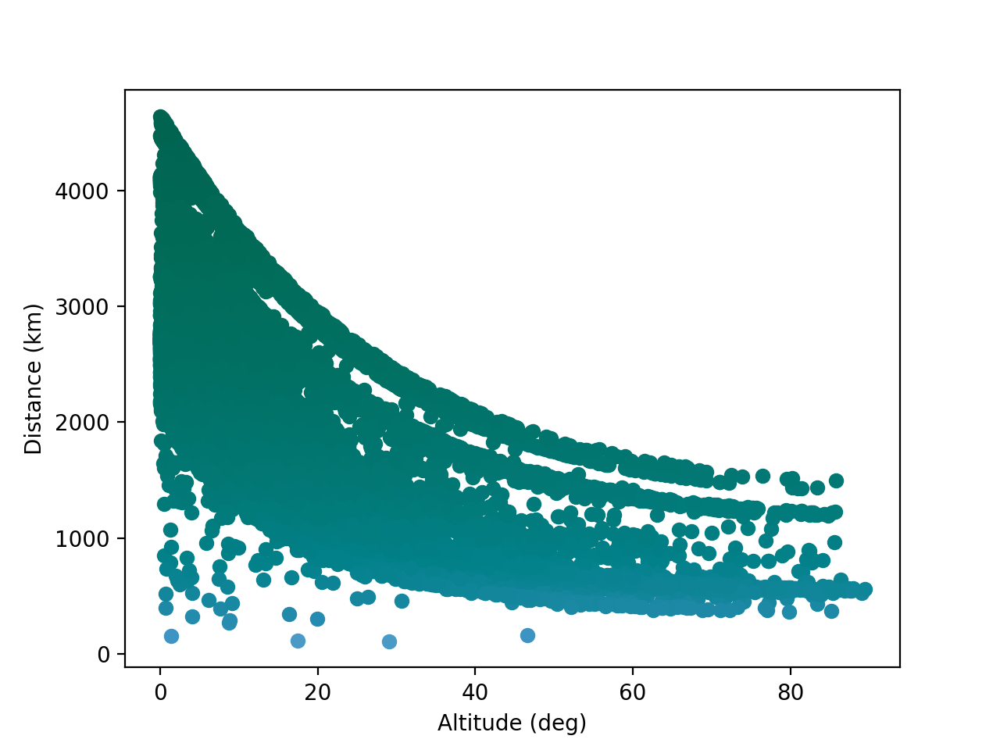

CPU times: user 56min 30s, sys: 55.6 s, total: 57min 26s
Wall time: 3h 18min 46s


In [54]:
%%time
fig, ax = plt.subplots(1, 1)
for i in range(len(az_LEO)):
    if alt_LEO[i] > 0:
        #print(i)
        ax.scatter(alt_LEO[i], (distance_LEO[i] * u.AU).to(u.km)/u.km, c = (distance_LEO[i] * u.AU).to(u.km)/u.km, 
                   cmap = 'PuBuGn', 
                    norm = 'symlog', vmin = 0, vmax = np.max((distance_LEO * u.AU).to(u.km)/u.km),
                    label = str(distance_LEO[i]) + ' AU')
#plt.legend(fontsize = 7, ncols = 3)
    #fig.colorbar(ax.scatter(az_LEO[i], np.abs(alt_LEO[i]-90), c = distance_LEO[i], cmap = 'PuBuGn', 
     #           norm = 'symlog', vmin = 0, vmax = np.max(distance_LEO),
      #          label = str(distance_LEO[i]) + ' AU'))
plt.xlabel('Altitude (deg)')
plt.ylabel('Distance (km)')
plt.show()
plt.savefig('testpls.png')

Making 2D rectangular plots to get a feel for what the Mollweide plots should look like

In [55]:
%%time
qgeo5 = []
ageo5 = []
for i in range(len(alt_GEO)):
    #print(i)
    #for j in range(len(t)):
    if alt_GEO[i] > 0: #alt
        for h in range(0, 18):
            if (h*5) <= alt_GEO[i] < ((h+1)*5): #alt
                for k in range(0, 72):
                    if (k*5) <= az_GEO[i] < ((k+1)*5): #az
                        qgeo5.append((h*72) + k + 1)
                        ageo5.append((h*72) + k + 1)
    if alt_GEO[i] <= 0: #alt
        qgeo5.append(0)
        ageo5.append(0)

qheo5 = []
aheo5 = []
for i in range(len(alt_HEO)):
    #print(i)
    #for j in range(len(t)):
    if alt_HEO[i] > 0: #alt
        for h in range(0, 18):
            if (h*5) <= alt_HEO[i] < ((h+1)*5): #alt
                for k in range(0, 72):
                    if (k*5) <= az_HEO[i] < ((k+1)*5): #az
                        qheo5.append((h*72) + k + 1)
                        aheo5.append((h*72) + k + 1)
    if alt_HEO[i] <= 0: #alt
        qheo5.append(0)
        aheo5.append(0)
        
qmeo5 = []
ameo5 = []
for i in range(len(alt_MEO)):
    #print(i)
    #for j in range(len(t)):
    if alt_MEO[i] > 0: #alt
        for h in range(0, 18):
            if (h*5) <= alt_MEO[i] < ((h+1)*5): #alt
                for k in range(0, 72):
                    if (k*5) <= az_MEO[i] < ((k+1)*5): #az
                        qmeo5.append((h*72) + k + 1)
                        ameo5.append((h*72) + k + 1)
    if alt_MEO[i] <= 0: #alt
        qmeo5.append(0)
        ameo5.append(0)
        
qleo5 = []
aleo5 = []
for i in range(len(alt_LEO)):
    #print(i)
    #for j in range(len(t)):
    if alt_LEO[i] > 0: #alt
        for h in range(0, 18):
            if (h*5) <= alt_LEO[i] < ((h+1)*5): #alt
                for k in range(0, 72):
                    if (k*5) <= az_LEO[i] < ((k+1)*5): #az
                        qleo5.append((h*72) + k + 1)
                        aleo5.append((h*72) + k + 1)
    if alt_LEO[i] <= 0: #alt
        qleo5.append(0)
        aleo5.append(0)

CPU times: user 959 ms, sys: 63.3 ms, total: 1.02 s
Wall time: 1.04 s


In [56]:
qgeo5r = np.reshape(qgeo5, (len(GEO), len(t)))
ageo5r = np.reshape(ageo5, (len(GEO), len(t)))

qmeo5r = np.reshape(qmeo5, (len(MEO), len(t)))
ameo5r = np.reshape(ameo5, (len(MEO), len(t)))

qheo5r = np.reshape(qheo5, (len(HEO), len(t)))
aheo5r = np.reshape(aheo5, (len(HEO), len(t)))

qleo5r = np.reshape(qleo5, (len(LEO), len(t)))
aleo5r = np.reshape(aleo5, (len(LEO), len(t)))

In [57]:
%%time
for j in range(len(qgeo5r)):
    for i in range(len(qgeo5r[0])-1):
        if ageo5r[j][i] == ageo5r[j][i+1]:
            qgeo5r[j][i+1] = 0
            
for j in range(len(qmeo5r)):
    for i in range(len(qmeo5r[0])-1):
        if ameo5r[j][i] == ameo5r[j][i+1]:
            qmeo5r[j][i+1] = 0
            
for j in range(len(qheo5r)):
    for i in range(len(qheo5r[0])-1):
        if aheo5r[j][i] == aheo5r[j][i+1]:
            qheo5r[j][i+1] = 0
            
for j in range(len(qleo5r)):
    for i in range(len(qleo5r[0])-1):
        if aleo5r[j][i] == aleo5r[j][i+1]:
            qleo5r[j][i+1] = 0

CPU times: user 449 ms, sys: 7.44 ms, total: 456 ms
Wall time: 457 ms


In [58]:
qgeo5 = np.reshape(qgeo5r, (len(GEO) * len(t)))
qmeo5 = np.reshape(qmeo5r, (len(MEO) * len(t)))
qheo5 = np.reshape(qheo5r, (len(HEO) * len(t)))
qleo5 = np.reshape(qleo5r, (len(LEO) * len(t)))

In [59]:
%%time
s5geo = []
s5heo = []
s5meo = []
s5leo = []
for i in range(len(qgeo5)):
    s5geo.append(f's{qgeo5[i]}')
for i in range(len(qheo5)):
    s5heo.append(f's{qheo5[i]}')
for i in range(len(qmeo5)):
    s5meo.append(f's{qmeo5[i]}')
for i in range(len(qleo5)):
    s5leo.append(f's{qleo5[i]}')

CPU times: user 250 ms, sys: 15.8 ms, total: 266 ms
Wall time: 265 ms


In [60]:
%%time
#About 30s
#which section the satellite is in
sections_5geo = []
sections_5heo = []
sections_5meo = []
sections_5leo = []
for i in range(1, 1297):
    if s5geo.count(f's{i}') == 0:
        sections_5geo.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5geo.count(f's{i}') != 0:
        sections_5geo.append(s5geo.count(f's{i}'))
        
    if s5heo.count(f's{i}') == 0:
        sections_5heo.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5heo.count(f's{i}') != 0:
        sections_5heo.append(s5heo.count(f's{i}'))
        
    if s5meo.count(f's{i}') == 0:
        sections_5meo.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5meo.count(f's{i}') != 0:
        sections_5meo.append(s5meo.count(f's{i}'))
        
    if s5leo.count(f's{i}') == 0:
        sections_5leo.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5leo.count(f's{i}') != 0:
        sections_5leo.append(s5leo.count(f's{i}'))

CPU times: user 30 s, sys: 581 ms, total: 30.6 s
Wall time: 30.7 s


In [61]:
%%time
alt_range5f = []
az_range5f = []

for i in range(0,18):
    alt_range5f.append(f'{i*5} - {(i+1)*5}')
for i in range(0, 72):
    az_range5f.append(f'{i*5} - {(i + 1)*5}')

CPU times: user 19 µs, sys: 1e+03 ns, total: 20 µs
Wall time: 20 µs


In [62]:
az_range5f_label = []
alt_range5f_label = []
azs5 = []
alts5 = []
for i in range(int(len(az_range5f)/2)):
    azs5.append((i*2)+1)
    az_range5f_label.append(az_range5f[azs5[-1]])
    
for i in range(int(len(alt_range5f)/2)):
    alts5.append((i*2)+1)
    alt_range5f_label.append(alt_range5f[alts5[-1]])

In [63]:
sections5geo = np.reshape(sections_5geo, (18, 72))
sections5heo = np.reshape(sections_5heo, (18, 72))
sections5meo = np.reshape(sections_5meo, (18, 72))
sections5leo = np.reshape(sections_5leo, (18, 72))
#making it to where it's a 2d array to plot on the heatmap

<IPython.core.display.Javascript object>


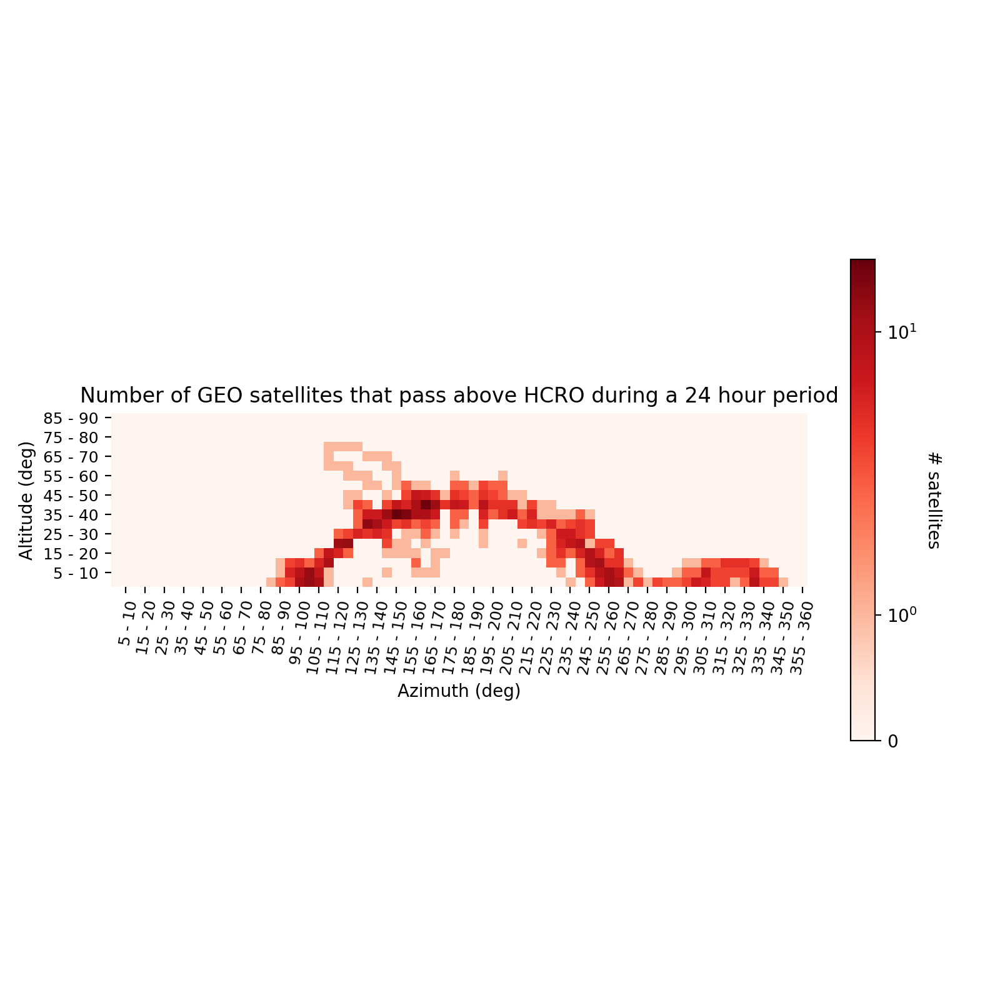

In [64]:
fig, ax = plt.subplots(figsize = (8, 8))#ax = fig.add_subplot(111, projection='mollweide')


im, cbar = heatmap(np.array(sections5geo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of GEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


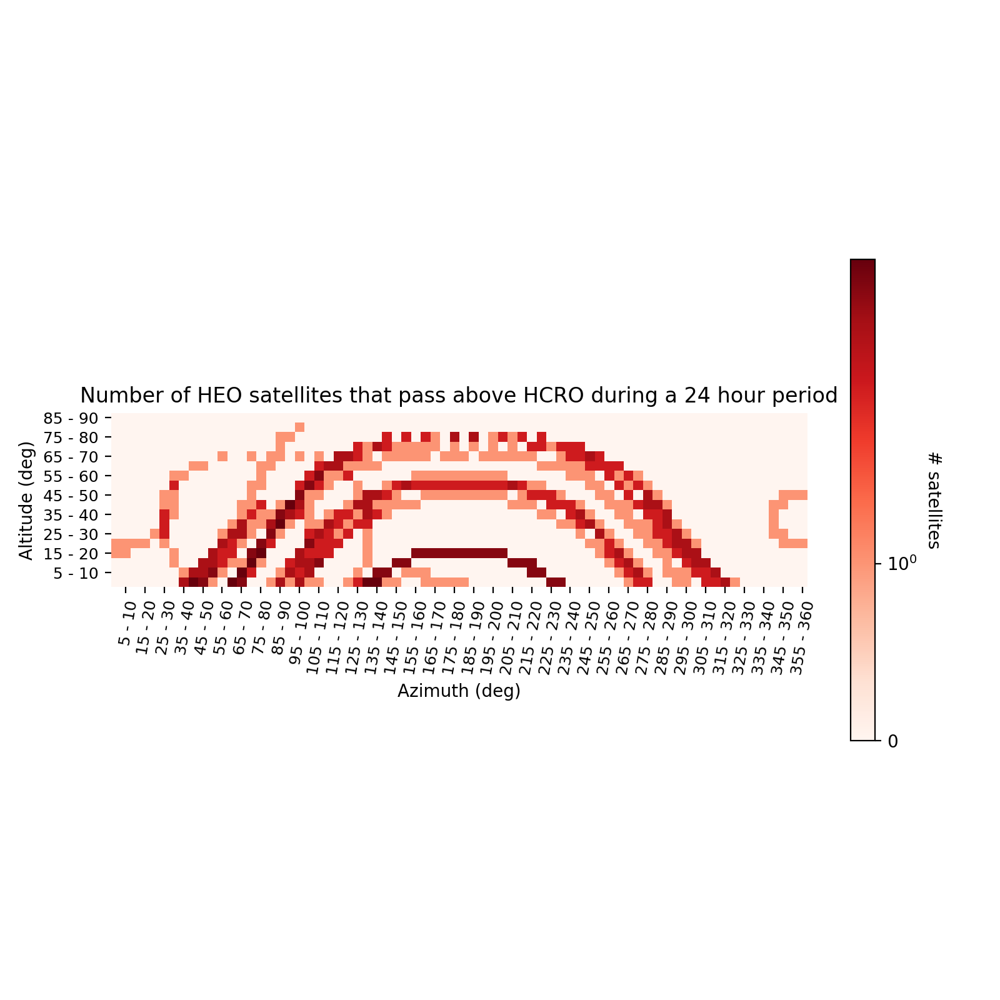

In [65]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5heo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of HEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


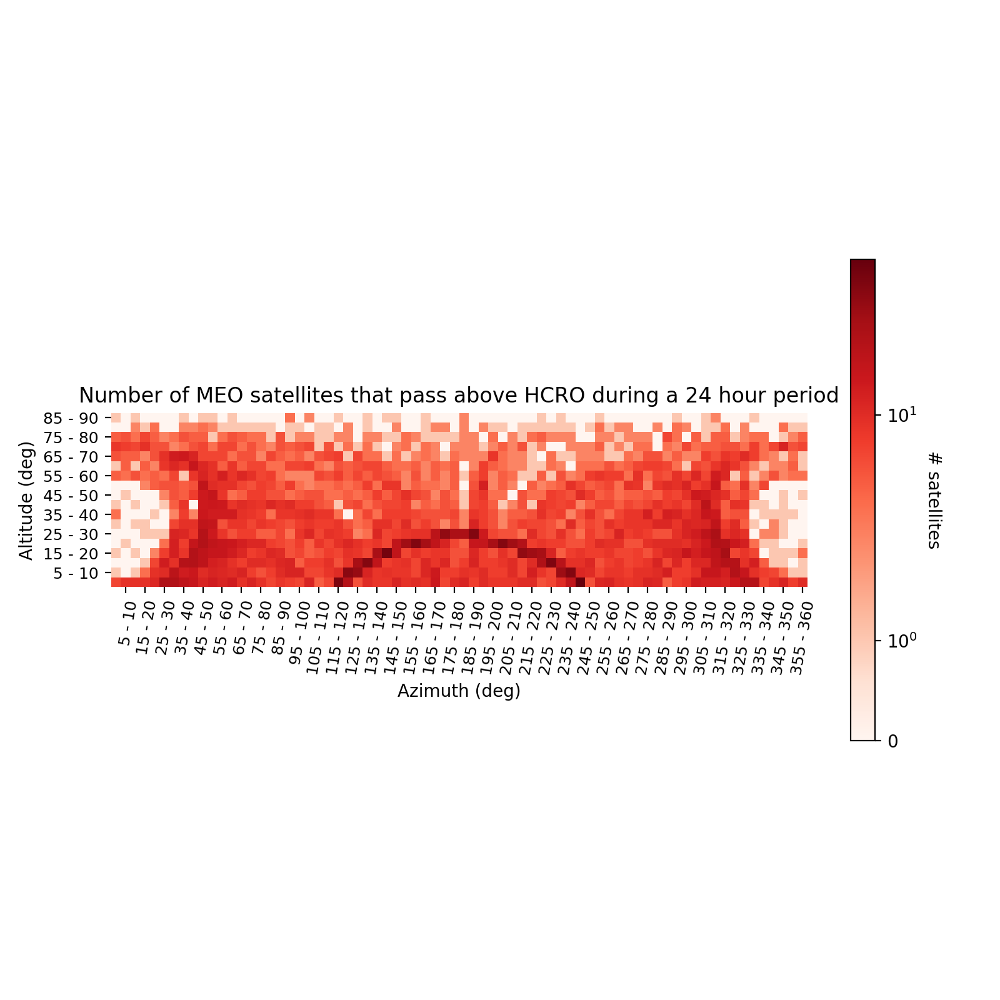

In [66]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5meo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of MEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


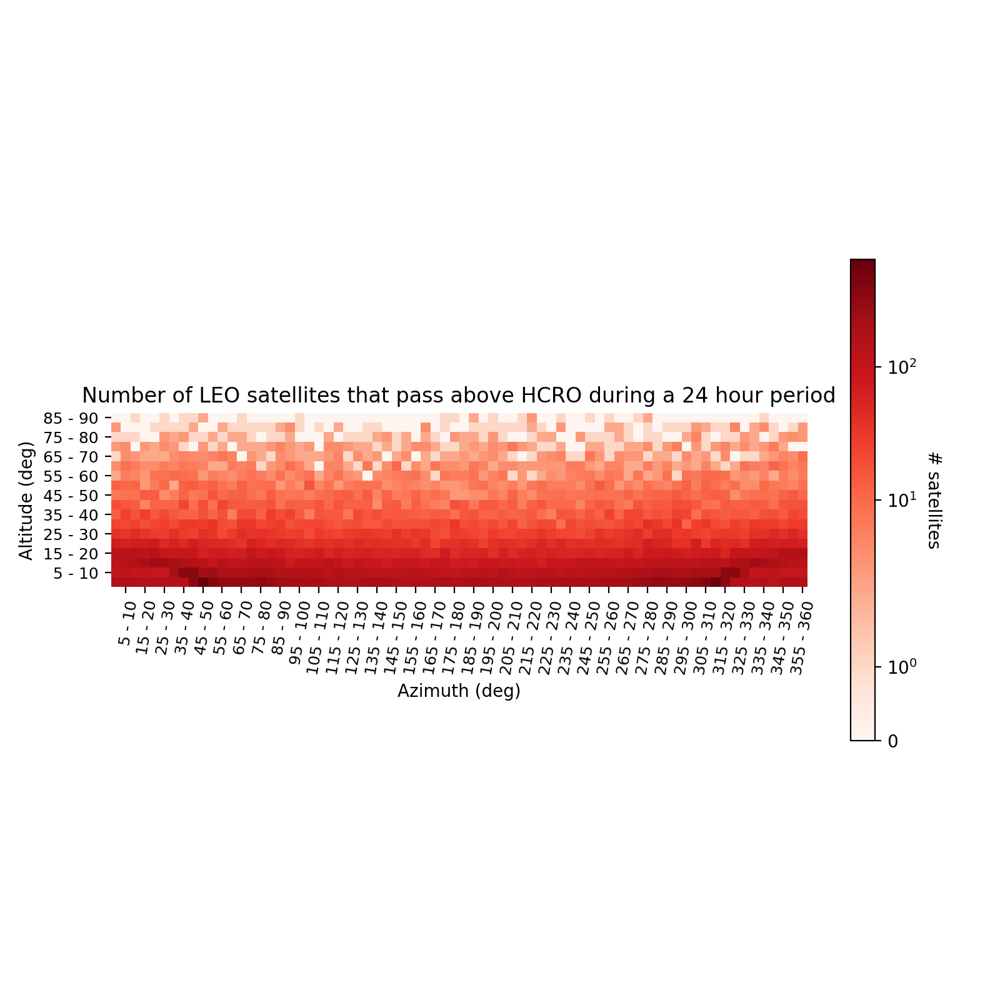

In [67]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5leo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of LEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


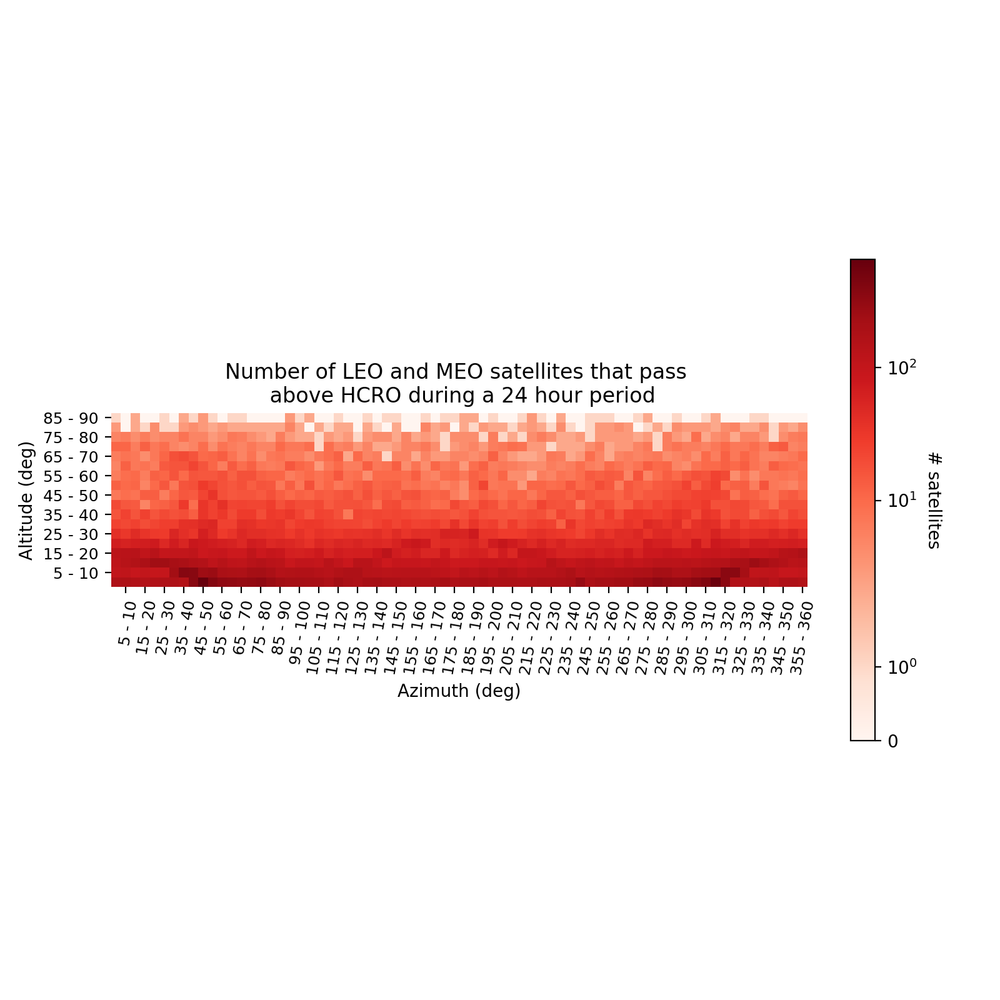

In [68]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5leo + sections5meo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of LEO and MEO satellites that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


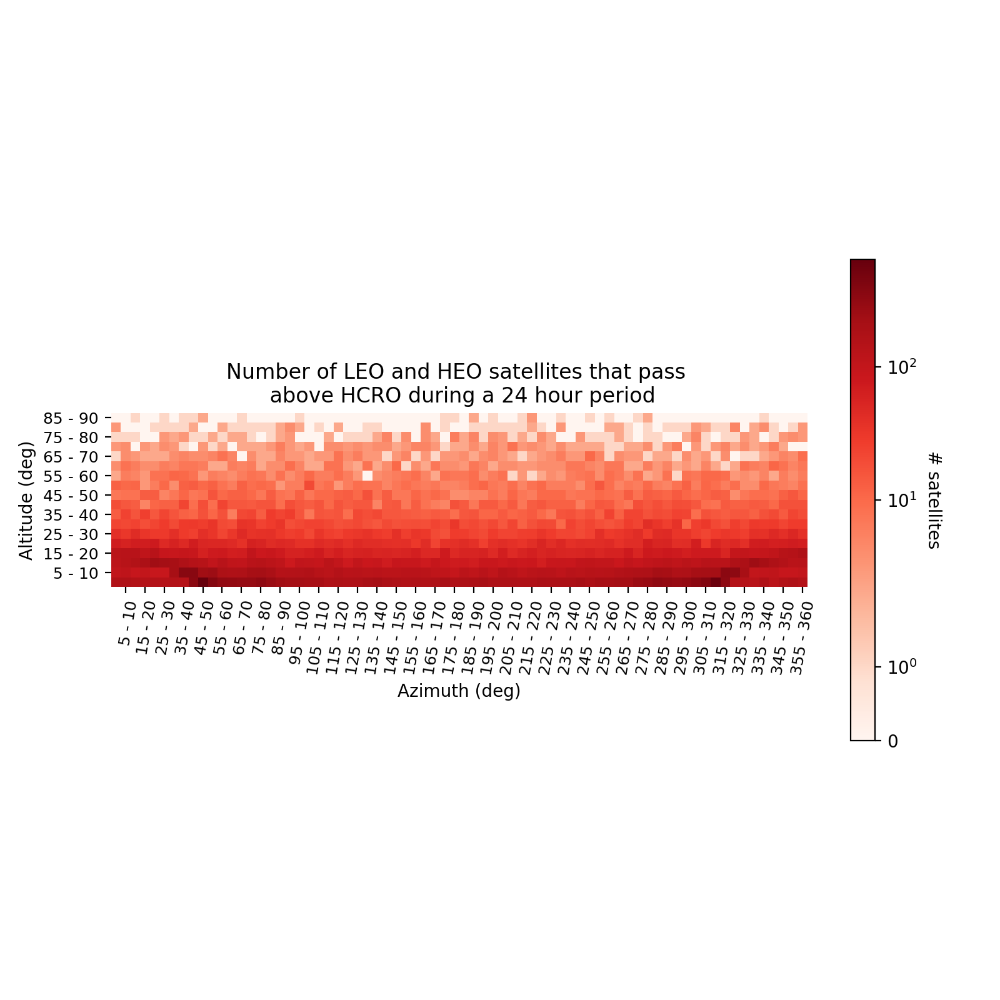

In [69]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5leo + sections5heo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of LEO and HEO satellites that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


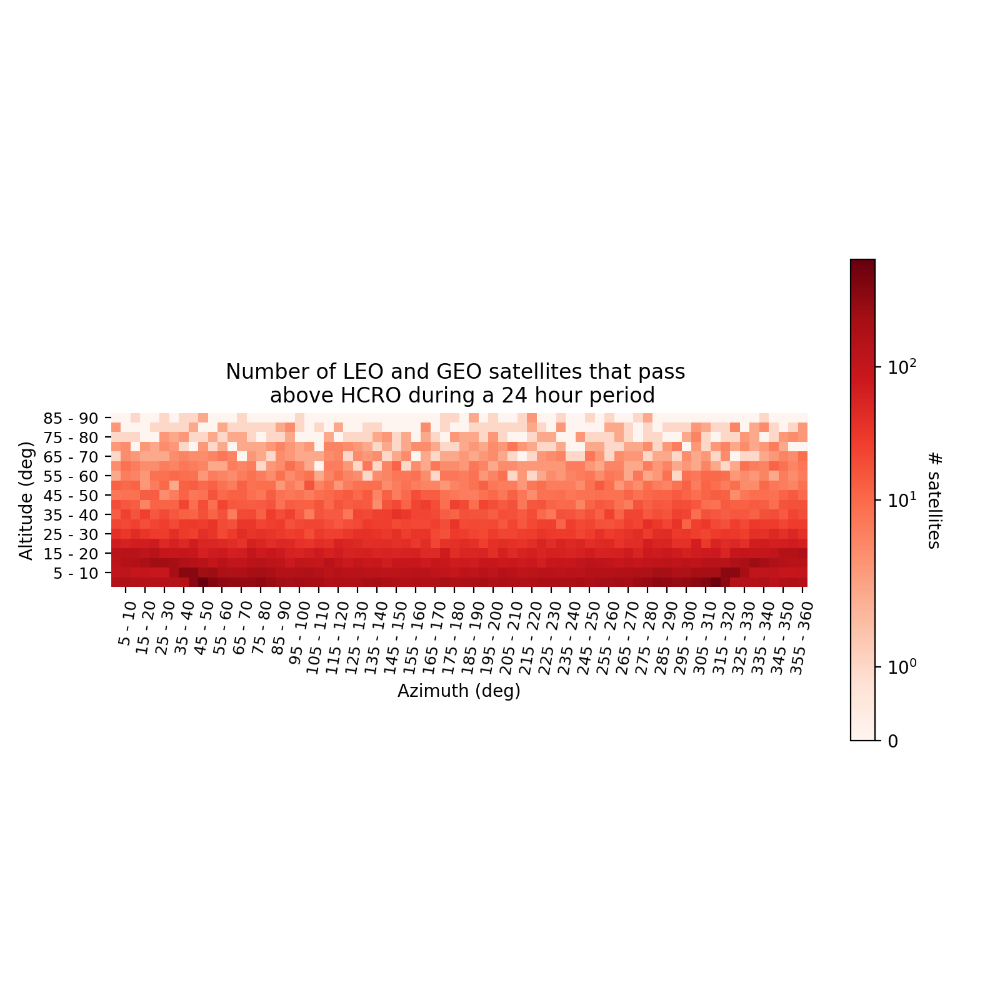

In [70]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5leo + sections5geo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of LEO and GEO satellites that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


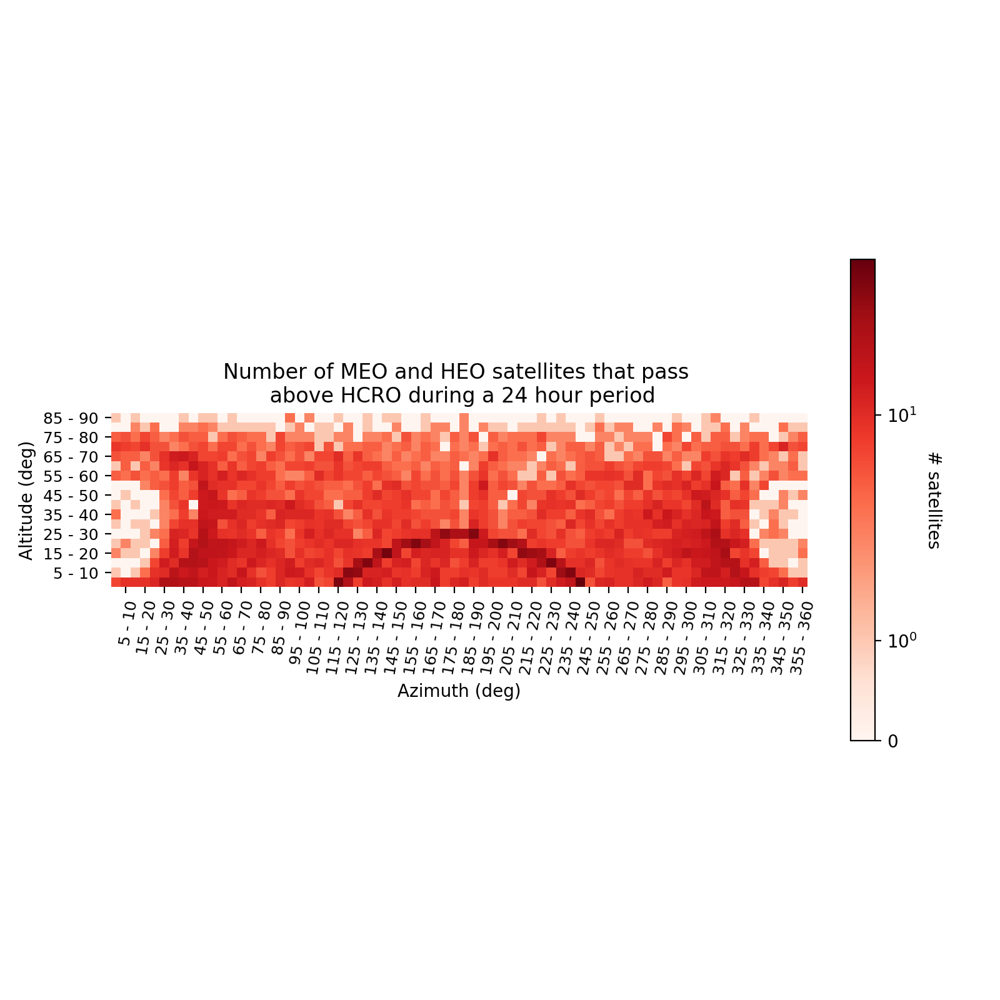

In [71]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5meo + sections5heo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of MEO and HEO satellites that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


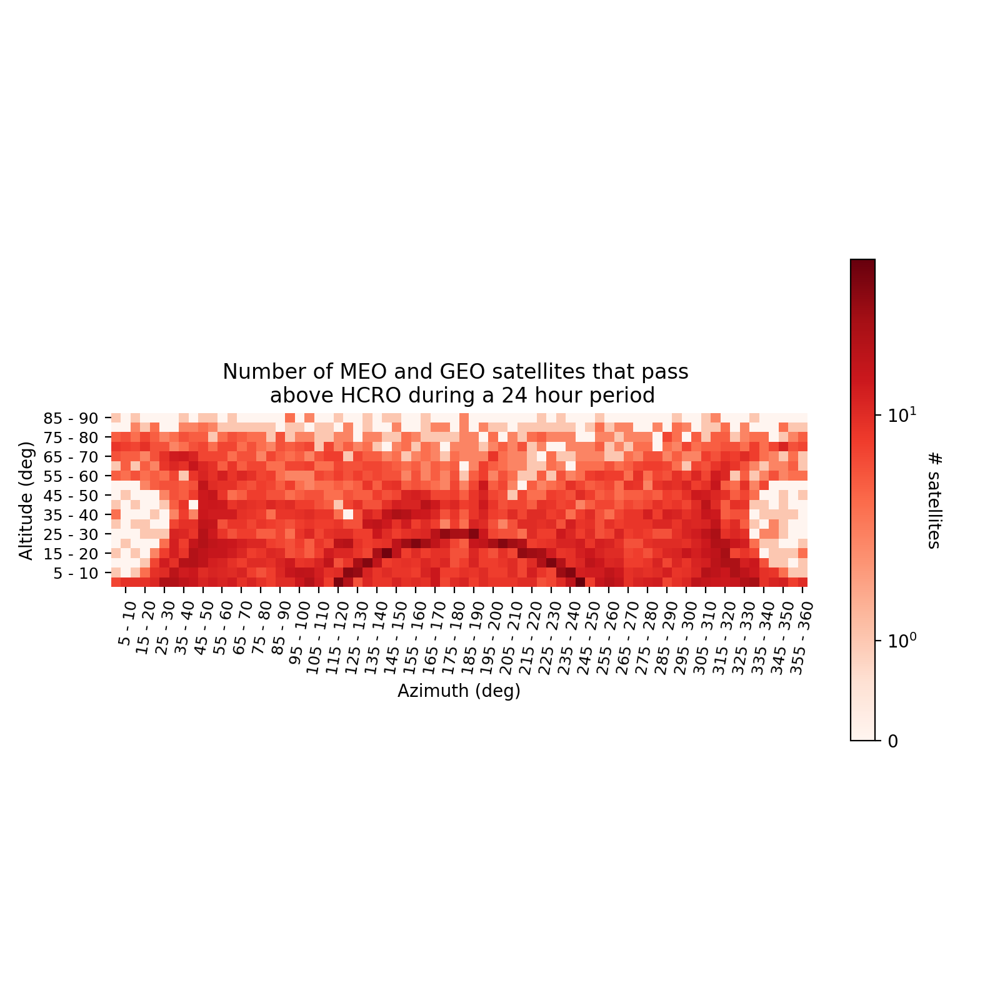

In [72]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5meo + sections5geo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of MEO and GEO satellites that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


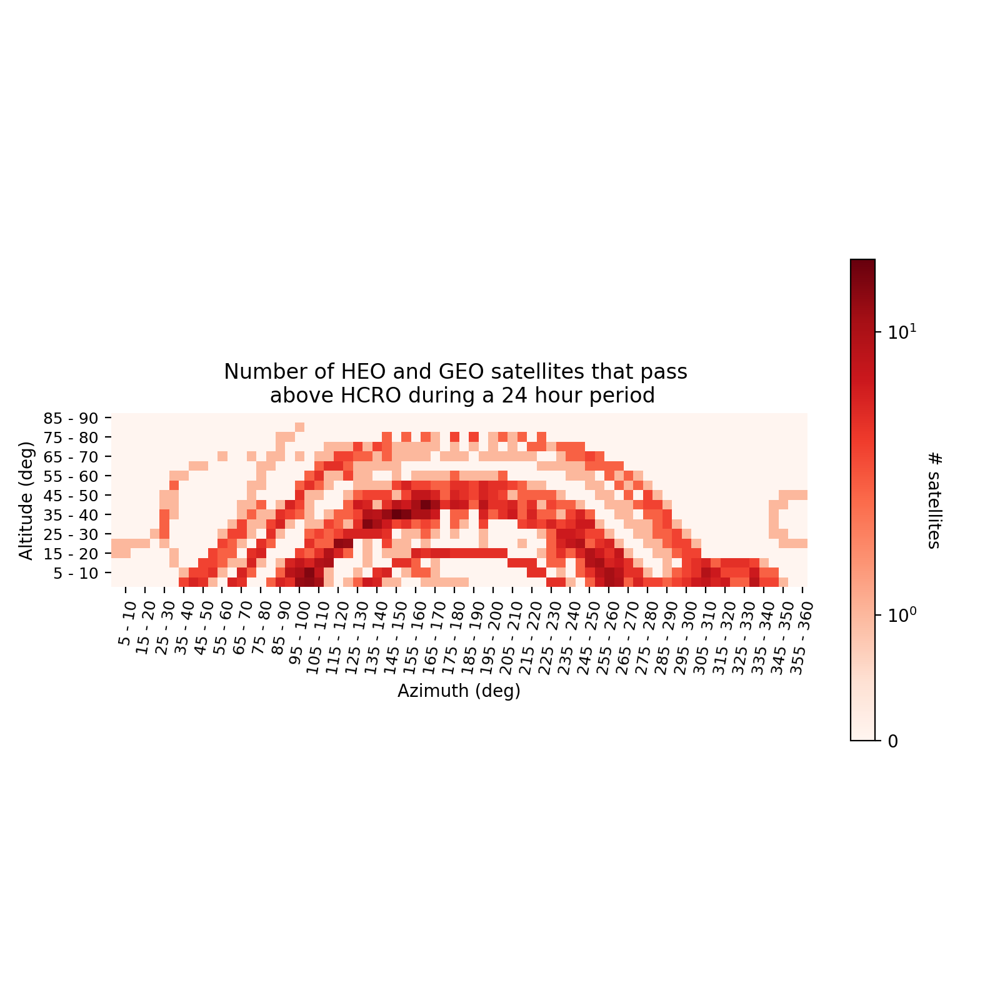

In [73]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5heo + sections5geo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of HEO and GEO satellites that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

/var/folders/6f/jpw5cz9n6wj2vpht4vrvg0j00000gn/T/ipykernel_17348/281818338.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize = (8, 8))


<IPython.core.display.Javascript object>


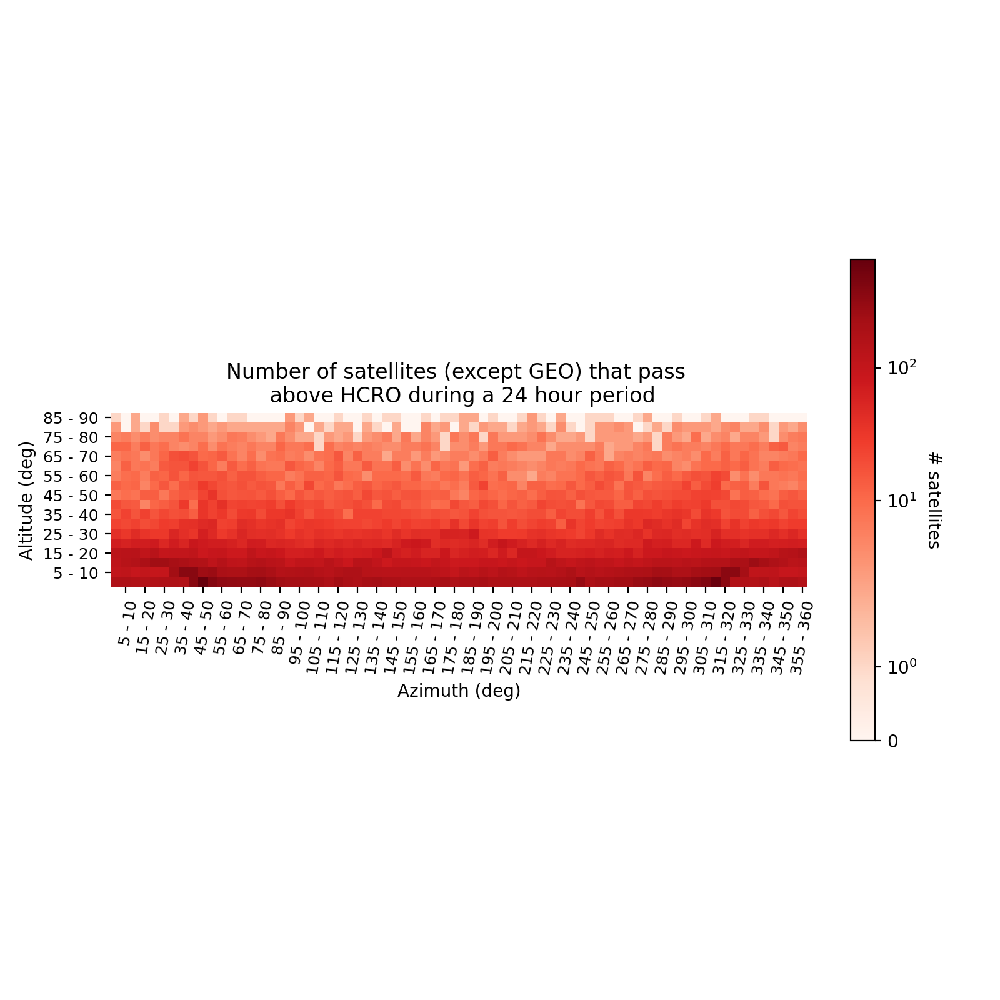

In [74]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5leo + sections5heo + sections5meo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites (except GEO) that pass \n above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


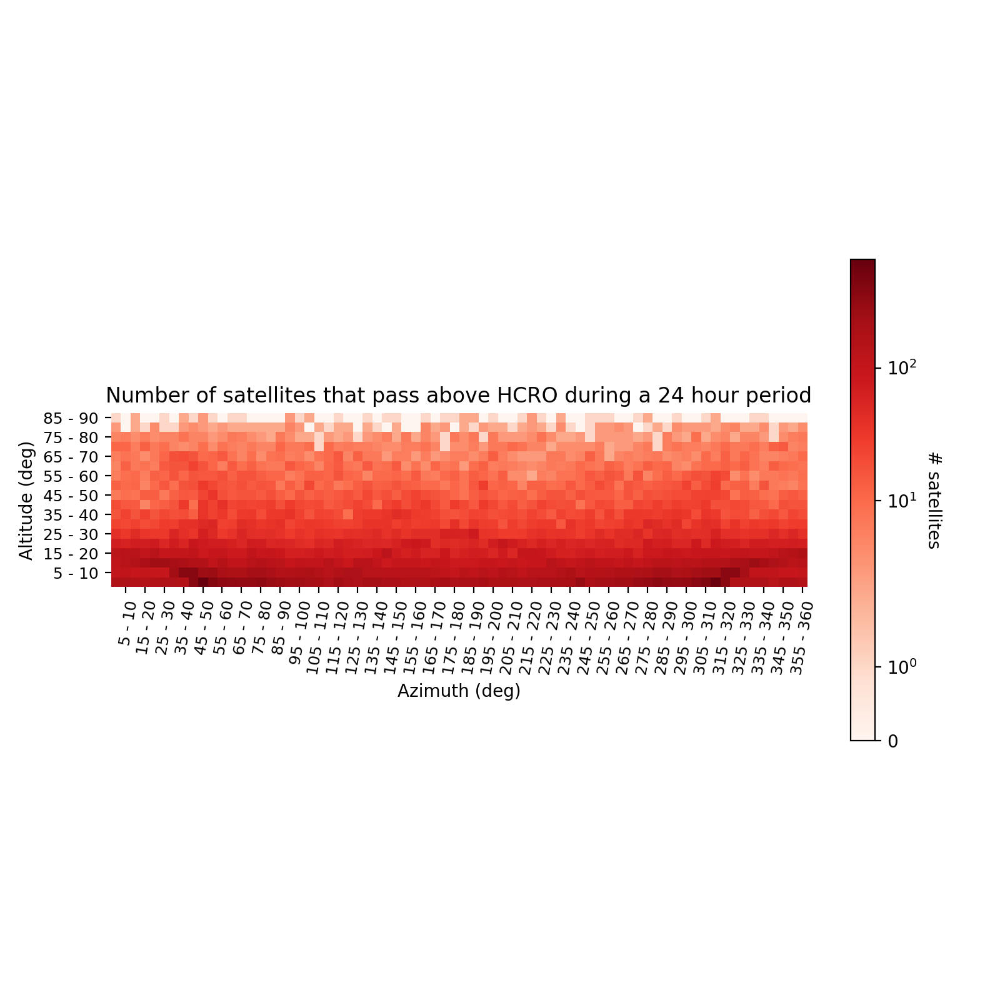

In [75]:
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5leo + sections5geo + sections5heo + sections5meo), alt_range5f, az_range5f, ax=ax,
                   cmap="Reds", cbarlabel="# satellites", norm = 'symlog')
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5, labels=az_range5f_label)
plt.yticks(ticks = alts5, labels = alt_range5f_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

Now making the Mollweide plots

Longitude and latitude
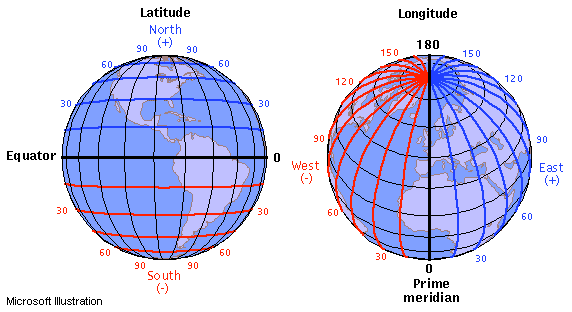

In [76]:
import healpy as hp
from healpy.newvisufunc import projview

In [77]:
alt_r = np.reshape(alt, (len(alt) * len(alt[0])))
az_r = np.reshape(az, (len(az) * len(az[0])))

In [78]:
%%time
alt_GEO = []
az_GEO = []
distance_GEO = []
alt_MEO = []
az_MEO = []
distance_MEO = []
alt_HEO = []
az_HEO = []
distance_HEO = []
alt_LEO = []
az_LEO = []
distance_LEO = []
for i in range(len(alt)):
    #print(i)
    for j in range(len(GEO)):
        if i == GEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_GEO.append(np.abs(alt[i][k] - 90))
                    az_GEO.append(az[i][k])
                    distance_GEO.append(distance[i][k])
for i in range(len(alt)):
    for j in range(len(MEO)):
        if i == MEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_MEO.append(np.abs(alt[i][k] - 90))
                    az_MEO.append(az[i][k])
                    distance_MEO.append(distance[i][k])
                
for i in range(len(alt)):
    for j in range(len(HEO)):
        if i == HEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_HEO.append(np.abs(alt[i][k] - 90))
                    az_HEO.append(az[i][k])
                    distance_HEO.append(distance[i][k])
                
for i in range(len(alt)):
    for j in range(len(LEO)):
        if i == LEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_LEO.append(np.abs(alt[i][k] - 90))
                    az_LEO.append(az[i][k])
                    distance_LEO.append(distance[i][k])


CPU times: user 3.57 s, sys: 99.9 ms, total: 3.67 s
Wall time: 3.69 s


In [79]:
data = [np.arange(len(alt_HEO)),np.arange(len(alt_GEO)), np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.radians(alt_HEO), np.radians(alt_GEO), np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(az_HEO), np.radians(az_GEO), np.radians(az_MEO), np.radians(az_LEO)]


In [80]:
nside = 2**6

In [81]:
(hp.nside2resol(nside) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 0.91612971 deg>

In [82]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

for i in range(len(phi[1])):
    if (phi[1][i] + np.pi) >= (2*np.pi):
        phi[1][i] = phi[1][i] - np.pi
    elif (phi[1][i] + np.pi) < (2*np.pi):
        phi[1][i] = phi[1][i] + np.pi

for i in range(len(phi[2])):
    if (phi[2][i] + np.pi) >= (2*np.pi):
        phi[2][i] = phi[2][i] - np.pi
    elif (phi[2][i] + np.pi) < (2*np.pi):
        phi[2][i] = phi[2][i] + np.pi
        
for i in range(len(phi[3])):
    if (phi[3][i] + np.pi) >= (2*np.pi):
        phi[3][i] = phi[3][i] - np.pi
    elif (phi[3][i] + np.pi) < (2*np.pi):
        phi[3][i] = phi[3][i] + np.pi

In [83]:
pixel_indices_heo = hp.ang2pix(nside, theta[0], phi[0])
pixel_indices_geo = hp.ang2pix(nside, theta[1], phi[1])
pixel_indices_meo = hp.ang2pix(nside, theta[2], phi[2])
pixel_indices_leo = hp.ang2pix(nside, theta[3], phi[3])

In [84]:
ph = hp.ang2pix(nside, theta[0], phi[0])
pg = hp.ang2pix(nside, theta[1], phi[1])
pm = hp.ang2pix(nside, theta[2], phi[2])
pl = hp.ang2pix(nside, theta[3], phi[3])

In [85]:
#Correcting for geo satellites being in the same place
for i in range(len(pixel_indices_geo)-1):
    if pg[i] == pg[i+1]:
        pixel_indices_geo[i+1] = 0
        
for i in range(len(pixel_indices_heo)-1):
    if ph[i] == ph[i+1]:
        pixel_indices_heo[i+1] = 0
        
for i in range(len(pixel_indices_meo)-1):
    if pm[i] == pm[i+1]:
        pixel_indices_meo[i+1] = 0
        
for i in range(len(pixel_indices_leo)-1):
    if pl[i] == pl[i+1]:
        pixel_indices_leo[i+1] = 0

In [86]:
mheo = np.zeros(hp.nside2npix(nside))
mgeo = np.zeros(hp.nside2npix(nside))
mmeo = np.zeros(hp.nside2npix(nside))
mleo = np.zeros(hp.nside2npix(nside))


In [90]:
%%time
#takes about 7 minutes
for i in range(1, len(mheo)):
    for j in range(len(pixel_indices_heo)):
        if i == pixel_indices_heo[j]:
            mheo[i] += 1
            
for i in range(1, len(mgeo)):
    for j in range(len(pixel_indices_geo)):
        if i == pixel_indices_geo[j]:
            mgeo[i] += 1
            
for i in range(1, len(mmeo)):
    for j in range(len(pixel_indices_meo)):
        if i == pixel_indices_meo[j]:
            mmeo[i] += 1
            
for i in range(1, len(mleo)):
    for j in range(len(pixel_indices_leo)):
        if i == pixel_indices_leo[j]:
            mleo[i] += 1

CPU times: user 6min 39s, sys: 3.66 s, total: 6min 42s
Wall time: 6min 43s


In [91]:
m = []
for i in range(len(mheo)):
    m.append(mheo[i]+mgeo[i]+mleo[i]+mmeo[i])

<IPython.core.display.Javascript object>


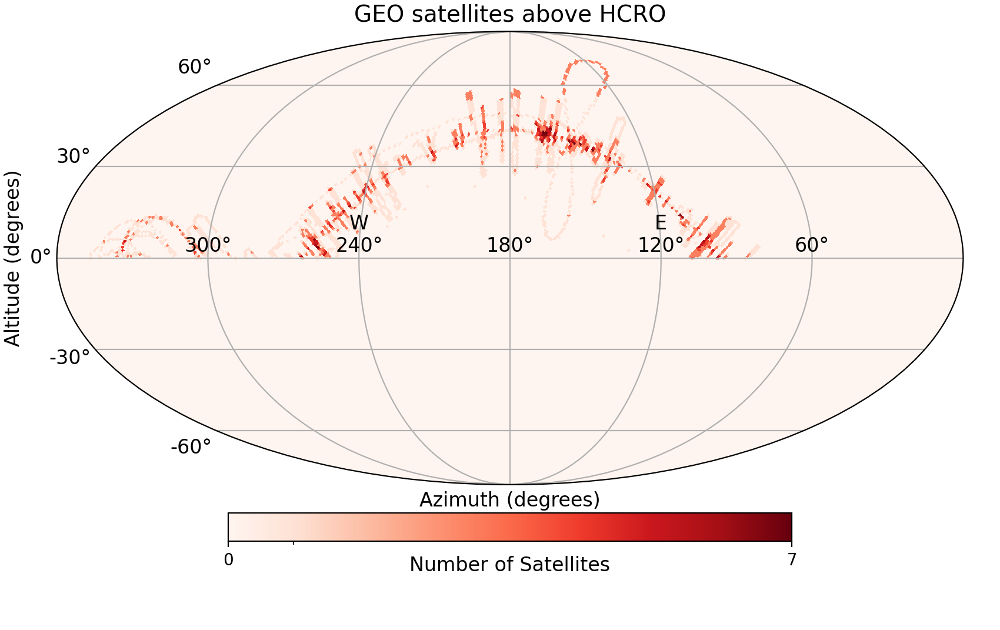

In [1133]:
projview(
    mgeo,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'GEO satellites above HCRO',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    #custom_ytick_labels = ['-60°', '-30°', 'W', '30°', '60°'],
    norm = 'symlog'
);
plt.savefig('GEO_m.png')

<IPython.core.display.Javascript object>


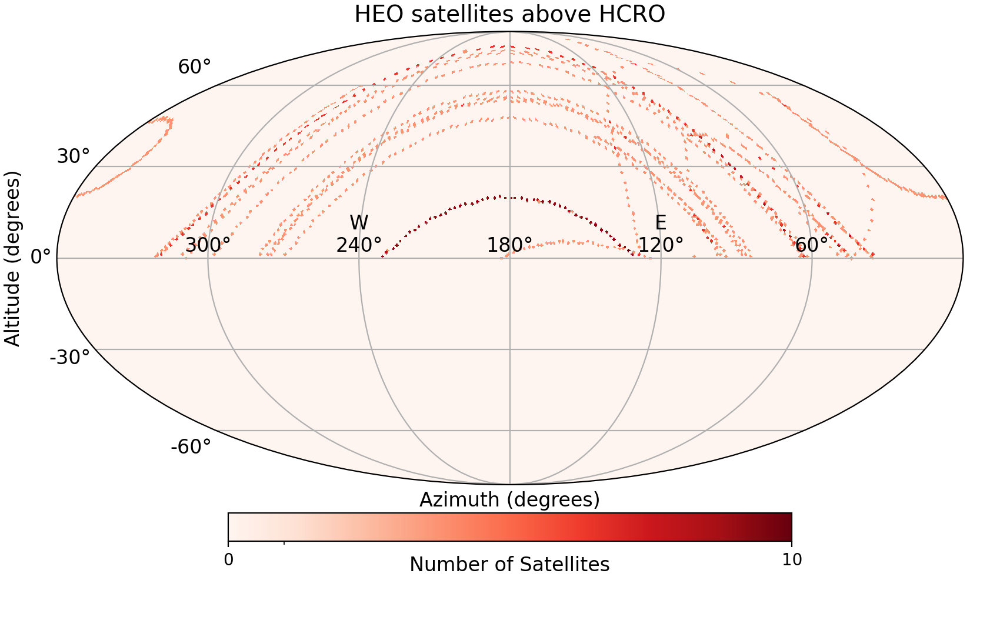

In [1132]:
projview(
    mheo,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'HEO satellites above HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    #custom_ytick_labels = ['-60°', '-30°', 'W', '30°', '60°'],
    norm = 'symlog'
);
plt.savefig('HEO_m.png')

<IPython.core.display.Javascript object>


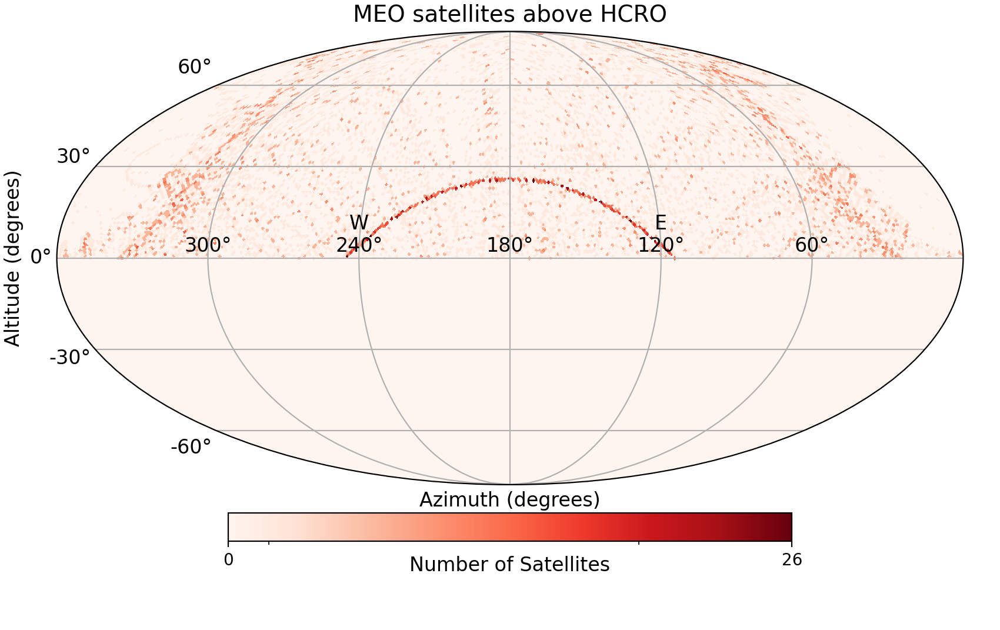

In [1131]:
projview(
    mmeo,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'MEO satellites above HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    #norm = 'log'
    #custom_ytick_labels = ['-60°', '-30°', 'W', '30°', '60°'],
    norm = 'symlog'
);
plt.savefig('MEO_m.png')

In [824]:
#Looking at how many satellites are Starlink
starlink = 0
for i in range(len(LEO)):
    if namess[LEO[i]][:8] == "STARLINK":
        starlink += 1
print('Percentage of LEO satellites that are Starlink: ' + str(starlink/len(LEO) * 100) + '%')
print('Percentage of all satellites that are Starlink: ' + str(starlink/len(active) * 100) + '%')

Percentage of LEO satellites that are Starlink: 59.76510952757984%
Percentage of all satellites that are Starlink: 54.148732663797226%


<IPython.core.display.Javascript object>


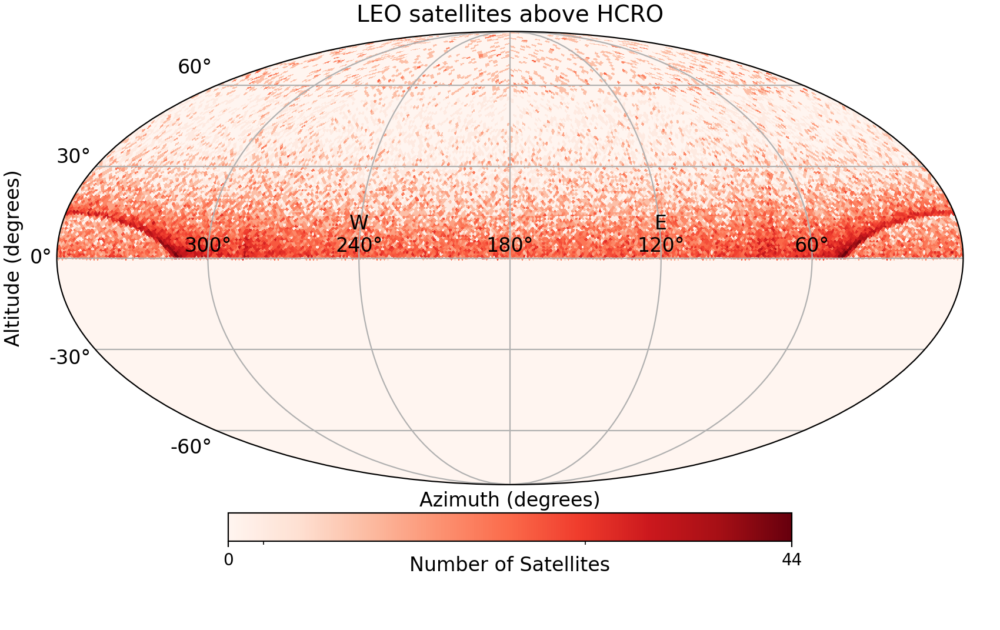

In [1130]:
projview(
    mleo,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'LEO satellites above HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    #custom_ytick_labels = ['-60°', '-30°', 'W', '30°', '60°'],
    norm = 'symlog'
);
plt.savefig('LEO_m.png')

<IPython.core.display.Javascript object>


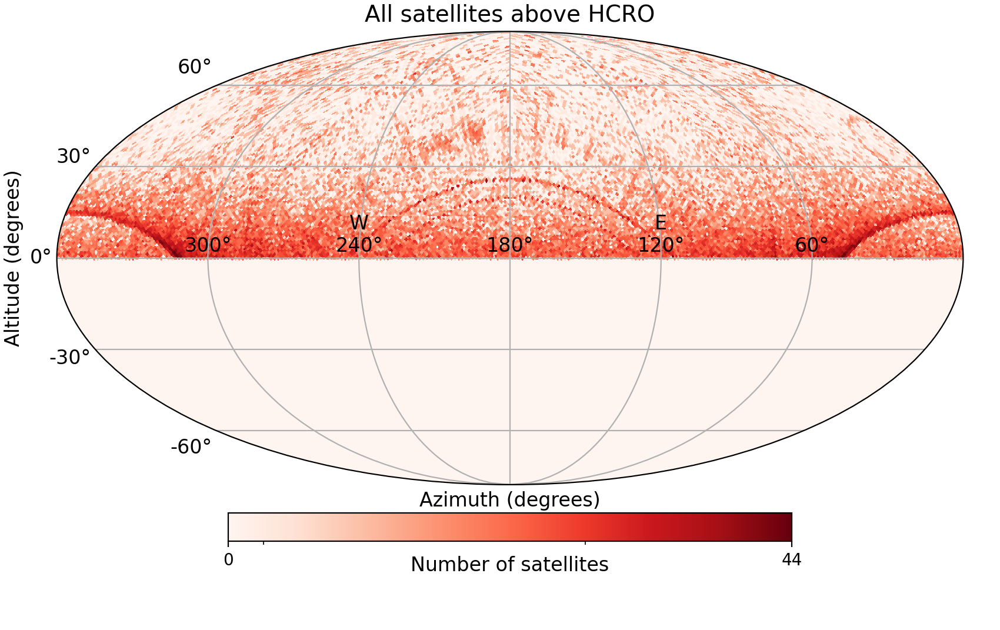

In [1159]:
projview(
    np.array(m),
    coord=["G"],
    graticule=True,
    flip = 'geo',
    graticule_labels=True,
    unit="Number of satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'All satellites above HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    #custom_ytick_labels = ['-60°', '-30°', 'W', '30°', '60°'],
    norm = 'symlog',
);
plt.savefig('all_m.png')

In [101]:
tsl3 = load.timescale()
tl3 = []
tsl7 = load.timescale()
tl7 = []
for i in range(24):
    for j in range(0, 60, 1):
       # for k in range(0, 60, 1):
        tl3.append(tsl3.utc(ts.now().utc[0], ts.now().utc[1], ts.now().utc[2], i, j, 0))


In [102]:
#observing_location= EarthLocation.of_site('ATA')#A different way to set our location
observing_timel3 = []
observing_timel7 = []
for i in range(len(tl3)):
    observing_timel3.append(Time(tl3[i].utc_datetime()))
for i in range(len(tl7)):
    observing_timel7.append(Time(tl7[i].utc_datetime()))
#aa = AltAz(location=observing_location, obstime=observing_time)

In [103]:
differencel = []
for i in range(len(LEO)):
    differencel.append(active[LEO[i]] - ata)

In [105]:
topocentricl3 = []
topocentricl7 = []
for i in range(len(differencel)):
    #print(i)
    for j in range(len(tl3)):
        topocentricl3.append(differencel[i].at(tl3[j]))

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

2237
2238
2239
2240
2241
2242
2243
2244
2245
2246
2247
2248
2249
2250
2251
2252
2253
2254
2255
2256
2257
2258
2259
2260
2261
2262
2263
2264
2265
2266
2267
2268
2269
2270
2271
2272
2273
2274
2275
2276
2277
2278
2279
2280
2281
2282
2283
2284
2285
2286
2287
2288
2289
2290
2291
2292
2293
2294
2295
2296
2297
2298
2299
2300
2301
2302
2303
2304
2305
2306
2307
2308
2309
2310
2311
2312
2313
2314
2315
2316
2317
2318
2319
2320
2321
2322
2323
2324
2325
2326
2327
2328
2329
2330
2331
2332
2333
2334
2335
2336
2337
2338
2339
2340
2341
2342
2343
2344
2345
2346
2347
2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418
2419
2420
2421
2422
2423
2424
2425
2426
2427
2428
2429
2430
2431
2432
2433
2434
2435
2436


3911
3912
3913
3914
3915
3916
3917
3918
3919
3920
3921
3922
3923
3924
3925
3926
3927
3928
3929
3930
3931
3932
3933
3934
3935
3936
3937
3938
3939
3940
3941
3942
3943
3944
3945
3946
3947
3948
3949
3950
3951
3952
3953
3954
3955
3956
3957
3958
3959
3960
3961
3962
3963
3964
3965
3966
3967
3968
3969
3970
3971
3972
3973
3974
3975
3976
3977
3978
3979
3980
3981
3982
3983
3984
3985
3986
3987
3988
3989
3990
3991
3992
3993
3994
3995
3996
3997
3998
3999
4000
4001
4002
4003
4004
4005
4006
4007
4008
4009
4010
4011
4012
4013
4014
4015
4016
4017
4018
4019
4020
4021
4022
4023
4024
4025
4026
4027
4028
4029
4030
4031
4032
4033
4034
4035
4036
4037
4038
4039
4040
4041
4042
4043
4044
4045
4046
4047
4048
4049
4050
4051
4052
4053
4054
4055
4056
4057
4058
4059
4060
4061
4062
4063
4064
4065
4066
4067
4068
4069
4070
4071
4072
4073
4074
4075
4076
4077
4078
4079
4080
4081
4082
4083
4084
4085
4086
4087
4088
4089
4090
4091
4092
4093
4094
4095
4096
4097
4098
4099
4100
4101
4102
4103
4104
4105
4106
4107
4108
4109
4110


5927
5928
5929
5930
5931
5932
5933
5934
5935
5936
5937
5938
5939
5940
5941
5942
5943
5944
5945
5946
5947
5948
5949
5950
5951
5952
5953
5954
5955
5956
5957
5958
5959
5960
5961
5962
5963
5964
5965
5966
5967
5968
5969
5970
5971
5972
5973
5974
5975
5976
5977
5978
5979
5980
5981
5982
5983
5984
5985
5986
5987
5988
5989
5990
5991
5992
5993
5994
5995
5996
5997
5998
5999
6000
6001
6002
6003
6004
6005
6006
6007
6008
6009
6010
6011
6012
6013
6014
6015
6016
6017
6018
6019
6020
6021
6022
6023
6024
6025
6026
6027
6028
6029
6030
6031
6032
6033
6034
6035
6036
6037
6038
6039
6040
6041
6042
6043
6044
6045
6046
6047
6048
6049
6050
6051
6052
6053
6054
6055
6056
6057
6058
6059
6060
6061
6062
6063
6064
6065
6066
6067
6068
6069
6070
6071
6072
6073
6074
6075
6076
6077
6078
6079
6080
6081
6082
6083
6084
6085
6086
6087
6088
6089
6090
6091
6092
6093
6094
6095
6096
6097
6098
6099
6100
6101
6102
6103
6104
6105
6106
6107
6108
6109
6110
6111
6112
6113
6114
6115
6116
6117
6118
6119
6120
6121
6122
6123
6124
6125
6126


In [107]:
%%time
#about 5 minutes
topocentricl3 = []
topocentricl7 = []
for i in range(len(differencel)):
    for j in range(len(tl3)):
        topocentricl3.append(differencel[i].at(tl3[j]))
for i in range(len(differencel)):
    for j in range(len(tl7)):
        topocentricl7.append(differencel[i].at(tl7[j]))

CPU times: user 5min 24s, sys: 50.8 s, total: 6min 15s
Wall time: 5min 56s


In [110]:
%%time
#takes about 6 minutes to run
altl3 = []
azl3 = []
distancel3 = []
altl7 = []
azl7 = []
distancel7 = []
for i in range(len(topocentricl3)):
    if np.isnan(topocentricl3[(i)].altaz()[0].degrees) == True:
        altl3.append(0)
        azl3.append(0)
        distancel3.append(0)
    elif np.isnan(topocentricl3[(i)].altaz()[0].degrees) == False:
        altl3.append(topocentricl3[i].altaz()[0].degrees)
        azl3.append(topocentricl3[i].altaz()[1].degrees)
        distancel3.append(topocentricl3[i].altaz()[2].au)

for i in range(len(topocentricl7)):
    if np.isnan(topocentricl7[(i)].altaz()[0].degrees) == True:
        altl7.append(0)
        azl7.append(0)
        distancel7.append(0)
    elif np.isnan(topocentricl7[(i)].altaz()[0].degrees) == False:
        altl7.append(topocentricl7[i].altaz()[0].degrees)
        azl7.append(topocentricl7[i].altaz()[1].degrees)
        distancel7.append(topocentricl7[i].altaz()[2].au)

CPU times: user 10min 7s, sys: 6.88 s, total: 10min 14s
Wall time: 10min 16s


In [111]:
altl3 = np.reshape(altl3, (len(LEO), len(tl3)))
azl3 = np.reshape(azl3, (len(LEO), len(tl3)))
distancel3 = np.reshape(distancel3, (len(LEO), len(tl3)))
altl7 = np.reshape(altl7, (len(LEO), len(tl7)))
azl7 = np.reshape(azl7, (len(LEO), len(tl7)))
distancel7 = np.reshape(distancel7, (len(LEO), len(tl7)))

In [112]:
%%time
alt_LEO3 = []
az_LEO3 = []
distance_LEO3 = []
alt_LEO7 = []
az_LEO7 = []
distance_LEO7 = []

for i in range(len(LEO)):
    for k in range(len(tl3)):
        if altl3[i][k] > 0:
            alt_LEO3.append(np.abs(altl3[i][k] - 90))
            az_LEO3.append(azl3[i][k])
            distance_LEO3.append(distancel3[i][k])
print(0)      
for i in range(len(LEO)):
    for k in range(len(tl7)):
        if altl7[i][k] > 0:
            alt_LEO7.append(np.abs(altl7[i][k] - 90))
            az_LEO7.append(azl7[i][k])
            distance_LEO7.append(distancel7[i][k])



0
CPU times: user 1.94 s, sys: 29.9 ms, total: 1.97 s
Wall time: 1.97 s


In [113]:
data = [np.arange(len(alt_LEO3))]#,np.arange(len(alt_LEO7))]#, np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.radians(alt_LEO3)]#, np.radians(alt_LEO7)]#, np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(az_LEO3)]#, np.radians(az_LEO7)]#, np.radians(az_MEO), np.radians(az_LEO)]


In [114]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

In [115]:
nside3 = 2**5

In [119]:
(hp.nside2resol(nside3) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 1.83225942 deg>

In [120]:
pixel_indices_leo3 = hp.ang2pix(nside3, theta[0], phi[0])

In [121]:
pl3 = hp.ang2pix(nside3, theta[0], phi[0])

In [122]:
#Correcting for satellites being in the same place
for i in range(len(pixel_indices_leo3)-1):
    if pl3[i] == pl3[i+1]:
        pixel_indices_leo3[i+1] = 0

In [123]:
mleo3 = np.zeros(hp.nside2npix(nside3))

In [124]:
%%time
#takes about 10 minutes
for i in range(1, len(mleo3)):
    for j in range(len(pixel_indices_leo3)):
        if i == pixel_indices_leo3[j]:
            mleo3[i] += 1

CPU times: user 9min 45s, sys: 3.4 s, total: 9min 48s
Wall time: 9min 49s


<IPython.core.display.Javascript object>


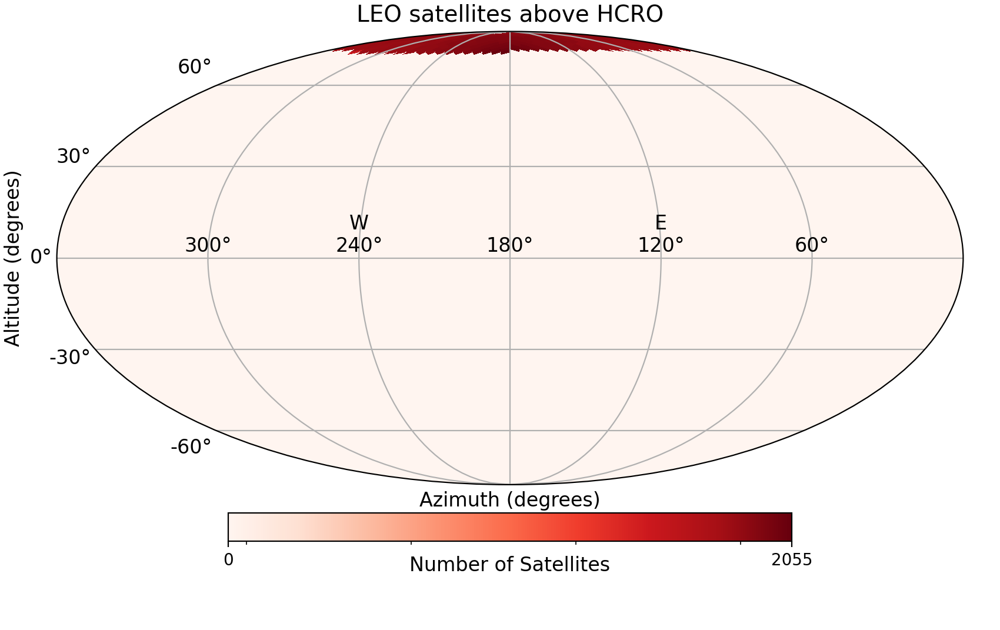

In [1123]:
projview(
    mleo3,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'LEO satellites above HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    #custom_ytick_labels = ['-60°', '-30°', '', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('LEO_m.png')

In [127]:
alt_s = []
az_s = []
distance_s = []
for i in range(len(LEO)):
    if namess[LEO[i]][:8] == "STARLINK":
        for j in range(len(tl3)):
            alt_s.append(np.abs((difference[LEO[i]].at(tl3[j])).altaz()[0].degrees-90))
            az_s.append((difference[LEO[i]].at(tl3[j])).altaz()[1].degrees)
            distance_s.append((difference[LEO[i]].at(tl3[j])).altaz()[2].au)

In [128]:
alt_s = np.reshape(alt_s, (starlink * len(tl3)))
az_s = np.reshape(az_s, (starlink * len(tl3)))

In [129]:
data = [np.arange(len(alt_s))]#,np.arange(len(alt_LEO7))]#, np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.radians(alt_s)]#, np.radians(alt_LEO7)]#, np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(az_s)]#, np.radians(az_LEO7)]#, np.radians(az_MEO), np.radians(az_LEO)]


In [130]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

#for i in range(len(phi[1])):
 #   if (phi[1][i] + np.pi) >= (2*np.pi):
  #      phi[1][i] = phi[1][i] - np.pi
   # elif (phi[1][i] + np.pi) < (2*np.pi):
    #    phi[1][i] = phi[1][i] + np.pi

In [131]:
nside3 = 2**5

In [132]:
pixel_indices_starlink = hp.ang2pix(nside3, theta[0], phi[0])
#pixel_indices_leo7 = hp.ang2pix(nside7, theta[1], phi[1])

In [133]:
pst = hp.ang2pix(nside3, theta[0], phi[0])
#pl7 = hp.ang2pix(nside7, theta[1], phi[1])

In [134]:
#Correcting for satellites being in the same place
for i in range(len(pixel_indices_starlink)-1):
    if pst[i] == pst[i+1]:
        pixel_indices_starlink[i+1] = 0

#for i in range(len(pixel_indices_leo7)-1):
 #   if pl7[i] == pl7[i+1]:
  #      pixel_indices_leo7[i+1] = 0

In [135]:
mstarlink = np.zeros(hp.nside2npix(nside3))


In [139]:
%%time
#takes about 2 hours
for i in range(1, len(mstarlink)):
    #print(i)
    for j in range(len(pixel_indices_starlink)):
        if i == pixel_indices_starlink[j]:
            mstarlink[i] += 1
#for i in range(1, len(mleo7)):
 #   for j in range(len(pixel_indices_leo7)):
  #      if i == pixel_indices_leo7[j]:
   #         mleo7[i] += 1

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


1861
1862
1863
1864
1865
1866
1867
1868
1869
1870
1871
1872
1873
1874
1875
1876
1877
1878
1879
1880
1881
1882
1883
1884
1885
1886
1887
1888
1889
1890
1891
1892
1893
1894
1895
1896
1897
1898
1899
1900
1901
1902
1903
1904
1905
1906
1907
1908
1909
1910
1911
1912
1913
1914
1915
1916
1917
1918
1919
1920
1921
1922
1923
1924
1925
1926
1927
1928
1929
1930
1931
1932
1933
1934
1935
1936
1937
1938
1939
1940
1941
1942
1943
1944
1945
1946
1947
1948
1949
1950
1951
1952
1953
1954
1955
1956
1957
1958
1959
1960
1961
1962
1963
1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060


3500
3501
3502
3503
3504
3505
3506
3507
3508
3509
3510
3511
3512
3513
3514
3515
3516
3517
3518
3519
3520
3521
3522
3523
3524
3525
3526
3527
3528
3529
3530
3531
3532
3533
3534
3535
3536
3537
3538
3539
3540
3541
3542
3543
3544
3545
3546
3547
3548
3549
3550
3551
3552
3553
3554
3555
3556
3557
3558
3559
3560
3561
3562
3563
3564
3565
3566
3567
3568
3569
3570
3571
3572
3573
3574
3575
3576
3577
3578
3579
3580
3581
3582
3583
3584
3585
3586
3587
3588
3589
3590
3591
3592
3593
3594
3595
3596
3597
3598
3599
3600
3601
3602
3603
3604
3605
3606
3607
3608
3609
3610
3611
3612
3613
3614
3615
3616
3617
3618
3619
3620
3621
3622
3623
3624
3625
3626
3627
3628
3629
3630
3631
3632
3633
3634
3635
3636
3637
3638
3639
3640
3641
3642
3643
3644
3645
3646
3647
3648
3649
3650
3651
3652
3653
3654
3655
3656
3657
3658
3659
3660
3661
3662
3663
3664
3665
3666
3667
3668
3669
3670
3671
3672
3673
3674
3675
3676
3677
3678
3679
3680
3681
3682
3683
3684
3685
3686
3687
3688
3689
3690
3691
3692
3693
3694
3695
3696
3697
3698
3699


5139
5140
5141
5142
5143
5144
5145
5146
5147
5148
5149
5150
5151
5152
5153
5154
5155
5156
5157
5158
5159
5160
5161
5162
5163
5164
5165
5166
5167
5168
5169
5170
5171
5172
5173
5174
5175
5176
5177
5178
5179
5180
5181
5182
5183
5184
5185
5186
5187
5188
5189
5190
5191
5192
5193
5194
5195
5196
5197
5198
5199
5200
5201
5202
5203
5204
5205
5206
5207
5208
5209
5210
5211
5212
5213
5214
5215
5216
5217
5218
5219
5220
5221
5222
5223
5224
5225
5226
5227
5228
5229
5230
5231
5232
5233
5234
5235
5236
5237
5238
5239
5240
5241
5242
5243
5244
5245
5246
5247
5248
5249
5250
5251
5252
5253
5254
5255
5256
5257
5258
5259
5260
5261
5262
5263
5264
5265
5266
5267
5268
5269
5270
5271
5272
5273
5274
5275
5276
5277
5278
5279
5280
5281
5282
5283
5284
5285
5286
5287
5288
5289
5290
5291
5292
5293
5294
5295
5296
5297
5298
5299
5300
5301
5302
5303
5304
5305
5306
5307
5308
5309
5310
5311
5312
5313
5314
5315
5316
5317
5318
5319
5320
5321
5322
5323
5324
5325
5326
5327
5328
5329
5330
5331
5332
5333
5334
5335
5336
5337
5338


6778
6779
6780
6781
6782
6783
6784
6785
6786
6787
6788
6789
6790
6791
6792
6793
6794
6795
6796
6797
6798
6799
6800
6801
6802
6803
6804
6805
6806
6807
6808
6809
6810
6811
6812
6813
6814
6815
6816
6817
6818
6819
6820
6821
6822
6823
6824
6825
6826
6827
6828
6829
6830
6831
6832
6833
6834
6835
6836
6837
6838
6839
6840
6841
6842
6843
6844
6845
6846
6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977


8417
8418
8419
8420
8421
8422
8423
8424
8425
8426
8427
8428
8429
8430
8431
8432
8433
8434
8435
8436
8437
8438
8439
8440
8441
8442
8443
8444
8445
8446
8447
8448
8449
8450
8451
8452
8453
8454
8455
8456
8457
8458
8459
8460
8461
8462
8463
8464
8465
8466
8467
8468
8469
8470
8471
8472
8473
8474
8475
8476
8477
8478
8479
8480
8481
8482
8483
8484
8485
8486
8487
8488
8489
8490
8491
8492
8493
8494
8495
8496
8497
8498
8499
8500
8501
8502
8503
8504
8505
8506
8507
8508
8509
8510
8511
8512
8513
8514
8515
8516
8517
8518
8519
8520
8521
8522
8523
8524
8525
8526
8527
8528
8529
8530
8531
8532
8533
8534
8535
8536
8537
8538
8539
8540
8541
8542
8543
8544
8545
8546
8547
8548
8549
8550
8551
8552
8553
8554
8555
8556
8557
8558
8559
8560
8561
8562
8563
8564
8565
8566
8567
8568
8569
8570
8571
8572
8573
8574
8575
8576
8577
8578
8579
8580
8581
8582
8583
8584
8585
8586
8587
8588
8589
8590
8591
8592
8593
8594
8595
8596
8597
8598
8599
8600
8601
8602
8603
8604
8605
8606
8607
8608
8609
8610
8611
8612
8613
8614
8615
8616


10047
10048
10049
10050
10051
10052
10053
10054
10055
10056
10057
10058
10059
10060
10061
10062
10063
10064
10065
10066
10067
10068
10069
10070
10071
10072
10073
10074
10075
10076
10077
10078
10079
10080
10081
10082
10083
10084
10085
10086
10087
10088
10089
10090
10091
10092
10093
10094
10095
10096
10097
10098
10099
10100
10101
10102
10103
10104
10105
10106
10107
10108
10109
10110
10111
10112
10113
10114
10115
10116
10117
10118
10119
10120
10121
10122
10123
10124
10125
10126
10127
10128
10129
10130
10131
10132
10133
10134
10135
10136
10137
10138
10139
10140
10141
10142
10143
10144
10145
10146
10147
10148
10149
10150
10151
10152
10153
10154
10155
10156
10157
10158
10159
10160
10161
10162
10163
10164
10165
10166
10167
10168
10169
10170
10171
10172
10173
10174
10175
10176
10177
10178
10179
10180
10181
10182
10183
10184
10185
10186
10187
10188
10189
10190
10191
10192
10193
10194
10195
10196
10197
10198
10199
10200
10201
10202
10203
10204
10205
10206
10207
10208
10209
10210
10211
10212
1021

11413
11414
11415
11416
11417
11418
11419
11420
11421
11422
11423
11424
11425
11426
11427
11428
11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
11512
11513
11514
11515
11516
11517
11518
11519
11520
11521
11522
11523
11524
11525
11526
11527
11528
11529
11530
11531
11532
11533
11534
11535
11536
11537
11538
11539
11540
11541
11542
11543
11544
11545
11546
11547
11548
11549
11550
11551
11552
11553
11554
11555
11556
11557
11558
11559
11560
11561
11562
11563
11564
11565
11566
11567
11568
11569
11570
11571
11572
11573
11574
11575
11576
11577
11578
1157

<IPython.core.display.Javascript object>


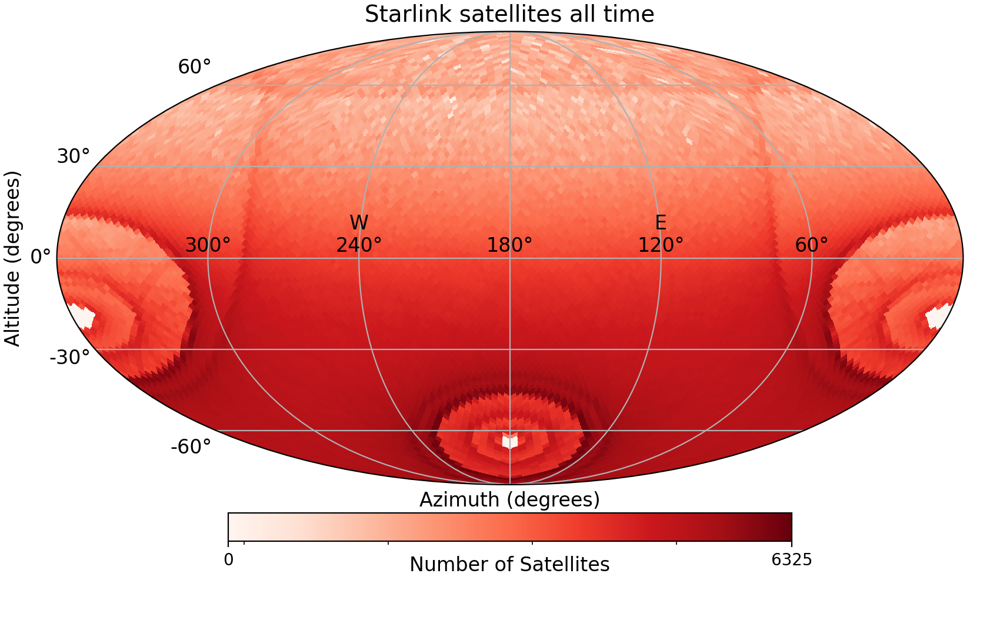

In [1122]:
projview(
    mstarlink,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Starlink satellites all time',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    custom_ytick_labels = ['-60°', '-30°', '0°', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('LEO_m.png')

Looking at ORBCOMM satellites at all time

In [739]:
alt_orba = []
az_orba = []
for i in range(len(active)):
    if active[i].name[:7] == 'ORBCOMM':
        for j in range(len(top[0])):
            alt_orba.append(np.abs(top[i][j].altaz()[0].degrees - 90))
            az_orba.append(top[i][j].altaz()[1].degrees)

In [740]:
thetaorbta = [np.radians(alt_orba)]
phiorbta = [np.radians(az_orba)]

In [741]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiorbta[0])):
    if (phiorbta[0][i] + np.pi) >= (2*np.pi):
        phiorbta[0][i] = phiorbta[0][i] - np.pi
    elif (phiorbta[0][i] + np.pi) < (2*np.pi):
        phiorbta[0][i] = phiorbta[0][i] + np.pi

In [742]:
pixel_indicesorbta = hp.ang2pix(nside, thetaorbta[0], phiorbta[0])

In [743]:
phorbta = hp.ang2pix(nside, thetaorbta[0], phiorbta[0])

In [744]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesorbta)-1):
    if phorbta[i] == phorbta[i+1]:
        pixel_indicesorbta[i+1] = 0

In [745]:
morbta = np.zeros(hp.nside2npix(nside))


In [749]:
%%time
for i in range(1, len(morbta)):
    for j in range(len(pixel_indicesorbta)):
        if i == pixel_indicesorbta[j]:
            morbta[i] += 1

CPU times: user 13 s, sys: 203 ms, total: 13.2 s
Wall time: 13.2 s


<IPython.core.display.Javascript object>


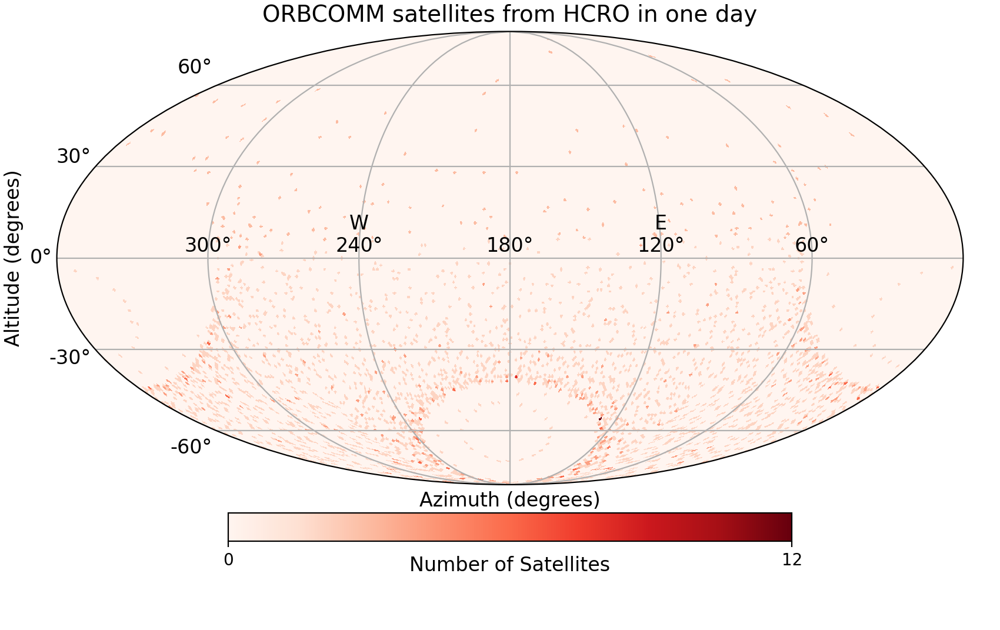

In [1175]:
plt.close()
projview(
    morbta,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'ORBCOMM satellites from HCRO in one day',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
);
#plt.savefig('GEO_m.png')

Making full plots (above and below horizon)

In [141]:
%%time
alt_GEOa = []
az_GEOa = []
distance_GEOa = []
alt_MEOa = []
az_MEOa = []
distance_MEOa = []
alt_HEOa = []
az_HEOa = []
distance_HEOa = []
alt_LEOa = []
az_LEOa = []
distance_LEOa = []
for i in range(len(alt)):
    #print(i)
    for j in range(len(GEO)):
        if i == GEO[j]:
            for k in range(len(t)):
                #if alt[i][k] > 0:
                alt_GEOa.append(np.abs(alt[i][k] - 90))
                az_GEOa.append(az[i][k])
                distance_GEOa.append(distance[i][k])
for i in range(len(alt)):
    for j in range(len(MEO)):
        if i == MEO[j]:
            for k in range(len(t)):
                #if alt[i][k] > 0:
                alt_MEOa.append(np.abs(alt[i][k] - 90))
                az_MEOa.append(az[i][k])
                distance_MEOa.append(distance[i][k])
                
for i in range(len(alt)):
    for j in range(len(HEO)):
        if i == HEO[j]:
            for k in range(len(t)):
                #if alt[i][k] > 0:
                    alt_HEOa.append(np.abs(alt[i][k] - 90))
                    az_HEOa.append(az[i][k])
                    distance_HEOa.append(distance[i][k])
                
for i in range(len(alt)):
    for j in range(len(LEO)):
        if i == LEO[j]:
            for k in range(len(t)):
                #if alt[i][k] > 0:
                alt_LEOa.append(np.abs(alt[i][k] - 90))
                az_LEOa.append(az[i][k])
                distance_LEOa.append(distance[i][k])


CPU times: user 4.57 s, sys: 83.1 ms, total: 4.66 s
Wall time: 4.75 s


In [142]:
data_a = [np.arange(len(alt_HEOa)),np.arange(len(alt_GEOa)), np.arange(len(alt_MEOa)), np.arange(len(alt_LEOa))]
theta_a = [np.radians(alt_HEOa), np.radians(alt_GEOa), np.radians(alt_MEOa), np.radians(alt_LEOa)]
phi_a = [np.radians(az_HEOa), np.radians(az_GEOa), np.radians(az_MEOa), np.radians(az_LEOa)]


In [143]:
nside = 2**6

In [144]:
(hp.nside2resol(nside) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 0.91612971 deg>

In [145]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi_a[0])):
    if (phi_a[0][i] + np.pi) >= (2*np.pi):
        phi_a[0][i] = phi_a[0][i] - np.pi
    elif (phi_a[0][i] + np.pi) < (2*np.pi):
        phi_a[0][i] = phi_a[0][i] + np.pi

for i in range(len(phi_a[1])):
    if (phi_a[1][i] + np.pi) >= (2*np.pi):
        phi_a[1][i] = phi_a[1][i] - np.pi
    elif (phi_a[1][i] + np.pi) < (2*np.pi):
        phi_a[1][i] = phi_a[1][i] + np.pi

for i in range(len(phi_a[2])):
    if (phi_a[2][i] + np.pi) >= (2*np.pi):
        phi_a[2][i] = phi_a[2][i] - np.pi
    elif (phi_a[2][i] + np.pi) < (2*np.pi):
        phi_a[2][i] = phi_a[2][i] + np.pi
        
for i in range(len(phi_a[3])):
    if (phi_a[3][i] + np.pi) >= (2*np.pi):
        phi_a[3][i] = phi_a[3][i] - np.pi
    elif (phi_a[3][i] + np.pi) < (2*np.pi):
        phi_a[3][i] = phi_a[3][i] + np.pi

In [146]:
pixel_indices_heoa = hp.ang2pix(nside, theta_a[0], phi_a[0])
pixel_indices_geoa = hp.ang2pix(nside, theta_a[1], phi_a[1])
pixel_indices_meoa = hp.ang2pix(nside, theta_a[2], phi_a[2])
pixel_indices_leoa = hp.ang2pix(nside, theta_a[3], phi_a[3])

In [147]:
pha = hp.ang2pix(nside, theta_a[0], phi_a[0])
pga = hp.ang2pix(nside, theta_a[1], phi_a[1])
pma = hp.ang2pix(nside, theta_a[2], phi_a[2])
pla = hp.ang2pix(nside, theta_a[3], phi_a[3])

In [148]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indices_geoa)-1):
    if pga[i] == pga[i+1]:
        pixel_indices_geoa[i+1] = 0
        
for i in range(len(pixel_indices_heoa)-1):
    if pha[i] == pha[i+1]:
        pixel_indices_heoa[i+1] = 0
        
for i in range(len(pixel_indices_meoa)-1):
    if pma[i] == pma[i+1]:
        pixel_indices_meoa[i+1] = 0
        
for i in range(len(pixel_indices_leoa)-1):
    if pla[i] == pla[i+1]:
        pixel_indices_leoa[i+1] = 0

In [149]:
mheoa = np.zeros(hp.nside2npix(nside))
mgeoa = np.zeros(hp.nside2npix(nside))
mmeoa = np.zeros(hp.nside2npix(nside))
mleoa = np.zeros(hp.nside2npix(nside))


In [150]:
%%time
#takes about 90 minutes
for i in range(1, len(mheoa)):
    for j in range(len(pixel_indices_heoa)):
        if i == pixel_indices_heoa[j]:
            mheoa[i] += 1
print(0)            
for i in range(1, len(mgeoa)):
    for j in range(len(pixel_indices_geoa)):
        if i == pixel_indices_geoa[j]:
            mgeoa[i] += 1
print(1)            
for i in range(1, len(mmeoa)):
    #print(i)
    for j in range(len(pixel_indices_meoa)):
        if i == pixel_indices_meoa[j]:
            mmeoa[i] += 1
print(2)            
for i in range(1, len(mleoa)):
    for j in range(len(pixel_indices_leoa)):
        if i == pixel_indices_leoa[j]:
            mleoa[i] += 1

0
1
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276


1964
1965
1966
1967
1968
1969
1970
1971
1972
1973
1974
1975
1976
1977
1978
1979
1980
1981
1982
1983
1984
1985
1986
1987
1988
1989
1990
1991
1992
1993
1994
1995
1996
1997
1998
1999
2000
2001
2002
2003
2004
2005
2006
2007
2008
2009
2010
2011
2012
2013
2014
2015
2016
2017
2018
2019
2020
2021
2022
2023
2024
2025
2026
2027
2028
2029
2030
2031
2032
2033
2034
2035
2036
2037
2038
2039
2040
2041
2042
2043
2044
2045
2046
2047
2048
2049
2050
2051
2052
2053
2054
2055
2056
2057
2058
2059
2060
2061
2062
2063
2064
2065
2066
2067
2068
2069
2070
2071
2072
2073
2074
2075
2076
2077
2078
2079
2080
2081
2082
2083
2084
2085
2086
2087
2088
2089
2090
2091
2092
2093
2094
2095
2096
2097
2098
2099
2100
2101
2102
2103
2104
2105
2106
2107
2108
2109
2110
2111
2112
2113
2114
2115
2116
2117
2118
2119
2120
2121
2122
2123
2124
2125
2126
2127
2128
2129
2130
2131
2132
2133
2134
2135
2136
2137
2138
2139
2140
2141
2142
2143
2144
2145
2146
2147
2148
2149
2150
2151
2152
2153
2154
2155
2156
2157
2158
2159
2160
2161
2162
2163


3697
3698
3699
3700
3701
3702
3703
3704
3705
3706
3707
3708
3709
3710
3711
3712
3713
3714
3715
3716
3717
3718
3719
3720
3721
3722
3723
3724
3725
3726
3727
3728
3729
3730
3731
3732
3733
3734
3735
3736
3737
3738
3739
3740
3741
3742
3743
3744
3745
3746
3747
3748
3749
3750
3751
3752
3753
3754
3755
3756
3757
3758
3759
3760
3761
3762
3763
3764
3765
3766
3767
3768
3769
3770
3771
3772
3773
3774
3775
3776
3777
3778
3779
3780
3781
3782
3783
3784
3785
3786
3787
3788
3789
3790
3791
3792
3793
3794
3795
3796
3797
3798
3799
3800
3801
3802
3803
3804
3805
3806
3807
3808
3809
3810
3811
3812
3813
3814
3815
3816
3817
3818
3819
3820
3821
3822
3823
3824
3825
3826
3827
3828
3829
3830
3831
3832
3833
3834
3835
3836
3837
3838
3839
3840
3841
3842
3843
3844
3845
3846
3847
3848
3849
3850
3851
3852
3853
3854
3855
3856
3857
3858
3859
3860
3861
3862
3863
3864
3865
3866
3867
3868
3869
3870
3871
3872
3873
3874
3875
3876
3877
3878
3879
3880
3881
3882
3883
3884
3885
3886
3887
3888
3889
3890
3891
3892
3893
3894
3895
3896


5355
5356
5357
5358
5359
5360
5361
5362
5363
5364
5365
5366
5367
5368
5369
5370
5371
5372
5373
5374
5375
5376
5377
5378
5379
5380
5381
5382
5383
5384
5385
5386
5387
5388
5389
5390
5391
5392
5393
5394
5395
5396
5397
5398
5399
5400
5401
5402
5403
5404
5405
5406
5407
5408
5409
5410
5411
5412
5413
5414
5415
5416
5417
5418
5419
5420
5421
5422
5423
5424
5425
5426
5427
5428
5429
5430
5431
5432
5433
5434
5435
5436
5437
5438
5439
5440
5441
5442
5443
5444
5445
5446
5447
5448
5449
5450
5451
5452
5453
5454
5455
5456
5457
5458
5459
5460
5461
5462
5463
5464
5465
5466
5467
5468
5469
5470
5471
5472
5473
5474
5475
5476
5477
5478
5479
5480
5481
5482
5483
5484
5485
5486
5487
5488
5489
5490
5491
5492
5493
5494
5495
5496
5497
5498
5499
5500
5501
5502
5503
5504
5505
5506
5507
5508
5509
5510
5511
5512
5513
5514
5515
5516
5517
5518
5519
5520
5521
5522
5523
5524
5525
5526
5527
5528
5529
5530
5531
5532
5533
5534
5535
5536
5537
5538
5539
5540
5541
5542
5543
5544
5545
5546
5547
5548
5549
5550
5551
5552
5553
5554


7026
7027
7028
7029
7030
7031
7032
7033
7034
7035
7036
7037
7038
7039
7040
7041
7042
7043
7044
7045
7046
7047
7048
7049
7050
7051
7052
7053
7054
7055
7056
7057
7058
7059
7060
7061
7062
7063
7064
7065
7066
7067
7068
7069
7070
7071
7072
7073
7074
7075
7076
7077
7078
7079
7080
7081
7082
7083
7084
7085
7086
7087
7088
7089
7090
7091
7092
7093
7094
7095
7096
7097
7098
7099
7100
7101
7102
7103
7104
7105
7106
7107
7108
7109
7110
7111
7112
7113
7114
7115
7116
7117
7118
7119
7120
7121
7122
7123
7124
7125
7126
7127
7128
7129
7130
7131
7132
7133
7134
7135
7136
7137
7138
7139
7140
7141
7142
7143
7144
7145
7146
7147
7148
7149
7150
7151
7152
7153
7154
7155
7156
7157
7158
7159
7160
7161
7162
7163
7164
7165
7166
7167
7168
7169
7170
7171
7172
7173
7174
7175
7176
7177
7178
7179
7180
7181
7182
7183
7184
7185
7186
7187
7188
7189
7190
7191
7192
7193
7194
7195
7196
7197
7198
7199
7200
7201
7202
7203
7204
7205
7206
7207
7208
7209
7210
7211
7212
7213
7214
7215
7216
7217
7218
7219
7220
7221
7222
7223
7224
7225


8773
8774
8775
8776
8777
8778
8779
8780
8781
8782
8783
8784
8785
8786
8787
8788
8789
8790
8791
8792
8793
8794
8795
8796
8797
8798
8799
8800
8801
8802
8803
8804
8805
8806
8807
8808
8809
8810
8811
8812
8813
8814
8815
8816
8817
8818
8819
8820
8821
8822
8823
8824
8825
8826
8827
8828
8829
8830
8831
8832
8833
8834
8835
8836
8837
8838
8839
8840
8841
8842
8843
8844
8845
8846
8847
8848
8849
8850
8851
8852
8853
8854
8855
8856
8857
8858
8859
8860
8861
8862
8863
8864
8865
8866
8867
8868
8869
8870
8871
8872
8873
8874
8875
8876
8877
8878
8879
8880
8881
8882
8883
8884
8885
8886
8887
8888
8889
8890
8891
8892
8893
8894
8895
8896
8897
8898
8899
8900
8901
8902
8903
8904
8905
8906
8907
8908
8909
8910
8911
8912
8913
8914
8915
8916
8917
8918
8919
8920
8921
8922
8923
8924
8925
8926
8927
8928
8929
8930
8931
8932
8933
8934
8935
8936
8937
8938
8939
8940
8941
8942
8943
8944
8945
8946
8947
8948
8949
8950
8951
8952
8953
8954
8955
8956
8957
8958
8959
8960
8961
8962
8963
8964
8965
8966
8967
8968
8969
8970
8971
8972


10344
10345
10346
10347
10348
10349
10350
10351
10352
10353
10354
10355
10356
10357
10358
10359
10360
10361
10362
10363
10364
10365
10366
10367
10368
10369
10370
10371
10372
10373
10374
10375
10376
10377
10378
10379
10380
10381
10382
10383
10384
10385
10386
10387
10388
10389
10390
10391
10392
10393
10394
10395
10396
10397
10398
10399
10400
10401
10402
10403
10404
10405
10406
10407
10408
10409
10410
10411
10412
10413
10414
10415
10416
10417
10418
10419
10420
10421
10422
10423
10424
10425
10426
10427
10428
10429
10430
10431
10432
10433
10434
10435
10436
10437
10438
10439
10440
10441
10442
10443
10444
10445
10446
10447
10448
10449
10450
10451
10452
10453
10454
10455
10456
10457
10458
10459
10460
10461
10462
10463
10464
10465
10466
10467
10468
10469
10470
10471
10472
10473
10474
10475
10476
10477
10478
10479
10480
10481
10482
10483
10484
10485
10486
10487
10488
10489
10490
10491
10492
10493
10494
10495
10496
10497
10498
10499
10500
10501
10502
10503
10504
10505
10506
10507
10508
10509
1051

11813
11814
11815
11816
11817
11818
11819
11820
11821
11822
11823
11824
11825
11826
11827
11828
11829
11830
11831
11832
11833
11834
11835
11836
11837
11838
11839
11840
11841
11842
11843
11844
11845
11846
11847
11848
11849
11850
11851
11852
11853
11854
11855
11856
11857
11858
11859
11860
11861
11862
11863
11864
11865
11866
11867
11868
11869
11870
11871
11872
11873
11874
11875
11876
11877
11878
11879
11880
11881
11882
11883
11884
11885
11886
11887
11888
11889
11890
11891
11892
11893
11894
11895
11896
11897
11898
11899
11900
11901
11902
11903
11904
11905
11906
11907
11908
11909
11910
11911
11912
11913
11914
11915
11916
11917
11918
11919
11920
11921
11922
11923
11924
11925
11926
11927
11928
11929
11930
11931
11932
11933
11934
11935
11936
11937
11938
11939
11940
11941
11942
11943
11944
11945
11946
11947
11948
11949
11950
11951
11952
11953
11954
11955
11956
11957
11958
11959
11960
11961
11962
11963
11964
11965
11966
11967
11968
11969
11970
11971
11972
11973
11974
11975
11976
11977
11978
1197

13276
13277
13278
13279
13280
13281
13282
13283
13284
13285
13286
13287
13288
13289
13290
13291
13292
13293
13294
13295
13296
13297
13298
13299
13300
13301
13302
13303
13304
13305
13306
13307
13308
13309
13310
13311
13312
13313
13314
13315
13316
13317
13318
13319
13320
13321
13322
13323
13324
13325
13326
13327
13328
13329
13330
13331
13332
13333
13334
13335
13336
13337
13338
13339
13340
13341
13342
13343
13344
13345
13346
13347
13348
13349
13350
13351
13352
13353
13354
13355
13356
13357
13358
13359
13360
13361
13362
13363
13364
13365
13366
13367
13368
13369
13370
13371
13372
13373
13374
13375
13376
13377
13378
13379
13380
13381
13382
13383
13384
13385
13386
13387
13388
13389
13390
13391
13392
13393
13394
13395
13396
13397
13398
13399
13400
13401
13402
13403
13404
13405
13406
13407
13408
13409
13410
13411
13412
13413
13414
13415
13416
13417
13418
13419
13420
13421
13422
13423
13424
13425
13426
13427
13428
13429
13430
13431
13432
13433
13434
13435
13436
13437
13438
13439
13440
13441
1344

14642
14643
14644
14645
14646
14647
14648
14649
14650
14651
14652
14653
14654
14655
14656
14657
14658
14659
14660
14661
14662
14663
14664
14665
14666
14667
14668
14669
14670
14671
14672
14673
14674
14675
14676
14677
14678
14679
14680
14681
14682
14683
14684
14685
14686
14687
14688
14689
14690
14691
14692
14693
14694
14695
14696
14697
14698
14699
14700
14701
14702
14703
14704
14705
14706
14707
14708
14709
14710
14711
14712
14713
14714
14715
14716
14717
14718
14719
14720
14721
14722
14723
14724
14725
14726
14727
14728
14729
14730
14731
14732
14733
14734
14735
14736
14737
14738
14739
14740
14741
14742
14743
14744
14745
14746
14747
14748
14749
14750
14751
14752
14753
14754
14755
14756
14757
14758
14759
14760
14761
14762
14763
14764
14765
14766
14767
14768
14769
14770
14771
14772
14773
14774
14775
14776
14777
14778
14779
14780
14781
14782
14783
14784
14785
14786
14787
14788
14789
14790
14791
14792
14793
14794
14795
14796
14797
14798
14799
14800
14801
14802
14803
14804
14805
14806
14807
1480

16114
16115
16116
16117
16118
16119
16120
16121
16122
16123
16124
16125
16126
16127
16128
16129
16130
16131
16132
16133
16134
16135
16136
16137
16138
16139
16140
16141
16142
16143
16144
16145
16146
16147
16148
16149
16150
16151
16152
16153
16154
16155
16156
16157
16158
16159
16160
16161
16162
16163
16164
16165
16166
16167
16168
16169
16170
16171
16172
16173
16174
16175
16176
16177
16178
16179
16180
16181
16182
16183
16184
16185
16186
16187
16188
16189
16190
16191
16192
16193
16194
16195
16196
16197
16198
16199
16200
16201
16202
16203
16204
16205
16206
16207
16208
16209
16210
16211
16212
16213
16214
16215
16216
16217
16218
16219
16220
16221
16222
16223
16224
16225
16226
16227
16228
16229
16230
16231
16232
16233
16234
16235
16236
16237
16238
16239
16240
16241
16242
16243
16244
16245
16246
16247
16248
16249
16250
16251
16252
16253
16254
16255
16256
16257
16258
16259
16260
16261
16262
16263
16264
16265
16266
16267
16268
16269
16270
16271
16272
16273
16274
16275
16276
16277
16278
16279
1628

17482
17483
17484
17485
17486
17487
17488
17489
17490
17491
17492
17493
17494
17495
17496
17497
17498
17499
17500
17501
17502
17503
17504
17505
17506
17507
17508
17509
17510
17511
17512
17513
17514
17515
17516
17517
17518
17519
17520
17521
17522
17523
17524
17525
17526
17527
17528
17529
17530
17531
17532
17533
17534
17535
17536
17537
17538
17539
17540
17541
17542
17543
17544
17545
17546
17547
17548
17549
17550
17551
17552
17553
17554
17555
17556
17557
17558
17559
17560
17561
17562
17563
17564
17565
17566
17567
17568
17569
17570
17571
17572
17573
17574
17575
17576
17577
17578
17579
17580
17581
17582
17583
17584
17585
17586
17587
17588
17589
17590
17591
17592
17593
17594
17595
17596
17597
17598
17599
17600
17601
17602
17603
17604
17605
17606
17607
17608
17609
17610
17611
17612
17613
17614
17615
17616
17617
17618
17619
17620
17621
17622
17623
17624
17625
17626
17627
17628
17629
17630
17631
17632
17633
17634
17635
17636
17637
17638
17639
17640
17641
17642
17643
17644
17645
17646
17647
1764

18931
18932
18933
18934
18935
18936
18937
18938
18939
18940
18941
18942
18943
18944
18945
18946
18947
18948
18949
18950
18951
18952
18953
18954
18955
18956
18957
18958
18959
18960
18961
18962
18963
18964
18965
18966
18967
18968
18969
18970
18971
18972
18973
18974
18975
18976
18977
18978
18979
18980
18981
18982
18983
18984
18985
18986
18987
18988
18989
18990
18991
18992
18993
18994
18995
18996
18997
18998
18999
19000
19001
19002
19003
19004
19005
19006
19007
19008
19009
19010
19011
19012
19013
19014
19015
19016
19017
19018
19019
19020
19021
19022
19023
19024
19025
19026
19027
19028
19029
19030
19031
19032
19033
19034
19035
19036
19037
19038
19039
19040
19041
19042
19043
19044
19045
19046
19047
19048
19049
19050
19051
19052
19053
19054
19055
19056
19057
19058
19059
19060
19061
19062
19063
19064
19065
19066
19067
19068
19069
19070
19071
19072
19073
19074
19075
19076
19077
19078
19079
19080
19081
19082
19083
19084
19085
19086
19087
19088
19089
19090
19091
19092
19093
19094
19095
19096
1909

20355
20356
20357
20358
20359
20360
20361
20362
20363
20364
20365
20366
20367
20368
20369
20370
20371
20372
20373
20374
20375
20376
20377
20378
20379
20380
20381
20382
20383
20384
20385
20386
20387
20388
20389
20390
20391
20392
20393
20394
20395
20396
20397
20398
20399
20400
20401
20402
20403
20404
20405
20406
20407
20408
20409
20410
20411
20412
20413
20414
20415
20416
20417
20418
20419
20420
20421
20422
20423
20424
20425
20426
20427
20428
20429
20430
20431
20432
20433
20434
20435
20436
20437
20438
20439
20440
20441
20442
20443
20444
20445
20446
20447
20448
20449
20450
20451
20452
20453
20454
20455
20456
20457
20458
20459
20460
20461
20462
20463
20464
20465
20466
20467
20468
20469
20470
20471
20472
20473
20474
20475
20476
20477
20478
20479
20480
20481
20482
20483
20484
20485
20486
20487
20488
20489
20490
20491
20492
20493
20494
20495
20496
20497
20498
20499
20500
20501
20502
20503
20504
20505
20506
20507
20508
20509
20510
20511
20512
20513
20514
20515
20516
20517
20518
20519
20520
2052

21769
21770
21771
21772
21773
21774
21775
21776
21777
21778
21779
21780
21781
21782
21783
21784
21785
21786
21787
21788
21789
21790
21791
21792
21793
21794
21795
21796
21797
21798
21799
21800
21801
21802
21803
21804
21805
21806
21807
21808
21809
21810
21811
21812
21813
21814
21815
21816
21817
21818
21819
21820
21821
21822
21823
21824
21825
21826
21827
21828
21829
21830
21831
21832
21833
21834
21835
21836
21837
21838
21839
21840
21841
21842
21843
21844
21845
21846
21847
21848
21849
21850
21851
21852
21853
21854
21855
21856
21857
21858
21859
21860
21861
21862
21863
21864
21865
21866
21867
21868
21869
21870
21871
21872
21873
21874
21875
21876
21877
21878
21879
21880
21881
21882
21883
21884
21885
21886
21887
21888
21889
21890
21891
21892
21893
21894
21895
21896
21897
21898
21899
21900
21901
21902
21903
21904
21905
21906
21907
21908
21909
21910
21911
21912
21913
21914
21915
21916
21917
21918
21919
21920
21921
21922
21923
21924
21925
21926
21927
21928
21929
21930
21931
21932
21933
21934
2193

23175
23176
23177
23178
23179
23180
23181
23182
23183
23184
23185
23186
23187
23188
23189
23190
23191
23192
23193
23194
23195
23196
23197
23198
23199
23200
23201
23202
23203
23204
23205
23206
23207
23208
23209
23210
23211
23212
23213
23214
23215
23216
23217
23218
23219
23220
23221
23222
23223
23224
23225
23226
23227
23228
23229
23230
23231
23232
23233
23234
23235
23236
23237
23238
23239
23240
23241
23242
23243
23244
23245
23246
23247
23248
23249
23250
23251
23252
23253
23254
23255
23256
23257
23258
23259
23260
23261
23262
23263
23264
23265
23266
23267
23268
23269
23270
23271
23272
23273
23274
23275
23276
23277
23278
23279
23280
23281
23282
23283
23284
23285
23286
23287
23288
23289
23290
23291
23292
23293
23294
23295
23296
23297
23298
23299
23300
23301
23302
23303
23304
23305
23306
23307
23308
23309
23310
23311
23312
23313
23314
23315
23316
23317
23318
23319
23320
23321
23322
23323
23324
23325
23326
23327
23328
23329
23330
23331
23332
23333
23334
23335
23336
23337
23338
23339
23340
2334

24610
24611
24612
24613
24614
24615
24616
24617
24618
24619
24620
24621
24622
24623
24624
24625
24626
24627
24628
24629
24630
24631
24632
24633
24634
24635
24636
24637
24638
24639
24640
24641
24642
24643
24644
24645
24646
24647
24648
24649
24650
24651
24652
24653
24654
24655
24656
24657
24658
24659
24660
24661
24662
24663
24664
24665
24666
24667
24668
24669
24670
24671
24672
24673
24674
24675
24676
24677
24678
24679
24680
24681
24682
24683
24684
24685
24686
24687
24688
24689
24690
24691
24692
24693
24694
24695
24696
24697
24698
24699
24700
24701
24702
24703
24704
24705
24706
24707
24708
24709
24710
24711
24712
24713
24714
24715
24716
24717
24718
24719
24720
24721
24722
24723
24724
24725
24726
24727
24728
24729
24730
24731
24732
24733
24734
24735
24736
24737
24738
24739
24740
24741
24742
24743
24744
24745
24746
24747
24748
24749
24750
24751
24752
24753
24754
24755
24756
24757
24758
24759
24760
24761
24762
24763
24764
24765
24766
24767
24768
24769
24770
24771
24772
24773
24774
24775
2477

26042
26043
26044
26045
26046
26047
26048
26049
26050
26051
26052
26053
26054
26055
26056
26057
26058
26059
26060
26061
26062
26063
26064
26065
26066
26067
26068
26069
26070
26071
26072
26073
26074
26075
26076
26077
26078
26079
26080
26081
26082
26083
26084
26085
26086
26087
26088
26089
26090
26091
26092
26093
26094
26095
26096
26097
26098
26099
26100
26101
26102
26103
26104
26105
26106
26107
26108
26109
26110
26111
26112
26113
26114
26115
26116
26117
26118
26119
26120
26121
26122
26123
26124
26125
26126
26127
26128
26129
26130
26131
26132
26133
26134
26135
26136
26137
26138
26139
26140
26141
26142
26143
26144
26145
26146
26147
26148
26149
26150
26151
26152
26153
26154
26155
26156
26157
26158
26159
26160
26161
26162
26163
26164
26165
26166
26167
26168
26169
26170
26171
26172
26173
26174
26175
26176
26177
26178
26179
26180
26181
26182
26183
26184
26185
26186
26187
26188
26189
26190
26191
26192
26193
26194
26195
26196
26197
26198
26199
26200
26201
26202
26203
26204
26205
26206
26207
2620

27462
27463
27464
27465
27466
27467
27468
27469
27470
27471
27472
27473
27474
27475
27476
27477
27478
27479
27480
27481
27482
27483
27484
27485
27486
27487
27488
27489
27490
27491
27492
27493
27494
27495
27496
27497
27498
27499
27500
27501
27502
27503
27504
27505
27506
27507
27508
27509
27510
27511
27512
27513
27514
27515
27516
27517
27518
27519
27520
27521
27522
27523
27524
27525
27526
27527
27528
27529
27530
27531
27532
27533
27534
27535
27536
27537
27538
27539
27540
27541
27542
27543
27544
27545
27546
27547
27548
27549
27550
27551
27552
27553
27554
27555
27556
27557
27558
27559
27560
27561
27562
27563
27564
27565
27566
27567
27568
27569
27570
27571
27572
27573
27574
27575
27576
27577
27578
27579
27580
27581
27582
27583
27584
27585
27586
27587
27588
27589
27590
27591
27592
27593
27594
27595
27596
27597
27598
27599
27600
27601
27602
27603
27604
27605
27606
27607
27608
27609
27610
27611
27612
27613
27614
27615
27616
27617
27618
27619
27620
27621
27622
27623
27624
27625
27626
27627
2762

28920
28921
28922
28923
28924
28925
28926
28927
28928
28929
28930
28931
28932
28933
28934
28935
28936
28937
28938
28939
28940
28941
28942
28943
28944
28945
28946
28947
28948
28949
28950
28951
28952
28953
28954
28955
28956
28957
28958
28959
28960
28961
28962
28963
28964
28965
28966
28967
28968
28969
28970
28971
28972
28973
28974
28975
28976
28977
28978
28979
28980
28981
28982
28983
28984
28985
28986
28987
28988
28989
28990
28991
28992
28993
28994
28995
28996
28997
28998
28999
29000
29001
29002
29003
29004
29005
29006
29007
29008
29009
29010
29011
29012
29013
29014
29015
29016
29017
29018
29019
29020
29021
29022
29023
29024
29025
29026
29027
29028
29029
29030
29031
29032
29033
29034
29035
29036
29037
29038
29039
29040
29041
29042
29043
29044
29045
29046
29047
29048
29049
29050
29051
29052
29053
29054
29055
29056
29057
29058
29059
29060
29061
29062
29063
29064
29065
29066
29067
29068
29069
29070
29071
29072
29073
29074
29075
29076
29077
29078
29079
29080
29081
29082
29083
29084
29085
2908

30392
30393
30394
30395
30396
30397
30398
30399
30400
30401
30402
30403
30404
30405
30406
30407
30408
30409
30410
30411
30412
30413
30414
30415
30416
30417
30418
30419
30420
30421
30422
30423
30424
30425
30426
30427
30428
30429
30430
30431
30432
30433
30434
30435
30436
30437
30438
30439
30440
30441
30442
30443
30444
30445
30446
30447
30448
30449
30450
30451
30452
30453
30454
30455
30456
30457
30458
30459
30460
30461
30462
30463
30464
30465
30466
30467
30468
30469
30470
30471
30472
30473
30474
30475
30476
30477
30478
30479
30480
30481
30482
30483
30484
30485
30486
30487
30488
30489
30490
30491
30492
30493
30494
30495
30496
30497
30498
30499
30500
30501
30502
30503
30504
30505
30506
30507
30508
30509
30510
30511
30512
30513
30514
30515
30516
30517
30518
30519
30520
30521
30522
30523
30524
30525
30526
30527
30528
30529
30530
30531
30532
30533
30534
30535
30536
30537
30538
30539
30540
30541
30542
30543
30544
30545
30546
30547
30548
30549
30550
30551
30552
30553
30554
30555
30556
30557
3055

31852
31853
31854
31855
31856
31857
31858
31859
31860
31861
31862
31863
31864
31865
31866
31867
31868
31869
31870
31871
31872
31873
31874
31875
31876
31877
31878
31879
31880
31881
31882
31883
31884
31885
31886
31887
31888
31889
31890
31891
31892
31893
31894
31895
31896
31897
31898
31899
31900
31901
31902
31903
31904
31905
31906
31907
31908
31909
31910
31911
31912
31913
31914
31915
31916
31917
31918
31919
31920
31921
31922
31923
31924
31925
31926
31927
31928
31929
31930
31931
31932
31933
31934
31935
31936
31937
31938
31939
31940
31941
31942
31943
31944
31945
31946
31947
31948
31949
31950
31951
31952
31953
31954
31955
31956
31957
31958
31959
31960
31961
31962
31963
31964
31965
31966
31967
31968
31969
31970
31971
31972
31973
31974
31975
31976
31977
31978
31979
31980
31981
31982
31983
31984
31985
31986
31987
31988
31989
31990
31991
31992
31993
31994
31995
31996
31997
31998
31999
32000
32001
32002
32003
32004
32005
32006
32007
32008
32009
32010
32011
32012
32013
32014
32015
32016
32017
3201

33288
33289
33290
33291
33292
33293
33294
33295
33296
33297
33298
33299
33300
33301
33302
33303
33304
33305
33306
33307
33308
33309
33310
33311
33312
33313
33314
33315
33316
33317
33318
33319
33320
33321
33322
33323
33324
33325
33326
33327
33328
33329
33330
33331
33332
33333
33334
33335
33336
33337
33338
33339
33340
33341
33342
33343
33344
33345
33346
33347
33348
33349
33350
33351
33352
33353
33354
33355
33356
33357
33358
33359
33360
33361
33362
33363
33364
33365
33366
33367
33368
33369
33370
33371
33372
33373
33374
33375
33376
33377
33378
33379
33380
33381
33382
33383
33384
33385
33386
33387
33388
33389
33390
33391
33392
33393
33394
33395
33396
33397
33398
33399
33400
33401
33402
33403
33404
33405
33406
33407
33408
33409
33410
33411
33412
33413
33414
33415
33416
33417
33418
33419
33420
33421
33422
33423
33424
33425
33426
33427
33428
33429
33430
33431
33432
33433
33434
33435
33436
33437
33438
33439
33440
33441
33442
33443
33444
33445
33446
33447
33448
33449
33450
33451
33452
33453
3345

34714
34715
34716
34717
34718
34719
34720
34721
34722
34723
34724
34725
34726
34727
34728
34729
34730
34731
34732
34733
34734
34735
34736
34737
34738
34739
34740
34741
34742
34743
34744
34745
34746
34747
34748
34749
34750
34751
34752
34753
34754
34755
34756
34757
34758
34759
34760
34761
34762
34763
34764
34765
34766
34767
34768
34769
34770
34771
34772
34773
34774
34775
34776
34777
34778
34779
34780
34781
34782
34783
34784
34785
34786
34787
34788
34789
34790
34791
34792
34793
34794
34795
34796
34797
34798
34799
34800
34801
34802
34803
34804
34805
34806
34807
34808
34809
34810
34811
34812
34813
34814
34815
34816
34817
34818
34819
34820
34821
34822
34823
34824
34825
34826
34827
34828
34829
34830
34831
34832
34833
34834
34835
34836
34837
34838
34839
34840
34841
34842
34843
34844
34845
34846
34847
34848
34849
34850
34851
34852
34853
34854
34855
34856
34857
34858
34859
34860
34861
34862
34863
34864
34865
34866
34867
34868
34869
34870
34871
34872
34873
34874
34875
34876
34877
34878
34879
3488

36101
36102
36103
36104
36105
36106
36107
36108
36109
36110
36111
36112
36113
36114
36115
36116
36117
36118
36119
36120
36121
36122
36123
36124
36125
36126
36127
36128
36129
36130
36131
36132
36133
36134
36135
36136
36137
36138
36139
36140
36141
36142
36143
36144
36145
36146
36147
36148
36149
36150
36151
36152
36153
36154
36155
36156
36157
36158
36159
36160
36161
36162
36163
36164
36165
36166
36167
36168
36169
36170
36171
36172
36173
36174
36175
36176
36177
36178
36179
36180
36181
36182
36183
36184
36185
36186
36187
36188
36189
36190
36191
36192
36193
36194
36195
36196
36197
36198
36199
36200
36201
36202
36203
36204
36205
36206
36207
36208
36209
36210
36211
36212
36213
36214
36215
36216
36217
36218
36219
36220
36221
36222
36223
36224
36225
36226
36227
36228
36229
36230
36231
36232
36233
36234
36235
36236
36237
36238
36239
36240
36241
36242
36243
36244
36245
36246
36247
36248
36249
36250
36251
36252
36253
36254
36255
36256
36257
36258
36259
36260
36261
36262
36263
36264
36265
36266
3626

37512
37513
37514
37515
37516
37517
37518
37519
37520
37521
37522
37523
37524
37525
37526
37527
37528
37529
37530
37531
37532
37533
37534
37535
37536
37537
37538
37539
37540
37541
37542
37543
37544
37545
37546
37547
37548
37549
37550
37551
37552
37553
37554
37555
37556
37557
37558
37559
37560
37561
37562
37563
37564
37565
37566
37567
37568
37569
37570
37571
37572
37573
37574
37575
37576
37577
37578
37579
37580
37581
37582
37583
37584
37585
37586
37587
37588
37589
37590
37591
37592
37593
37594
37595
37596
37597
37598
37599
37600
37601
37602
37603
37604
37605
37606
37607
37608
37609
37610
37611
37612
37613
37614
37615
37616
37617
37618
37619
37620
37621
37622
37623
37624
37625
37626
37627
37628
37629
37630
37631
37632
37633
37634
37635
37636
37637
37638
37639
37640
37641
37642
37643
37644
37645
37646
37647
37648
37649
37650
37651
37652
37653
37654
37655
37656
37657
37658
37659
37660
37661
37662
37663
37664
37665
37666
37667
37668
37669
37670
37671
37672
37673
37674
37675
37676
37677
3767

38964
38965
38966
38967
38968
38969
38970
38971
38972
38973
38974
38975
38976
38977
38978
38979
38980
38981
38982
38983
38984
38985
38986
38987
38988
38989
38990
38991
38992
38993
38994
38995
38996
38997
38998
38999
39000
39001
39002
39003
39004
39005
39006
39007
39008
39009
39010
39011
39012
39013
39014
39015
39016
39017
39018
39019
39020
39021
39022
39023
39024
39025
39026
39027
39028
39029
39030
39031
39032
39033
39034
39035
39036
39037
39038
39039
39040
39041
39042
39043
39044
39045
39046
39047
39048
39049
39050
39051
39052
39053
39054
39055
39056
39057
39058
39059
39060
39061
39062
39063
39064
39065
39066
39067
39068
39069
39070
39071
39072
39073
39074
39075
39076
39077
39078
39079
39080
39081
39082
39083
39084
39085
39086
39087
39088
39089
39090
39091
39092
39093
39094
39095
39096
39097
39098
39099
39100
39101
39102
39103
39104
39105
39106
39107
39108
39109
39110
39111
39112
39113
39114
39115
39116
39117
39118
39119
39120
39121
39122
39123
39124
39125
39126
39127
39128
39129
3913

40387
40388
40389
40390
40391
40392
40393
40394
40395
40396
40397
40398
40399
40400
40401
40402
40403
40404
40405
40406
40407
40408
40409
40410
40411
40412
40413
40414
40415
40416
40417
40418
40419
40420
40421
40422
40423
40424
40425
40426
40427
40428
40429
40430
40431
40432
40433
40434
40435
40436
40437
40438
40439
40440
40441
40442
40443
40444
40445
40446
40447
40448
40449
40450
40451
40452
40453
40454
40455
40456
40457
40458
40459
40460
40461
40462
40463
40464
40465
40466
40467
40468
40469
40470
40471
40472
40473
40474
40475
40476
40477
40478
40479
40480
40481
40482
40483
40484
40485
40486
40487
40488
40489
40490
40491
40492
40493
40494
40495
40496
40497
40498
40499
40500
40501
40502
40503
40504
40505
40506
40507
40508
40509
40510
40511
40512
40513
40514
40515
40516
40517
40518
40519
40520
40521
40522
40523
40524
40525
40526
40527
40528
40529
40530
40531
40532
40533
40534
40535
40536
40537
40538
40539
40540
40541
40542
40543
40544
40545
40546
40547
40548
40549
40550
40551
40552
4055

41793
41794
41795
41796
41797
41798
41799
41800
41801
41802
41803
41804
41805
41806
41807
41808
41809
41810
41811
41812
41813
41814
41815
41816
41817
41818
41819
41820
41821
41822
41823
41824
41825
41826
41827
41828
41829
41830
41831
41832
41833
41834
41835
41836
41837
41838
41839
41840
41841
41842
41843
41844
41845
41846
41847
41848
41849
41850
41851
41852
41853
41854
41855
41856
41857
41858
41859
41860
41861
41862
41863
41864
41865
41866
41867
41868
41869
41870
41871
41872
41873
41874
41875
41876
41877
41878
41879
41880
41881
41882
41883
41884
41885
41886
41887
41888
41889
41890
41891
41892
41893
41894
41895
41896
41897
41898
41899
41900
41901
41902
41903
41904
41905
41906
41907
41908
41909
41910
41911
41912
41913
41914
41915
41916
41917
41918
41919
41920
41921
41922
41923
41924
41925
41926
41927
41928
41929
41930
41931
41932
41933
41934
41935
41936
41937
41938
41939
41940
41941
41942
41943
41944
41945
41946
41947
41948
41949
41950
41951
41952
41953
41954
41955
41956
41957
41958
4195

43242
43243
43244
43245
43246
43247
43248
43249
43250
43251
43252
43253
43254
43255
43256
43257
43258
43259
43260
43261
43262
43263
43264
43265
43266
43267
43268
43269
43270
43271
43272
43273
43274
43275
43276
43277
43278
43279
43280
43281
43282
43283
43284
43285
43286
43287
43288
43289
43290
43291
43292
43293
43294
43295
43296
43297
43298
43299
43300
43301
43302
43303
43304
43305
43306
43307
43308
43309
43310
43311
43312
43313
43314
43315
43316
43317
43318
43319
43320
43321
43322
43323
43324
43325
43326
43327
43328
43329
43330
43331
43332
43333
43334
43335
43336
43337
43338
43339
43340
43341
43342
43343
43344
43345
43346
43347
43348
43349
43350
43351
43352
43353
43354
43355
43356
43357
43358
43359
43360
43361
43362
43363
43364
43365
43366
43367
43368
43369
43370
43371
43372
43373
43374
43375
43376
43377
43378
43379
43380
43381
43382
43383
43384
43385
43386
43387
43388
43389
43390
43391
43392
43393
43394
43395
43396
43397
43398
43399
43400
43401
43402
43403
43404
43405
43406
43407
4340

44670
44671
44672
44673
44674
44675
44676
44677
44678
44679
44680
44681
44682
44683
44684
44685
44686
44687
44688
44689
44690
44691
44692
44693
44694
44695
44696
44697
44698
44699
44700
44701
44702
44703
44704
44705
44706
44707
44708
44709
44710
44711
44712
44713
44714
44715
44716
44717
44718
44719
44720
44721
44722
44723
44724
44725
44726
44727
44728
44729
44730
44731
44732
44733
44734
44735
44736
44737
44738
44739
44740
44741
44742
44743
44744
44745
44746
44747
44748
44749
44750
44751
44752
44753
44754
44755
44756
44757
44758
44759
44760
44761
44762
44763
44764
44765
44766
44767
44768
44769
44770
44771
44772
44773
44774
44775
44776
44777
44778
44779
44780
44781
44782
44783
44784
44785
44786
44787
44788
44789
44790
44791
44792
44793
44794
44795
44796
44797
44798
44799
44800
44801
44802
44803
44804
44805
44806
44807
44808
44809
44810
44811
44812
44813
44814
44815
44816
44817
44818
44819
44820
44821
44822
44823
44824
44825
44826
44827
44828
44829
44830
44831
44832
44833
44834
44835
4483

46120
46121
46122
46123
46124
46125
46126
46127
46128
46129
46130
46131
46132
46133
46134
46135
46136
46137
46138
46139
46140
46141
46142
46143
46144
46145
46146
46147
46148
46149
46150
46151
46152
46153
46154
46155
46156
46157
46158
46159
46160
46161
46162
46163
46164
46165
46166
46167
46168
46169
46170
46171
46172
46173
46174
46175
46176
46177
46178
46179
46180
46181
46182
46183
46184
46185
46186
46187
46188
46189
46190
46191
46192
46193
46194
46195
46196
46197
46198
46199
46200
46201
46202
46203
46204
46205
46206
46207
46208
46209
46210
46211
46212
46213
46214
46215
46216
46217
46218
46219
46220
46221
46222
46223
46224
46225
46226
46227
46228
46229
46230
46231
46232
46233
46234
46235
46236
46237
46238
46239
46240
46241
46242
46243
46244
46245
46246
46247
46248
46249
46250
46251
46252
46253
46254
46255
46256
46257
46258
46259
46260
46261
46262
46263
46264
46265
46266
46267
46268
46269
46270
46271
46272
46273
46274
46275
46276
46277
46278
46279
46280
46281
46282
46283
46284
46285
4628

47567
47568
47569
47570
47571
47572
47573
47574
47575
47576
47577
47578
47579
47580
47581
47582
47583
47584
47585
47586
47587
47588
47589
47590
47591
47592
47593
47594
47595
47596
47597
47598
47599
47600
47601
47602
47603
47604
47605
47606
47607
47608
47609
47610
47611
47612
47613
47614
47615
47616
47617
47618
47619
47620
47621
47622
47623
47624
47625
47626
47627
47628
47629
47630
47631
47632
47633
47634
47635
47636
47637
47638
47639
47640
47641
47642
47643
47644
47645
47646
47647
47648
47649
47650
47651
47652
47653
47654
47655
47656
47657
47658
47659
47660
47661
47662
47663
47664
47665
47666
47667
47668
47669
47670
47671
47672
47673
47674
47675
47676
47677
47678
47679
47680
47681
47682
47683
47684
47685
47686
47687
47688
47689
47690
47691
47692
47693
47694
47695
47696
47697
47698
47699
47700
47701
47702
47703
47704
47705
47706
47707
47708
47709
47710
47711
47712
47713
47714
47715
47716
47717
47718
47719
47720
47721
47722
47723
47724
47725
47726
47727
47728
47729
47730
47731
47732
4773

49015
49016
49017
49018
49019
49020
49021
49022
49023
49024
49025
49026
49027
49028
49029
49030
49031
49032
49033
49034
49035
49036
49037
49038
49039
49040
49041
49042
49043
49044
49045
49046
49047
49048
49049
49050
49051
49052
49053
49054
49055
49056
49057
49058
49059
49060
49061
49062
49063
49064
49065
49066
49067
49068
49069
49070
49071
49072
49073
49074
49075
49076
49077
49078
49079
49080
49081
49082
49083
49084
49085
49086
49087
49088
49089
49090
49091
49092
49093
49094
49095
49096
49097
49098
49099
49100
49101
49102
49103
49104
49105
49106
49107
49108
49109
49110
49111
49112
49113
49114
49115
49116
49117
49118
49119
49120
49121
49122
49123
49124
49125
49126
49127
49128
49129
49130
49131
49132
49133
49134
49135
49136
49137
49138
49139
49140
49141
49142
49143
49144
49145
49146
49147
49148
49149
49150
49151
2
CPU times: user 1h 28min 56s, sys: 1min 26s, total: 1h 30min 22s
Wall time: 1h 49min 46s


In [151]:
ma = []
for i in range(len(mheoa)):
    ma.append(mheoa[i]+mgeoa[i]+mleoa[i]+mmeoa[i])

<IPython.core.display.Javascript object>


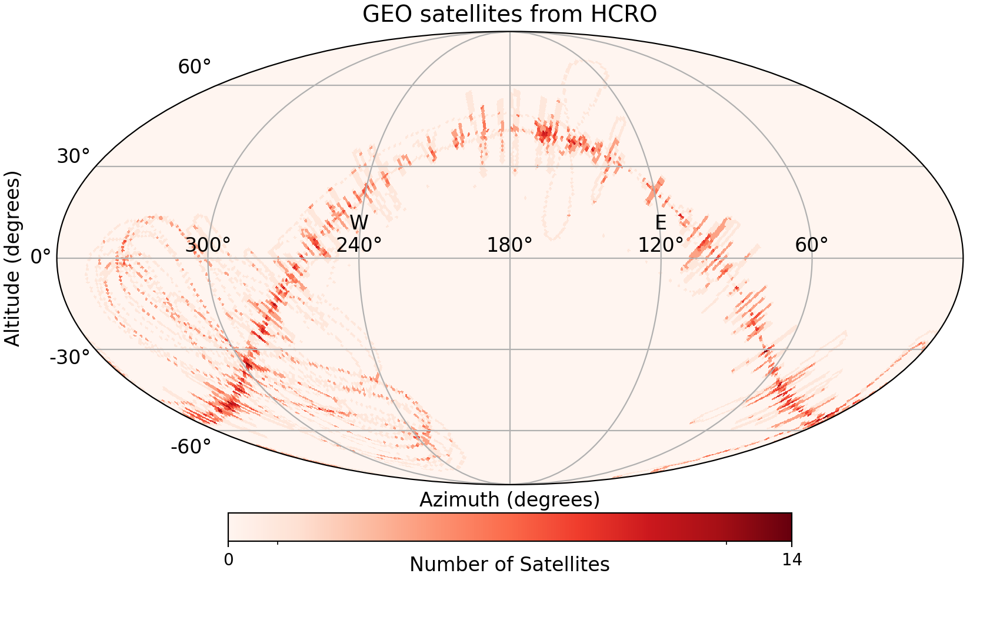

In [1187]:
plt.close()
projview(
    mgeoa,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'GEO satellites from HCRO',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    custom_ytick_labels = ['-60°', '-30°', '0°', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('GEO_m.png')

<IPython.core.display.Javascript object>


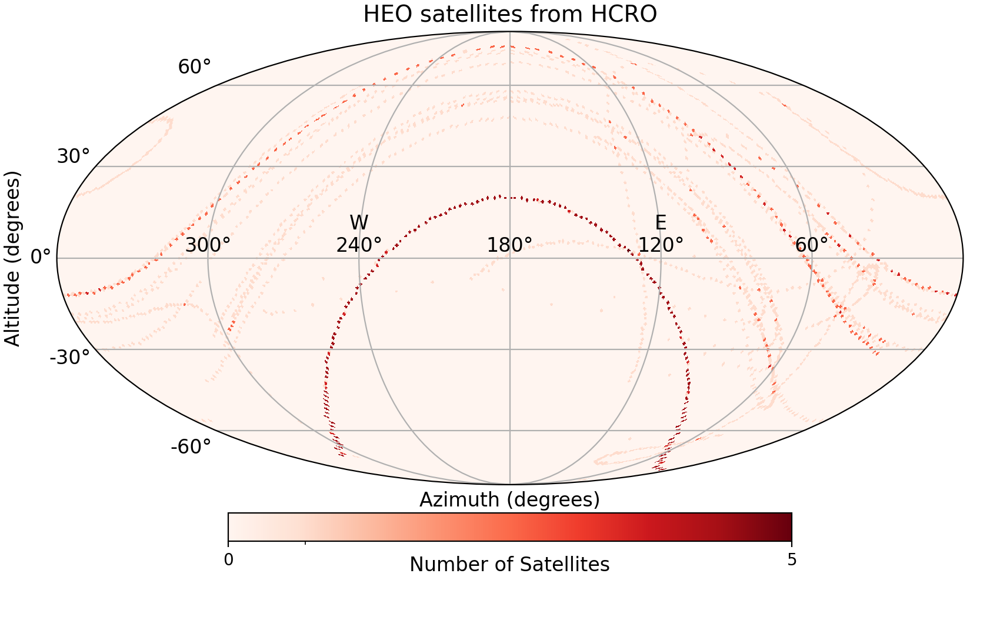

In [1189]:
projview(
    mheoa,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'HEO satellites from HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    custom_ytick_labels = ['-60°', '-30°', '0°', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('HEO_m.png')

<IPython.core.display.Javascript object>


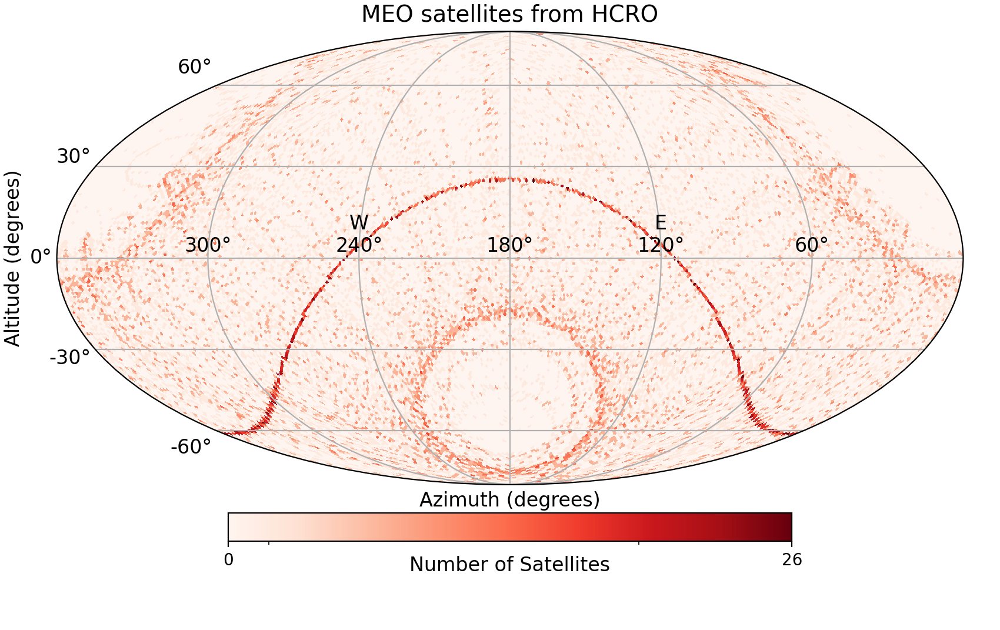

In [1190]:
projview(
    mmeoa,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'MEO satellites from HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    custom_ytick_labels = ['-60°', '-30°', '0°', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('MEO_m.png')

<IPython.core.display.Javascript object>


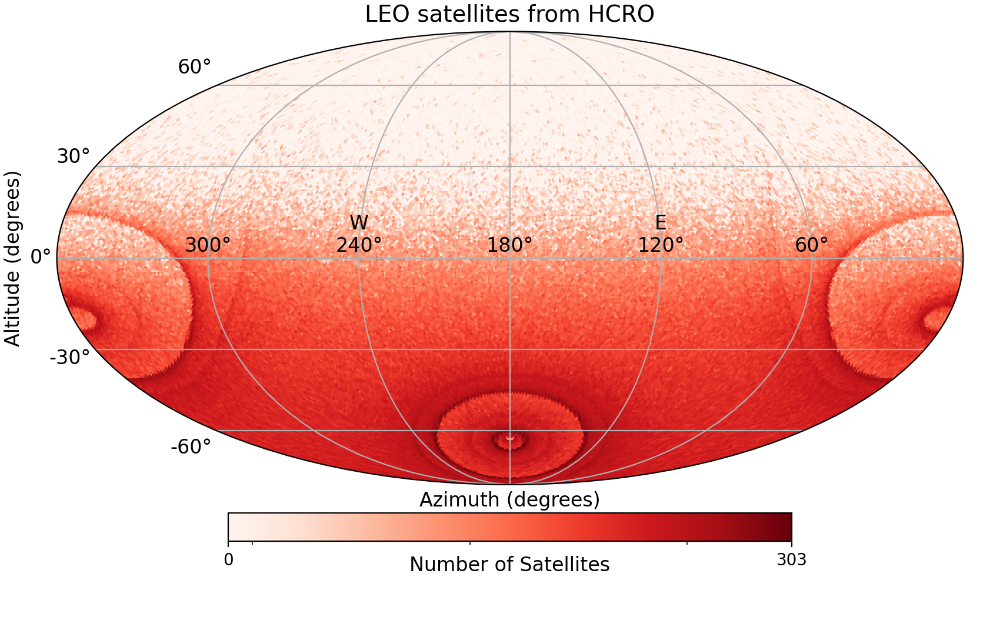

In [1191]:
projview(
    mleoa,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'LEO satellites from HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color = 'k',
    custom_ytick_labels = ['-60°', '-30°', '0°', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('MEO_m.png')

<IPython.core.display.Javascript object>


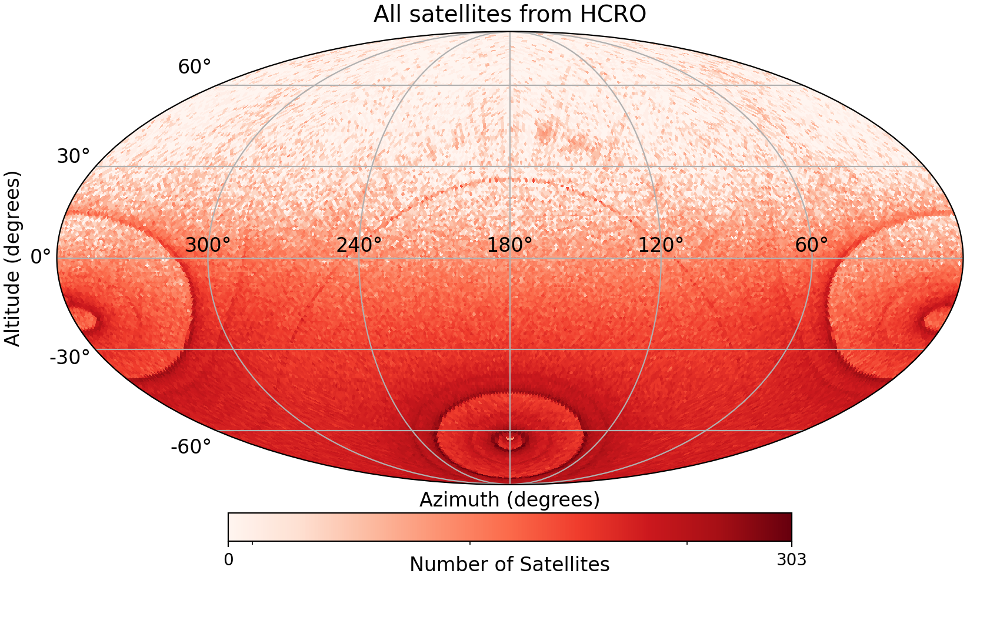

In [1192]:
projview(
    np.array(ma),
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit = 'Number of Satellites',
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'All satellites from HCRO',
    phi_convention = 'clockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
    xtick_label_color = 'k',
    custom_ytick_labels = ['-60°', '-30°', '0°', '30°', '60°'],
    norm = 'symlog'
);
#plt.savefig('MEO_m.png')

HA/Dec plot for geo satellites

In [827]:
ra = []
dec = []
for i in range(len(GEO)):
    for j in range(len(t)):
        ra.append(difference[GEO[i]].at(t[j]).radec()[0]._degrees)
        dec.append(difference[GEO[i]].at(t[j]).radec()[1].degrees + 90)

In [828]:
ra = np.reshape(ra, (len(GEO), len(t)))
dec = np.reshape(dec, (len(GEO), len(t)))

In [829]:
%%time
qtr5 = []
atr5 = []
for i in range(len(dec)):
    #print(i)
    for j in range(len(t)):
        for h in range(0, 36):
            if (h*5) <= dec[i][j] < ((h+1)*5):
                for k in range(0, 72):
                    if (k*5) <= ra[i][j] < ((k+1)*5):
                        qtr5.append((h*72) + k + 1)
                        atr5.append((h*72) + k + 1)

CPU times: user 1.61 s, sys: 27 ms, total: 1.63 s
Wall time: 1.64 s


In [830]:
qtr5 = np.reshape(qtr5, (len(GEO), len(t)))
atr5 = np.reshape(atr5, (len(GEO), len(t)))

In [831]:
for i in range(len(atr5)):
    for j in range(len(atr5[0])-1):
        if atr5[i][j] == atr5[i][j+1]:
            qtr5[i][j+1] = 0

In [832]:
qtr5 = np.reshape(qtr5, (len(GEO) * len(t)))
atr5 = np.reshape(atr5, (len(GEO) * len(t)))

In [833]:
%%time
s5qr = []
s5ar = []
for i in range(len(qtr5)):
    s5qr.append(f's{qtr5[i]}')
for i in range(len(atr5)):
    s5ar.append(f's{atr5[i]}')


CPU times: user 32.2 ms, sys: 2.37 ms, total: 34.6 ms
Wall time: 34.4 ms


In [834]:
%%time
#takes about 3s
#which section the satellite is in
sections_5qr = []
sections_5ar = []
for i in range(1, 2593):
    if s5qr.count(f's{i}') == 0:
        sections_5qr.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5qr.count(f's{i}') != 0:
        sections_5qr.append(s5qr.count(f's{i}'))
        
for i in range(1, 2593):
    if s5ar.count(f's{i}') == 0:
        sections_5ar.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5ar.count(f's{i}') != 0:
        sections_5ar.append(s5ar.count(f's{i}'))

CPU times: user 8.34 s, sys: 170 ms, total: 8.51 s
Wall time: 8.51 s


In [835]:
%%time
alt_range5fr = []
az_range5fr = []

for i in range(0,36):
    alt_range5fr.append(f'{(i*5)-90} - {((i+1)*5)-90}')
for i in range(0, 72):
    az_range5fr.append(f'{i*5} - {(i + 1)*5}')

CPU times: user 24 µs, sys: 0 ns, total: 24 µs
Wall time: 27.9 µs


In [836]:
az_range5fr_label = []
alt_range5fr_label = []
azs5r = []
alts5r = []
for i in range(int(len(az_range5fr)/2)):
    azs5r.append((i*2)+1)
    az_range5fr_label.append(az_range5f[azs5r[-1]])
    
for i in range(int(len(alt_range5fr)/2)):
    alts5r.append((i*2)+1)
    alt_range5fr_label.append(alt_range5fr[alts5r[-1]])

In [837]:
sections5ar = np.reshape(sections_5ar, (36, 72))
sections5qr = np.reshape(sections_5qr, (36, 72))
#making it to where it's a 2d array to plot on the heatmap

<IPython.core.display.Javascript object>


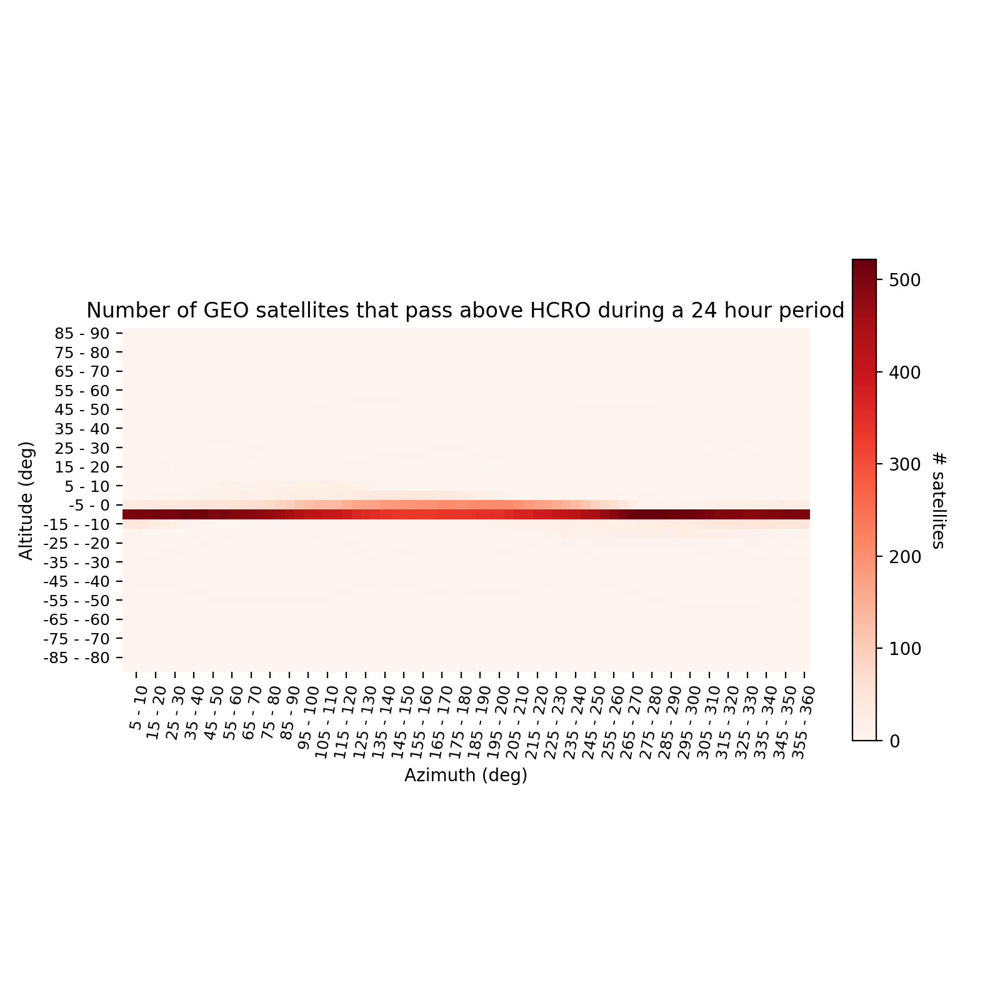

In [838]:
#with correcting for geo
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5qr), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of GEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


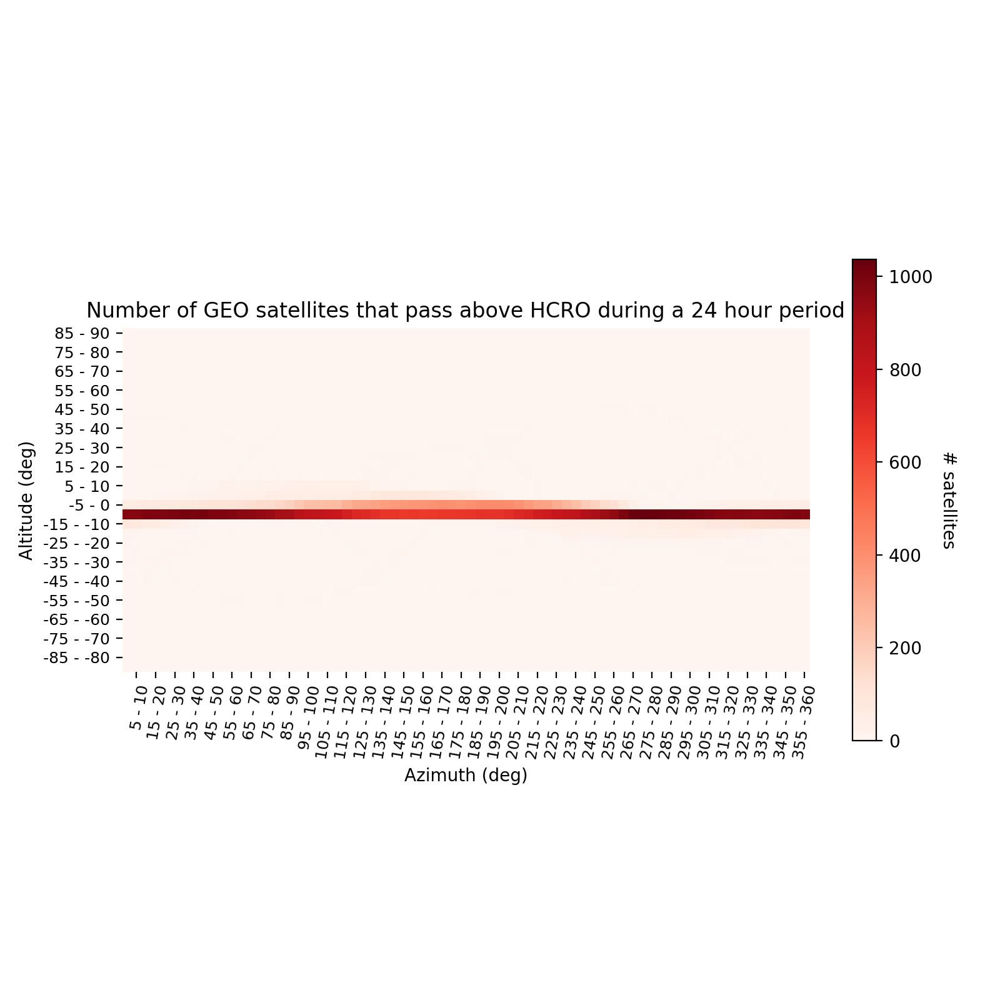

In [839]:
#Without correcting for geo
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5ar), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of GEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

In [841]:
lha = []
dec = []
for i in range(len(GEO)):
    for j in range(len(t)):
        lha.append(ata.lst_hours_at(t[j])- difference[GEO[i]].at(t[j]).radec()[0].hours)
        dec.append(difference[GEO[i]].at(t[j]).radec()[1].degrees + 90)

In [842]:
for i in range(len(lha)):
    if lha[i] < 0:
        lha[i] = lha[i] + 24

In [843]:
lha = np.reshape(lha, (len(GEO), len(t)))
dec = np.reshape(dec, (len(GEO), len(t)))

In [844]:
%%time
qtrl5 = []
atrl5 = []
for i in range(len(dec)):
    #print(i)
    for j in range(len(t)):
        for h in range(0, 36):
            if (h*5) <= dec[i][j] < ((h+1)*5):
                for k in range(0, 72):
                    if ((k*5)/15) <= lha[i][j] < (((k+1)*5)/15):
                        qtrl5.append((h*72) + k + 1)
                        atrl5.append((h*72) + k + 1)

CPU times: user 1.97 s, sys: 29.1 ms, total: 2 s
Wall time: 2 s


In [845]:
qtrl5 = np.reshape(qtrl5, (len(GEO), len(t)))
atrl5 = np.reshape(atrl5, (len(GEO), len(t)))

In [846]:
for i in range(len(atrl5)):
    for j in range(len(atrl5[0])-1):
        if atrl5[i][j] == atrl5[i][j+1]:
            qtrl5[i][j+1] = 0

In [847]:
qtrl5 = np.reshape(qtrl5, (len(GEO) * len(t)))
atrl5 = np.reshape(atrl5, (len(GEO) * len(t)))

In [848]:
%%time
s5qrl = []
s5arl = []
for i in range(len(qtrl5)):
    s5qrl.append(f's{qtrl5[i]}')
for i in range(len(atrl5)):
    s5arl.append(f's{atrl5[i]}')


CPU times: user 33.4 ms, sys: 2.96 ms, total: 36.3 ms
Wall time: 35.6 ms


In [849]:
%%time
#takes about 7s
#which section the satellite is in
sections_5qrl = []
sections_5arl = []
for i in range(1, 2593):
    if s5qrl.count(f's{i}') == 0:
        sections_5qrl.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5qrl.count(f's{i}') != 0:
        sections_5qrl.append(s5qrl.count(f's{i}'))
        
for i in range(1, 2593):
    if s5arl.count(f's{i}') == 0:
        sections_5arl.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5arl.count(f's{i}') != 0:
        sections_5arl.append(s5arl.count(f's{i}'))

CPU times: user 8.29 s, sys: 114 ms, total: 8.41 s
Wall time: 8.42 s


In [850]:
sections5arl = np.reshape(sections_5arl, (36, 72))
sections5qrl = np.reshape(sections_5qrl, (36, 72))

In [889]:
%%time
alt_range5fr = []
az_range5fr = []

for i in range(0,36):
    alt_range5fr.append(f'{(i*5)-90} - {((i+1)*5)-90}')
for i in range(0, 72):
    az_range5fr.append(f'{(i*5)/15} - {((i + 1)*5)/15}')

CPU times: user 225 µs, sys: 144 µs, total: 369 µs
Wall time: 390 µs


In [933]:
az_range5fr_label = []
alt_range5fr_label = []
azs5r = []
alts5r = []
for i in range(int(len(az_range5fr)/6)):
    azs5r.append(((i*6)+5))
    az_range5fr_label.append(az_range5fr[azs5r[-1]][-4:])
    
for i in range(int(len(alt_range5fr)/2)):
    alts5r.append((i*2)+1)
    alt_range5fr_label.append(alt_range5fr[alts5r[-1]])

<IPython.core.display.Javascript object>


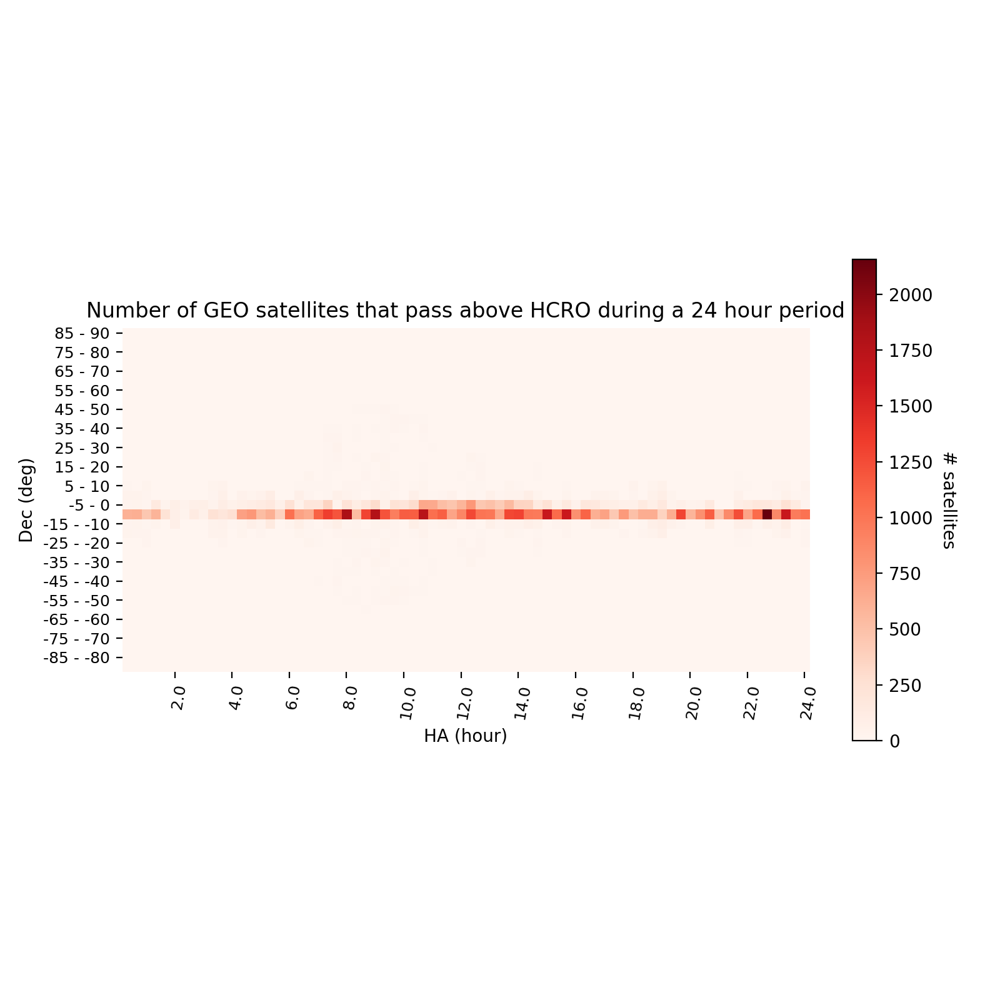

In [934]:
#Without correcting for geo
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5arl), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of GEO satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('HA (hour)')
plt.ylabel('Dec (deg)')
#plt.yticks([2, 5, 8, 11, 14, 17, 20, 23, 26, 29, 32, 35], 
 #          ['2', '4', '6', '8', '10', '12', '14', '16', '18', '20', '22', '24'])
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


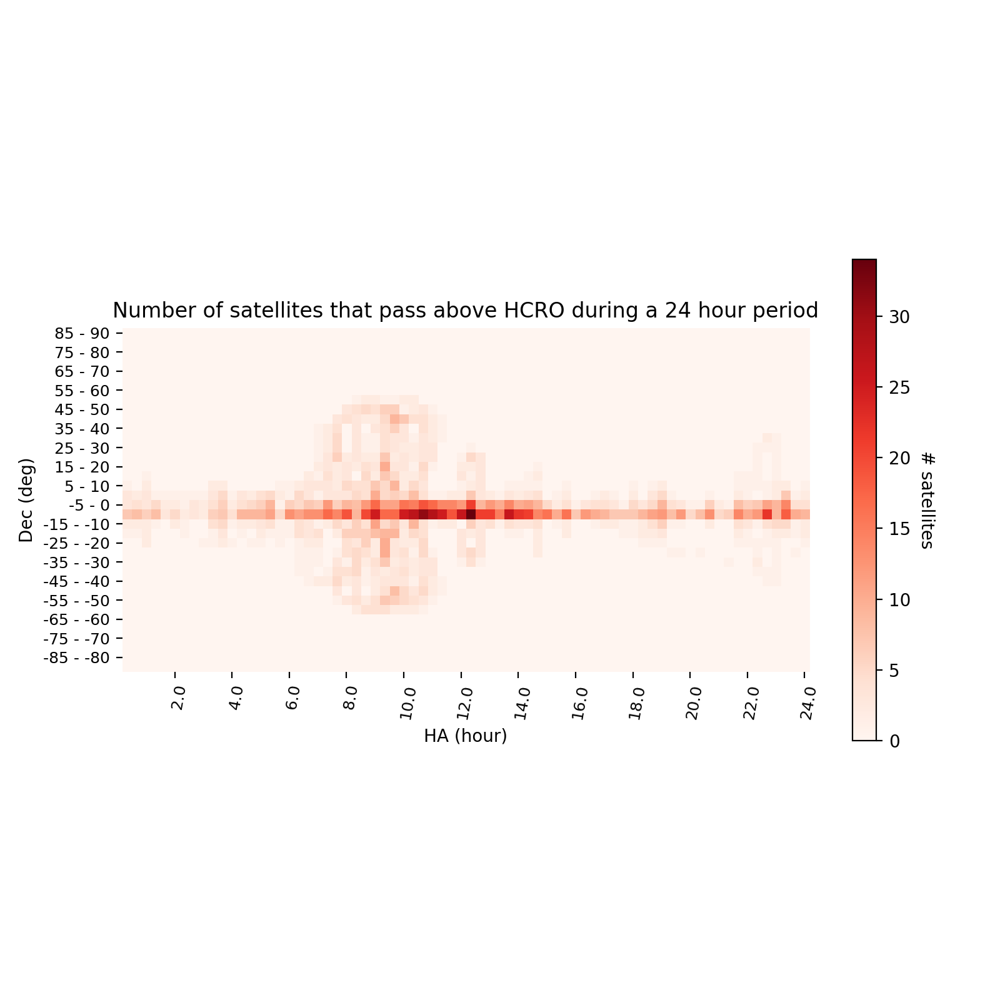

In [935]:
#Without correcting for geo
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5qrl), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('HA (hour)')
plt.ylabel('Dec (deg)')
fig.tight_layout()
#plt.yticks(ticks = [alts5r[2], alts5r[5], alts5r[8], alts5r[11], alts5r[14], alts5r[17],
 #                   alts5r[20], alts5r[23], alts5r[26], alts5r[29], alts5r[32], alts5r[35]], 
  #         labels = ['2', '4', '6', '8', '10', '12', '14', '16', '18', '20', '22', '24'])
plt.show()
#plt.savefig('5deg.jpeg')

HA and Dec for LEO satellites

In [936]:
difference = []
for i in range(len(active)):
    difference.append(active[i] - ata)

In [937]:
%%time
ra = []
dec = []
na = []
for i in range(len(LEO)):
    for j in range(len(t)):
        #if np.isnan(difference[LEO[i]].at(t[j]).radec()[1].degrees) == False:   
        ra.append(difference[LEO[i]].at(t[j]).radec()[0]._degrees)
        dec.append(difference[LEO[i]].at(t[j]).radec()[1].degrees + 90)

CPU times: user 1min 7s, sys: 6.82 s, total: 1min 14s
Wall time: 1min 11s


In [938]:
ra = np.reshape(ra, (len(LEO), len(t)))
dec = np.reshape(dec, (len(LEO), len(t)))

In [939]:
for i in range(len(ra)):
    for j in range(len(t)):
        if np.isnan(ra[i][j]) == True:
            ra[i][j] = 0.0
            #print(ra[i][j])
            dec[i][j] = 0.0

In [940]:
%%time
qtr5 = []
atr5 = []
for i in range(len(dec)):
    #print(i) 
    for j in range(len(t)):
        if dec[i][j] != 0.0:
            for h in range(0, 36): 
                if (h*5) <= dec[i][j] < ((h+1)*5):
                    for k in range(0, 72):
                        if (k*5) <= ra[i][j] < ((k+1)*5):
                            qtr5.append((h*72) + k + 1)
                            atr5.append((h*72) + k + 1)
        elif dec[i][j] == 0.0:
            qtr5.append(0)
            atr5.append(0)

CPU times: user 21.2 s, sys: 462 ms, total: 21.6 s
Wall time: 21.7 s


In [941]:
qtr5 = np.reshape(qtr5, (len(LEO), len(t)))
atr5 = np.reshape(atr5, (len(LEO), len(t)))

In [942]:
for i in range(len(atr5)):
    for j in range(len(atr5[0])-1):
        if atr5[i][j] == atr5[i][j+1]:
            qtr5[i][j+1] = 0

In [943]:
qtr5 = np.reshape(qtr5, (len(LEO) * len(t)))
atr5 = np.reshape(atr5, (len(LEO) * len(t)))

In [944]:
%%time
s5qr = []
s5ar = []
for i in range(len(qtr5)):
    s5qr.append(f's{qtr5[i]}')
for i in range(len(atr5)):
    s5ar.append(f's{atr5[i]}')


CPU times: user 461 ms, sys: 20.7 ms, total: 481 ms
Wall time: 497 ms


In [945]:
%%time
#takes about 2 min
#which section the satellite is in
sections_5qr = []
sections_5ar = []
for i in range(1, 2593):
    if s5qr.count(f's{i}') == 0:
        sections_5qr.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5qr.count(f's{i}') != 0:
        sections_5qr.append(s5qr.count(f's{i}'))
        
for i in range(1, 2593):
    if s5ar.count(f's{i}') == 0:
        sections_5ar.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5ar.count(f's{i}') != 0:
        sections_5ar.append(s5ar.count(f's{i}'))

CPU times: user 2min 33s, sys: 3.68 s, total: 2min 36s
Wall time: 2min 38s


In [946]:
%%time
alt_range5fr = []
az_range5fr = []

for i in range(0,36):
    alt_range5fr.append(f'{(i*5)-90} - {((i+1)*5)-90}')
for i in range(0, 72):
    az_range5fr.append(f'{(i*5)/15} - {((i + 1)*5)/15}')

CPU times: user 220 µs, sys: 15 µs, total: 235 µs
Wall time: 241 µs


In [947]:
az_range5fr_label = []
alt_range5fr_label = []
azs5r = []
alts5r = []
for i in range(int(len(az_range5fr)/6)):
    azs5r.append(((i*6)+5))
    az_range5fr_label.append(az_range5fr[azs5r[-1]][-4:])
    
for i in range(int(len(alt_range5fr)/2)):
    alts5r.append((i*2)+1)
    alt_range5fr_label.append(alt_range5fr[alts5r[-1]])

In [948]:
sections5ar = np.reshape(sections_5ar, (36, 72))
sections5qr = np.reshape(sections_5qr, (36, 72))
#making it to where it's a 2d array to plot on the heatmap

<IPython.core.display.Javascript object>


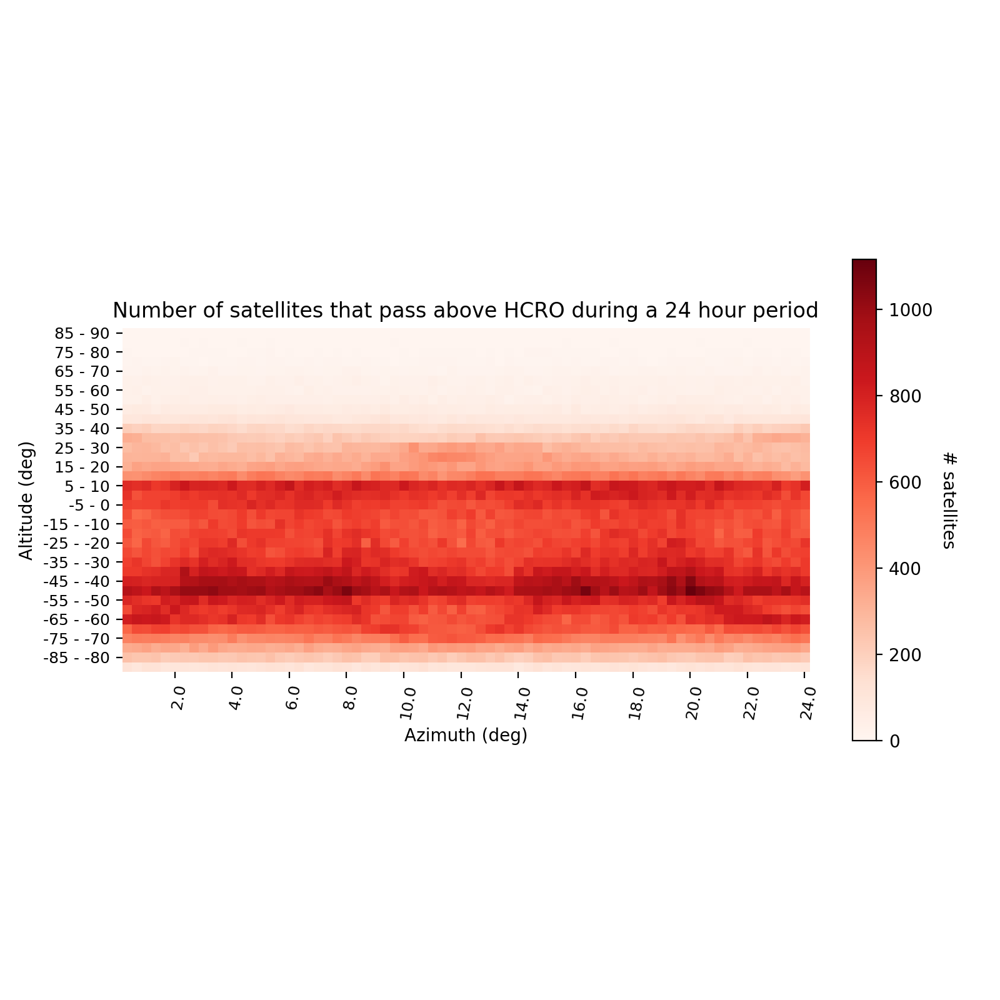

In [949]:
#with correcting for geo
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5qr), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


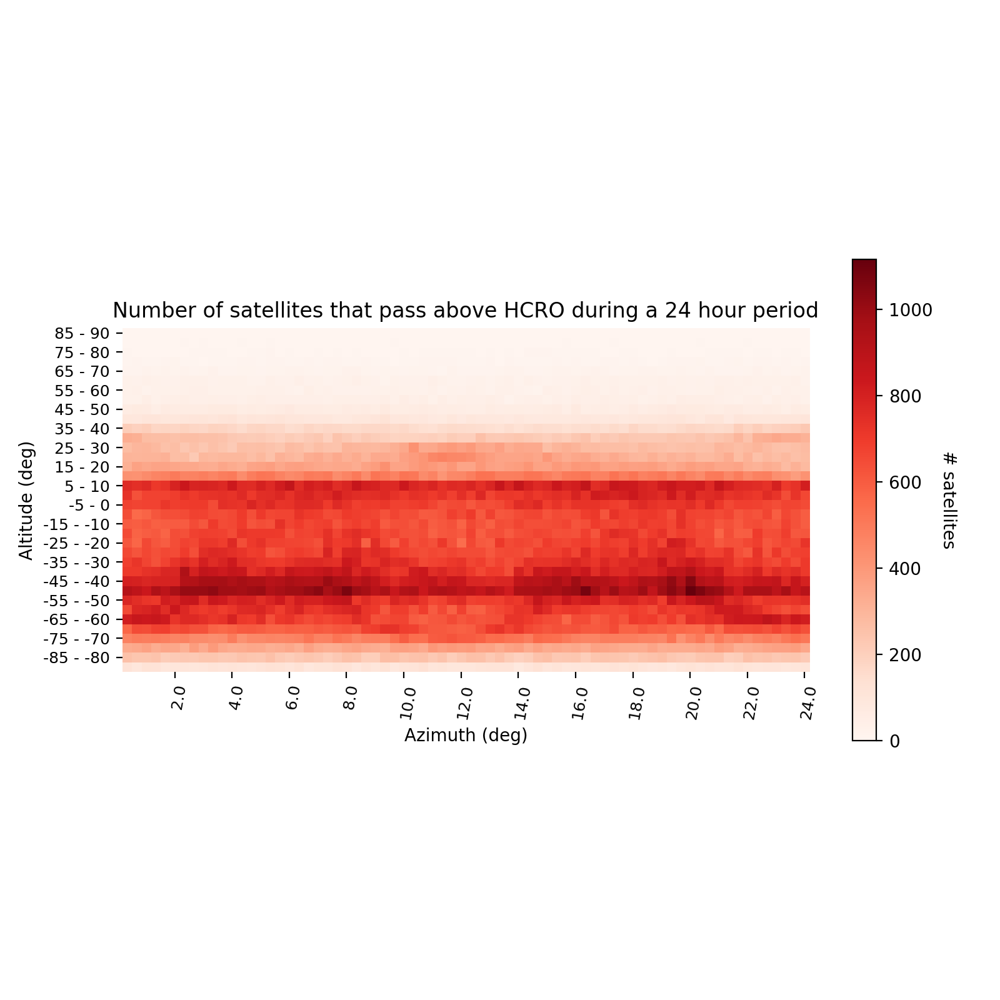

In [950]:
#Without correcting for geo
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5ar), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('Azimuth (deg)')
plt.ylabel('Altitude (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

In [228]:
lha = []
dec = []
for i in range(len(LEO)):
    for j in range(len(t)):
        lha.append(ata.lst_hours_at(t[j])- difference[LEO[i]].at(t[j]).radec()[0].hours)
        dec.append(difference[LEO[i]].at(t[j]).radec()[1].degrees + 90)

In [229]:
for i in range(len(lha)):
    if lha[i] < 0:
        lha[i] = lha[i] + 24

In [230]:
lha = np.reshape(lha, (len(LEO), len(t)))
dec = np.reshape(dec, (len(LEO), len(t)))

In [231]:
for i in range(len(lha)):
    for j in range(len(t)):
        if np.isnan(lha[i][j]) == True:
            lha[i][j] = 0.0
            dec[i][j] = 0.0

In [232]:
%%time
#takes about 22s
qtrl5 = []
atrl5 = []
for i in range(len(dec)):
    #print(i)
    for j in range(len(t)):
        if dec[i][j] != 0.0:
            for h in range(0, 36):
                if (h*5) <= dec[i][j] < ((h+1)*5):
                    for k in range(0, 72):
                        if ((k*5)/15) <= lha[i][j] < (((k+1)*5)/15):
                            qtrl5.append((h*72) + k + 1)
                            atrl5.append((h*72) + k + 1)
        elif dec[i][j] == 0.0:
            qtrl5.append(0)
            atrl5.append(0)

CPU times: user 22.1 s, sys: 336 ms, total: 22.5 s
Wall time: 22.5 s


In [1195]:
tl3[0].utc

CalendarTuple(year=2023, month=8, day=9, hour=0, minute=0, second=0.0)

In [233]:
qtrl5 = np.reshape(qtrl5, (len(LEO), len(t)))
atrl5 = np.reshape(atrl5, (len(LEO), len(t)))

In [234]:
for i in range(len(atrl5)):
    for j in range(len(atrl5[0])-1):
        if atrl5[i][j] == atrl5[i][j+1]:
            qtrl5[i][j+1] = 0

In [235]:
qtrl5 = np.reshape(qtrl5, (len(LEO) * len(t)))
atrl5 = np.reshape(atrl5, (len(LEO) * len(t)))

In [236]:
%%time
s5qrl = []
s5arl = []
for i in range(len(qtrl5)):
    s5qrl.append(f's{qtrl5[i]}')
for i in range(len(atrl5)):
    s5arl.append(f's{atrl5[i]}')


CPU times: user 480 ms, sys: 34.2 ms, total: 514 ms
Wall time: 523 ms


In [237]:
%%time
#takes about 3 min
#which section the satellite is in
sections_5qrl = []
sections_5arl = []
for i in range(1, 2593):
    if s5qrl.count(f's{i}') == 0:
        sections_5qrl.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5qrl.count(f's{i}') != 0:
        sections_5qrl.append(s5qrl.count(f's{i}'))
        
for i in range(1, 2593):
    if s5arl.count(f's{i}') == 0:
        sections_5arl.append(0)
        #print(i) #You can uncomment out the print function if you want to keep track of how it's running
    if s5arl.count(f's{i}') != 0:
        sections_5arl.append(s5arl.count(f's{i}'))

CPU times: user 2min 32s, sys: 2.86 s, total: 2min 35s
Wall time: 2min 35s


In [238]:
sections5arl = np.reshape(sections_5arl, (36, 72))
sections5qrl = np.reshape(sections_5qrl, (36, 72))

In [239]:
%%time
alt_range5fr = []
az_range5fr = []

for i in range(0,36):
    alt_range5fr.append(f'{(i*5)-90} - {((i+1)*5)-90}')
for i in range(0, 72):
    az_range5fr.append(f'{(i*5)/15} - {((i+1)*5)/15}')
    #if ((i*5)/15) == 0 or ((i*5)/15) == 6 or ((i*5)/15) == 12 or ((i*5)/15) == 18 or ((i*5)/15) == 24:
        #az_range5fr.append(f'{(i*5)/15}')

CPU times: user 160 µs, sys: 13 µs, total: 173 µs
Wall time: 186 µs


In [240]:
az_range5fr_label = []
alt_range5fr_label = []
azs5r = []
alts5r = []
for i in range(int(len(az_range5fr))):
    if ((i*5)/15) == 0 or ((i*5)/15) == 6 or ((i*5)/15) == 12 or ((i*5)/15) == 18 or ((i*5)/15) == 24:
        azs5r.append(i)
        az_range5fr_label.append(str(int((i*5)/15)))
   # azs5r.append((i*2)+1)
    #az_range5fr_label.append(az_range5fr[azs5r[-1]])
    
for i in range(int(len(alt_range5fr)/2)):
    alts5r.append((i*2)+1)
    alt_range5fr_label.append(alt_range5fr[alts5r[-1]])

<IPython.core.display.Javascript object>


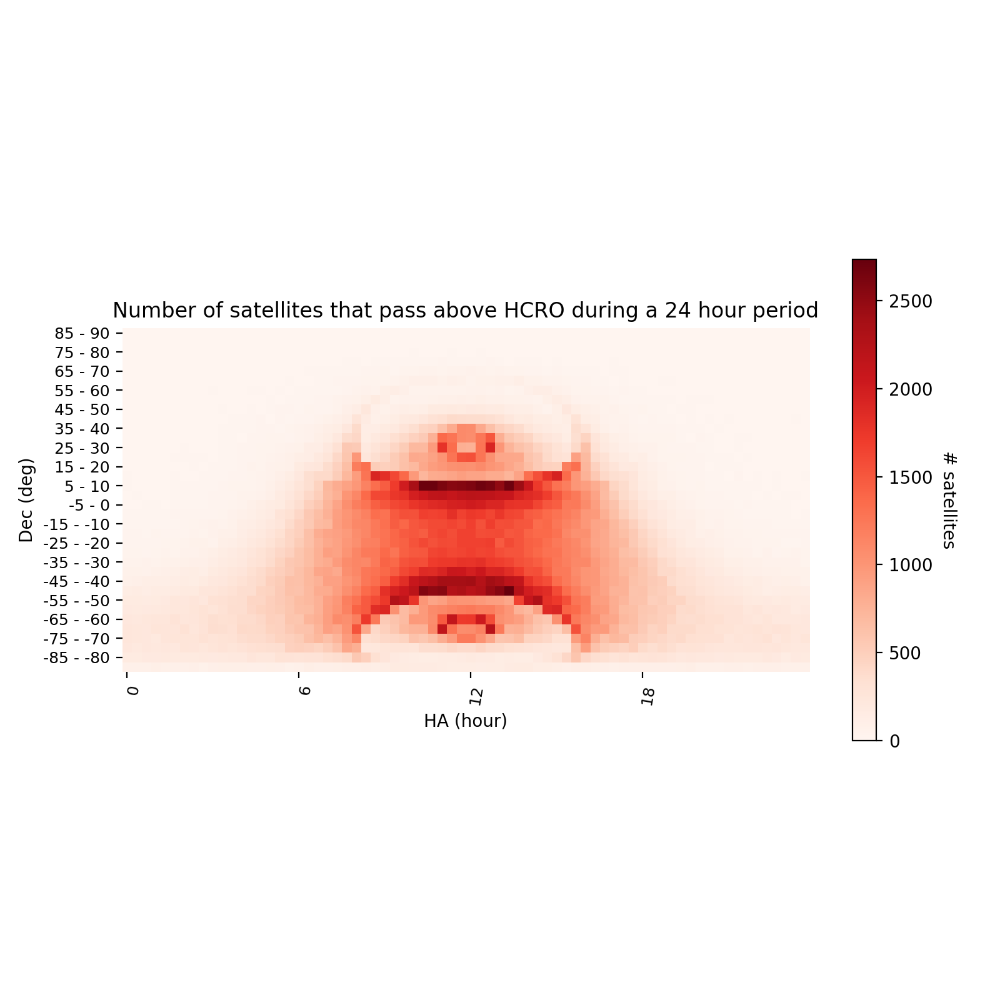

In [241]:
#Without correcting for repeats
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5arl), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('HA (hour)')
plt.ylabel('Dec (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

<IPython.core.display.Javascript object>


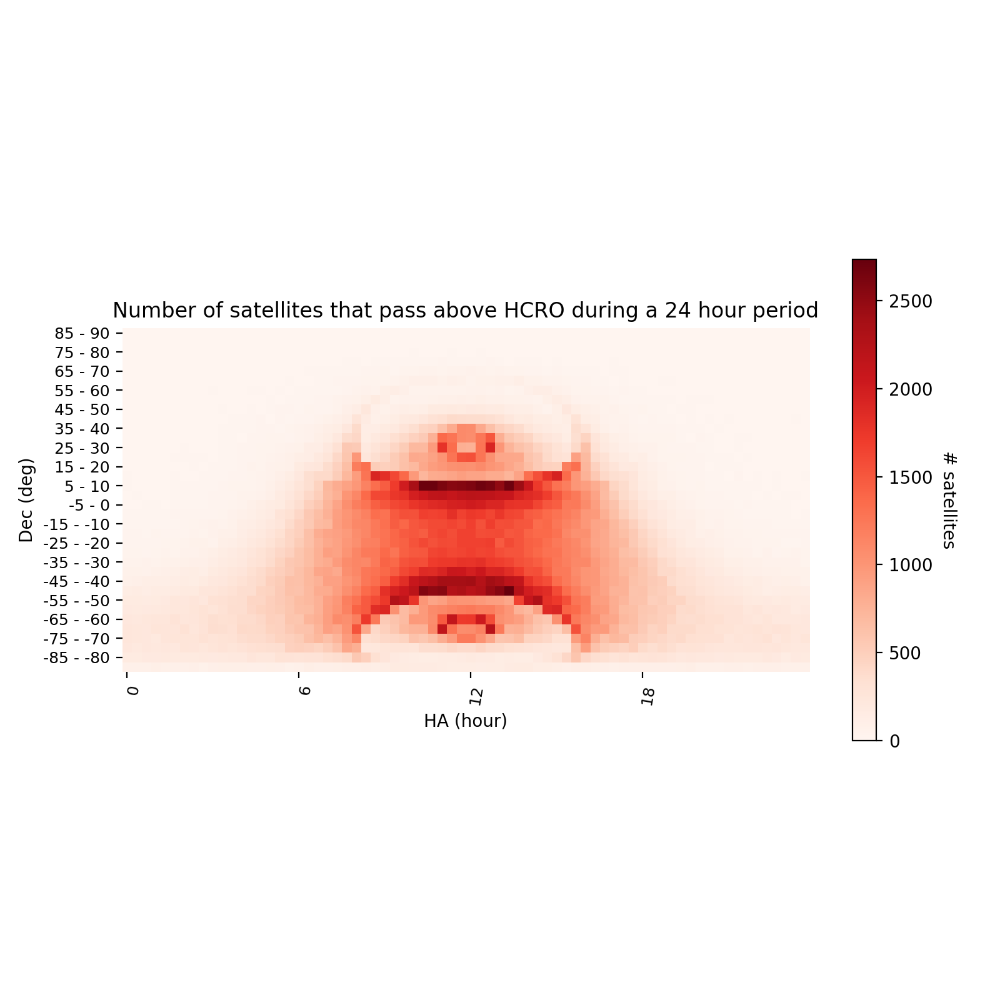

In [242]:
#With correcting for repeats
fig, ax = plt.subplots(figsize = (8, 8))

im, cbar = heatmap(np.array(sections5qrl), alt_range5fr, az_range5fr, ax=ax,
                   cmap="Reds", cbarlabel="# satellites")
#texts = annotate_heatmap(im, valfmt="{x:.0f}")
#uncomment out the line above if you want the text on the grids (sometimes hard to see)
plt.title('Number of satellites that pass above HCRO during a 24 hour period')
plt.xticks(ticks = azs5r, labels=az_range5fr_label)
plt.yticks(ticks = alts5r, labels = alt_range5fr_label)
plt.xlabel('HA (hour)')
plt.ylabel('Dec (deg)')
fig.tight_layout()
plt.show()
#plt.savefig('5deg.jpeg')

#### Major Constellations

First, all LEO satellites at one point in time

In [256]:
alt_LEOa = np.reshape(alt_LEOa, (len(LEO), 144))
az_LEOa = np.reshape(az_LEOa, (len(LEO), 144))

In [257]:
altl0 = []
azl0 = []
for i in range(len(alt_LEOa)):
    altl0.append(alt_LEOa[i][0])
    azl0.append(az_LEOa[i][0])

In [258]:
thetalt0 = [np.radians(altl0)]
philt0 = [np.radians(azl0)]

In [259]:
nside = 2**6

In [260]:
(hp.nside2resol(nside) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 0.91612971 deg>

In [261]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(philt0[0])):
    if (philt0[0][i] + np.pi) >= (2*np.pi):
        philt0[0][i] = philt0[0][i] - np.pi
    elif (philt0[0][i] + np.pi) < (2*np.pi):
        philt0[0][i] = philt0[0][i] + np.pi

In [262]:
pixel_indiceslt0 = hp.ang2pix(nside, thetalt0[0], philt0[0])

In [263]:
phlt0 = hp.ang2pix(nside, thetalt0[0], philt0[0])

In [264]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indiceslt0)-1):
    if phlt0[i] == phlt0[i+1]:
        pixel_indiceslt0[i+1] = 0

In [265]:
mlt0 = np.zeros(hp.nside2npix(nside))


In [266]:
%%time
#takes about 30s
for i in range(1, len(mlt0)):
    for j in range(len(pixel_indiceslt0)):
        if i == pixel_indiceslt0[j]:
            mlt0[i] += 1

CPU times: user 31.3 s, sys: 463 ms, total: 31.8 s
Wall time: 32.1 s


<IPython.core.display.Javascript object>


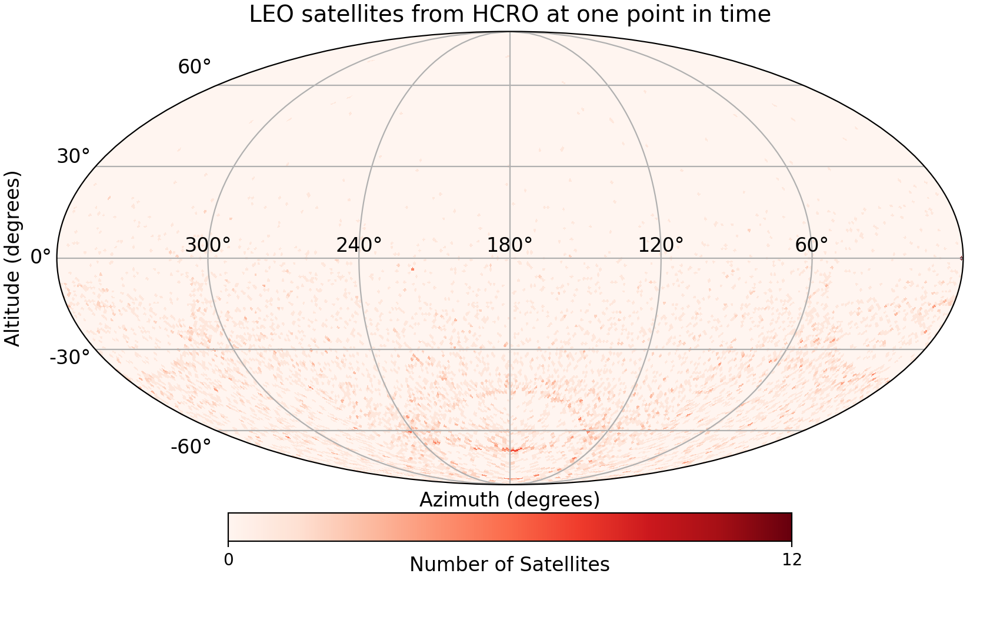

In [1177]:
projview(
    mlt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'LEO satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Starlink satellites

In [243]:
alt_s = np.reshape(alt_s, (starlink, len(tl3)))
az_s = np.reshape(az_s, (starlink, len(tl3)))

In [244]:
altst0 = []
azst0 = []
for i in range(len(alt_s)):
    altst0.append(alt_s[i][0])
    azst0.append(az_s[i][0])

In [245]:
data_a = [np.arange(len(alt_HEOa)),np.arange(len(alt_GEOa)), np.arange(len(alt_MEOa)), np.arange(len(alt_LEOa))]
theta_a = [np.radians(alt_HEOa), np.radians(alt_GEOa), np.radians(alt_MEOa), np.radians(alt_LEOa)]
phi_a = [np.radians(az_HEOa), np.radians(az_GEOa), np.radians(az_MEOa), np.radians(az_LEOa)]


In [246]:
thetast0 = [np.radians(altst0)]
phist0 = [np.radians(azst0)]

In [247]:
nside = 2**6

In [248]:
(hp.nside2resol(nside) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 0.91612971 deg>

In [249]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phist0[0])):
    if (phist0[0][i] + np.pi) >= (2*np.pi):
        phist0[0][i] = phist0[0][i] - np.pi
    elif (phist0[0][i] + np.pi) < (2*np.pi):
        phist0[0][i] = phist0[0][i] + np.pi

In [250]:
pixel_indices_st0 = hp.ang2pix(nside, thetast0[0], phist0[0])

In [251]:
phst0 = hp.ang2pix(nside, thetast0[0], phist0[0])

In [252]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indices_st0)-1):
    if phst0[i] == phst0[i+1]:
        pixel_indices_st0[i+1] = 0

In [253]:
mst0 = np.zeros(hp.nside2npix(nside))


In [254]:
%%time
#takes about 20s
for i in range(1, len(mst0)):
    for j in range(len(pixel_indices_st0)):
        if i == pixel_indices_st0[j]:
            mst0[i] += 1

CPU times: user 19.4 s, sys: 262 ms, total: 19.7 s
Wall time: 19.9 s


<IPython.core.display.Javascript object>


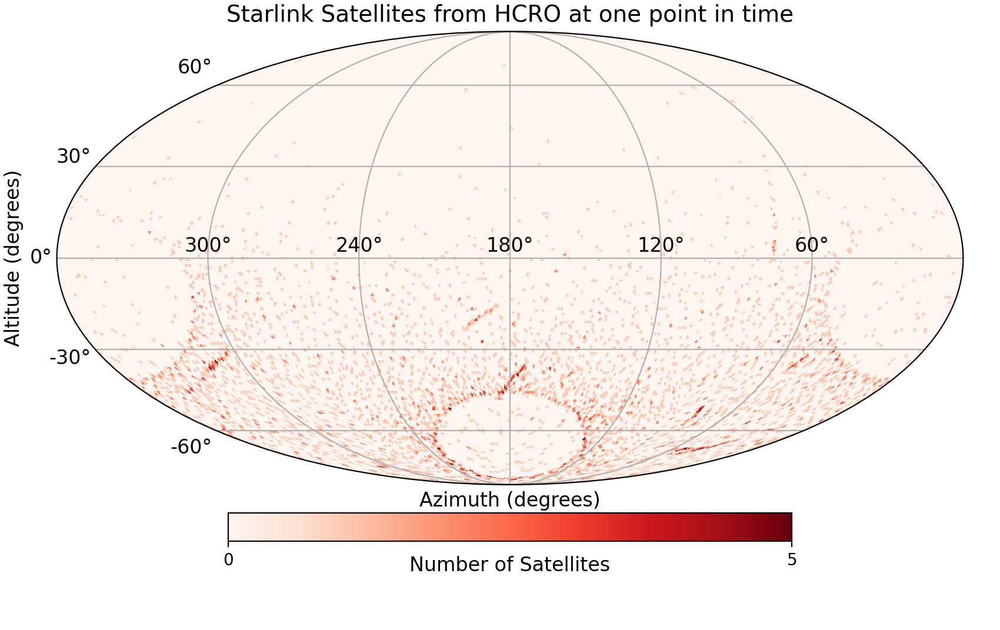

In [1193]:
plt.close()
projview(
    mst0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Starlink Satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Globalstar Satellites

In [269]:
top = np.reshape(topocentric, (len(active), len(t)))

In [270]:
alt_gl = []
az_gl = []
for i in range(len(active)):
    if active[i].name[:10] == 'GLOBALSTAR':
        alt_gl.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_gl.append(top[i][0].altaz()[1].degrees)

In [271]:
thetaglt0 = [np.radians(alt_gl)]
phiglt0 = [np.radians(az_gl)]

In [272]:
nside = 2**6

In [273]:
(hp.nside2resol(nside) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 0.91612971 deg>

In [274]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiglt0[0])):
    if (phiglt0[0][i] + np.pi) >= (2*np.pi):
        phiglt0[0][i] = phiglt0[0][i] - np.pi
    elif (phiglt0[0][i] + np.pi) < (2*np.pi):
        phiglt0[0][i] = phiglt0[0][i] + np.pi

In [275]:
pixel_indicesglt0 = hp.ang2pix(nside, thetaglt0[0], phiglt0[0])

In [276]:
phglt0 = hp.ang2pix(nside, thetaglt0[0], phiglt0[0])

In [277]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesglt0)-1):
    if phglt0[i] == phglt0[i+1]:
        pixel_indicesglt0[i+1] = 0

In [278]:
mglt0 = np.zeros(hp.nside2npix(nside))


In [279]:
%%time
#takes about 20s
for i in range(1, len(mglt0)):
    for j in range(len(pixel_indicesglt0)):
        if i == pixel_indicesglt0[j]:
            mglt0[i] += 1

CPU times: user 155 ms, sys: 4.12 ms, total: 159 ms
Wall time: 158 ms


<IPython.core.display.Javascript object>


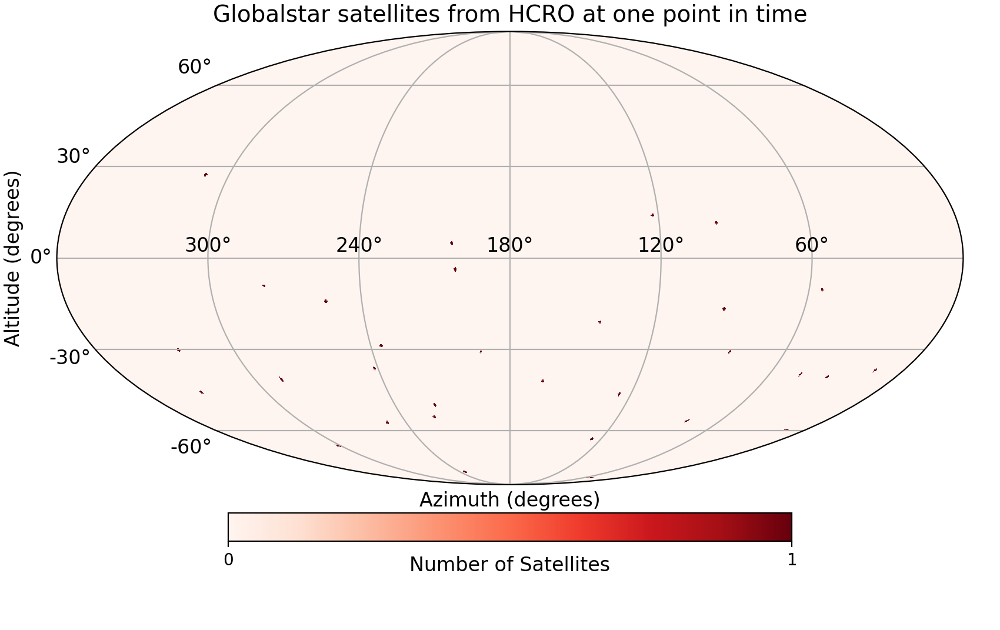

In [1178]:
plt.close()
projview(
    mglt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Globalstar satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Iridium Satellites

In [284]:
alt_ir = []
az_ir = []
for i in range(len(active)):
    if active[i].name[:7] == 'IRIDIUM':
        alt_ir.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_ir.append(top[i][0].altaz()[1].degrees)

In [285]:
thetairt0 = [np.radians(alt_ir)]
phiirt0 = [np.radians(az_ir)]

In [286]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiirt0[0])):
    if (phiirt0[0][i] + np.pi) >= (2*np.pi):
        phiirt0[0][i] = phiirt0[0][i] - np.pi
    elif (phiirt0[0][i] + np.pi) < (2*np.pi):
        phiirt0[0][i] = phiirt0[0][i] + np.pi

In [287]:
pixel_indicesirt0 = hp.ang2pix(nside, thetairt0[0], phiirt0[0])

In [288]:
phirt0 = hp.ang2pix(nside, thetairt0[0], phiirt0[0])

In [289]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesirt0)-1):
    if phirt0[i] == phirt0[i+1]:
        pixel_indicesirt0[i+1] = 0

In [290]:
mirt0 = np.zeros(hp.nside2npix(nside))


In [291]:
%%time
#takes about 20s
for i in range(1, len(mirt0)):
    for j in range(len(pixel_indicesirt0)):
        if i == pixel_indicesirt0[j]:
            mirt0[i] += 1

CPU times: user 345 ms, sys: 5.89 ms, total: 351 ms
Wall time: 350 ms


<IPython.core.display.Javascript object>


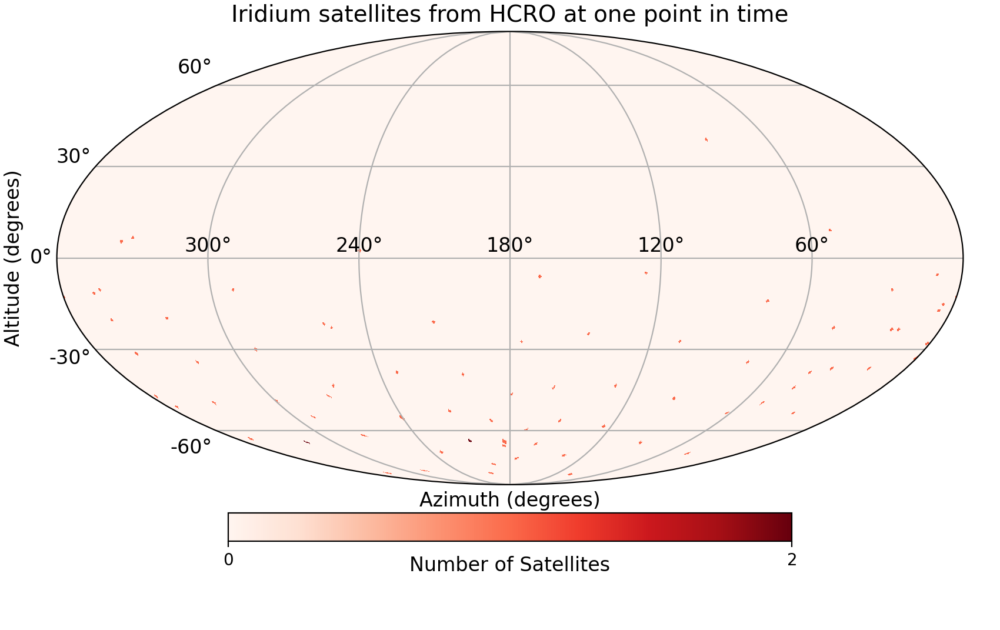

In [1179]:
plt.close()
projview(
    mirt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Iridium satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

O3b Satellites

In [293]:
alt_o3b = []
az_o3b = []
for i in range(len(active)):
    if active[i].name[:3] == 'O3B':
        alt_o3b.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_o3b.append(top[i][0].altaz()[1].degrees)

In [294]:
thetao3bt0 = [np.radians(alt_o3b)]
phio3bt0 = [np.radians(az_o3b)]

In [295]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phio3bt0[0])):
    if (phio3bt0[0][i] + np.pi) >= (2*np.pi):
        phio3bt0[0][i] = phio3bt0[0][i] - np.pi
    elif (phio3bt0[0][i] + np.pi) < (2*np.pi):
        phio3bt0[0][i] = phio3bt0[0][i] + np.pi

In [296]:
pixel_indiceso3bt0 = hp.ang2pix(nside, thetao3bt0[0], phio3bt0[0])

In [297]:
pho3bt0 = hp.ang2pix(nside, thetao3bt0[0], phio3bt0[0])

In [298]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indiceso3bt0)-1):
    if pho3bt0[i] == pho3bt0[i+1]:
        pixel_indiceso3bt0[i+1] = 0

In [299]:
mo3bt0 = np.zeros(hp.nside2npix(nside))


In [300]:
%%time
#takes about 20s
for i in range(1, len(mo3bt0)):
    for j in range(len(pixel_indiceso3bt0)):
        if i == pixel_indiceso3bt0[j]:
            mo3bt0[i] += 1

CPU times: user 124 ms, sys: 3.29 ms, total: 128 ms
Wall time: 126 ms


<IPython.core.display.Javascript object>


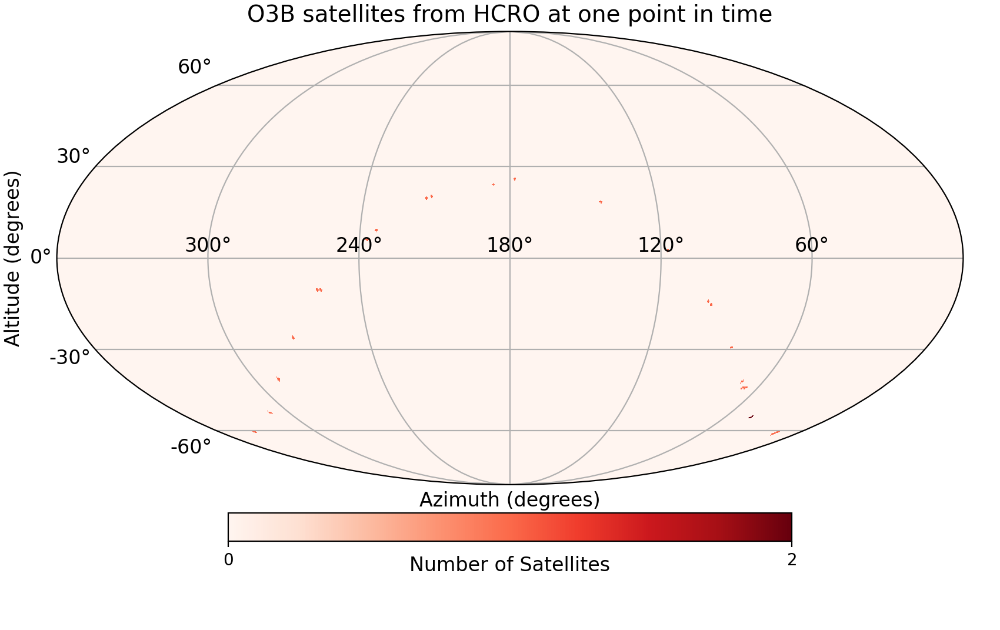

In [1180]:
plt.close()
plt.close()
projview(
    mo3bt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'O3B satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

ORBCOMM satellites

In [302]:
alt_orb = []
az_orb = []
for i in range(len(active)):
    if active[i].name[:7] == 'ORBCOMM':
        alt_orb.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_orb.append(top[i][0].altaz()[1].degrees)

In [303]:
thetaorbt0 = [np.radians(alt_orb)]
phiorbt0 = [np.radians(az_orb)]

In [304]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiorbt0[0])):
    if (phiorbt0[0][i] + np.pi) >= (2*np.pi):
        phiorbt0[0][i] = phiorbt0[0][i] - np.pi
    elif (phiorbt0[0][i] + np.pi) < (2*np.pi):
        phiorbt0[0][i] = phiorbt0[0][i] + np.pi

In [305]:
pixel_indicesorbt0 = hp.ang2pix(nside, thetaorbt0[0], phiorbt0[0])

In [306]:
phorbt0 = hp.ang2pix(nside, thetaorbt0[0], phiorbt0[0])

In [307]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesorbt0)-1):
    if phorbt0[i] == phorbt0[i+1]:
        pixel_indicesorbt0[i+1] = 0

In [308]:
morbt0 = np.zeros(hp.nside2npix(nside))


In [309]:
%%time
for i in range(1, len(morbt0)):
    for j in range(len(pixel_indicesorbt0)):
        if i == pixel_indicesorbt0[j]:
            morbt0[i] += 1

CPU times: user 114 ms, sys: 4.05 ms, total: 118 ms
Wall time: 117 ms


<IPython.core.display.Javascript object>


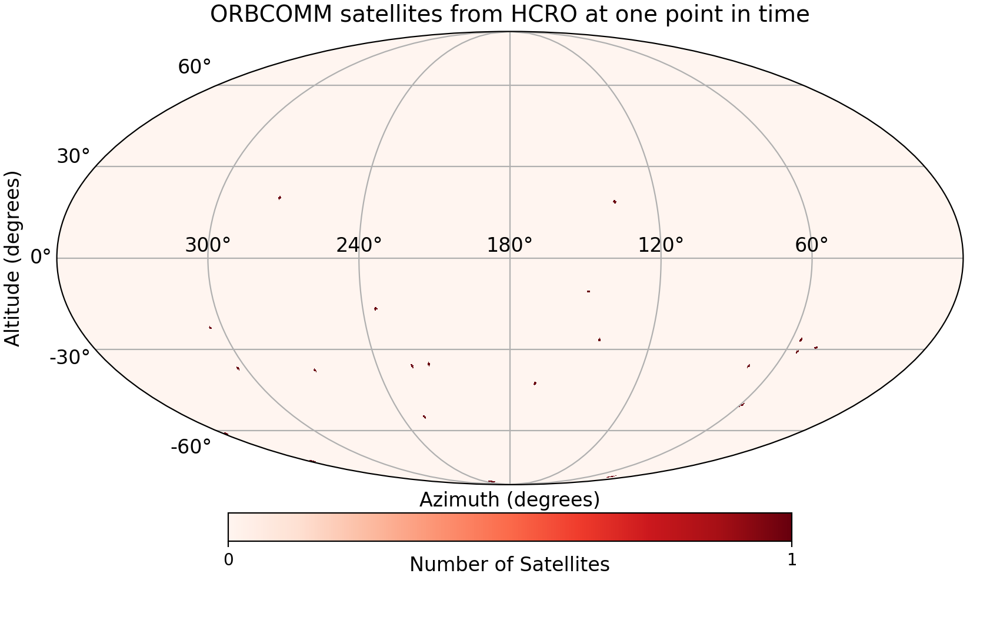

In [1181]:
plt.close()
projview(
    morbt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'ORBCOMM satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Wideband Global SATCOM (WGS) Satellites

In [311]:
alt_WGS = []
az_WGS = []
for i in range(len(active)):
    if active[i].name[:3] == 'WGS':
        alt_WGS.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_WGS.append(top[i][0].altaz()[1].degrees)

In [312]:
thetaWGSt0 = [np.radians(alt_WGS)]
phiWGSt0 = [np.radians(az_WGS)]

In [313]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiWGSt0[0])):
    if (phiWGSt0[0][i] + np.pi) >= (2*np.pi):
        phiWGSt0[0][i] = phiWGSt0[0][i] - np.pi
    elif (phiWGSt0[0][i] + np.pi) < (2*np.pi):
        phiWGSt0[0][i] = phiWGSt0[0][i] + np.pi

In [314]:
pixel_indicesWGSt0 = hp.ang2pix(nside, thetaWGSt0[0], phiWGSt0[0])

In [315]:
phWGSt0 = hp.ang2pix(nside, thetaWGSt0[0], phiWGSt0[0])

In [316]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesWGSt0)-1):
    if phWGSt0[i] == phWGSt0[i+1]:
        pixel_indicesWGSt0[i+1] = 0

In [317]:
mWGSt0 = np.zeros(hp.nside2npix(nside))


In [318]:
%%time
for i in range(1, len(mWGSt0)):
    for j in range(len(pixel_indicesWGSt0)):
        if i == pixel_indicesWGSt0[j]:
            mWGSt0[i] += 1

CPU times: user 71.4 ms, sys: 2.68 ms, total: 74.1 ms
Wall time: 73 ms


<IPython.core.display.Javascript object>


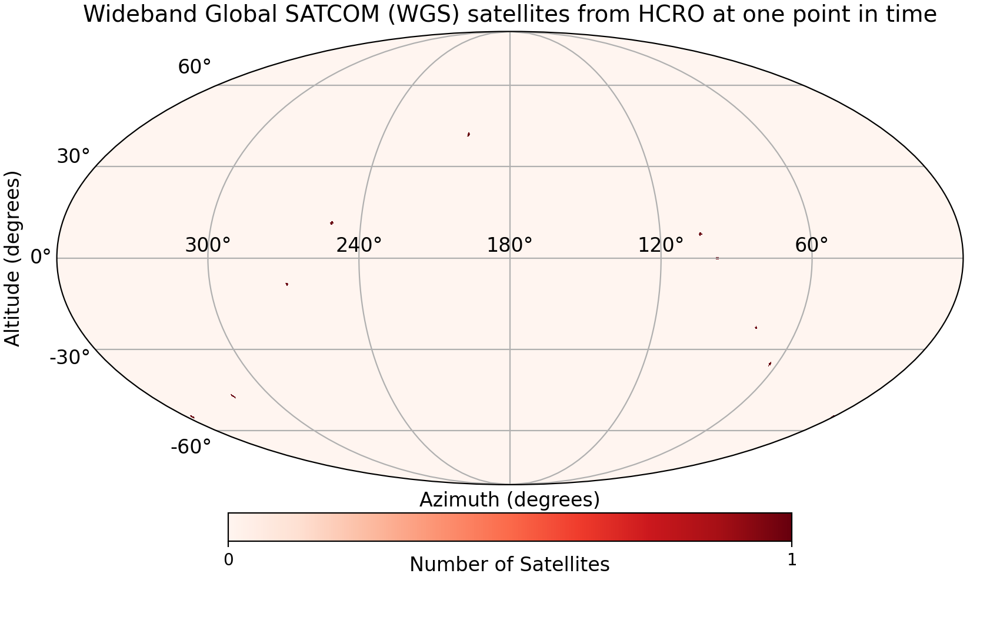

In [1182]:
plt.close()
projview(
    mWGSt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Wideband Global SATCOM (WGS) satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Viasat Satellites

In [320]:
alt_VIASAT = []
az_VIASAT = []
for i in range(len(active)):
    if active[i].name[:6] == 'VIASAT':
        alt_VIASAT.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_VIASAT.append(top[i][0].altaz()[1].degrees)

In [321]:
thetaVIASATt0 = [np.radians(alt_VIASAT)]
phiVIASATt0 = [np.radians(az_VIASAT)]

In [322]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiVIASATt0[0])):
    if (phiVIASATt0[0][i] + np.pi) >= (2*np.pi):
        phiVIASATt0[0][i] = phiVIASATt0[0][i] - np.pi
    elif (phiVIASATt0[0][i] + np.pi) < (2*np.pi):
        phiVIASATt0[0][i] = phiVIASATt0[0][i] + np.pi

In [323]:
pixel_indicesVIASATt0 = hp.ang2pix(nside, thetaVIASATt0[0], phiVIASATt0[0])

In [324]:
phVIASATt0 = hp.ang2pix(nside, thetaVIASATt0[0], phiVIASATt0[0])

In [325]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesVIASATt0)-1):
    if phVIASATt0[i] == phVIASATt0[i+1]:
        pixel_indicesVIASATt0[i+1] = 0

In [326]:
mVIASATt0 = np.zeros(hp.nside2npix(nside))


In [327]:
%%time
#takes about 20s
for i in range(1, len(mVIASATt0)):
    for j in range(len(pixel_indicesVIASATt0)):
        if i == pixel_indicesVIASATt0[j]:
            mVIASATt0[i] += 1

CPU times: user 34.5 ms, sys: 1.46 ms, total: 35.9 ms
Wall time: 35.5 ms


<IPython.core.display.Javascript object>


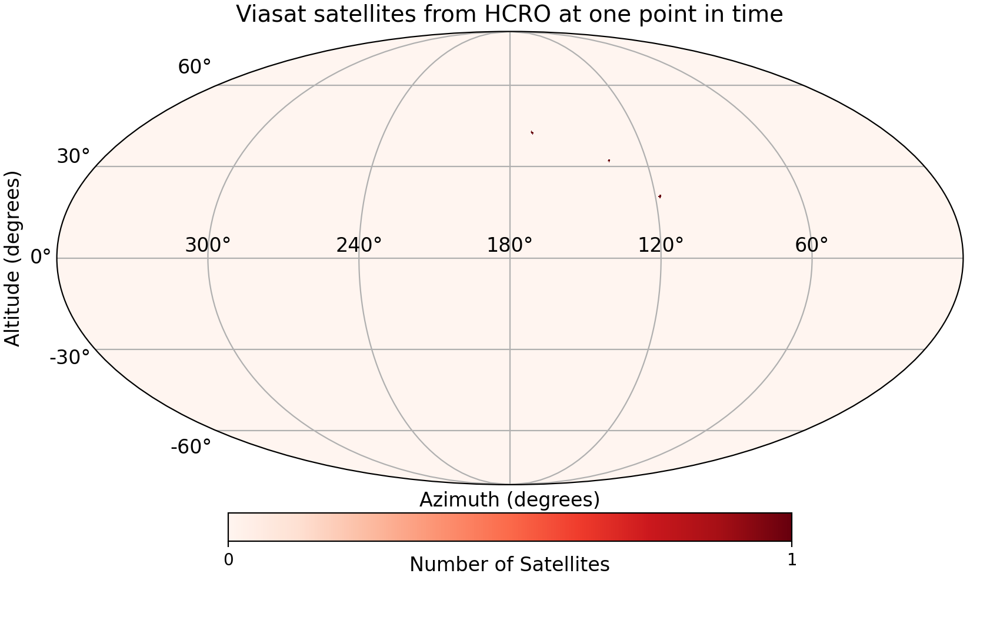

In [1183]:
plt.close()
projview(
    mVIASATt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Viasat satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Eutelsat Satellites

In [330]:
alt_EUTELSAT = []
az_EUTELSAT = []
for i in range(len(active)):
    if active[i].name[:8] == 'EUTELSAT':
        alt_EUTELSAT.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_EUTELSAT.append(top[i][0].altaz()[1].degrees)

In [331]:
thetaEUTELSATt0 = [np.radians(alt_EUTELSAT)]
phiEUTELSATt0 = [np.radians(az_EUTELSAT)]

In [332]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiEUTELSATt0[0])):
    if (phiEUTELSATt0[0][i] + np.pi) >= (2*np.pi):
        phiEUTELSATt0[0][i] = phiEUTELSATt0[0][i] - np.pi
    elif (phiEUTELSATt0[0][i] + np.pi) < (2*np.pi):
        phiEUTELSATt0[0][i] = phiEUTELSATt0[0][i] + np.pi

In [333]:
pixel_indicesEUTELSATt0 = hp.ang2pix(nside, thetaEUTELSATt0[0], phiEUTELSATt0[0])

In [334]:
phEUTELSATt0 = hp.ang2pix(nside, thetaEUTELSATt0[0], phiEUTELSATt0[0])

In [335]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesEUTELSATt0)-1):
    if phEUTELSATt0[i] == phEUTELSATt0[i+1]:
        pixel_indicesEUTELSATt0[i+1] = 0

In [336]:
mEUTELSATt0 = np.zeros(hp.nside2npix(nside))


In [337]:
%%time
#takes about 20s
for i in range(1, len(mEUTELSATt0)):
    for j in range(len(pixel_indicesEUTELSATt0)):
        if i == pixel_indicesEUTELSATt0[j]:
            mEUTELSATt0[i] += 1

CPU times: user 158 ms, sys: 5.27 ms, total: 164 ms
Wall time: 162 ms


<IPython.core.display.Javascript object>


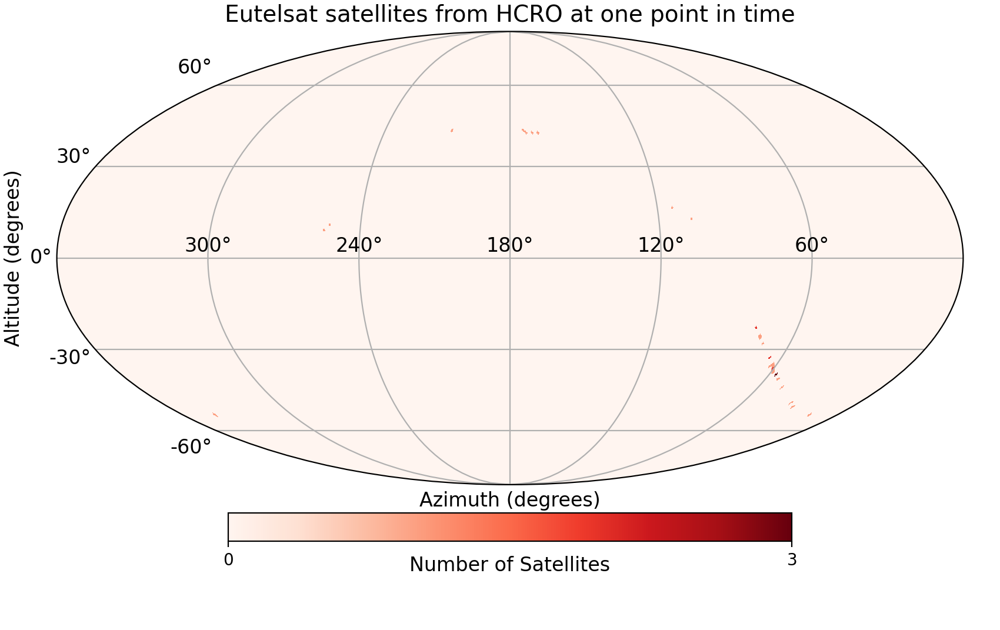

In [1184]:
plt.close()
projview(
    mEUTELSATt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Eutelsat satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Thuraya Satellites

In [339]:
alt_THURAYA = []
az_THURAYA = []
for i in range(len(active)):
    if active[i].name[:7] == 'THURAYA':
        alt_THURAYA.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_THURAYA.append(top[i][0].altaz()[1].degrees)

In [340]:
thetaTHURAYAt0 = [np.radians(alt_THURAYA)]
phiTHURAYAt0 = [np.radians(az_THURAYA)]

In [341]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiTHURAYAt0[0])):
    if (phiTHURAYAt0[0][i] + np.pi) >= (2*np.pi):
        phiTHURAYAt0[0][i] = phiTHURAYAt0[0][i] - np.pi
    elif (phiTHURAYAt0[0][i] + np.pi) < (2*np.pi):
        phiTHURAYAt0[0][i] = phiTHURAYAt0[0][i] + np.pi

In [342]:
pixel_indicesTHURAYAt0 = hp.ang2pix(nside, thetaTHURAYAt0[0], phiTHURAYAt0[0])

In [343]:
phTHURAYAt0 = hp.ang2pix(nside, thetaTHURAYAt0[0], phiTHURAYAt0[0])

In [344]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesTHURAYAt0)-1):
    if phTHURAYAt0[i] == phTHURAYAt0[i+1]:
        pixel_indicesTHURAYAt0[i+1] = 0

In [345]:
mTHURAYAt0 = np.zeros(hp.nside2npix(nside))


In [346]:
%%time
#takes about 20s
for i in range(1, len(mTHURAYAt0)):
    for j in range(len(pixel_indicesTHURAYAt0)):
        if i == pixel_indicesTHURAYAt0[j]:
            mTHURAYAt0[i] += 1

CPU times: user 29.9 ms, sys: 2.19 ms, total: 32.1 ms
Wall time: 30.8 ms


<IPython.core.display.Javascript object>


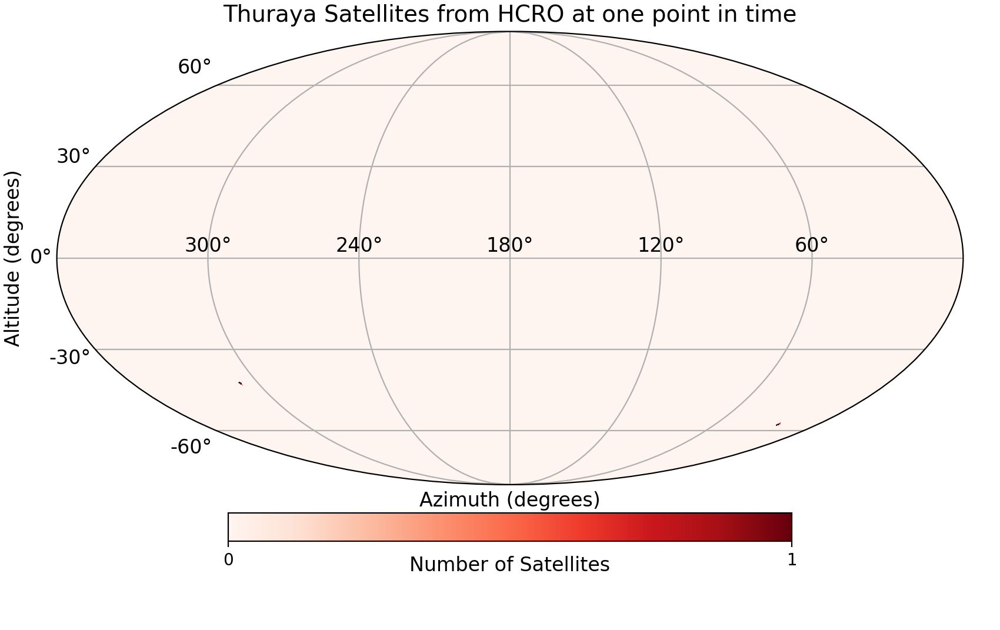

In [1185]:
plt.close()
projview(
    mTHURAYAt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Thuraya Satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

RADARSAT Satellites

In [348]:
alt_RCM = []
az_RCM = []
for i in range(len(active)):
    if active[i].name[:3] == 'RCM':
        alt_RCM.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_RCM.append(top[i][0].altaz()[1].degrees)

In [349]:
thetaRCMt0 = [np.radians(alt_RCM)]
phiRCMt0 = [np.radians(az_RCM)]

In [350]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiRCMt0[0])):
    if (phiRCMt0[0][i] + np.pi) >= (2*np.pi):
        phiRCMt0[0][i] = phiRCMt0[0][i] - np.pi
    elif (phiRCMt0[0][i] + np.pi) < (2*np.pi):
        phiRCMt0[0][i] = phiRCMt0[0][i] + np.pi

In [351]:
pixel_indicesRCMt0 = hp.ang2pix(nside, thetaRCMt0[0], phiRCMt0[0])

In [352]:
phRCMt0 = hp.ang2pix(nside, thetaRCMt0[0], phiRCMt0[0])

In [353]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesRCMt0)-1):
    if phRCMt0[i] == phRCMt0[i+1]:
        pixel_indicesRCMt0[i+1] = 0

In [354]:
mRCMt0 = np.zeros(hp.nside2npix(nside))


In [355]:
%%time
#takes about 20s
for i in range(1, len(mRCMt0)):
    for j in range(len(pixel_indicesRCMt0)):
        if i == pixel_indicesRCMt0[j]:
            mRCMt0[i] += 1

CPU times: user 35 ms, sys: 1.86 ms, total: 36.9 ms
Wall time: 35.7 ms


<IPython.core.display.Javascript object>


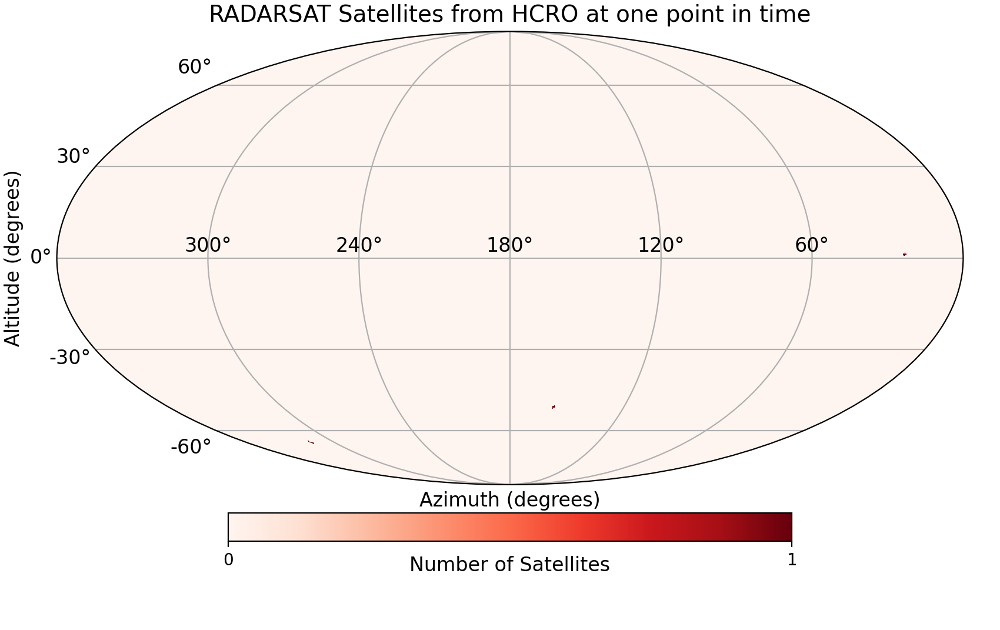

In [1186]:
plt.close()
projview(
    mRCMt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'RADARSAT Satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Flock Satellites

In [357]:
alt_FLOCK = []
az_FLOCK = []
for i in range(len(active)):
    if active[i].name[:5] == 'FLOCK':
        alt_FLOCK.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_FLOCK.append(top[i][0].altaz()[1].degrees)

In [358]:
thetaFLOCKt0 = [np.radians(alt_FLOCK)]
phiFLOCKt0 = [np.radians(az_FLOCK)]

In [359]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiFLOCKt0[0])):
    if (phiFLOCKt0[0][i] + np.pi) >= (2*np.pi):
        phiFLOCKt0[0][i] = phiFLOCKt0[0][i] - np.pi
    elif (phiFLOCKt0[0][i] + np.pi) < (2*np.pi):
        phiFLOCKt0[0][i] = phiFLOCKt0[0][i] + np.pi

In [360]:
pixel_indicesFLOCKt0 = hp.ang2pix(nside, thetaFLOCKt0[0], phiFLOCKt0[0])

In [361]:
phFLOCKt0 = hp.ang2pix(nside, thetaFLOCKt0[0], phiFLOCKt0[0])

In [362]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesFLOCKt0)-1):
    if phFLOCKt0[i] == phFLOCKt0[i+1]:
        pixel_indicesFLOCKt0[i+1] = 0

In [363]:
mFLOCKt0 = np.zeros(hp.nside2npix(nside))


In [364]:
%%time
#takes about 20s
for i in range(1, len(mFLOCKt0)):
    for j in range(len(pixel_indicesFLOCKt0)):
        if i == pixel_indicesFLOCKt0[j]:
            mFLOCKt0[i] += 1

CPU times: user 635 ms, sys: 10.8 ms, total: 646 ms
Wall time: 645 ms


<IPython.core.display.Javascript object>


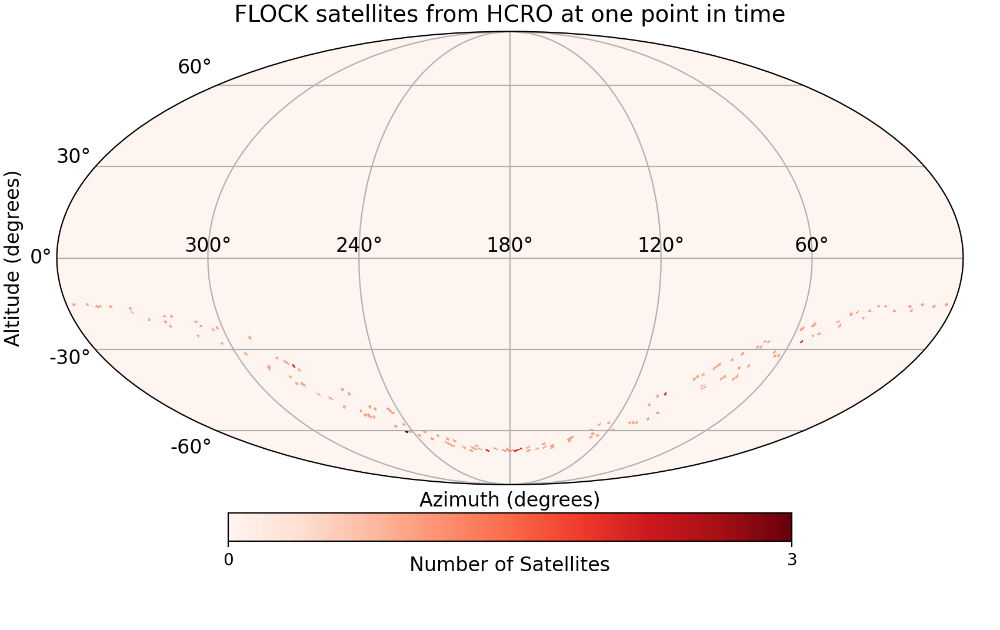

In [366]:
projview(
    mFLOCKt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'FLOCK satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

SkySat

In [367]:
alt_SKYSAT = []
az_SKYSAT = []
for i in range(len(active)):
    if active[i].name[:6] == 'SKYSAT':
        alt_SKYSAT.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_SKYSAT.append(top[i][0].altaz()[1].degrees)

In [368]:
thetaSKYSATt0 = [np.radians(alt_SKYSAT)]
phiSKYSATt0 = [np.radians(az_SKYSAT)]

In [369]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiSKYSATt0[0])):
    if (phiSKYSATt0[0][i] + np.pi) >= (2*np.pi):
        phiSKYSATt0[0][i] = phiSKYSATt0[0][i] - np.pi
    elif (phiSKYSATt0[0][i] + np.pi) < (2*np.pi):
        phiSKYSATt0[0][i] = phiSKYSATt0[0][i] + np.pi

In [370]:
pixel_indicesSKYSATt0 = hp.ang2pix(nside, thetaSKYSATt0[0], phiSKYSATt0[0])

In [371]:
phSKYSATt0 = hp.ang2pix(nside, thetaSKYSATt0[0], phiSKYSATt0[0])

In [372]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesSKYSATt0)-1):
    if phSKYSATt0[i] == phSKYSATt0[i+1]:
        pixel_indicesSKYSATt0[i+1] = 0

In [373]:
mSKYSATt0 = np.zeros(hp.nside2npix(nside))


In [374]:
%%time
#takes about 20s
for i in range(1, len(mSKYSATt0)):
    for j in range(len(pixel_indicesSKYSATt0)):
        if i == pixel_indicesSKYSATt0[j]:
            mSKYSATt0[i] += 1

CPU times: user 106 ms, sys: 3.52 ms, total: 109 ms
Wall time: 108 ms


<IPython.core.display.Javascript object>


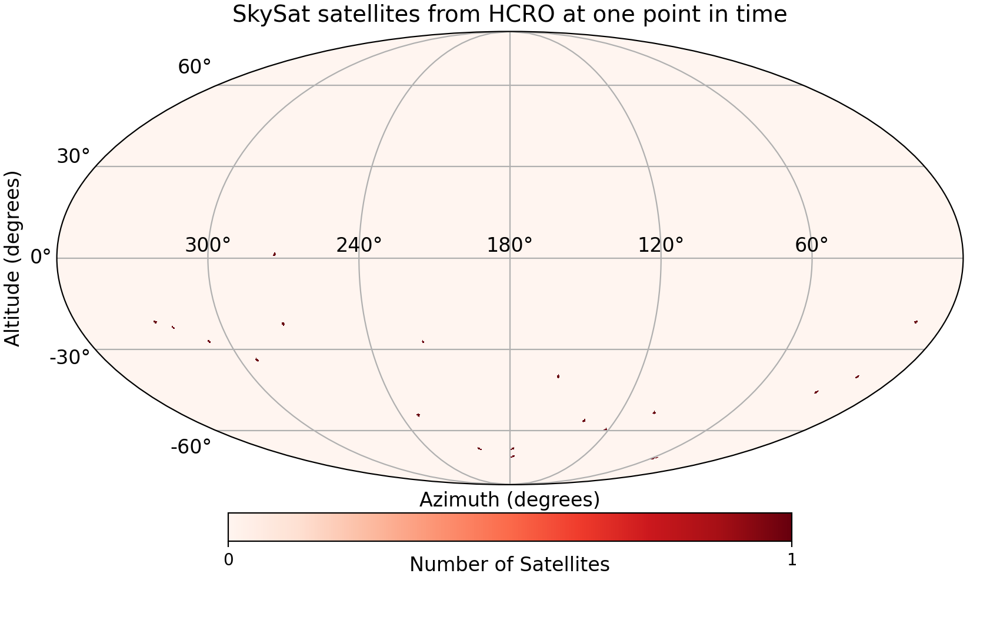

In [1166]:
projview(
    mSKYSATt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'SkySat satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Pléiades Satellites

In [376]:
alt_PLEIADES = []
az_PLEIADES = []
for i in range(len(active)):
    if active[i].name[:8] == 'PLEIADES':
        alt_PLEIADES.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_PLEIADES.append(top[i][0].altaz()[1].degrees)

In [377]:
thetaPLEIADESt0 = [np.radians(alt_PLEIADES)]
phiPLEIADESt0 = [np.radians(az_PLEIADES)]

In [378]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiPLEIADESt0[0])):
    if (phiPLEIADESt0[0][i] + np.pi) >= (2*np.pi):
        phiPLEIADESt0[0][i] = phiPLEIADESt0[0][i] - np.pi
    elif (phiPLEIADESt0[0][i] + np.pi) < (2*np.pi):
        phiPLEIADESt0[0][i] = phiPLEIADESt0[0][i] + np.pi

In [379]:
pixel_indicesPLEIADESt0 = hp.ang2pix(nside, thetaPLEIADESt0[0], phiPLEIADESt0[0])

In [380]:
phPLEIADESt0 = hp.ang2pix(nside, thetaPLEIADESt0[0], phiPLEIADESt0[0])

In [381]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesPLEIADESt0)-1):
    if phPLEIADESt0[i] == phPLEIADESt0[i+1]:
        pixel_indicesPLEIADESt0[i+1] = 0

In [382]:
mPLEIADESt0 = np.zeros(hp.nside2npix(nside))


In [383]:
%%time
#takes about 20s
for i in range(1, len(mPLEIADESt0)):
    for j in range(len(pixel_indicesPLEIADESt0)):
        if i == pixel_indicesPLEIADESt0[j]:
            mPLEIADESt0[i] += 1

CPU times: user 38.5 ms, sys: 2.18 ms, total: 40.7 ms
Wall time: 39.6 ms


<IPython.core.display.Javascript object>


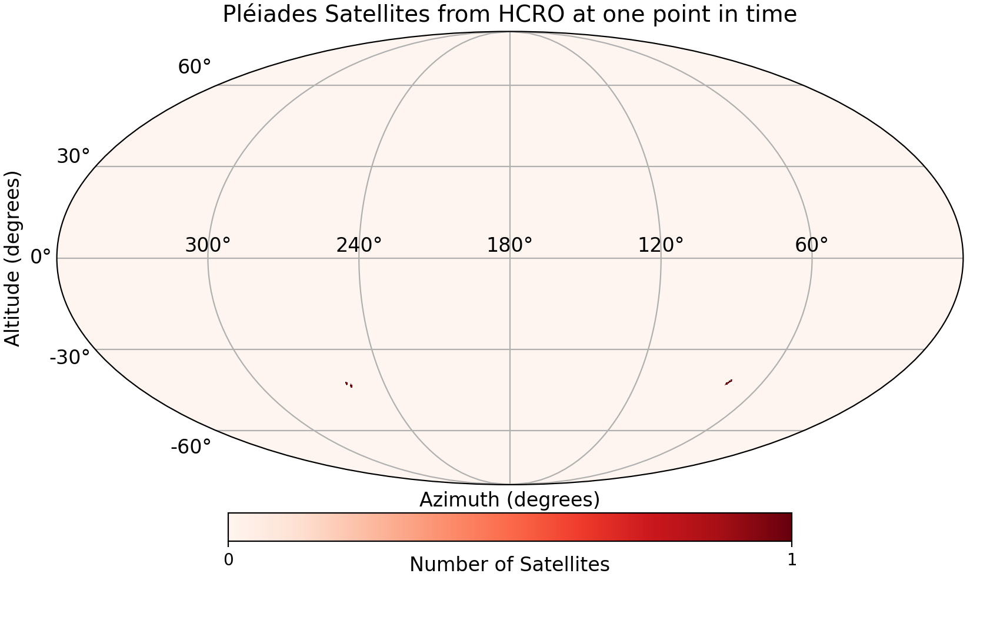

In [1165]:
projview(
    mPLEIADESt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'Pléiades Satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

OneWeb Satellites

In [385]:
alt_ONEWEB = []
az_ONEWEB = []
for i in range(len(active)):
    if active[i].name[:6] == 'ONEWEB':
        alt_ONEWEB.append(np.abs(top[i][0].altaz()[0].degrees - 90))
        az_ONEWEB.append(top[i][0].altaz()[1].degrees)

In [386]:
thetaONEWEBt0 = [np.radians(alt_ONEWEB)]
phiONEWEBt0 = [np.radians(az_ONEWEB)]

In [387]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiONEWEBt0[0])):
    if (phiONEWEBt0[0][i] + np.pi) >= (2*np.pi):
        phiONEWEBt0[0][i] = phiONEWEBt0[0][i] - np.pi
    elif (phiONEWEBt0[0][i] + np.pi) < (2*np.pi):
        phiONEWEBt0[0][i] = phiONEWEBt0[0][i] + np.pi

In [388]:
pixel_indicesONEWEBt0 = hp.ang2pix(nside, thetaONEWEBt0[0], phiONEWEBt0[0])

In [389]:
phONEWEBt0 = hp.ang2pix(nside, thetaONEWEBt0[0], phiONEWEBt0[0])

In [390]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesONEWEBt0)-1):
    if phONEWEBt0[i] == phONEWEBt0[i+1]:
        pixel_indicesONEWEBt0[i+1] = 0

In [391]:
mONEWEBt0 = np.zeros(hp.nside2npix(nside))


In [392]:
%%time
#takes about 2s
for i in range(1, len(mONEWEBt0)):
    for j in range(len(pixel_indicesONEWEBt0)):
        if i == pixel_indicesONEWEBt0[j]:
            mONEWEBt0[i] += 1

CPU times: user 2.71 s, sys: 33.5 ms, total: 2.75 s
Wall time: 2.75 s


<IPython.core.display.Javascript object>


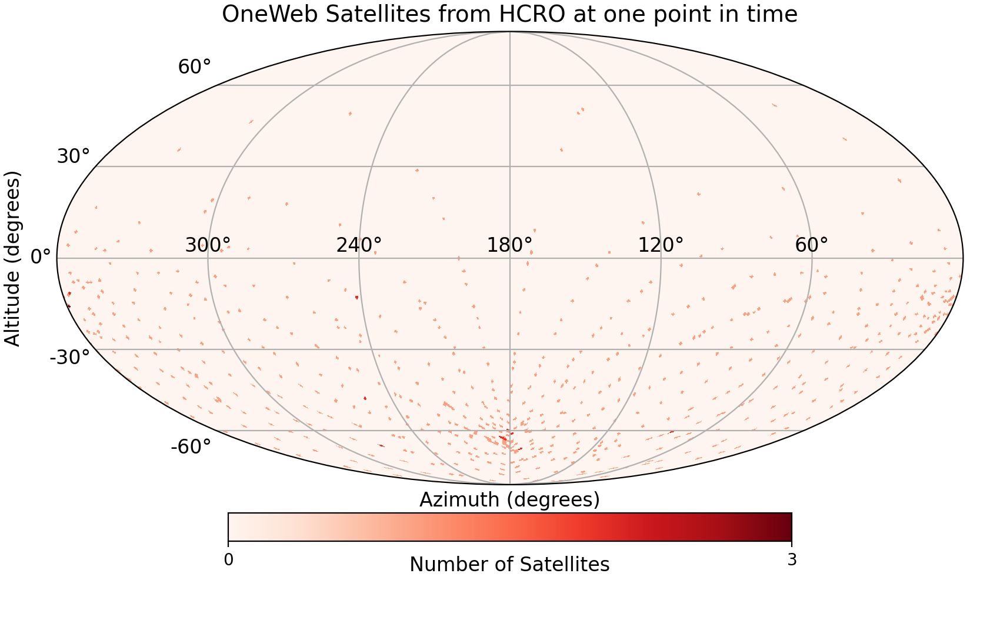

In [1164]:
projview(
    mONEWEBt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'OneWeb Satellites from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', '240°', '180°', '120°', '60°'],
);
#plt.savefig('GEO_m.png')

Without largest constellations (Starlink and OneWeb)

In [396]:
alt_LEOsm = []
az_LEOsm = []
for i in range(len(LEO)):
    if active[LEO[i]].name[:8] != 'STARLINK' and active[LEO[i]].name[:6] != 'ONEWEB' and active[LEO[i]].name[:5] != 'FLOCK' or active[LEO[i]].name[:7] != 'IRIDIUM':
        if np.isnan(top[LEO[i]][0].altaz()[0].degrees) == False:
            alt_LEOsm.append(np.abs(top[LEO[i]][0].altaz()[0].degrees - 90))
            az_LEOsm.append(top[LEO[i]][0].altaz()[1].degrees)

In [397]:
thetaLEOsmt0 = [np.radians(alt_LEOsm)]
phiLEOsmt0 = [np.radians(az_LEOsm)]

In [398]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phiLEOsmt0[0])):
    if (phiLEOsmt0[0][i] + np.pi) >= (2*np.pi):
        phiLEOsmt0[0][i] = phiLEOsmt0[0][i] - np.pi
    elif (phiLEOsmt0[0][i] + np.pi) < (2*np.pi):
        phiLEOsmt0[0][i] = phiLEOsmt0[0][i] + np.pi

In [399]:
pixel_indicesLEOsmt0 = hp.ang2pix(nside, thetaLEOsmt0[0], phiLEOsmt0[0])

In [400]:
phLEOsmt0 = hp.ang2pix(nside, thetaLEOsmt0[0], phiLEOsmt0[0])

In [401]:
#Correcting for geoa satellites being in the same place
for i in range(len(pixel_indicesLEOsmt0)-1):
    if phLEOsmt0[i] == phLEOsmt0[i+1]:
        pixel_indicesLEOsmt0[i+1] = 0

In [402]:
mLEOsmt0 = np.zeros(hp.nside2npix(nside))


In [403]:
%%time
#takes about 30s
for i in range(1, len(mLEOsmt0)):
    for j in range(len(pixel_indicesLEOsmt0)):
        if i == pixel_indicesLEOsmt0[j]:
            mLEOsmt0[i] += 1

CPU times: user 31.9 s, sys: 432 ms, total: 32.3 s
Wall time: 32.4 s


<IPython.core.display.Javascript object>


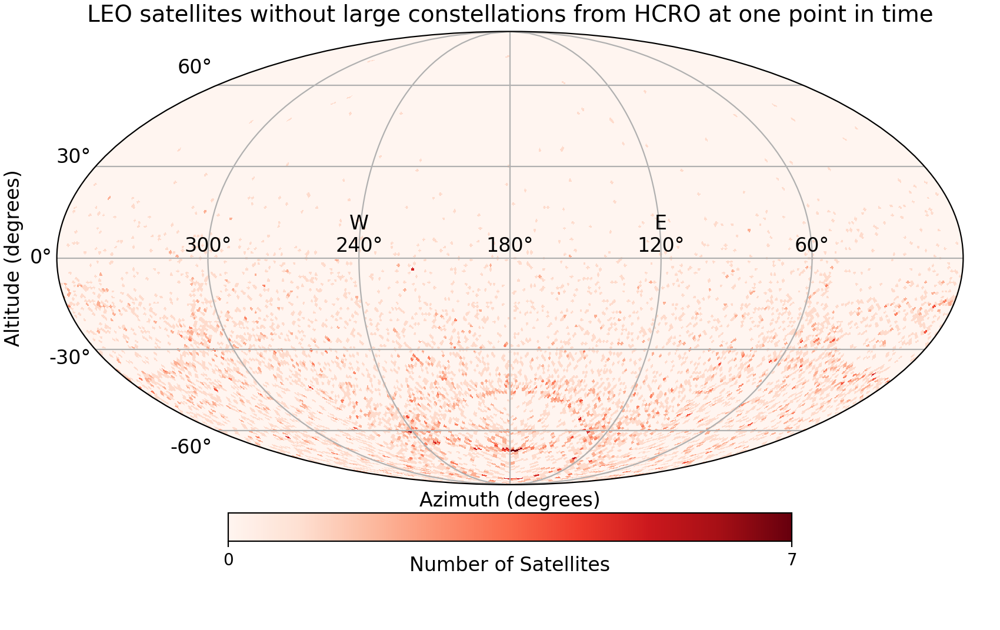

In [1163]:
projview(
    mLEOsmt0,
    coord=["G"],
    graticule=True,
    flip = 'astro',
    graticule_labels=True,
    unit="Number of Satellites",
    xlabel="Azimuth (degrees)",
    ylabel="Altitude (degrees)",
    cb_orientation="horizontal",
    projection_type="mollweide",
    cmap = "Reds",
    title = 'LEO satellites without large constellations from HCRO at one point in time',
    #phi_convention = 'counterclockwise',
    custom_xtick_labels = ['300°', 'W\n240°', '180°', 'E\n120°', '60°'],
    xtick_label_color='k',
);
#plt.savefig('GEO_m.png')

Ellipticity

In [407]:
e = []
for i in range(len(line2)):
    e.append(float(str('0.' + line2[i][26:33])))

In [409]:
ex = []
ey = []
for i in range(10):
    ey.append(0)
    ex.append((i*0.1) + 0.05)
    for j in range(len(e)):
        if (i * 0.1) <= e[j] < ((i+1) * 0.1):
            ey[i] += 1

<IPython.core.display.Javascript object>


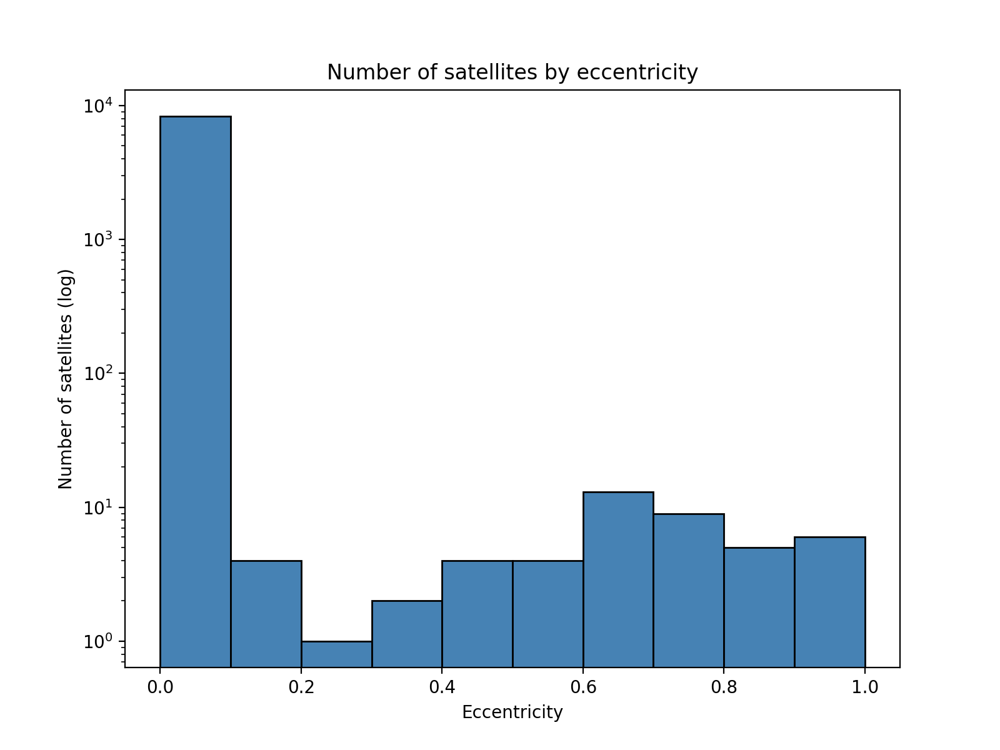

In [410]:
plt.close()
plt.figure(figsize = (8, 6))
plt.bar(ex, ey, 0.1, color = 'steelblue', edgecolor = 'k')
plt.semilogy()
plt.xlabel('Eccentricity')
plt.ylabel('Number of satellites (log)')
plt.title('Number of satellites by eccentricity')
plt.show()


Occupancy Bins

In [415]:
%%time
alt_GEO = []
az_GEO = []
distance_GEO = []
alt_MEO = []
az_MEO = []
distance_MEO = []
alt_HEO = []
az_HEO = []
distance_HEO = []
alt_LEO = []
az_LEO = []
distance_LEO = []
for i in range(len(alt)):
    #print(i)
    for j in range(len(GEO)):
        if i == GEO[j]:
            for k in range(len(t)):
                alt_GEO.append(alt[i][k])
                az_GEO.append(az[i][k])
                distance_GEO.append(distance[i][k])
    for j in range(len(MEO)):
        if i == MEO[j]:
            for k in range(len(t)):
                alt_MEO.append(alt[i][k])
                az_MEO.append(az[i][k])
                distance_MEO.append(distance[i][k])
    for j in range(len(HEO)):
        if i == HEO[j]:
            for k in range(len(t)):
                alt_HEO.append(alt[i][k])
                az_HEO.append(az[i][k])
                distance_HEO.append(distance[i][k])
    for j in range(len(LEO)):
        if i == LEO[j]:
            for k in range(len(t)):
                alt_LEO.append(alt[i][k])
                az_LEO.append(az[i][k])
                distance_LEO.append(distance[i][k])


CPU times: user 3.82 s, sys: 148 ms, total: 3.97 s
Wall time: 4.09 s


In [416]:
alt_LEO = np.reshape(alt_LEO, (int(len(alt_LEO)/144), 144))
az_LEO = np.reshape(az_LEO, (int(len(az_LEO)/144), 144))

In [417]:
alt_MEO = np.reshape(alt_MEO, (int(len(alt_MEO)/144), 144))
az_MEO = np.reshape(az_MEO, (int(len(az_MEO)/144), 144))

In [495]:
npixm = []
vam = []
for i in range(len(mmeo)):
    if (hp.pix2ang(nside, i)[0] * u.rad).to(u.deg)/u.deg <= 74:
        npixm.append(i)
        vam.append(mmeo[i])

npixmax = []
for i in range(len(npixm)):
    if vam[i] == np.max(vam):
        npixmax.append(npixm[i])

In [496]:
alt_min = float(90 - (hp.pix2ang(nside, npixmax)[0] * u.rad).to(u.deg)/u.deg) - 1.5
alt_max = float(90 - (hp.pix2ang(nside, npixmax)[0] * u.rad).to(u.deg)/u.deg) + 1.5
az_min = float((hp.pix2ang(nside, npixmax)[1] * u.rad).to(u.deg)/u.deg - 180) - 1.5
az_max = float((hp.pix2ang(nside, npixmax)[1] * u.rad).to(u.deg)/u.deg - 180) + 1.5

In [497]:
t_ = []
n_ = []
dfa = 0
for j in range(int(len(t))):
    t_.append((j)+0.5)
    n_.append(0)
    for i in range(int(len(alt_MEO))):
        if alt_min <= alt_MEO[i][j] <= alt_max and az_min <= az_MEO[i][j] <= az_max:
            #print(i, j)
            dfa += 1
            n_[j] += 1

In [498]:
t_30 = []
n_30 = []
for i in range(48):
    t_30.append((i*0.5) + 0.25)
for i in range(48):
    n_30.append(n_[(i*3)] + n_[(i*3)+1] + n_[(i*3)+2])

<IPython.core.display.Javascript object>


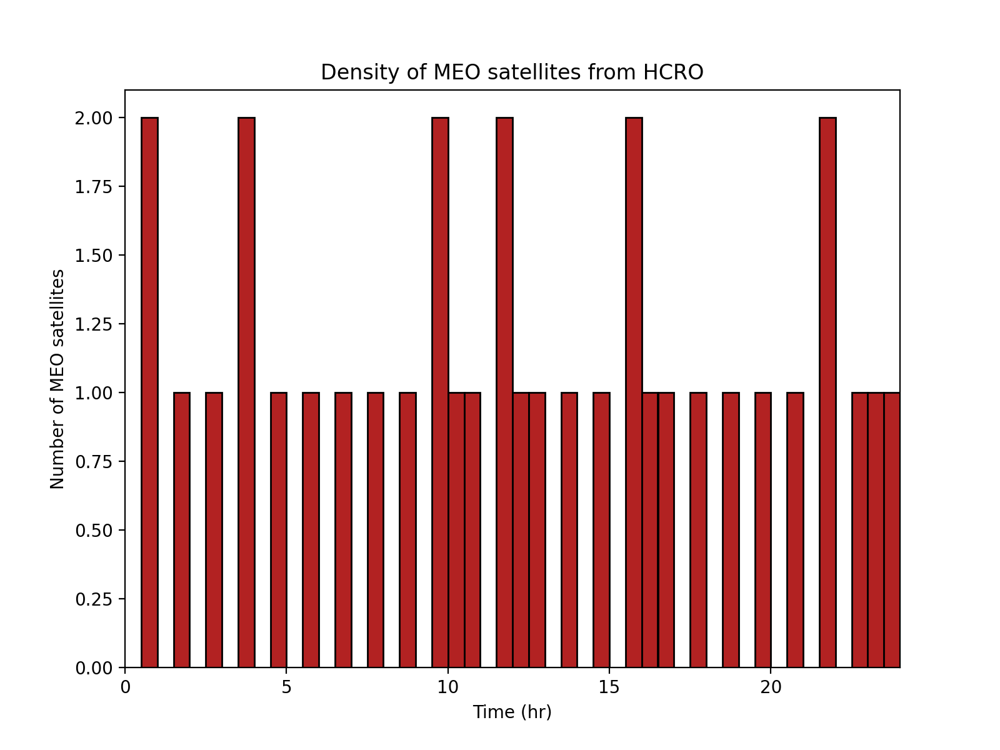

In [500]:
plt.figure(figsize = (8, 6))
plt.bar(t_30, n_30, 0.5, color = 'firebrick', edgecolor = 'k')
#plt.xticks([t_[6], t_[12], t_[18], t_[24], t_[30], t_[36], t_[42]])
plt.xlim(0, 24)
plt.xlabel('Time (hr)')
plt.ylabel('Number of MEO satellites')
plt.title('Density of MEO satellites from HCRO')
plt.show()

In [531]:
%%time
alt_LEO3 = []
az_LEO3 = []
distance_LEO3 = []

for i in range(len(LEO)):
    for k in range(len(tl3)):
        #if altl3[i][k] > 0:
            alt_LEO3.append(altl3[i][k])
            az_LEO3.append(azl3[i][k])
            distance_LEO3.append(distancel3[i][k])

CPU times: user 4.43 s, sys: 265 ms, total: 4.69 s
Wall time: 4.85 s


In [604]:
npixm = []
vam = []
for i in range(len(mleo3)):
    if (hp.pix2ang(nside3, i)[0] * u.rad).to(u.deg)/u.deg <= 74:
        npixm.append(i)
        vam.append(mleo3[i])

npixmax = []
for i in range(len(npixm)):
    if vam[i] == np.max(vam):
        npixmax.append(npixm[i])

In [605]:
np.max(mleo3)

1228.0

In [606]:
alt_min = float(90 - (hp.pix2ang(nside3, npixmax)[0] * u.rad).to(u.deg)/u.deg) - 1.5
alt_max = float(90 - (hp.pix2ang(nside3, npixmax)[0] * u.rad).to(u.deg)/u.deg) + 1.5
az_min = float((hp.pix2ang(nside3, npixmax)[1] * u.rad).to(u.deg)/u.deg - 180) - 1.5
az_max = float((hp.pix2ang(nside3, npixmax)[1] * u.rad).to(u.deg)/u.deg - 180) + 1.5

In [609]:
t_l3 = []
n_l3 = []
dfa = 0
for j in range(int(len(tl3))):
    t_l3.append((j)+0.5)
    n_l3.append(0)
    for i in range(len(altl3)):
        if alt_min <= altl3[i][j] <= alt_max and az_min <= azl3[i][j] <= az_max:
            #print(i, j)
            dfa += 1
            n_l3[j] += 1

In [610]:
t_3l3 = []
n_3l3 = []
for i in range(48):
    t_3l3.append((i*0.5) + 0.25)
for i in range(48):
    n_3l3.append(0)
    for j in range(30):
        n_3l3[i] += n_l3[(j*i) + j]

In [617]:
np.max(n_3l3)

18

<IPython.core.display.Javascript object>


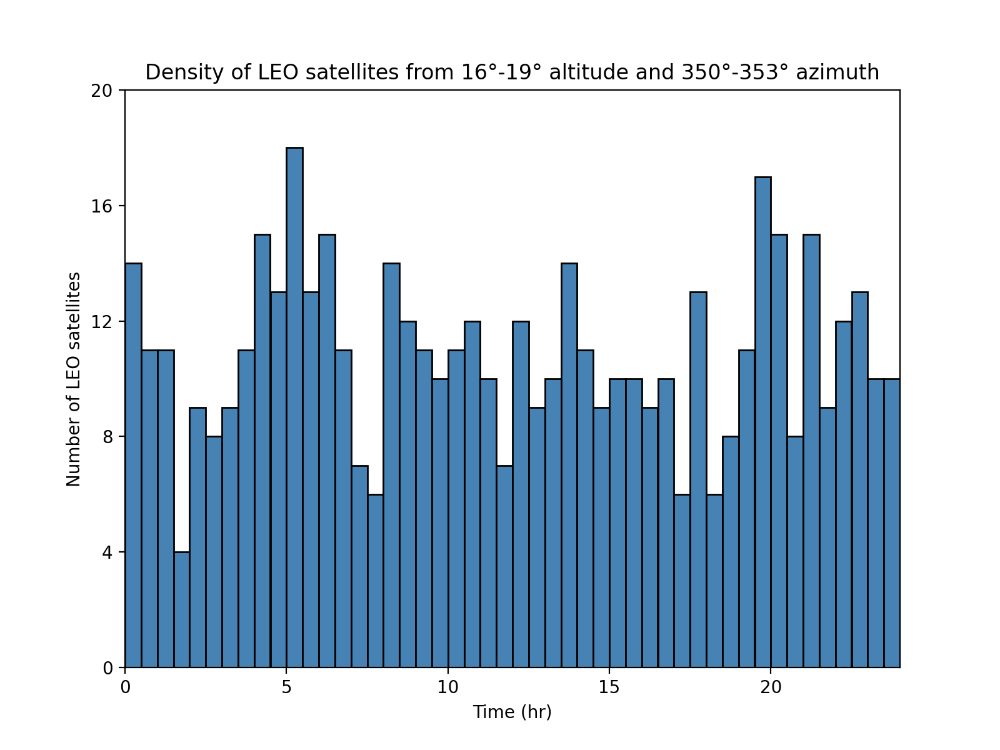

Text(0.5, 1.0, 'Density of LEO satellites from 16°-19° altitude and 350°-353° azimuth')

In [620]:
plt.figure(figsize = (8, 6))
plt.bar(t_3l3, n_3l3, 0.5, color = 'steelblue', edgecolor = 'k')
#plt.xticks([t_[6], t_[12], t_[18], t_[24], t_[30], t_[36], t_[42]])
plt.xlim(0, 24)
plt.ylim(0, 20)
plt.yticks([0, 4, 8, 12, 16, 20])
plt.xlabel('Time (hr)')
plt.ylabel('Number of LEO satellites')
plt.title('Density of LEO satellites from 16°-19° altitude and 350°-353° azimuth')
#plt.show()

In [1020]:
np.max(mmeo)

26.0

In [1022]:
np.max(vam)

26.0

In [1066]:
nside3

32

In [1067]:
nside

64

In [1068]:
len(mleo)/len(mleo3)

4.0

In [1062]:
len(mleo3)

12288

In [1075]:
(hp.pix2ang(nside, npixmax)[0] * u.rad).to(u.deg)/u.deg

<Quantity [25.0519159]>

In [1073]:
npixm = []
vam = []
for i in range(len(mmeo)):
    if (hp.pix2ang(nside3, i)[0] * u.rad).to(u.deg)/u.deg <= 74:
        npixm.append(i)
        vam.append(mmeo[i])

In [1074]:
npixmax = []
for i in range(len(npixm)):
    if vam[i] == np.max(vam):
        npixmax.append(npixm[i])

In [972]:
differencem = []
for i in range(len(MEO)):
    differencem.append(active[MEO[i]] - ata)

In [973]:
topocentricm3 = []
for i in range(len(differencem)):
    #print(i)
    for j in range(len(tl3)):
        topocentricm3.append(differencem[i].at(tl3[j]))

In [974]:
%%time
#about 8s
topocentricm3 = []
for i in range(len(differencem)):
    for j in range(len(tl3)):
        topocentricm3.append(differencem[i].at(tl3[j]))

CPU times: user 8.09 s, sys: 1.06 s, total: 9.15 s
Wall time: 8.48 s


In [975]:
%%time
#takes about 15s to run
altm3 = []
azm3 = []
distancem3 = []
for i in range(len(topocentricm3)):
    if np.isnan(topocentricm3[(i)].altaz()[0].degrees) == True:
        altm3.append(0)
        azm3.append(0)
        distancem3.append(0)
    elif np.isnan(topocentricm3[(i)].altaz()[0].degrees) == False:
        altm3.append(topocentricm3[i].altaz()[0].degrees)
        azm3.append(topocentricm3[i].altaz()[1].degrees)
        distancem3.append(topocentricm3[i].altaz()[2].au)

CPU times: user 14.7 s, sys: 313 ms, total: 15 s
Wall time: 15.1 s


In [976]:
altm3 = np.reshape(altm3, (len(MEO), len(tl3)))
azm3 = np.reshape(azm3, (len(MEO), len(tl3)))
distancem3 = np.reshape(distancem3, (len(MEO), len(tl3)))

In [977]:
tm3 = tl3

In [978]:
%%time
alt_MEO3 = []
az_MEO3 = []
distance_MEO3 = []

for i in range(len(MEO)):
    for k in range(len(tm3)):
        if altm3[i][k] > 0:
            alt_MEO3.append(np.abs(altm3[i][k] - 90))
            az_MEO3.append(azm3[i][k])
            distance_MEO3.append(distancem3[i][k])



CPU times: user 141 ms, sys: 6.14 ms, total: 147 ms
Wall time: 146 ms


In [78]:
%%time
alt_GEO = []
az_GEO = []
distance_GEO = []
alt_MEO = []
az_MEO = []
distance_MEO = []
alt_HEO = []
az_HEO = []
distance_HEO = []
alt_LEO = []
az_LEO = []
distance_LEO = []
for i in range(len(alt)):
    #print(i)
    for j in range(len(GEO)):
        if i == GEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_GEO.append(np.abs(alt[i][k] - 90))
                    az_GEO.append(az[i][k])
                    distance_GEO.append(distance[i][k])
for i in range(len(alt)):
    for j in range(len(MEO)):
        if i == MEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_MEO.append(np.abs(alt[i][k] - 90))
                    az_MEO.append(az[i][k])
                    distance_MEO.append(distance[i][k])
                
for i in range(len(alt)):
    for j in range(len(HEO)):
        if i == HEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_HEO.append(np.abs(alt[i][k] - 90))
                    az_HEO.append(az[i][k])
                    distance_HEO.append(distance[i][k])
                
for i in range(len(alt)):
    for j in range(len(LEO)):
        if i == LEO[j]:
            for k in range(len(t)):
                if alt[i][k] > 0:
                    alt_LEO.append(np.abs(alt[i][k] - 90))
                    az_LEO.append(az[i][k])
                    distance_LEO.append(distance[i][k])


CPU times: user 3.57 s, sys: 99.9 ms, total: 3.67 s
Wall time: 3.69 s


In [1076]:
data = [np.arange(len(alt_MEO3))]#,np.arange(len(alt_GEO)), np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.radians(alt_MEO3)]#, np.radians(alt_GEO), np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(az_MEO3)]#, np.radians(az_GEO), np.radians(az_MEO), np.radians(az_LEO)]


In [1077]:
nside = 2**6

In [1078]:
(hp.nside2resol(nside) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 0.91612971 deg>

In [1079]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

In [1080]:
pixel_indices_meo3 = hp.ang2pix(nside, theta[0], phi[0])

In [1083]:
pm3 = hp.ang2pix(nside, theta[0], phi[0])

In [1084]:
#Correcting for geo satellites being in the same place
for i in range(len(pixel_indices_meo3)-1):
    if pm3[i] == pm3[i+1]:
        pixel_indices_meo3[i+1] = 0

In [1085]:
mmeo3 = np.zeros(hp.nside2npix(nside))


In [1086]:
%%time
#takes about 7 minutes
for i in range(1, len(mmeo3)):
    for j in range(len(pixel_indices_meo3)):
        if i == pixel_indices_meo3[j]:
            mmeo3[i] += 1

CPU times: user 6min 42s, sys: 8.61 s, total: 6min 50s
Wall time: 6min 52s


In [1087]:
kjrsey = []
npixmax = []
for i in range(len(mmeo)):
    if (hp.pix2ang(nside, i)[0] * u.rad).to(u.deg)/u.deg < 74:
        kjrsey.append(mmeo[i])
for i in range(len(mmeo)):
    if mmeo[i] == np.max(kjrsey):
        npixmax.append(i)

In [1093]:
hp.pix2ang(nside3, npixmax[0])[0]

3.141592653589793

In [1094]:
alt_min = []
alt_max = []
az_min = []
az_max = []
for i in range(len(npixmax)):
    alt_min.append(float(90 - (hp.pix2ang(nside, npixmax[i])[0] * u.rad).to(u.deg)/u.deg) - 1.5)
    alt_max.append(float(90 - (hp.pix2ang(nside, npixmax[i])[0] * u.rad).to(u.deg)/u.deg) + 1.5)
    az_min.append(float((hp.pix2ang(nside, npixmax[i])[1] * u.rad).to(u.deg)/u.deg - 180) - 1.5)
    az_max.append(float((hp.pix2ang(nside, npixmax[i])[1] * u.rad).to(u.deg)/u.deg - 180) + 1.5)

In [1036]:
t_m = []
n_m = []
dfas = 0
for j in range(len(tl3)):
    t_m.append(j+0.5)
    for i in range(int(len(altm3))):
        n_m.append(0)
        for h in range(len(alt_min)):
            if alt_min[h] <= altm3[i][j] <= alt_max[h] and  az_min[h] <= azm3[i][j] <= az_max[h]:
            #print(altm3[i][j], azm3[i][j])
                dfas += 1
                n_m[j] += 1

In [1095]:
t_m = []
n_m = []
dfas = 0
for j in range(len(tl3)):
    t_m.append(j+0.5)
    n_m.append(0)
    for h in range(len(altm3)):
        if alt_min[0] <= altm3[h][j] <= alt_max[0] and az_min[0] <= azm3[h][j] <= az_max[0]:
            dfas += 1
            n_m[j] += 1

In [1096]:
alt_min

[23.782603043311994]

In [1099]:
np.max(n_m30)

9

In [1097]:
t_m30 = []
n_m30 = []
for i in range(48):
    t_m30.append((i*0.5) + 0.25)
for i in range(48):
    n_m30.append(0)
    for j in range(30):
        n_m30[i] += n_m[(j*i) + j]

<IPython.core.display.Javascript object>


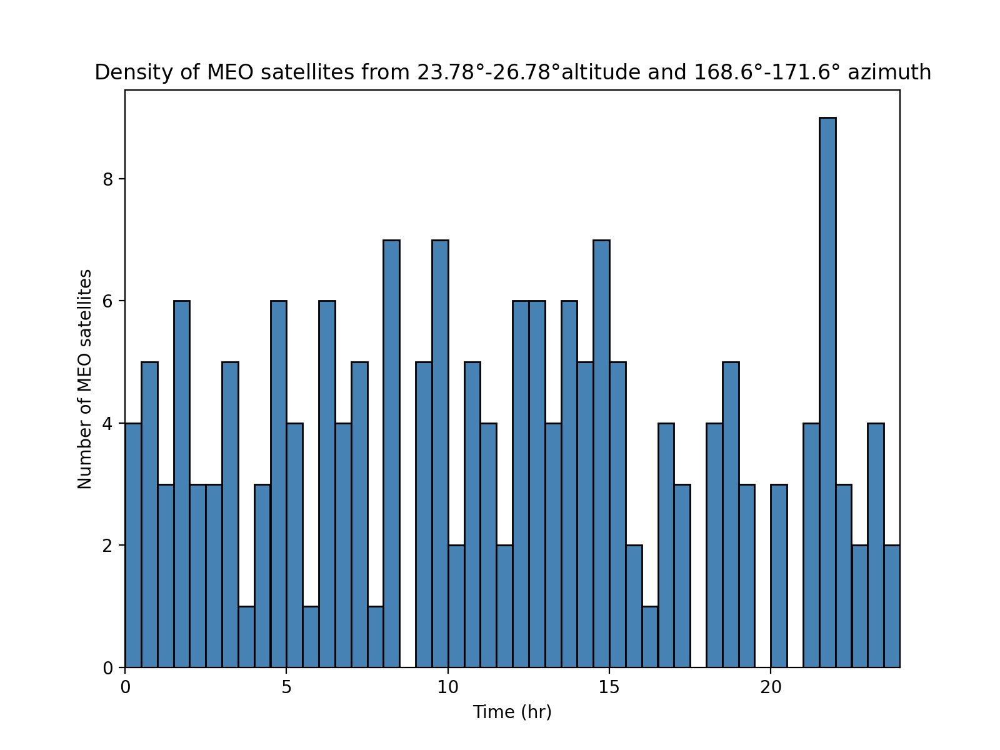

In [1100]:
plt.figure(figsize = (8, 6))
plt.bar(t_m30, n_m30, 0.5, color = 'steelblue', edgecolor = 'k')
#plt.xticks([t_[6], t_[12], t_[18], t_[24], t_[30], t_[36], t_[42]])
plt.xlim(0, 24)
plt.xlabel('Time (hr)')
plt.ylabel('Number of MEO satellites')
plt.title(f'Density of MEO satellites from ${float(str(alt_min[0])[:5])}$°-${float(str(alt_max[0])[:5])}$°' + 
          f'altitude and ${float(str(az_min[0])[:5])}$°-${float(str(az_max[0])[:5])}$° azimuth')
plt.show()

In [645]:
altl3nos = []
azl3nos = []
for i in range(len(LEO)):
    if namess[LEO[i]][:8] != "STARLINK":
        altl3nos.append(altl3[i])
        azl3nos.append(azl3[i])

altl3nos = np.reshape(altl3nos, (len(altl3nos)* len(tl3)))
azl3nos = np.reshape(azl3nos, (len(azl3nos)* len(tl3)))

data = [np.arange(len(altl3nos))]#,np.arange(len(alt_LEO7))]#, np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.abs(np.radians(altl3nos) - np.pi/2)]#, np.radians(alt_LEO7)]#, np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(azl3nos)]#, np.radians(az_LEO7)]#, np.radians(az_MEO), np.radians(az_LEO)]


#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

nside3 = 2**5

(hp.nside2resol(nside3) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

np.max(theta[0] + np.pi/2)

pixel_indices_leo3nos = hp.ang2pix(nside3, theta[0] + np.pi/2, phi[0])

np.max(pixel_indices_leo3)

pl3nos = hp.ang2pix(nside3, theta[0] + np.pi/2, phi[0])

#Correcting for satellites being in the same place
for i in range(len(pixel_indices_leo3)-1):
    if pl3nos[i] == pl3nos[i+1]:
        pixel_indices_leo3[i+1] = 0

mleo3nos = np.zeros(hp.nside2npix(nside3))

%%time
#takes about 7 minutes
for i in range(1, len(mleo3nos)):
    for j in range(len(pixel_indices_leo3nos)):
        if i == pixel_indices_leo3nos[j]:
            mleo3nos[i] += 1

npixm = []
vam = []
for i in range(len(mleo3nos)):
    if (hp.pix2ang(nside3, i)[0] * u.rad).to(u.deg)/u.deg <= 74:
        npixm.append(i)
        vam.append(mleo3nos[i])

npixmax = []
for i in range(len(npixm)):
    if vam[i] == np.max(vam):
        npixmax.append(npixm[i])

alt_min = float(90 - (hp.pix2ang(nside3, npixmax[0])[0] * u.rad).to(u.deg)/u.deg) - 1.5
alt_max = float(90 - (hp.pix2ang(nside3, npixmax[0])[0] * u.rad).to(u.deg)/u.deg) + 1.5
az_min = float(np.abs((hp.pix2ang(nside3, npixmax[0])[1] * u.rad).to(u.deg)/u.deg - 180)) - 1.5
az_max = float(np.abs((hp.pix2ang(nside3, npixmax[0])[1] * u.rad).to(u.deg)/u.deg - 180)) + 1.5

len(altl3nos)

altl3nos = np.reshape(altl3nos, (int(len(altl3nos)/len(tl3)), len(tl3)))
azl3nos = np.reshape(azl3nos, (int(len(azl3nos)/len(tl3)), len(tl3)))

np.median(altl3nos)

t_l3nos = []
n_l3nos = []
dfa = 0
for j in range(int(len(tl3))):
    t_l3nos.append((j)+0.5)
    n_l3nos.append(0)
    for i in range(len(altl3nos)):
        if alt_min <= altl3nos[i][j] <= alt_max and az_min <= azl3nos[i][j] <= az_max:
            #print(i, j)
            dfa += 1
            n_l3nos[j] += 1

t_3l3nos = []
n_3l3nos = []
for i in range(48):
    t_3l3nos.append((i*0.5) + 0.25)
for i in range(48):
    n_3l3nos.append(0)
    for j in range(30):
        n_3l3nos[i] += n_l3nos[(j*i) + j]altl3nos = []
azl3nos = []
for i in range(len(LEO)):
    if namess[LEO[i]][:8] != "STARLINK":
        altl3nos.append(altl3[i])
        azl3nos.append(azl3[i])

In [756]:
altl3nos = np.reshape(altl3nos, (len(altl3nos)* len(tl3)))
azl3nos = np.reshape(azl3nos, (len(azl3nos)* len(tl3)))

In [779]:
data = [np.arange(len(altl3nos))]#,np.arange(len(alt_LEO7))]#, np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.abs(np.radians(altl3nos) - np.pi/2)]#, np.radians(alt_LEO7)]#, np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(azl3nos)]#, np.radians(az_LEO7)]#, np.radians(az_MEO), np.radians(az_LEO)]


In [765]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

In [766]:
nside3 = 2**5

In [767]:
(hp.nside2resol(nside3) * u.rad).to(u.degree)
#Angular resolution of the Mollweide plot

<Quantity 1.83225942 deg>

In [774]:
np.max(theta[0] + np.pi/2)

3.1278484347357676

In [670]:
pixel_indices_leo3nos = hp.ang2pix(nside3, theta[0] + np.pi/2, phi[0])

In [760]:
np.max(pixel_indices_leo3)

12287

In [671]:
pl3nos = hp.ang2pix(nside3, theta[0] + np.pi/2, phi[0])

In [672]:
#Correcting for satellites being in the same place
for i in range(len(pixel_indices_leo3)-1):
    if pl3nos[i] == pl3nos[i+1]:
        pixel_indices_leo3[i+1] = 0

In [673]:
mleo3nos = np.zeros(hp.nside2npix(nside3))

In [674]:
%%time
#takes about 7 minutes
for i in range(1, len(mleo3nos)):
    for j in range(len(pixel_indices_leo3nos)):
        if i == pixel_indices_leo3nos[j]:
            mleo3nos[i] += 1

CPU times: user 1h 14min 56s, sys: 46.3 s, total: 1h 15min 42s
Wall time: 4h 29min 34s


In [796]:
npixm = []
vam = []
for i in range(len(mleo3nos)):
    if (hp.pix2ang(nside3, i)[0] * u.rad).to(u.deg)/u.deg <= 74:
        npixm.append(i)
        vam.append(mleo3nos[i])

npixmax = []
for i in range(len(npixm)):
    if vam[i] == np.max(vam):
        npixmax.append(npixm[i])

In [798]:
alt_min = float(90 - (hp.pix2ang(nside3, npixmax[0])[0] * u.rad).to(u.deg)/u.deg) - 1.5
alt_max = float(90 - (hp.pix2ang(nside3, npixmax[0])[0] * u.rad).to(u.deg)/u.deg) + 1.5
az_min = float(np.abs((hp.pix2ang(nside3, npixmax[0])[1] * u.rad).to(u.deg)/u.deg - 180)) - 1.5
az_max = float(np.abs((hp.pix2ang(nside3, npixmax[0])[1] * u.rad).to(u.deg)/u.deg - 180)) + 1.5

In [800]:
len(altl3nos)

3049

In [799]:
altl3nos = np.reshape(altl3nos, (int(len(altl3nos)/len(tl3)), len(tl3)))
azl3nos = np.reshape(azl3nos, (int(len(azl3nos)/len(tl3)), len(tl3)))

ValueError: cannot reshape array of size 4390560 into shape (2,1440)

In [709]:
np.median(altl3nos)

-42.045420311072064

In [801]:
t_l3nos = []
n_l3nos = []
dfa = 0
for j in range(int(len(tl3))):
    t_l3nos.append((j)+0.5)
    n_l3nos.append(0)
    for i in range(len(altl3nos)):
        if alt_min <= altl3nos[i][j] <= alt_max and az_min <= azl3nos[i][j] <= az_max:
            #print(i, j)
            dfa += 1
            n_l3nos[j] += 1

In [802]:
t_3l3nos = []
n_3l3nos = []
for i in range(48):
    t_3l3nos.append((i*0.5) + 0.25)
for i in range(48):
    n_3l3nos.append(0)
    for j in range(30):
        n_3l3nos[i] += n_l3nos[(j*i) + j]

<IPython.core.display.Javascript object>


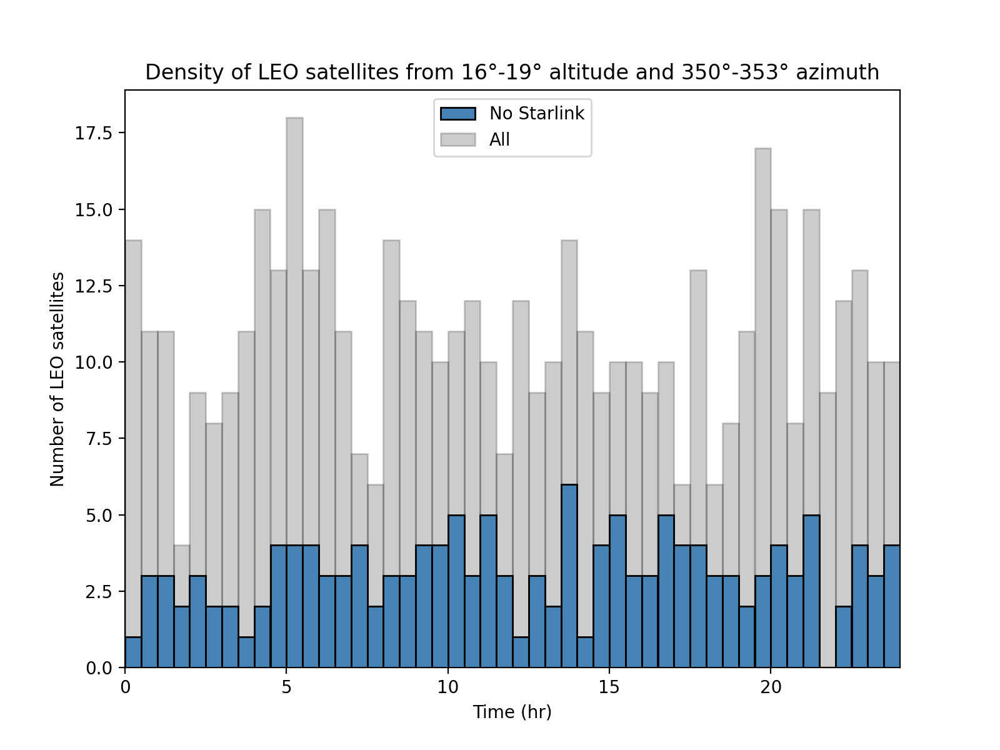

In [803]:
plt.figure(figsize = (8, 6))
plt.bar(t_3l3nos, n_3l3nos, 0.5, color = 'steelblue', edgecolor = 'k', zorder = 20, label = 'No Starlink')
plt.bar(t_3l3, n_3l3, 0.5, color = 'k', edgecolor = 'k', alpha = 0.2, zorder = 0, label = 'All')
#plt.xticks([t_[6], t_[12], t_[18], t_[24], t_[30], t_[36], t_[42]])
plt.xlim(0, 24)
plt.xlabel('Time (hr)')
plt.ylabel('Number of LEO satellites')
plt.title('Density of LEO satellites from 16°-19° altitude and 350°-353° azimuth')
plt.legend()
plt.show()

In [1101]:
np.var(n_3l3nos)

1.5260416666666667

In [1104]:
len(mleo3)

12288

In [1114]:
(hp.nside2resol(2**4) * u.rad).to(u.degree)

<Quantity 3.66451884 deg>

In [1109]:
2**6

64

In [1112]:
hp.nside2npix(2**3)/2

384.0

Overall Statistics for occupancy

In [1196]:
#Use skyfield to import the TLE (two-line element) file [gives you all the information on a satellite's location at 
#the epoch, which can be used to find its location at any time] for all active satellites on Norad
reclaunch_url = 'https://celestrak.org/norad/elements/gp.php?GROUP=last-30-days&FORMAT=tle'
reclaunch = load.tle_file(reclaunch_url, reload = True)
print('Loaded', len(reclaunch), 'satellites')

[#################################] 100% gp.php


Loaded 176 satellites


In [1198]:
for i in range(len(reclaunch)):
    print(reclaunch[i].name)

2023-097A
CHANDRAYAAN-3
GSLV R/B
STARLINK-6290
STARLINK-6138
STARLINK-6212
STARLINK-6234
STARLINK-5831
STARLINK-5585
STARLINK-5589
STARLINK-6316
STARLINK-6320
STARLINK-6322
STARLINK-6374
STARLINK-6332
STARLINK-6321
STARLINK-6377
STARLINK-6375
STARLINK-6379
STARLINK-6380
STARLINK-6373
STARLINK-6359
STARLINK-6378
STARLINK-6372
STARLINK-6376
STARLINK-6362
STARLINK-6331
STARLINK-6297
STARLINK-6324
STARLINK-6293
STARLINK-6276
STARLINK-6355
STARLINK-5600
STARLINK-6299
STARLINK-6347
STARLINK-6348
STARLINK-6340
STARLINK-6343
STARLINK-6356
STARLINK-6338
STARLINK-5007
STARLINK-6174
STARLINK-6215
STARLINK-6218
STARLINK-6168
STARLINK-5353
STARLINK-6032
STARLINK-5975
STARLINK-6370
STARLINK-6369
STARLINK-6363
STARLINK-6367
STARLINK-6358
STARLINK-6364
STARLINK-6361
STARLINK-6366
STARLINK-6371
FALCON 9 DEB
FALCON 9 DEB
FALCON 9 DEB
FALCON 9 DEB
STARLING 4
STARLING 2
STARLING 1
STARLING 3
LEMUR-2-MANO
LEMUR-2-DEVERILL-M-T
LEO VANTAGE 3 (LEO 3)
ELECTRON KICK STAGE R/B
TIANMU-1 07
TIANMU-1 08
TIANMU-1 09

In [1200]:
fail = []
for i in range(len(reclaunch)):
    if np.isin(reclaunch[i].name, namess) == False:
        fail.append(reclaunch[i].name)

In [1201]:
len(fail)

31

In [1202]:
fail

['2023-097A',
 'GSLV R/B',
 'FALCON 9 DEB',
 'FALCON 9 DEB',
 'FALCON 9 DEB',
 'FALCON 9 DEB',
 'ELECTRON KICK STAGE R/B',
 'CERES-1 R/B',
 '2023-104E',
 '2023-104F',
 'CZ-2D DEB',
 '2023-108B',
 'DS-SAR',
 'GALASSIA-2',
 'NULION',
 'CZ-4C R/B',
 'COSMOS 2569 [GLONASS-K2]',
 'FREGAT R/B',
 '2023-116A',
 '2023-116B',
 '2023-116C',
 'CZ-2D DEB',
 'CZ-2D DEB',
 '2023-117A',
 '2023-117B',
 '2023-117C',
 '2023-117D',
 '2023-117E',
 '2023-117F',
 '2023-117G',
 '2023-118B']

In [1203]:
stnew = 0
for i in range(len(reclaunch)):
    if reclaunch[i].name[:8] == "STARLINK":
        stnew += 1

In [1204]:
stnew

113

In [1207]:
nsidet = 2**3

In [1208]:
(hp.nside2resol(nsidet) * u.rad).to(u.degree)


<Quantity 7.32903768 deg>

In [1232]:
altl3 = np.reshape(altl3, (len(LEO) * len(tl3)))
altm3 = np.reshape(altm3, (len(MEO) * len(tl3)))

azl3 = np.reshape(azl3, (len(LEO) * len(tl3)))
azm3 = np.reshape(azm3, (len(MEO) * len(tl3)))

In [1233]:
data = [np.arange(len(altl3)), np.arange(len(altm3))]#,np.arange(len(alt_LEO7))]#, np.arange(len(alt_MEO)), np.arange(len(alt_LEO))]
theta = [np.abs(np.radians(altl3) - np.pi/2), np.abs(np.radians(altm3) - np.pi/2)]#, np.radians(alt_LEO7)]#, np.radians(alt_MEO), np.radians(alt_LEO)]
phi = [np.radians(azl3), np.radians(azm3)]#, np.radians(az_LEO7)]#, np.radians(az_MEO), np.radians(az_LEO)]


In [1234]:
#Changing the az so we can look due South (so the Mollweide plots show the same shape as the 
#2D plots)
for i in range(len(phi[0])):
    if (phi[0][i] + np.pi) >= (2*np.pi):
        phi[0][i] = phi[0][i] - np.pi
    elif (phi[0][i] + np.pi) < (2*np.pi):
        phi[0][i] = phi[0][i] + np.pi

for i in range(len(phi[1])):
    if (phi[1][i] + np.pi) >= (2*np.pi):
        phi[1][i] = phi[1][i] - np.pi
    elif (phi[1][i] + np.pi) < (2*np.pi):
        phi[1][i] = phi[1][i] + np.pi

In [1239]:
pixel_indices_leot = hp.ang2pix(nsidet, theta[0], phi[0])
pixel_indices_meot = hp.ang2pix(nsidet, theta[1], phi[1])
pllt = hp.ang2pix(nsidet, theta[0], phi[0])
pmt = hp.ang2pix(nsidet, theta[1], phi[1])

In [1240]:
#Correcting for satellites being in the same place
for i in range(len(pixel_indices_leot)-1):
    if pllt[i] == pllt[i+1]:
        pixel_indices_leot[i+1] = 0
for i in range(len(pixel_indices_meot)-1):
    if pmt[i] == pmt[i+1]:
        pixel_indices_meot[i+1] = 0

In [1241]:
mtleo = np.zeros(hp.nside2npix(nsidet))
mtmeo = np.zeros(hp.nside2npix(nsidet))

In [1250]:
%%time
#takes about 13 minutes
for i in range(1, len(mtleo)):
    for j in range(len(pixel_indices_leot)):
        if i == pixel_indices_leot[j]:
            mtleo[i] += 1
            
for i in range(1, len(mtmeo)):
    for j in range(len(pixel_indices_meot)):
        if i == pixel_indices_meot[j]:
            mtmeo[i] += 1

CPU times: user 12min 50s, sys: 14.2 s, total: 13min 4s
Wall time: 13min 10s


In [1468]:
type(np.max(mtmeo))

numpy.float64

In [1271]:
leoaltaz = []
meoaltaz = []
for i in range(len(mtleo)):
    if (hp.pix2ang(nsidet, i)[0] * u.rad).to(u.deg)/u.deg <= 74:
        leoaltaz.append([float(90 - (hp.pix2ang(nsidet, i)[0] * u.rad).to(u.deg)/u.deg), float(np.abs((hp.pix2ang(nside3, i)[1] * u.rad).to(u.deg)/u.deg - 180))])
        meoaltaz.append([float(90 - (hp.pix2ang(nsidet, i)[0] * u.rad).to(u.deg)/u.deg), float(np.abs((hp.pix2ang(nside3, i)[1] * u.rad).to(u.deg)/u.deg - 180))])

        

In [1477]:
leoaltaz = []
meoaltaz = []
for i in range(15, 90, 3):
    for j in range(0, 360, 3):
        leoaltaz.append([i, j])
        meoaltaz.append([i, j])

In [1297]:
float(90 - (hp.pix2ang(nsidet, 0)[0] * u.rad).to(u.deg)/u.deg)

84.14973293629666

In [1274]:
altl3 = np.reshape(altl3, (len(LEO), len(tl3)))
altm3 = np.reshape(altm3, (len(MEO), len(tl3)))

azl3 = np.reshape(azl3, (len(LEO), len(tl3)))
azm3 = np.reshape(azm3, (len(MEO), len(tl3)))

In [1326]:
len(altl3)

7578

In [1332]:
for i in range(len(leoaltaz)-1):
    for j in range(len(altl3)):
        if leoaltaz[i+1][0] < altl3[j][0] < leoaltaz[i][0]:
            print(j)

27
1283
1995
5936
6187
2023
1814
4466
6479
2918
4615
5189
7357
358
2003
3291
4469
6146
6496
7358
36
1047
3278
3440
3456
3482
6215
6454
272
389
519
644
941
1999
2391
2899
3360
3508
4347
5134
6213
6241
7362
114
390
391
1043
1159
1269
1767
1852
2662
2837
3365
3527
4925
5386
6451
7360
189
254
1009
1780
1834
1853
2014
2401
2426
2438
2660
3200
3272
3498
3526
4371
4464
5122
5398
5672
6484
7361
7363
7545


In [1329]:
altl3[7545][0]

19.477110203399217

In [1448]:
%%time
#takes about 8 minutes
t_lt = []
n_lt = []
for i in range(len(tl3)):
    t_lt.append(i+0.5)
    n_lt.append(0)
    for k in range(len(altl3)):
        for j in range(3):#len(leoaltaz) - 1):
            if leoaltaz[j+1][0] != leoaltaz[j][0]:
            if leoaltaz[j+1][0] <= altl3[k][i] <= leoaltaz[j][0] and leoaltaz[j+1][1] <= azl3[k][j] <= leoaltaz[j][1]:
                n_lt[i] += 1


CPU times: user 7.22 s, sys: 67.6 ms, total: 7.29 s
Wall time: 7.29 s


In [ ]:
%%time
#takes about 8 minutes
t_lt = []
n_lt = []
for i in range(len(leoaltaz) - 1):
for i in range(len(tl3)):
    t_lt.append(i+0.5)
    n_lt.append(0)
    for k in range(len(altl3)):
        for j in range(3):#len(leoaltaz) - 1):
            if leoaltaz[j+1][0] <= altl3[k][i] <= leoaltaz[j][0] and leoaltaz[j+1][1] <= azl3[k][j] <= leoaltaz[j][1]:
                n_lt[i] += 1


In [1479]:
leoalt = []
leoaz = []
meoalt = []
meoaz = []
for i in range(15, 90, 5):
    leoalt.append(i)
    meoalt.append(i)
for i in range(0, 360, 5):
    leoaz.append(i)
    meoaz.append(i)

In [1481]:
%%time
#takes about 9 minutes
t_lt = []
n_lt = []
for i in range(len(tl3)):
    t_lt.append(i+0.5)
for j in range(len(leoalt)-1):
    for h in range(len(leoaz)-1):
        for i in range(len(tl3)):
            n_lt.append(0)
            for k in range(len(altl3)):
                if leoalt[j+1] <= altl3[k][i] <= leoalt[j] and leoaz[h+1] <= azl3[k][j] <= leoaz[h]:
                    n_lt[-1] += 1


CPU times: user 32min 6s, sys: 13.5 s, total: 32min 19s
Wall time: 32min 28s


In [1487]:
np.max(n_lt)

0

In [1483]:
len(n_lt)/(len(tl3))

994.0

In [1453]:
%%time
#takes about 13s
t_mt = []
n_mt = []
for i in range(len(tl3)):
    t_mt.append(i+0.5)
for j in range(len(meoaltaz) - 1):
    for i in range(len(tl3)):
        n_mt.append(0)
        for k in range(len(altm3)):
            if meoaltaz[j+1][0] <= altm3[k][i] <= meoaltaz[j][0] and meoaltaz[j+1][1] <= azm3[k][j] <= meoaltaz[j][1]:
                n_mt[(j*i) + i] += 1

CPU times: user 13.3 s, sys: 140 ms, total: 13.4 s
Wall time: 13.5 s


In [1471]:
n_mt = np.reshape(n_mt, ((len(meoaltaz)-1), len(tl3)))
n_lt = np.reshape(n_lt, ((len(leoaltaz)-1), len(tl3)))

In [1472]:
t_3lt = []
n_3lt = []
t_3mt = []
n_3mt = []
for i in range(48):
    t_3lt.append((i*0.5) + 0.25)
    t_3mt.append((i*0.5) + 0.25)
for i in range(48):
    for k in range(len(leoaltaz) - 1):
        n_3lt.append(0)
        for j in range(30):
            n_3lt[-1] += n_lt[k][(j*i) + j]
    for k in range(len(meoaltaz) - 1):
        n_3mt.append(0)
        for j in range(30):
            n_3mt[-1] += n_mt[k][(j*i) + j]

In [1473]:
n_3lt = np.reshape(n_3lt, ((len(leoaltaz)-1), 48))
n_3mt = np.reshape(n_3mt, ((len(meoaltaz)-1), 48))

In [1474]:
for i in range(len(n_3lt)):
    if np.max(n_3lt[i]) == np.max(n_3lt):
        print(i)

231


In [1464]:
meoaltaz

[[84.14973293629666, 135.0],
 [84.14973293629666, 45.0],
 [84.14973293629666, 45.0],
 [84.14973293629666, 135.0],
 [78.28414760510762, 157.5],
 [78.28414760510762, 112.5],
 [78.28414760510762, 67.5],
 [78.28414760510762, 22.5],
 [78.28414760510762, 22.5],
 [78.28414760510762, 67.49999999999997],
 [78.28414760510762, 112.5],
 [78.28414760510762, 157.5],
 [72.38756092964962, 165.0],
 [72.38756092964962, 135.0],
 [72.38756092964962, 105.0],
 [72.38756092964962, 75.0],
 [72.38756092964962, 45.0],
 [72.38756092964962, 15.0],
 [72.38756092964962, 15.0],
 [72.38756092964962, 44.99999999999997],
 [72.38756092964962, 75.00000000000003],
 [72.38756092964962, 105.0],
 [72.38756092964962, 135.0],
 [72.38756092964962, 164.99999999999994],
 [66.44353569089877, 168.75],
 [66.44353569089877, 146.25],
 [66.44353569089877, 123.75],
 [66.44353569089877, 101.25],
 [66.44353569089877, 78.75],
 [66.44353569089877, 56.250000000000014],
 [66.44353569089877, 33.75],
 [66.44353569089877, 11.25],
 [66.4435356908

<IPython.core.display.Javascript object>


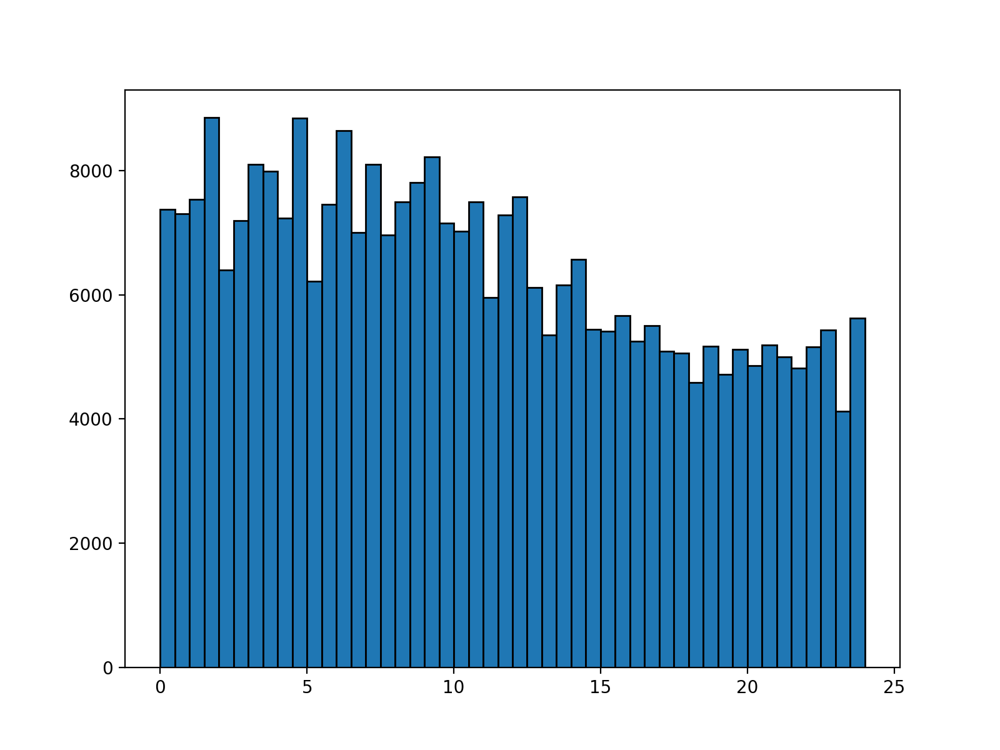

<BarContainer object of 48 artists>

In [1475]:
plt.figure(figsize = (8, 6))
plt.bar(t_3lt, n_3lt[268], width = 0.5, edgecolor = 'k')